In [1]:
import numpy as np
import matplotlib.pyplot as plt
import json
import os
import random
from sklearn.feature_selection import VarianceThreshold
from sklearn.utils import shuffle
from skmultiflow.drift_detection.adwin import ADWIN
import math

cls <class 'pathlib.Path'>
os name nt
self C:\Users\Terry\Anaconda3\envs\py36\lib\site-packages\matplotlib\__init__.py
normal_accessor
normal_accessor
pathobj C:\Users\Terry\Anaconda3\envs\py36\lib\site-packages\matplotlib\mpl-data
cls <class 'pathlib.Path'>
os name nt
self C:\Users\Terry\Anaconda3\envs\py36\lib\site-packages\matplotlib\mpl-data\matplotlibrc
normal_accessor
cls <class 'pathlib.Path'>
os name nt
self .
normal_accessor
cls <class 'pathlib.Path'>
os name nt
self C:\Users\Terry
normal_accessor
normal_accessor
cls <class 'pathlib.Path'>
os name nt
self .
normal_accessor
cls <class 'pathlib.Path'>
os name nt
self C:\Users\Terry
normal_accessor
normal_accessor
pathobj C:\Users\Terry\.matplotlib
pathobj C:\Users\Terry\.matplotlib
pathobj C:\Users\Terry\.matplotlib
cls <class 'pathlib.Path'>
os name nt
self .
normal_accessor
cls <class 'pathlib.Path'>
os name nt
self C:\Users\Terry
normal_accessor
normal_accessor
cls <class 'pathlib.Path'>
os name nt
self .
normal_accessor
cls 

# iForest ADWIN

In [2]:
class Node:
    def __init__(self,internal=True,left=None,right=None,sAtt=None,sVal=None,size=None):
        self.internal = internal
        self.size = size
        self.left = left
        self.right = right
        self.sAtt = sAtt
        self.sVal = sVal
        return
            

In [3]:
def c(n):
#     print('3333',n)
    return 2*H(n-1)-(2*(n-1)/n)

def H(i):
    return math.log(i)+0.5772156649

In [4]:
class iTree:
    def __init__(self,X,e,l,X_cati=None):
        """
        INPUTS:
        X: input data
        e: current tree height
        l: height limit

        OUTPUT:
        """
        self.X = X
        self.l = l
        self.root = self.build(X,e,l,X_cati)
        return

    def build(self,X,e,l,X_cati=None):
#         print('e:',e,'l：',l)
        if e>=l or len(X)<=1:
#             print(e)
            return Node(internal=False,size=len(X))
        else:
            q = random.randint(0,len(X[0])-1)
            if X_cati and X_cati[q]:
                p = random.choice(list(set(X[:,q])))
                Xl = X[X[:,q]==p]
                Xr = X[X[:,q]!=p]
                return Node(internal=True,
                            left=self.build(Xl,e+1,l,X_cati),
                            right=self.build(Xr,e+1,l,X_cati),
                            sAtt=q,
                            sVal=p)
            else:
                p = random.uniform(min(X[:,q]),max(X[:,q]))
                Xl = X[X[:,q]<p]
                Xr = X[X[:,q]>=p]
                return Node(internal=True,
                            left=self.build(Xl,e+1,l,X_cati),
                            right=self.build(Xr,e+1,l,X_cati),
                            sAtt=q,
                            sVal=p)
            
    def pathLength(self,x,N=None,e=0,X_cati=None):
        """
        INPUTS:
        x: an instance
        N: a Node in the iTree
        e: current path length
        """
        if not N:
            N = self.root
        if not N.internal:
            if N.size>1:
#                 print(1)
                return e+(N.size>1)*c(N.size)
            else:
#                 print(0)
                return e
        a = N.sAtt
        if X_cati and X_cati[a]:
            if x[a] == N.sVal:
                return self.pathLength(x,N.left,e+1,X_cati)
            else:
                return self.pathLength(x,N.right,e+1,X_cati)
        else:
            if x[a] < N.sVal:
                return self.pathLength(x,N.left,e+1,X_cati)
            else:
                return self.pathLength(x,N.right,e+1,X_cati)
        
    def draw(self):
        if len(self.X[0])!=2:
            print('iTree.draw() function only support 2D data')
            return
        plt.figure()
        plt.scatter(self.X[:,0],self.X[:,1])
        limits = [[min(self.X[:,0]),max(self.X[:,0])],[min(self.X[:,1]),max(self.X[:,1])]]
        self._helper(self.root,limits)
                
    def _helper(self,node,limits):
        if not node.internal:
            return
        att = node.sAtt
        val = node.sVal
        point1 = [(1-att)*val+att*limits[1-att][0],att*val+(1-att)*limits[1-att][0]]
        point2 = [(1-att)*val+att*limits[1-att][1],att*val+(1-att)*limits[1-att][1]]
        plt.plot([point1[0],point2[0]],[point1[1],point2[1]])
        limitL = [[limits[0][0],(1-att)*val+att*limits[0][1]],[limits[1][0],(1-att)*limits[1][1]+att*val]]
        limitR = [[(1-att)*val+att*limits[0][0],limits[0][1]],[(1-att)*limits[1][0]+att*val,limits[1][1]]]
        self._helper(node.left,limitL)
        self._helper(node.right,limitR)

In [5]:
import math
import random
class iForest:
    def __init__(self,X,t,phi,X_cati=None):
        """
        INPUTS:
        X: input data
        X_type: list of data type in each dimension of X
        t: number of trees
        phi: subsampling size
        
        OUTPUT:
        Forest: a set of t iTrees
        """
        self.size = t
        self.n = phi
        self.forest = []
        self._Train(X,t,phi,X_cati)
        return
        
    def _Train(self,X,t,phi,X_cati):
        # l: height limit of iTrees
        l = math.ceil(math.log2(phi))
#         l = phi/2
#         l = min(math.ceil(math.log2(phi))*2,phi/2)
        for i in range(t):
            # X_prime: subsample of X, used for training the ith iTree
            X_prime = X[np.random.choice(X.shape[0], phi, replace=False), :]
#             print(X_prime.shape)
            self.forest.append(iTree(X_prime,0,l,X_cati))
    
    def predict(self,x):
        h_sum = 0
        for i in range(self.size):
#             print(self.forest[i].pathLength(x))
            h_sum += self.forest[i].pathLength(x)
        E = h_sum/self.size
#         print('E',E)
#         print('c',c(self.n))
        return 2**(-E/c(self.n))
        

In [6]:
class ADWIN1:
    def __init__(self,delta=0.02,min_win_size=50,max_size=250):
        self.W = []
        self.delta = delta
        self.min_win_size = min_win_size
        self.max_size = max_size
        self.change = False
        
    
    def add_element(self,x):
        if len(self.W)>=self.max_size:
            del self.W[0]
        self.change = False
        self.W.append(x)
        while len(self.W)>1 and self.driftTest():
            self.change = True
            del self.W[0]
            
    def detected_change(self):
        return self.change
            
    def driftTest(self):
        for i in range(1,len(self.W)-1):
            W0 = self.W[:i]
            W1 = self.W[i:]
            n0 = len(W0)
            n1 = len(W1)
            n = len(self.W)
#             print('n0',n0,'n1',n1)
            m = 1/(1/n0+1/n1)
            delta_prime = self.delta/n
            epsilon_cut = (1/(2*m)*np.log(4/delta_prime))**(1/2)
            mu0 = np.mean(W0)
            mu1 = np.mean(W1)
            if abs(mu0-mu1)>=epsilon_cut:
                return True
        return False
            
        

In [7]:
class MADWIN:
    def __init__(self,delta=0.02,min_win_size=50,max_size=250):
        self.W = []
        self.delta = delta
        self.min_win_size = min_win_size
        self.max_size = max_size
        self.change = False
        self.min_i = 0
        self.max_i = 0
        
    
    def add_element(self,x):
        if len(self.W)>=self.max_size:
            del self.W[0]
            self.min_i += 1
        self.change = False
        self.W.append(x)
        self.max_i += 1
        while len(self.W)>1 and self.driftTest():
            self.change = True
            del self.W[-1]
            self.max_i -= 1
            
    def detected_change(self):
        ans = self.change
        self.change = False
        return ans
            
    def driftTest(self):
        for i in range(self.min_win_size,len(self.W)-self.min_win_size):
            W0 = self.W[:i]
            W1 = self.W[i:]
            n0 = len(W0)
            n1 = len(W1)
            n = len(self.W)
#             print('n0',n0,'n1',n1)
            m = 1/(1/n0+1/n1)
            delta_prime = self.delta/n
            epsilon_cut = (1/(2*m)*np.log(4/delta_prime))**(1/2)
            mu0 = np.mean(W0)
            mu1 = np.mean(W1)
            if abs(mu0-mu1)>=epsilon_cut:
                return True
        return False
            
        

In [8]:
class Detector:
    def __init__(self,t,phi,delta=0.02,min_win_size=50):
        """
        INPUTS:
        t: iforest number of trees
        phi: iforest subsampling size
        delta: adwin threshold
        min_win_size: adwin minimal window size
        """
        self.t = t
        self.phi = phi
        self.delta = delta
        self.selector = VarianceThreshold()
        self.madwin = MADWIN(delta=self.delta)
        self.feature_filter = None
        self.iforest = None
        self.prediction = []
        return
    
    def train(self,X):
        X_prime = self.selector.fit_transform(X)
        self.feature_filter = self.selector.get_support()
        self.iforest = iForest(X_prime, self.t, self.phi)
        return
    
    def predict(self,x):
        x = x.reshape((1,-1))
        xp = self.selector.transform(x)
        xp = xp.reshape((-1,))
        s = self.iforest.predict(xp)
        self.madwin.add_element(s*4)
        if self.madwin.detected_change():
            self.prediction.append(-1)
            return -1
        self.prediction.append(s)
        return s

In [9]:
class algorithm:
    def __init__(self,e,window_size,t,phi,delta=0.02,min_win_size=50,thresh=0.7):
        """
        INPUT:
        e: number of detectors
        window_size: buffer size
        t: iforest number of trees
        phi: iforest subsampling size
        delta: adwin threshold
        min_win_size: adwin minimal window size
        thresh: abnormal threshold
        """
        self.e = e
        self.window_size = window_size
        self.t = t
        self.phi = phi
        self.delta = delta
        self.thresh = thresh
        self.min_win_size = min_win_size
        self.selector = VarianceThreshold()
        self.previous_window = []
        self.current_window = []
        self.ensemble = []
        
        self.ind = 0
        return
    
    def predict(self,x):
        output = []
        s_output = []
        var = []
        ss = [[] for _ in range(self.e)]
        self.current_window.append(x)
        if len(self.current_window)==self.window_size:
            self.previous_window = self.current_window
            self.current_window = []
            # feature selection:
            self.selector.fit(self.previous_window)
            feature_filter = self.selector.get_support()
            if self._feature_drift_detection(feature_filter) or len(self.ensemble)==0:
                # feature drift occurs OR no existing detector in ensemble
                detector = Detector(self.t,self.phi,self.delta,self.min_win_size)
#                 print('Add new detector because feature drift')
                detector.train(self.previous_window)
                if len(self.ensemble)>=self.e:
                    del self.ensemble[0]
                self.ensemble.append(detector)
                output = [1]*len(self.previous_window)
                s_output = [1]*len(self.previous_window)
                return output,s_output
            else:
                for sample in self.previous_window:
                    scores = np.zeros((len(self.ensemble),))
                    for i in range(len(self.ensemble)):
                        detector = self.ensemble[i]
                        s = -1
                        if np.array_equal(detector.feature_filter,feature_filter):
                            s = detector.predict(sample)
                            scores[i] = s
                        ss[i].append(s)
                    valid_scores = scores[scores>0]
                    if len(valid_scores)>0:
#                         print(scores)
                        score = np.max(valid_scores)
                        s_output.append(score)
                        if score>self.thresh:
                            output.append(0)
                        else:
                            output.append(1)
                    else:
                        detector = Detector(self.t,self.phi,self.delta,self.min_win_size)
#                         print('Add new detector because concept drift')
#                         print('scores',scores)
                        detector.train(self.previous_window)
                        if len(self.ensemble)>=self.e:
                            del self.ensemble[0]
                        self.ensemble.append(detector)
                        output = [1]*len(self.previous_window)
                        s_output = [1]*len(self.previous_window)
                        return output,s_output
        return output,s_output
        
    def _feature_drift_detection(self,feature_filter):
        for detector in self.ensemble:
            if np.array_equal(detector.feature_filter,feature_filter):
                return False
        return True
        

In [10]:
class iForestADWIN:
    def __init__(self,train_size,t,phi,X_cati=None,thresh=0.7,text=False,delta=0.02,min_win_size=50):
        self.i = 0
        self.train_size = train_size
        self.t = t
        self.phi = phi
        self.X_cati = X_cati
        self.forest = None
        self.delta = delta
        self.min_win_size = min_win_size
        self.adwin = ADWIN1(delta=delta,min_win_size=self.min_win_size)
        self.train_data = []
        self.score = []
        self.prediction = []
        self.train_state = True 
        self.anomaly = 0
        self.text = text
        self.thresh = thresh
        self.feature_filter = None
        return
    
    def train(self):
        self.train_data = np.array(self.train_data)
        selector = VarianceThreshold()
        self.train_data = selector.fit_transform(self.train_data)
#         print(self.train_data.shape)
        self.forest = iForest(self.train_data, self.t, self.phi, self.X_cati)
#         return
        return selector.get_support()
    
    def retrain(self):
        self.forest = None
        self.adwin = ADWIN1(delta=self.delta,min_win_size=self.min_win_size)
        self.train_data = []
        self.train_state = True
        return
    
    def add_element(self,x):
        if len(self.train_data)<self.train_size:
            self.score.append(1)
            self.prediction.append(1)
            self.train_data.append(x)
        elif len(self.train_data)==self.train_size and self.train_state:
            self.score.append(1)
            self.prediction.append(1)
            self.feature_filter = self.train()
            self.train_state = False
        else:
            x = [x[i] for i in range(len(x)) if self.feature_filter[i]]
#             print(x)
            predict = self.forest.predict(x)
#             print(predict)
            self.score.append(predict)
            self.adwin.add_element(predict*4)
            if self.adwin.detected_change():
                if self.text:
                    print('Change detected:',x,'index',self.i)
                self.prediction.append(1)
                self.retrain()
            else:
                if predict>self.thresh:
                    self.prediction.append(0)
                    self.anomaly += 1
                    if self.text:
                        print('Anomaly detected:',x,'index',self.i)
                else:
                    self.prediction.append(1)
        self.i += 1
        return
        
        

In [11]:
def segment_generate(means,variances,length,biases,ratio,zeros):
    stream = np.zeros((len(means),length))
    indexs = np.random.choice(length,size=int(length*ratio),replace=False)
    label = np.ones((length,))
    for i in indexs:
        label[i] = 0
    for d in range(len(means)):
        if d not in zeros:
            mean = means[d]
            var = variances[d]
            bias = biases[d]
            stream[d] = np.random.normal(mean,var,length)
            for i in indexs:
                stream[d,i] = np.random.normal(mean,var+5)
    return stream.T,label

In [12]:
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

In [13]:
def evaluation(prediction,s_prediction,label):
    TP=0
    TN=0
    FP=0
    FN=0
    for i in range(len(label)):
        if prediction[i]!=0 and label[i]==1:
            TP += 1
        elif prediction[i]!=0 and label[i]==0:
            FP += 1
        elif prediction[i]==0 and label[i]==1:
            FN += 1
        else:
            TN += 1
    ACC = (TP+TN)/(TP+TN+FP+FN)
    Precision = TP/(TP+FP) if TP>0 else 0
    Recall = TP/(TP+FN) if TP>0 else 0
    F1 = 2*Precision*Recall/(Precision+Recall) if Precision>0 and Recall>0 else 0
    FPR = FP/(FP+TN) if FP>0 else 0
    TPR = TP/(TP+FN) if TP>0 else 0
    print('TP:',TP,'TN:',TN,'FP:',FP,'FN:',FN)
    print('ACC:',ACC,'Precision:',Precision,'Recall:',Recall,'F1:',F1)
    print('FPR:',FPR,'TPR:',TPR)
    tpr,fpr,thresholds = roc_curve(label,s_prediction,pos_label=1)
#     print('thresholds:',thresholds)
    AUC = auc(fpr,tpr)
    print('AUC:',AUC)
    plt.figure()
    plt.plot(fpr,tpr)
    plt.show()
    return [TP,TN,FP,FN,ACC,Precision,Recall,F1,FPR,TPR,AUC]

In [24]:
dataset = ['raw_data/annthyroid.txt',
           'raw_data/breastw.txt',
           'raw_data/ionosphere.txt',
           'raw_data/mammography.txt',
           'raw_data/mulcross.txt',
           'raw_data/pima.txt',
           'raw_data/satellite.txt',
           'raw_data/smtp_http.txt']

In [21]:
dataset = ['raw_data/smtp.txt']

**************************************************
(7200, 6)
Anomaly Ratio: 0.07416666666666667
time used:26.164369583129883
TP: 6365 TN: 198 FP: 336 FN: 301
ACC: 0.9115277777777778 Precision: 0.9498582301149082 Recall: 0.9548454845484549 F1: 0.952345328046682
FPR: 0.6292134831460674 TPR: 0.9548454845484549
AUC: 0.850997880686945


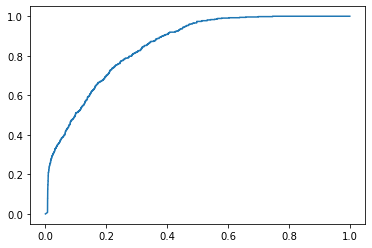

7200 7200


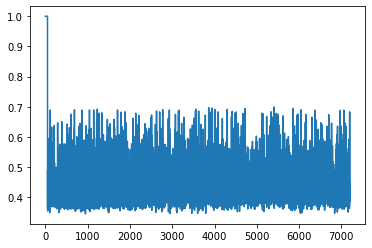

time used:42.734885692596436
TP: 6429 TN: 174 FP: 360 FN: 237
ACC: 0.9170833333333334 Precision: 0.9469730446310207 Recall: 0.9644464446444645 F1: 0.9556298773690078
FPR: 0.6741573033707865 TPR: 0.9644464446444645
AUC: 0.829379005316262


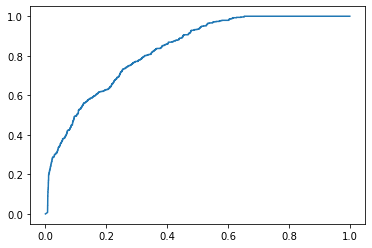

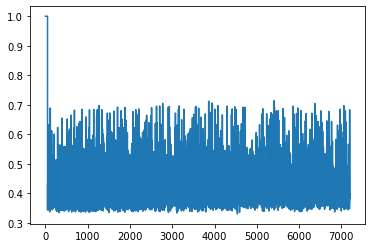

**************************************************
(683, 9)
Anomaly Ratio: 0.34992679355783307
time used:1.6354870796203613
TP: 418 TN: 174 FP: 56 FN: 2
ACC: 0.9107692307692308 Precision: 0.8818565400843882 Recall: 0.9952380952380953 F1: 0.9351230425055927
FPR: 0.24347826086956523 TPR: 0.9952380952380953
AUC: 0.9280434782608696


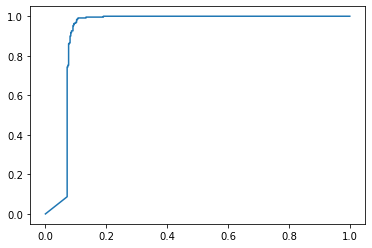

650 683


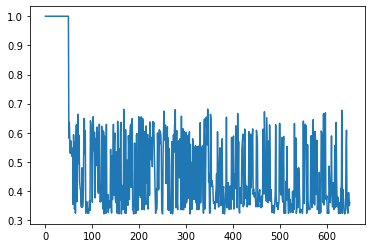

time used:3.050774335861206
TP: 441 TN: 177 FP: 62 FN: 3
ACC: 0.9048316251830161 Precision: 0.8767395626242545 Recall: 0.9932432432432432 F1: 0.9313621964097148
FPR: 0.2594142259414226 TPR: 0.9932432432432432
AUC: 0.9312827471823287


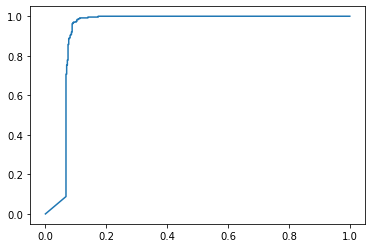

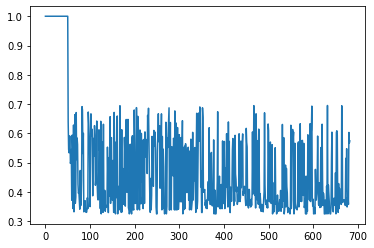

**************************************************
(351, 33)
Anomaly Ratio: 0.358974358974359
time used:0.22620654106140137
TP: 193 TN: 41 FP: 85 FN: 31
ACC: 0.6685714285714286 Precision: 0.6942446043165468 Recall: 0.8616071428571429 F1: 0.7689243027888446
FPR: 0.6746031746031746 TPR: 0.8616071428571429
AUC: 0.5890199829931972


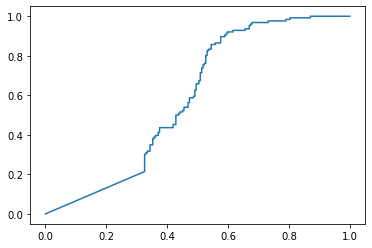

350 351


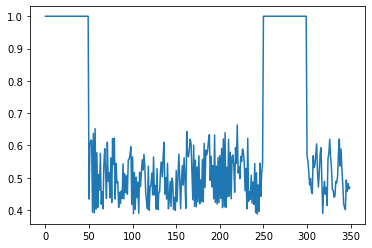

time used:1.0449504852294922
TP: 178 TN: 44 FP: 82 FN: 47
ACC: 0.6324786324786325 Precision: 0.6846153846153846 Recall: 0.7911111111111111 F1: 0.734020618556701
FPR: 0.6507936507936508 TPR: 0.7911111111111111
AUC: 0.7387301587301587


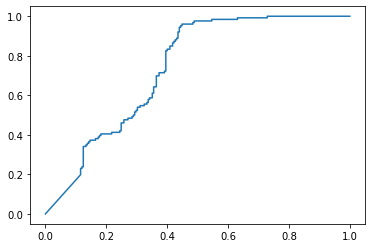

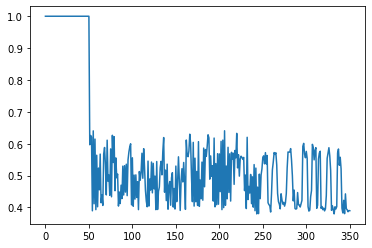

**************************************************
(11183, 6)
Anomaly Ratio: 0.023249575248144506
time used:109.89646983146667
TP: 9868 TN: 51 FP: 183 FN: 1048
ACC: 0.8895964125560538 Precision: 0.9817928564321958 Recall: 0.9039941370465372 F1: 0.9412886917537083
FPR: 0.782051282051282 TPR: 0.9039941370465372
AUC: 0.7141154441218567


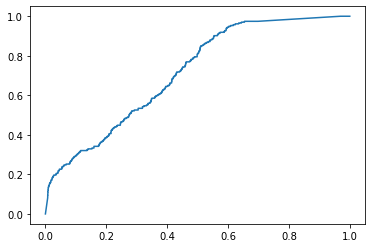

11150 11183


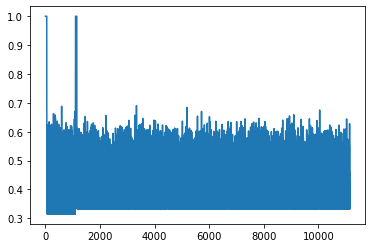

time used:65.50457048416138
TP: 9699 TN: 84 FP: 176 FN: 1224
ACC: 0.874809979433068 Precision: 0.9821772151898734 Recall: 0.8879428728371327 F1: 0.9326858351764593
FPR: 0.676923076923077 TPR: 0.8879428728371327
AUC: 0.7706580680145634


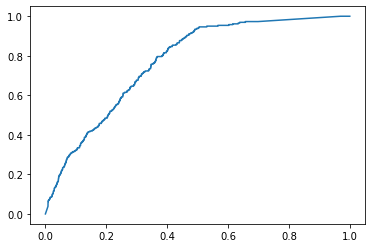

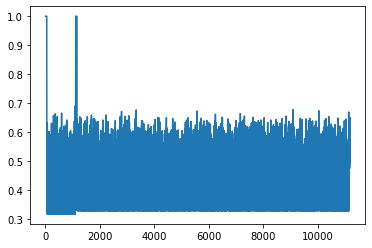

**************************************************
(262144, 4)
Anomaly Ratio: 0.09999847412109375
time used:974.33820271492
TP: 213015 TN: 26205 FP: 6 FN: 22874
ACC: 0.9127050743990843 Precision: 0.9999718337628685 Recall: 0.9030306627269605 F1: 0.9490320999754961
FPR: 0.00022891152569531876 TPR: 0.9030306627269605
AUC: 0.9847227558207485


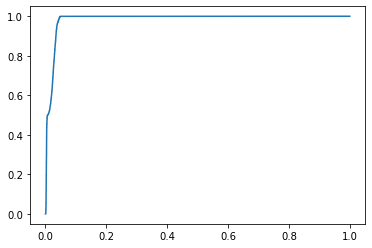

262100 262144


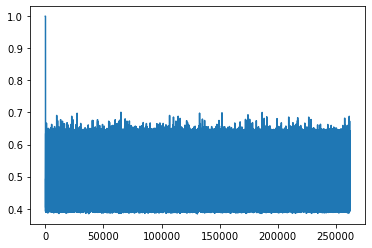

time used:1564.850614786148
TP: 212682 TN: 26208 FP: 6 FN: 23248
ACC: 0.9112930297851562 Precision: 0.9999717896637328 Recall: 0.9014622981392786 F1: 0.9481652541806169
FPR: 0.00022888532845044633 TPR: 0.9014622981392786
AUC: 0.9905036174433793


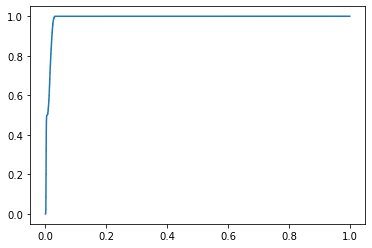

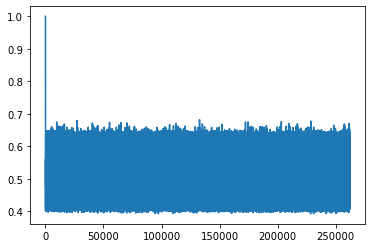

**************************************************
(768, 8)
Anomaly Ratio: 0.3489583333333333
time used:1.9848048686981201
TP: 467 TN: 16 FP: 244 FN: 23
ACC: 0.644 Precision: 0.6568213783403657 Recall: 0.9530612244897959 F1: 0.7776852622814321
FPR: 0.9384615384615385 TPR: 0.9530612244897959
AUC: 0.5514952904238619


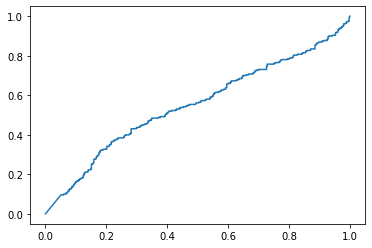

750 768


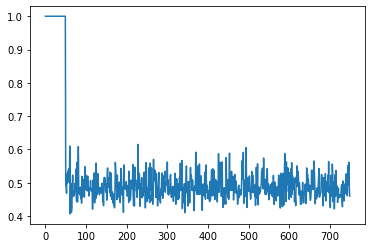

time used:3.4691545963287354
TP: 477 TN: 22 FP: 246 FN: 23
ACC: 0.6497395833333334 Precision: 0.6597510373443983 Recall: 0.954 F1: 0.7800490596892886
FPR: 0.917910447761194 TPR: 0.954
AUC: 0.6067611940298507


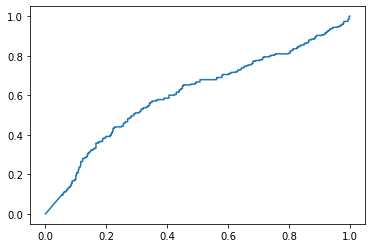

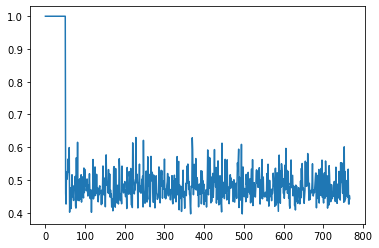

**************************************************
(6435, 36)
Anomaly Ratio: 0.3163947163947164
time used:42.77290868759155
TP: 1862 TN: 1442 FP: 587 FN: 2509
ACC: 0.51625 Precision: 0.7603103307472437 Recall: 0.4259894760924274 F1: 0.5460410557184752
FPR: 0.2893050763923115 TPR: 0.4259894760924274
AUC: 0.7209758997848514


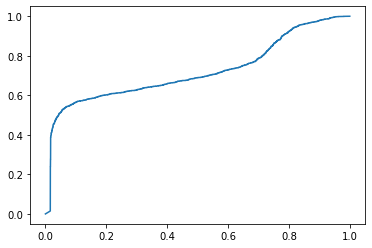

6400 6435


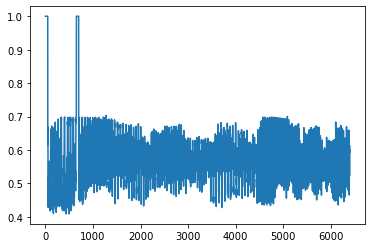

time used:36.12185001373291
TP: 3937 TN: 1117 FP: 919 FN: 462
ACC: 0.7853923853923854 Precision: 0.8107495881383855 Recall: 0.8949761309388498 F1: 0.8507833603457591
FPR: 0.45137524557956776 TPR: 0.8949761309388498
AUC: 0.7855251305105508


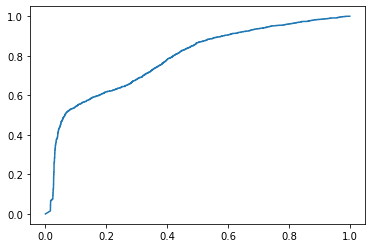

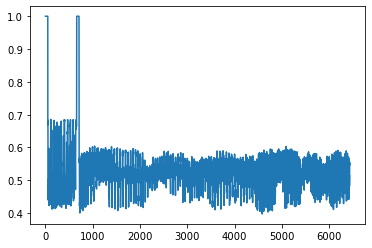

**************************************************
(662654, 3)
Anomaly Ratio: 0.003381855387577831


ValueError: No feature in X meets the variance threshold 0.00000

In [25]:
import time
real_world_result = np.zeros((len(dataset),2,12))
for data_index in range(len(dataset)):
    a = np.loadtxt(dataset[data_index])
    stream = a[:,:-1]
    label = a[:,-1]
    label = 1-label
    print('*'*50)
    print(stream.shape)
    print('Anomaly Ratio:',len(label[label==0])/len(label))
    detector = algorithm(e=10,
                         window_size=50,
                         t=75,
                         phi=35,
                         delta=0.02,
                         min_win_size=5,
                         thresh=0.55)
    prediction = []
    s_prediction = []
    tic = time.time()
    for i in range(len(stream)):
        x = stream[i]
        output,ss = detector.predict(x)
        prediction += output
        s_prediction += ss
#                     e_num.append(len(detector.ensemble))
        print(str(data_index)+'/'
                +str(len(dataset))
              +' '
              +str(i)+'/'+str(len(stream)),end='\r')
    toc = time.time()
    print('time used:'+str(toc-tic))
#     prediction = prediction[:len(label)]
#     s_prediction = s_prediction[:len(label)]
    res = evaluation(prediction,s_prediction,label[:len(prediction)])
    
    print(len(prediction),len(label))
    res.append(toc-tic)
    res = np.array(res)
    np.save("results/results_"+dataset[data_index][9:-4]+"_"+str(50)+"_proposed_2.npy",res)
    plt.figure()
    plt.plot(s_prediction)
    plt.show()
    real_world_result[data_index,0] = res
    
    detector = iForestADWIN(train_size=50,
                                     t=75,
                                     phi=35,
                                     delta=0.02,
                                     min_win_size=5,
                                     thresh=0.55)
    tic = time.time()
    for i in range(len(stream)):
        x = stream[i]
        detector.add_element(x)
        print(str(data_index)+'/'
                +str(len(dataset))
              +' '
              +str(i)+'/'+str(len(stream)),end='\r')
    prediction = detector.prediction
    s_prediction = detector.score
    toc = time.time()
    print('time used:'+str(toc-tic))

    res = evaluation(prediction,s_prediction,label[:len(prediction)])
    res.append(toc-tic)
    res = np.array(res)
    np.save("results/results_"+dataset[data_index][9:-4]+"_"+str(50)+"_SADWIN_2.npy",res)
    plt.figure()
    plt.plot(s_prediction)
    plt.show()
    
    real_world_result[data_index,1] = res
    

In [37]:
print(len(prediction),len(s_prediction),len(label[:len(prediction)]))

95166 95166 95156


**********
window_size: 20
t: 20
phi: 2
thresh: 0.45
time used:11.546044111251831
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


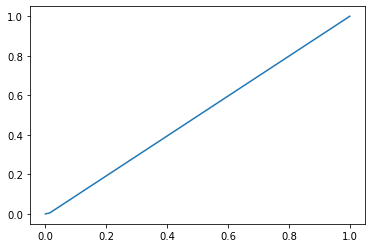

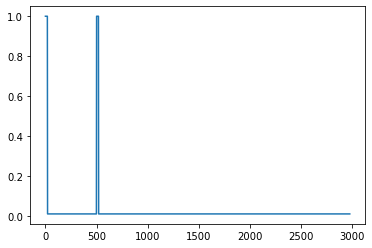

time used:20.86013627052307
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


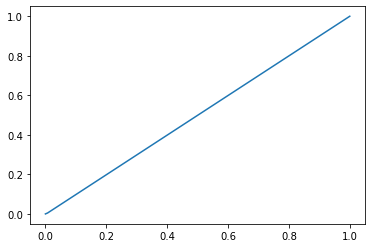

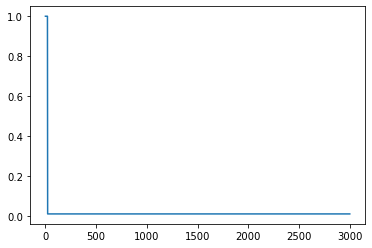

**********
window_size: 20
t: 20
phi: 2
thresh: 0.475
time used:11.569539546966553
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


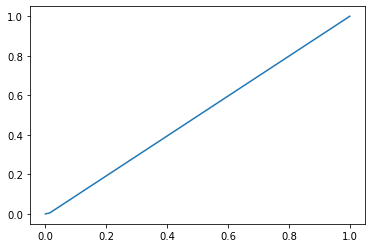

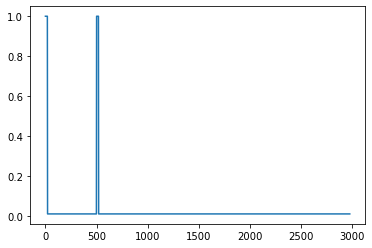

time used:21.152352809906006
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


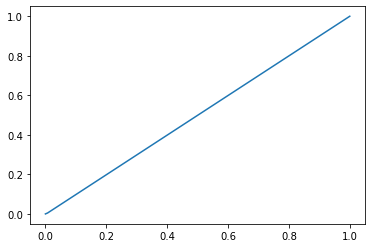

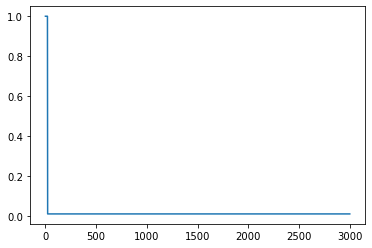

**********
window_size: 20
t: 20
phi: 2
thresh: 0.5
time used:11.69278883934021
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


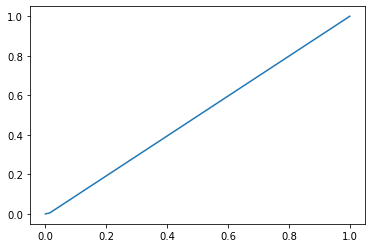

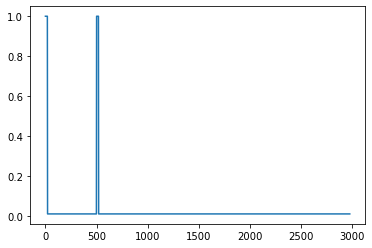

time used:21.70993709564209
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


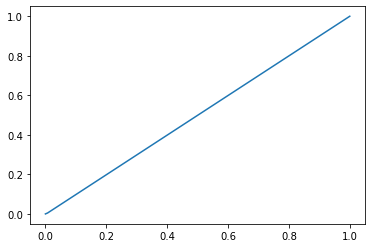

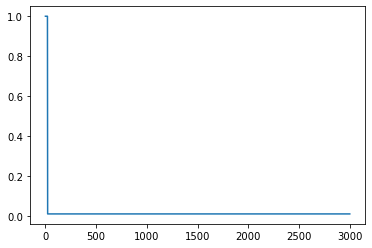

**********
window_size: 20
t: 20
phi: 2
thresh: 0.55
time used:12.89044451713562
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


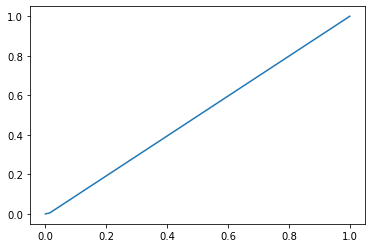

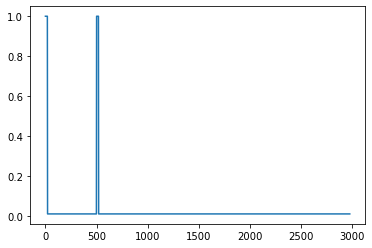

time used:21.648148775100708
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


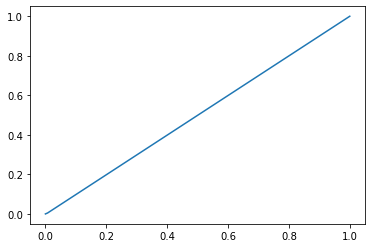

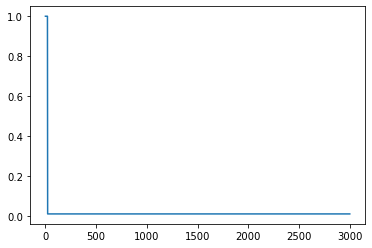

**********
window_size: 20
t: 20
phi: 2
thresh: 0.6
time used:12.89941930770874
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


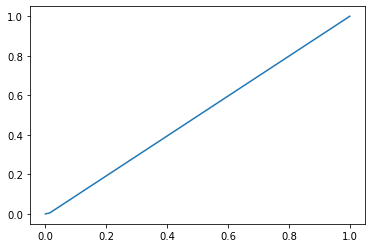

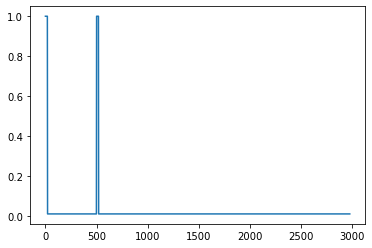

time used:21.75563669204712
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


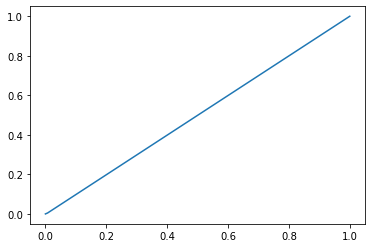

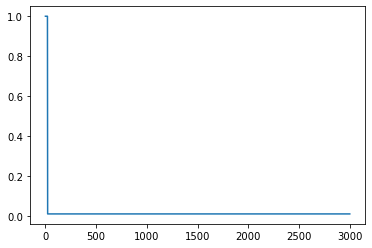

**********
window_size: 20
t: 20
phi: 2
thresh: 0.7
time used:12.614123106002808
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


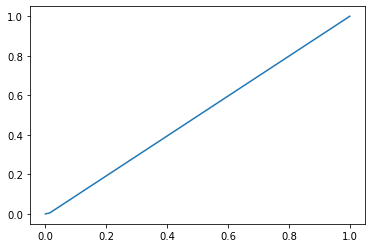

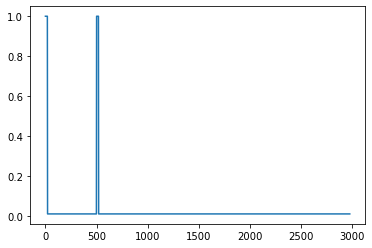

time used:21.56589674949646
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


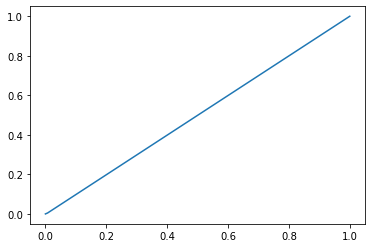

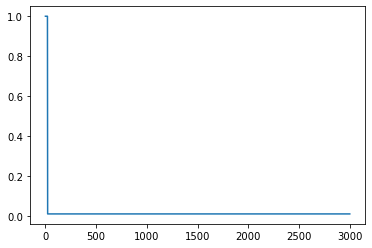

**********
window_size: 20
t: 20
phi: 5
thresh: 0.45
time used:12.940781831741333
TP: 204 TN: 207 FP: 1 FN: 2568
ACC: 0.1379194630872483 Precision: 0.9951219512195122 Recall: 0.0735930735930736 F1: 0.13705072220356063
FPR: 0.004807692307692308 TPR: 0.0735930735930736
AUC: 0.9479131979131978


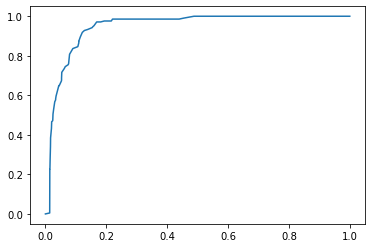

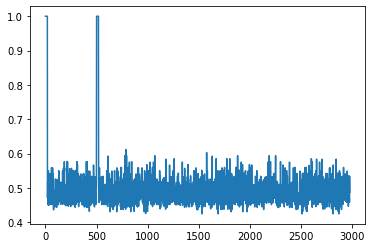

time used:22.074334383010864
TP: 169 TN: 209 FP: 1 FN: 2621
ACC: 0.126 Precision: 0.9941176470588236 Recall: 0.06057347670250896 F1: 0.11418918918918919
FPR: 0.004761904761904762 TPR: 0.06057347670250896
AUC: 0.7235825226147807


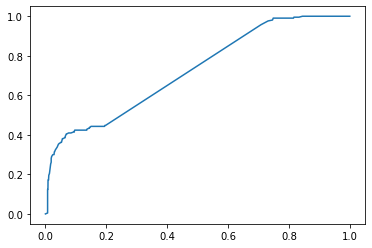

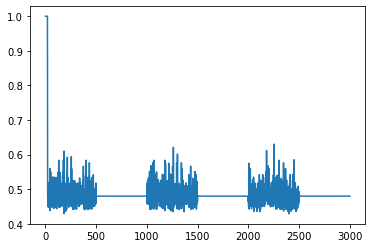

**********
window_size: 20
t: 20
phi: 5
thresh: 0.475
time used:12.858391046524048
TP: 1273 TN: 202 FP: 6 FN: 1499
ACC: 0.4949664429530201 Precision: 0.9953088350273651 Recall: 0.4592352092352092 F1: 0.6284867933843495
FPR: 0.028846153846153848 TPR: 0.4592352092352092
AUC: 0.8916959776334776


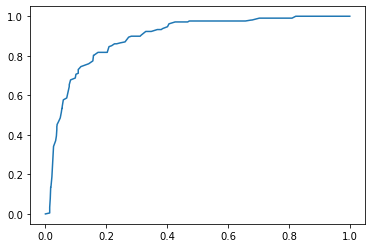

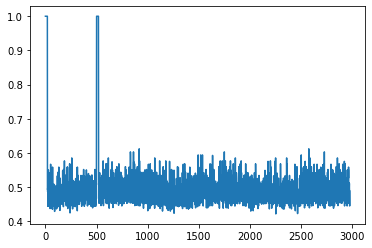

time used:21.889232873916626
TP: 990 TN: 209 FP: 1 FN: 1800
ACC: 0.39966666666666667 Precision: 0.9989909182643795 Recall: 0.3548387096774194 F1: 0.5236709865115049
FPR: 0.004761904761904762 TPR: 0.3548387096774194
AUC: 0.8213585936166581


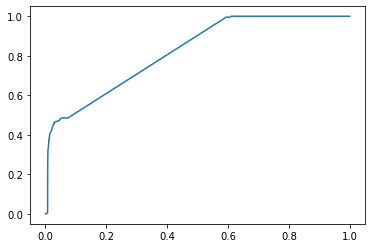

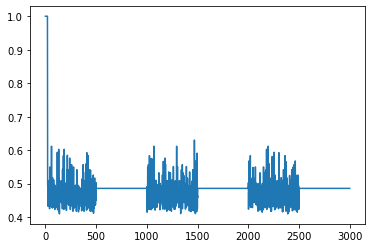

**********
window_size: 20
t: 20
phi: 5
thresh: 0.5
time used:13.25741982460022
TP: 2412 TN: 199 FP: 9 FN: 360
ACC: 0.8761744966442953 Precision: 0.9962825278810409 Recall: 0.8701298701298701 F1: 0.92894280762565
FPR: 0.04326923076923077 TPR: 0.8701298701298701
AUC: 0.9620873917748917


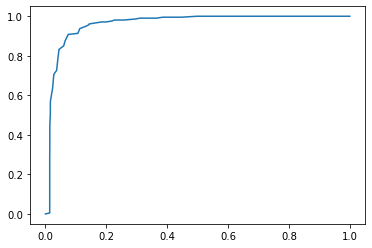

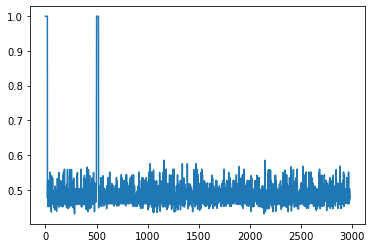

time used:21.816758632659912
TP: 1298 TN: 203 FP: 7 FN: 1492
ACC: 0.5003333333333333 Precision: 0.9946360153256705 Recall: 0.4652329749103943 F1: 0.6339438339438339
FPR: 0.03333333333333333 TPR: 0.4652329749103943
AUC: 0.7872537975763781


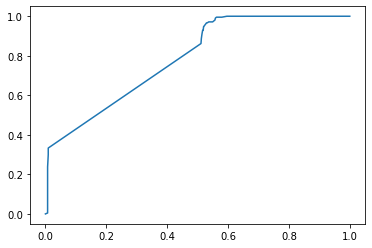

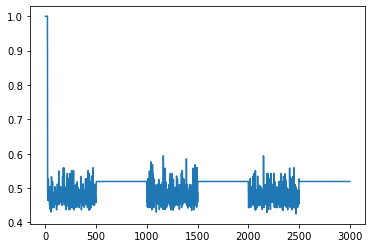

**********
window_size: 20
t: 20
phi: 5
thresh: 0.55
time used:12.861110210418701
TP: 2741 TN: 48 FP: 160 FN: 31
ACC: 0.9359060402684564 Precision: 0.9448466046190969 Recall: 0.9888167388167388 F1: 0.966331746871144
FPR: 0.7692307692307693 TPR: 0.9888167388167388
AUC: 0.8751474220224221


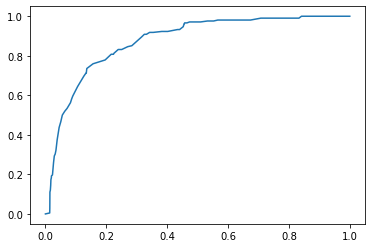

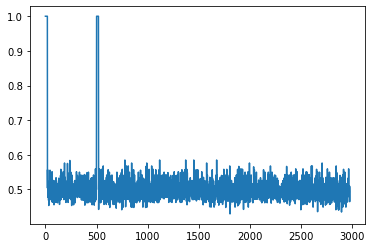

time used:22.054219961166382
TP: 2790 TN: 22 FP: 188 FN: 0
ACC: 0.9373333333333334 Precision: 0.9368703828072532 Recall: 1.0 F1: 0.9674063800277392
FPR: 0.8952380952380953 TPR: 1.0
AUC: 0.8227999658644819


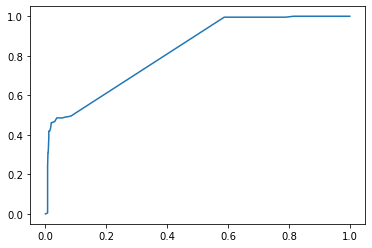

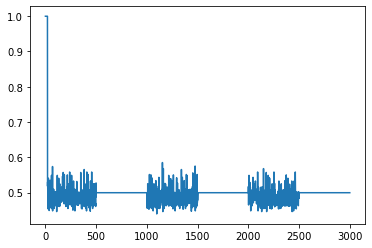

**********
window_size: 20
t: 20
phi: 5
thresh: 0.6
time used:12.639230489730835
TP: 2771 TN: 15 FP: 193 FN: 1
ACC: 0.9348993288590604 Precision: 0.934885290148448 Recall: 0.9996392496392497 F1: 0.9661785216178521
FPR: 0.9278846153846154 TPR: 0.9996392496392497
AUC: 0.942016317016317


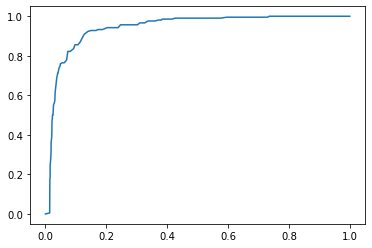

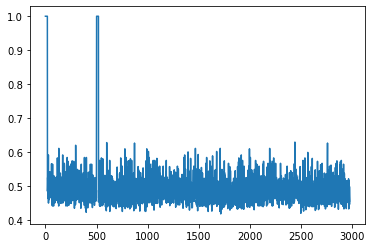

time used:21.816848039627075
TP: 2790 TN: 3 FP: 207 FN: 0
ACC: 0.931 Precision: 0.9309309309309309 Recall: 1.0 F1: 0.9642301710730948
FPR: 0.9857142857142858 TPR: 1.0
AUC: 0.7394504181600956


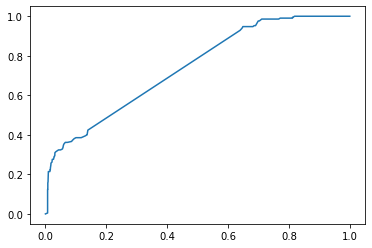

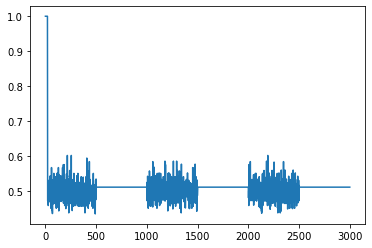

**********
window_size: 20
t: 20
phi: 5
thresh: 0.7
time used:12.66066026687622
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9304948523698524


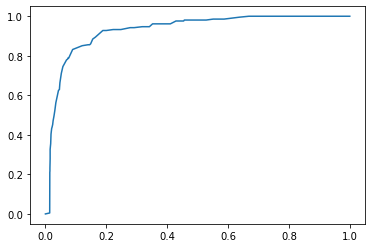

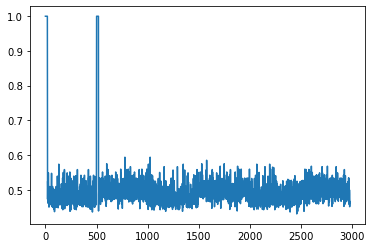

time used:22.084115982055664
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7881498549240485


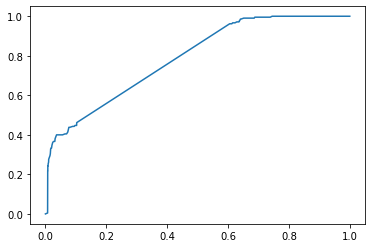

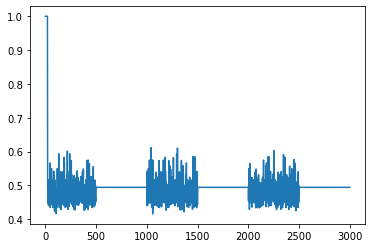

**********
window_size: 20
t: 20
phi: 10
thresh: 0.45
time used:12.740370988845825
TP: 195 TN: 207 FP: 1 FN: 2577
ACC: 0.1348993288590604 Precision: 0.9948979591836735 Recall: 0.07034632034632035 F1: 0.13140161725067384
FPR: 0.004807692307692308 TPR: 0.07034632034632035
AUC: 0.9720219017094017


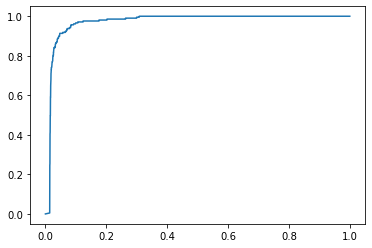

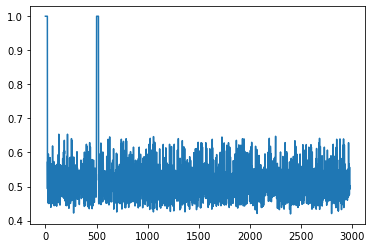

time used:21.985804557800293
TP: 264 TN: 209 FP: 1 FN: 2526
ACC: 0.15766666666666668 Precision: 0.9962264150943396 Recall: 0.09462365591397849 F1: 0.17283142389525366
FPR: 0.004761904761904762 TPR: 0.09462365591397849
AUC: 0.8280815838880354


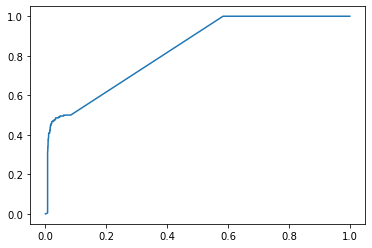

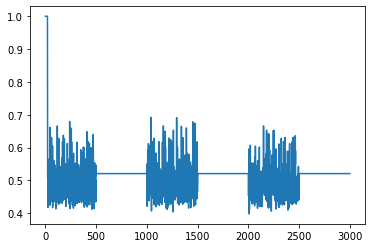

**********
window_size: 20
t: 20
phi: 10
thresh: 0.475
time used:12.635667562484741
TP: 747 TN: 207 FP: 1 FN: 2025
ACC: 0.3201342281879195 Precision: 0.9986631016042781 Recall: 0.2694805194805195 F1: 0.42443181818181813
FPR: 0.004807692307692308 TPR: 0.2694805194805195
AUC: 0.9549747127872128


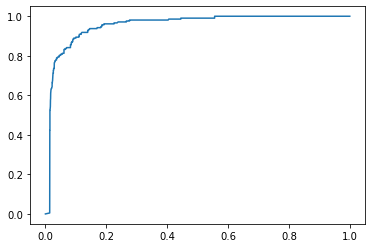

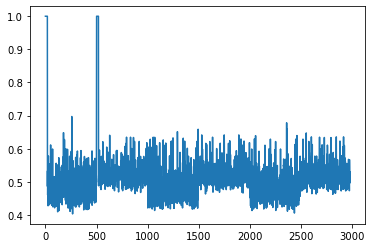

time used:17.51595115661621
TP: 1386 TN: 198 FP: 12 FN: 1404
ACC: 0.528 Precision: 0.9914163090128756 Recall: 0.4967741935483871 F1: 0.66189111747851
FPR: 0.05714285714285714 TPR: 0.4967741935483871
AUC: 0.923626898788189


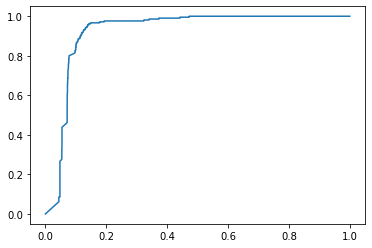

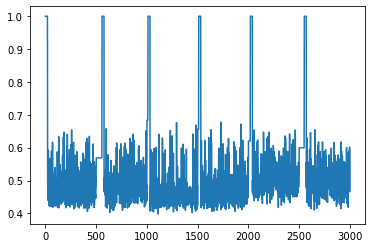

**********
window_size: 20
t: 20
phi: 10
thresh: 0.5
time used:12.909467935562134
TP: 1848 TN: 207 FP: 1 FN: 924
ACC: 0.6895973154362416 Precision: 0.9994591671173607 Recall: 0.6666666666666666 F1: 0.7998268772992859
FPR: 0.004807692307692308 TPR: 0.6666666666666666
AUC: 0.9711330336330336


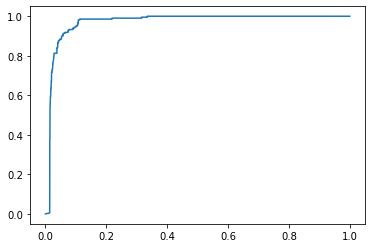

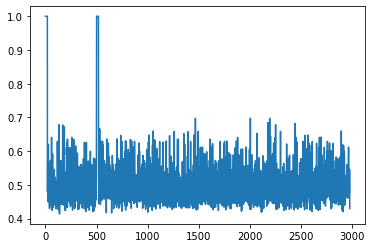

time used:21.732840538024902
TP: 614 TN: 209 FP: 1 FN: 2176
ACC: 0.2743333333333333 Precision: 0.9983739837398374 Recall: 0.22007168458781362 F1: 0.36064610866372987
FPR: 0.004761904761904762 TPR: 0.22007168458781362
AUC: 0.7975618706263867


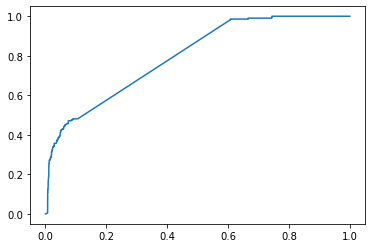

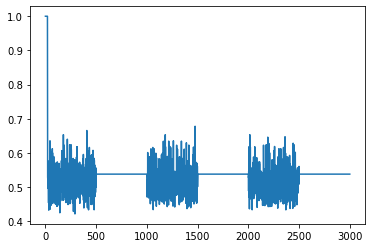

**********
window_size: 20
t: 20
phi: 10
thresh: 0.55
time used:12.85496735572815
TP: 2649 TN: 187 FP: 21 FN: 123
ACC: 0.9516778523489933 Precision: 0.9921348314606742 Recall: 0.9556277056277056 F1: 0.9735391400220508
FPR: 0.10096153846153846 TPR: 0.9556277056277056
AUC: 0.9648545898545898


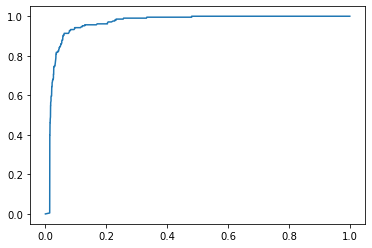

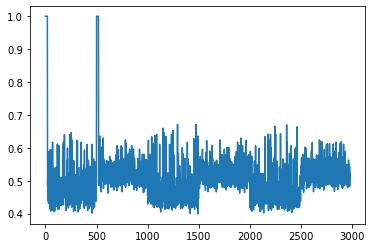

time used:19.015334367752075
TP: 2709 TN: 161 FP: 49 FN: 81
ACC: 0.9566666666666667 Precision: 0.9822335025380711 Recall: 0.9709677419354839 F1: 0.9765681326604181
FPR: 0.23333333333333334 TPR: 0.9709677419354839
AUC: 0.9364379586960232


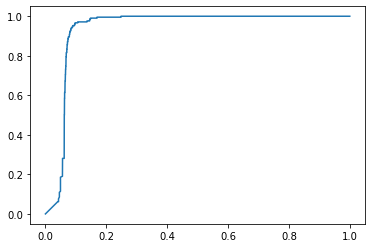

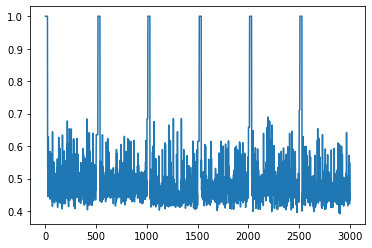

**********
window_size: 20
t: 20
phi: 10
thresh: 0.6
time used:12.787883043289185
TP: 2772 TN: 96 FP: 112 FN: 0
ACC: 0.9624161073825503 Precision: 0.9611650485436893 Recall: 1.0 F1: 0.9801980198019802
FPR: 0.5384615384615384 TPR: 1.0
AUC: 0.9712657134532134


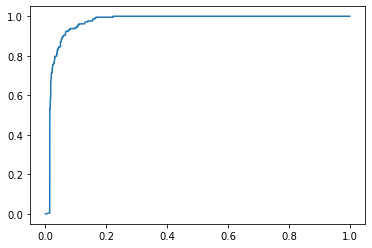

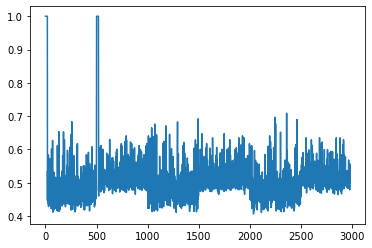

time used:22.072405099868774
TP: 2790 TN: 34 FP: 176 FN: 0
ACC: 0.9413333333333334 Precision: 0.9406608226567768 Recall: 1.0 F1: 0.9694232105628908
FPR: 0.8380952380952381 TPR: 1.0
AUC: 0.7913031233998977


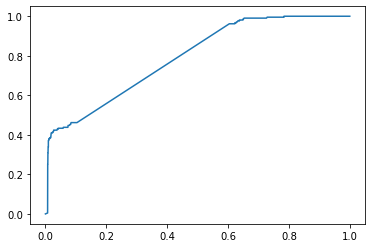

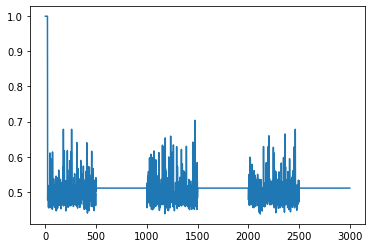

**********
window_size: 20
t: 20
phi: 10
thresh: 0.7
time used:12.688214302062988
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9770524614274615


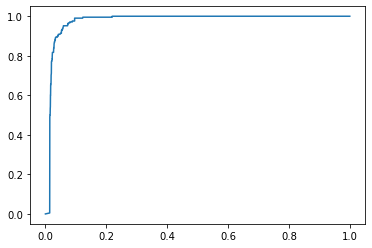

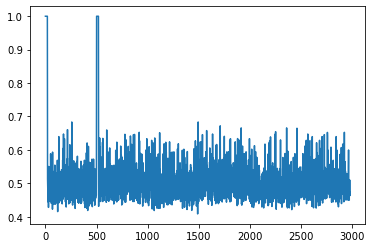

time used:21.8602192401886
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8505922512374126


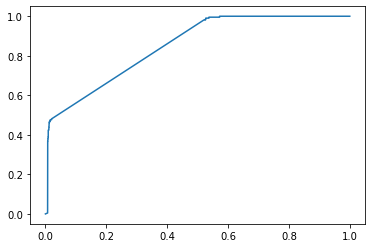

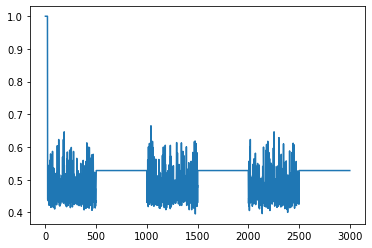

**********
window_size: 20
t: 20
phi: 15
thresh: 0.45
time used:12.603662490844727
TP: 608 TN: 207 FP: 1 FN: 2164
ACC: 0.27348993288590606 Precision: 0.9983579638752053 Recall: 0.21933621933621933 F1: 0.3596569062407572
FPR: 0.004807692307692308 TPR: 0.21933621933621933
AUC: 0.9700698606948607


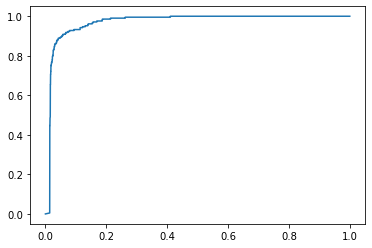

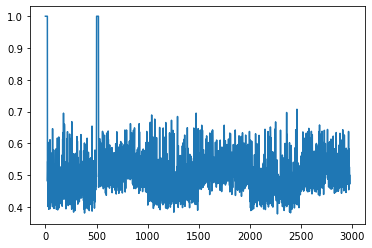

time used:18.411909580230713
TP: 1615 TN: 197 FP: 13 FN: 1175
ACC: 0.604 Precision: 0.992014742014742 Recall: 0.578853046594982 F1: 0.7311000452693527
FPR: 0.06190476190476191 TPR: 0.578853046594982
AUC: 0.9443778801843319


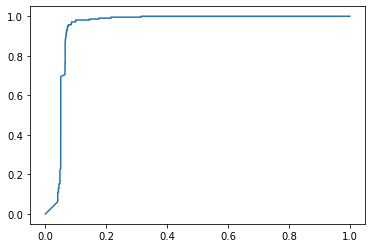

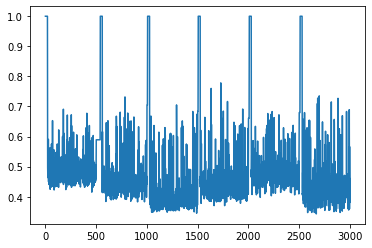

**********
window_size: 20
t: 20
phi: 15
thresh: 0.475
time used:12.544064998626709
TP: 1193 TN: 207 FP: 1 FN: 1579
ACC: 0.4697986577181208 Precision: 0.9991624790619765 Recall: 0.43037518037518036 F1: 0.6016137165910237
FPR: 0.004807692307692308 TPR: 0.43037518037518036
AUC: 0.9737059815184815


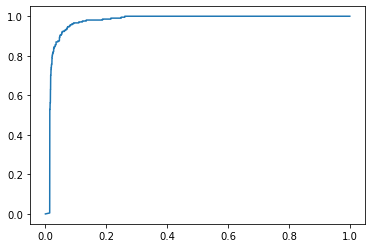

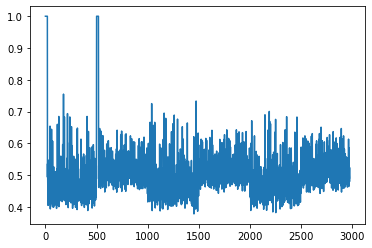

time used:17.458504915237427
TP: 1554 TN: 201 FP: 9 FN: 1236
ACC: 0.585 Precision: 0.9942418426103646 Recall: 0.556989247311828 F1: 0.7139903514817367
FPR: 0.04285714285714286 TPR: 0.556989247311828
AUC: 0.9345238095238094


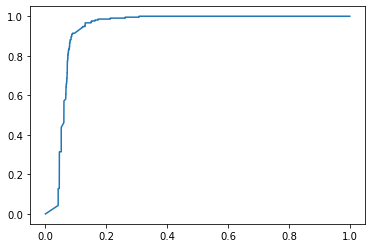

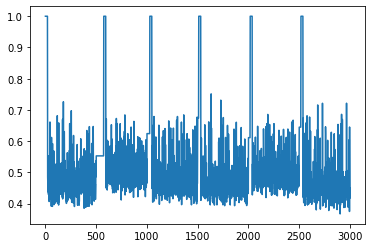

**********
window_size: 20
t: 20
phi: 15
thresh: 0.5
time used:12.45595645904541
TP: 2071 TN: 206 FP: 2 FN: 701
ACC: 0.7640939597315436 Precision: 0.9990352146647371 Recall: 0.7471139971139971 F1: 0.8549019607843137
FPR: 0.009615384615384616 TPR: 0.7471139971139971
AUC: 0.9757976398601399


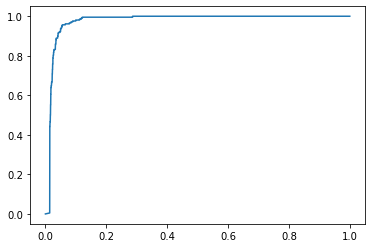

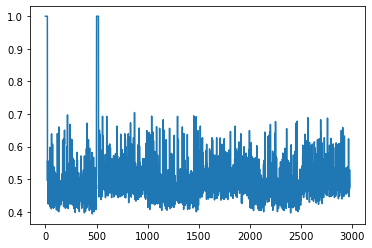

time used:18.113863229751587
TP: 2521 TN: 192 FP: 18 FN: 269
ACC: 0.9043333333333333 Precision: 0.9929105947223317 Recall: 0.903584229390681 F1: 0.9461437417902046
FPR: 0.08571428571428572 TPR: 0.903584229390681
AUC: 0.9456246799795187


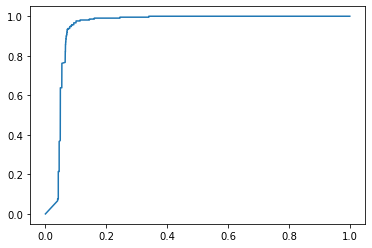

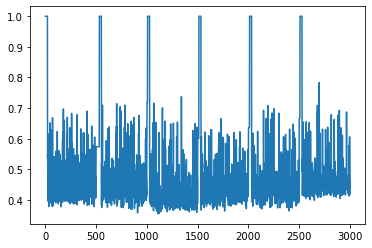

**********
window_size: 20
t: 20
phi: 15
thresh: 0.55
time used:12.433482646942139
TP: 2556 TN: 202 FP: 6 FN: 216
ACC: 0.925503355704698 Precision: 0.9976580796252927 Recall: 0.922077922077922 F1: 0.9583802024746907
FPR: 0.028846153846153848 TPR: 0.922077922077922
AUC: 0.9752053502053502


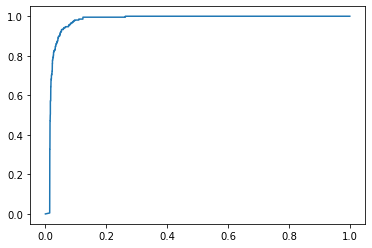

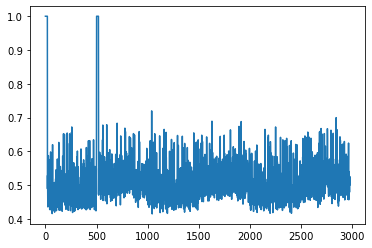

time used:21.29670763015747
TP: 2777 TN: 87 FP: 123 FN: 13
ACC: 0.9546666666666667 Precision: 0.9575862068965517 Recall: 0.9953405017921146 F1: 0.9760984182776801
FPR: 0.5857142857142857 TPR: 0.9953405017921146
AUC: 0.8348190817545657


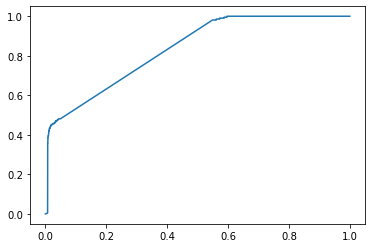

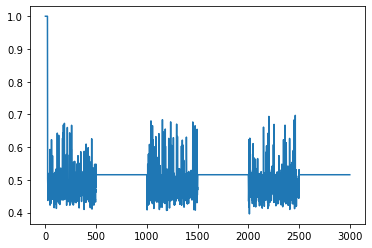

**********
window_size: 20
t: 20
phi: 15
thresh: 0.6
time used:12.450484037399292
TP: 2761 TN: 146 FP: 62 FN: 11
ACC: 0.975503355704698 Precision: 0.9780375487070493 Recall: 0.996031746031746 F1: 0.9869526362823952
FPR: 0.2980769230769231 TPR: 0.996031746031746
AUC: 0.9777765637140636


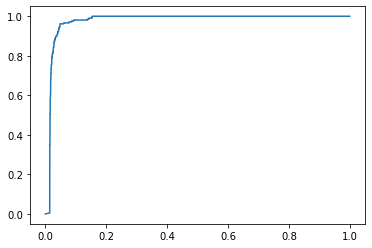

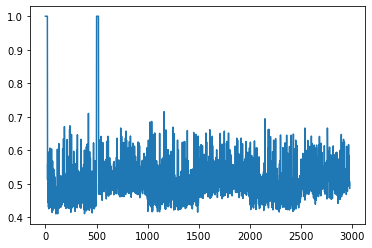

time used:18.08158540725708
TP: 2755 TN: 132 FP: 78 FN: 35
ACC: 0.9623333333333334 Precision: 0.9724673490998941 Recall: 0.9874551971326165 F1: 0.9799039658545261
FPR: 0.37142857142857144 TPR: 0.9874551971326165
AUC: 0.9440356716163169


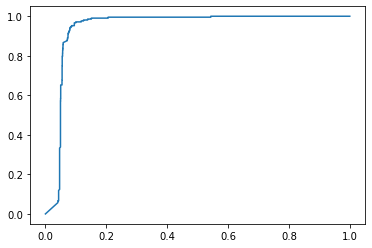

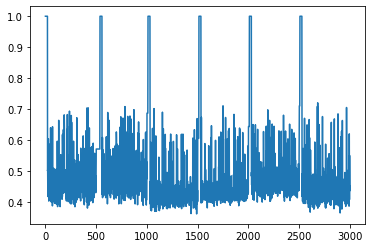

**********
window_size: 20
t: 20
phi: 15
thresh: 0.7
time used:12.464502096176147
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9747500763125763


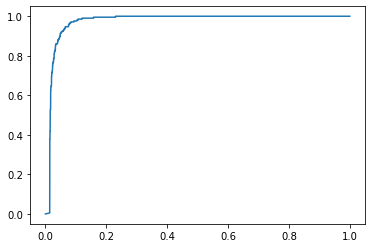

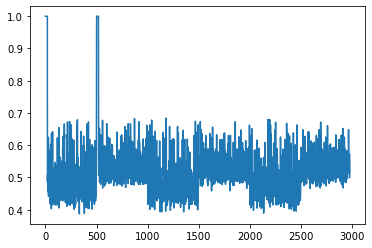

time used:18.31955361366272
TP: 2790 TN: 4 FP: 206 FN: 0
ACC: 0.9313333333333333 Precision: 0.9312416555407209 Recall: 1.0 F1: 0.9643968199101279
FPR: 0.9809523809523809 TPR: 1.0
AUC: 0.9436670080218468


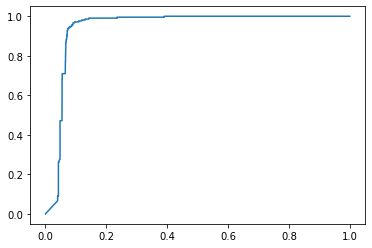

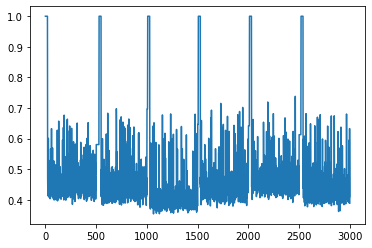

**********
window_size: 20
t: 20
phi: 18
thresh: 0.45
time used:11.428908109664917
TP: 636 TN: 207 FP: 1 FN: 2136
ACC: 0.2828859060402685 Precision: 0.9984301412872841 Recall: 0.22943722943722944 F1: 0.3731299501320035
FPR: 0.004807692307692308 TPR: 0.22943722943722944
AUC: 0.9798846986346986


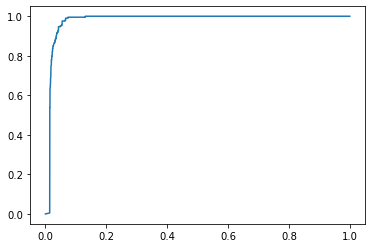

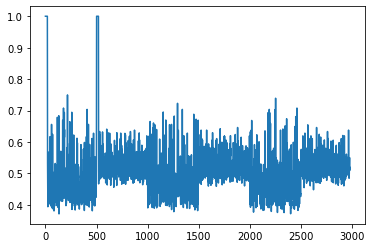

time used:16.70821785926819
TP: 1721 TN: 199 FP: 11 FN: 1069
ACC: 0.64 Precision: 0.99364896073903 Recall: 0.6168458781362007 F1: 0.7611676249447147
FPR: 0.05238095238095238 TPR: 0.6168458781362007
AUC: 0.9455060590544462


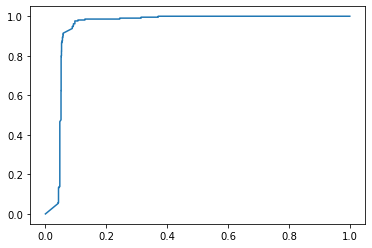

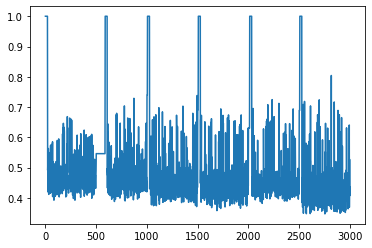

**********
window_size: 20
t: 20
phi: 18
thresh: 0.475
time used:11.397879600524902
TP: 1211 TN: 207 FP: 1 FN: 1561
ACC: 0.47583892617449663 Precision: 0.9991749174917491 Recall: 0.43686868686868685 F1: 0.6079317269076305
FPR: 0.004807692307692308 TPR: 0.43686868686868685
AUC: 0.9805212148962149


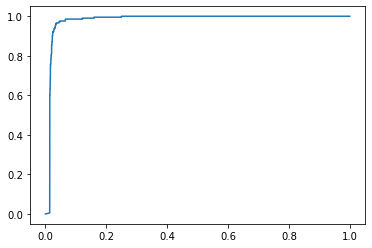

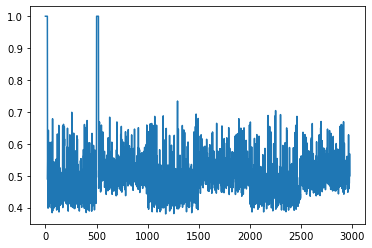

time used:17.26172137260437
TP: 2208 TN: 196 FP: 14 FN: 582
ACC: 0.8013333333333333 Precision: 0.9936993699369937 Recall: 0.7913978494623656 F1: 0.8810853950518756
FPR: 0.06666666666666667 TPR: 0.7913978494623656
AUC: 0.9471232292200035


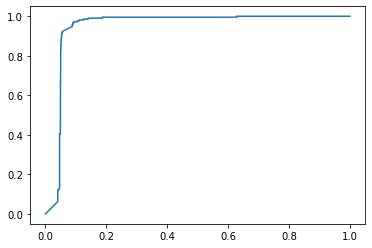

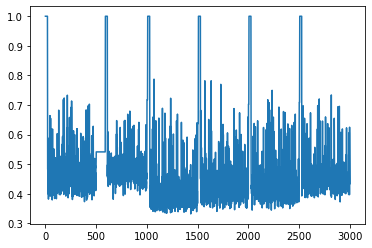

**********
window_size: 20
t: 20
phi: 18
thresh: 0.5
time used:11.382375001907349
TP: 1656 TN: 207 FP: 1 FN: 1116
ACC: 0.6251677852348994 Precision: 0.9993964996982498 Recall: 0.5974025974025974 F1: 0.7477986001354707
FPR: 0.004807692307692308 TPR: 0.5974025974025974
AUC: 0.9800624722499722


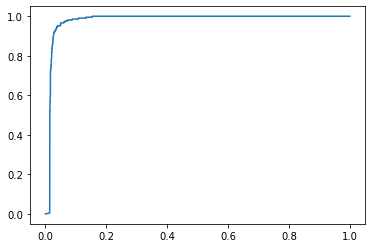

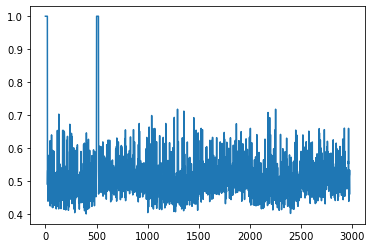

time used:17.569509029388428
TP: 2626 TN: 195 FP: 15 FN: 164
ACC: 0.9403333333333334 Precision: 0.9943203332071185 Recall: 0.9412186379928316 F1: 0.9670410605781625
FPR: 0.07142857142857142 TPR: 0.9412186379928316
AUC: 0.9493915343915343


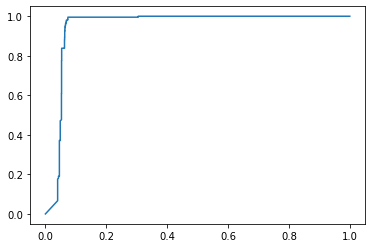

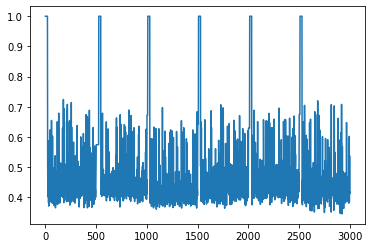

**********
window_size: 20
t: 20
phi: 18
thresh: 0.55
time used:11.440918684005737
TP: 2557 TN: 200 FP: 8 FN: 215
ACC: 0.9251677852348993 Precision: 0.9968810916179337 Recall: 0.9224386724386724 F1: 0.9582162263443881
FPR: 0.038461538461538464 TPR: 0.9224386724386724
AUC: 0.9769822191697192


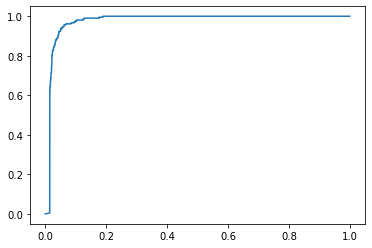

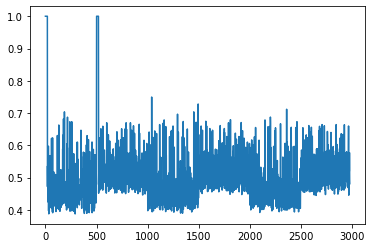

time used:16.687199115753174
TP: 2613 TN: 195 FP: 15 FN: 177
ACC: 0.936 Precision: 0.9942922374429224 Recall: 0.9365591397849462 F1: 0.964562569213732
FPR: 0.07142857142857142 TPR: 0.9365591397849462
AUC: 0.9421513910223588


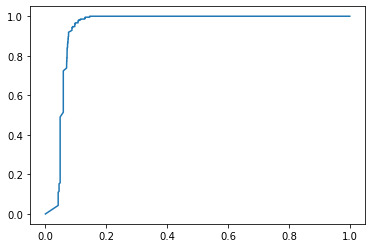

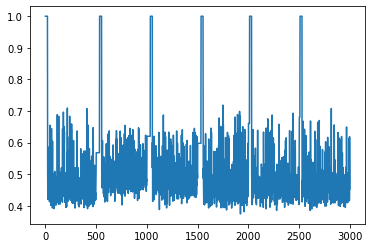

**********
window_size: 20
t: 20
phi: 18
thresh: 0.6
time used:11.406391143798828
TP: 2751 TN: 138 FP: 70 FN: 21
ACC: 0.9694630872483222 Precision: 0.9751861042183623 Recall: 0.9924242424242424 F1: 0.983729662077597
FPR: 0.33653846153846156 TPR: 0.9924242424242424
AUC: 0.9719854797979798


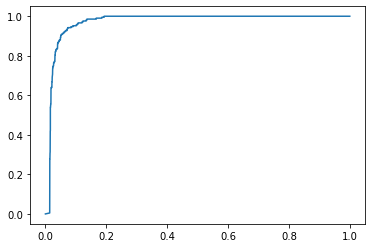

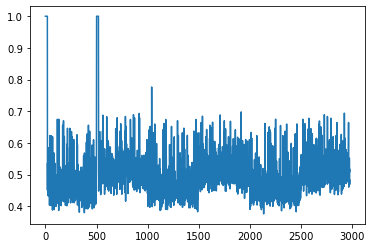

time used:16.425960540771484
TP: 2766 TN: 130 FP: 80 FN: 24
ACC: 0.9653333333333334 Precision: 0.971890372452565 Recall: 0.9913978494623656 F1: 0.9815471965933286
FPR: 0.38095238095238093 TPR: 0.9913978494623656
AUC: 0.9475780849974399


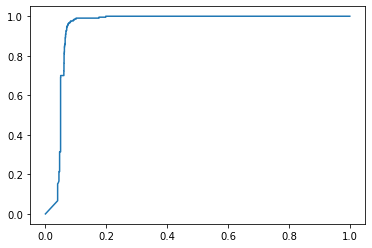

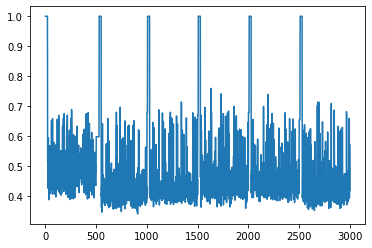

**********
window_size: 20
t: 20
phi: 18
thresh: 0.7
time used:11.413894176483154
TP: 2772 TN: 5 FP: 203 FN: 0
ACC: 0.9318791946308724 Precision: 0.9317647058823529 Recall: 1.0 F1: 0.9646772228989038
FPR: 0.9759615384615384 TPR: 1.0
AUC: 0.9763656482406482


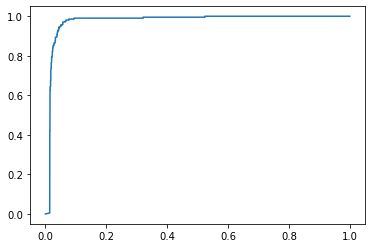

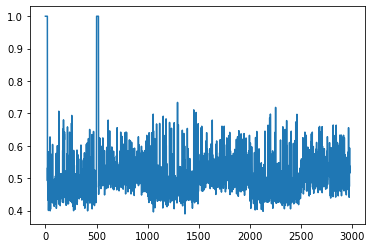

time used:16.5010507106781
TP: 2787 TN: 12 FP: 198 FN: 3
ACC: 0.933 Precision: 0.9336683417085427 Recall: 0.9989247311827957 F1: 0.9651948051948052
FPR: 0.9428571428571428 TPR: 0.9989247311827957
AUC: 0.9392037890424987


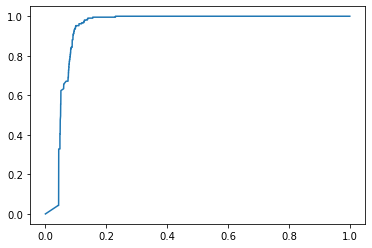

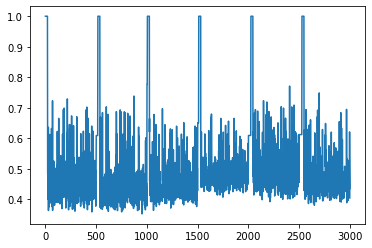

**********
window_size: 20
t: 50
phi: 2
thresh: 0.45
time used:11.350836277008057
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


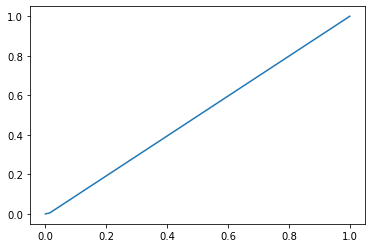

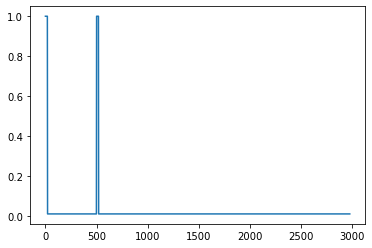

time used:20.32150650024414
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


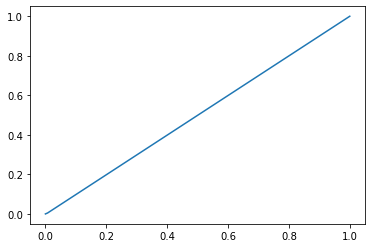

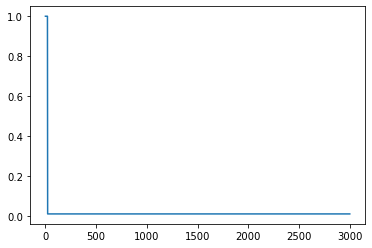

**********
window_size: 20
t: 50
phi: 2
thresh: 0.475
time used:11.323812007904053
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


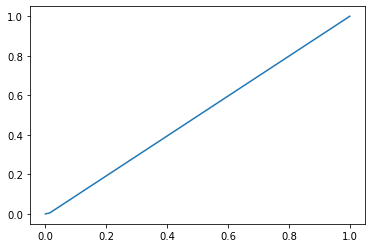

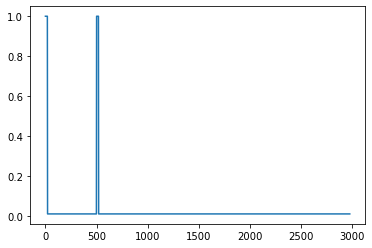

time used:20.2634539604187
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


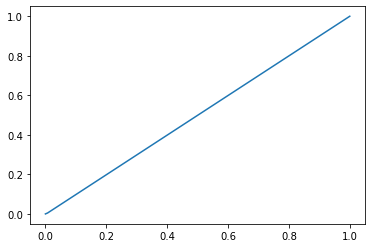

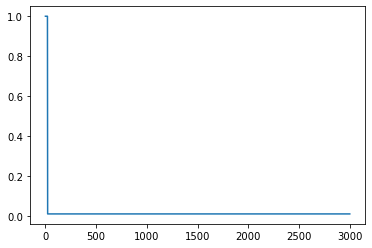

**********
window_size: 20
t: 50
phi: 2
thresh: 0.5
time used:11.417400598526001
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


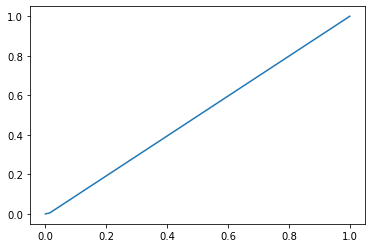

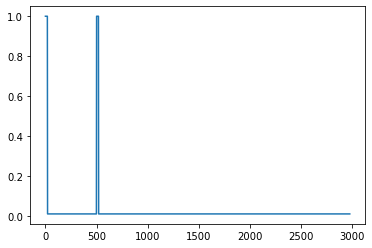

time used:20.237430572509766
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


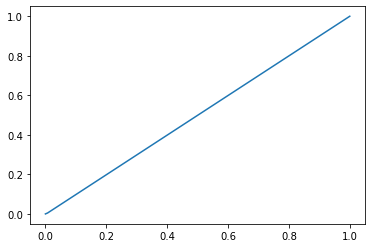

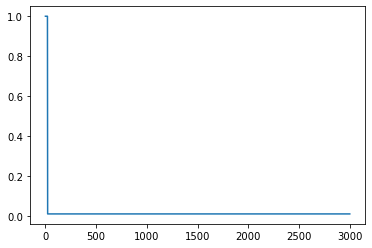

**********
window_size: 20
t: 50
phi: 2
thresh: 0.55
time used:11.333821296691895
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


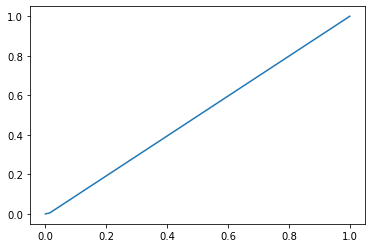

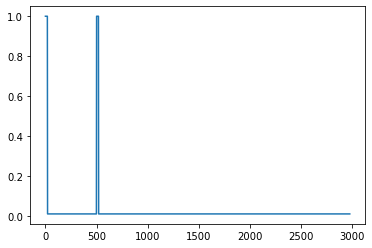

time used:20.376060485839844
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


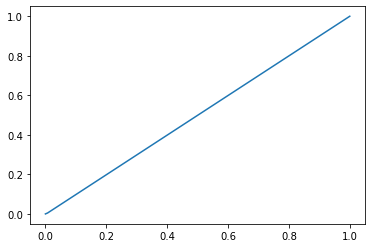

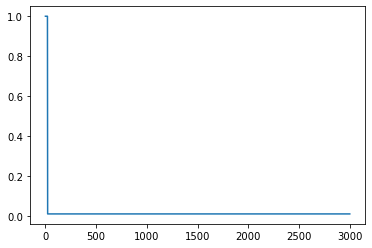

**********
window_size: 20
t: 50
phi: 2
thresh: 0.6
time used:11.329320192337036
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


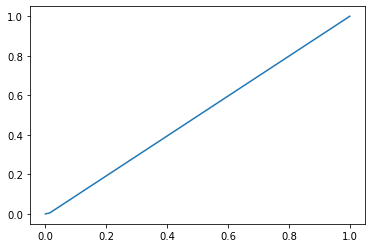

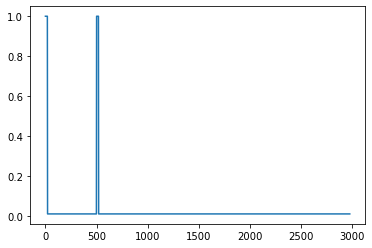

time used:20.45162534713745
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


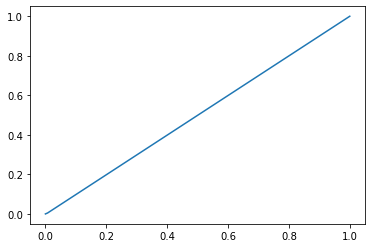

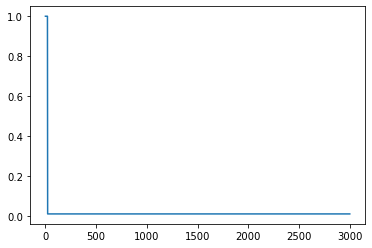

**********
window_size: 20
t: 50
phi: 2
thresh: 0.7
time used:11.329817295074463
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


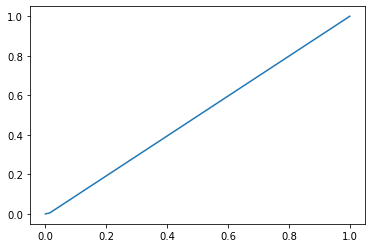

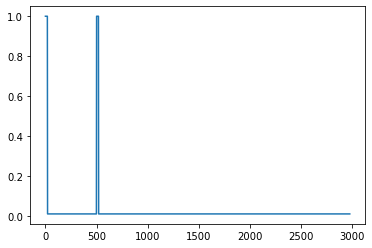

time used:20.270460844039917
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


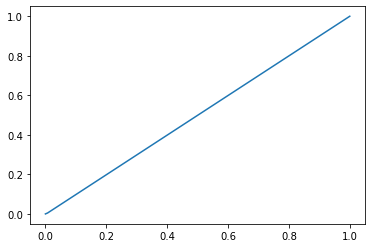

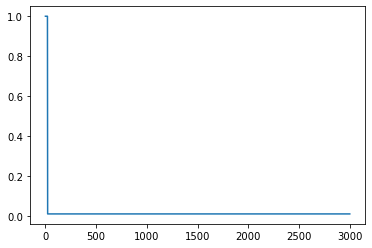

**********
window_size: 20
t: 50
phi: 5
thresh: 0.45
time used:11.450928688049316
TP: 56 TN: 207 FP: 1 FN: 2716
ACC: 0.08825503355704697 Precision: 0.9824561403508771 Recall: 0.020202020202020204 F1: 0.039589961117002484
FPR: 0.004807692307692308 TPR: 0.020202020202020204
AUC: 0.9296458749583749


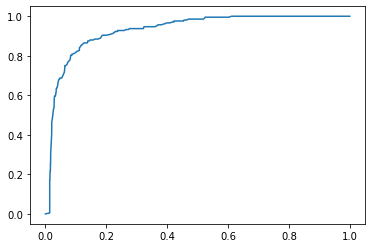

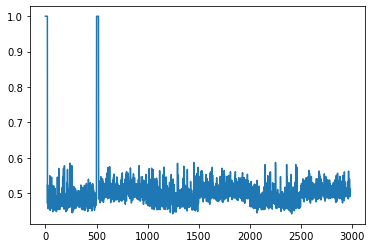

time used:20.345528602600098
TP: 67 TN: 209 FP: 1 FN: 2723
ACC: 0.092 Precision: 0.9852941176470589 Recall: 0.024014336917562724 F1: 0.046885934219734075
FPR: 0.004761904761904762 TPR: 0.024014336917562724
AUC: 0.7636431131592423


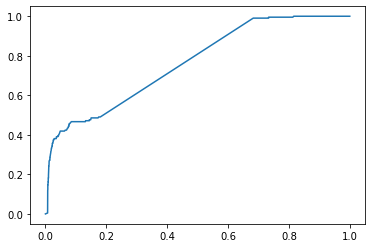

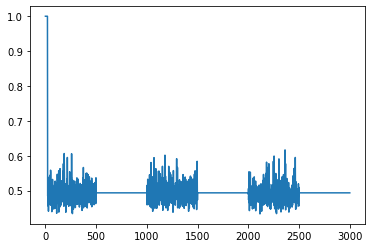

**********
window_size: 20
t: 50
phi: 5
thresh: 0.475
time used:11.463939666748047
TP: 688 TN: 207 FP: 1 FN: 2084
ACC: 0.30033557046979864 Precision: 0.9985486211901307 Recall: 0.2481962481962482 F1: 0.39757295579312335
FPR: 0.004807692307692308 TPR: 0.2481962481962482
AUC: 0.9666765526140526


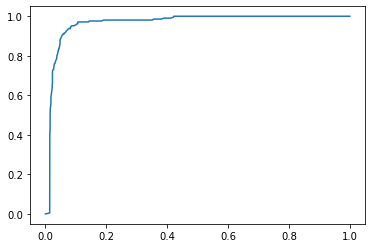

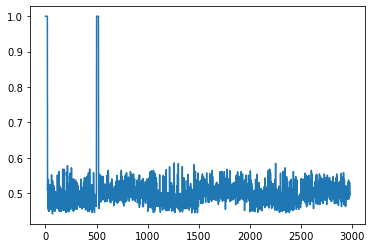

time used:20.270460605621338
TP: 358 TN: 209 FP: 1 FN: 2432
ACC: 0.189 Precision: 0.9972144846796658 Recall: 0.12831541218637993 F1: 0.22737376945061927
FPR: 0.004761904761904762 TPR: 0.12831541218637993
AUC: 0.8465719406041987


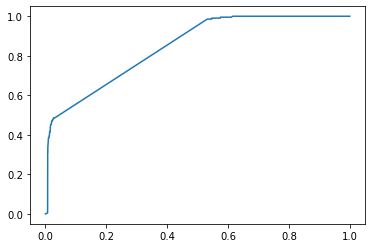

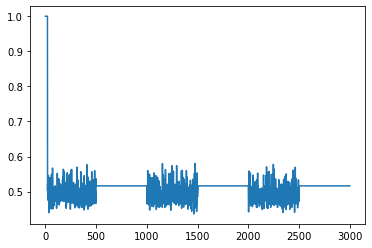

**********
window_size: 20
t: 50
phi: 5
thresh: 0.5
time used:11.472450971603394
TP: 1857 TN: 199 FP: 9 FN: 915
ACC: 0.6899328859060403 Precision: 0.9951768488745981 Recall: 0.6699134199134199 F1: 0.8007761966364813
FPR: 0.04326923076923077 TPR: 0.6699134199134199
AUC: 0.9241886585636586


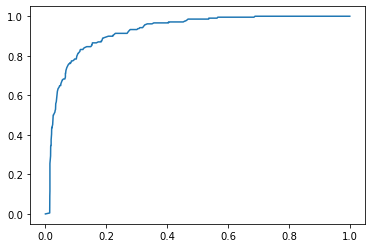

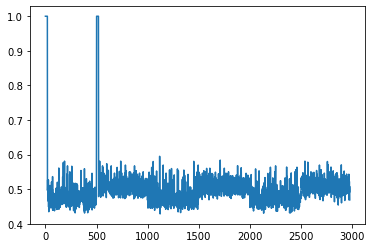

time used:20.347530126571655
TP: 1068 TN: 201 FP: 9 FN: 1722
ACC: 0.423 Precision: 0.9916434540389972 Recall: 0.3827956989247312 F1: 0.552366175329713
FPR: 0.04285714285714286 TPR: 0.3827956989247312
AUC: 0.77442140296979


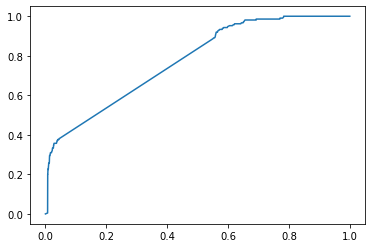

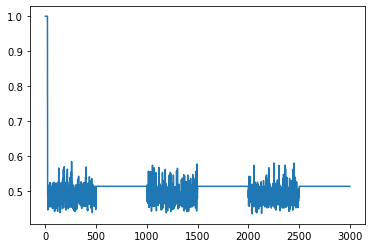

**********
window_size: 20
t: 50
phi: 5
thresh: 0.55
time used:11.454931259155273
TP: 2771 TN: 71 FP: 137 FN: 1
ACC: 0.9536912751677852 Precision: 0.9528885832187071 Recall: 0.9996392496392497 F1: 0.9757042253521127
FPR: 0.6586538461538461 TPR: 0.9996392496392497
AUC: 0.9681290931290931


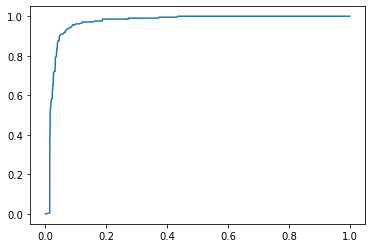

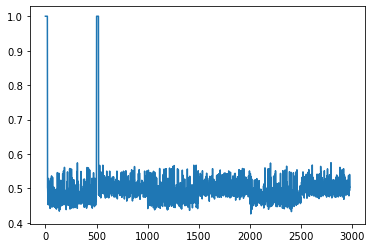

time used:20.32551074028015
TP: 2783 TN: 47 FP: 163 FN: 7
ACC: 0.9433333333333334 Precision: 0.9446707399864223 Recall: 0.9974910394265233 F1: 0.9703626220362621
FPR: 0.7761904761904762 TPR: 0.9974910394265233
AUC: 0.8069047619047619


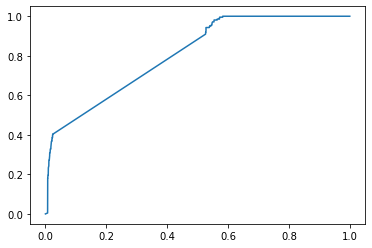

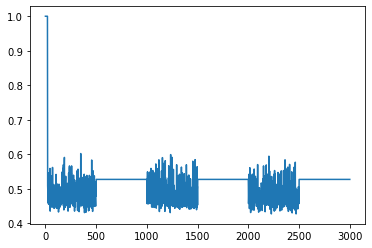

**********
window_size: 20
t: 50
phi: 5
thresh: 0.6
time used:11.442920684814453
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9637237762237763


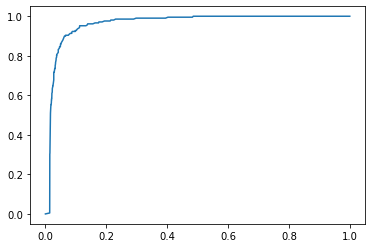

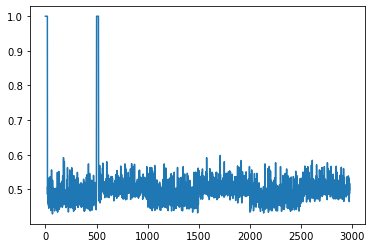

time used:20.357041835784912
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7557228195937873


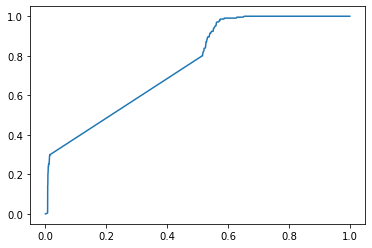

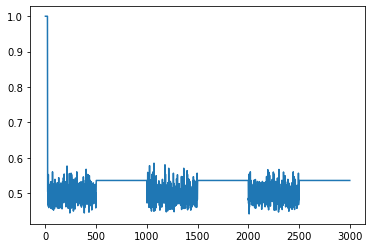

**********
window_size: 20
t: 50
phi: 5
thresh: 0.7
time used:11.449927568435669
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9641833860583862


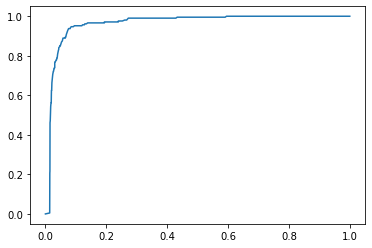

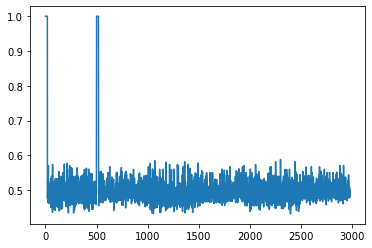

time used:20.393572092056274
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8060095579450418


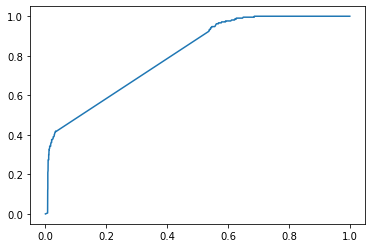

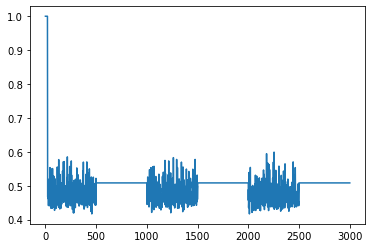

**********
window_size: 20
t: 50
phi: 10
thresh: 0.45
time used:11.569086074829102
TP: 215 TN: 207 FP: 1 FN: 2557
ACC: 0.14161073825503356 Precision: 0.9953703703703703 Recall: 0.07756132756132757 F1: 0.14390896921017404
FPR: 0.004807692307692308 TPR: 0.07756132756132757
AUC: 0.9793747918747919


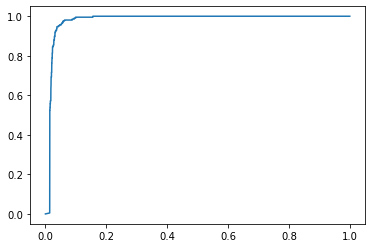

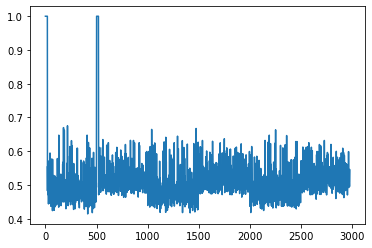

time used:17.947346687316895
TP: 852 TN: 198 FP: 12 FN: 1938
ACC: 0.35 Precision: 0.9861111111111112 Recall: 0.3053763440860215 F1: 0.4663382594417077
FPR: 0.05714285714285714 TPR: 0.3053763440860215
AUC: 0.8920361836490869


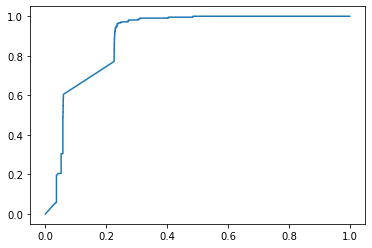

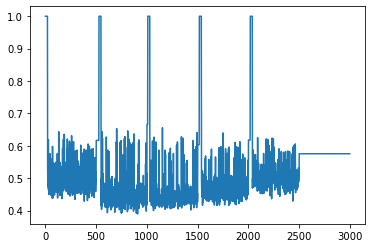

**********
window_size: 20
t: 50
phi: 10
thresh: 0.475
time used:11.515986919403076
TP: 514 TN: 207 FP: 1 FN: 2258
ACC: 0.24194630872483222 Precision: 0.9980582524271845 Recall: 0.18542568542568544 F1: 0.31274718588378464
FPR: 0.004807692307692308 TPR: 0.18542568542568544
AUC: 0.9767888361638362


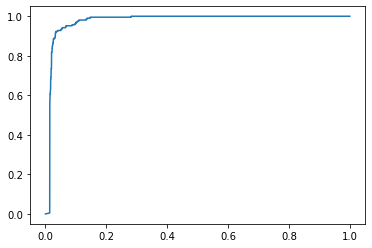

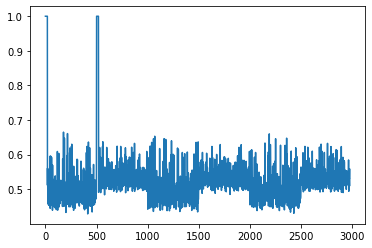

time used:20.427603721618652
TP: 465 TN: 209 FP: 1 FN: 2325
ACC: 0.22466666666666665 Precision: 0.9978540772532188 Recall: 0.16666666666666666 F1: 0.2856265356265356
FPR: 0.004761904761904762 TPR: 0.16666666666666666
AUC: 0.8628955453149001


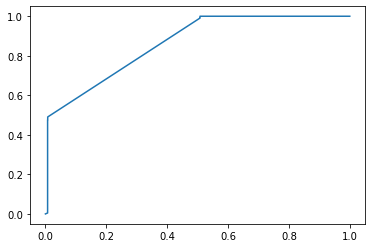

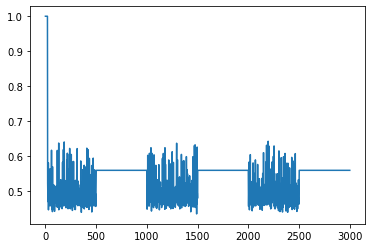

**********
window_size: 20
t: 50
phi: 10
thresh: 0.5
time used:11.624582529067993
TP: 1351 TN: 207 FP: 1 FN: 1421
ACC: 0.5228187919463088 Precision: 0.9992603550295858 Recall: 0.48737373737373735 F1: 0.6551891367604267
FPR: 0.004807692307692308 TPR: 0.48737373737373735
AUC: 0.9811490592740593


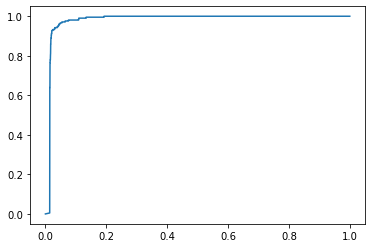

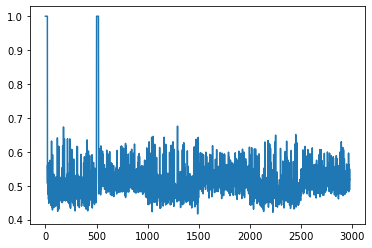

time used:20.405582666397095
TP: 1007 TN: 209 FP: 1 FN: 1783
ACC: 0.4053333333333333 Precision: 0.9990079365079365 Recall: 0.36093189964157707 F1: 0.5302790942601369
FPR: 0.004761904761904762 TPR: 0.36093189964157707
AUC: 0.8474603174603174


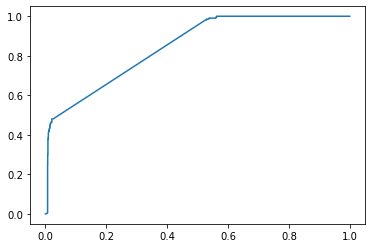

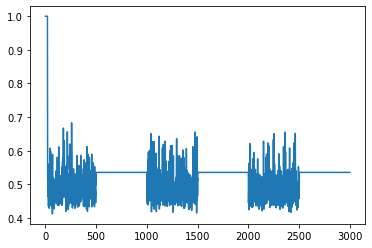

**********
window_size: 20
t: 50
phi: 10
thresh: 0.55
time used:11.510485887527466
TP: 2707 TN: 196 FP: 12 FN: 65
ACC: 0.9741610738255033 Precision: 0.9955866127252666 Recall: 0.9765512265512265 F1: 0.9859770533600436
FPR: 0.057692307692307696 TPR: 0.9765512265512265
AUC: 0.9787001193251192


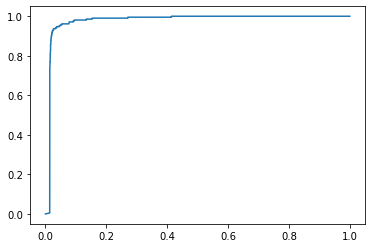

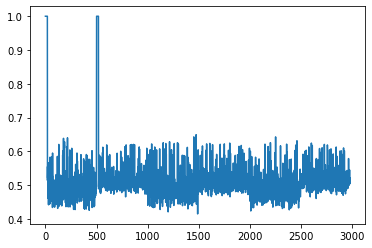

time used:20.56672978401184
TP: 1389 TN: 202 FP: 8 FN: 1401
ACC: 0.5303333333333333 Precision: 0.9942734430923408 Recall: 0.4978494623655914 F1: 0.6634822068306664
FPR: 0.0380952380952381 TPR: 0.4978494623655914
AUC: 0.8452500426693975


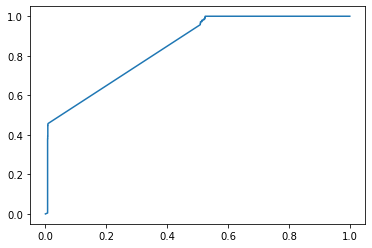

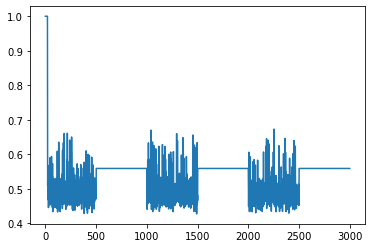

**********
window_size: 20
t: 50
phi: 10
thresh: 0.6
time used:11.501477003097534
TP: 2772 TN: 91 FP: 117 FN: 0
ACC: 0.960738255033557 Precision: 0.9595015576323987 Recall: 1.0 F1: 0.9793322734499205
FPR: 0.5625 TPR: 1.0
AUC: 0.9824533105783104


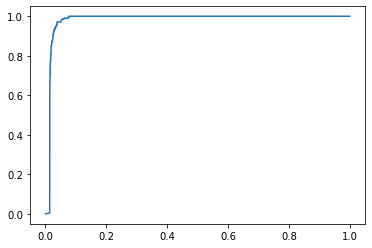

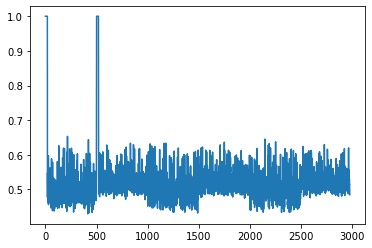

time used:16.857850074768066
TP: 2743 TN: 70 FP: 140 FN: 47
ACC: 0.9376666666666666 Precision: 0.9514394727714187 Recall: 0.9831541218637992 F1: 0.9670368411775075
FPR: 0.6666666666666666 TPR: 0.9831541218637992
AUC: 0.9382735961768219


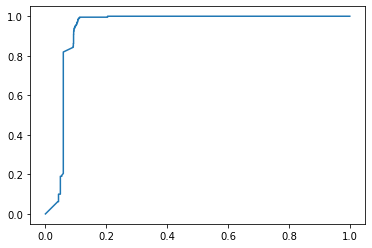

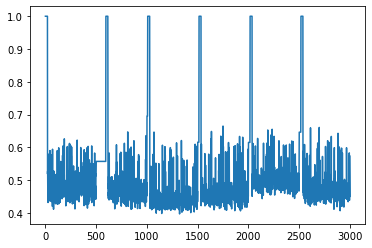

**********
window_size: 20
t: 50
phi: 10
thresh: 0.7
time used:11.583048582077026
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9805897227772229


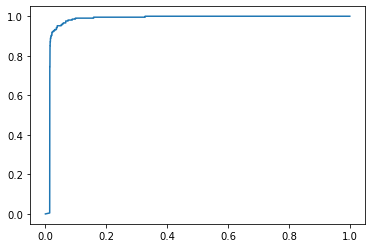

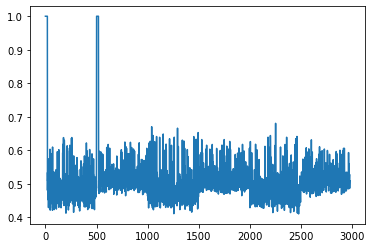

time used:16.545068502426147
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9335202252944188


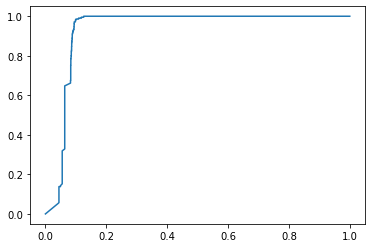

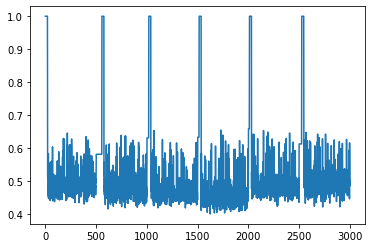

**********
window_size: 20
t: 50
phi: 15
thresh: 0.45
time used:11.527998208999634
TP: 546 TN: 207 FP: 1 FN: 2226
ACC: 0.25268456375838927 Precision: 0.9981718464351006 Recall: 0.19696969696969696 F1: 0.32901476348297676
FPR: 0.004807692307692308 TPR: 0.19696969696969696
AUC: 0.9772258991008991


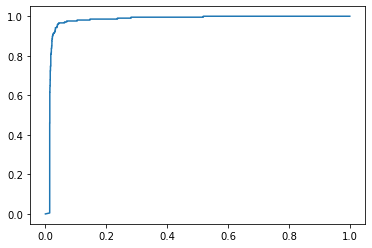

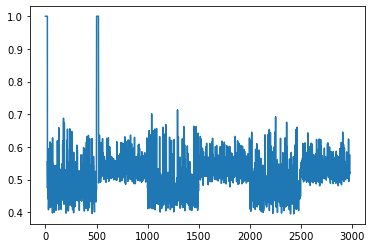

time used:20.41258955001831
TP: 258 TN: 209 FP: 1 FN: 2532
ACC: 0.15566666666666668 Precision: 0.9961389961389961 Recall: 0.09247311827956989 F1: 0.16923581502131846
FPR: 0.004761904761904762 TPR: 0.09247311827956989
AUC: 0.8508678955453148


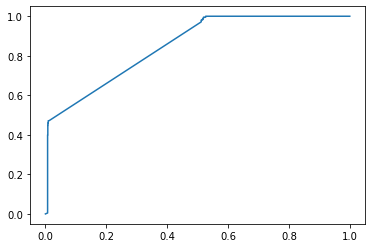

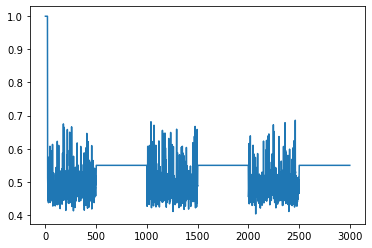

**********
window_size: 20
t: 50
phi: 15
thresh: 0.475
time used:11.546014785766602
TP: 947 TN: 207 FP: 1 FN: 1825
ACC: 0.387248322147651 Precision: 0.9989451476793249 Recall: 0.3416305916305916 F1: 0.5091397849462365
FPR: 0.004807692307692308 TPR: 0.3416305916305916
AUC: 0.9836595695970696


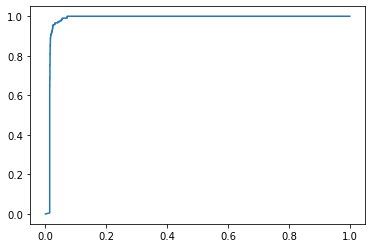

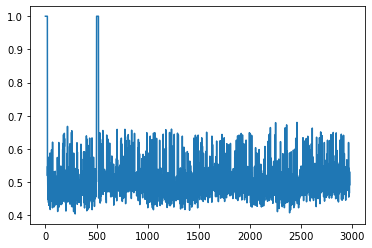

time used:17.351803302764893
TP: 2219 TN: 196 FP: 14 FN: 571
ACC: 0.805 Precision: 0.9937304075235109 Recall: 0.7953405017921147 F1: 0.8835357356161656
FPR: 0.06666666666666667 TPR: 0.7953405017921147
AUC: 0.945805598224953


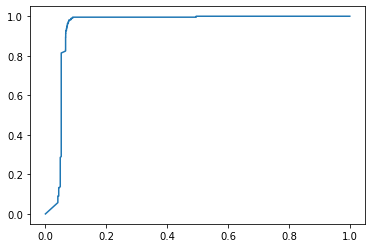

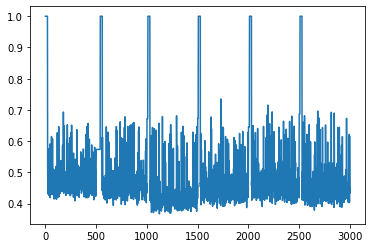

**********
window_size: 20
t: 50
phi: 15
thresh: 0.5
time used:11.562028408050537
TP: 1615 TN: 207 FP: 1 FN: 1157
ACC: 0.6114093959731544 Precision: 0.9993811881188119 Recall: 0.5826118326118326 F1: 0.736098450319052
FPR: 0.004807692307692308 TPR: 0.5826118326118326
AUC: 0.9830577408702409


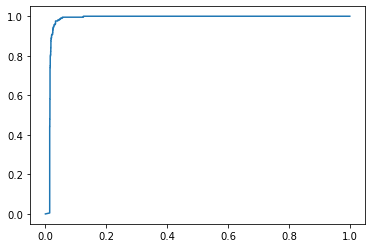

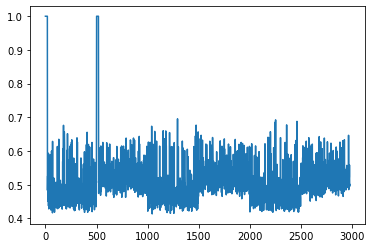

time used:17.246707439422607
TP: 2509 TN: 198 FP: 12 FN: 281
ACC: 0.9023333333333333 Precision: 0.9952399841332804 Recall: 0.8992831541218638 F1: 0.9448314818301637
FPR: 0.05714285714285714 TPR: 0.8992831541218638
AUC: 0.9448122546509644


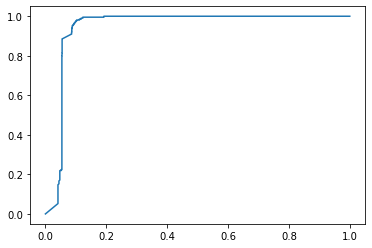

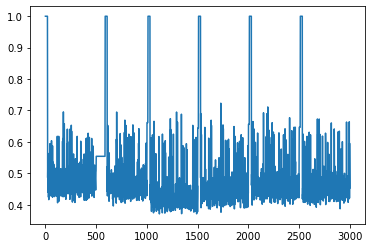

**********
window_size: 20
t: 50
phi: 15
thresh: 0.55
time used:11.54801607131958
TP: 2544 TN: 201 FP: 7 FN: 228
ACC: 0.9211409395973155 Precision: 0.9972559780478244 Recall: 0.9177489177489178 F1: 0.9558519631786586
FPR: 0.03365384615384615 TPR: 0.9177489177489178
AUC: 0.9772892038517038


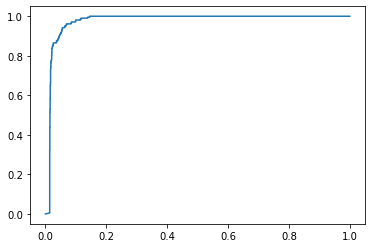

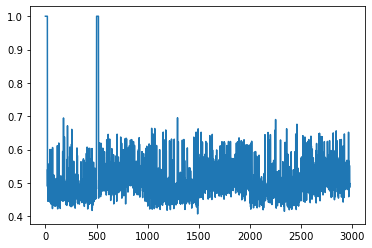

time used:17.418360471725464
TP: 2711 TN: 186 FP: 24 FN: 79
ACC: 0.9656666666666667 Precision: 0.9912248628884827 Recall: 0.9716845878136201 F1: 0.9813574660633485
FPR: 0.11428571428571428 TPR: 0.9716845878136201
AUC: 0.9474278887182113


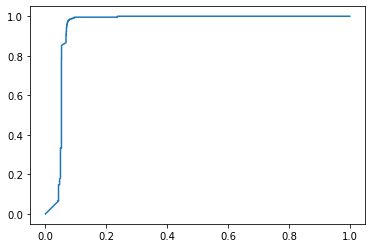

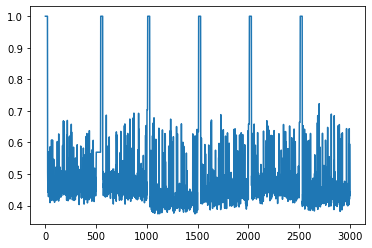

**********
window_size: 20
t: 50
phi: 15
thresh: 0.6
time used:11.533505916595459
TP: 2771 TN: 149 FP: 59 FN: 1
ACC: 0.9798657718120806 Precision: 0.9791519434628976 Recall: 0.9996392496392497 F1: 0.9892895394501963
FPR: 0.28365384615384615 TPR: 0.9996392496392497
AUC: 0.979334034021534


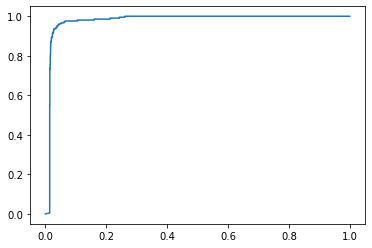

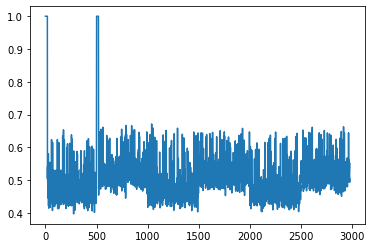

time used:16.719724416732788
TP: 2762 TN: 125 FP: 85 FN: 28
ACC: 0.9623333333333334 Precision: 0.9701440112399017 Recall: 0.9899641577060931 F1: 0.9799538761752704
FPR: 0.40476190476190477 TPR: 0.9899641577060931
AUC: 0.9461230585424134


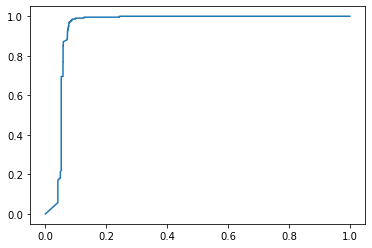

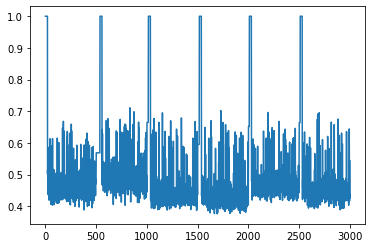

**********
window_size: 20
t: 50
phi: 15
thresh: 0.7
time used:11.566032409667969
TP: 2772 TN: 3 FP: 205 FN: 0
ACC: 0.9312080536912751 Precision: 0.9311387302653679 Recall: 1.0 F1: 0.9643416246303704
FPR: 0.9855769230769231 TPR: 1.0
AUC: 0.9838399447774449


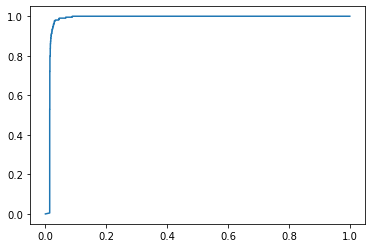

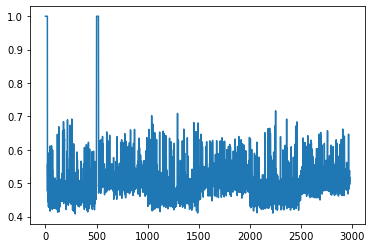

time used:16.598620414733887
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9427282812766684


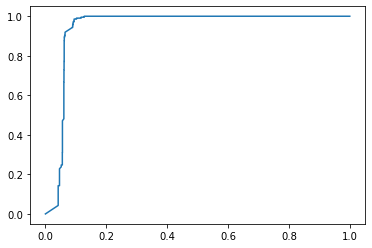

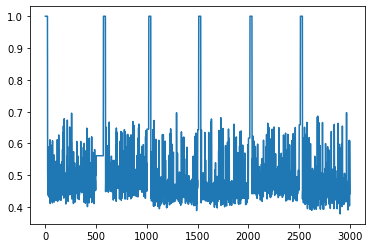

**********
window_size: 20
t: 50
phi: 18
thresh: 0.45
time used:11.913398265838623
TP: 526 TN: 207 FP: 1 FN: 2246
ACC: 0.2459731543624161 Precision: 0.9981024667931688 Recall: 0.18975468975468976 F1: 0.31888451045771443
FPR: 0.004807692307692308 TPR: 0.18975468975468976
AUC: 0.9846290861915862


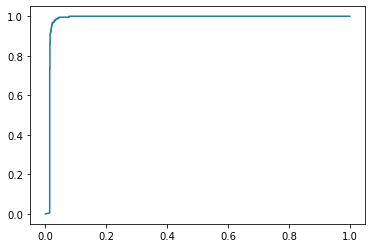

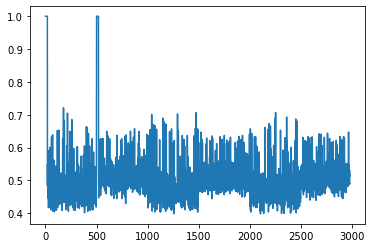

time used:17.827733278274536
TP: 1970 TN: 196 FP: 14 FN: 820
ACC: 0.722 Precision: 0.9929435483870968 Recall: 0.7060931899641577 F1: 0.825303728529535
FPR: 0.06666666666666667 TPR: 0.7060931899641577
AUC: 0.9523229220003413


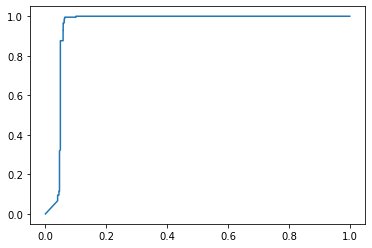

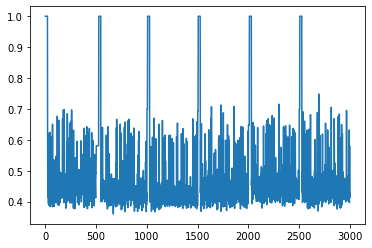

**********
window_size: 20
t: 50
phi: 18
thresh: 0.475
time used:11.622101068496704
TP: 1482 TN: 207 FP: 1 FN: 1290
ACC: 0.5667785234899329 Precision: 0.9993256911665542 Recall: 0.5346320346320347 F1: 0.6965922444183315
FPR: 0.004807692307692308 TPR: 0.5346320346320347
AUC: 0.983546835109335


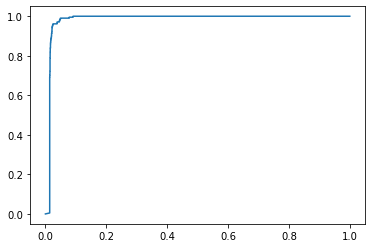

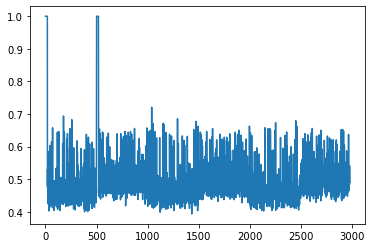

time used:18.195595264434814
TP: 2378 TN: 197 FP: 13 FN: 412
ACC: 0.8583333333333333 Precision: 0.9945629443747386 Recall: 0.8523297491039427 F1: 0.9179695039567651
FPR: 0.06190476190476191 TPR: 0.8523297491039427
AUC: 0.9491073562041303


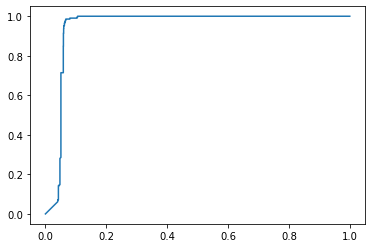

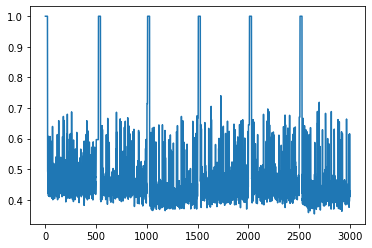

**********
window_size: 20
t: 50
phi: 18
thresh: 0.5
time used:12.024470806121826
TP: 1711 TN: 207 FP: 1 FN: 1061
ACC: 0.6436241610738255 Precision: 0.9994158878504673 Recall: 0.6172438672438673 F1: 0.7631578947368421
FPR: 0.004807692307692308 TPR: 0.6172438672438673
AUC: 0.9846707112332113


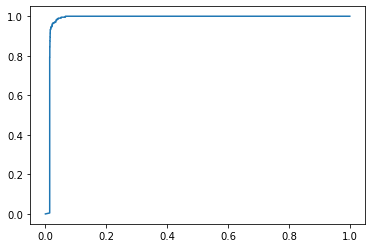

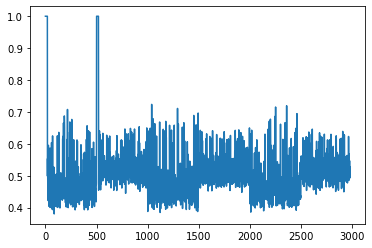

time used:17.93705940246582
TP: 2638 TN: 196 FP: 14 FN: 152
ACC: 0.9446666666666667 Precision: 0.9947209653092006 Recall: 0.9455197132616487 F1: 0.9694965086365306
FPR: 0.06666666666666667 TPR: 0.9455197132616487
AUC: 0.9502227342549924


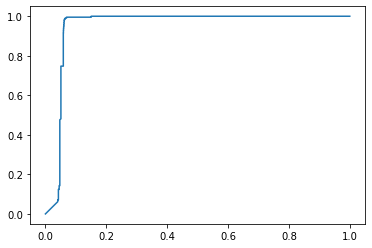

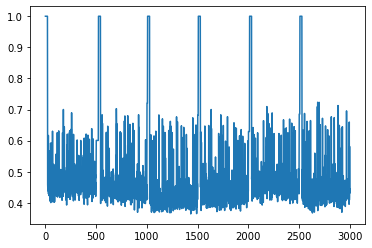

**********
window_size: 20
t: 50
phi: 18
thresh: 0.55
time used:13.142030954360962
TP: 2671 TN: 202 FP: 6 FN: 101
ACC: 0.9640939597315437 Precision: 0.9977586850952559 Recall: 0.9635642135642135 F1: 0.9803633694255826
FPR: 0.028846153846153848 TPR: 0.9635642135642135
AUC: 0.9807544885669885


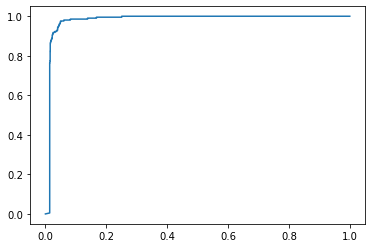

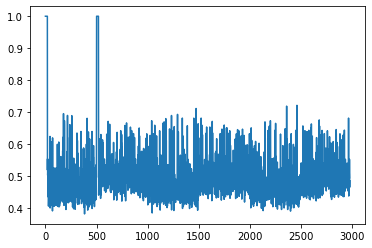

time used:18.227691650390625
TP: 2674 TN: 191 FP: 19 FN: 116
ACC: 0.955 Precision: 0.9929446713702191 Recall: 0.9584229390681004 F1: 0.9753784424585082
FPR: 0.09047619047619047 TPR: 0.9584229390681004
AUC: 0.9495289298515105


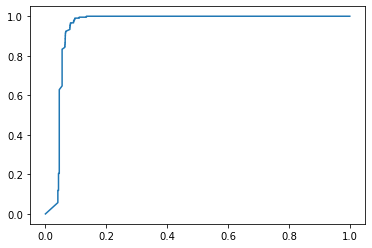

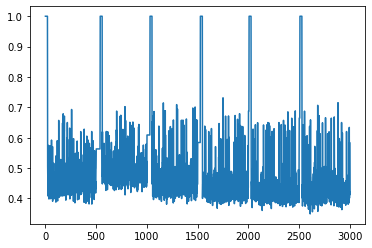

**********
window_size: 20
t: 50
phi: 18
thresh: 0.6
time used:13.405523538589478
TP: 2771 TN: 164 FP: 44 FN: 1
ACC: 0.9848993288590604 Precision: 0.9843694493783304 Recall: 0.9996392496392497 F1: 0.9919455879720781
FPR: 0.21153846153846154 TPR: 0.9996392496392497
AUC: 0.9844383047508047


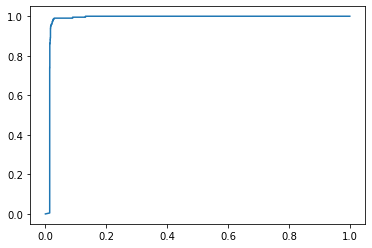

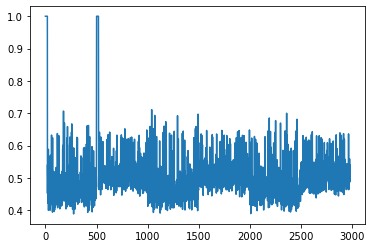

time used:18.955860137939453
TP: 2755 TN: 142 FP: 68 FN: 35
ACC: 0.9656666666666667 Precision: 0.9759121501948282 Recall: 0.9874551971326165 F1: 0.9816497416711205
FPR: 0.3238095238095238 TPR: 0.9874551971326165
AUC: 0.9513884621949138


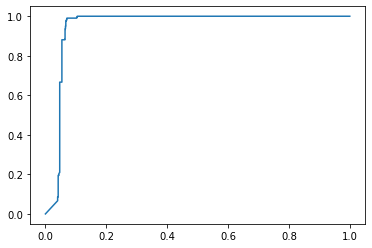

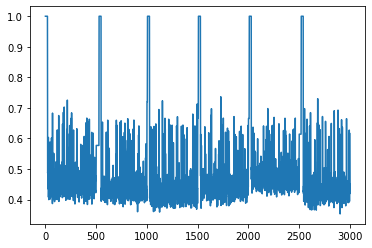

**********
window_size: 20
t: 50
phi: 18
thresh: 0.7
time used:13.26547384262085
TP: 2772 TN: 8 FP: 200 FN: 0
ACC: 0.9328859060402684 Precision: 0.9327052489905787 Recall: 1.0 F1: 0.9651810584958217
FPR: 0.9615384615384616 TPR: 1.0
AUC: 0.9812227702852703


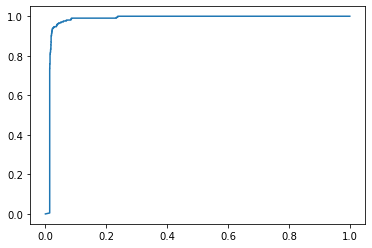

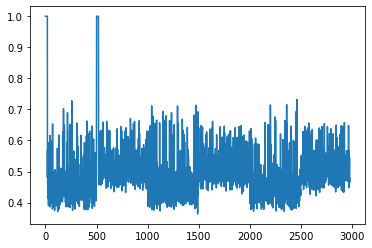

time used:19.447071313858032
TP: 2786 TN: 4 FP: 206 FN: 4
ACC: 0.93 Precision: 0.9311497326203209 Recall: 0.9985663082437276 F1: 0.9636803874092008
FPR: 0.9809523809523809 TPR: 0.9985663082437276
AUC: 0.949584400068271


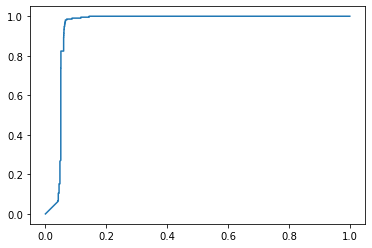

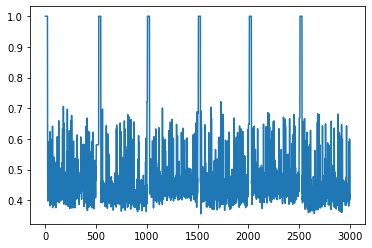

**********
window_size: 20
t: 75
phi: 2
thresh: 0.45
time used:12.90091347694397
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


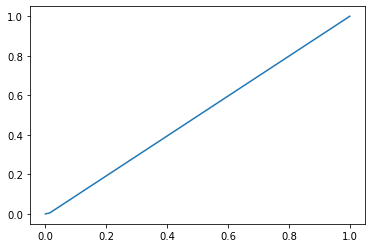

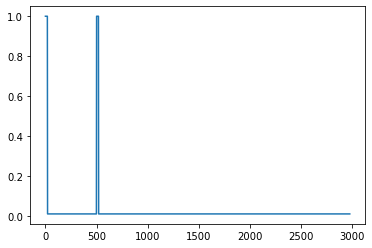

time used:21.62251615524292
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


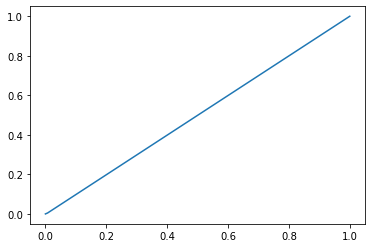

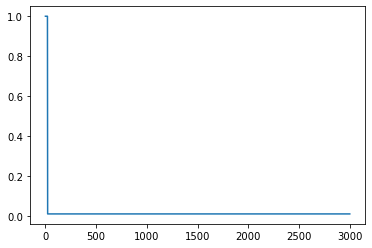

**********
window_size: 20
t: 75
phi: 2
thresh: 0.475
time used:12.776335716247559
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


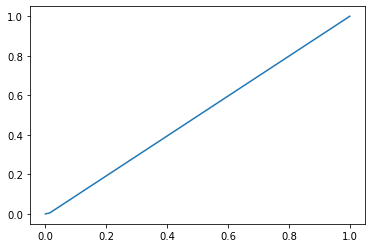

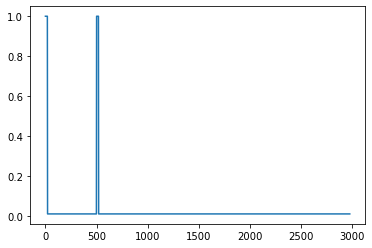

time used:22.06922698020935
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


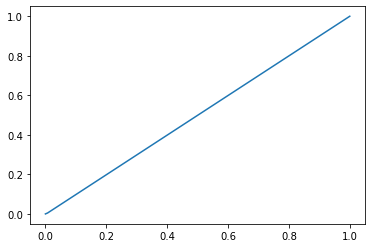

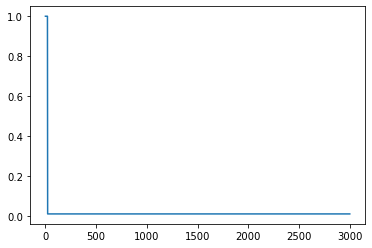

**********
window_size: 20
t: 75
phi: 2
thresh: 0.5
time used:12.970502853393555
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


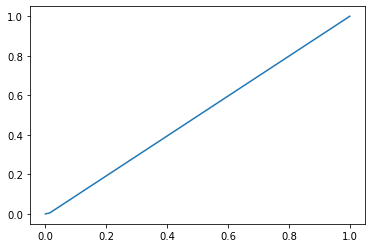

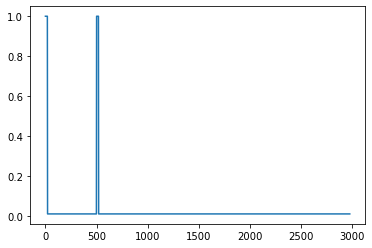

time used:21.972272634506226
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


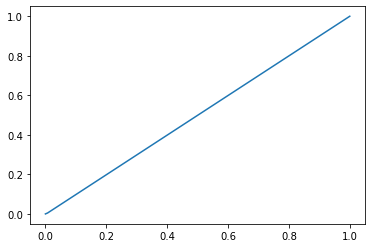

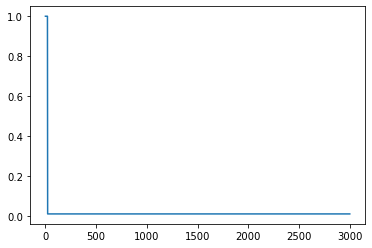

**********
window_size: 20
t: 75
phi: 2
thresh: 0.55
time used:12.884898662567139
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


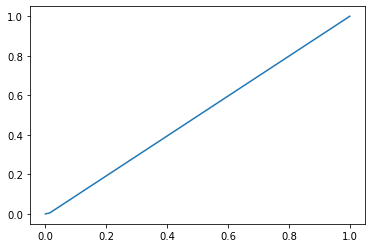

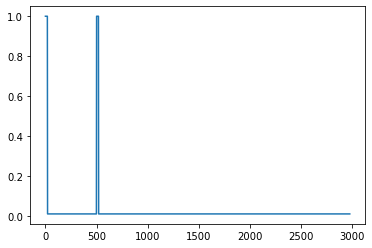

time used:22.003859758377075
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


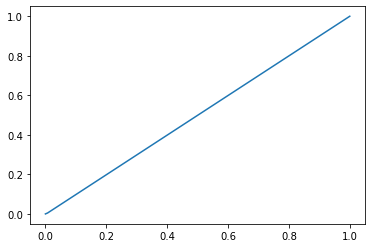

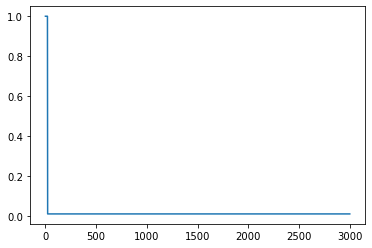

**********
window_size: 20
t: 75
phi: 2
thresh: 0.6
time used:12.90141248703003
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


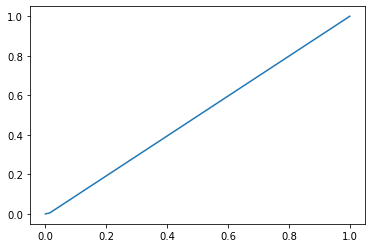

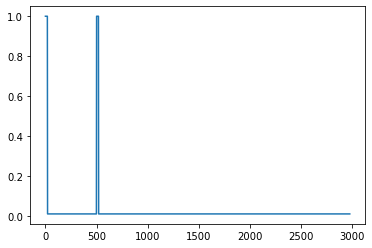

time used:22.471883535385132
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


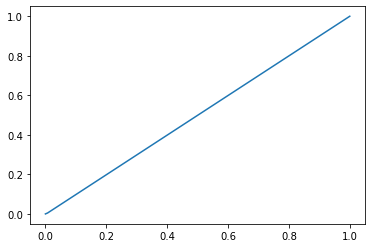

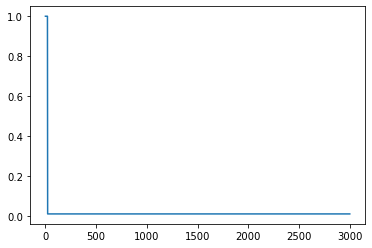

**********
window_size: 20
t: 75
phi: 2
thresh: 0.7
time used:12.931477069854736
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


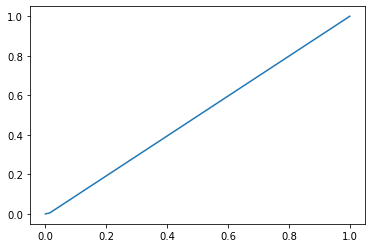

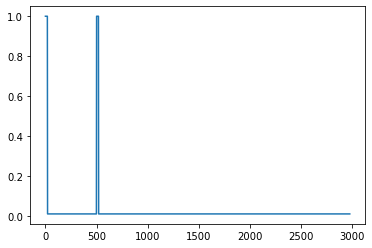

time used:21.936888456344604
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


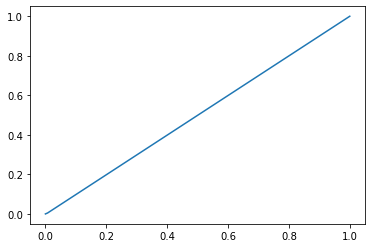

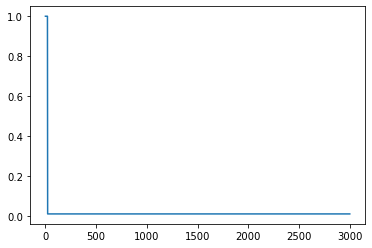

**********
window_size: 20
t: 75
phi: 5
thresh: 0.45
time used:13.004030227661133
TP: 67 TN: 207 FP: 1 FN: 2705
ACC: 0.09194630872483221 Precision: 0.9852941176470589 Recall: 0.024170274170274172 F1: 0.0471830985915493
FPR: 0.004807692307692308 TPR: 0.024170274170274172
AUC: 0.9679469835719836


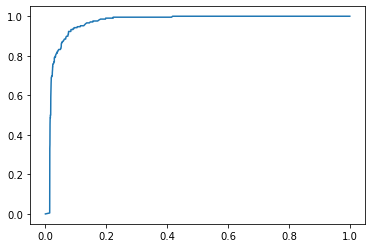

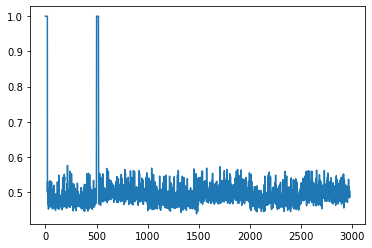

time used:22.197354793548584
TP: 71 TN: 209 FP: 1 FN: 2719
ACC: 0.09333333333333334 Precision: 0.9861111111111112 Recall: 0.025448028673835124 F1: 0.04961565338923829
FPR: 0.004761904761904762 TPR: 0.025448028673835124
AUC: 0.8339324116743472


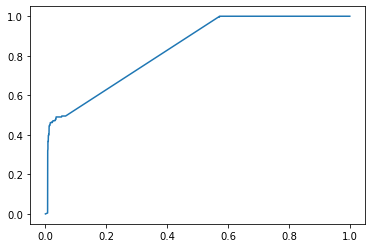

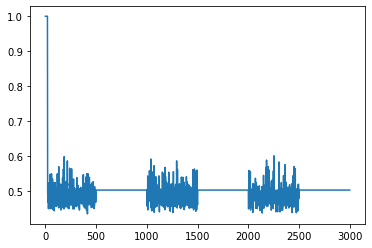

**********
window_size: 20
t: 75
phi: 5
thresh: 0.475
time used:12.973467350006104
TP: 902 TN: 207 FP: 1 FN: 1870
ACC: 0.37214765100671143 Precision: 0.9988925802879292 Recall: 0.3253968253968254 F1: 0.4908843537414966
FPR: 0.004807692307692308 TPR: 0.3253968253968254
AUC: 0.9791068306693307


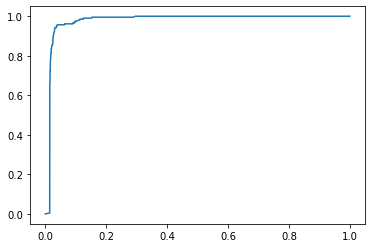

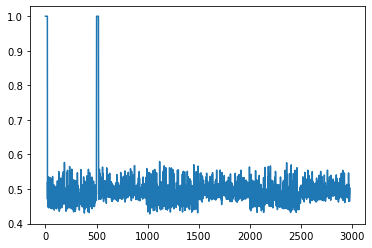

time used:22.19370937347412
TP: 652 TN: 209 FP: 1 FN: 2138
ACC: 0.287 Precision: 0.998468606431853 Recall: 0.23369175627240144 F1: 0.3787394713912286
FPR: 0.004761904761904762 TPR: 0.23369175627240144
AUC: 0.8584229390681003


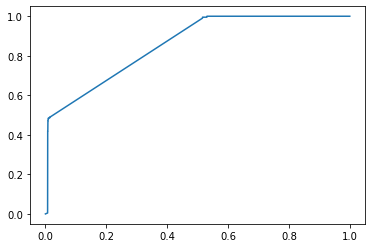

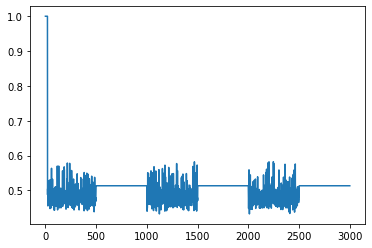

**********
window_size: 20
t: 75
phi: 5
thresh: 0.5
time used:12.986140012741089
TP: 2223 TN: 204 FP: 4 FN: 549
ACC: 0.8144295302013422 Precision: 0.9982038616973506 Recall: 0.801948051948052 F1: 0.889377875575115
FPR: 0.019230769230769232 TPR: 0.801948051948052
AUC: 0.9720791361416361


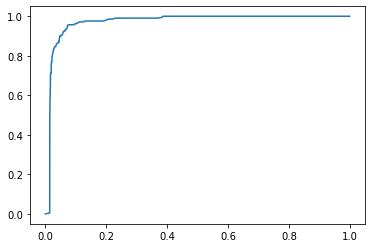

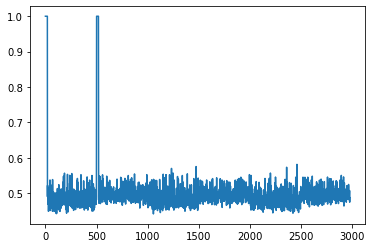

time used:21.90697407722473
TP: 1224 TN: 207 FP: 3 FN: 1566
ACC: 0.477 Precision: 0.9975550122249389 Recall: 0.43870967741935485 F1: 0.60941000746826
FPR: 0.014285714285714285 TPR: 0.43870967741935485
AUC: 0.7936610343061955


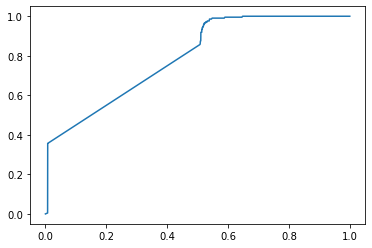

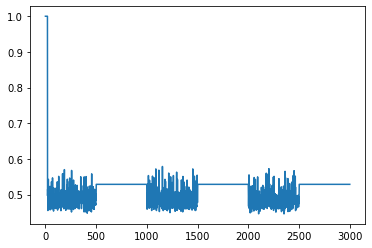

**********
window_size: 20
t: 75
phi: 5
thresh: 0.55
time used:13.013608694076538
TP: 2772 TN: 54 FP: 154 FN: 0
ACC: 0.9483221476510068 Precision: 0.9473684210526315 Recall: 1.0 F1: 0.972972972972973
FPR: 0.7403846153846154 TPR: 1.0
AUC: 0.9723670426795427


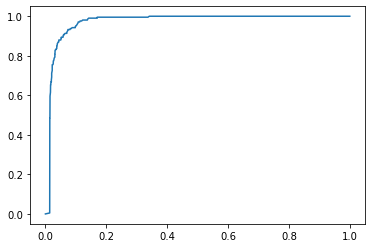

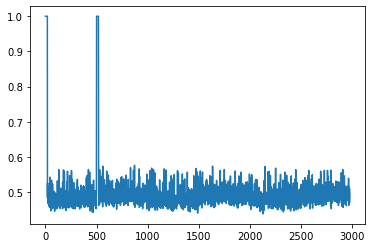

time used:22.20346736907959
TP: 1394 TN: 140 FP: 70 FN: 1396
ACC: 0.5113333333333333 Precision: 0.9521857923497268 Recall: 0.4996415770609319 F1: 0.6553831687823225
FPR: 0.3333333333333333 TPR: 0.4996415770609319
AUC: 0.6909626216077829


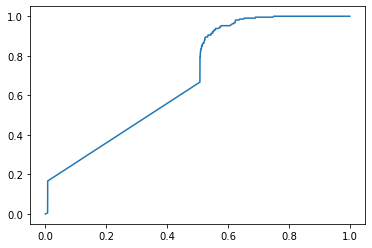

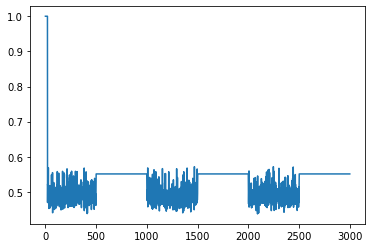

**********
window_size: 20
t: 75
phi: 5
thresh: 0.6
time used:11.881152153015137
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9604206557331557


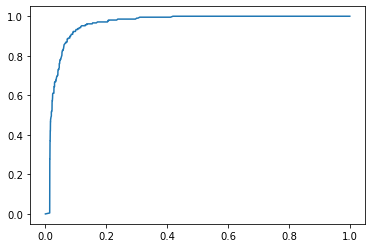

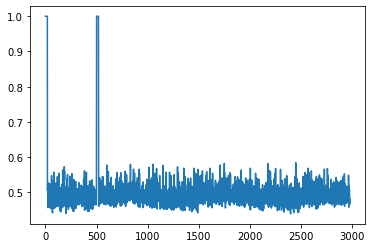

time used:21.028712272644043
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7863022700119475


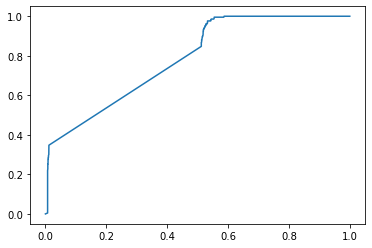

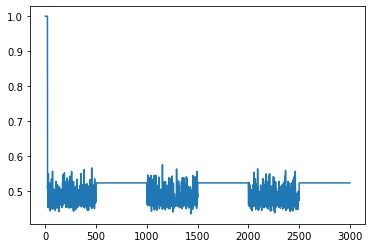

**********
window_size: 20
t: 75
phi: 5
thresh: 0.7
time used:11.947884559631348
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9701730561105562


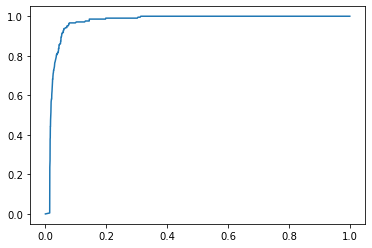

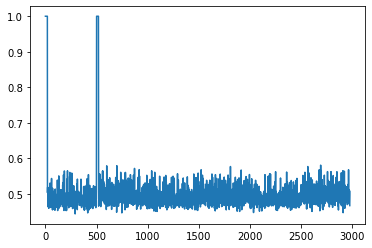

time used:21.38161063194275
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.827846902201741


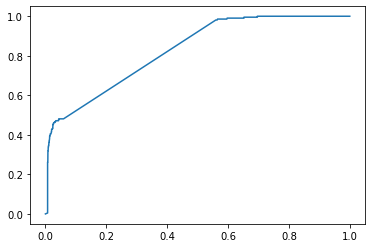

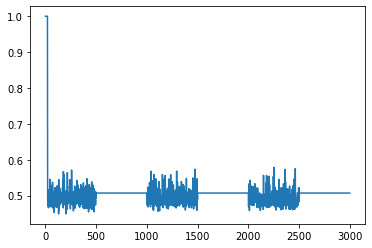

**********
window_size: 20
t: 75
phi: 10
thresh: 0.45
time used:12.109030723571777
TP: 86 TN: 207 FP: 1 FN: 2686
ACC: 0.0983221476510067 Precision: 0.9885057471264368 Recall: 0.031024531024531024 F1: 0.06016089541797831
FPR: 0.004807692307692308 TPR: 0.031024531024531024
AUC: 0.983638757076257


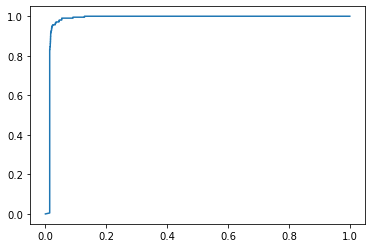

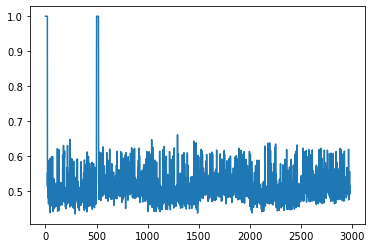

time used:16.405577898025513
TP: 692 TN: 199 FP: 11 FN: 2098
ACC: 0.297 Precision: 0.984352773826458 Recall: 0.24802867383512545 F1: 0.3962210134554824
FPR: 0.05238095238095238 TPR: 0.24802867383512545
AUC: 0.9324347158218126


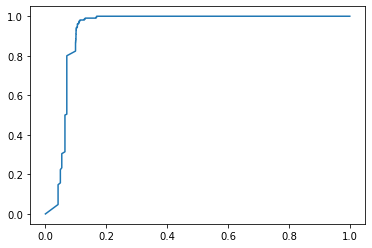

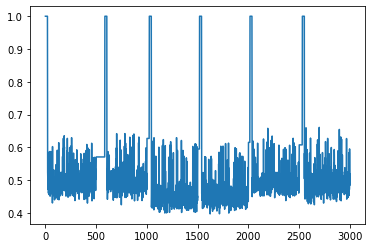

**********
window_size: 20
t: 75
phi: 10
thresh: 0.475
time used:12.118038892745972
TP: 739 TN: 207 FP: 1 FN: 2033
ACC: 0.3174496644295302 Precision: 0.9986486486486487 Recall: 0.2665945165945166 F1: 0.42084282460136674
FPR: 0.004807692307692308 TPR: 0.2665945165945166
AUC: 0.9806747072372073


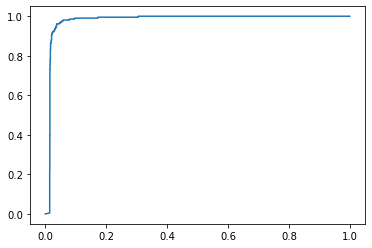

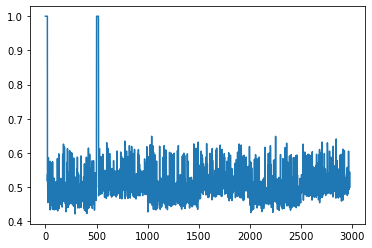

time used:15.792419195175171
TP: 1005 TN: 201 FP: 9 FN: 1785
ACC: 0.402 Precision: 0.9911242603550295 Recall: 0.3602150537634409 F1: 0.5283911671924291
FPR: 0.04285714285714286 TPR: 0.3602150537634409
AUC: 0.9274287421061616


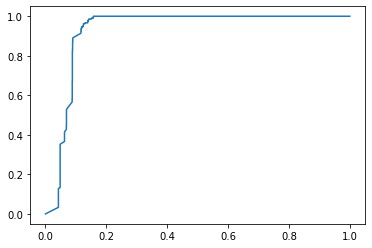

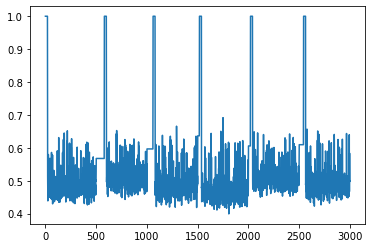

**********
window_size: 20
t: 75
phi: 10
thresh: 0.5
time used:12.147607564926147
TP: 1801 TN: 207 FP: 1 FN: 971
ACC: 0.6738255033557047 Precision: 0.9994450610432852 Recall: 0.6497113997113997 F1: 0.7874945343244425
FPR: 0.004807692307692308 TPR: 0.6497113997113997
AUC: 0.9804821914196914


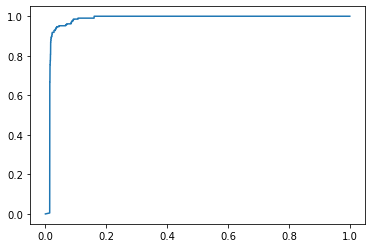

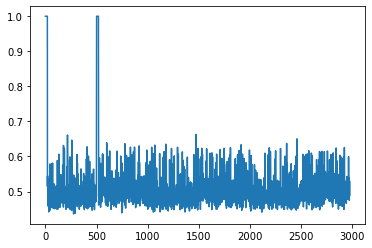

time used:21.216877937316895
TP: 986 TN: 209 FP: 1 FN: 1804
ACC: 0.3983333333333333 Precision: 0.9989868287740629 Recall: 0.353405017921147 F1: 0.5221074927190893
FPR: 0.004761904761904762 TPR: 0.353405017921147
AUC: 0.8566231438812083


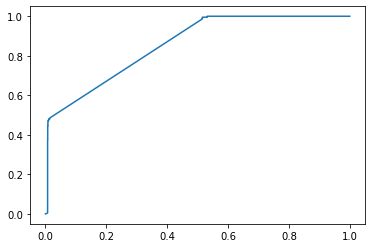

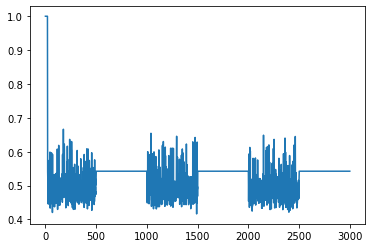

**********
window_size: 20
t: 75
phi: 10
thresh: 0.55
time used:12.144587516784668
TP: 2709 TN: 196 FP: 12 FN: 63
ACC: 0.9748322147651006 Precision: 0.9955898566703418 Recall: 0.9772727272727273 F1: 0.9863462588749318
FPR: 0.057692307692307696 TPR: 0.9772727272727273
AUC: 0.9789108460983461


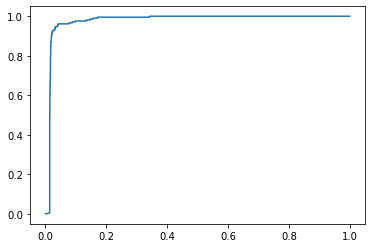

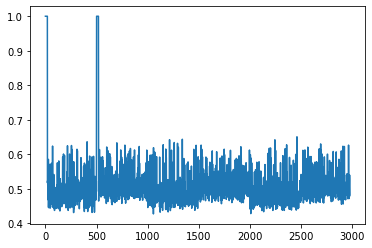

time used:21.80414843559265
TP: 2787 TN: 95 FP: 115 FN: 3
ACC: 0.9606666666666667 Precision: 0.9603721571330117 Recall: 0.9989247311827957 F1: 0.9792691496837667
FPR: 0.5476190476190477 TPR: 0.9989247311827957
AUC: 0.8571215224441031


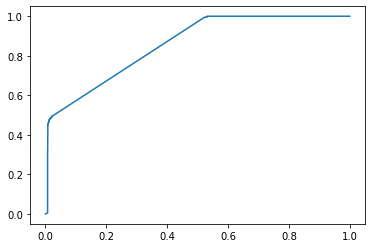

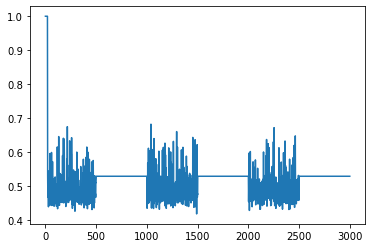

**********
window_size: 20
t: 75
phi: 10
thresh: 0.6
time used:13.547083139419556
TP: 2772 TN: 95 FP: 113 FN: 0
ACC: 0.9620805369127516 Precision: 0.9608318890814558 Recall: 1.0 F1: 0.9800247480996995
FPR: 0.5432692307692307 TPR: 1.0
AUC: 0.9819876304251305


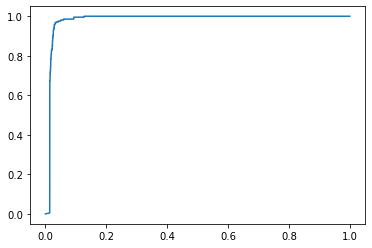

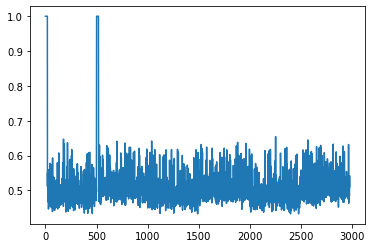

time used:17.24404740333557
TP: 2711 TN: 106 FP: 104 FN: 79
ACC: 0.939 Precision: 0.9630550621669627 Recall: 0.9716845878136201 F1: 0.9673505798394292
FPR: 0.49523809523809526 TPR: 0.9716845878136201
AUC: 0.9277316948284691


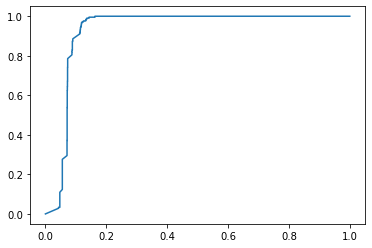

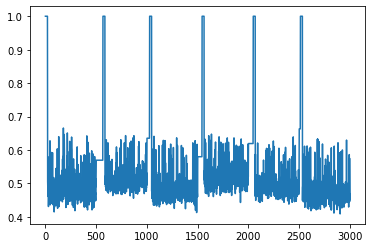

**********
window_size: 20
t: 75
phi: 10
thresh: 0.7
time used:13.685144424438477
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9833326395826395


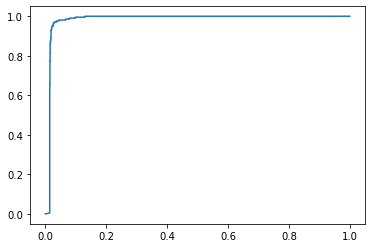

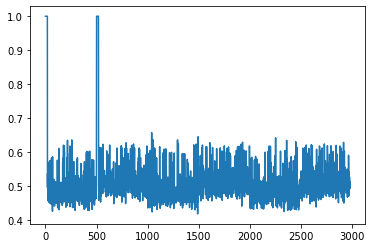

time used:22.463959455490112
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8490740740740741


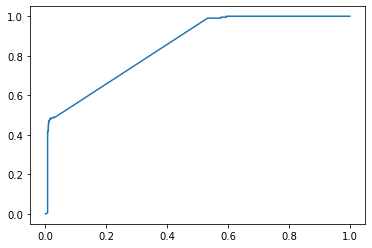

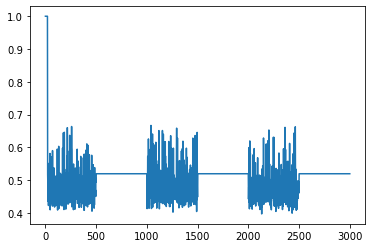

**********
window_size: 20
t: 75
phi: 15
thresh: 0.45
time used:13.269775390625
TP: 357 TN: 207 FP: 1 FN: 2415
ACC: 0.18926174496644296 Precision: 0.9972067039106145 Recall: 0.12878787878787878 F1: 0.2281150159744409
FPR: 0.004807692307692308 TPR: 0.12878787878787878
AUC: 0.9839804292929293


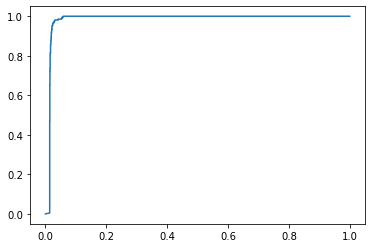

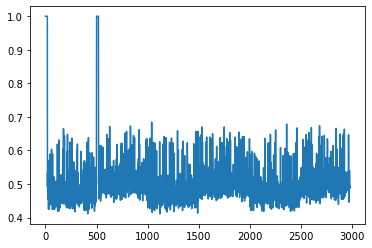

time used:18.26305866241455
TP: 1363 TN: 198 FP: 12 FN: 1427
ACC: 0.5203333333333333 Precision: 0.9912727272727273 Recall: 0.4885304659498208 F1: 0.6545018007202881
FPR: 0.05714285714285714 TPR: 0.4885304659498208
AUC: 0.9462749615975423


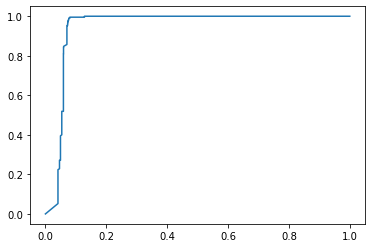

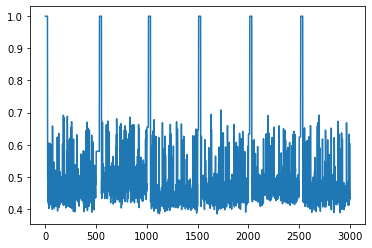

**********
window_size: 20
t: 75
phi: 15
thresh: 0.475
time used:13.540050029754639
TP: 901 TN: 207 FP: 1 FN: 1871
ACC: 0.3718120805369127 Precision: 0.9988913525498891 Recall: 0.325036075036075 F1: 0.4904735982580293
FPR: 0.004807692307692308 TPR: 0.325036075036075
AUC: 0.9832970848595849


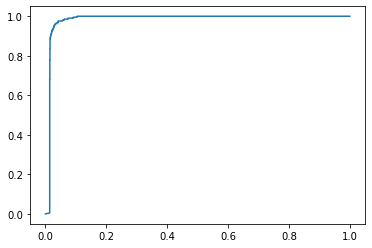

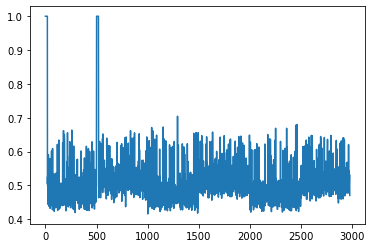

time used:18.664883613586426
TP: 1988 TN: 197 FP: 13 FN: 802
ACC: 0.7283333333333334 Precision: 0.993503248375812 Recall: 0.7125448028673835 F1: 0.8298893759131706
FPR: 0.06190476190476191 TPR: 0.7125448028673835
AUC: 0.9446637651476361


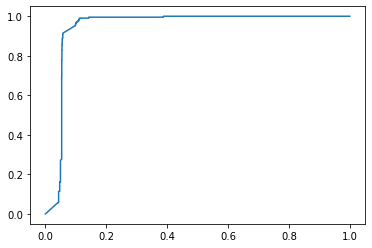

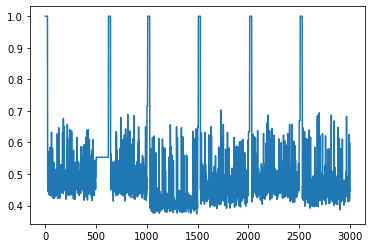

**********
window_size: 20
t: 75
phi: 15
thresh: 0.5
time used:13.129124402999878
TP: 1654 TN: 207 FP: 1 FN: 1118
ACC: 0.624496644295302 Precision: 0.9993957703927493 Recall: 0.5966810966810967 F1: 0.7472328890896769
FPR: 0.004807692307692308 TPR: 0.5966810966810967
AUC: 0.9836717102342102


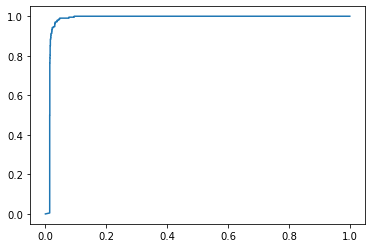

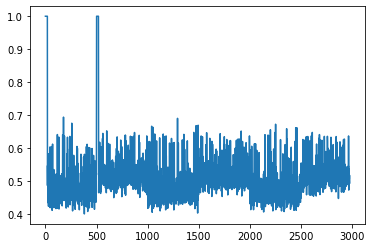

time used:18.96829319000244
TP: 2637 TN: 196 FP: 14 FN: 153
ACC: 0.9443333333333334 Precision: 0.994718973972086 Recall: 0.9451612903225807 F1: 0.9693071126631134
FPR: 0.06666666666666667 TPR: 0.9451612903225807
AUC: 0.9506682027649769


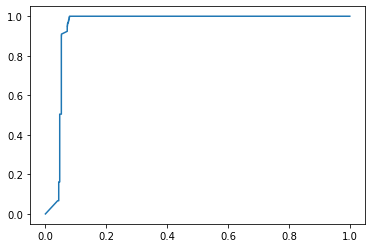

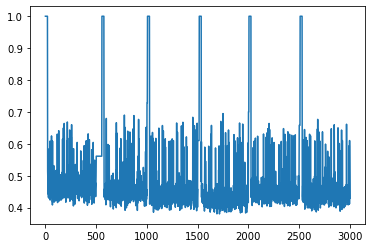

**********
window_size: 20
t: 75
phi: 15
thresh: 0.55
time used:13.099590301513672
TP: 2694 TN: 205 FP: 3 FN: 78
ACC: 0.9728187919463087 Precision: 0.9988876529477196 Recall: 0.9718614718614719 F1: 0.9851892484914976
FPR: 0.014423076923076924 TPR: 0.9718614718614719
AUC: 0.9847903832278833


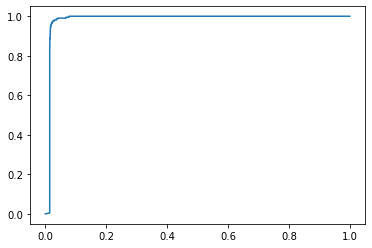

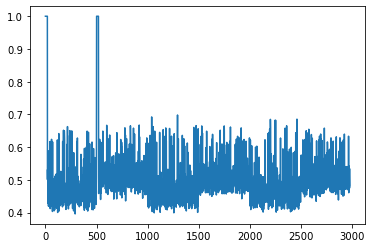

time used:18.776004314422607
TP: 2673 TN: 186 FP: 24 FN: 117
ACC: 0.953 Precision: 0.9911012235817576 Recall: 0.9580645161290322 F1: 0.9743028977583379
FPR: 0.11428571428571428 TPR: 0.9580645161290322
AUC: 0.9430286738351255


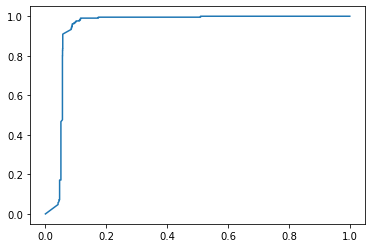

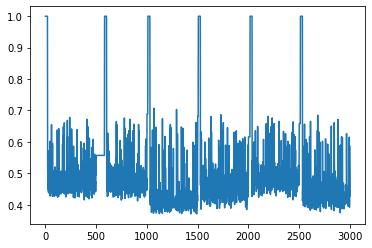

**********
window_size: 20
t: 75
phi: 15
thresh: 0.6
time used:13.059181213378906
TP: 2771 TN: 169 FP: 39 FN: 1
ACC: 0.9865771812080537 Precision: 0.9861209964412812 Recall: 0.9996392496392497 F1: 0.9928341096381225
FPR: 0.1875 TPR: 0.9996392496392497
AUC: 0.9847782425907426


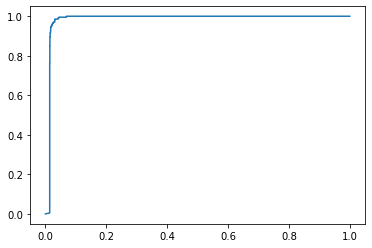

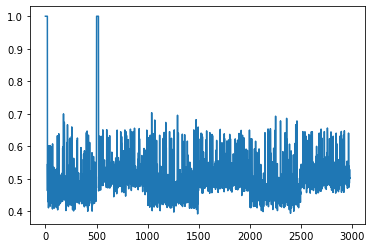

time used:18.895262002944946
TP: 2752 TN: 119 FP: 91 FN: 38
ACC: 0.957 Precision: 0.9679915582131551 Recall: 0.9863799283154122 F1: 0.9770992366412213
FPR: 0.43333333333333335 TPR: 0.9863799283154122
AUC: 0.9443283836832225


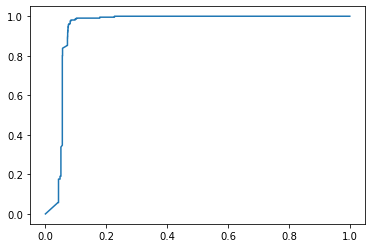

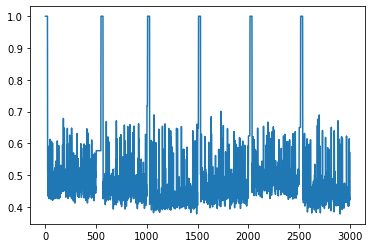

**********
window_size: 20
t: 75
phi: 15
thresh: 0.7
time used:13.647111177444458
TP: 2772 TN: 3 FP: 205 FN: 0
ACC: 0.9312080536912751 Precision: 0.9311387302653679 Recall: 1.0 F1: 0.9643416246303704
FPR: 0.9855769230769231 TPR: 1.0
AUC: 0.9828756313131313


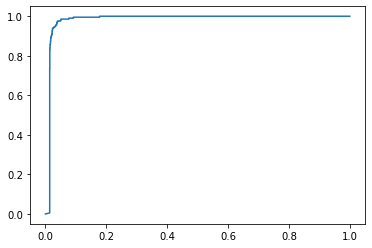

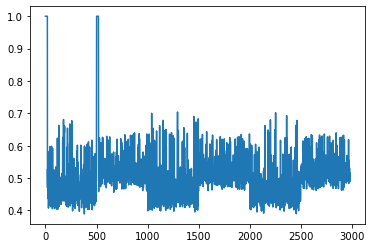

time used:19.181768894195557
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9460215053763441


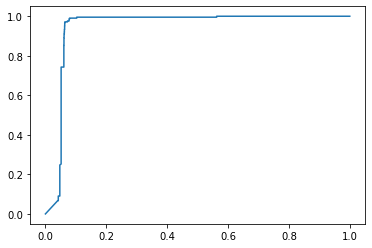

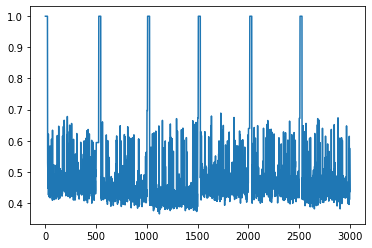

**********
window_size: 20
t: 75
phi: 18
thresh: 0.45
time used:13.812991619110107
TP: 607 TN: 207 FP: 1 FN: 2165
ACC: 0.2731543624161074 Precision: 0.9983552631578947 Recall: 0.21897546897546896 F1: 0.35917159763313605
FPR: 0.004807692307692308 TPR: 0.21897546897546896
AUC: 0.9837792415917416


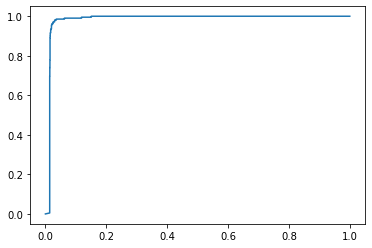

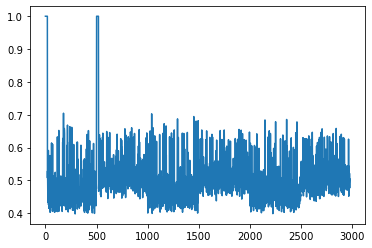

time used:18.431260585784912
TP: 1887 TN: 195 FP: 15 FN: 903
ACC: 0.694 Precision: 0.9921135646687698 Recall: 0.6763440860215054 F1: 0.8043478260869565
FPR: 0.07142857142857142 TPR: 0.6763440860215054
AUC: 0.9517520054616828


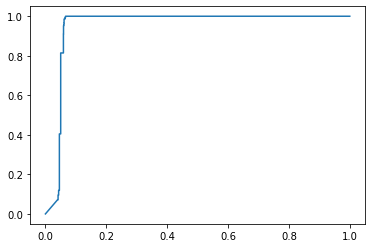

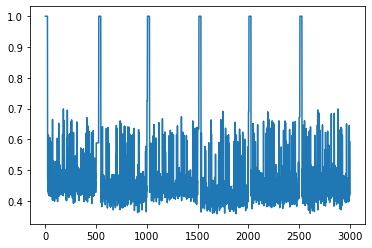

**********
window_size: 20
t: 75
phi: 18
thresh: 0.475
time used:12.23065710067749
TP: 1213 TN: 207 FP: 1 FN: 1559
ACC: 0.47651006711409394 Precision: 0.999176276771005 Recall: 0.4375901875901876 F1: 0.60863020572002
FPR: 0.004807692307692308 TPR: 0.4375901875901876
AUC: 0.9789316586191587


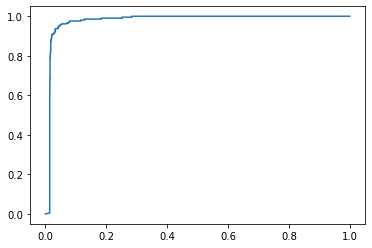

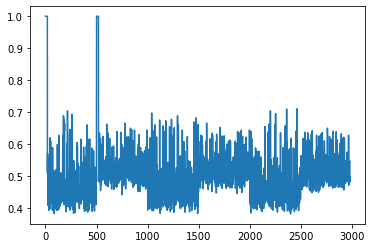

time used:18.036438465118408
TP: 2217 TN: 198 FP: 12 FN: 573
ACC: 0.805 Precision: 0.9946164199192463 Recall: 0.7946236559139785 F1: 0.8834429169157202
FPR: 0.05714285714285714 TPR: 0.7946236559139785
AUC: 0.9487600273084145


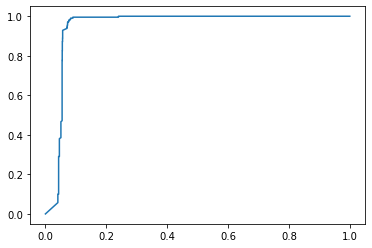

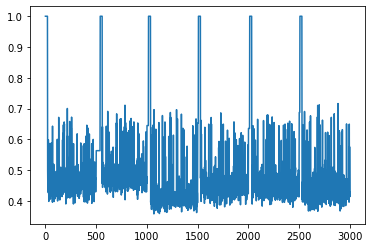

**********
window_size: 20
t: 75
phi: 18
thresh: 0.5
time used:12.24666452407837
TP: 1816 TN: 207 FP: 1 FN: 956
ACC: 0.6788590604026845 Precision: 0.9994496422674739 Recall: 0.6551226551226551 F1: 0.7914578339507519
FPR: 0.004807692307692308 TPR: 0.6551226551226551
AUC: 0.9837376165501166


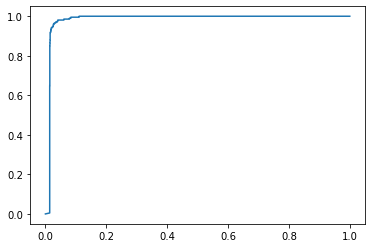

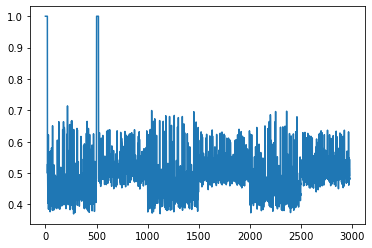

time used:18.070472240447998
TP: 2566 TN: 198 FP: 12 FN: 224
ACC: 0.9213333333333333 Precision: 0.9953452288595811 Recall: 0.9197132616487456 F1: 0.9560357675111775
FPR: 0.05714285714285714 TPR: 0.9197132616487456
AUC: 0.9472537975763782


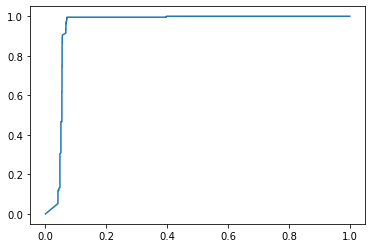

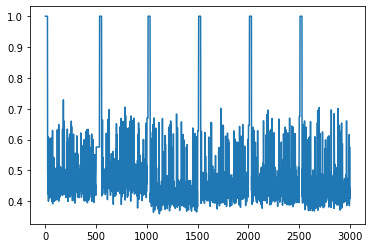

**********
window_size: 20
t: 75
phi: 18
thresh: 0.55
time used:12.203152894973755
TP: 2619 TN: 207 FP: 1 FN: 153
ACC: 0.9483221476510068 Precision: 0.999618320610687 Recall: 0.9448051948051948 F1: 0.9714391691394659
FPR: 0.004807692307692308 TPR: 0.9448051948051948
AUC: 0.9842804764679765


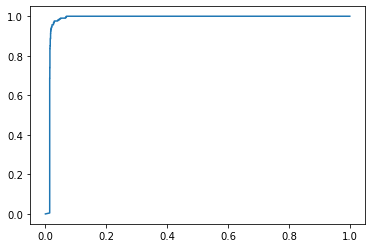

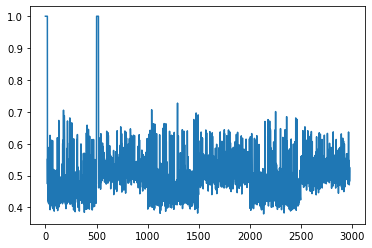

time used:18.537928819656372
TP: 2741 TN: 189 FP: 21 FN: 49
ACC: 0.9766666666666667 Precision: 0.9923968139029689 Recall: 0.9824372759856631 F1: 0.9873919308357348
FPR: 0.1 TPR: 0.9824372759856631
AUC: 0.950247482505547


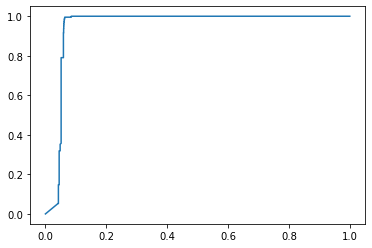

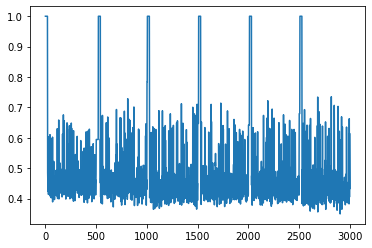

**********
window_size: 20
t: 75
phi: 18
thresh: 0.6
time used:12.124577522277832
TP: 2770 TN: 172 FP: 36 FN: 2
ACC: 0.987248322147651 Precision: 0.9871703492516037 Recall: 0.9992784992784993 F1: 0.9931875224094658
FPR: 0.17307692307692307 TPR: 0.9992784992784993
AUC: 0.9847158050283051


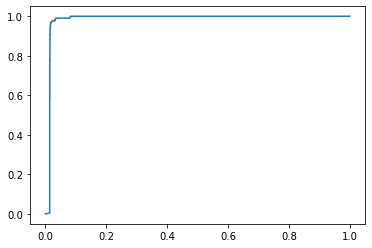

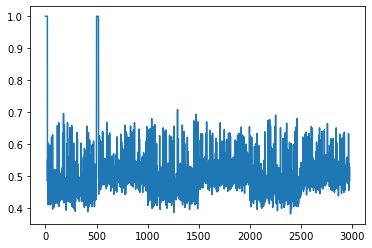

time used:18.133543968200684
TP: 2758 TN: 149 FP: 61 FN: 32
ACC: 0.969 Precision: 0.9783611209648811 Recall: 0.9885304659498207 F1: 0.98341950436798
FPR: 0.2904761904761905 TPR: 0.9885304659498207
AUC: 0.9500665642601127


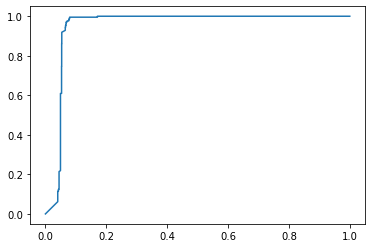

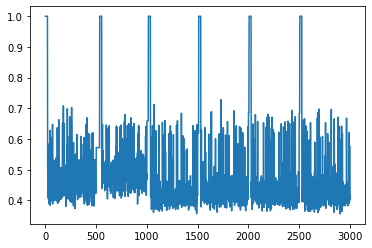

**********
window_size: 20
t: 75
phi: 18
thresh: 0.7
time used:12.262202739715576
TP: 2772 TN: 2 FP: 206 FN: 0
ACC: 0.9308724832214765 Precision: 0.9308260577568838 Recall: 1.0 F1: 0.9641739130434782
FPR: 0.9903846153846154 TPR: 1.0
AUC: 0.9841018356643356


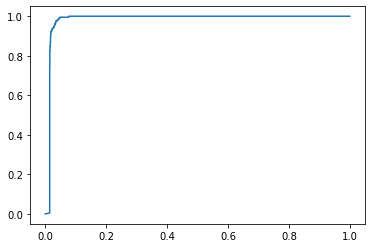

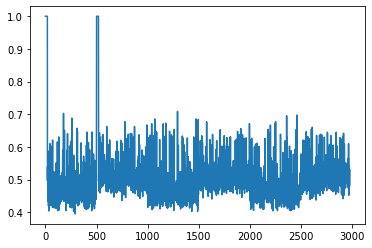

time used:18.20010256767273
TP: 2790 TN: 4 FP: 206 FN: 0
ACC: 0.9313333333333333 Precision: 0.9312416555407209 Recall: 1.0 F1: 0.9643968199101279
FPR: 0.9809523809523809 TPR: 1.0
AUC: 0.9489921488308586


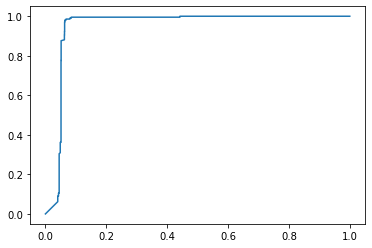

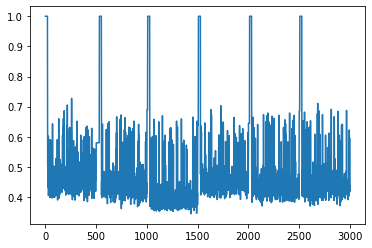

**********
window_size: 20
t: 100
phi: 2
thresh: 0.45
time used:12.084020376205444
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


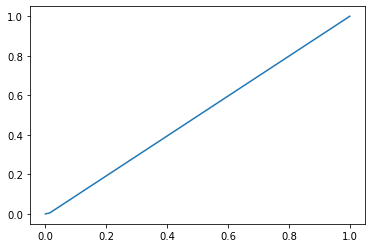

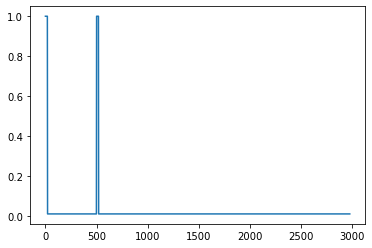

time used:22.35537552833557
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


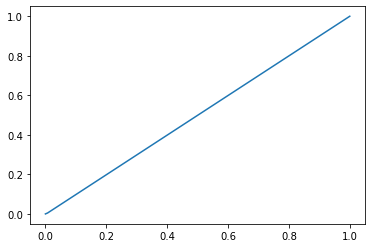

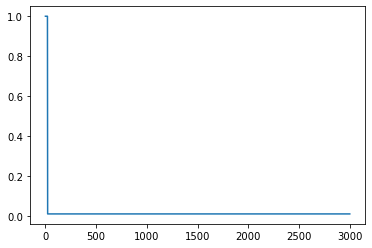

**********
window_size: 20
t: 100
phi: 2
thresh: 0.475
time used:13.224302053451538
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


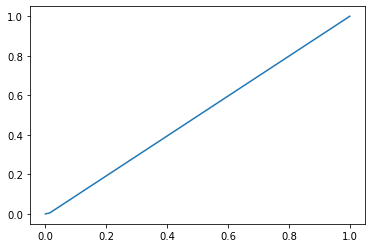

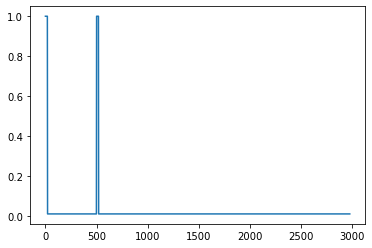

time used:22.37564468383789
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


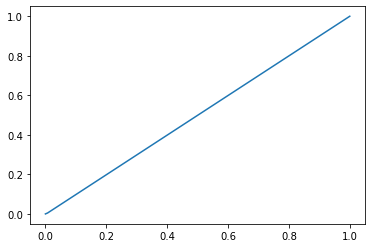

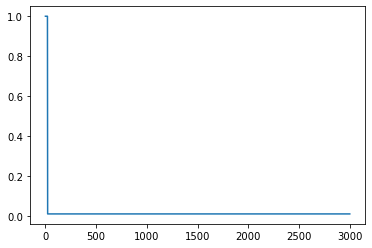

**********
window_size: 20
t: 100
phi: 2
thresh: 0.5
time used:13.087231636047363
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


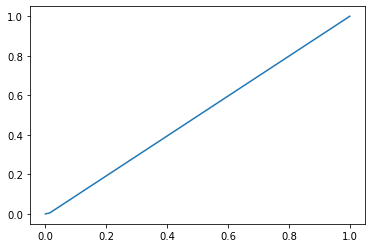

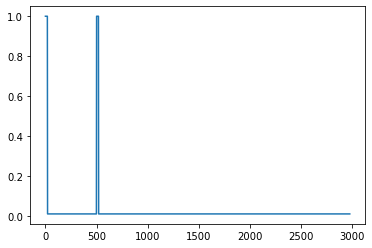

time used:22.372071981430054
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


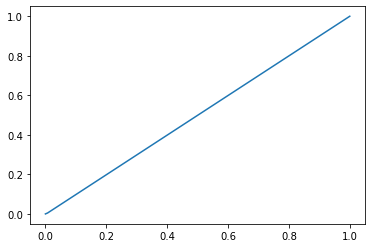

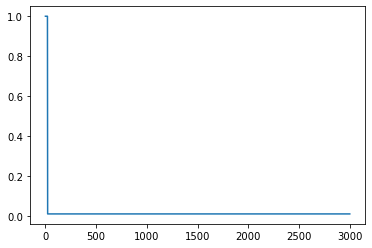

**********
window_size: 20
t: 100
phi: 2
thresh: 0.55
time used:13.144209861755371
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


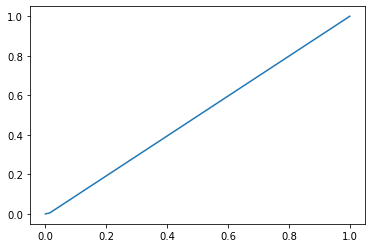

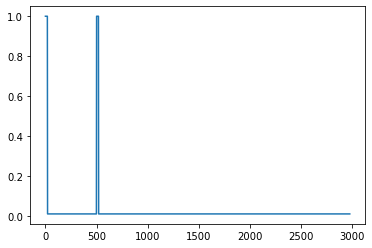

time used:22.416823148727417
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


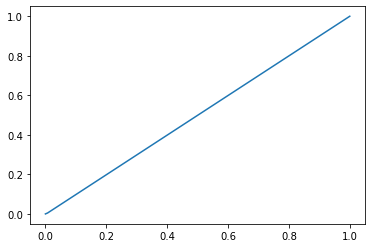

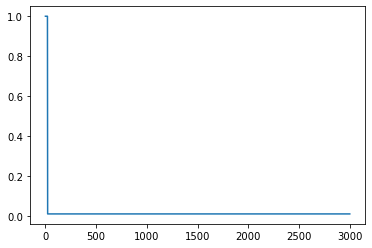

**********
window_size: 20
t: 100
phi: 2
thresh: 0.6
time used:13.004534244537354
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


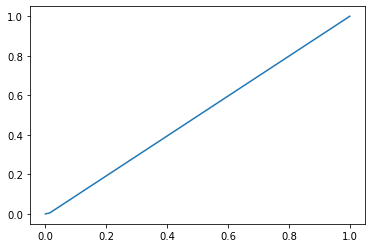

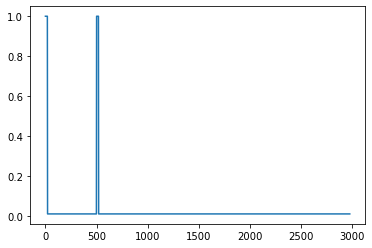

time used:22.210206985473633
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


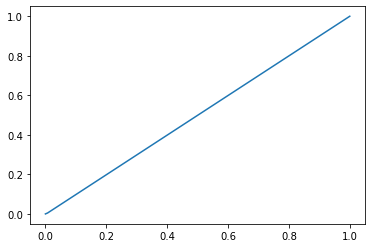

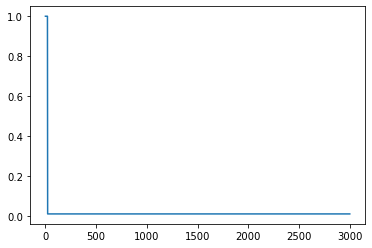

**********
window_size: 20
t: 100
phi: 2
thresh: 0.7
time used:13.069620847702026
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.4953692141192141


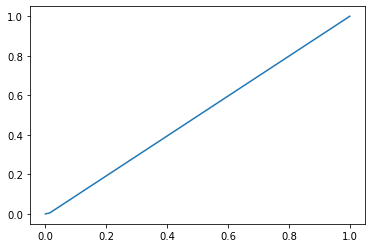

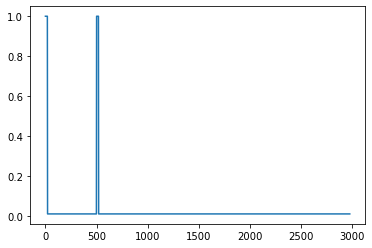

time used:22.080601692199707
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.4987967229902714


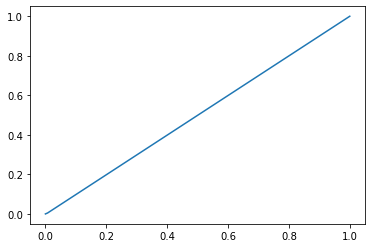

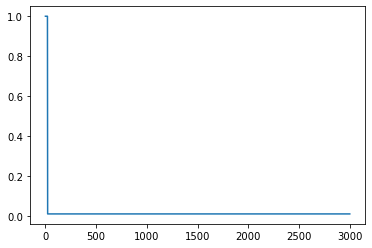

**********
window_size: 20
t: 100
phi: 5
thresh: 0.45
time used:13.20178508758545
TP: 67 TN: 207 FP: 1 FN: 2705
ACC: 0.09194630872483221 Precision: 0.9852941176470589 Recall: 0.024170274170274172 F1: 0.0471830985915493
FPR: 0.004807692307692308 TPR: 0.024170274170274172
AUC: 0.9763933982683982


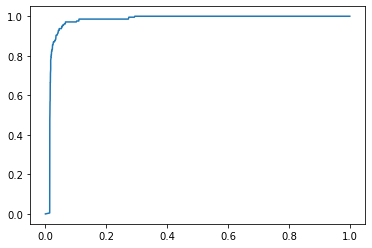

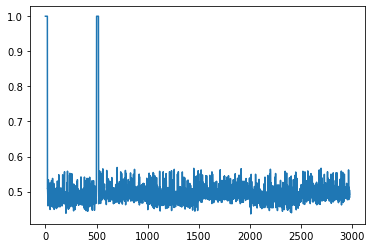

time used:22.38671612739563
TP: 27 TN: 209 FP: 1 FN: 2763
ACC: 0.07866666666666666 Precision: 0.9642857142857143 Recall: 0.00967741935483871 F1: 0.0191625266146203
FPR: 0.004761904761904762 TPR: 0.00967741935483871
AUC: 0.8519994879672299


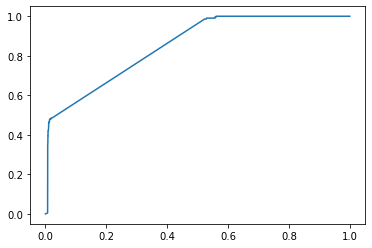

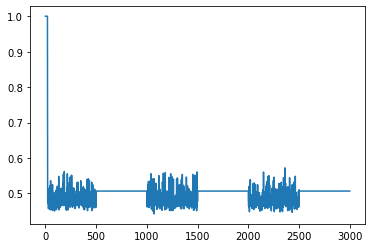

**********
window_size: 20
t: 100
phi: 5
thresh: 0.475
time used:12.960087060928345
TP: 771 TN: 207 FP: 1 FN: 2001
ACC: 0.32818791946308723 Precision: 0.9987046632124352 Recall: 0.27813852813852813 F1: 0.43510158013544015
FPR: 0.004807692307692308 TPR: 0.27813852813852813
AUC: 0.9769483988233989


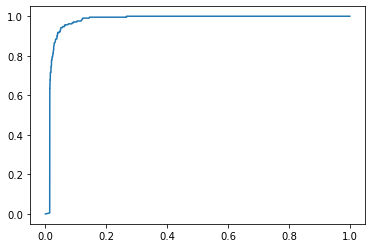

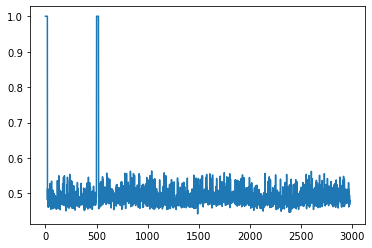

time used:20.602274417877197
TP: 636 TN: 209 FP: 1 FN: 2154
ACC: 0.2816666666666667 Precision: 0.9984301412872841 Recall: 0.22795698924731184 F1: 0.37117011963816754
FPR: 0.004761904761904762 TPR: 0.22795698924731184
AUC: 0.8532923707117255


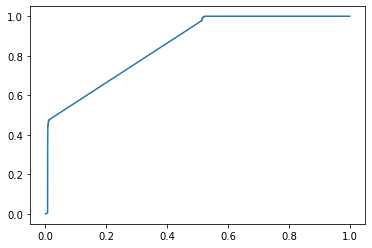

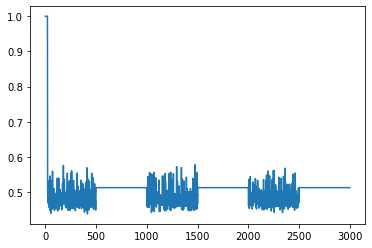

**********
window_size: 20
t: 100
phi: 5
thresh: 0.5
time used:11.712669134140015
TP: 1804 TN: 207 FP: 1 FN: 968
ACC: 0.6748322147651007 Precision: 0.9994459833795014 Recall: 0.6507936507936508 F1: 0.7882892724492027
FPR: 0.004807692307692308 TPR: 0.6507936507936508
AUC: 0.9761774683649683


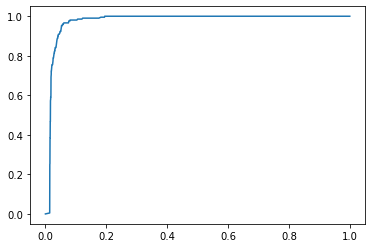

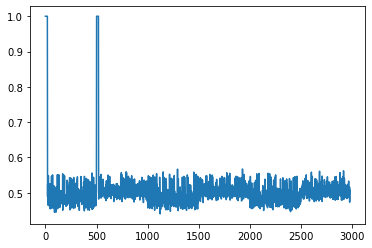

time used:20.537711143493652
TP: 1245 TN: 209 FP: 1 FN: 1545
ACC: 0.4846666666666667 Precision: 0.9991974317817014 Recall: 0.44623655913978494 F1: 0.6169474727452924
FPR: 0.004761904761904762 TPR: 0.44623655913978494
AUC: 0.8553080730500087


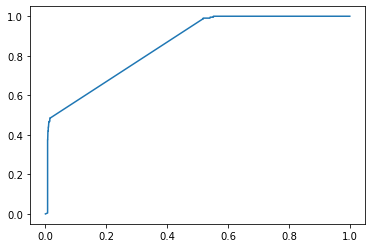

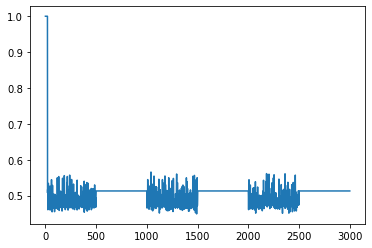

**********
window_size: 20
t: 100
phi: 5
thresh: 0.55
time used:11.663625478744507
TP: 2772 TN: 37 FP: 171 FN: 0
ACC: 0.9426174496644295 Precision: 0.9418960244648318 Recall: 1.0 F1: 0.9700787401574803
FPR: 0.8221153846153846 TPR: 1.0
AUC: 0.9749547327672328


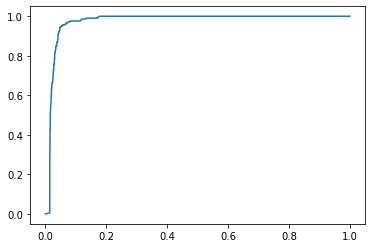

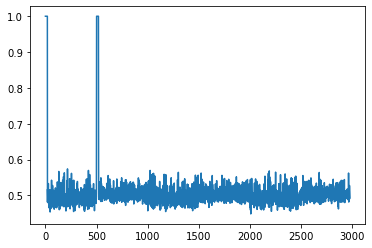

time used:20.81357216835022
TP: 2790 TN: 20 FP: 190 FN: 0
ACC: 0.9366666666666666 Precision: 0.9362416107382551 Recall: 1.0 F1: 0.9670710571923744
FPR: 0.9047619047619048 TPR: 1.0
AUC: 0.8364260112647209


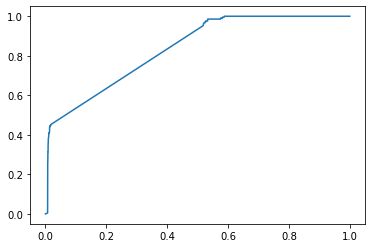

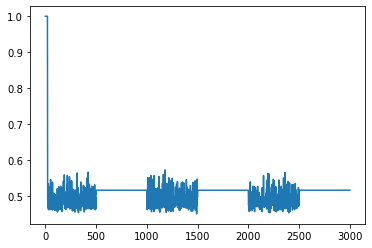

**********
window_size: 20
t: 100
phi: 5
thresh: 0.6
time used:13.07949709892273
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9818020521145522


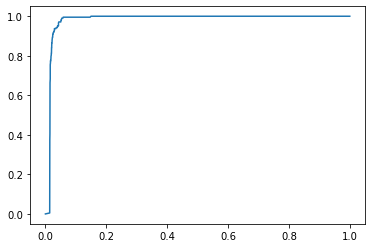

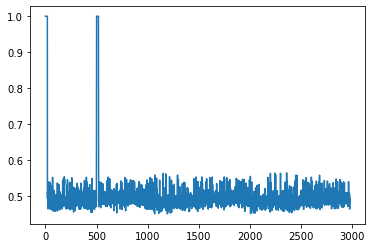

time used:21.8348445892334
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8379894179894181


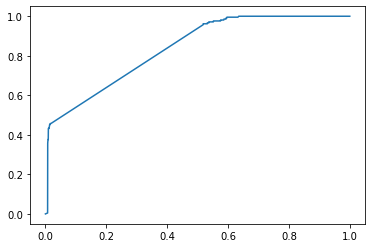

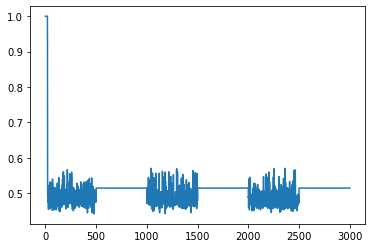

**********
window_size: 20
t: 100
phi: 5
thresh: 0.7
time used:12.217647552490234
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9806833791208791


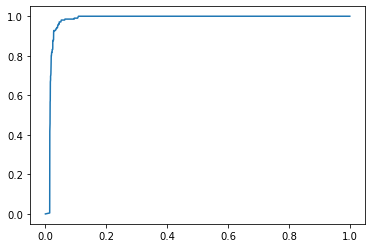

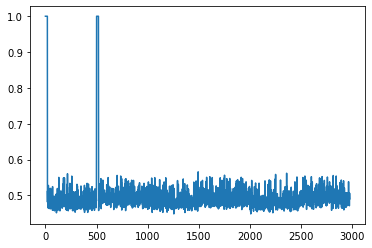

time used:21.132608652114868
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8529091995221028


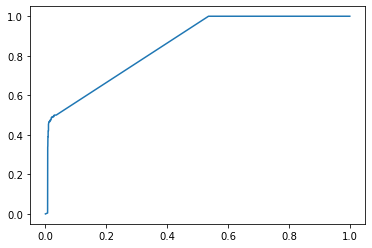

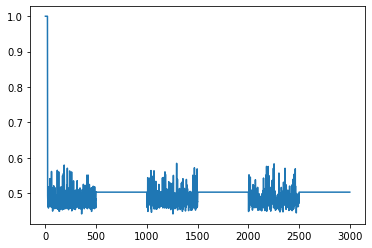

**********
window_size: 20
t: 100
phi: 10
thresh: 0.45
time used:12.295727252960205
TP: 258 TN: 207 FP: 1 FN: 2514
ACC: 0.15604026845637584 Precision: 0.9961389961389961 Recall: 0.09307359307359307 F1: 0.17024084460574065
FPR: 0.004807692307692308 TPR: 0.09307359307359307
AUC: 0.9833092254967254


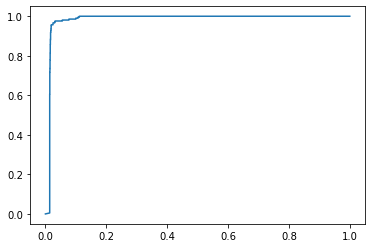

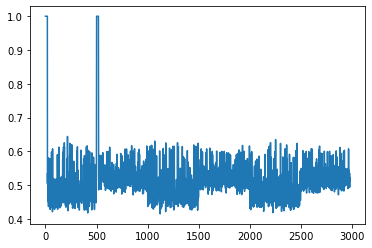

time used:21.25287699699402
TP: 154 TN: 209 FP: 1 FN: 2636
ACC: 0.121 Precision: 0.9935483870967742 Recall: 0.055197132616487454 F1: 0.10458404074702887
FPR: 0.004761904761904762 TPR: 0.055197132616487454
AUC: 0.8630559822495306


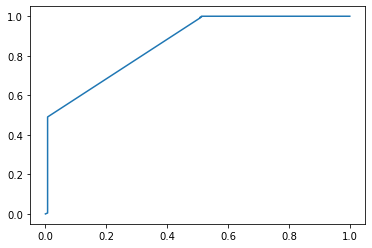

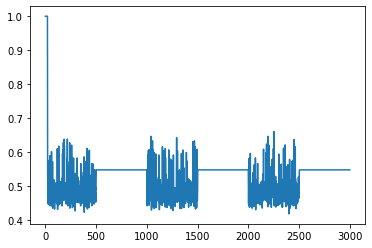

**********
window_size: 20
t: 100
phi: 10
thresh: 0.475
time used:13.903689622879028
TP: 417 TN: 207 FP: 1 FN: 2355
ACC: 0.20939597315436242 Precision: 0.9976076555023924 Recall: 0.15043290043290045 F1: 0.2614420062695925
FPR: 0.004807692307692308 TPR: 0.15043290043290045
AUC: 0.9827429514929515


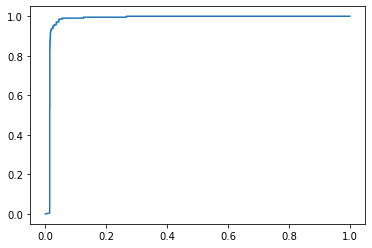

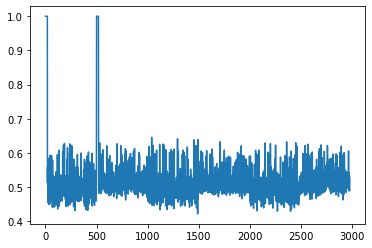

time used:22.80060601234436
TP: 504 TN: 209 FP: 1 FN: 2286
ACC: 0.23766666666666666 Precision: 0.998019801980198 Recall: 0.18064516129032257 F1: 0.3059180576631259
FPR: 0.004761904761904762 TPR: 0.18064516129032257
AUC: 0.8344179894179894


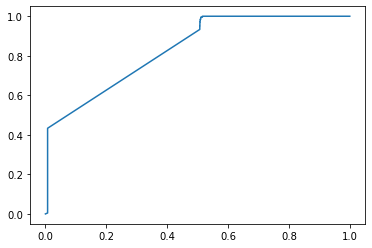

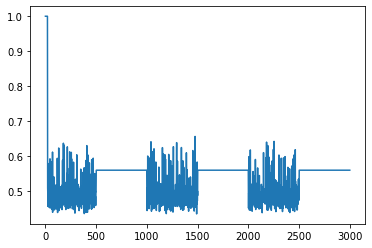

**********
window_size: 20
t: 100
phi: 10
thresh: 0.5
time used:14.030046939849854
TP: 1266 TN: 207 FP: 1 FN: 1506
ACC: 0.4942953020134228 Precision: 0.9992107340173638 Recall: 0.45670995670995673 F1: 0.6268878435256251
FPR: 0.004807692307692308 TPR: 0.45670995670995673
AUC: 0.9839821636696637


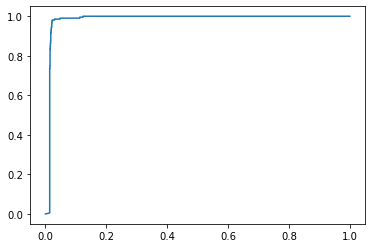

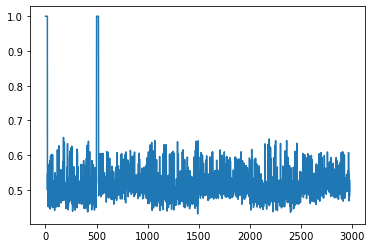

time used:22.843183994293213
TP: 1011 TN: 209 FP: 1 FN: 1779
ACC: 0.4066666666666667 Precision: 0.9990118577075099 Recall: 0.36236559139784946 F1: 0.5318253550762756
FPR: 0.004761904761904762 TPR: 0.36236559139784946
AUC: 0.8574953063662742


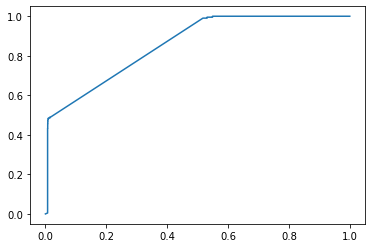

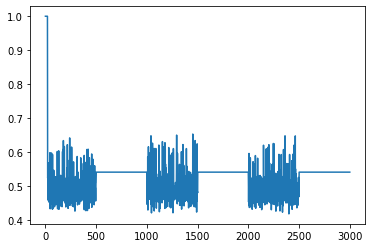

**********
window_size: 20
t: 100
phi: 10
thresh: 0.55
time used:13.282243490219116
TP: 2706 TN: 196 FP: 12 FN: 66
ACC: 0.9738255033557047 Precision: 0.9955849889624724 Recall: 0.9761904761904762 F1: 0.9857923497267759
FPR: 0.057692307692307696 TPR: 0.9761904761904762
AUC: 0.980213363025863


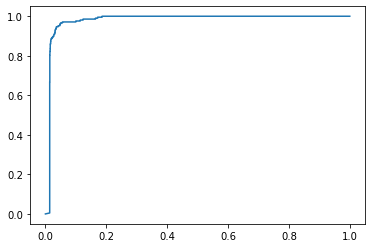

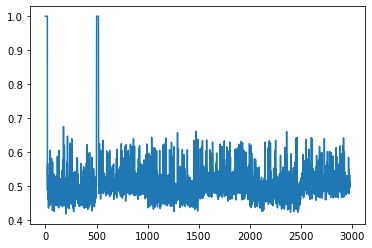

time used:17.593053102493286
TP: 2580 TN: 191 FP: 19 FN: 210
ACC: 0.9236666666666666 Precision: 0.9926894959599846 Recall: 0.9247311827956989 F1: 0.9575060308034885
FPR: 0.09047619047619047 TPR: 0.9247311827956989
AUC: 0.9316530124594641


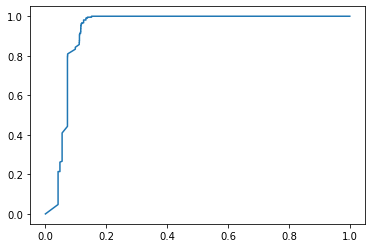

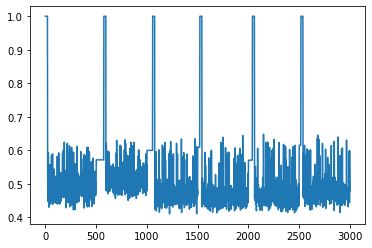

**********
window_size: 20
t: 100
phi: 10
thresh: 0.6
time used:13.502495765686035
TP: 2772 TN: 104 FP: 104 FN: 0
ACC: 0.9651006711409396 Precision: 0.9638386648122392 Recall: 1.0 F1: 0.9815864022662889
FPR: 0.5 TPR: 1.0
AUC: 0.9846360236985237


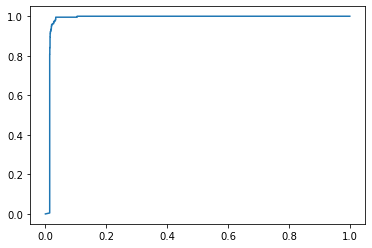

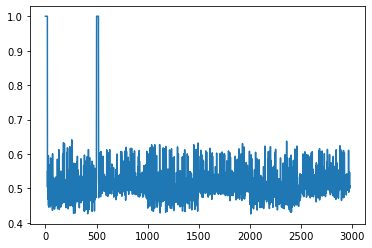

time used:22.866705656051636
TP: 2790 TN: 38 FP: 172 FN: 0
ACC: 0.9426666666666667 Precision: 0.9419311276164753 Recall: 1.0 F1: 0.9700973574408901
FPR: 0.819047619047619 TPR: 1.0
AUC: 0.8544521249359958


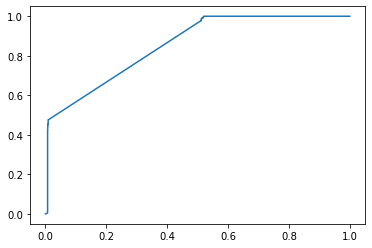

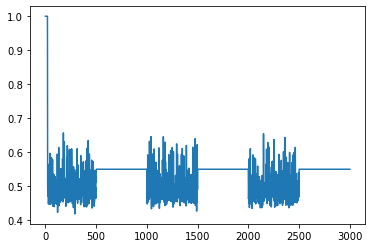

**********
window_size: 20
t: 100
phi: 10
thresh: 0.7
time used:13.819326162338257
TP: 2772 TN: 0 FP: 208 FN: 0
ACC: 0.9302013422818792 Precision: 0.9302013422818792 Recall: 1.0 F1: 0.9638386648122393
FPR: 1.0 TPR: 1.0
AUC: 0.9803521131646132


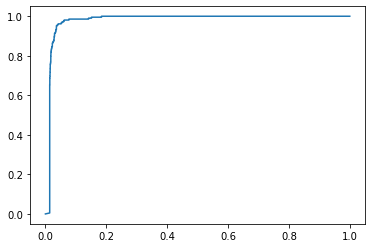

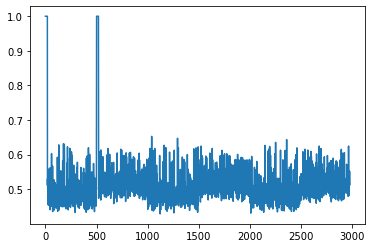

time used:19.088192462921143
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9362493599590374


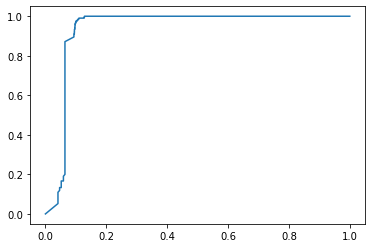

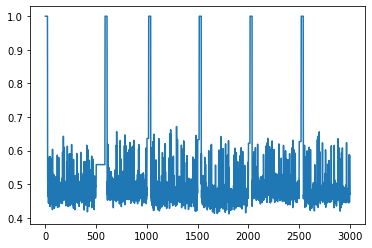

**********
window_size: 20
t: 100
phi: 15
thresh: 0.45
time used:13.8694589138031
TP: 354 TN: 207 FP: 1 FN: 2418
ACC: 0.18825503355704698 Precision: 0.9971830985915493 Recall: 0.1277056277056277 F1: 0.22641509433962267
FPR: 0.004807692307692308 TPR: 0.1277056277056277
AUC: 0.9840359293484293


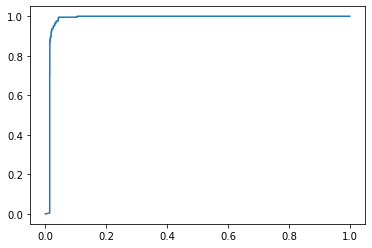

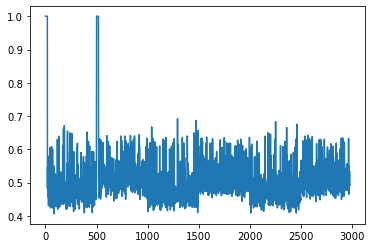

time used:19.461210012435913
TP: 1371 TN: 198 FP: 12 FN: 1419
ACC: 0.523 Precision: 0.9913232104121475 Recall: 0.4913978494623656 F1: 0.6570812365204889
FPR: 0.05714285714285714 TPR: 0.4913978494623656
AUC: 0.9481131592421914


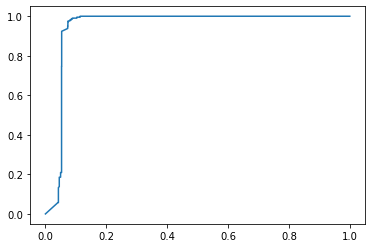

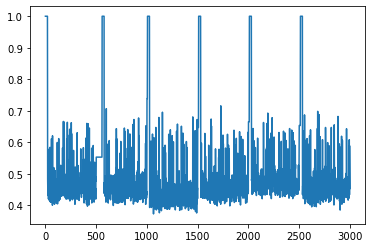

**********
window_size: 20
t: 100
phi: 15
thresh: 0.475
time used:13.98552393913269
TP: 1032 TN: 207 FP: 1 FN: 1740
ACC: 0.41577181208053693 Precision: 0.9990319457889641 Recall: 0.3722943722943723 F1: 0.5424441524310119
FPR: 0.004807692307692308 TPR: 0.3722943722943723
AUC: 0.9848614926739927


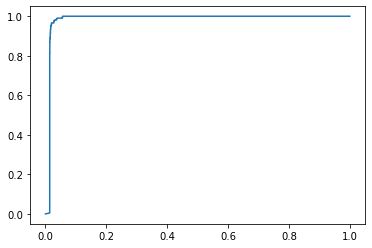

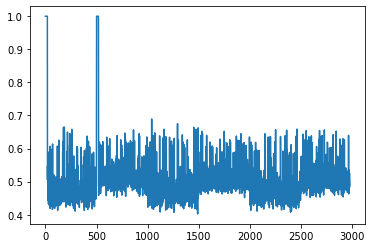

time used:19.298372745513916
TP: 2224 TN: 197 FP: 13 FN: 566
ACC: 0.807 Precision: 0.994188645507376 Recall: 0.7971326164874551 F1: 0.8848219614083946
FPR: 0.06190476190476191 TPR: 0.7971326164874551
AUC: 0.947532002048131


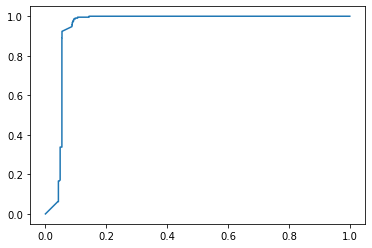

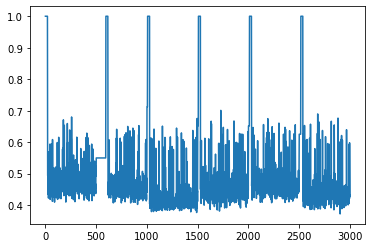

**********
window_size: 20
t: 100
phi: 15
thresh: 0.5
time used:13.637073278427124
TP: 1790 TN: 207 FP: 1 FN: 982
ACC: 0.6701342281879195 Precision: 0.9994416527079844 Recall: 0.6457431457431457 F1: 0.7845715538023229
FPR: 0.004807692307692308 TPR: 0.6457431457431457
AUC: 0.9829814282939282


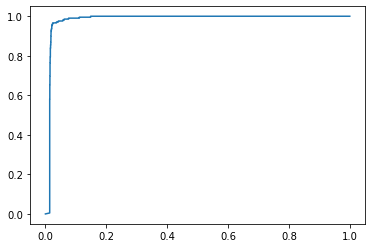

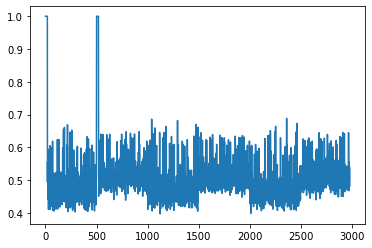

time used:19.367873430252075
TP: 2597 TN: 195 FP: 15 FN: 193
ACC: 0.9306666666666666 Precision: 0.9942572741194488 Recall: 0.9308243727598566 F1: 0.9614957423176602
FPR: 0.07142857142857142 TPR: 0.9308243727598566
AUC: 0.9479202935654548


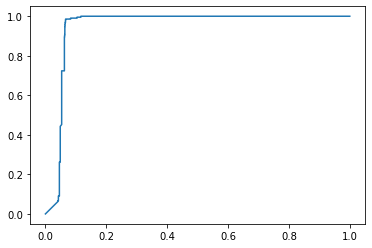

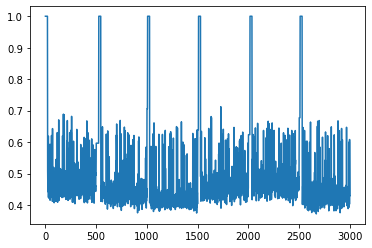

**********
window_size: 20
t: 100
phi: 15
thresh: 0.55
time used:13.87490463256836
TP: 2600 TN: 203 FP: 5 FN: 172
ACC: 0.9406040268456376 Precision: 0.9980806142034548 Recall: 0.937950937950938 F1: 0.9670820159940487
FPR: 0.02403846153846154 TPR: 0.937950937950938
AUC: 0.9830941627816627


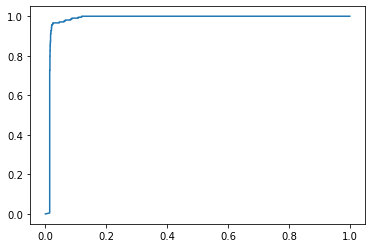

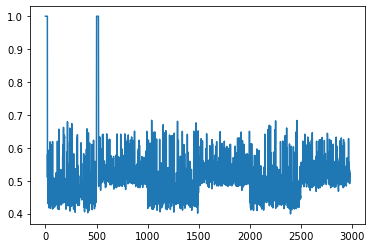

time used:18.999315977096558
TP: 2715 TN: 187 FP: 23 FN: 75
ACC: 0.9673333333333334 Precision: 0.991599707815924 Recall: 0.9731182795698925 F1: 0.9822720694645442
FPR: 0.10952380952380952 TPR: 0.9731182795698925
AUC: 0.948152415087899


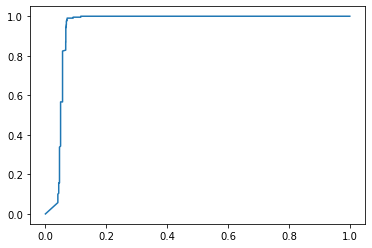

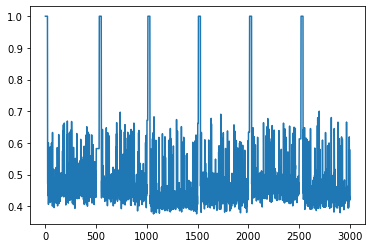

**********
window_size: 20
t: 100
phi: 15
thresh: 0.6
time used:13.523516654968262
TP: 2769 TN: 160 FP: 48 FN: 3
ACC: 0.9828859060402685 Precision: 0.9829605963791267 Recall: 0.9989177489177489 F1: 0.9908749329039184
FPR: 0.23076923076923078 TPR: 0.9989177489177489
AUC: 0.9830473346098346


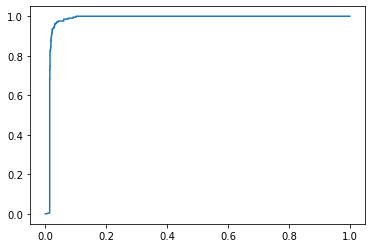

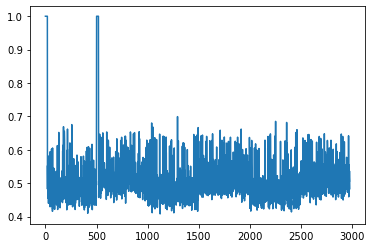

time used:18.825486421585083
TP: 2754 TN: 116 FP: 94 FN: 36
ACC: 0.9566666666666667 Precision: 0.9669943820224719 Recall: 0.9870967741935484 F1: 0.9769421780773324
FPR: 0.44761904761904764 TPR: 0.9870967741935484
AUC: 0.9471198156682028


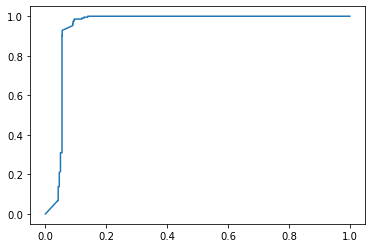

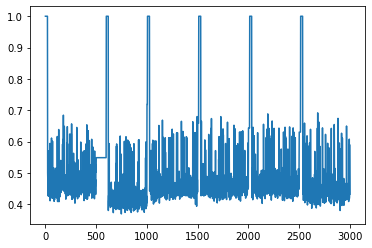

**********
window_size: 20
t: 100
phi: 15
thresh: 0.7
time used:13.777189016342163
TP: 2772 TN: 1 FP: 207 FN: 0
ACC: 0.9305369127516778 Precision: 0.9305135951661632 Recall: 1.0 F1: 0.9640062597809077
FPR: 0.9951923076923077 TPR: 1.0
AUC: 0.9836231476856476


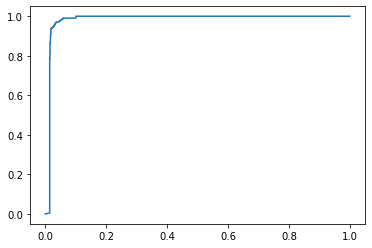

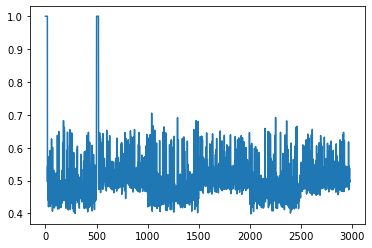

time used:18.548815727233887
TP: 2786 TN: 0 FP: 210 FN: 4
ACC: 0.9286666666666666 Precision: 0.9299065420560748 Recall: 0.9985663082437276 F1: 0.9630141721396476
FPR: 1.0 TPR: 0.9985663082437276
AUC: 0.9484101382488479


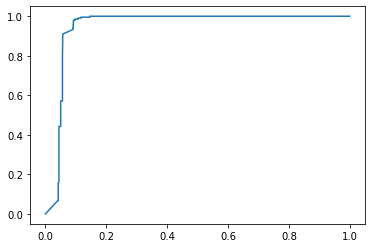

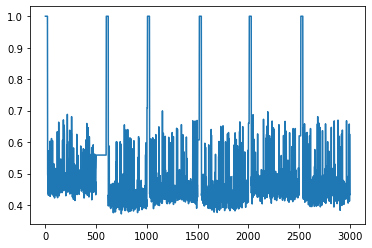

**********
window_size: 20
t: 100
phi: 18
thresh: 0.45
time used:13.681673288345337
TP: 788 TN: 207 FP: 1 FN: 1984
ACC: 0.3338926174496644 Precision: 0.9987325728770595 Recall: 0.2842712842712843 F1: 0.44257231114855383
FPR: 0.004807692307692308 TPR: 0.2842712842712843
AUC: 0.9839665542790543


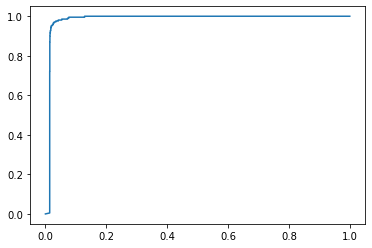

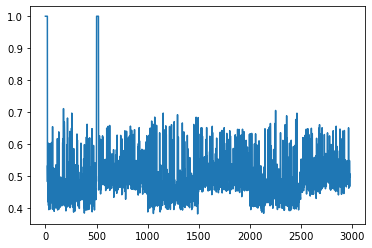

time used:20.076398372650146
TP: 1997 TN: 197 FP: 13 FN: 793
ACC: 0.7313333333333333 Precision: 0.9935323383084577 Recall: 0.7157706093189964 F1: 0.8320833333333334
FPR: 0.06190476190476191 TPR: 0.7157706093189964
AUC: 0.9505845707458611


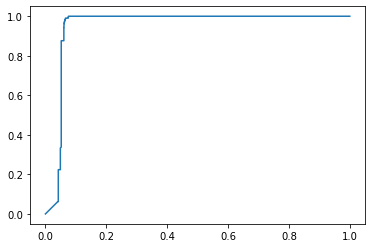

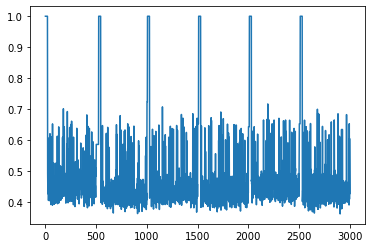

**********
window_size: 20
t: 100
phi: 18
thresh: 0.475
time used:13.74451994895935
TP: 1375 TN: 207 FP: 1 FN: 1397
ACC: 0.5308724832214765 Precision: 0.9992732558139535 Recall: 0.49603174603174605 F1: 0.6629701060752169
FPR: 0.004807692307692308 TPR: 0.49603174603174605
AUC: 0.9843654609279608


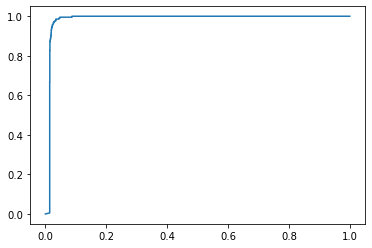

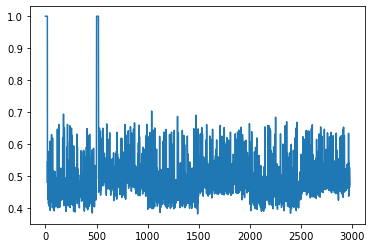

time used:18.87276005744934
TP: 2254 TN: 198 FP: 12 FN: 536
ACC: 0.8173333333333334 Precision: 0.9947043248014121 Recall: 0.8078853046594983 F1: 0.891613924050633
FPR: 0.05714285714285714 TPR: 0.8078853046594983
AUC: 0.9482386072708654


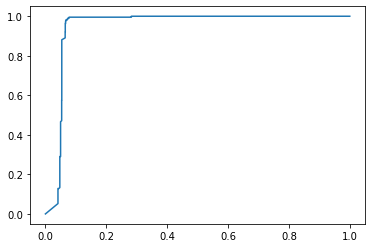

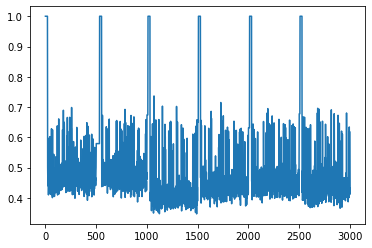

**********
window_size: 20
t: 100
phi: 18
thresh: 0.5
time used:12.378368377685547
TP: 1855 TN: 207 FP: 1 FN: 917
ACC: 0.6919463087248322 Precision: 0.9994612068965517 Recall: 0.6691919191919192 F1: 0.8016421780466724
FPR: 0.004807692307692308 TPR: 0.6691919191919192
AUC: 0.9851563367188367


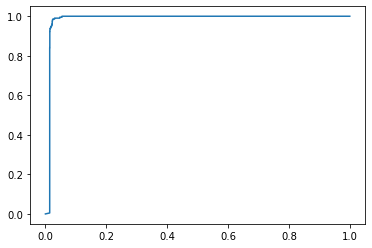

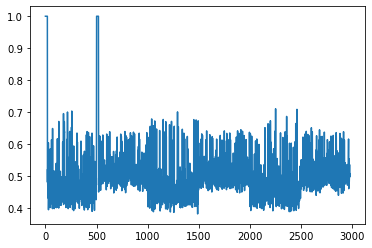

time used:18.484355211257935
TP: 2661 TN: 195 FP: 15 FN: 129
ACC: 0.952 Precision: 0.9943946188340808 Recall: 0.953763440860215 F1: 0.973655323819978
FPR: 0.07142857142857142 TPR: 0.953763440860215
AUC: 0.951678614097969


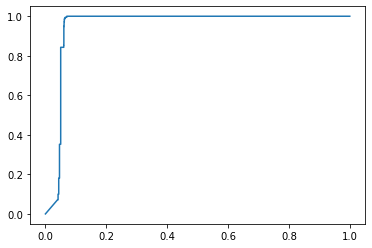

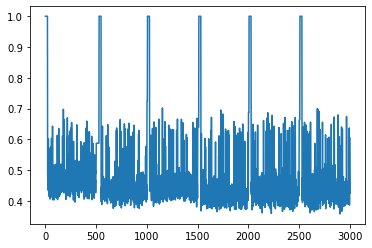

**********
window_size: 20
t: 100
phi: 18
thresh: 0.55
time used:13.483847856521606
TP: 2672 TN: 205 FP: 3 FN: 100
ACC: 0.9654362416107383 Precision: 0.9988785046728972 Recall: 0.963924963924964 F1: 0.9810905085368093
FPR: 0.014423076923076924 TPR: 0.963924963924964
AUC: 0.9842388514263514


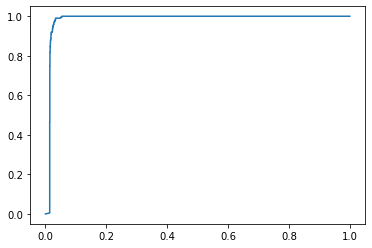

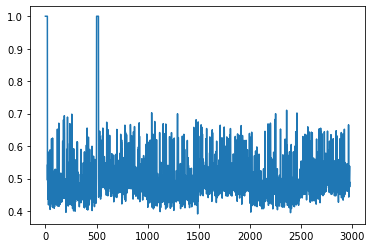

time used:19.09262466430664
TP: 2720 TN: 186 FP: 24 FN: 70
ACC: 0.9686666666666667 Precision: 0.9912536443148688 Recall: 0.974910394265233 F1: 0.9830140946873871
FPR: 0.11428571428571428 TPR: 0.974910394265233
AUC: 0.9483068783068783


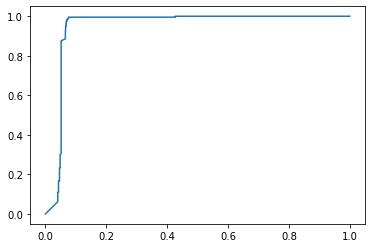

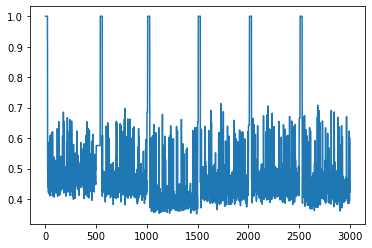

**********
window_size: 20
t: 100
phi: 18
thresh: 0.6
time used:13.602593183517456
TP: 2771 TN: 170 FP: 38 FN: 1
ACC: 0.9869127516778523 Precision: 0.9864720541117835 Recall: 0.9996392496392497 F1: 0.993012005017022
FPR: 0.18269230769230768 TPR: 0.9996392496392497
AUC: 0.9848666958041957


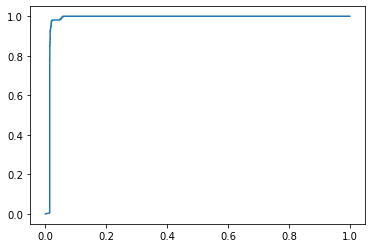

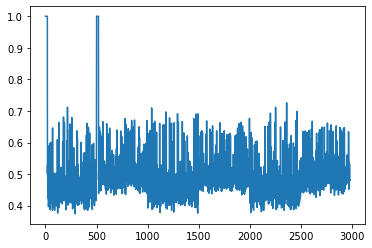

time used:19.750994205474854
TP: 2758 TN: 138 FP: 72 FN: 32
ACC: 0.9653333333333334 Precision: 0.9745583038869258 Recall: 0.9885304659498207 F1: 0.9814946619217081
FPR: 0.34285714285714286 TPR: 0.9885304659498207
AUC: 0.9483811230585425


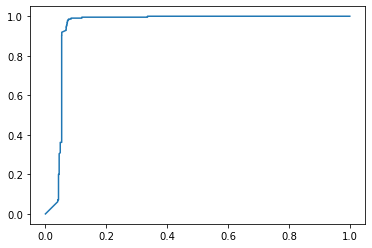

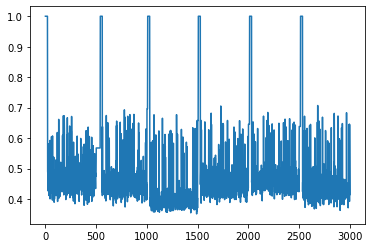

**********
window_size: 20
t: 100
phi: 18
thresh: 0.7
time used:13.570053577423096
TP: 2772 TN: 5 FP: 203 FN: 0
ACC: 0.9318791946308724 Precision: 0.9317647058823529 Recall: 1.0 F1: 0.9646772228989038
FPR: 0.9759615384615384 TPR: 1.0
AUC: 0.9851441960816961


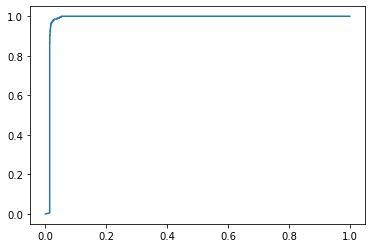

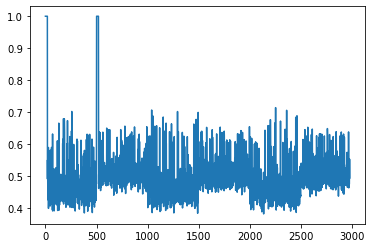

time used:18.93623995780945
TP: 2790 TN: 5 FP: 205 FN: 0
ACC: 0.9316666666666666 Precision: 0.9315525876460768 Recall: 1.0 F1: 0.9645635263612792
FPR: 0.9761904761904762 TPR: 1.0
AUC: 0.9479561358593617


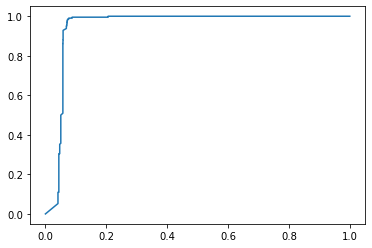

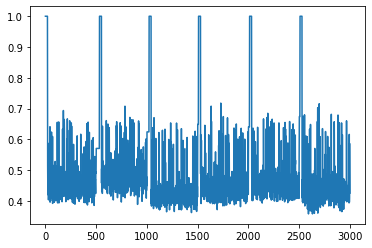

**********
window_size: 30
t: 20
phi: 3
thresh: 0.45
time used:11.882460832595825
TP: 2760 TN: 22 FP: 186 FN: 2
ACC: 0.9367003367003367 Precision: 0.9368635437881874 Recall: 0.999275887038378 F1: 0.9670637701471618
FPR: 0.8942307692307693 TPR: 0.999275887038378
AUC: 0.83548971620342


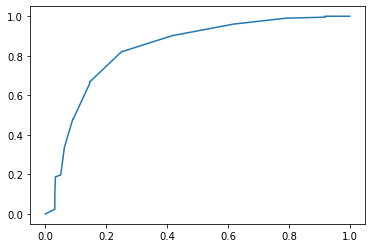

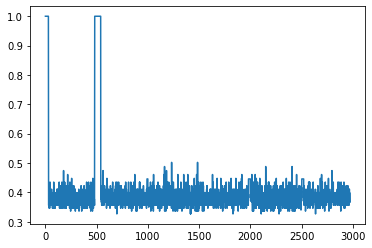

time used:21.325793266296387
TP: 2790 TN: 3 FP: 207 FN: 0
ACC: 0.931 Precision: 0.9309309309309309 Recall: 1.0 F1: 0.9642301710730948
FPR: 0.9857142857142858 TPR: 1.0
AUC: 0.7115548728451955


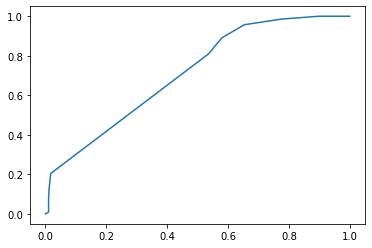

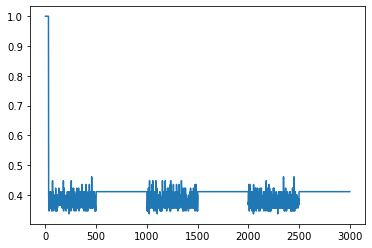

**********
window_size: 30
t: 20
phi: 3
thresh: 0.475
time used:11.914523363113403
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8459188575725506


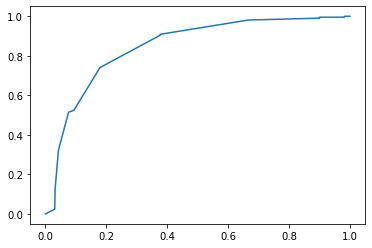

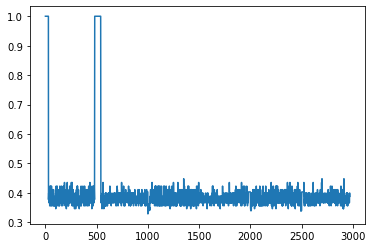

time used:21.515419483184814
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7053149001536098


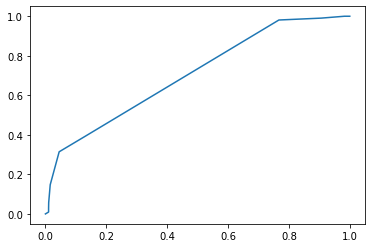

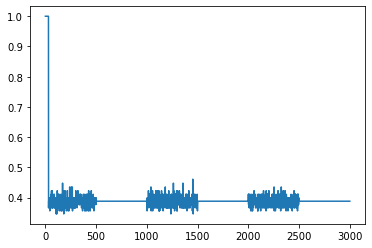

**********
window_size: 30
t: 20
phi: 3
thresh: 0.5
time used:12.035178899765015
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.7979837979724836


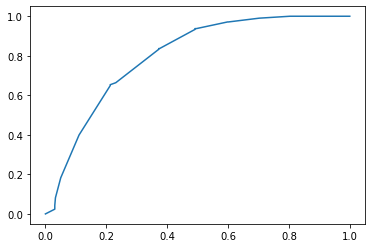

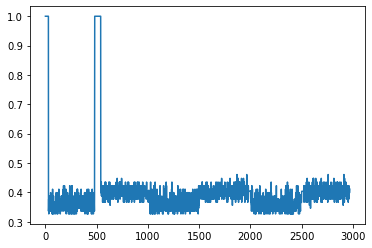

time used:21.60952854156494
TP: 2790 TN: 1 FP: 209 FN: 0
ACC: 0.9303333333333333 Precision: 0.9303101033677893 Recall: 1.0 F1: 0.9638970461219554
FPR: 0.9952380952380953 TPR: 1.0
AUC: 0.7489238777948455


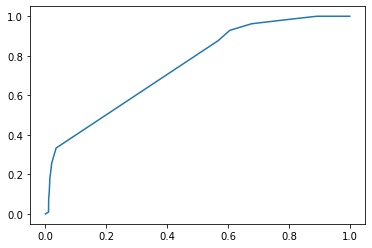

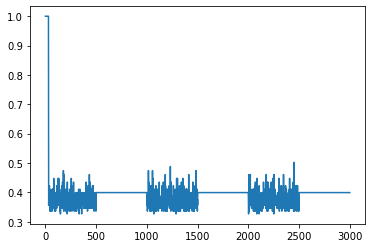

**********
window_size: 30
t: 20
phi: 3
thresh: 0.55
time used:11.850458145141602
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.7433811549601739


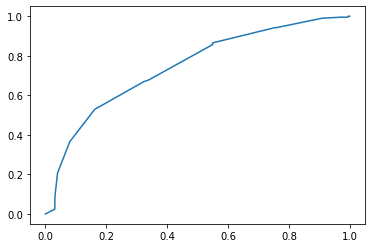

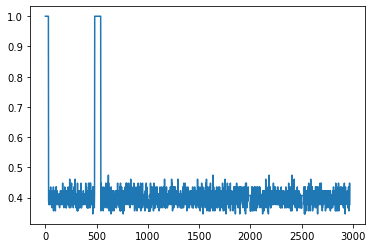

time used:21.66742444038391
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7504932582351937


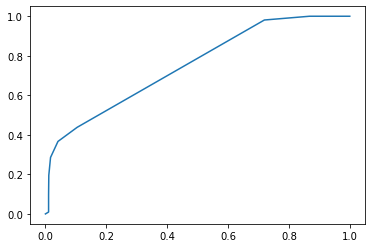

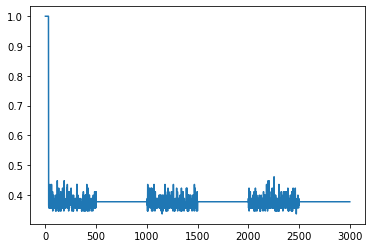

**********
window_size: 30
t: 20
phi: 3
thresh: 0.6
time used:11.877016305923462
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.7389807761933939


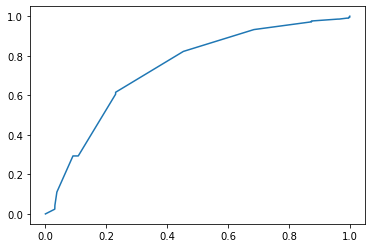

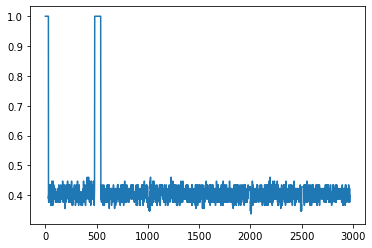

time used:21.2599937915802
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7154284007509812


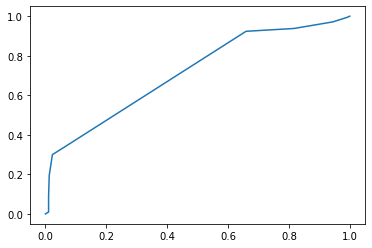

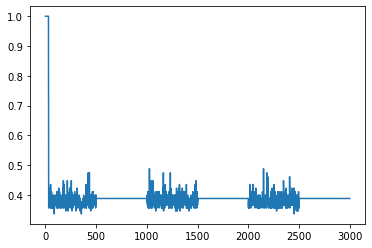

**********
window_size: 30
t: 20
phi: 3
thresh: 0.7
time used:11.587053775787354
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.7698426098702167


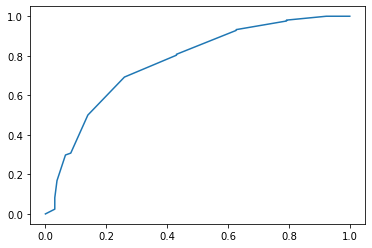

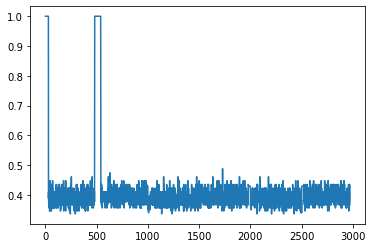

time used:21.261409282684326
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.6887028503157535


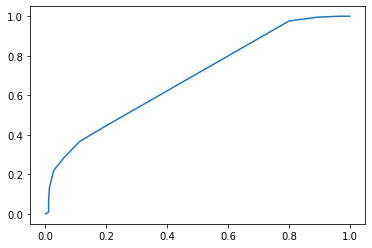

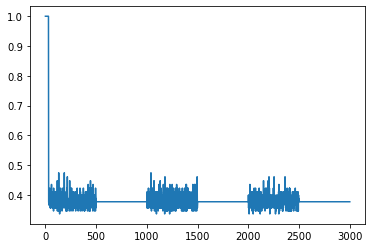

**********
window_size: 30
t: 20
phi: 7
thresh: 0.45
time used:11.607070446014404
TP: 163 TN: 203 FP: 5 FN: 2599
ACC: 0.12323232323232323 Precision: 0.9702380952380952 Recall: 0.05901520637219406 F1: 0.11126279863481227
FPR: 0.02403846153846154 TPR: 0.05901520637219406
AUC: 0.9447802943797694


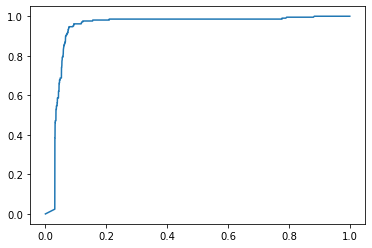

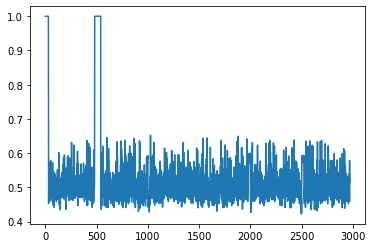

time used:20.835029125213623
TP: 32 TN: 208 FP: 2 FN: 2758
ACC: 0.08 Precision: 0.9411764705882353 Recall: 0.011469534050179211 F1: 0.0226628895184136
FPR: 0.009523809523809525 TPR: 0.011469534050179211
AUC: 0.7418911076975594


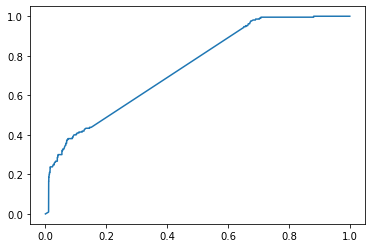

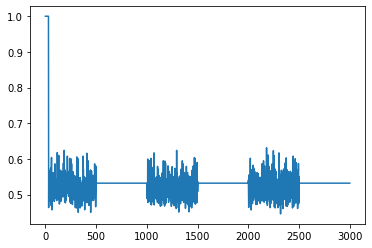

**********
window_size: 30
t: 20
phi: 7
thresh: 0.475
time used:11.035079717636108
TP: 574 TN: 203 FP: 5 FN: 2188
ACC: 0.26161616161616164 Precision: 0.9913644214162349 Recall: 0.20782041998551773 F1: 0.34360969769530075
FPR: 0.02403846153846154 TPR: 0.20782041998551773
AUC: 0.9507289867988638


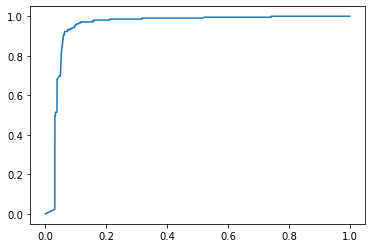

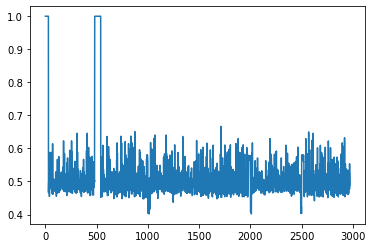

time used:20.806146383285522
TP: 909 TN: 208 FP: 2 FN: 1881
ACC: 0.37233333333333335 Precision: 0.9978046103183315 Recall: 0.3258064516129032 F1: 0.4912185895703864
FPR: 0.009523809523809525 TPR: 0.3258064516129032
AUC: 0.8318151561699948


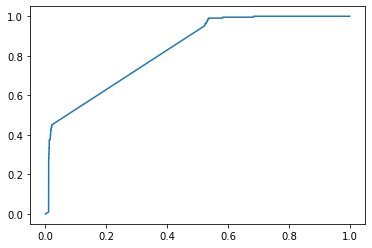

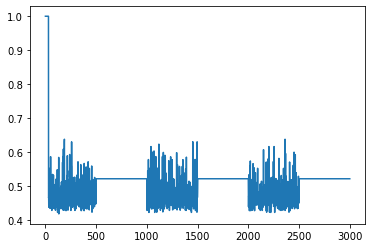

**********
window_size: 30
t: 20
phi: 7
thresh: 0.5
time used:11.095110416412354
TP: 2285 TN: 198 FP: 10 FN: 477
ACC: 0.836026936026936 Precision: 0.9956427015250545 Recall: 0.8272990586531499 F1: 0.9036978445718805
FPR: 0.04807692307692308 TPR: 0.8272990586531499
AUC: 0.941414735698769


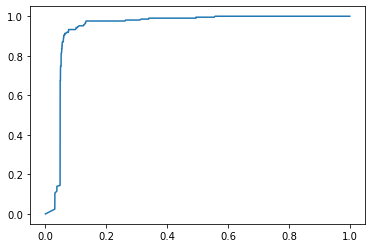

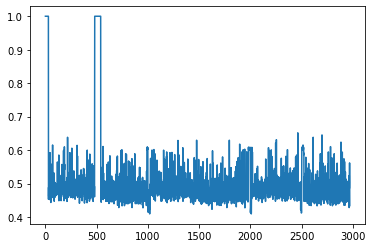

time used:18.48586416244507
TP: 1078 TN: 202 FP: 8 FN: 1712
ACC: 0.4266666666666667 Precision: 0.992633517495396 Recall: 0.3863799283154122 F1: 0.5562435500515996
FPR: 0.0380952380952381 TPR: 0.3863799283154122
AUC: 0.825457415941287


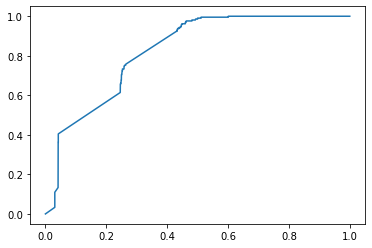

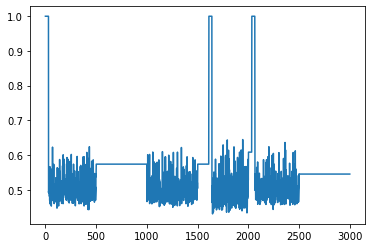

**********
window_size: 30
t: 20
phi: 7
thresh: 0.55
time used:11.044617891311646
TP: 2686 TN: 153 FP: 55 FN: 76
ACC: 0.9558922558922559 Precision: 0.9799343305363006 Recall: 0.9724837074583635 F1: 0.9761948028348175
FPR: 0.2644230769230769 TPR: 0.9724837074583635
AUC: 0.9421928090012811


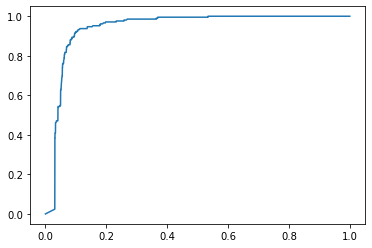

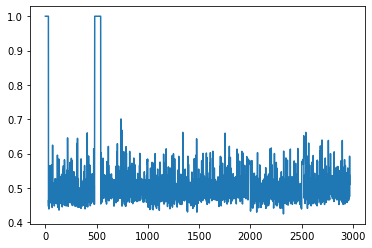

time used:19.630929708480835
TP: 1806 TN: 178 FP: 32 FN: 984
ACC: 0.6613333333333333 Precision: 0.9825897714907508 Recall: 0.6473118279569893 F1: 0.780466724286949
FPR: 0.1523809523809524 TPR: 0.6473118279569893
AUC: 0.8469849803720771


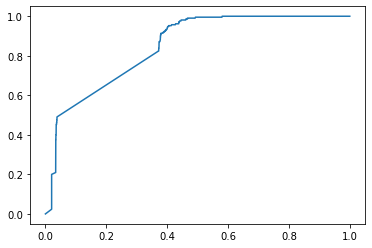

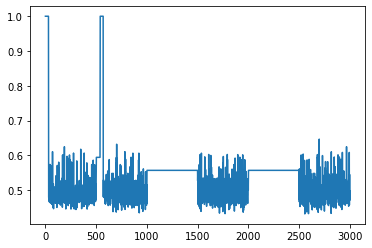

**********
window_size: 30
t: 20
phi: 7
thresh: 0.6
time used:10.993537664413452
TP: 2762 TN: 60 FP: 148 FN: 0
ACC: 0.9501683501683502 Precision: 0.9491408934707903 Recall: 1.0 F1: 0.9739069111424541
FPR: 0.7115384615384616 TPR: 1.0
AUC: 0.9495322856904138


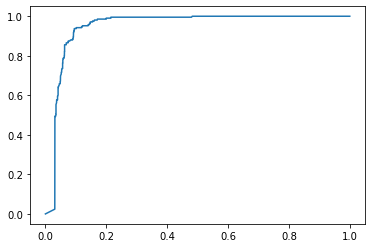

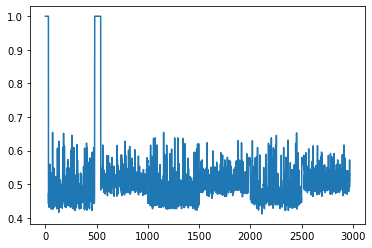

time used:20.725882053375244
TP: 2790 TN: 34 FP: 176 FN: 0
ACC: 0.9413333333333334 Precision: 0.9406608226567768 Recall: 1.0 F1: 0.9694232105628908
FPR: 0.8380952380952381 TPR: 1.0
AUC: 0.8099496501109404


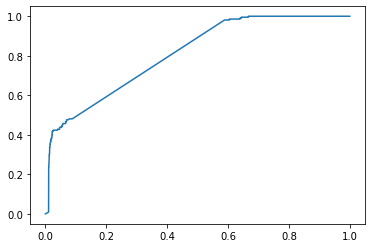

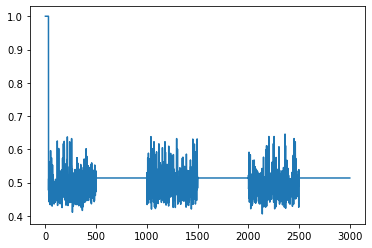

**********
window_size: 30
t: 20
phi: 7
thresh: 0.7
time used:11.03107237815857
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9416505946081436


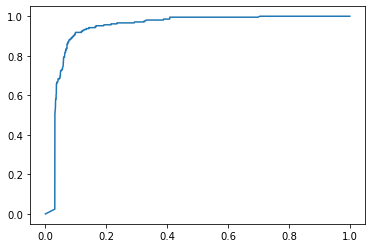

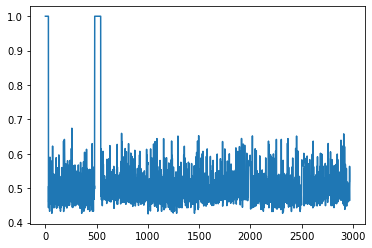

time used:20.701900243759155
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7783666154633897


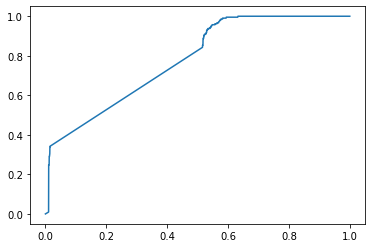

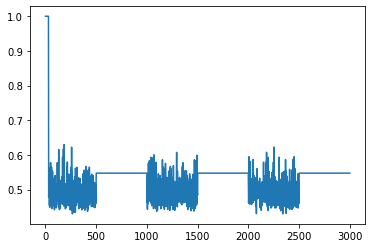

**********
window_size: 30
t: 20
phi: 15
thresh: 0.45
time used:11.045072555541992
TP: 814 TN: 203 FP: 5 FN: 1948
ACC: 0.3424242424242424 Precision: 0.9938949938949939 Recall: 0.2947139753801593 F1: 0.4546216140742809
FPR: 0.02403846153846154 TPR: 0.2947139753801593
AUC: 0.9642234236617835


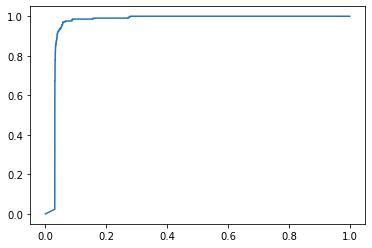

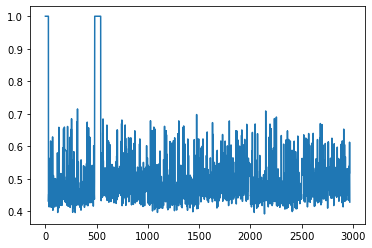

time used:17.190167665481567
TP: 1175 TN: 194 FP: 16 FN: 1615
ACC: 0.4563333333333333 Precision: 0.9865659109991604 Recall: 0.4211469534050179 F1: 0.5903039437327304
FPR: 0.0761904761904762 TPR: 0.4211469534050179
AUC: 0.9284058713090971


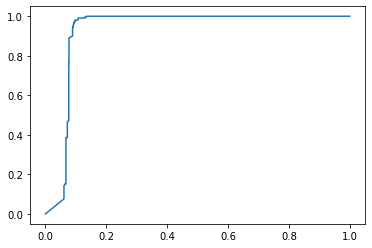

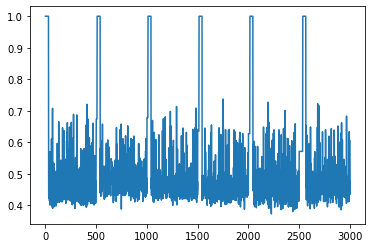

**********
window_size: 30
t: 20
phi: 15
thresh: 0.475
time used:11.053573608398438
TP: 1412 TN: 203 FP: 5 FN: 1350
ACC: 0.5437710437710438 Precision: 0.9964714184897672 Recall: 0.5112237509051412 F1: 0.6757597511366356
FPR: 0.02403846153846154 TPR: 0.5112237509051412
AUC: 0.9568491338494959


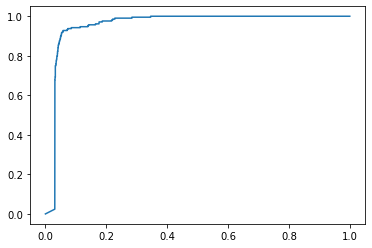

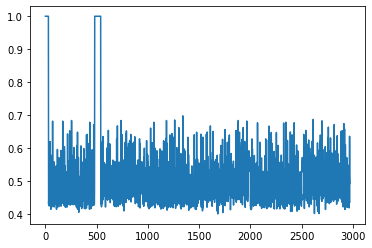

time used:17.25384497642517
TP: 2092 TN: 192 FP: 18 FN: 698
ACC: 0.7613333333333333 Precision: 0.9914691943127962 Recall: 0.749820788530466 F1: 0.8538775510204082
FPR: 0.08571428571428572 TPR: 0.749820788530466
AUC: 0.9245920805598224


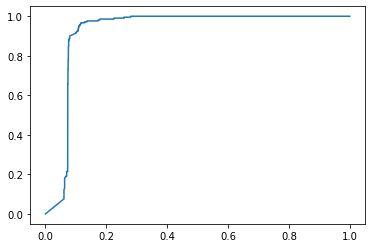

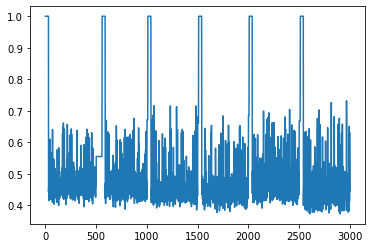

**********
window_size: 30
t: 20
phi: 15
thresh: 0.5
time used:11.041602611541748
TP: 1624 TN: 203 FP: 5 FN: 1138
ACC: 0.6151515151515151 Precision: 0.9969306322897483 Recall: 0.5879797248370746 F1: 0.7396948303347757
FPR: 0.02403846153846154 TPR: 0.5879797248370746
AUC: 0.9656742605692642


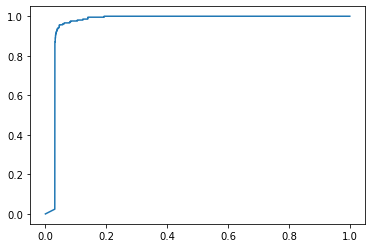

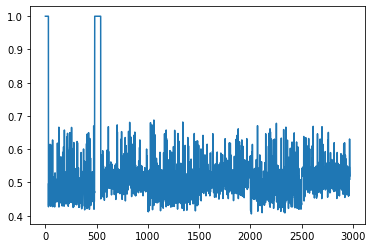

time used:16.594237327575684
TP: 2378 TN: 190 FP: 20 FN: 412
ACC: 0.856 Precision: 0.9916597164303587 Recall: 0.8523297491039427 F1: 0.9167309175019275
FPR: 0.09523809523809523 TPR: 0.8523297491039427
AUC: 0.9236874893326507


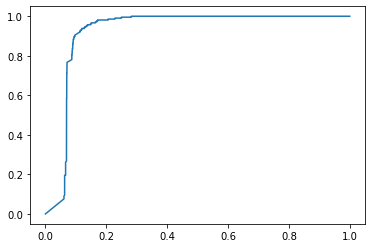

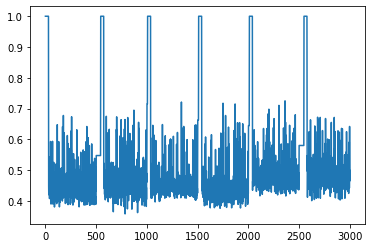

**********
window_size: 30
t: 20
phi: 15
thresh: 0.55
time used:11.103612184524536
TP: 2686 TN: 197 FP: 11 FN: 76
ACC: 0.9707070707070707 Precision: 0.9959213941416388 Recall: 0.9724837074583635 F1: 0.9840630152042498
FPR: 0.052884615384615384 TPR: 0.9724837074583635
AUC: 0.9648518005347296


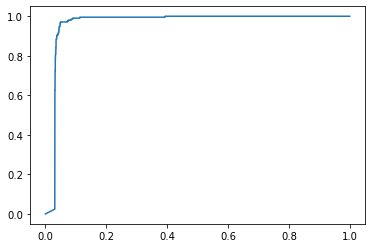

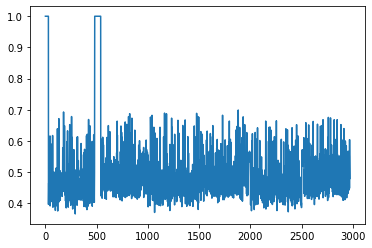

time used:16.33038568496704
TP: 2720 TN: 185 FP: 25 FN: 70
ACC: 0.9683333333333334 Precision: 0.9908925318761385 Recall: 0.974910394265233 F1: 0.982836495031617
FPR: 0.11904761904761904 TPR: 0.974910394265233
AUC: 0.9291833077316949


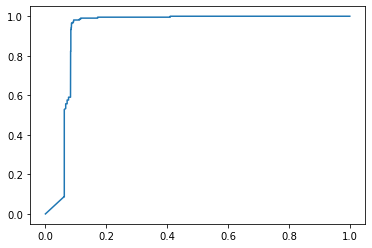

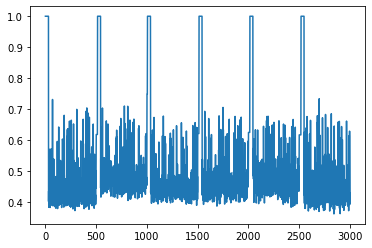

**********
window_size: 30
t: 20
phi: 15
thresh: 0.6
time used:11.03206467628479
TP: 2762 TN: 152 FP: 56 FN: 0
ACC: 0.9811447811447811 Precision: 0.9801277501774308 Recall: 1.0 F1: 0.9899641577060931
FPR: 0.2692307692307692 TPR: 1.0
AUC: 0.9661102949367794


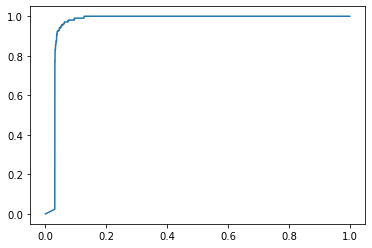

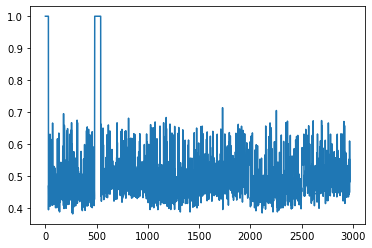

time used:17.075101613998413
TP: 2749 TN: 122 FP: 88 FN: 41
ACC: 0.957 Precision: 0.9689813182939725 Recall: 0.9853046594982079 F1: 0.9770748178425449
FPR: 0.41904761904761906 TPR: 0.9853046594982079
AUC: 0.9301382488479263


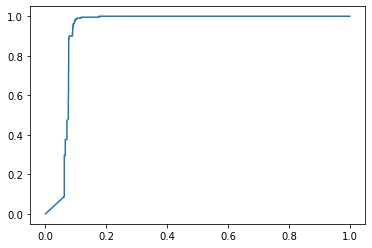

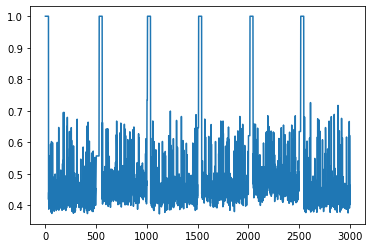

**********
window_size: 30
t: 20
phi: 15
thresh: 0.7
time used:11.063609600067139
TP: 2762 TN: 4 FP: 204 FN: 0
ACC: 0.9313131313131313 Precision: 0.9312204989885368 Recall: 1.0 F1: 0.9643854748603351
FPR: 0.9807692307692307 TPR: 1.0
AUC: 0.9669588648136802


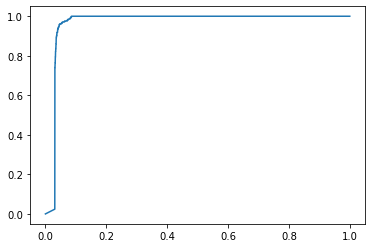

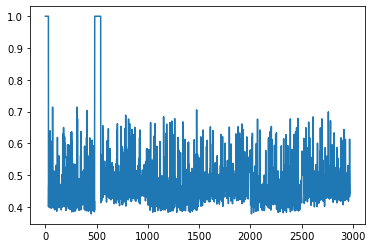

time used:15.581209182739258
TP: 2790 TN: 1 FP: 209 FN: 0
ACC: 0.9303333333333333 Precision: 0.9303101033677893 Recall: 1.0 F1: 0.9638970461219554
FPR: 0.9952380952380953 TPR: 1.0
AUC: 0.9193915343915344


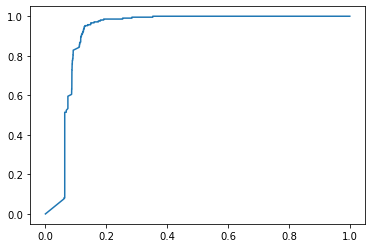

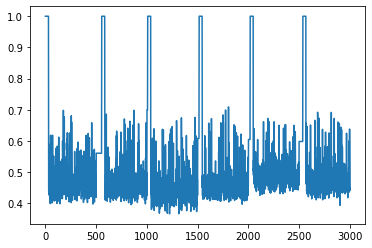

**********
window_size: 30
t: 20
phi: 22
thresh: 0.45
time used:11.16918659210205
TP: 1526 TN: 203 FP: 5 FN: 1236
ACC: 0.5821548821548822 Precision: 0.9967341606792945 Recall: 0.5524981897175959 F1: 0.7109247612392265
FPR: 0.02403846153846154 TPR: 0.5524981897175959
AUC: 0.965648150726898


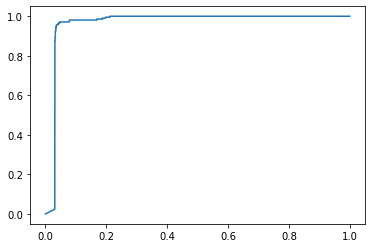

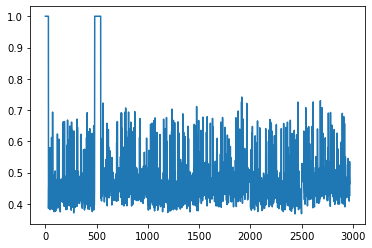

time used:17.94090747833252
TP: 1862 TN: 194 FP: 16 FN: 928
ACC: 0.6853333333333333 Precision: 0.9914802981895634 Recall: 0.6673835125448029 F1: 0.7977720651242503
FPR: 0.0761904761904762 TPR: 0.6673835125448029
AUC: 0.9304847243556921


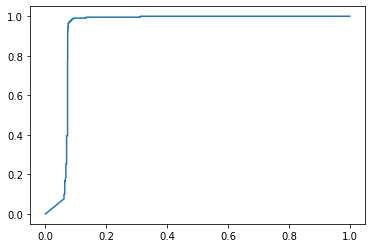

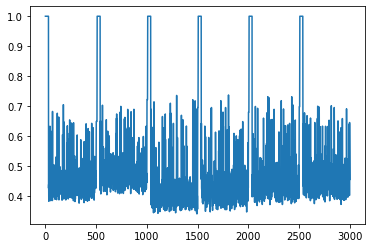

**********
window_size: 30
t: 20
phi: 22
thresh: 0.475
time used:11.085617065429688
TP: 2346 TN: 203 FP: 5 FN: 416
ACC: 0.8582491582491583 Precision: 0.9978732454274777 Recall: 0.8493845039826213 F1: 0.9176608644631332
FPR: 0.02403846153846154 TPR: 0.8493845039826213
AUC: 0.9684871609201805


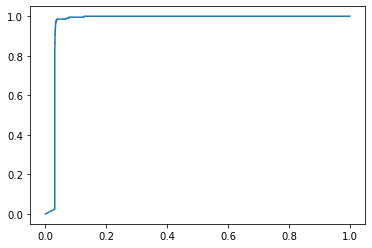

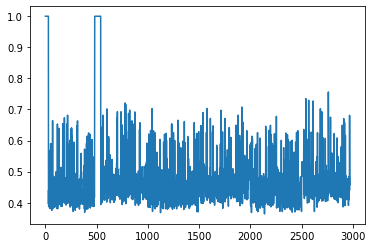

time used:17.790733814239502
TP: 2366 TN: 194 FP: 16 FN: 424
ACC: 0.8533333333333334 Precision: 0.9932829554995802 Recall: 0.8480286738351255 F1: 0.9149265274555297
FPR: 0.0761904761904762 TPR: 0.8480286738351255
AUC: 0.9312886158047449


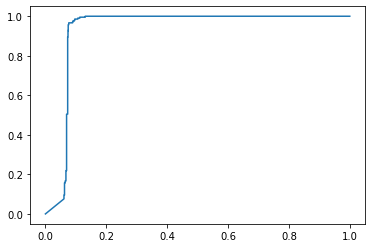

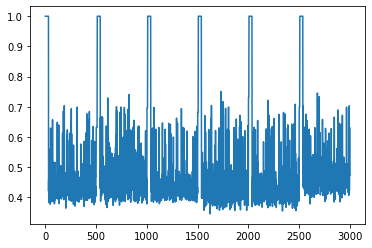

**********
window_size: 30
t: 20
phi: 22
thresh: 0.5
time used:11.081591606140137
TP: 2578 TN: 202 FP: 6 FN: 184
ACC: 0.936026936026936 Precision: 0.9976780185758514 Recall: 0.9333816075307748 F1: 0.9644594089038534
FPR: 0.028846153846153848 TPR: 0.9333816075307748
AUC: 0.968954527098535


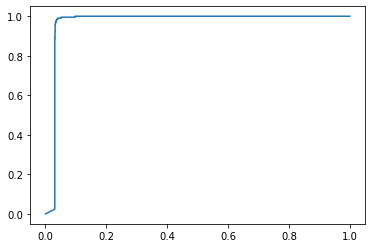

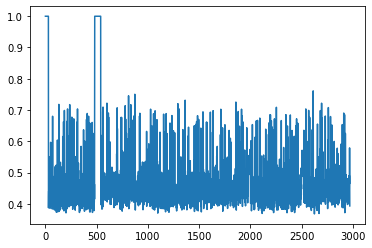

time used:17.910336017608643
TP: 2537 TN: 193 FP: 17 FN: 253
ACC: 0.91 Precision: 0.9933437744714174 Recall: 0.9093189964157706 F1: 0.9494760479041916
FPR: 0.08095238095238096 TPR: 0.9093189964157706
AUC: 0.9316043693463049


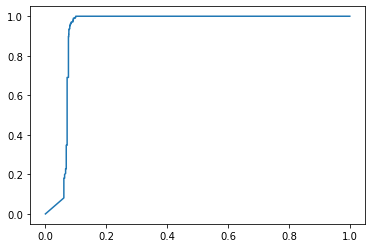

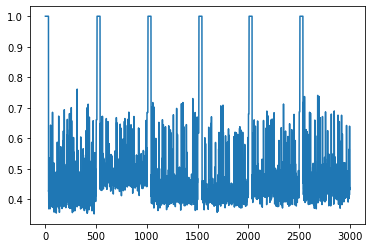

**********
window_size: 30
t: 20
phi: 22
thresh: 0.55
time used:11.095653295516968
TP: 2682 TN: 194 FP: 14 FN: 80
ACC: 0.9683501683501684 Precision: 0.994807121661721 Recall: 0.9710354815351194 F1: 0.9827775742030048
FPR: 0.0673076923076923 TPR: 0.9710354815351194
AUC: 0.9651407494569154


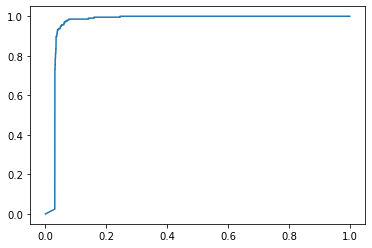

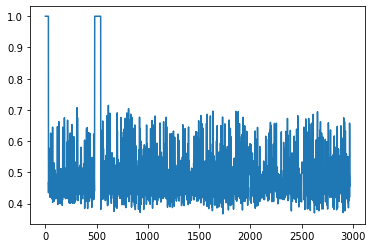

time used:17.96839952468872
TP: 2755 TN: 189 FP: 21 FN: 35
ACC: 0.9813333333333333 Precision: 0.9924351585014409 Recall: 0.9874551971326165 F1: 0.9899389148401005
FPR: 0.1 TPR: 0.9874551971326165
AUC: 0.9333213859020311


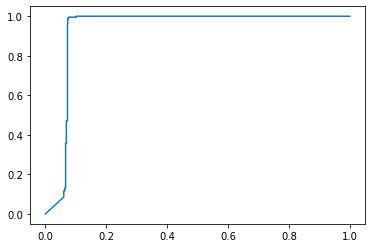

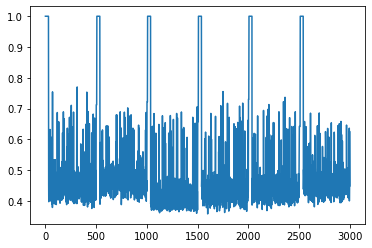

**********
window_size: 30
t: 20
phi: 22
thresh: 0.6
time used:11.081810712814331
TP: 2754 TN: 164 FP: 44 FN: 8
ACC: 0.9824915824915825 Precision: 0.9842744817726948 Recall: 0.997103548153512 F1: 0.9906474820143886
FPR: 0.21153846153846154 TPR: 0.997103548153512
AUC: 0.9668761836461872


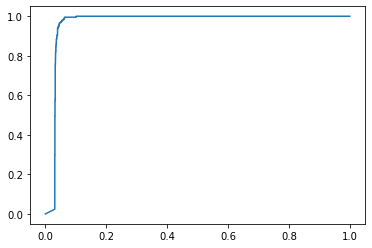

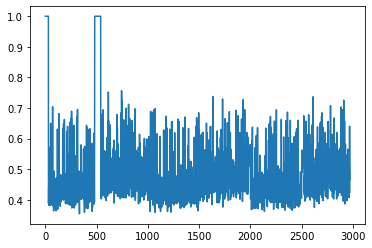

time used:17.458433866500854
TP: 2758 TN: 147 FP: 63 FN: 32
ACC: 0.9683333333333334 Precision: 0.9776674937965261 Recall: 0.9885304659498207 F1: 0.9830689716628052
FPR: 0.3 TPR: 0.9885304659498207
AUC: 0.9313671274961597


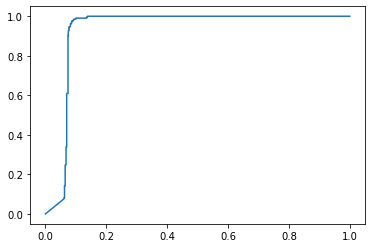

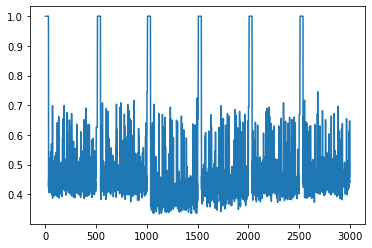

**********
window_size: 30
t: 20
phi: 22
thresh: 0.7
time used:11.103612184524536
TP: 2762 TN: 16 FP: 192 FN: 0
ACC: 0.9353535353535354 Precision: 0.9350033852403521 Recall: 1.0 F1: 0.966410076976907
FPR: 0.9230769230769231 TPR: 1.0
AUC: 0.9681799351083384


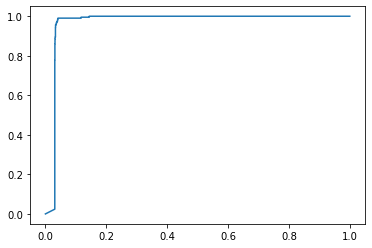

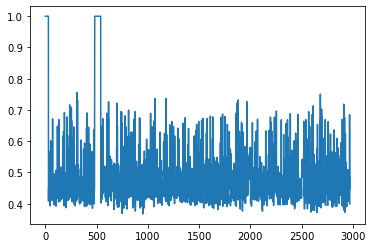

time used:17.938410758972168
TP: 2780 TN: 16 FP: 194 FN: 10
ACC: 0.932 Precision: 0.9347679892400808 Recall: 0.996415770609319 F1: 0.9646079111727967
FPR: 0.9238095238095239 TPR: 0.996415770609319
AUC: 0.9312280252602833


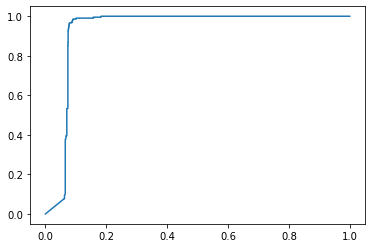

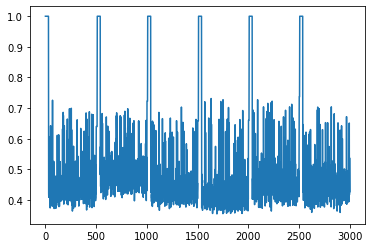

**********
window_size: 30
t: 20
phi: 27
thresh: 0.45
time used:11.100615978240967
TP: 1701 TN: 203 FP: 5 FN: 1061
ACC: 0.641077441077441 Precision: 0.9970691676436108 Recall: 0.6158580738595221 F1: 0.761414503133393
FPR: 0.02403846153846154 TPR: 0.6158580738595221
AUC: 0.9689371205369576


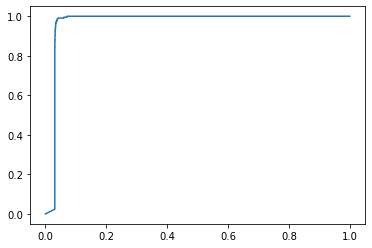

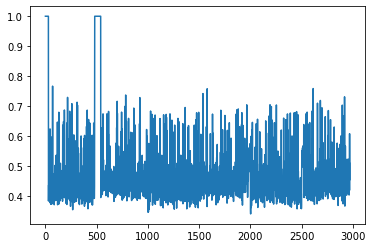

time used:17.85779881477356
TP: 2282 TN: 193 FP: 17 FN: 508
ACC: 0.825 Precision: 0.9926054806437582 Recall: 0.817921146953405 F1: 0.8968363136176066
FPR: 0.08095238095238096 TPR: 0.817921146953405
AUC: 0.9345613585936168


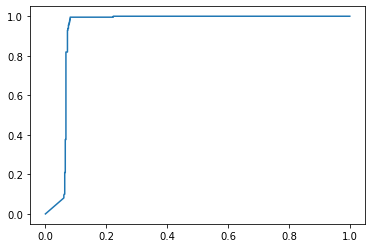

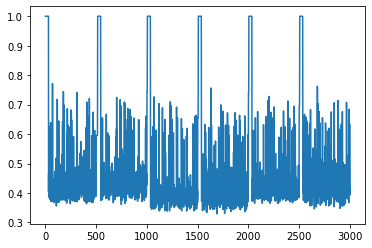

**********
window_size: 30
t: 20
phi: 27
thresh: 0.475
time used:11.031545877456665
TP: 2474 TN: 203 FP: 5 FN: 288
ACC: 0.9013468013468013 Precision: 0.9979830576845502 Recall: 0.8957277335264301 F1: 0.944094638427781
FPR: 0.02403846153846154 TPR: 0.8957277335264301
AUC: 0.9694941305074359


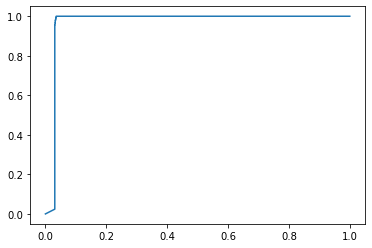

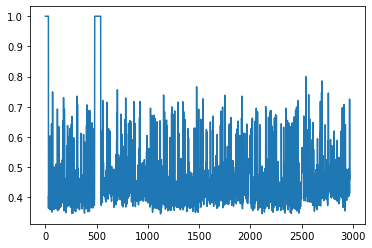

time used:17.992928504943848
TP: 2583 TN: 193 FP: 17 FN: 207
ACC: 0.9253333333333333 Precision: 0.9934615384615385 Recall: 0.9258064516129032 F1: 0.9584415584415585
FPR: 0.08095238095238096 TPR: 0.9258064516129032
AUC: 0.933721624850657


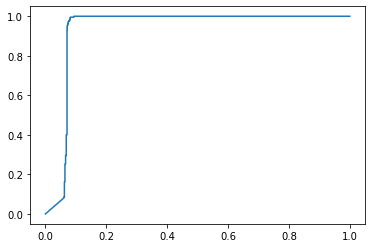

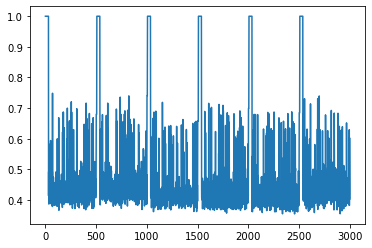

**********
window_size: 30
t: 20
phi: 27
thresh: 0.5
time used:11.757453918457031
TP: 2557 TN: 203 FP: 5 FN: 205
ACC: 0.9292929292929293 Precision: 0.998048399687744 Recall: 0.9257784214337437 F1: 0.9605559729526671
FPR: 0.02403846153846154 TPR: 0.9257784214337437
AUC: 0.9687230198295549


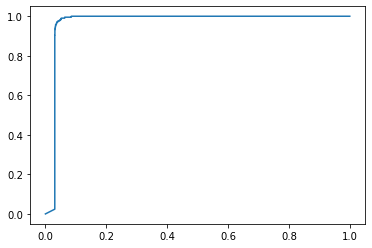

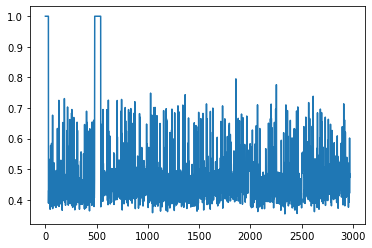

time used:19.138081073760986
TP: 2685 TN: 192 FP: 18 FN: 105
ACC: 0.959 Precision: 0.9933407325194229 Recall: 0.9623655913978495 F1: 0.9776078645548881
FPR: 0.08571428571428572 TPR: 0.9623655913978495
AUC: 0.9318492916880013


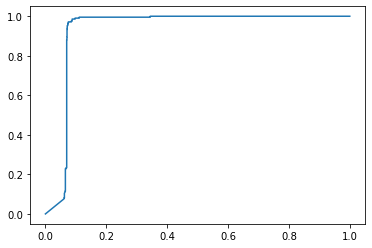

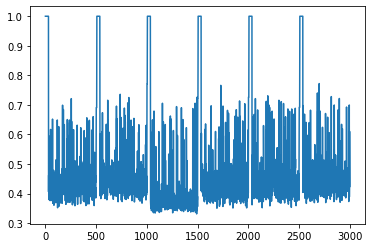

**********
window_size: 30
t: 20
phi: 27
thresh: 0.55
time used:12.379403591156006
TP: 2756 TN: 199 FP: 9 FN: 6
ACC: 0.9949494949494949 Precision: 0.996745027124774 Recall: 0.997827661115134 F1: 0.9972860502985346
FPR: 0.04326923076923077 TPR: 0.997827661115134
AUC: 0.9694332075419151


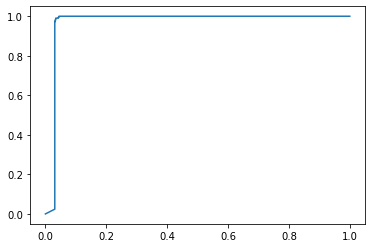

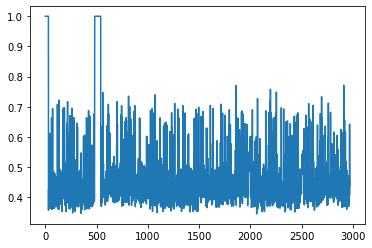

time used:19.200387001037598
TP: 2764 TN: 190 FP: 20 FN: 26
ACC: 0.9846666666666667 Precision: 0.992816091954023 Recall: 0.9906810035842294 F1: 0.9917473986365267
FPR: 0.09523809523809523 TPR: 0.9906810035842294
AUC: 0.9335697217955282


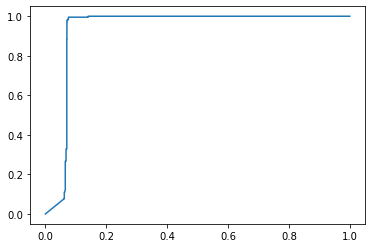

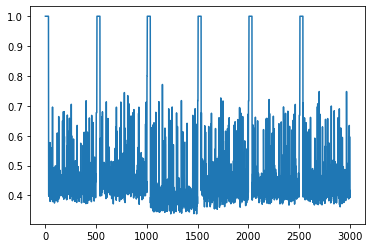

**********
window_size: 30
t: 20
phi: 27
thresh: 0.6
time used:12.26432180404663
TP: 2762 TN: 147 FP: 61 FN: 0
ACC: 0.9794612794612795 Precision: 0.9783917817924194 Recall: 1.0 F1: 0.9890778871978513
FPR: 0.2932692307692308 TPR: 1.0
AUC: 0.9674488595220855


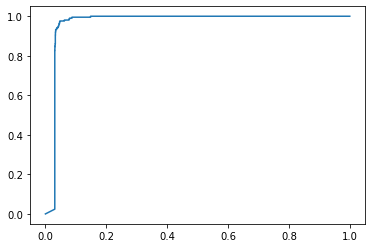

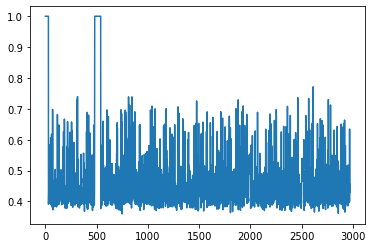

time used:18.662278652191162
TP: 2774 TN: 145 FP: 65 FN: 16
ACC: 0.973 Precision: 0.9771046143008102 Recall: 0.9942652329749104 F1: 0.9856102327233968
FPR: 0.30952380952380953 TPR: 0.9942652329749104
AUC: 0.9334963304318142


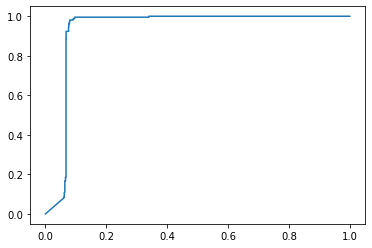

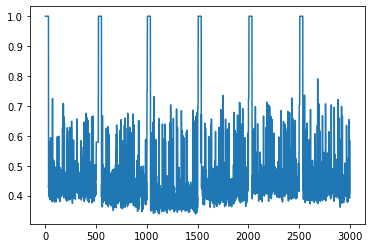

**********
window_size: 30
t: 20
phi: 27
thresh: 0.7
time used:12.053167343139648
TP: 2762 TN: 22 FP: 186 FN: 0
ACC: 0.9373737373737374 Precision: 0.9369063772048847 Recall: 1.0 F1: 0.9674255691768827
FPR: 0.8942307692307693 TPR: 1.0
AUC: 0.9672434620954715


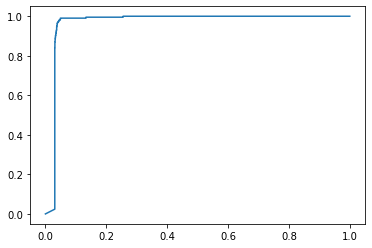

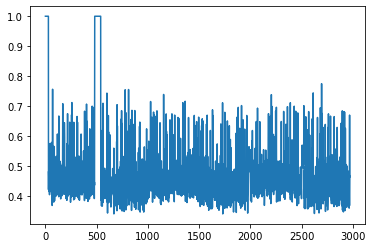

time used:18.6858389377594
TP: 2781 TN: 29 FP: 181 FN: 9
ACC: 0.9366666666666666 Precision: 0.9388926401080351 Recall: 0.9967741935483871 F1: 0.9669680111265647
FPR: 0.861904761904762 TPR: 0.9967741935483871
AUC: 0.9342549923195084


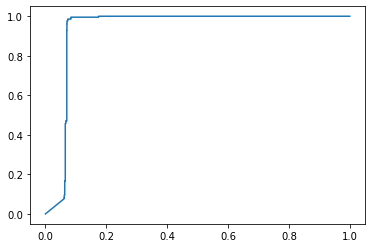

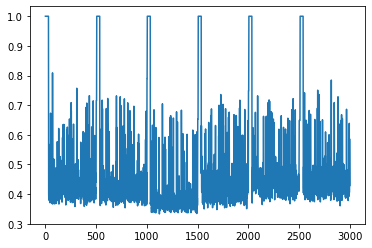

**********
window_size: 30
t: 50
phi: 3
thresh: 0.45
time used:12.05519151687622
TP: 2762 TN: 8 FP: 200 FN: 0
ACC: 0.9326599326599326 Precision: 0.9324780553679946 Recall: 1.0 F1: 0.9650593990216632
FPR: 0.9615384615384616 TPR: 1.0
AUC: 0.8832750793739208


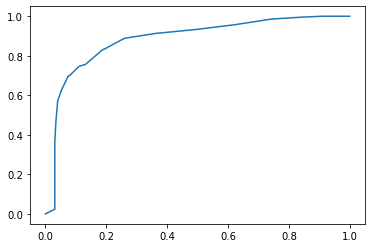

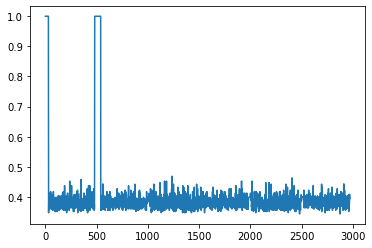

time used:21.813520193099976
TP: 2790 TN: 1 FP: 209 FN: 0
ACC: 0.9303333333333333 Precision: 0.9303101033677893 Recall: 1.0 F1: 0.9638970461219554
FPR: 0.9952380952380953 TPR: 1.0
AUC: 0.7585927632701825


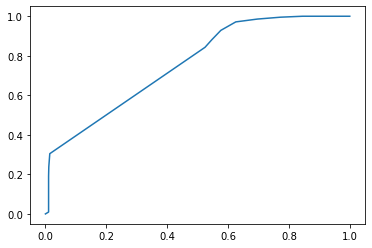

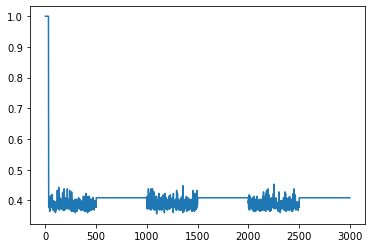

**********
window_size: 30
t: 50
phi: 3
thresh: 0.475
time used:11.999595642089844
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8366829359995545


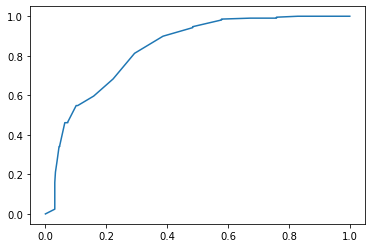

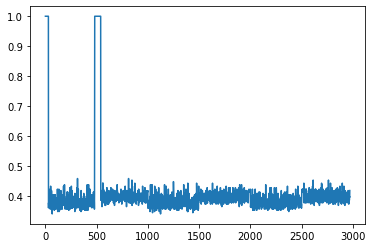

time used:21.68607807159424
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.6415011094043351


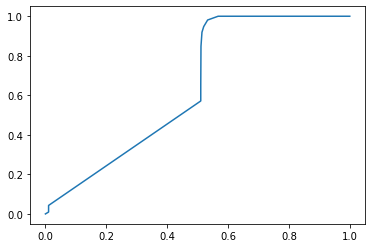

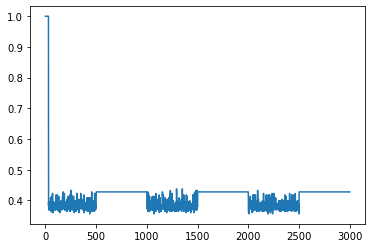

**********
window_size: 30
t: 50
phi: 3
thresh: 0.5
time used:12.093738317489624
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8469658622514343


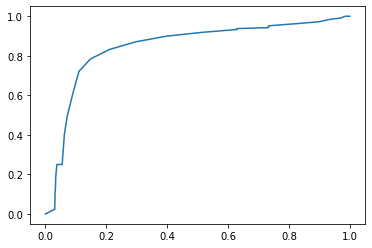

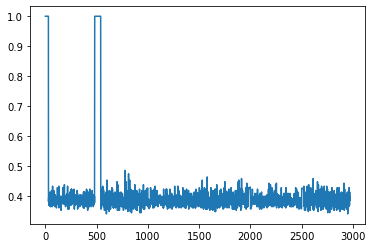

time used:21.792221307754517
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.6594290834613414


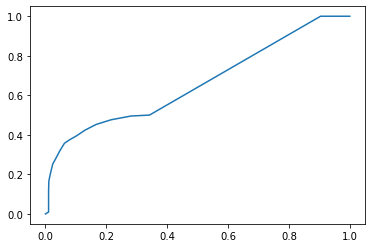

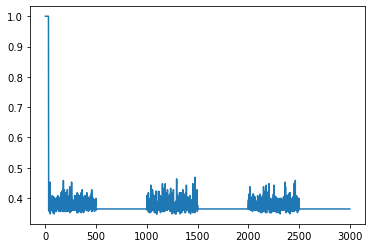

**********
window_size: 30
t: 50
phi: 3
thresh: 0.55
time used:11.89835810661316
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8875962582855232


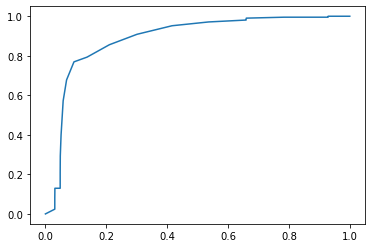

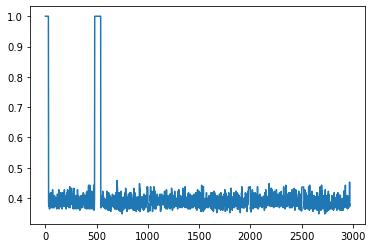

time used:21.77486538887024
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7900426693975082


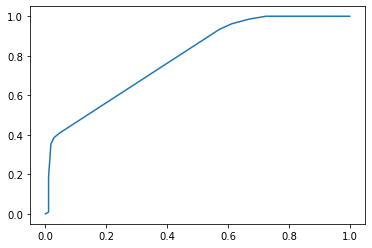

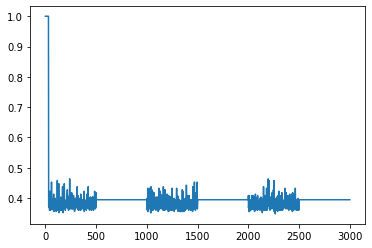

**********
window_size: 30
t: 50
phi: 3
thresh: 0.6
time used:11.941400289535522
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.834971000668412


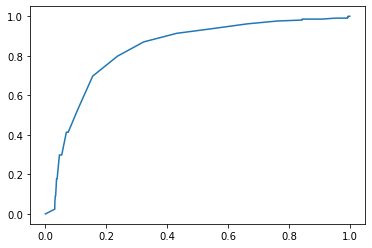

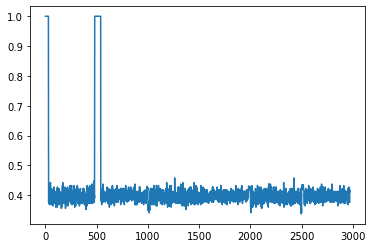

time used:21.752495765686035
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7910087045570917


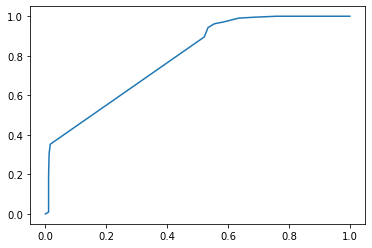

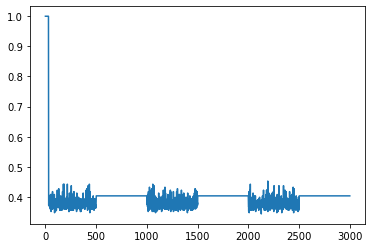

**********
window_size: 30
t: 50
phi: 3
thresh: 0.7
time used:11.86982274055481
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8834343494123544


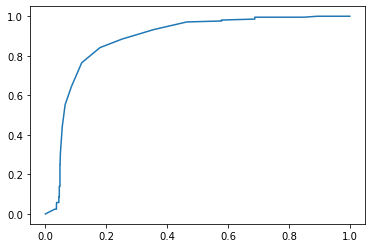

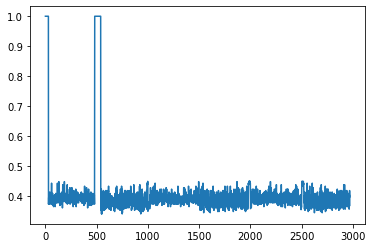

time used:21.628820657730103
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7836601809182454


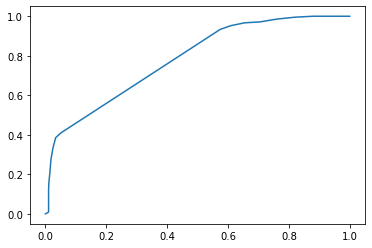

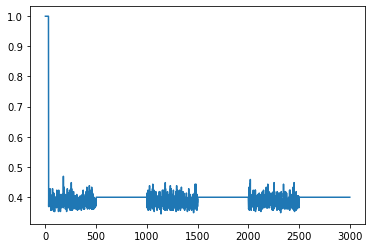

**********
window_size: 30
t: 50
phi: 7
thresh: 0.45
time used:12.354785919189453
TP: 105 TN: 203 FP: 5 FN: 2657
ACC: 0.1037037037037037 Precision: 0.9545454545454546 Recall: 0.03801593048515568 F1: 0.07311977715877437
FPR: 0.02403846153846154 TPR: 0.03801593048515568
AUC: 0.960627228039882


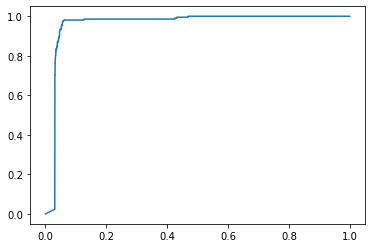

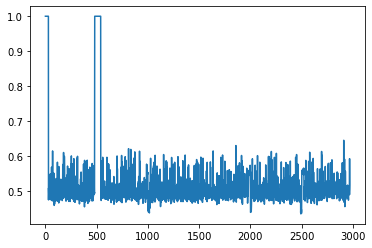

time used:22.694894552230835
TP: 40 TN: 208 FP: 2 FN: 2750
ACC: 0.08266666666666667 Precision: 0.9523809523809523 Recall: 0.014336917562724014 F1: 0.02824858757062147
FPR: 0.009523809523809525 TPR: 0.014336917562724014
AUC: 0.8527453490356716


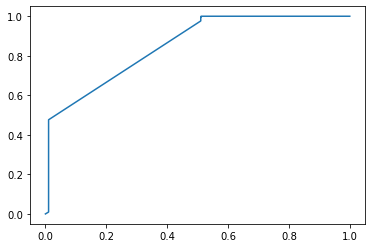

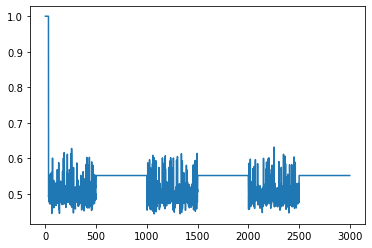

**********
window_size: 30
t: 50
phi: 7
thresh: 0.475
time used:12.36626648902893
TP: 668 TN: 203 FP: 5 FN: 2094
ACC: 0.2932659932659933 Precision: 0.9925705794947994 Recall: 0.24185372918175235 F1: 0.3889374090247453
FPR: 0.02403846153846154 TPR: 0.24185372918175235
AUC: 0.965580265136746


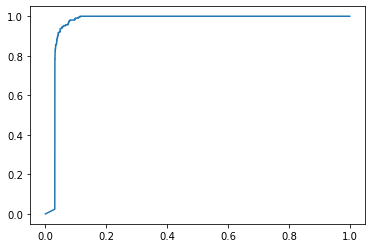

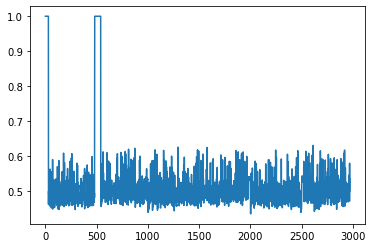

time used:16.98301863670349
TP: 574 TN: 198 FP: 12 FN: 2216
ACC: 0.25733333333333336 Precision: 0.9795221843003413 Recall: 0.2057347670250896 F1: 0.3400473933649289
FPR: 0.05714285714285714 TPR: 0.2057347670250896
AUC: 0.8142635261990101


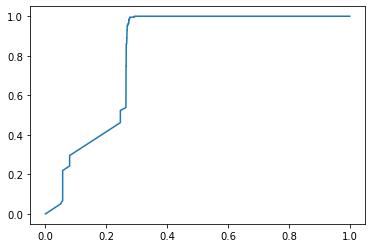

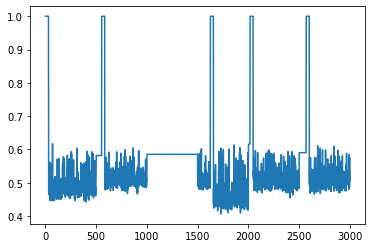

**********
window_size: 30
t: 50
phi: 7
thresh: 0.5
time used:12.241166830062866
TP: 1396 TN: 202 FP: 6 FN: 1366
ACC: 0.538047138047138 Precision: 0.9957203994293866 Recall: 0.5054308472121651 F1: 0.670509125840538
FPR: 0.028846153846153848 TPR: 0.5054308472121651
AUC: 0.9597412340555895


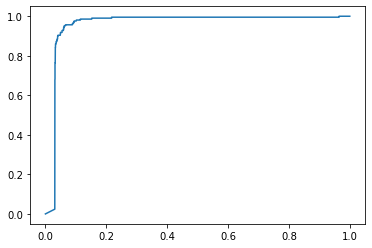

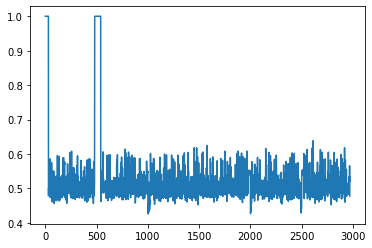

time used:16.637214422225952
TP: 1760 TN: 194 FP: 16 FN: 1030
ACC: 0.6513333333333333 Precision: 0.990990990990991 Recall: 0.6308243727598566 F1: 0.7709154621112572
FPR: 0.0761904761904762 TPR: 0.6308243727598566
AUC: 0.8920634920634922


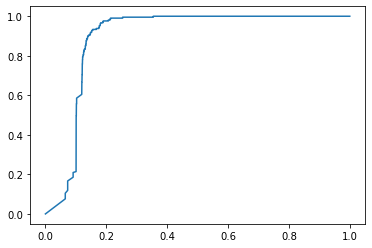

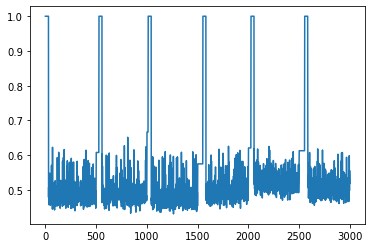

**********
window_size: 30
t: 50
phi: 7
thresh: 0.55
time used:12.19013261795044
TP: 2691 TN: 195 FP: 13 FN: 71
ACC: 0.9717171717171718 Precision: 0.9951923076923077 Recall: 0.9742939898624186 F1: 0.9846322722283205
FPR: 0.0625 TPR: 0.9742939898624186
AUC: 0.9561694076198963


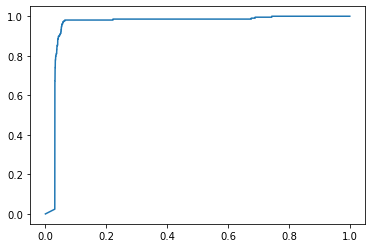

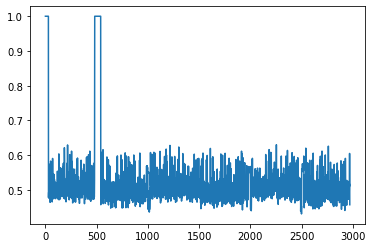

time used:21.24833059310913
TP: 2788 TN: 91 FP: 119 FN: 2
ACC: 0.9596666666666667 Precision: 0.9590643274853801 Recall: 0.9992831541218637 F1: 0.9787607512725996
FPR: 0.5666666666666667 TPR: 0.9992831541218637
AUC: 0.842336576207544


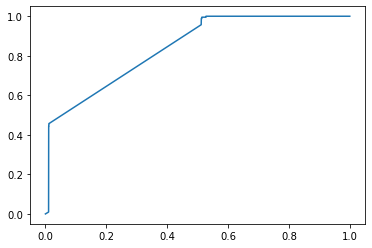

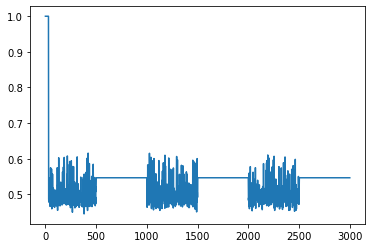

**********
window_size: 30
t: 50
phi: 7
thresh: 0.6
time used:11.238734245300293
TP: 2762 TN: 35 FP: 173 FN: 0
ACC: 0.9417508417508418 Precision: 0.9410562180579216 Recall: 1.0 F1: 0.969633140249254
FPR: 0.8317307692307693 TPR: 1.0
AUC: 0.9513991394195956


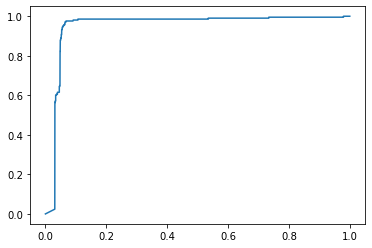

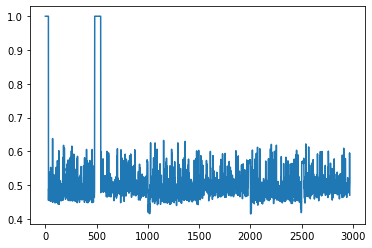

time used:15.750850677490234
TP: 2706 TN: 34 FP: 176 FN: 84
ACC: 0.9133333333333333 Precision: 0.9389312977099237 Recall: 0.9698924731182795 F1: 0.954160789844852
FPR: 0.8380952380952381 TPR: 0.9698924731182795
AUC: 0.8896356033452808


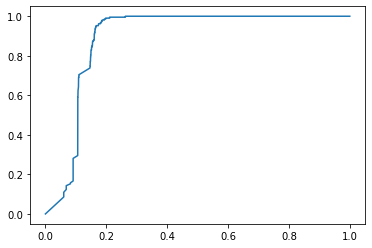

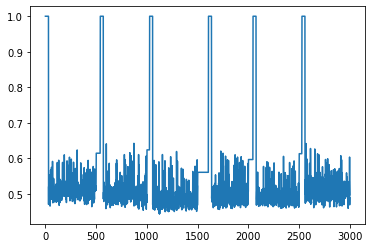

**********
window_size: 30
t: 50
phi: 7
thresh: 0.7
time used:11.212282180786133
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9518395254275052


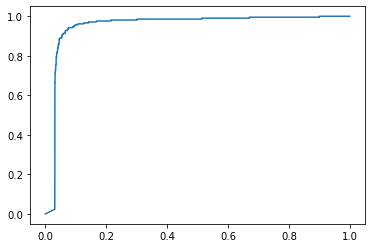

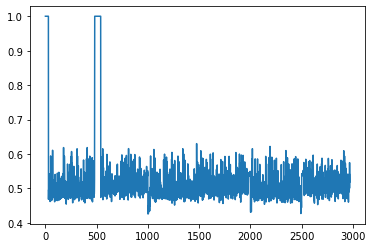

time used:18.941835165023804
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8645459976105138


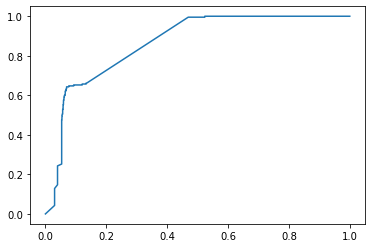

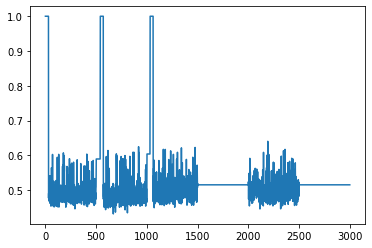

**********
window_size: 30
t: 50
phi: 15
thresh: 0.45
time used:11.338855266571045
TP: 956 TN: 203 FP: 5 FN: 1806
ACC: 0.3902356902356902 Precision: 0.9947970863683663 Recall: 0.3461259956553222 F1: 0.5135643298415257
FPR: 0.02403846153846154 TPR: 0.3461259956553222
AUC: 0.969139036651256


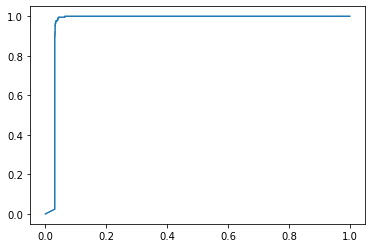

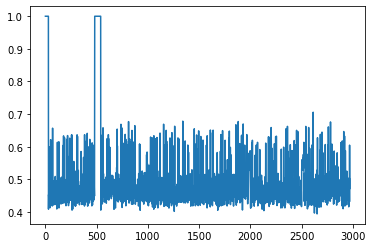

time used:17.470964431762695
TP: 1406 TN: 192 FP: 18 FN: 1384
ACC: 0.5326666666666666 Precision: 0.9873595505617978 Recall: 0.5039426523297491 F1: 0.6672994779307072
FPR: 0.08571428571428572 TPR: 0.5039426523297491
AUC: 0.929041645331968


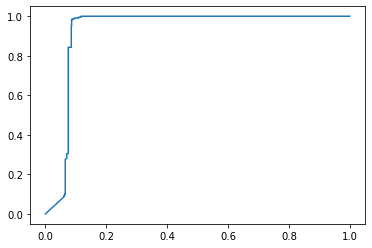

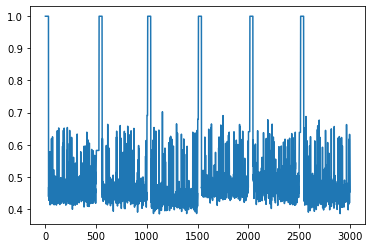

**********
window_size: 30
t: 50
phi: 15
thresh: 0.475
time used:11.257786750793457
TP: 1740 TN: 203 FP: 5 FN: 1022
ACC: 0.6542087542087542 Precision: 0.997134670487106 Recall: 0.6299782766111514 F1: 0.7721322387397382
FPR: 0.02403846153846154 TPR: 0.6299782766111514
AUC: 0.9673722706511447


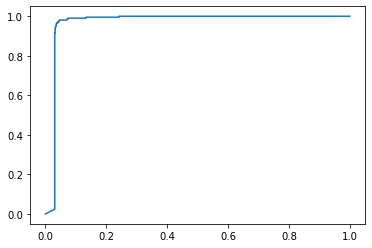

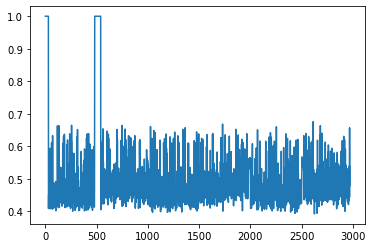

time used:16.63573408126831
TP: 1844 TN: 195 FP: 15 FN: 946
ACC: 0.6796666666666666 Precision: 0.9919311457772996 Recall: 0.6609318996415771 F1: 0.7932888793288878
FPR: 0.07142857142857142 TPR: 0.6609318996415771
AUC: 0.9262809353131934


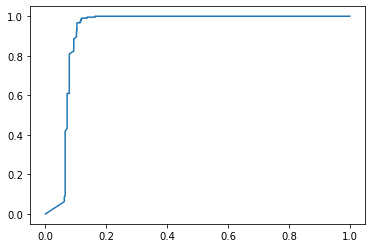

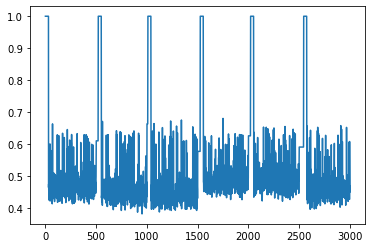

**********
window_size: 30
t: 50
phi: 15
thresh: 0.5
time used:11.221756219863892
TP: 2248 TN: 203 FP: 5 FN: 514
ACC: 0.8252525252525252 Precision: 0.9977807367953839 Recall: 0.8139029688631426 F1: 0.8965104685942173
FPR: 0.02403846153846154 TPR: 0.8139029688631426
AUC: 0.9686916880187155


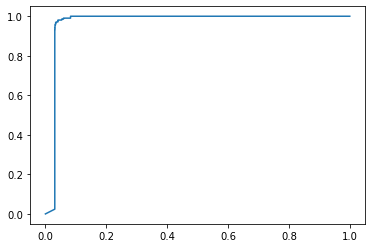

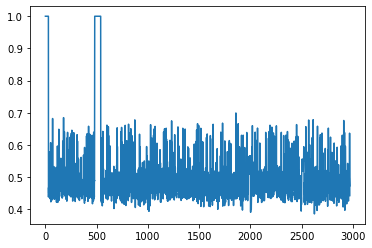

time used:17.553510189056396
TP: 2586 TN: 193 FP: 17 FN: 204
ACC: 0.9263333333333333 Precision: 0.993469074145217 Recall: 0.9268817204301075 F1: 0.9590209530873354
FPR: 0.08095238095238096 TPR: 0.9268817204301075
AUC: 0.9304676565966888


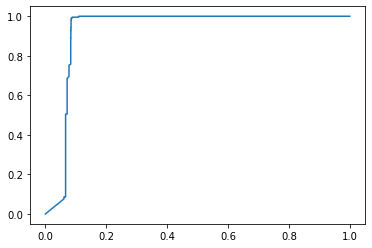

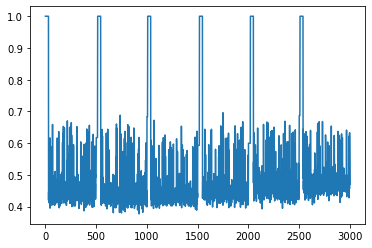

**********
window_size: 30
t: 50
phi: 15
thresh: 0.55
time used:11.281774282455444
TP: 2742 TN: 197 FP: 11 FN: 20
ACC: 0.9895622895622895 Precision: 0.9960043588812205 Recall: 0.9927588703837799 F1: 0.9943789664551224
FPR: 0.052884615384615384 TPR: 0.9927588703837799
AUC: 0.9682495613546482


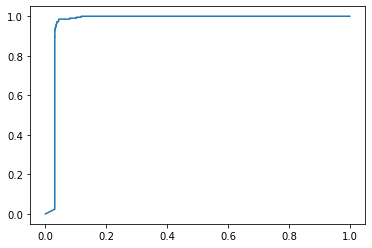

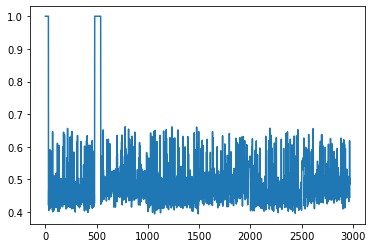

time used:17.33879780769348
TP: 2733 TN: 183 FP: 27 FN: 57
ACC: 0.972 Precision: 0.9902173913043478 Recall: 0.9795698924731183 F1: 0.9848648648648649
FPR: 0.12857142857142856 TPR: 0.9795698924731183
AUC: 0.9268458781362008


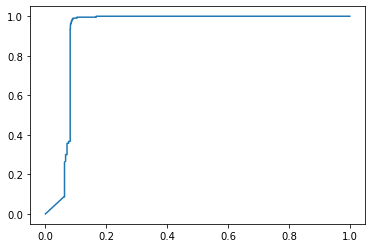

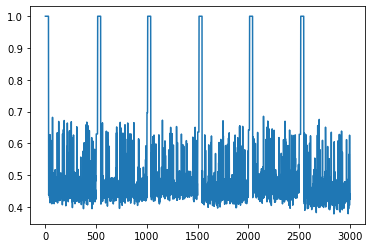

**********
window_size: 30
t: 50
phi: 15
thresh: 0.6
time used:11.289307117462158
TP: 2762 TN: 140 FP: 68 FN: 0
ACC: 0.9771043771043771 Precision: 0.9759717314487633 Recall: 1.0 F1: 0.9878397711015737
FPR: 0.3269230769230769 TPR: 1.0
AUC: 0.9676072592324403


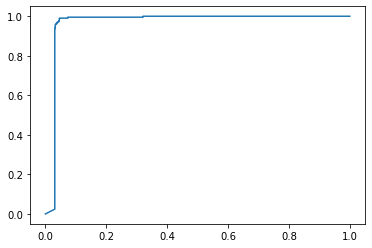

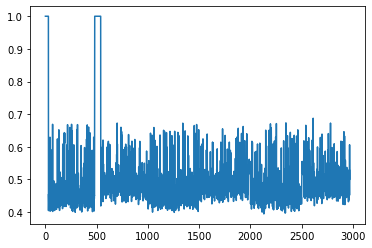

time used:17.874293565750122
TP: 2740 TN: 136 FP: 74 FN: 50
ACC: 0.9586666666666667 Precision: 0.9737029140014215 Recall: 0.982078853046595 F1: 0.9778729478943611
FPR: 0.3523809523809524 TPR: 0.982078853046595
AUC: 0.9279091995221027


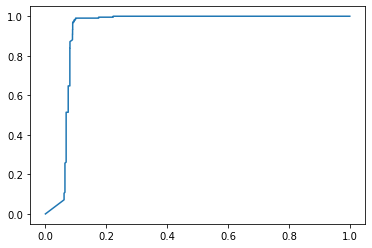

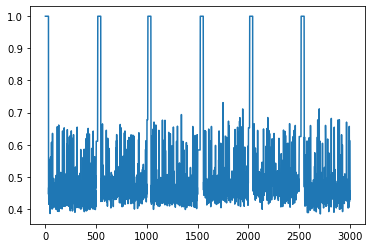

**********
window_size: 30
t: 50
phi: 15
thresh: 0.7
time used:12.665618658065796
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.969071151061104


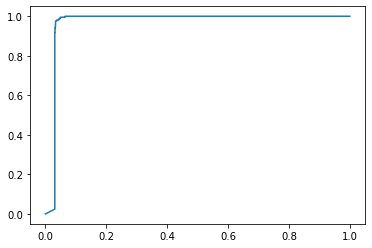

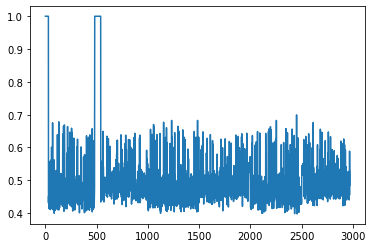

time used:17.556495904922485
TP: 2790 TN: 1 FP: 209 FN: 0
ACC: 0.9303333333333333 Precision: 0.9303101033677893 Recall: 1.0 F1: 0.9638970461219554
FPR: 0.9952380952380953 TPR: 1.0
AUC: 0.9290587130909711


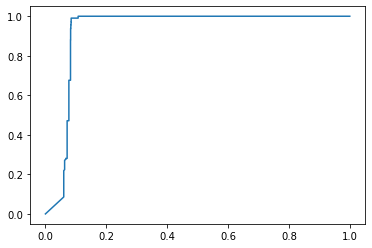

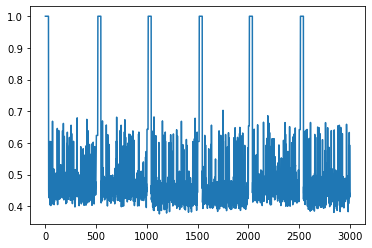

**********
window_size: 30
t: 50
phi: 22
thresh: 0.45
time used:12.694363832473755
TP: 1490 TN: 203 FP: 5 FN: 1272
ACC: 0.57003367003367 Precision: 0.9966555183946488 Recall: 0.5394641564083997 F1: 0.7000234907211652
FPR: 0.02403846153846154 TPR: 0.5394641564083997
AUC: 0.96916688714978


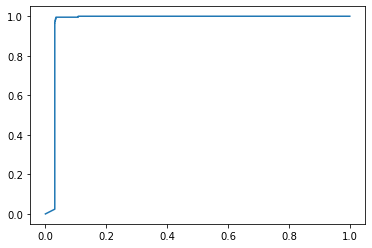

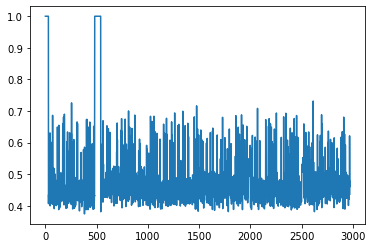

time used:19.51528811454773
TP: 1951 TN: 194 FP: 16 FN: 839
ACC: 0.715 Precision: 0.9918657854600915 Recall: 0.6992831541218638 F1: 0.8202648728190036
FPR: 0.0761904761904762 TPR: 0.6992831541218638
AUC: 0.9322614780679297


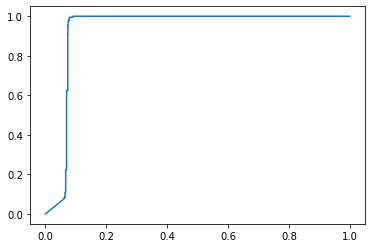

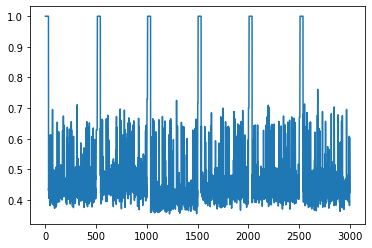

**********
window_size: 30
t: 50
phi: 22
thresh: 0.475
time used:13.036077499389648
TP: 1929 TN: 203 FP: 5 FN: 833
ACC: 0.7178451178451178 Precision: 0.9974146845915202 Recall: 0.6984069514844315 F1: 0.8215502555366269
FPR: 0.02403846153846154 TPR: 0.6984069514844315
AUC: 0.9692121442098813


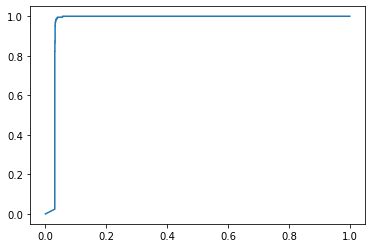

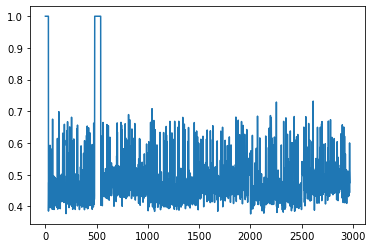

time used:19.35093855857849
TP: 2402 TN: 193 FP: 17 FN: 388
ACC: 0.865 Precision: 0.992972302604382 Recall: 0.860931899641577 F1: 0.9222499520061431
FPR: 0.08095238095238096 TPR: 0.860931899641577
AUC: 0.9314917221368834


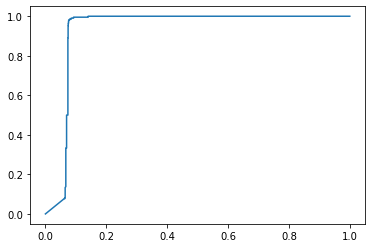

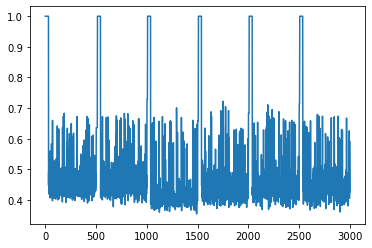

**********
window_size: 30
t: 50
phi: 22
thresh: 0.5
time used:12.610144138336182
TP: 2450 TN: 202 FP: 6 FN: 312
ACC: 0.8929292929292929 Precision: 0.997557003257329 Recall: 0.8870383779869659 F1: 0.939057110003833
FPR: 0.028846153846153848 TPR: 0.8870383779869659
AUC: 0.9683418161310087


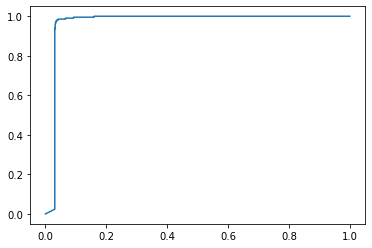

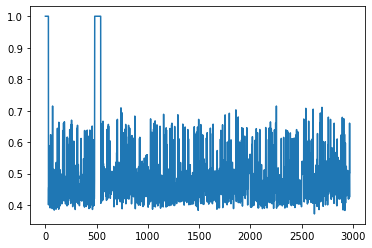

time used:19.3539776802063
TP: 2665 TN: 193 FP: 17 FN: 125
ACC: 0.9526666666666667 Precision: 0.993661446681581 Recall: 0.9551971326164874 F1: 0.9740497076023391
FPR: 0.08095238095238096 TPR: 0.9551971326164874
AUC: 0.9314268646526711


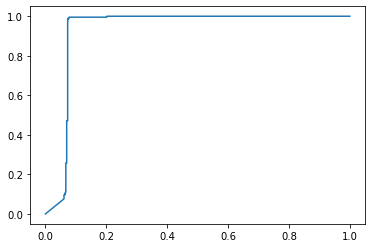

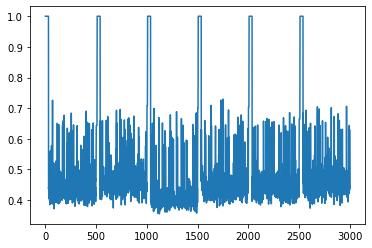

**********
window_size: 30
t: 50
phi: 22
thresh: 0.55
time used:12.44754147529602
TP: 2758 TN: 195 FP: 13 FN: 4
ACC: 0.9942760942760943 Precision: 0.9953085528690003 Recall: 0.998551774076756 F1: 0.9969275257545634
FPR: 0.0625 TPR: 0.998551774076756
AUC: 0.9690380785941068


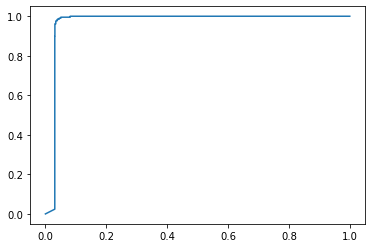

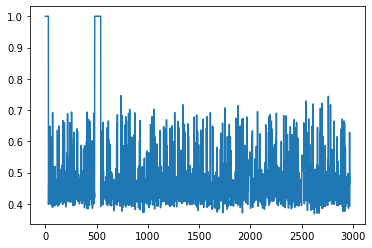

time used:19.26286268234253
TP: 2759 TN: 187 FP: 23 FN: 31
ACC: 0.982 Precision: 0.9917325664989216 Recall: 0.9888888888888889 F1: 0.9903086862885858
FPR: 0.10952380952380952 TPR: 0.9888888888888889
AUC: 0.9334374466632531


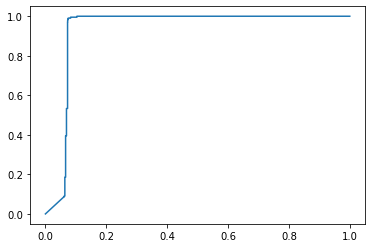

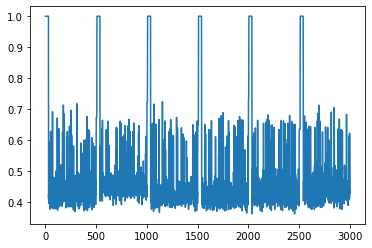

**********
window_size: 30
t: 50
phi: 22
thresh: 0.6
time used:12.758733987808228
TP: 2762 TN: 165 FP: 43 FN: 0
ACC: 0.9855218855218856 Precision: 0.9846702317290552 Recall: 1.0 F1: 0.9922759116220585
FPR: 0.20673076923076922 TPR: 1.0
AUC: 0.9695341655990642


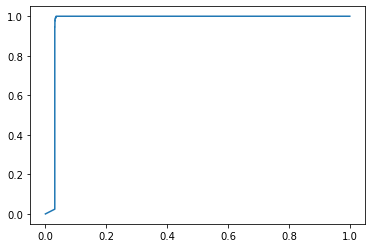

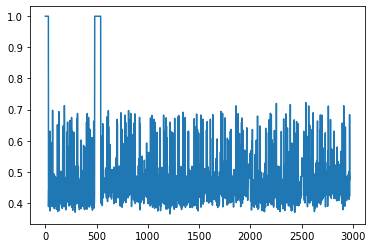

time used:19.37657356262207
TP: 2763 TN: 161 FP: 49 FN: 27
ACC: 0.9746666666666667 Precision: 0.982574679943101 Recall: 0.9903225806451613 F1: 0.9864334166369154
FPR: 0.23333333333333334 TPR: 0.9903225806451613
AUC: 0.9315019627922854


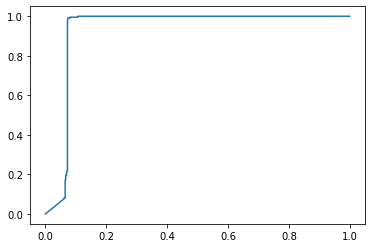

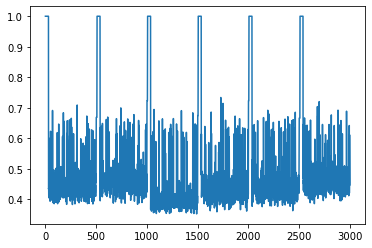

**********
window_size: 30
t: 50
phi: 22
thresh: 0.7
time used:12.798366069793701
TP: 2762 TN: 3 FP: 205 FN: 0
ACC: 0.930976430976431 Precision: 0.9309066397034041 Recall: 1.0 F1: 0.9642171408622796
FPR: 0.9855769230769231 TPR: 1.0
AUC: 0.9681120495181865


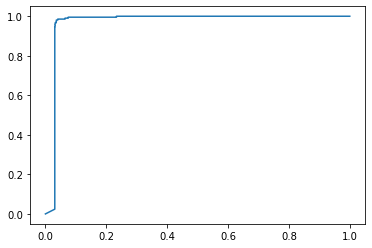

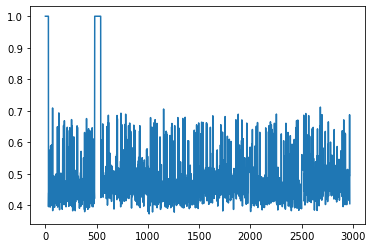

time used:19.51523208618164
TP: 2787 TN: 11 FP: 199 FN: 3
ACC: 0.9326666666666666 Precision: 0.9333556597454788 Recall: 0.9989247311827957 F1: 0.9650277008310247
FPR: 0.9476190476190476 TPR: 0.9989247311827957
AUC: 0.9312263184843831


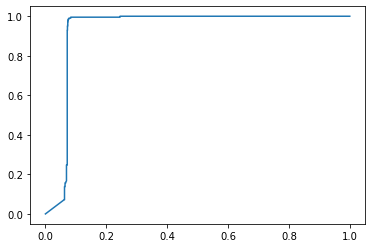

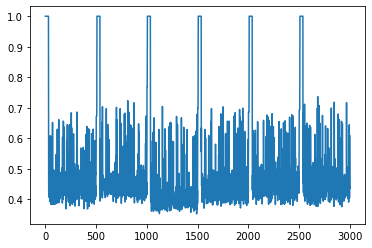

**********
window_size: 30
t: 50
phi: 27
thresh: 0.45
time used:12.912379741668701
TP: 1989 TN: 203 FP: 5 FN: 773
ACC: 0.7380471380471381 Precision: 0.9974924774322969 Recall: 0.720130340333092 F1: 0.8364171572750211
FPR: 0.02403846153846154 TPR: 0.720130340333092
AUC: 0.9694558360719657


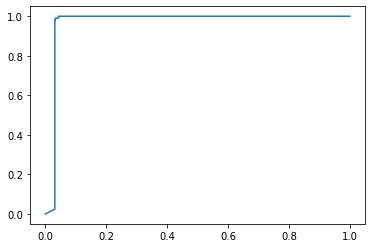

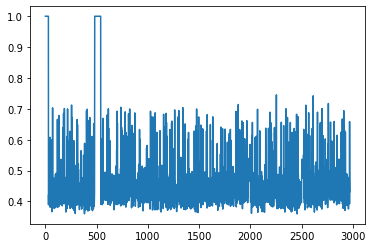

time used:19.385061025619507
TP: 2314 TN: 193 FP: 17 FN: 476
ACC: 0.8356666666666667 Precision: 0.9927069927069927 Recall: 0.8293906810035843 F1: 0.9037297402851006
FPR: 0.08095238095238096 TPR: 0.8293906810035843
AUC: 0.9345084485407066


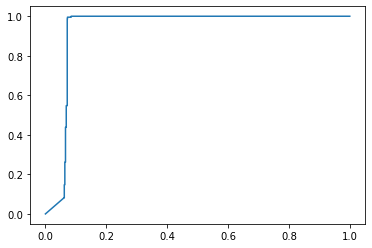

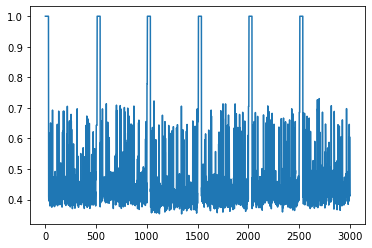

**********
window_size: 30
t: 50
phi: 27
thresh: 0.475
time used:12.566137313842773
TP: 2422 TN: 203 FP: 5 FN: 340
ACC: 0.8838383838383839 Precision: 0.9979398434281005 Recall: 0.8769007965242578 F1: 0.9335132010021199
FPR: 0.02403846153846154 TPR: 0.8769007965242578
AUC: 0.9695132777251713


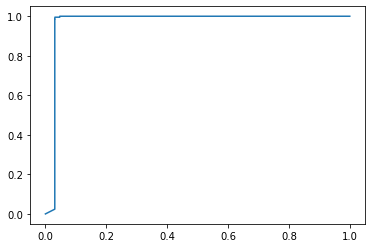

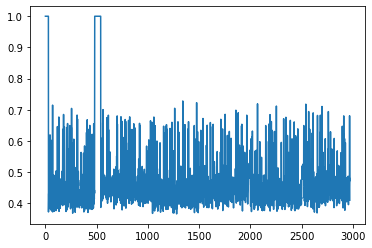

time used:18.415568828582764
TP: 2566 TN: 194 FP: 16 FN: 224
ACC: 0.92 Precision: 0.9938032532920217 Recall: 0.9197132616487456 F1: 0.9553239017125837
FPR: 0.0761904761904762 TPR: 0.9197132616487456
AUC: 0.9337327188940092


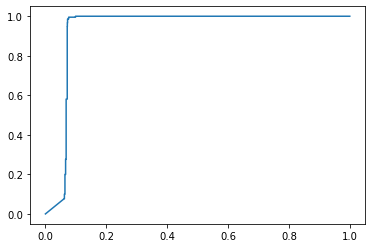

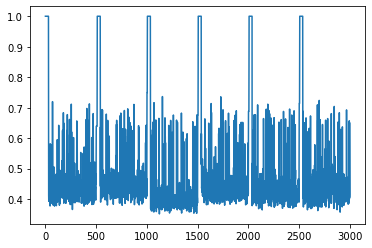

**********
window_size: 30
t: 50
phi: 27
thresh: 0.5
time used:12.957980632781982
TP: 2636 TN: 203 FP: 5 FN: 126
ACC: 0.9558922558922559 Precision: 0.9981067777357062 Recall: 0.9543808834178131 F1: 0.9757542106237276
FPR: 0.02403846153846154 TPR: 0.9543808834178131
AUC: 0.9694123196680221


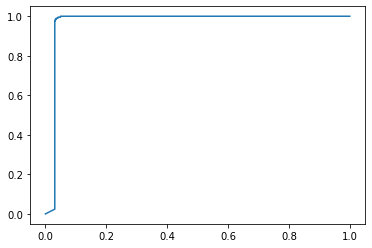

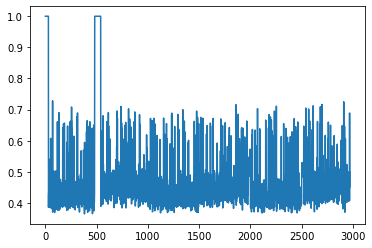

time used:19.56671118736267
TP: 2713 TN: 194 FP: 16 FN: 77
ACC: 0.969 Precision: 0.9941370465371931 Recall: 0.9724014336917562 F1: 0.9831491212176119
FPR: 0.0761904761904762 TPR: 0.9724014336917562
AUC: 0.9335620413039768


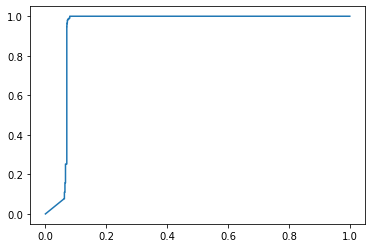

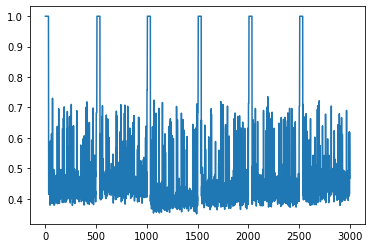

**********
window_size: 30
t: 50
phi: 27
thresh: 0.55
time used:12.53022837638855
TP: 2756 TN: 201 FP: 7 FN: 6
ACC: 0.9956228956228956 Precision: 0.9974665218964893 Recall: 0.997827661115134 F1: 0.9976470588235294
FPR: 0.03365384615384615 TPR: 0.997827661115134
AUC: 0.9694366888542305


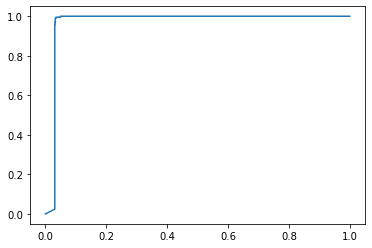

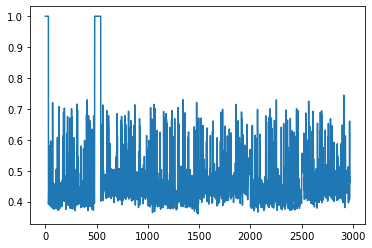

time used:19.183822631835938
TP: 2768 TN: 190 FP: 20 FN: 22
ACC: 0.986 Precision: 0.9928263988522238 Recall: 0.9921146953405018 F1: 0.9924704195051989
FPR: 0.09523809523809523 TPR: 0.9921146953405018
AUC: 0.9335739887352791


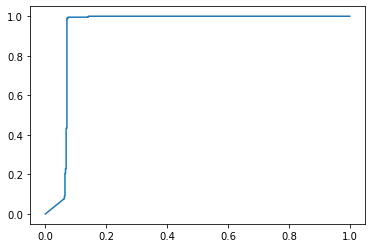

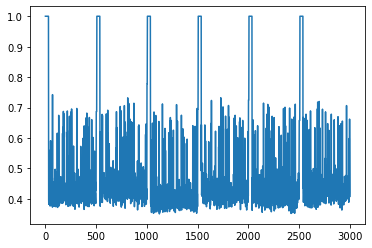

**********
window_size: 30
t: 50
phi: 27
thresh: 0.6
time used:12.539532661437988
TP: 2762 TN: 142 FP: 66 FN: 0
ACC: 0.9777777777777777 Precision: 0.9766619519094767 Recall: 1.0 F1: 0.9881932021466906
FPR: 0.3173076923076923 TPR: 1.0
AUC: 0.9688396437921238


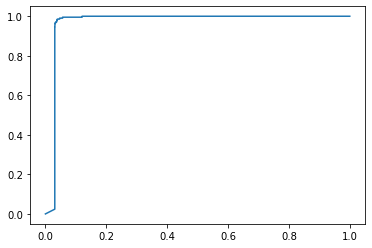

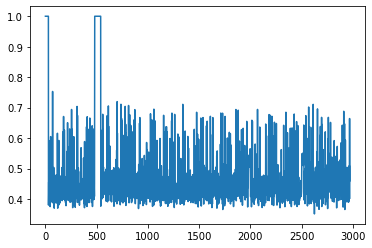

time used:19.09175205230713
TP: 2759 TN: 158 FP: 52 FN: 31
ACC: 0.9723333333333334 Precision: 0.9815012451085023 Recall: 0.9888888888888889 F1: 0.9851812176397072
FPR: 0.24761904761904763 TPR: 0.9888888888888889
AUC: 0.9341909882232463


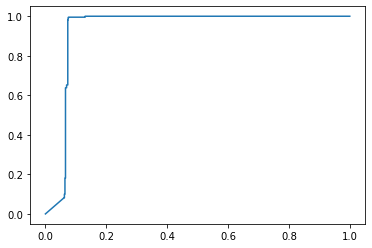

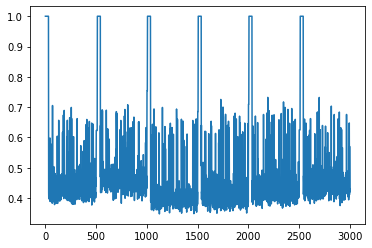

**********
window_size: 30
t: 50
phi: 27
thresh: 0.7
time used:12.366905927658081
TP: 2762 TN: 19 FP: 189 FN: 0
ACC: 0.9363636363636364 Precision: 0.9359539139274822 Recall: 1.0 F1: 0.9669175564502013
FPR: 0.9086538461538461 TPR: 1.0
AUC: 0.9692730671754024


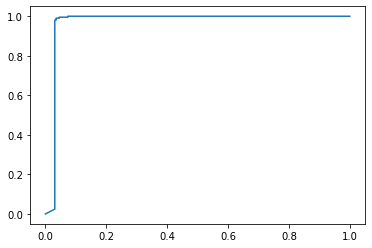

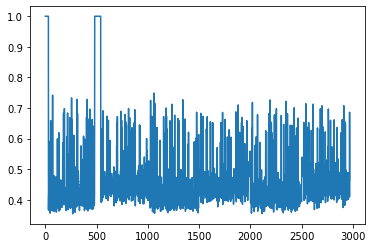

time used:18.823920011520386
TP: 2783 TN: 16 FP: 194 FN: 7
ACC: 0.933 Precision: 0.9348337252267384 Recall: 0.9974910394265233 F1: 0.9651465233223513
FPR: 0.9238095238095239 TPR: 0.9974910394265233
AUC: 0.9324355692097628


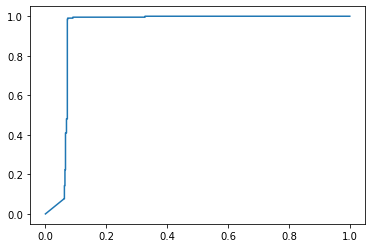

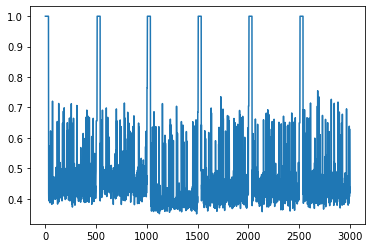

**********
window_size: 30
t: 75
phi: 3
thresh: 0.45
time used:12.353828191757202
TP: 2762 TN: 4 FP: 204 FN: 0
ACC: 0.9313131313131313 Precision: 0.9312204989885368 Recall: 1.0 F1: 0.9643854748603351
FPR: 0.9807692307692307 TPR: 1.0
AUC: 0.9154371832005793


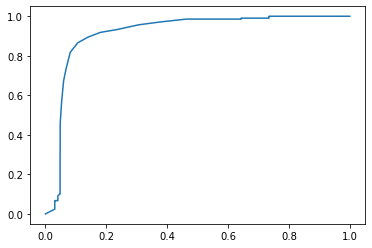

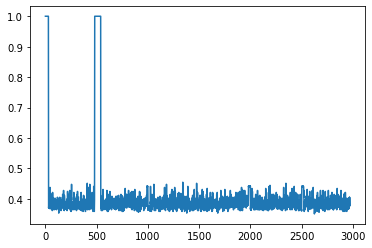

time used:21.785353899002075
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.6389477726574501


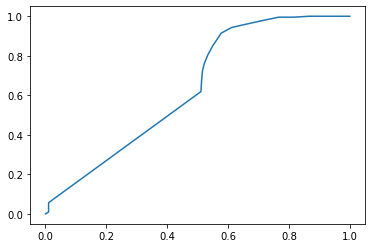

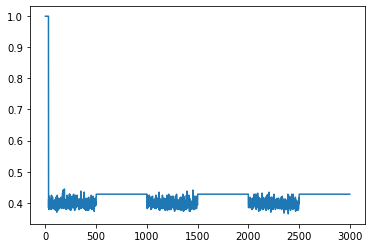

**********
window_size: 30
t: 75
phi: 3
thresh: 0.475
time used:12.208627223968506
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9225564668857573


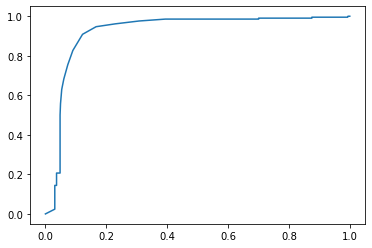

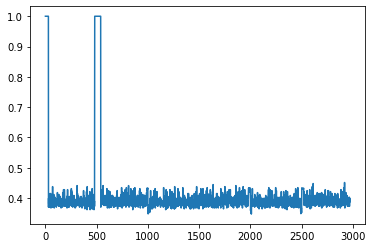

time used:21.606872081756592
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.834021164021164


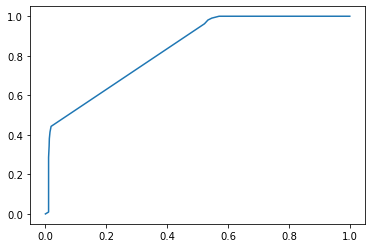

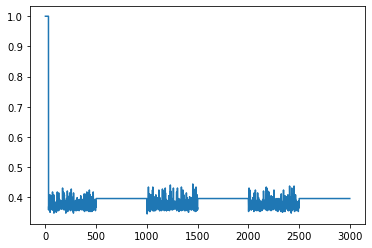

**********
window_size: 30
t: 75
phi: 3
thresh: 0.5
time used:11.073887586593628
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8973978931097866


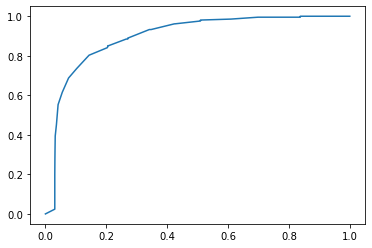

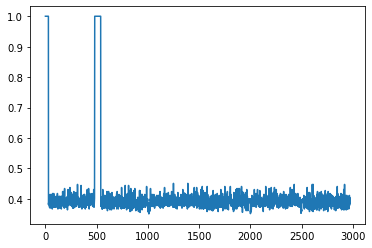

time used:20.90557360649109
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7108602150537634


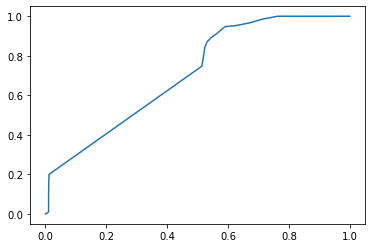

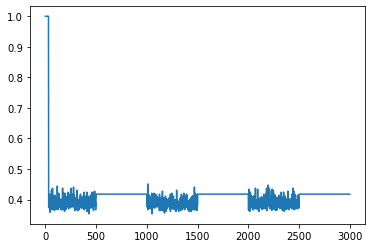

**********
window_size: 30
t: 75
phi: 3
thresh: 0.55
time used:12.339248657226562
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.901864416810561


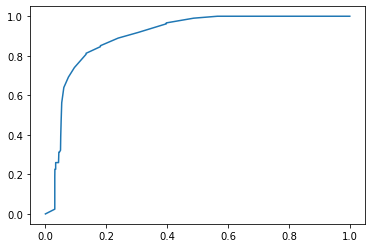

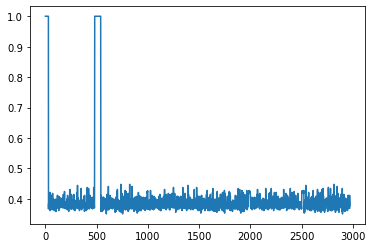

time used:22.222160816192627
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7673451100870455


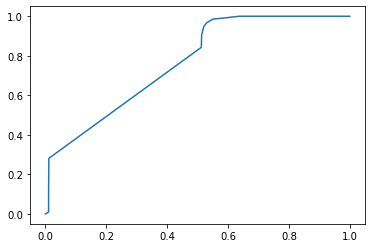

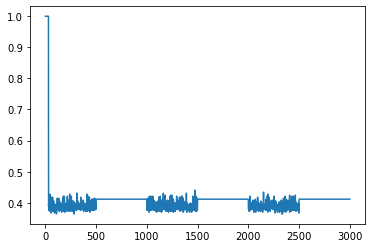

**********
window_size: 30
t: 75
phi: 3
thresh: 0.6
time used:12.410104513168335
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9191334665515513


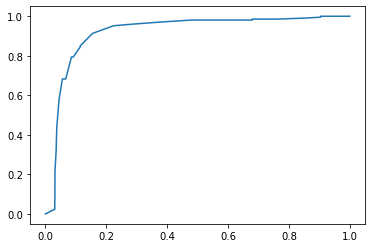

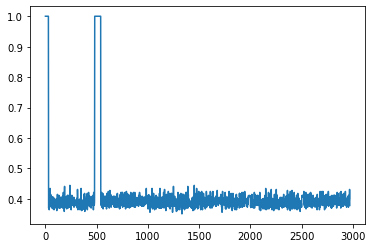

time used:22.190609216690063
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.6766726403823179


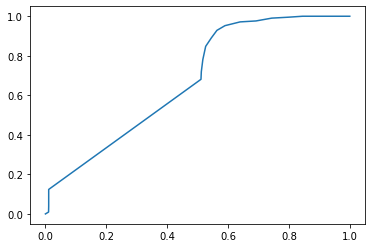

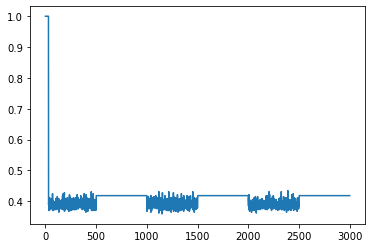

**********
window_size: 30
t: 75
phi: 3
thresh: 0.7
time used:12.362372636795044
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9231639558848104


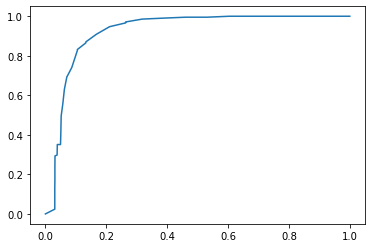

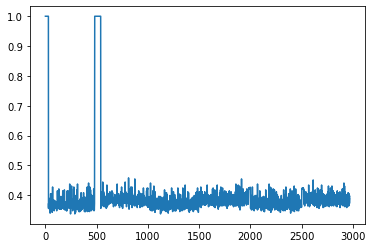

time used:21.675150632858276
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7132727427888719


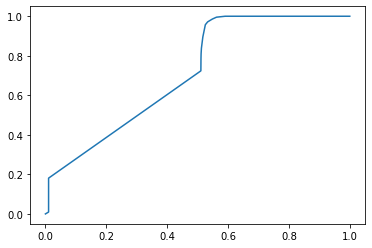

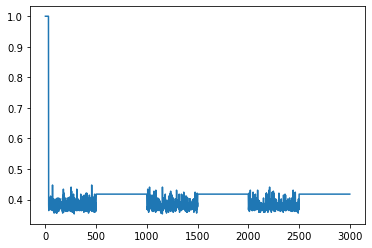

**********
window_size: 30
t: 75
phi: 7
thresh: 0.45
time used:10.937970876693726
TP: 108 TN: 203 FP: 5 FN: 2654
ACC: 0.10471380471380472 Precision: 0.9557522123893806 Recall: 0.0391020999275887 F1: 0.07513043478260868
FPR: 0.02403846153846154 TPR: 0.0391020999275887
AUC: 0.9597803988191389


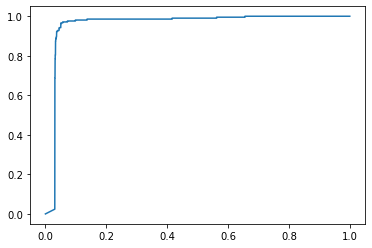

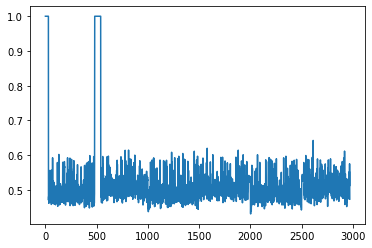

time used:19.24852967262268
TP: 75 TN: 207 FP: 3 FN: 2715
ACC: 0.094 Precision: 0.9615384615384616 Recall: 0.026881720430107527 F1: 0.05230125523012553
FPR: 0.014285714285714285 TPR: 0.026881720430107527
AUC: 0.7728622631848439


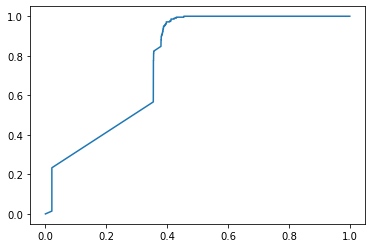

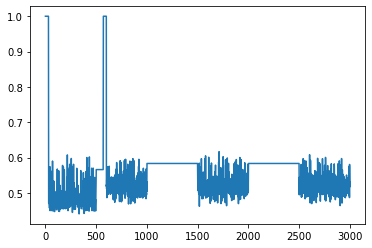

**********
window_size: 30
t: 75
phi: 7
thresh: 0.475
time used:10.987027406692505
TP: 539 TN: 203 FP: 5 FN: 2223
ACC: 0.24983164983164982 Precision: 0.9908088235294118 Recall: 0.1951484431571325 F1: 0.3260738052026618
FPR: 0.02403846153846154 TPR: 0.1951484431571325
AUC: 0.9585836977106891


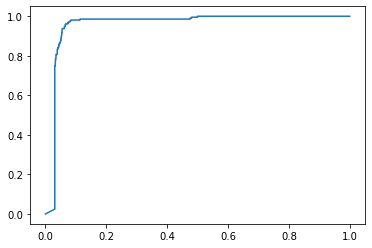

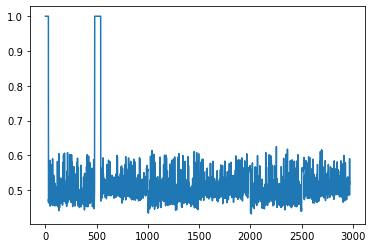

time used:20.99588370323181
TP: 134 TN: 208 FP: 2 FN: 2656
ACC: 0.114 Precision: 0.9852941176470589 Recall: 0.04802867383512545 F1: 0.09159261790840738
FPR: 0.009523809523809525 TPR: 0.04802867383512545
AUC: 0.8517630995050349


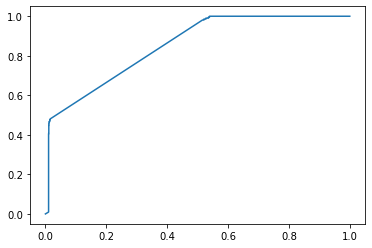

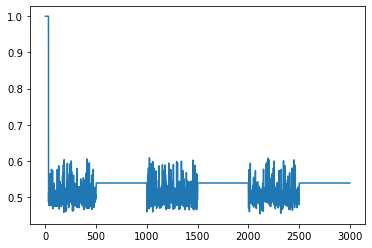

**********
window_size: 30
t: 75
phi: 7
thresh: 0.5
time used:11.30630898475647
TP: 1401 TN: 200 FP: 8 FN: 1361
ACC: 0.539057239057239 Precision: 0.9943222143364088 Recall: 0.5072411296162201 F1: 0.6717813473987053
FPR: 0.038461538461538464 TPR: 0.5072411296162201
AUC: 0.9575688951707235


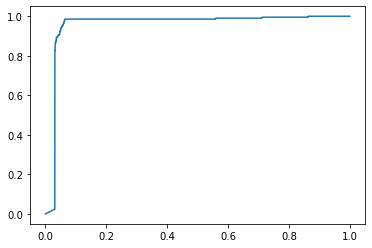

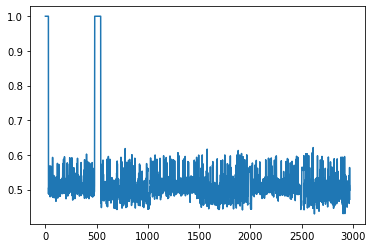

time used:15.00619101524353
TP: 1931 TN: 197 FP: 13 FN: 859
ACC: 0.7093333333333334 Precision: 0.9933127572016461 Recall: 0.6921146953405017 F1: 0.8158005914659907
FPR: 0.06190476190476191 TPR: 0.6921146953405017
AUC: 0.8901075268817205


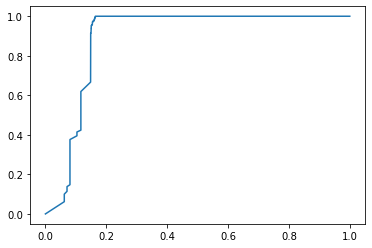

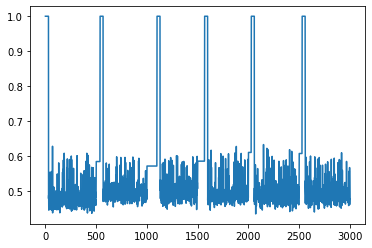

**********
window_size: 30
t: 75
phi: 7
thresh: 0.55
time used:11.289315223693848
TP: 2709 TN: 191 FP: 17 FN: 53
ACC: 0.9764309764309764 Precision: 0.9937637564196625 Recall: 0.9808110065170167 F1: 0.9872448979591837
FPR: 0.08173076923076923 TPR: 0.9808110065170167
AUC: 0.9561267615440316


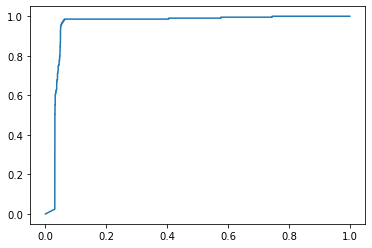

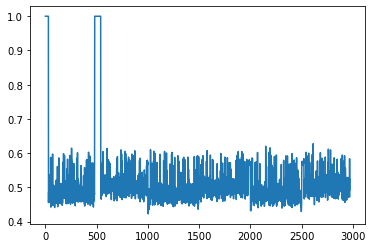

time used:18.466333627700806
TP: 1748 TN: 177 FP: 33 FN: 1042
ACC: 0.6416666666666667 Precision: 0.9814710836608647 Recall: 0.6265232974910394 F1: 0.7648217020345658
FPR: 0.15714285714285714 TPR: 0.6265232974910394
AUC: 0.819152585765489


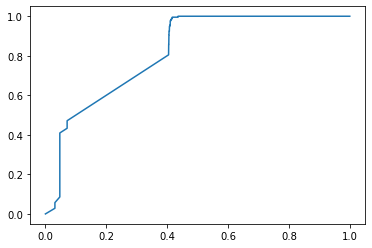

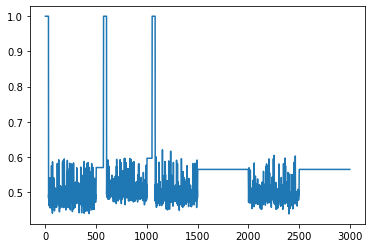

**********
window_size: 30
t: 75
phi: 7
thresh: 0.6
time used:11.3563711643219
TP: 2762 TN: 15 FP: 193 FN: 0
ACC: 0.935016835016835 Precision: 0.9346869712351946 Recall: 1.0 F1: 0.9662410355081337
FPR: 0.9278846153846154 TPR: 1.0
AUC: 0.94570632345569


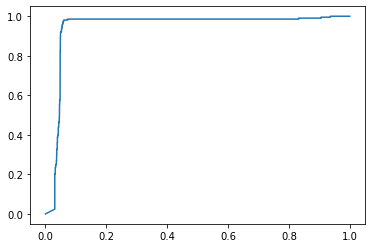

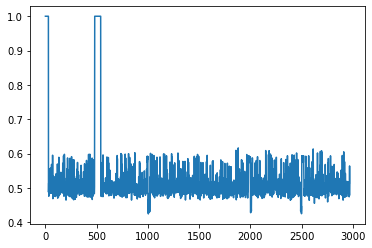

time used:21.240397214889526
TP: 2790 TN: 8 FP: 202 FN: 0
ACC: 0.9326666666666666 Precision: 0.9324866310160428 Recall: 1.0 F1: 0.9650639916983742
FPR: 0.9619047619047619 TPR: 1.0
AUC: 0.8228375149342891


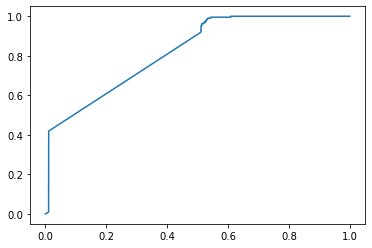

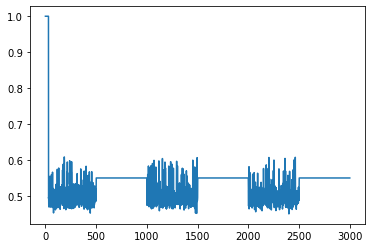

**********
window_size: 30
t: 75
phi: 7
thresh: 0.7
time used:11.424437046051025
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9577116289756586


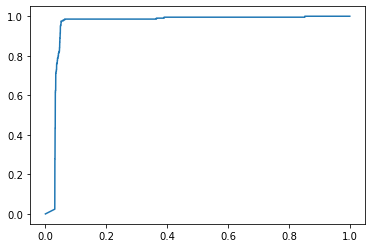

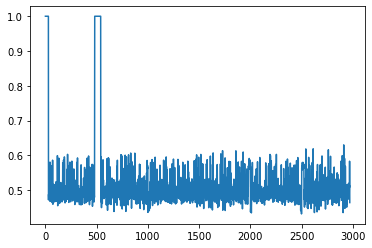

time used:21.379997491836548
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8305657962109575


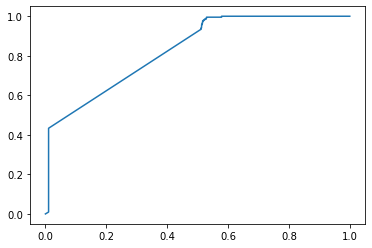

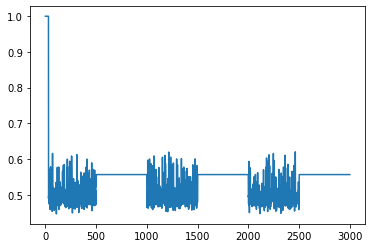

**********
window_size: 30
t: 75
phi: 15
thresh: 0.45
time used:12.657557010650635
TP: 837 TN: 203 FP: 5 FN: 1925
ACC: 0.3501683501683502 Precision: 0.994061757719715 Recall: 0.30304127443881246 F1: 0.4644839067702553
FPR: 0.02403846153846154 TPR: 0.30304127443881246
AUC: 0.9680876803319779


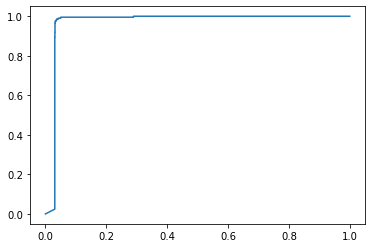

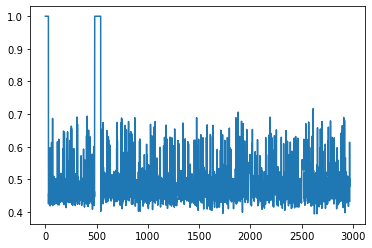

time used:18.46604824066162
TP: 1537 TN: 191 FP: 19 FN: 1253
ACC: 0.576 Precision: 0.9877892030848329 Recall: 0.5508960573476702 F1: 0.7073170731707317
FPR: 0.09047619047619047 TPR: 0.5508960573476702
AUC: 0.9295698924731183


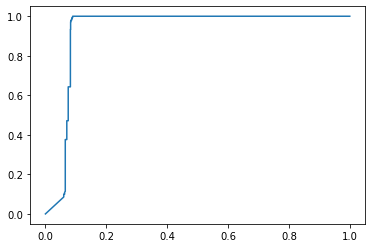

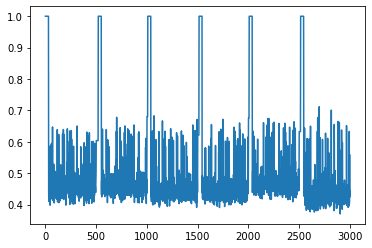

**********
window_size: 30
t: 75
phi: 15
thresh: 0.475
time used:12.913402080535889
TP: 1679 TN: 203 FP: 5 FN: 1083
ACC: 0.6336700336700337 Precision: 0.9970308788598575 Recall: 0.6078928312816799 F1: 0.7552856500224921
FPR: 0.02403846153846154 TPR: 0.6078928312816799
AUC: 0.9690833356542082


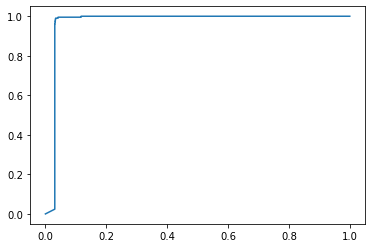

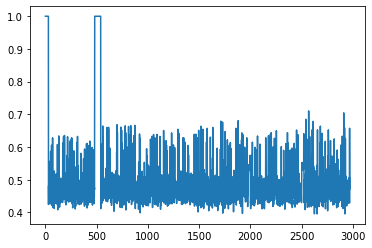

time used:19.04268741607666
TP: 2100 TN: 192 FP: 18 FN: 690
ACC: 0.764 Precision: 0.9915014164305949 Recall: 0.7526881720430108 F1: 0.8557457212713936
FPR: 0.08571428571428572 TPR: 0.7526881720430108
AUC: 0.9282394606588156


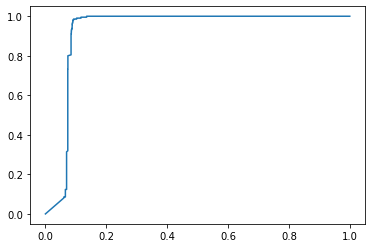

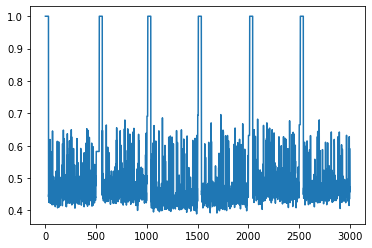

**********
window_size: 30
t: 75
phi: 15
thresh: 0.5
time used:12.724200248718262
TP: 2477 TN: 202 FP: 6 FN: 285
ACC: 0.902020202020202 Precision: 0.9975835682641966 Recall: 0.8968139029688631 F1: 0.9445185891325071
FPR: 0.028846153846153848 TPR: 0.8968139029688631
AUC: 0.9671877610984236


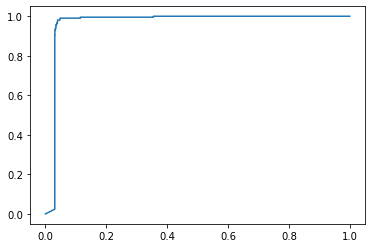

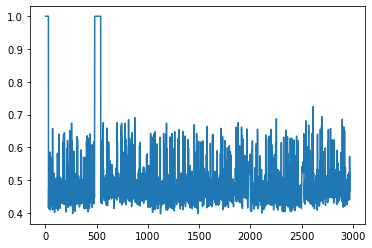

time used:19.609532594680786
TP: 2438 TN: 193 FP: 17 FN: 352
ACC: 0.877 Precision: 0.9930753564154786 Recall: 0.8738351254480287 F1: 0.9296472831267875
FPR: 0.08095238095238096 TPR: 0.8738351254480287
AUC: 0.9260018774534903


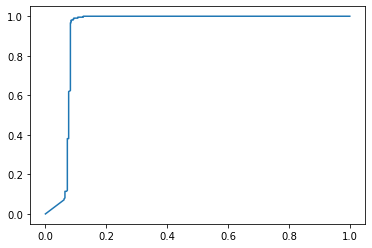

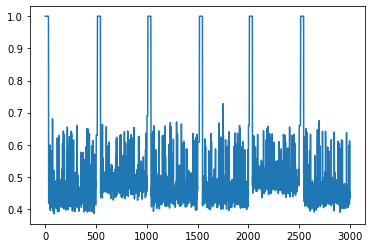

**********
window_size: 30
t: 75
phi: 15
thresh: 0.55
time used:12.866538047790527
TP: 2758 TN: 198 FP: 10 FN: 4
ACC: 0.9952861952861953 Precision: 0.9963872832369942 Recall: 0.998551774076756 F1: 0.9974683544303797
FPR: 0.04807692307692308 TPR: 0.998551774076756
AUC: 0.9689910808778477


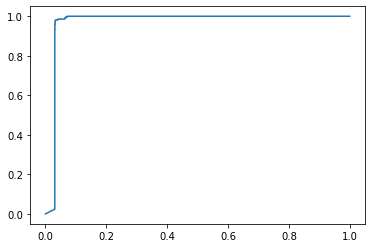

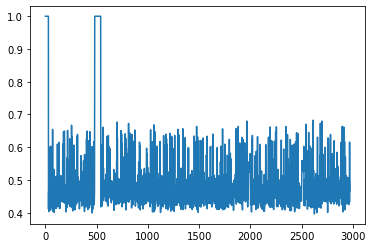

time used:19.077741146087646
TP: 2735 TN: 188 FP: 22 FN: 55
ACC: 0.9743333333333334 Precision: 0.9920203119332608 Recall: 0.9802867383512545 F1: 0.9861186226789255
FPR: 0.10476190476190476 TPR: 0.9802867383512545
AUC: 0.92747397166752


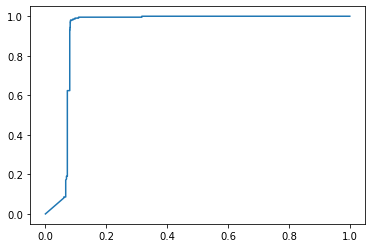

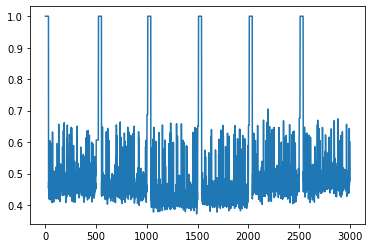

**********
window_size: 30
t: 75
phi: 15
thresh: 0.6
time used:12.458466053009033
TP: 2762 TN: 139 FP: 69 FN: 0
ACC: 0.9767676767676767 Precision: 0.9756269869304133 Recall: 1.0 F1: 0.9876631503665296
FPR: 0.3317307692307692 TPR: 1.0
AUC: 0.9667943728067733


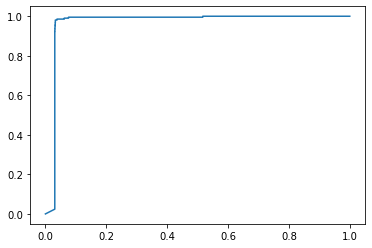

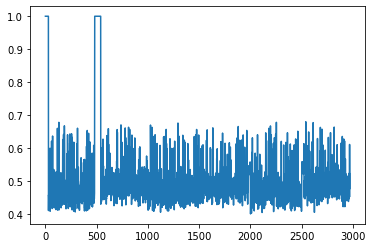

time used:18.77920961380005
TP: 2736 TN: 129 FP: 81 FN: 54
ACC: 0.955 Precision: 0.9712460063897763 Recall: 0.9806451612903225 F1: 0.9759229534510432
FPR: 0.38571428571428573 TPR: 0.9806451612903225
AUC: 0.9281984980372077


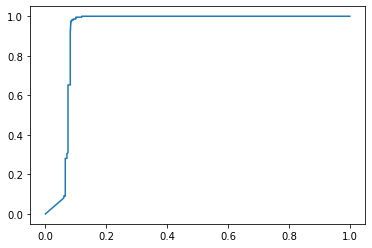

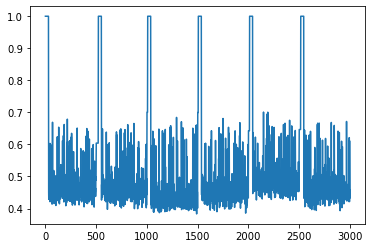

**********
window_size: 30
t: 75
phi: 15
thresh: 0.7
time used:12.668363332748413
TP: 2762 TN: 1 FP: 207 FN: 0
ACC: 0.9303030303030303 Precision: 0.9302795554058606 Recall: 1.0 F1: 0.9638806491013785
FPR: 0.9951923076923077 TPR: 1.0
AUC: 0.9690450412187378


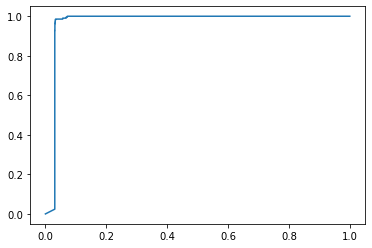

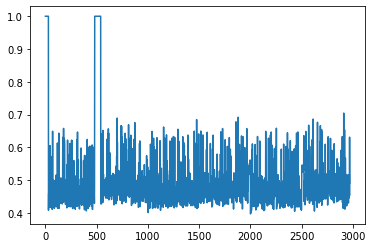

time used:18.45364546775818
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9283777095067418


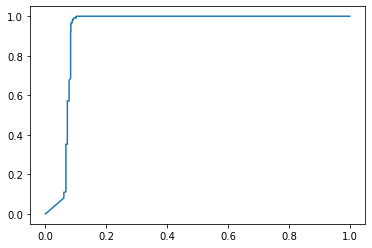

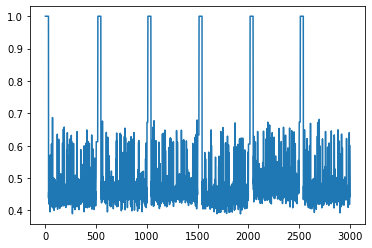

**********
window_size: 30
t: 75
phi: 22
thresh: 0.45
time used:13.266700506210327
TP: 1560 TN: 203 FP: 5 FN: 1202
ACC: 0.5936026936026936 Precision: 0.9968051118210862 Recall: 0.5648081100651702 F1: 0.7210538479315923
FPR: 0.02403846153846154 TPR: 0.5648081100651702
AUC: 0.9694314668857572


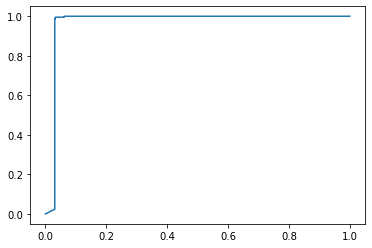

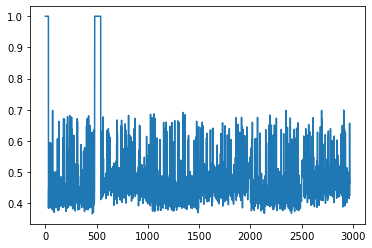

time used:19.920018672943115
TP: 1863 TN: 194 FP: 16 FN: 927
ACC: 0.6856666666666666 Precision: 0.9914848323576371 Recall: 0.667741935483871 F1: 0.7980295566502463
FPR: 0.0761904761904762 TPR: 0.667741935483871
AUC: 0.9307740228707971


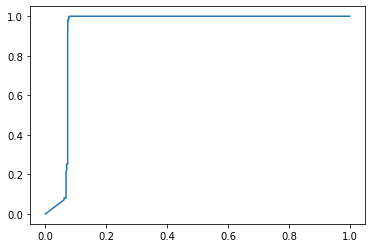

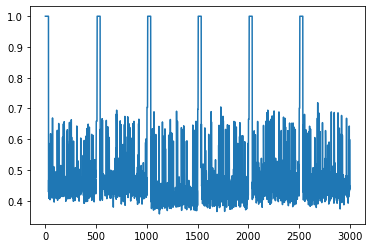

**********
window_size: 30
t: 75
phi: 22
thresh: 0.475
time used:13.274781703948975
TP: 2204 TN: 203 FP: 5 FN: 558
ACC: 0.8104377104377104 Precision: 0.9977365323675872 Recall: 0.7979724837074583 F1: 0.8867431100382217
FPR: 0.02403846153846154 TPR: 0.7979724837074583
AUC: 0.9692104035537237


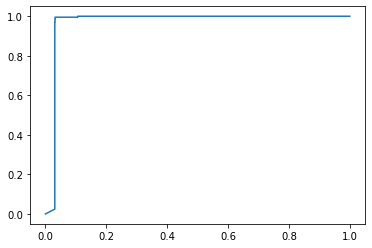

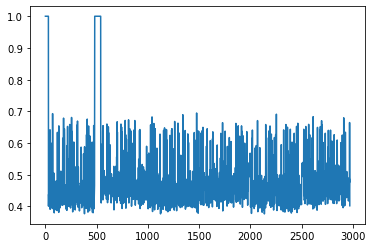

time used:19.756903886795044
TP: 2465 TN: 193 FP: 17 FN: 325
ACC: 0.886 Precision: 0.9931506849315068 Recall: 0.8835125448028673 F1: 0.9351289833080424
FPR: 0.08095238095238096 TPR: 0.8835125448028673
AUC: 0.9316777607100187


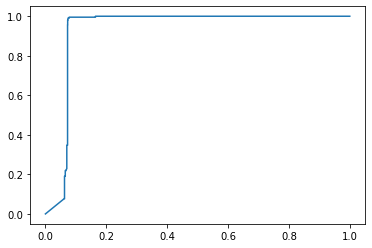

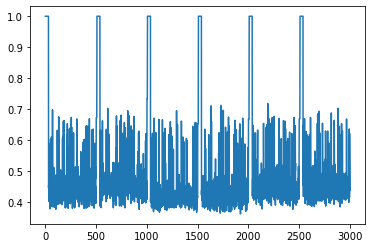

**********
window_size: 30
t: 75
phi: 22
thresh: 0.5
time used:13.040048837661743
TP: 2576 TN: 202 FP: 6 FN: 186
ACC: 0.9353535353535354 Precision: 0.9976762199845082 Recall: 0.9326574945691528 F1: 0.9640718562874252
FPR: 0.028846153846153848 TPR: 0.9326574945691528
AUC: 0.9689475644739041


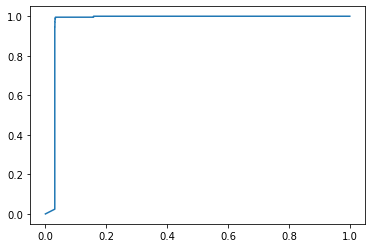

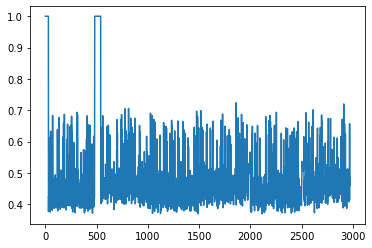

time used:19.75486969947815
TP: 2674 TN: 192 FP: 18 FN: 116
ACC: 0.9553333333333334 Precision: 0.9933135215453195 Recall: 0.9584229390681004 F1: 0.9755563662896753
FPR: 0.08571428571428572 TPR: 0.9584229390681004
AUC: 0.9322862263184843


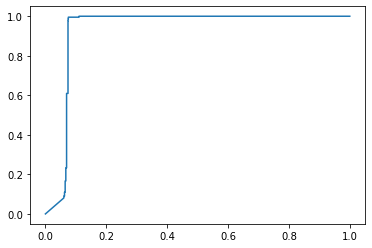

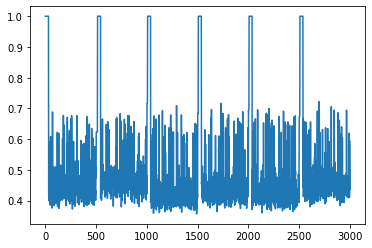

**********
window_size: 30
t: 75
phi: 22
thresh: 0.55
time used:13.039024114608765
TP: 2748 TN: 198 FP: 10 FN: 14
ACC: 0.9919191919191919 Precision: 0.9963741841914431 Recall: 0.9949312092686459 F1: 0.9956521739130434
FPR: 0.04807692307692308 TPR: 0.9949312092686459
AUC: 0.968954527098535


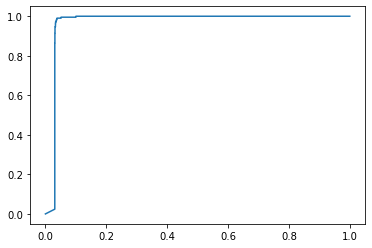

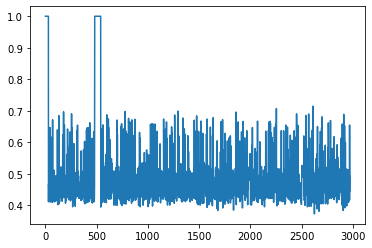

time used:19.5466251373291
TP: 2759 TN: 188 FP: 22 FN: 31
ACC: 0.9823333333333333 Precision: 0.992089176555196 Recall: 0.9888888888888889 F1: 0.9904864476754622
FPR: 0.10476190476190476 TPR: 0.9888888888888889
AUC: 0.9316862945895205


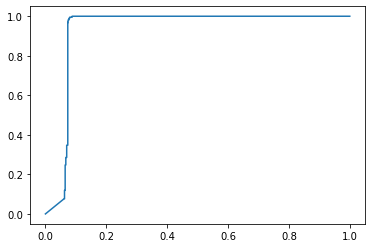

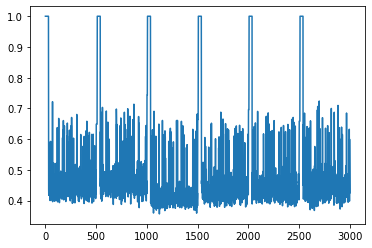

**********
window_size: 30
t: 75
phi: 22
thresh: 0.6
time used:13.116188049316406
TP: 2762 TN: 169 FP: 39 FN: 0
ACC: 0.9868686868686869 Precision: 0.9860764012852553 Recall: 1.0 F1: 0.9929893942117562
FPR: 0.1875 TPR: 1.0
AUC: 0.9694506141034924


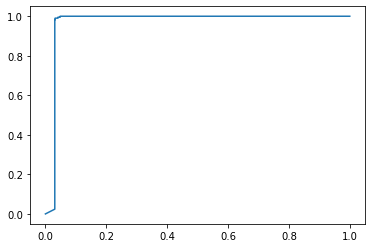

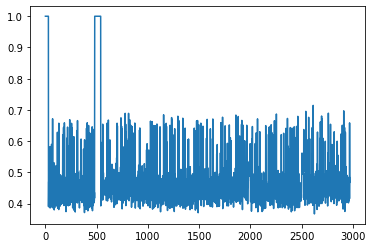

time used:19.715261936187744
TP: 2762 TN: 158 FP: 52 FN: 28
ACC: 0.9733333333333334 Precision: 0.9815209665955935 Recall: 0.9899641577060931 F1: 0.9857244825124911
FPR: 0.24761904761904763 TPR: 0.9899641577060931
AUC: 0.9317613927291346


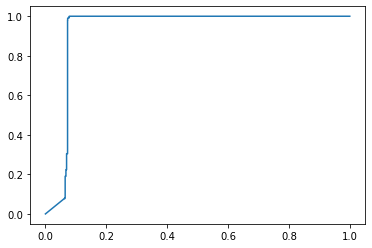

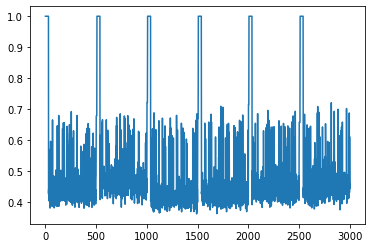

**********
window_size: 30
t: 75
phi: 22
thresh: 0.7
time used:13.067622423171997
TP: 2762 TN: 4 FP: 204 FN: 0
ACC: 0.9313131313131313 Precision: 0.9312204989885368 Recall: 1.0 F1: 0.9643854748603351
FPR: 0.9807692307692307 TPR: 1.0
AUC: 0.9694262449172839


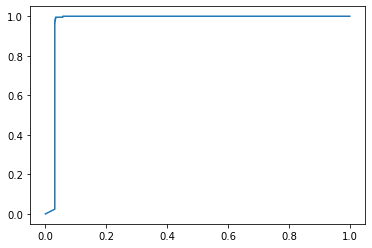

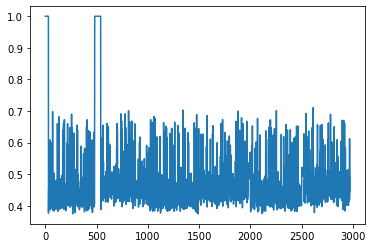

time used:19.693801403045654
TP: 2785 TN: 15 FP: 195 FN: 5
ACC: 0.9333333333333333 Precision: 0.9345637583892618 Recall: 0.9982078853046595 F1: 0.9653379549393415
FPR: 0.9285714285714286 TPR: 0.9982078853046595
AUC: 0.9319918074756784


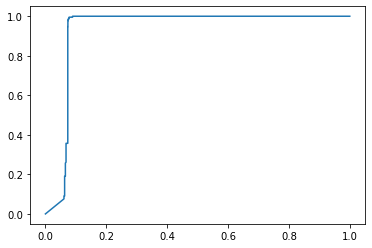

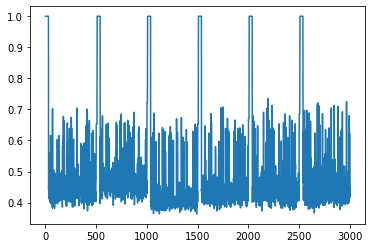

**********
window_size: 30
t: 75
phi: 27
thresh: 0.45
time used:12.80081558227539
TP: 1953 TN: 203 FP: 5 FN: 809
ACC: 0.725925925925926 Precision: 0.9974463738508682 Recall: 0.7070963070238957 F1: 0.8275423728813558
FPR: 0.02403846153846154 TPR: 0.7070963070238957
AUC: 0.9690137094078983


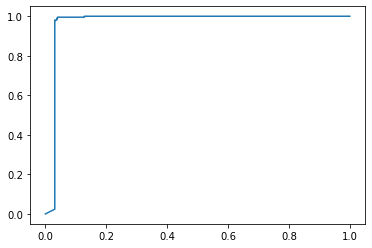

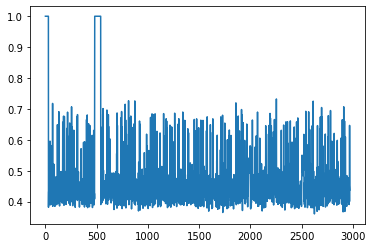

time used:18.845048189163208
TP: 2177 TN: 194 FP: 16 FN: 613
ACC: 0.7903333333333333 Precision: 0.9927040583675331 Recall: 0.7802867383512545 F1: 0.8737708207906885
FPR: 0.0761904761904762 TPR: 0.7802867383512545
AUC: 0.933410138248848


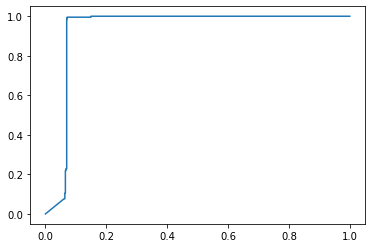

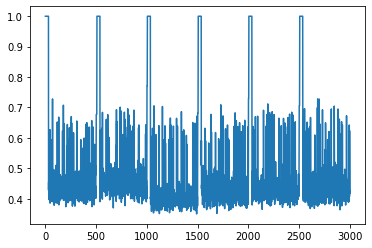

**********
window_size: 30
t: 75
phi: 27
thresh: 0.475
time used:12.92196273803711
TP: 2404 TN: 203 FP: 5 FN: 358
ACC: 0.8777777777777778 Precision: 0.9979244499792445 Recall: 0.8703837798696596 F1: 0.9298008122220073
FPR: 0.02403846153846154 TPR: 0.8703837798696596
AUC: 0.9690607071241576


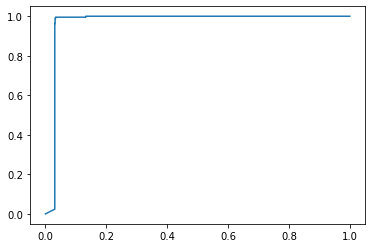

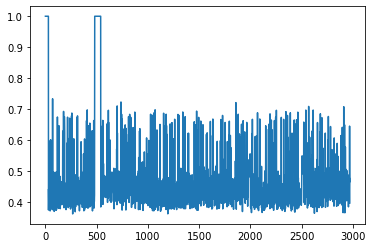

time used:19.77692222595215
TP: 2635 TN: 193 FP: 17 FN: 155
ACC: 0.9426666666666667 Precision: 0.9935897435897436 Recall: 0.9444444444444444 F1: 0.9683939728041162
FPR: 0.08095238095238096 TPR: 0.9444444444444444
AUC: 0.9334186721283495


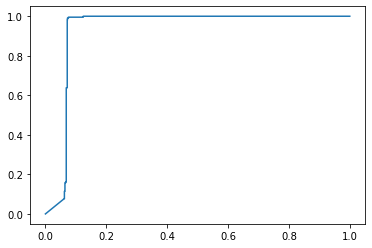

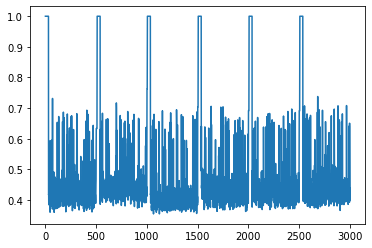

**********
window_size: 30
t: 75
phi: 27
thresh: 0.5
time used:13.047561407089233
TP: 2675 TN: 203 FP: 5 FN: 87
ACC: 0.969023569023569 Precision: 0.9981343283582089 Recall: 0.9685010861694424 F1: 0.9830944505696435
FPR: 0.02403846153846154 TPR: 0.9685010861694424
AUC: 0.9695202403498023


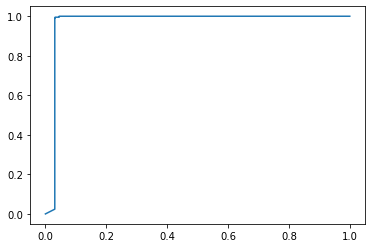

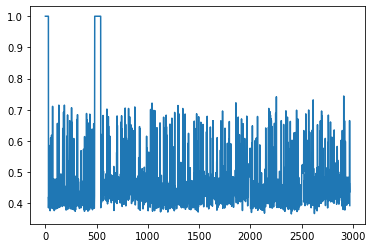

time used:19.547577619552612
TP: 2741 TN: 193 FP: 17 FN: 49
ACC: 0.978 Precision: 0.9938361131254533 Recall: 0.9824372759856631 F1: 0.9881038211968277
FPR: 0.08095238095238096 TPR: 0.9824372759856631
AUC: 0.9331916709336064


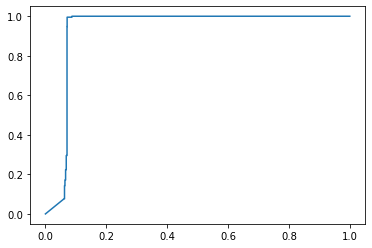

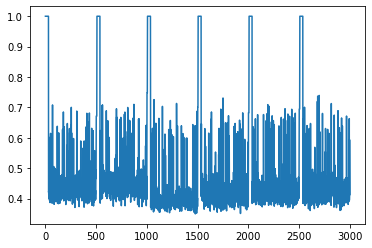

**********
window_size: 30
t: 75
phi: 27
thresh: 0.55
time used:12.764248132705688
TP: 2760 TN: 201 FP: 7 FN: 2
ACC: 0.996969696969697 Precision: 0.9974701843151428 Recall: 0.999275887038378 F1: 0.9983722192078134
FPR: 0.03365384615384615 TPR: 0.999275887038378
AUC: 0.9692939550492954


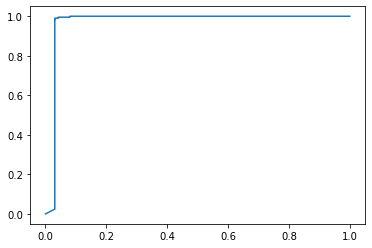

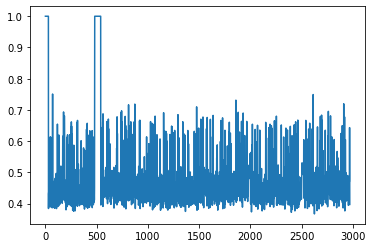

time used:19.59067177772522
TP: 2767 TN: 191 FP: 19 FN: 23
ACC: 0.986 Precision: 0.9931801866475233 Recall: 0.9917562724014337 F1: 0.9924677187948351
FPR: 0.09047619047619047 TPR: 0.9917562724014337
AUC: 0.9334289127837515


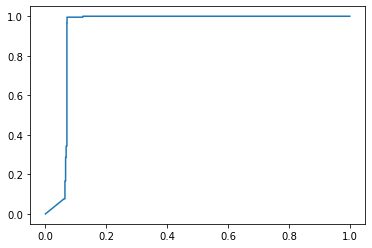

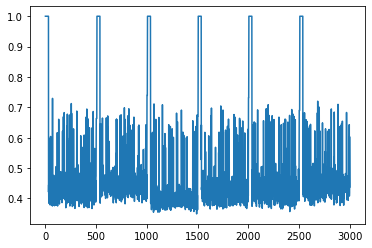

**********
window_size: 30
t: 75
phi: 27
thresh: 0.6
time used:13.044058799743652
TP: 2762 TN: 167 FP: 41 FN: 0
ACC: 0.9861952861952862 Precision: 0.9853728148412415 Recall: 1.0 F1: 0.9926325247079963
FPR: 0.1971153846153846 TPR: 1.0
AUC: 0.9688170152620731


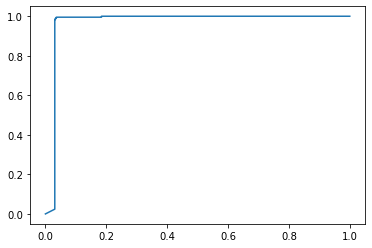

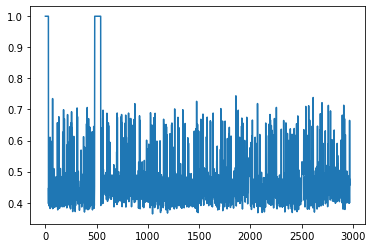

time used:19.50215721130371
TP: 2764 TN: 157 FP: 53 FN: 26
ACC: 0.9736666666666667 Precision: 0.9811856585019524 Recall: 0.9906810035842294 F1: 0.9859104690565365
FPR: 0.2523809523809524 TPR: 0.9906810035842294
AUC: 0.9331950844854071


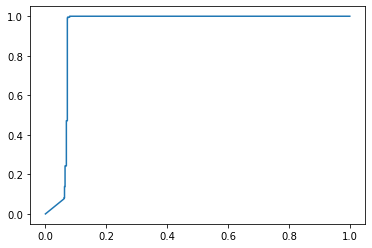

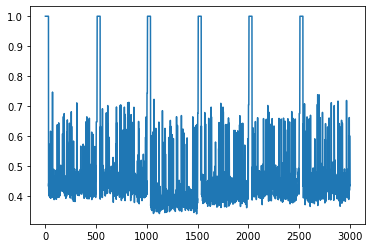

**********
window_size: 30
t: 75
phi: 27
thresh: 0.7
time used:12.738288402557373
TP: 2762 TN: 6 FP: 202 FN: 0
ACC: 0.931986531986532 Precision: 0.9318488529014844 Recall: 1.0 F1: 0.9647223192455465
FPR: 0.9711538461538461 TPR: 1.0
AUC: 0.9693270275162925


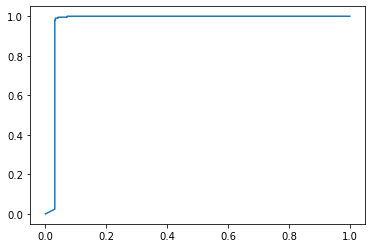

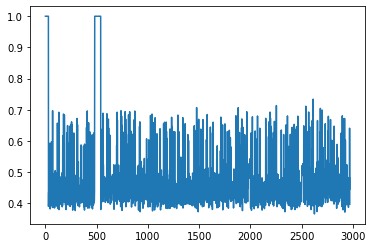

time used:19.500211715698242
TP: 2784 TN: 13 FP: 197 FN: 6
ACC: 0.9323333333333333 Precision: 0.9339147936933915 Recall: 0.9978494623655914 F1: 0.964824120603015
FPR: 0.9380952380952381 TPR: 0.9978494623655914
AUC: 0.9340194572452638


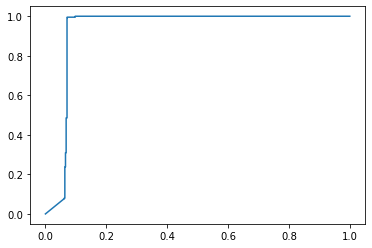

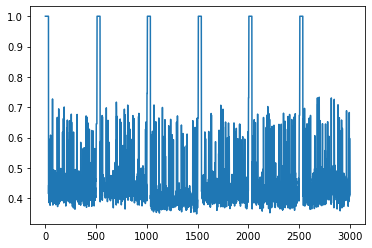

**********
window_size: 30
t: 100
phi: 3
thresh: 0.45
time used:12.51737904548645
TP: 2762 TN: 1 FP: 207 FN: 0
ACC: 0.9303030303030303 Precision: 0.9302795554058606 Recall: 1.0 F1: 0.9638806491013785
FPR: 0.9951923076923077 TPR: 1.0
AUC: 0.9178653985406339


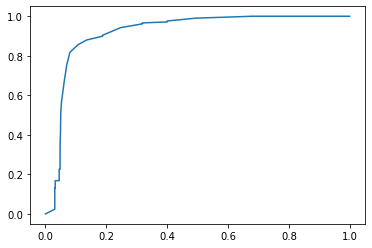

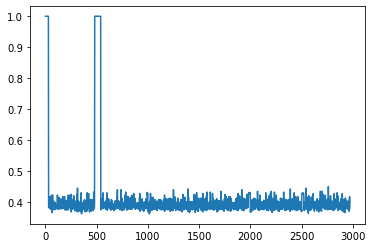

time used:20.399577617645264
TP: 2790 TN: 2 FP: 208 FN: 0
ACC: 0.9306666666666666 Precision: 0.9306204136090727 Recall: 1.0 F1: 0.9640635798203179
FPR: 0.9904761904761905 TPR: 1.0
AUC: 0.7783623485236388


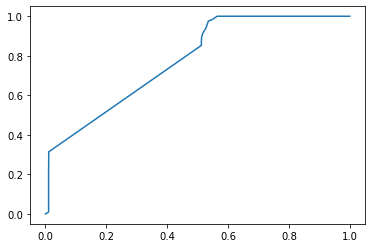

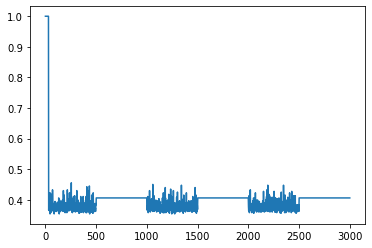

**********
window_size: 30
t: 100
phi: 3
thresh: 0.475
time used:10.866899728775024
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.8993517796468558


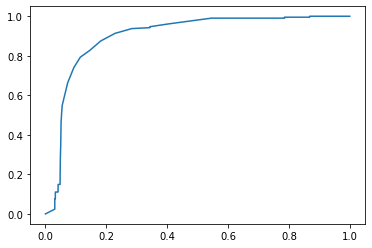

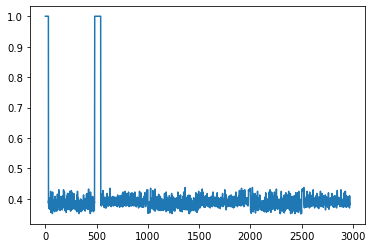

time used:20.305997848510742
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7367042157364738


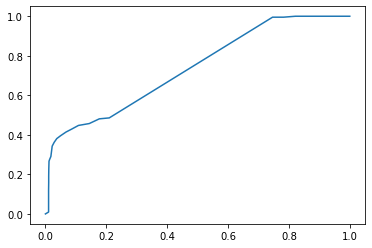

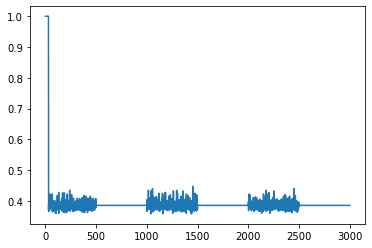

**********
window_size: 30
t: 100
phi: 3
thresh: 0.5
time used:10.875908136367798
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9370813721940623


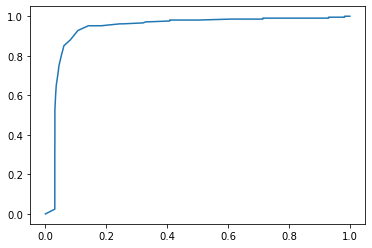

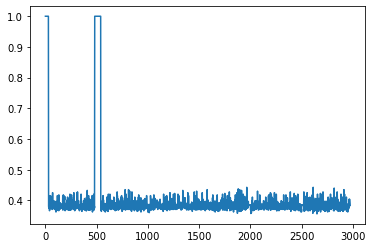

time used:20.353039503097534
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7919354838709677


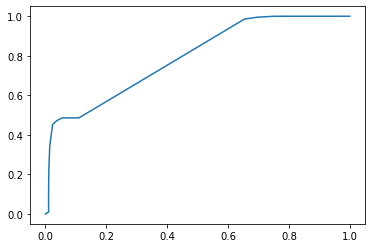

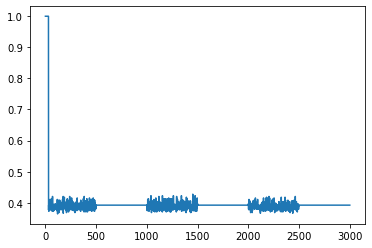

**********
window_size: 30
t: 100
phi: 3
thresh: 0.55
time used:11.17470121383667
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9029784367515178


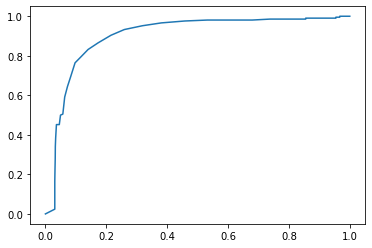

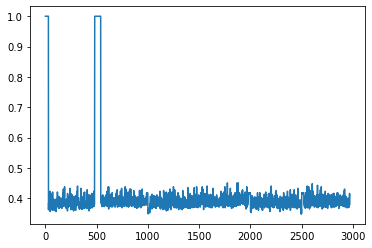

time used:20.72487473487854
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7494418842805941


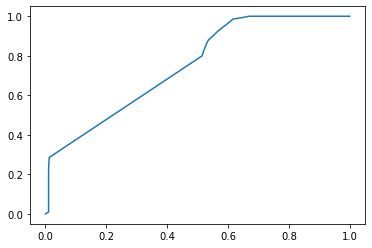

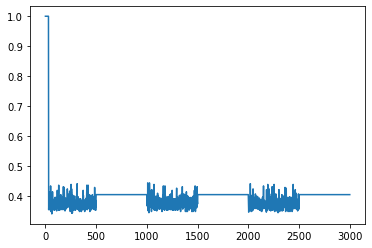

**********
window_size: 30
t: 100
phi: 3
thresh: 0.6
time used:10.871903896331787
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9036712179023004


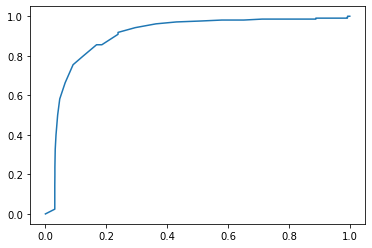

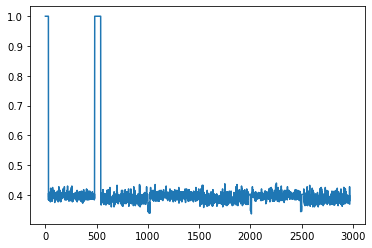

time used:20.36605167388916
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7746757125789384


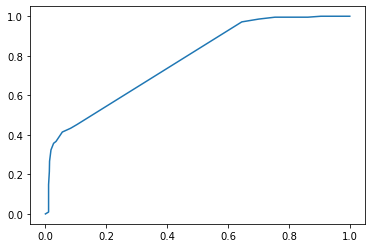

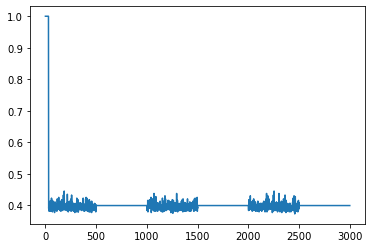

**********
window_size: 30
t: 100
phi: 3
thresh: 0.7
time used:10.884413003921509
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9281109006851223


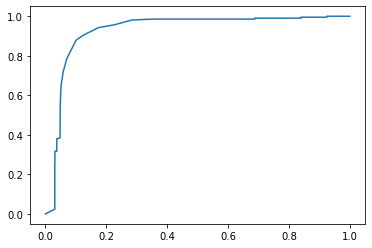

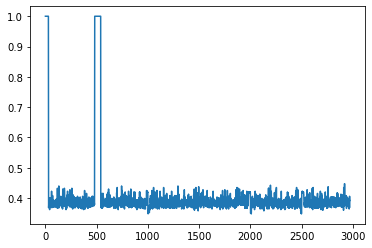

time used:20.313002109527588
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.6920404505888376


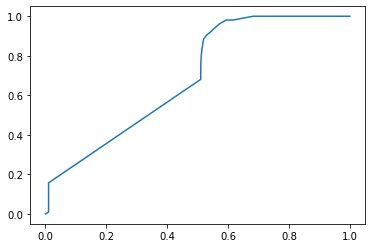

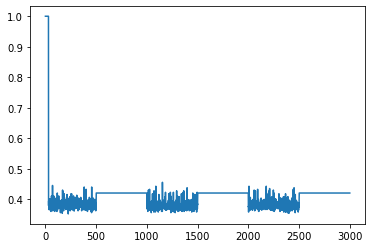

**********
window_size: 30
t: 100
phi: 7
thresh: 0.45
time used:11.061573505401611
TP: 89 TN: 203 FP: 5 FN: 2673
ACC: 0.09831649831649832 Precision: 0.9468085106382979 Recall: 0.03222302679217958 F1: 0.062324929971988796
FPR: 0.02403846153846154 TPR: 0.03222302679217958
AUC: 0.959793453740322


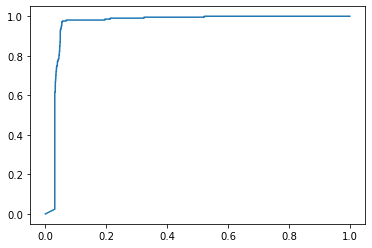

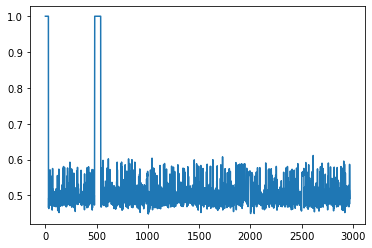

time used:20.46463680267334
TP: 29 TN: 208 FP: 2 FN: 2761
ACC: 0.079 Precision: 0.9354838709677419 Recall: 0.01039426523297491 F1: 0.020560085076214107
FPR: 0.009523809523809525 TPR: 0.01039426523297491
AUC: 0.8360667349377027


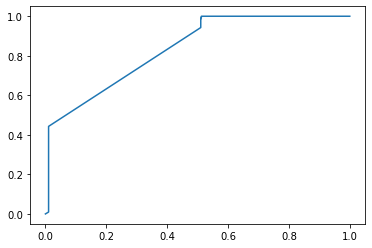

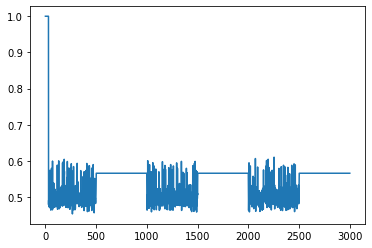

**********
window_size: 30
t: 100
phi: 7
thresh: 0.475
time used:11.13122010231018
TP: 701 TN: 203 FP: 5 FN: 2061
ACC: 0.30437710437710436 Precision: 0.9929178470254958 Recall: 0.2538015930485156 F1: 0.40426758938869667
FPR: 0.02403846153846154 TPR: 0.2538015930485156
AUC: 0.9624357697877792


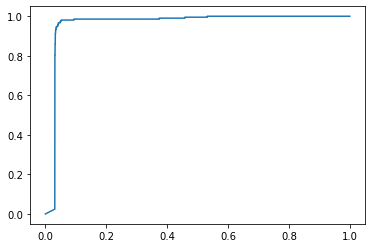

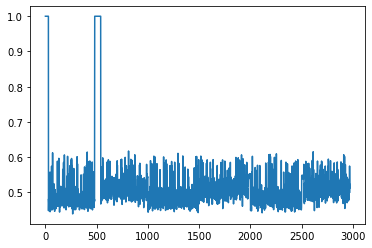

time used:20.471643447875977
TP: 234 TN: 208 FP: 2 FN: 2556
ACC: 0.14733333333333334 Precision: 0.9915254237288136 Recall: 0.08387096774193549 F1: 0.15465961665565103
FPR: 0.009523809523809525 TPR: 0.08387096774193549
AUC: 0.8265326847584913


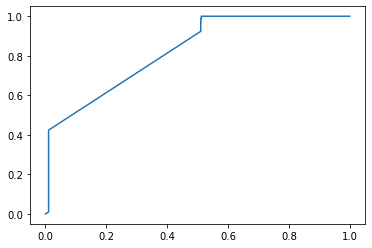

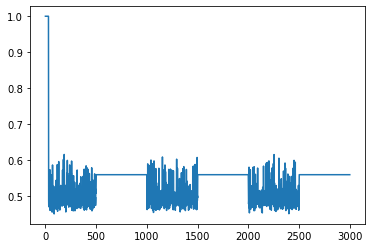

**********
window_size: 30
t: 100
phi: 7
thresh: 0.5
time used:11.092222690582275
TP: 1708 TN: 200 FP: 8 FN: 1054
ACC: 0.6424242424242425 Precision: 0.9953379953379954 Recall: 0.6183924692251991 F1: 0.762840553818669
FPR: 0.038461538461538464 TPR: 0.6183924692251991
AUC: 0.9566019606750962


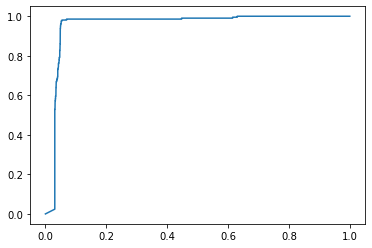

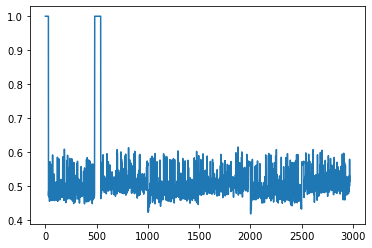

time used:15.918000936508179
TP: 1081 TN: 203 FP: 7 FN: 1709
ACC: 0.428 Precision: 0.9935661764705882 Recall: 0.3874551971326165 F1: 0.5575038679731821
FPR: 0.03333333333333333 TPR: 0.3874551971326165
AUC: 0.822258064516129


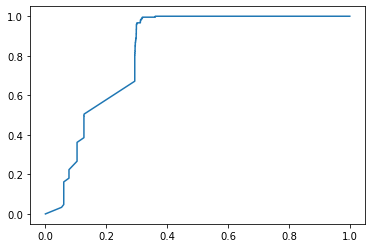

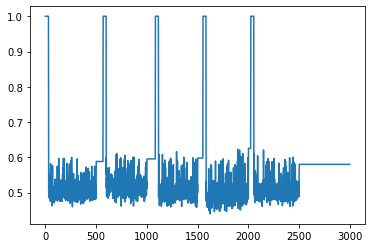

**********
window_size: 30
t: 100
phi: 7
thresh: 0.55
time used:11.05607557296753
TP: 2705 TN: 186 FP: 22 FN: 57
ACC: 0.9734006734006734 Precision: 0.991932526585992 Recall: 0.9793627805937726 F1: 0.9856075787939516
FPR: 0.10576923076923077 TPR: 0.9793627805937726
AUC: 0.9532886216788281


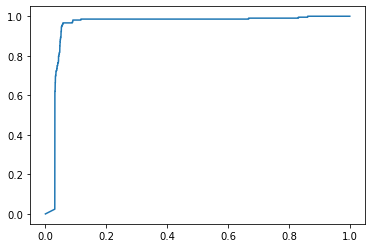

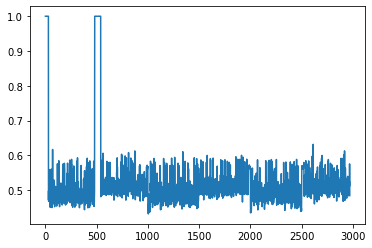

time used:18.662997007369995
TP: 1759 TN: 184 FP: 26 FN: 1031
ACC: 0.6476666666666666 Precision: 0.9854341736694678 Recall: 0.6304659498207885 F1: 0.7689617486338799
FPR: 0.12380952380952381 TPR: 0.6304659498207885
AUC: 0.8342182966376516


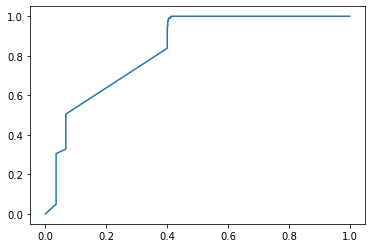

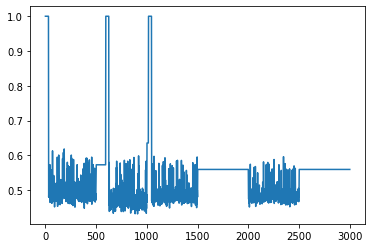

**********
window_size: 30
t: 100
phi: 7
thresh: 0.6
time used:11.02906608581543
TP: 2762 TN: 13 FP: 195 FN: 0
ACC: 0.9343434343434344 Precision: 0.9340547852553264 Recall: 1.0 F1: 0.9659031299178179
FPR: 0.9375 TPR: 1.0
AUC: 0.9587847434969087


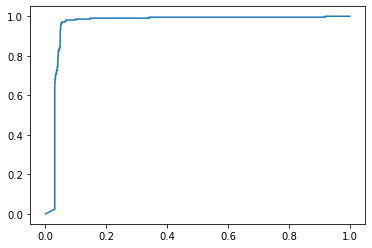

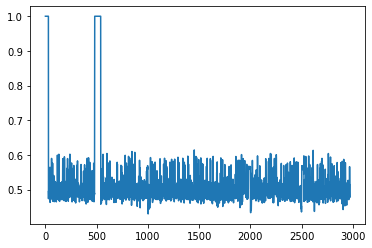

time used:20.408592462539673
TP: 2790 TN: 22 FP: 188 FN: 0
ACC: 0.9373333333333334 Precision: 0.9368703828072532 Recall: 1.0 F1: 0.9674063800277392
FPR: 0.8952380952380953 TPR: 1.0
AUC: 0.8238410991636798


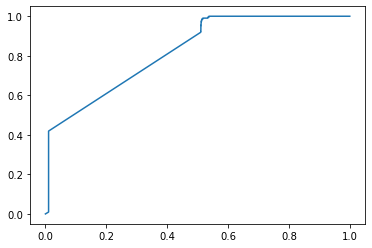

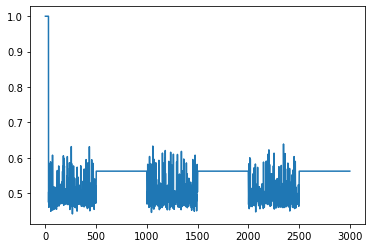

**********
window_size: 30
t: 100
phi: 7
thresh: 0.7
time used:11.021556615829468
TP: 2762 TN: 0 FP: 208 FN: 0
ACC: 0.92996632996633 Precision: 0.92996632996633 Recall: 1.0 F1: 0.9637124912770412
FPR: 1.0 TPR: 1.0
AUC: 0.9554452946582743


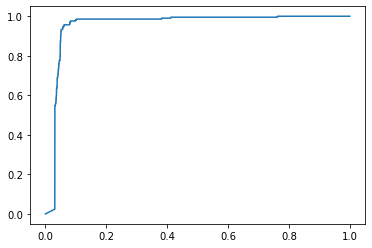

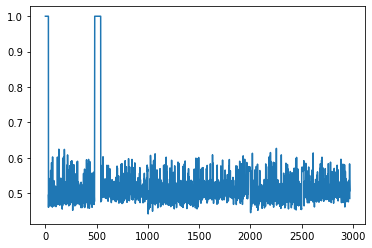

time used:18.48533868789673
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8608047448370029


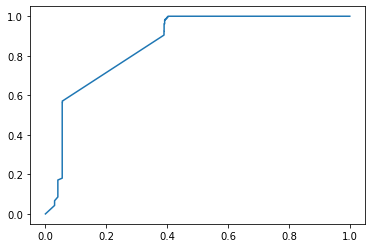

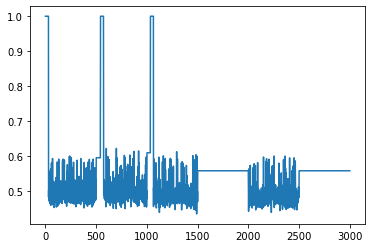

**********
window_size: 30
t: 100
phi: 15
thresh: 0.45
time used:11.171176195144653
TP: 615 TN: 203 FP: 5 FN: 2147
ACC: 0.2754208754208754 Precision: 0.9919354838709677 Recall: 0.22266473569876902 F1: 0.3636901241868717
FPR: 0.02403846153846154 TPR: 0.22266473569876902
AUC: 0.9689667116916393


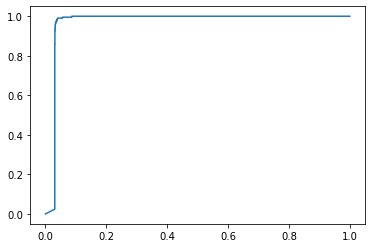

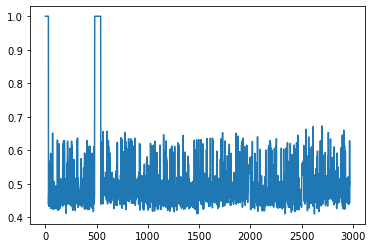

time used:17.15462350845337
TP: 1097 TN: 193 FP: 17 FN: 1693
ACC: 0.43 Precision: 0.9847396768402155 Recall: 0.3931899641577061 F1: 0.5619877049180327
FPR: 0.08095238095238096 TPR: 0.3931899641577061
AUC: 0.9274483700290153


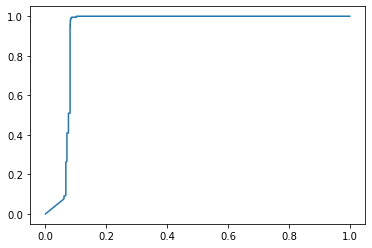

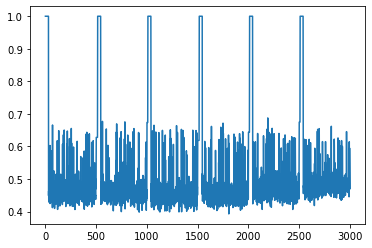

**********
window_size: 30
t: 100
phi: 15
thresh: 0.475
time used:11.179807901382446
TP: 1701 TN: 203 FP: 5 FN: 1061
ACC: 0.641077441077441 Precision: 0.9970691676436108 Recall: 0.6158580738595221 F1: 0.761414503133393
FPR: 0.02403846153846154 TPR: 0.6158580738595221
AUC: 0.9678318038767895


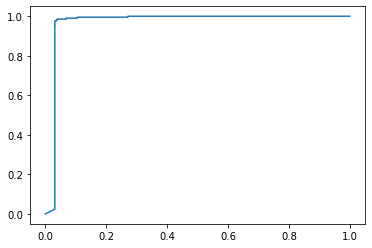

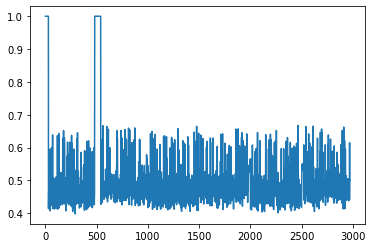

time used:16.429466724395752
TP: 2187 TN: 191 FP: 19 FN: 603
ACC: 0.7926666666666666 Precision: 0.9913871260199456 Recall: 0.7838709677419354 F1: 0.8755004003202562
FPR: 0.09047619047619047 TPR: 0.7838709677419354
AUC: 0.9301638504864311


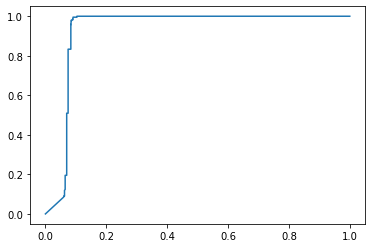

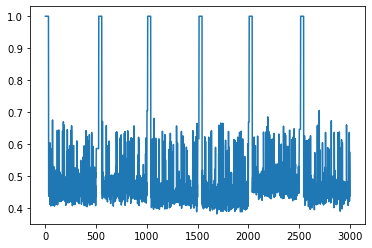

**********
window_size: 30
t: 100
phi: 15
thresh: 0.5
time used:11.189696073532104
TP: 2305 TN: 203 FP: 5 FN: 457
ACC: 0.8444444444444444 Precision: 0.9978354978354979 Recall: 0.83454018826937 F1: 0.9089116719242902
FPR: 0.02403846153846154 TPR: 0.83454018826937
AUC: 0.9689475644739041


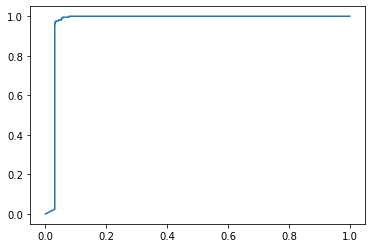

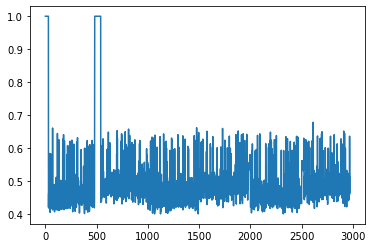

time used:17.73965287208557
TP: 2551 TN: 191 FP: 19 FN: 239
ACC: 0.914 Precision: 0.9926070038910506 Recall: 0.9143369175627241 F1: 0.9518656716417911
FPR: 0.09047619047619047 TPR: 0.9143369175627241
AUC: 0.928531319337771


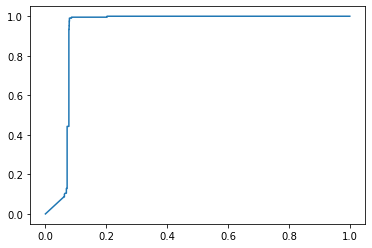

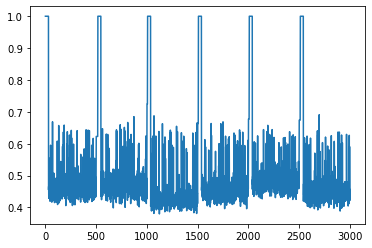

**********
window_size: 30
t: 100
phi: 15
thresh: 0.55
time used:11.24124026298523
TP: 2751 TN: 198 FP: 10 FN: 11
ACC: 0.9929292929292929 Precision: 0.9963781238681637 Recall: 0.996017378711079 F1: 0.9961977186311787
FPR: 0.04807692307692308 TPR: 0.996017378711079
AUC: 0.968073755082716


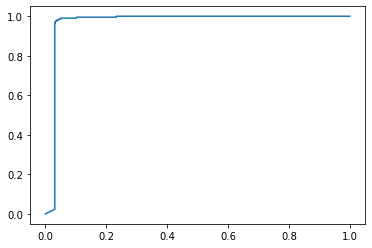

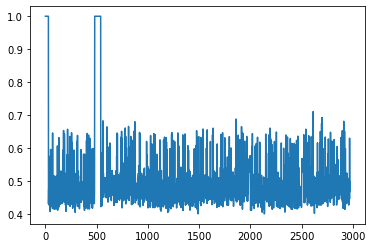

time used:17.363317489624023
TP: 2740 TN: 184 FP: 26 FN: 50
ACC: 0.9746666666666667 Precision: 0.9906001446131598 Recall: 0.982078853046595 F1: 0.986321094312455
FPR: 0.12380952380952381 TPR: 0.982078853046595
AUC: 0.9280798771121352


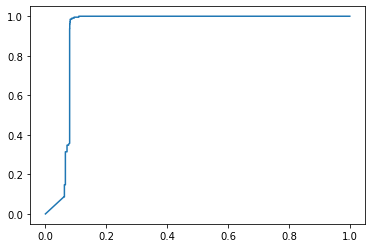

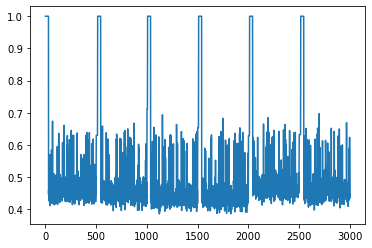

**********
window_size: 30
t: 100
phi: 15
thresh: 0.6
time used:11.160284996032715
TP: 2762 TN: 148 FP: 60 FN: 0
ACC: 0.9797979797979798 Precision: 0.9787384833451452 Recall: 1.0 F1: 0.9892550143266476
FPR: 0.28846153846153844 TPR: 1.0
AUC: 0.9683331128502201


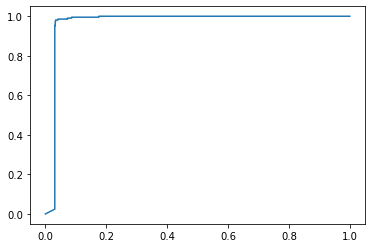

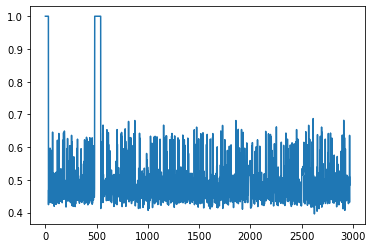

time used:16.575096130371094
TP: 2733 TN: 132 FP: 78 FN: 57
ACC: 0.955 Precision: 0.9722518676627535 Recall: 0.9795698924731183 F1: 0.9758971612212105
FPR: 0.37142857142857144 TPR: 0.9795698924731183
AUC: 0.928247141150367


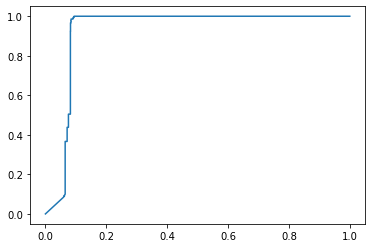

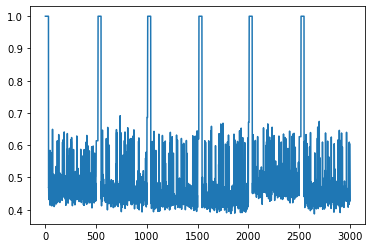

**********
window_size: 30
t: 100
phi: 15
thresh: 0.7
time used:11.17268180847168
TP: 2762 TN: 1 FP: 207 FN: 0
ACC: 0.9303030303030303 Precision: 0.9302795554058606 Recall: 1.0 F1: 0.9638806491013785
FPR: 0.9951923076923077 TPR: 1.0
AUC: 0.9689493051300618


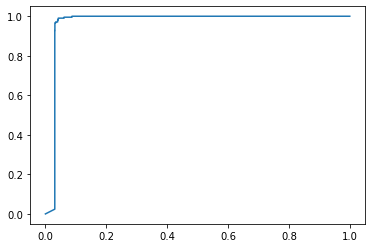

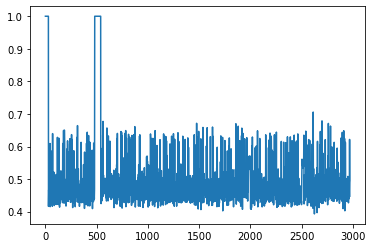

time used:17.088066339492798
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9270839733742959


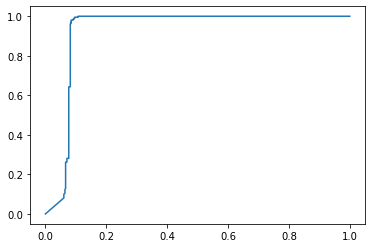

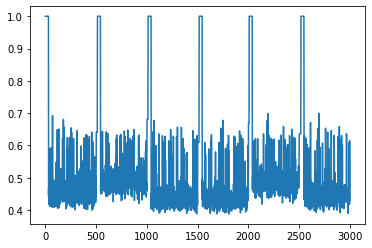

**********
window_size: 30
t: 100
phi: 22
thresh: 0.45
time used:11.291783332824707
TP: 1491 TN: 203 FP: 5 FN: 1271
ACC: 0.5703703703703704 Precision: 0.9966577540106952 Recall: 0.5398262128892107 F1: 0.700328792860498
FPR: 0.02403846153846154 TPR: 0.5398262128892107
AUC: 0.9694680206650699


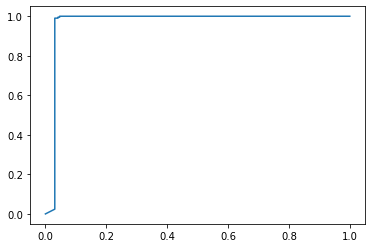

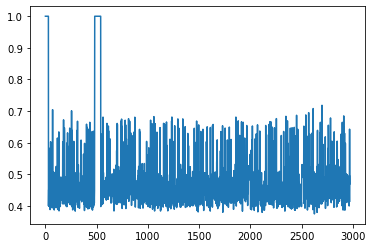

time used:17.889803409576416
TP: 1815 TN: 192 FP: 18 FN: 975
ACC: 0.669 Precision: 0.9901800327332242 Recall: 0.6505376344086021 F1: 0.7852044127190136
FPR: 0.08571428571428572 TPR: 0.6505376344086021
AUC: 0.9324620242362178


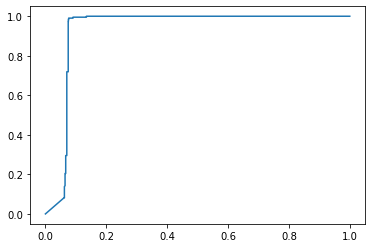

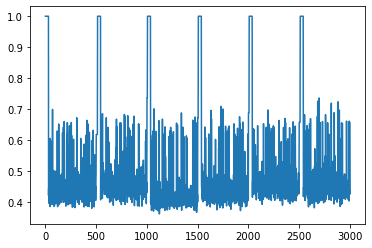

**********
window_size: 30
t: 100
phi: 22
thresh: 0.475
time used:11.295809507369995
TP: 2314 TN: 203 FP: 5 FN: 448
ACC: 0.8474747474747475 Precision: 0.9978438982319966 Recall: 0.8377986965966691 F1: 0.9108443219838614
FPR: 0.02403846153846154 TPR: 0.8377986965966691
AUC: 0.9694923898512783


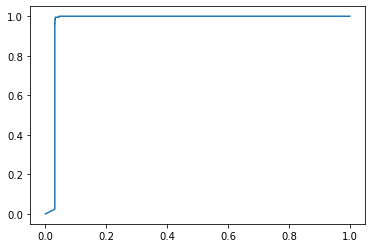

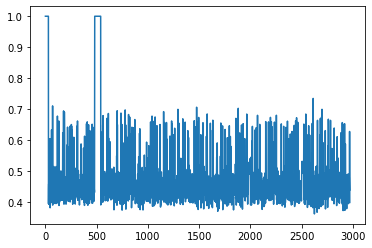

time used:17.992393016815186
TP: 2510 TN: 194 FP: 16 FN: 280
ACC: 0.9013333333333333 Precision: 0.9936658749010293 Recall: 0.899641577060932 F1: 0.9443190368698269
FPR: 0.0761904761904762 TPR: 0.899641577060932
AUC: 0.9326113671274961


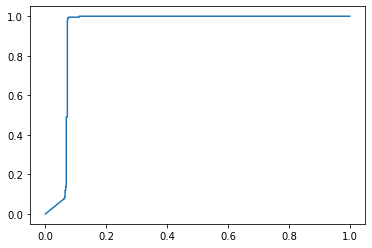

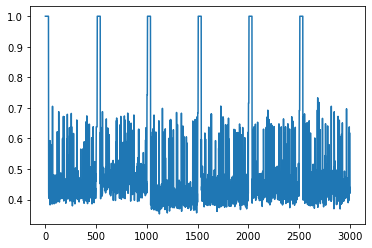

**********
window_size: 30
t: 100
phi: 22
thresh: 0.5
time used:11.314804077148438
TP: 2620 TN: 203 FP: 5 FN: 142
ACC: 0.9505050505050505 Precision: 0.9980952380952381 Recall: 0.9485879797248371 F1: 0.9727120846482273
FPR: 0.02403846153846154 TPR: 0.9485879797248371
AUC: 0.9695846446276388


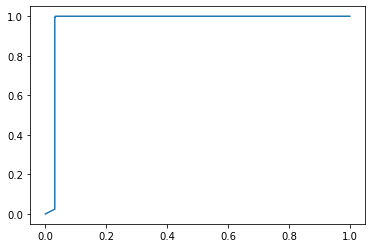

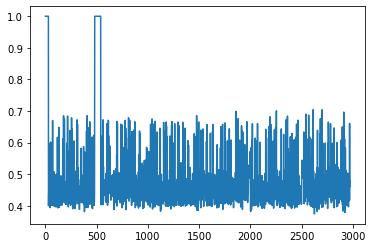

time used:17.9218270778656
TP: 2684 TN: 192 FP: 18 FN: 106
ACC: 0.9586666666666667 Precision: 0.993338267949667 Recall: 0.9620071684587813 F1: 0.9774217042971594
FPR: 0.08571428571428572 TPR: 0.9620071684587813
AUC: 0.9333017579791774


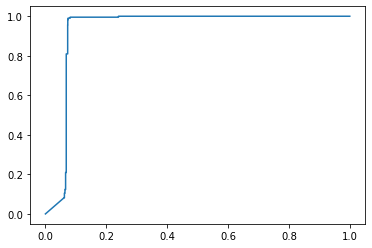

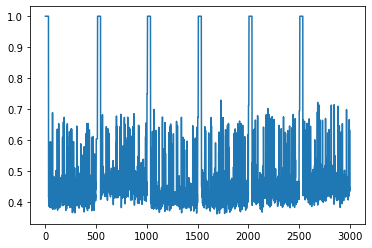

**********
window_size: 30
t: 100
phi: 22
thresh: 0.55
time used:11.305802583694458
TP: 2757 TN: 198 FP: 10 FN: 5
ACC: 0.9949494949494949 Precision: 0.996385977593061 Recall: 0.998189717595945 F1: 0.9972870320130222
FPR: 0.04807692307692308 TPR: 0.998189717595945
AUC: 0.9693740252325517


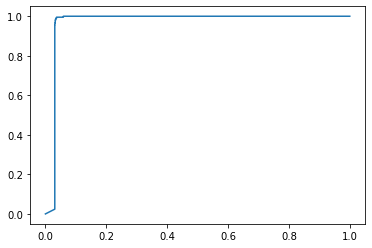

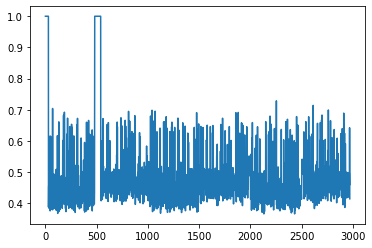

time used:17.94935393333435
TP: 2758 TN: 190 FP: 20 FN: 32
ACC: 0.9826666666666667 Precision: 0.9928005759539237 Recall: 0.9885304659498207 F1: 0.9906609195402298
FPR: 0.09523809523809523 TPR: 0.9885304659498207
AUC: 0.9312024236217785


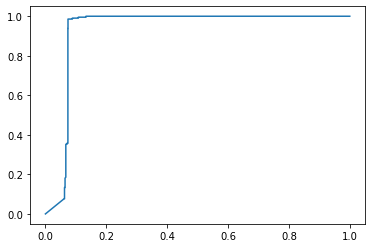

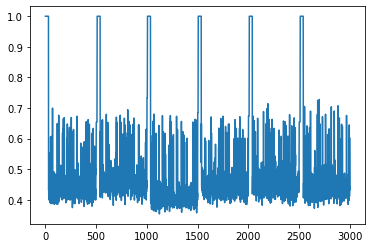

**********
window_size: 30
t: 100
phi: 22
thresh: 0.6
time used:11.297291040420532
TP: 2762 TN: 158 FP: 50 FN: 0
ACC: 0.9831649831649831 Precision: 0.9822190611664295 Recall: 1.0 F1: 0.9910297811266595
FPR: 0.2403846153846154 TPR: 1.0
AUC: 0.9693844691694982


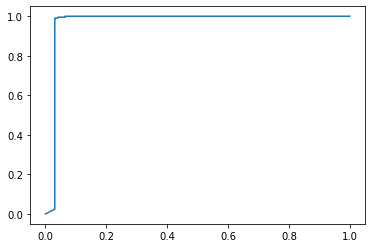

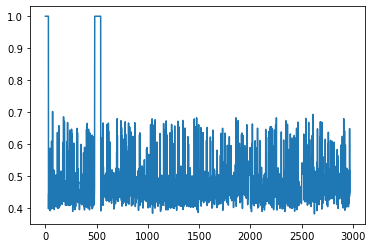

time used:17.98788595199585
TP: 2762 TN: 160 FP: 50 FN: 28
ACC: 0.974 Precision: 0.9822190611664295 Recall: 0.9899641577060931 F1: 0.9860764012852552
FPR: 0.23809523809523808 TPR: 0.9899641577060931
AUC: 0.931242532855436


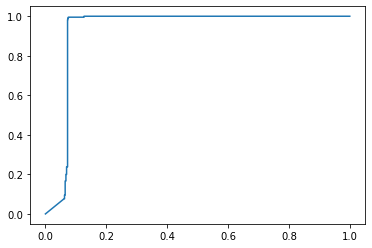

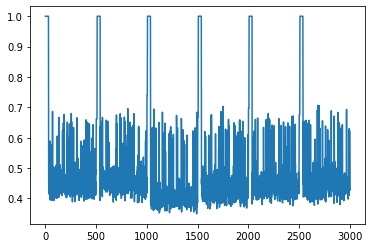

**********
window_size: 30
t: 100
phi: 22
thresh: 0.7
time used:11.420404195785522
TP: 2762 TN: 4 FP: 204 FN: 0
ACC: 0.9313131313131313 Precision: 0.9312204989885368 Recall: 1.0 F1: 0.9643854748603351
FPR: 0.9807692307692307 TPR: 1.0
AUC: 0.9693113616108728


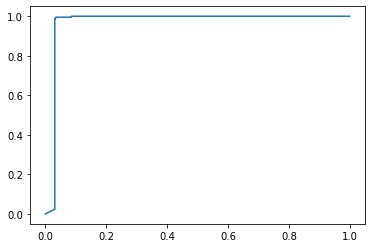

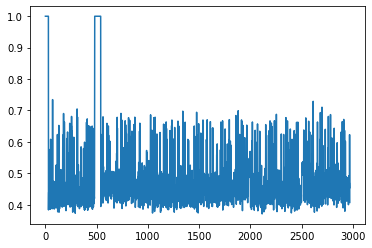

time used:17.91739773750305
TP: 2786 TN: 1 FP: 209 FN: 4
ACC: 0.929 Precision: 0.9302170283806344 Recall: 0.9985663082437276 F1: 0.963180639585134
FPR: 0.9952380952380953 TPR: 0.9985663082437276
AUC: 0.9311222051544632


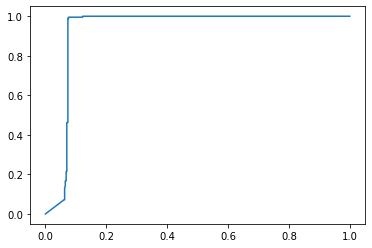

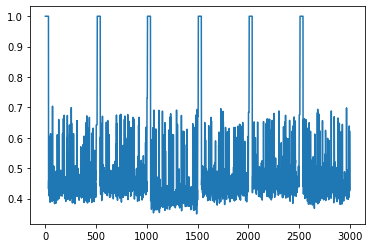

**********
window_size: 30
t: 100
phi: 27
thresh: 0.45
time used:11.31380319595337
TP: 2039 TN: 203 FP: 5 FN: 723
ACC: 0.7548821548821549 Precision: 0.9975538160469667 Recall: 0.7382331643736423 F1: 0.8485226799833542
FPR: 0.02403846153846154 TPR: 0.7382331643736423
AUC: 0.9695463501921685


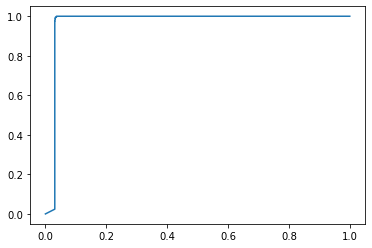

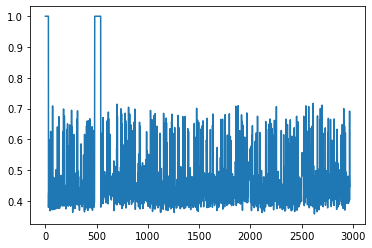

time used:18.067951917648315
TP: 2176 TN: 194 FP: 16 FN: 614
ACC: 0.79 Precision: 0.9927007299270073 Recall: 0.7799283154121864 F1: 0.8735447611401045
FPR: 0.0761904761904762 TPR: 0.7799283154121864
AUC: 0.9329663765147636


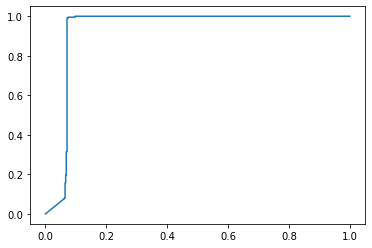

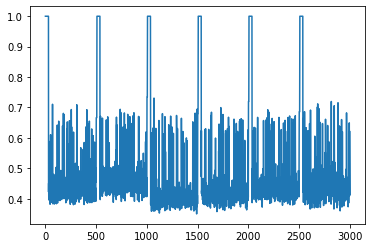

**********
window_size: 30
t: 100
phi: 27
thresh: 0.475
time used:11.309309482574463
TP: 2378 TN: 203 FP: 5 FN: 384
ACC: 0.869023569023569 Precision: 0.9979018044481746 Recall: 0.8609703113685735 F1: 0.9243926141885325
FPR: 0.02403846153846154 TPR: 0.8609703113685735
AUC: 0.9695080557566981


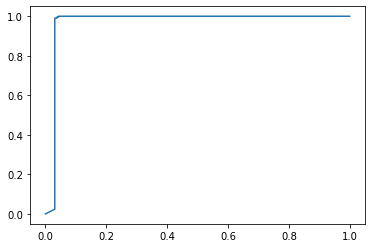

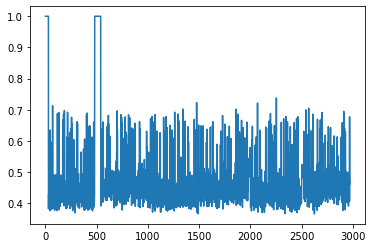

time used:18.05544376373291
TP: 2565 TN: 193 FP: 17 FN: 225
ACC: 0.9193333333333333 Precision: 0.993415956622773 Recall: 0.9193548387096774 F1: 0.9549516008935219
FPR: 0.08095238095238096 TPR: 0.9193548387096774
AUC: 0.9327991124765318


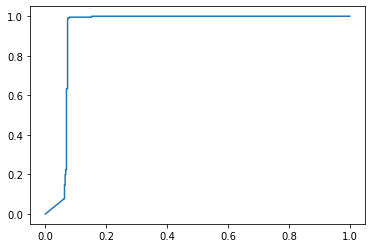

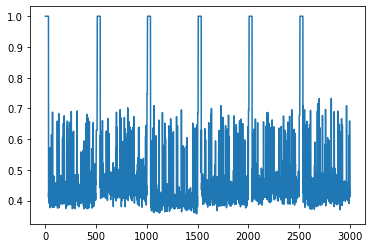

**********
window_size: 30
t: 100
phi: 27
thresh: 0.5
time used:11.35033917427063
TP: 2652 TN: 203 FP: 5 FN: 110
ACC: 0.9612794612794613 Precision: 0.998118178396688 Recall: 0.9601737871107893 F1: 0.9787783723934305
FPR: 0.02403846153846154 TPR: 0.9601737871107893
AUC: 0.9695132777251713


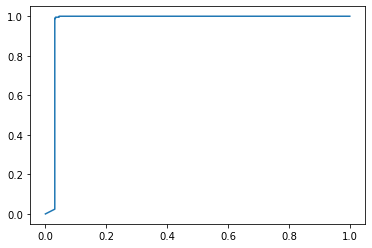

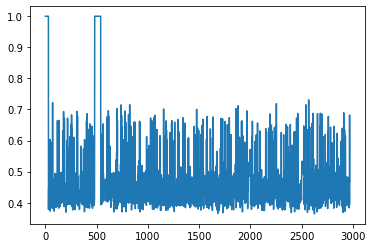

time used:17.578008890151978
TP: 2740 TN: 193 FP: 17 FN: 50
ACC: 0.9776666666666667 Precision: 0.9938338774029742 Recall: 0.982078853046595 F1: 0.9879213989543897
FPR: 0.08095238095238096 TPR: 0.982078853046595
AUC: 0.9331336405529954


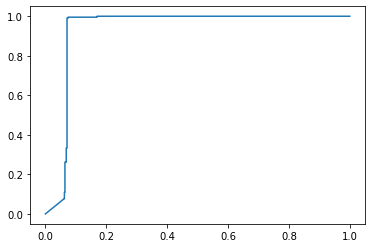

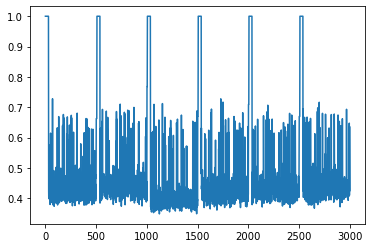

**********
window_size: 30
t: 100
phi: 27
thresh: 0.55
time used:11.323818683624268
TP: 2762 TN: 200 FP: 8 FN: 0
ACC: 0.9973063973063973 Precision: 0.9971119133574007 Recall: 1.0 F1: 0.9985538684020245
FPR: 0.038461538461538464 TPR: 1.0
AUC: 0.9695115370690135


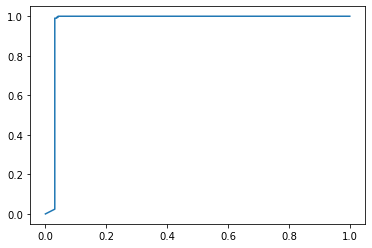

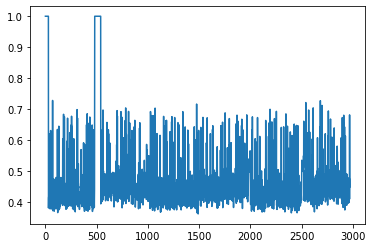

time used:18.052493810653687
TP: 2766 TN: 190 FP: 20 FN: 24
ACC: 0.9853333333333333 Precision: 0.9928212491026561 Recall: 0.9913978494623656 F1: 0.9921090387374462
FPR: 0.09523809523809523 TPR: 0.9913978494623656
AUC: 0.933647380098993


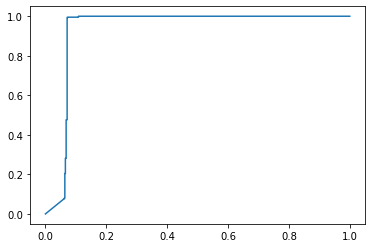

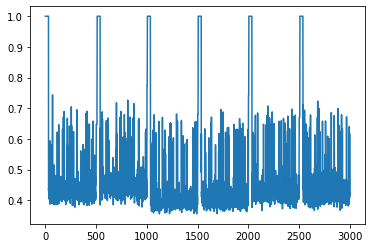

**********
window_size: 30
t: 100
phi: 27
thresh: 0.6
time used:11.283775568008423
TP: 2762 TN: 161 FP: 47 FN: 0
ACC: 0.9841750841750841 Precision: 0.9832680669277323 Recall: 1.0 F1: 0.9915634535989948
FPR: 0.22596153846153846 TPR: 1.0
AUC: 0.9694419108227037


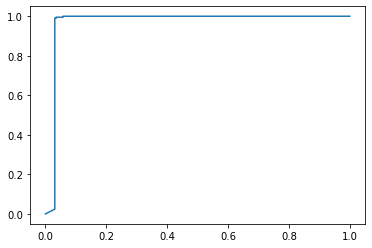

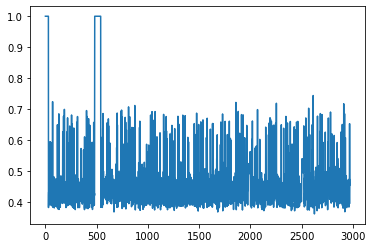

time used:17.994892835617065
TP: 2764 TN: 161 FP: 49 FN: 26
ACC: 0.975 Precision: 0.982580874511198 Recall: 0.9906810035842294 F1: 0.9866143137604855
FPR: 0.23333333333333334 TPR: 0.9906810035842294
AUC: 0.9325806451612904


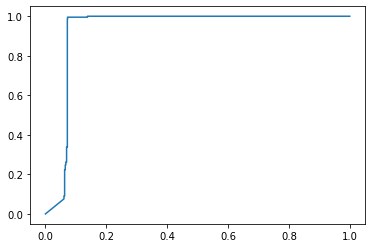

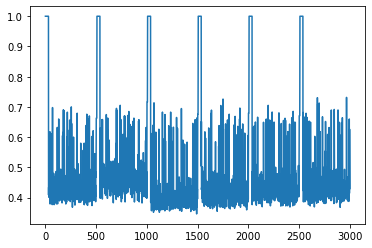

**********
window_size: 30
t: 100
phi: 27
thresh: 0.7
time used:11.34883451461792
TP: 2762 TN: 13 FP: 195 FN: 0
ACC: 0.9343434343434344 Precision: 0.9340547852553264 Recall: 1.0 F1: 0.9659031299178179
FPR: 0.9375 TPR: 1.0
AUC: 0.9695184996936446


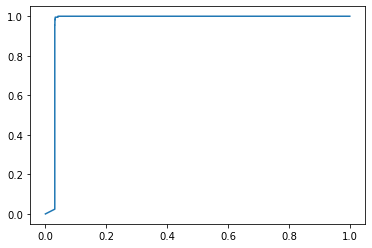

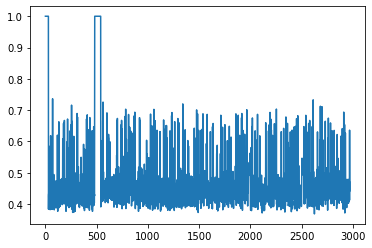

time used:18.082977294921875
TP: 2783 TN: 10 FP: 200 FN: 7
ACC: 0.931 Precision: 0.9329534026148173 Recall: 0.9974910394265233 F1: 0.9641434262948207
FPR: 0.9523809523809523 TPR: 0.9974910394265233
AUC: 0.9332804232804233


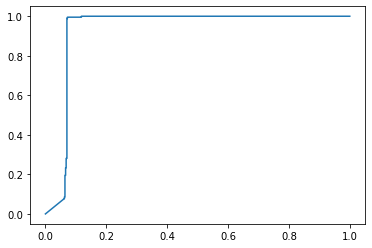

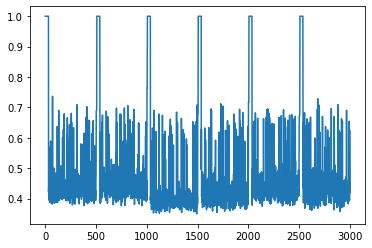

**********
window_size: 50
t: 20
phi: 5
thresh: 0.45
time used:10.925053119659424
TP: 262 TN: 201 FP: 6 FN: 2481
ACC: 0.15694915254237288 Precision: 0.9776119402985075 Recall: 0.09551585854903391 F1: 0.17402856193955496
FPR: 0.028985507246376812 TPR: 0.09551585854903391
AUC: 0.9386598473761053


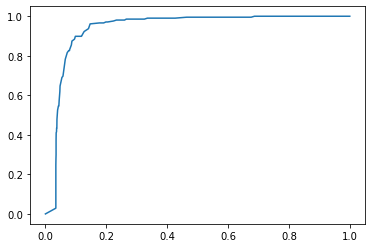

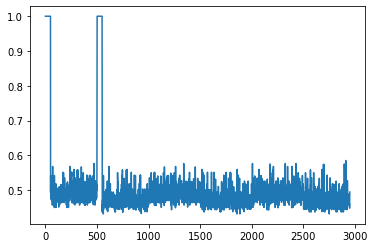

time used:20.08729338645935
TP: 124 TN: 207 FP: 3 FN: 2666
ACC: 0.11033333333333334 Precision: 0.9763779527559056 Recall: 0.044444444444444446 F1: 0.08501885498800137
FPR: 0.014285714285714285 TPR: 0.044444444444444446
AUC: 0.691890254309609


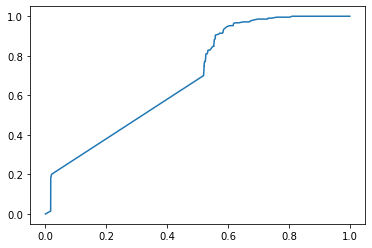

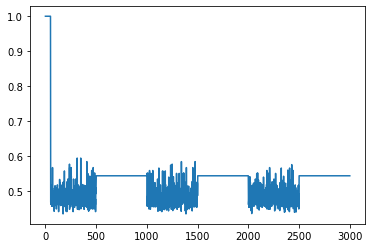

**********
window_size: 50
t: 20
phi: 5
thresh: 0.475
time used:10.943980932235718
TP: 664 TN: 197 FP: 10 FN: 2079
ACC: 0.291864406779661 Precision: 0.9851632047477745 Recall: 0.24207072548304776 F1: 0.38864501024290316
FPR: 0.04830917874396135 TPR: 0.24207072548304776
AUC: 0.864927148772193


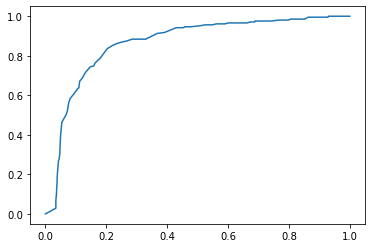

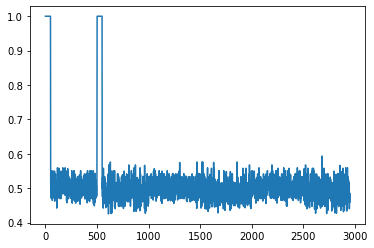

time used:20.1668701171875
TP: 682 TN: 206 FP: 4 FN: 2108
ACC: 0.296 Precision: 0.9941690962099126 Recall: 0.24444444444444444 F1: 0.3924050632911392
FPR: 0.01904761904761905 TPR: 0.24444444444444444
AUC: 0.7607159924901861


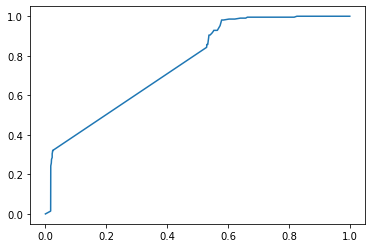

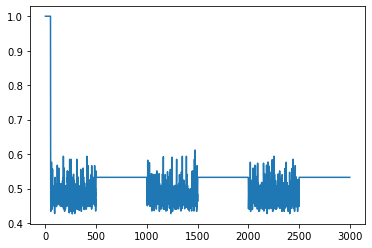

**********
window_size: 50
t: 20
phi: 5
thresh: 0.5
time used:10.941967487335205
TP: 1789 TN: 187 FP: 20 FN: 954
ACC: 0.6698305084745763 Precision: 0.9889441680486457 Recall: 0.6522056142909224 F1: 0.7860281195079086
FPR: 0.0966183574879227 TPR: 0.6522056142909224
AUC: 0.859194506526054


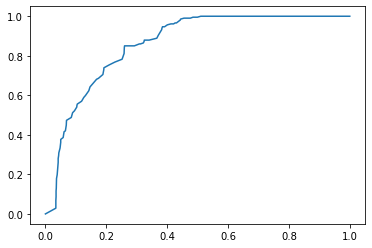

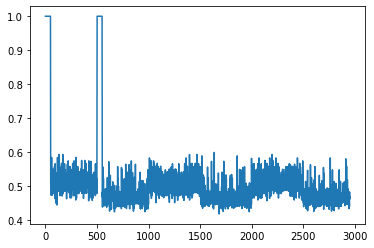

time used:18.65099787712097
TP: 1608 TN: 186 FP: 24 FN: 1182
ACC: 0.598 Precision: 0.9852941176470589 Recall: 0.5763440860215053 F1: 0.7272727272727273
FPR: 0.11428571428571428 TPR: 0.5763440860215053
AUC: 0.7881754565625534


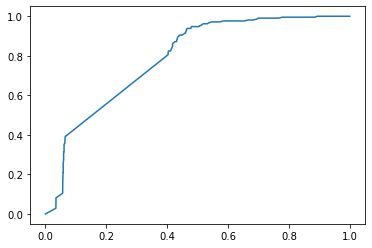

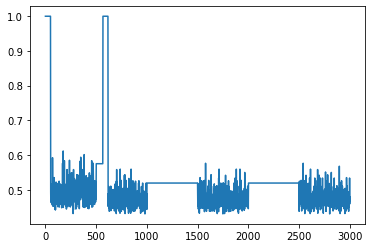

**********
window_size: 50
t: 20
phi: 5
thresh: 0.55
time used:10.93045449256897
TP: 2738 TN: 69 FP: 138 FN: 5
ACC: 0.9515254237288135 Precision: 0.9520166898470097 Recall: 0.998177178271965 F1: 0.9745506317850152
FPR: 0.6666666666666666 TPR: 0.998177178271965
AUC: 0.9015315224876321


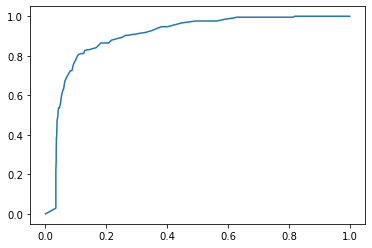

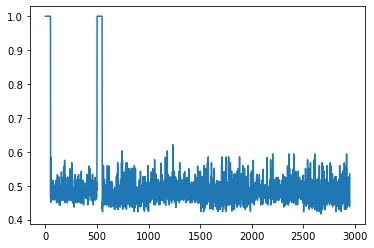

time used:20.186933040618896
TP: 2788 TN: 38 FP: 172 FN: 2
ACC: 0.942 Precision: 0.9418918918918919 Recall: 0.9992831541218637 F1: 0.9697391304347825
FPR: 0.819047619047619 TPR: 0.9992831541218637
AUC: 0.7450128008192525


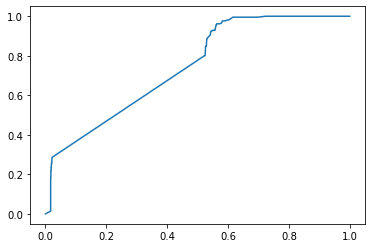

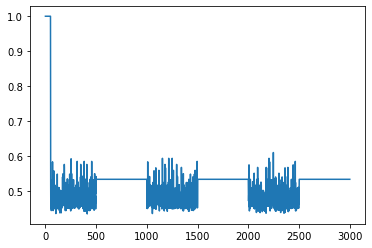

**********
window_size: 50
t: 20
phi: 5
thresh: 0.6
time used:10.935484647750854
TP: 2743 TN: 3 FP: 204 FN: 0
ACC: 0.9308474576271186 Precision: 0.9307770614183916 Recall: 1.0 F1: 0.9641476274165202
FPR: 0.9855072463768116 TPR: 1.0
AUC: 0.938208104600027


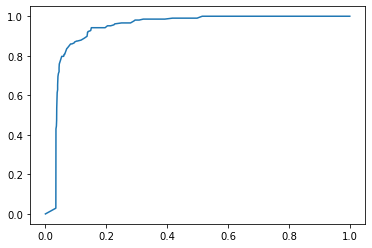

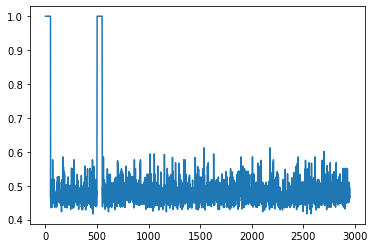

time used:20.111913442611694
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8187907492746201


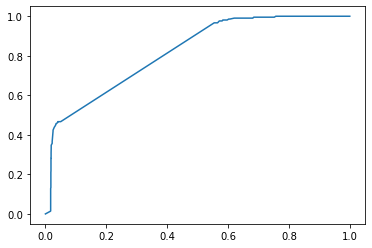

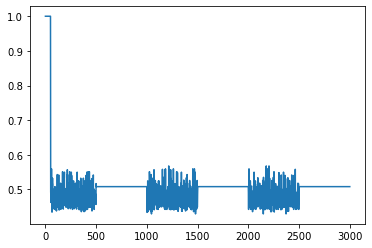

**********
window_size: 50
t: 20
phi: 5
thresh: 0.7
time used:11.05912446975708
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9058992499132618


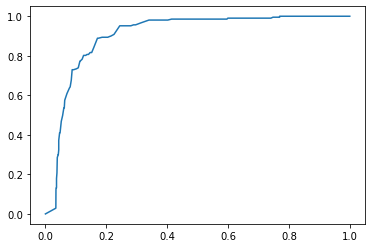

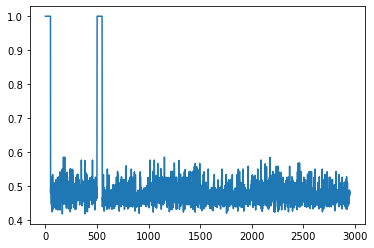

time used:17.35280418395996
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7642191500256016


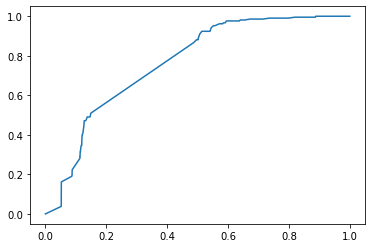

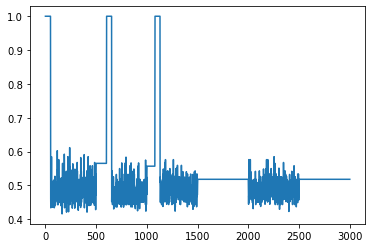

**********
window_size: 50
t: 20
phi: 12
thresh: 0.45
time used:10.96799111366272
TP: 1249 TN: 201 FP: 6 FN: 1494
ACC: 0.4915254237288136 Precision: 0.9952191235059761 Recall: 0.4553408676631425 F1: 0.6248124062031016
FPR: 0.028985507246376812 TPR: 0.4553408676631425
AUC: 0.9650986877444738


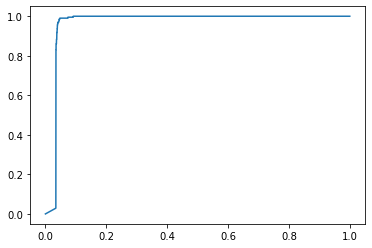

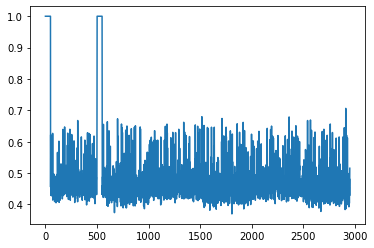

time used:15.115270614624023
TP: 720 TN: 187 FP: 23 FN: 2070
ACC: 0.30233333333333334 Precision: 0.9690444145356663 Recall: 0.25806451612903225 F1: 0.4075856212850269
FPR: 0.10952380952380952 TPR: 0.25806451612903225
AUC: 0.8826181942310974


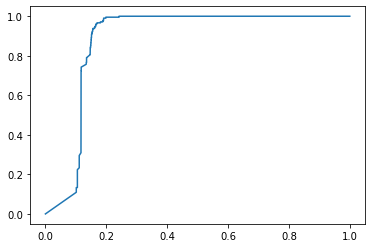

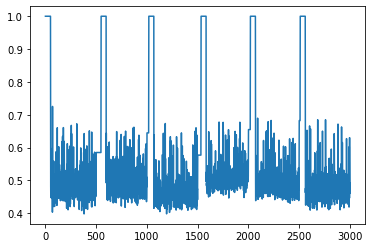

**********
window_size: 50
t: 20
phi: 12
thresh: 0.475
time used:10.934497833251953
TP: 1371 TN: 201 FP: 6 FN: 1372
ACC: 0.5328813559322034 Precision: 0.9956427015250545 Recall: 0.4998177178271965 F1: 0.6655339805825242
FPR: 0.028985507246376812 TPR: 0.4998177178271965
AUC: 0.9620042937578482


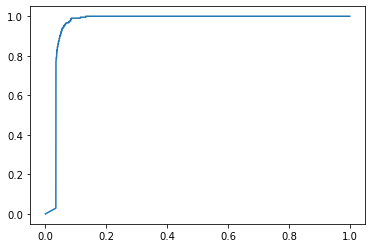

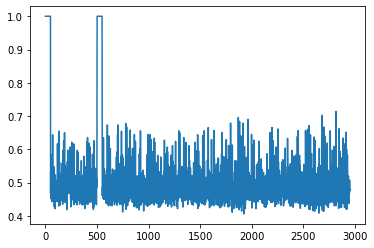

time used:18.81864619255066
TP: 463 TN: 204 FP: 6 FN: 2327
ACC: 0.22233333333333333 Precision: 0.9872068230277186 Recall: 0.16594982078853046 F1: 0.2841362381098496
FPR: 0.02857142857142857 TPR: 0.16594982078853046
AUC: 0.8629433350401092


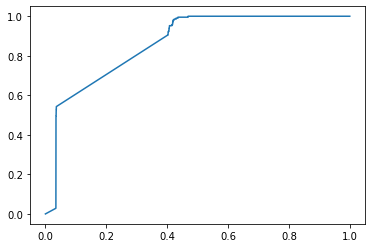

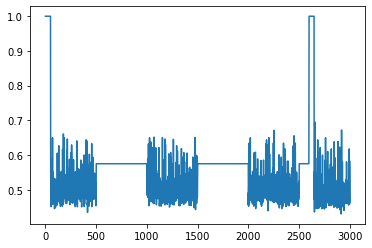

**********
window_size: 50
t: 20
phi: 12
thresh: 0.5
time used:10.967030048370361
TP: 1982 TN: 199 FP: 8 FN: 761
ACC: 0.7393220338983051 Precision: 0.9959798994974874 Recall: 0.7225665329930733 F1: 0.8375237692795268
FPR: 0.03864734299516908 TPR: 0.7225665329930733
AUC: 0.9568325874734283


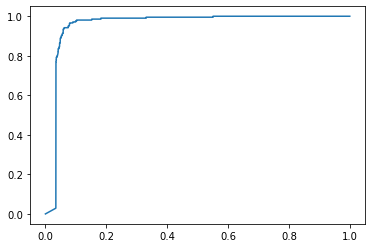

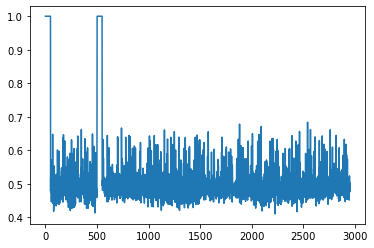

time used:15.372497797012329
TP: 2370 TN: 182 FP: 28 FN: 420
ACC: 0.8506666666666667 Precision: 0.9883236030025021 Recall: 0.8494623655913979 F1: 0.9136468774094063
FPR: 0.13333333333333333 TPR: 0.8494623655913979
AUC: 0.8881669226830516


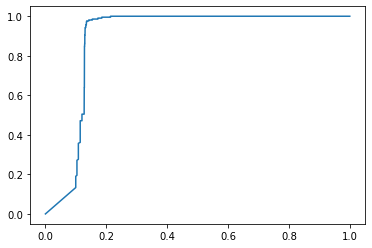

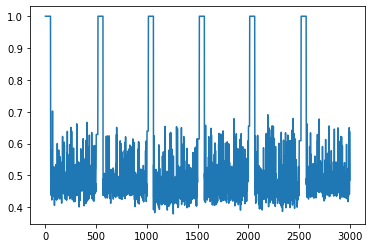

**********
window_size: 50
t: 20
phi: 12
thresh: 0.55
time used:10.940966844558716
TP: 2696 TN: 195 FP: 12 FN: 47
ACC: 0.98 Precision: 0.9955686853766618 Recall: 0.982865475756471 F1: 0.9891762979269859
FPR: 0.057971014492753624 TPR: 0.982865475756471
AUC: 0.9634537452382084


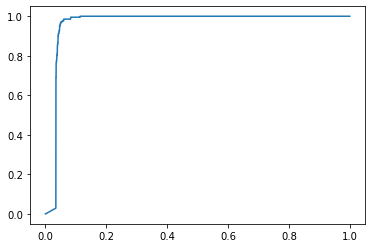

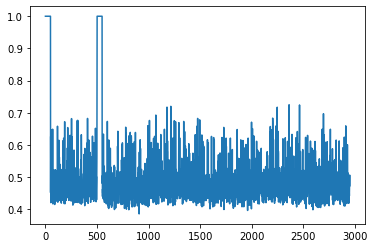

time used:15.254430532455444
TP: 2586 TN: 179 FP: 31 FN: 204
ACC: 0.9216666666666666 Precision: 0.9881543752388231 Recall: 0.9268817204301075 F1: 0.9565378213427038
FPR: 0.14761904761904762 TPR: 0.9268817204301075
AUC: 0.8830747567844341


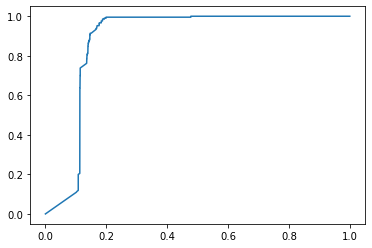

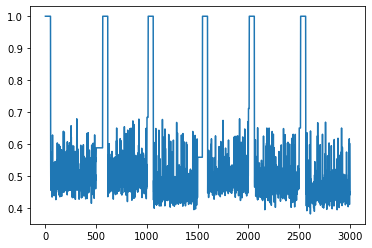

**********
window_size: 50
t: 20
phi: 12
thresh: 0.6
time used:10.993056058883667
TP: 2742 TN: 134 FP: 73 FN: 1
ACC: 0.9749152542372881 Precision: 0.9740674955595027 Recall: 0.999635435654393 F1: 0.9866858582223822
FPR: 0.3526570048309179 TPR: 0.999635435654393
AUC: 0.9629060181295912


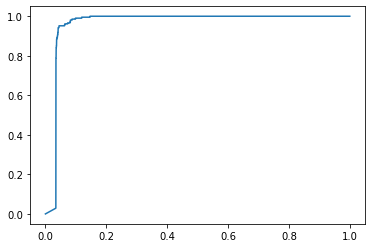

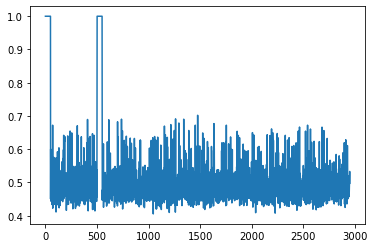

time used:15.771363973617554
TP: 2745 TN: 105 FP: 105 FN: 45
ACC: 0.95 Precision: 0.9631578947368421 Recall: 0.9838709677419355 F1: 0.9734042553191489
FPR: 0.5 TPR: 0.9838709677419355
AUC: 0.883189964157706


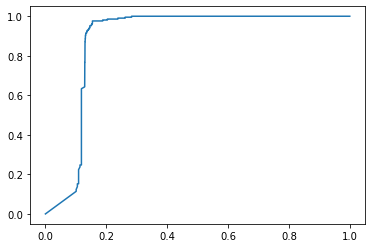

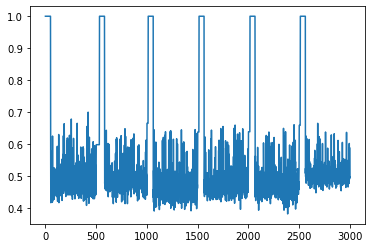

**********
window_size: 50
t: 20
phi: 12
thresh: 0.7
time used:10.92945909500122
TP: 2743 TN: 2 FP: 205 FN: 0
ACC: 0.9305084745762712 Precision: 0.930461329715061 Recall: 1.0 F1: 0.9639782112106835
FPR: 0.9903381642512077 TPR: 1.0
AUC: 0.9639116521457343


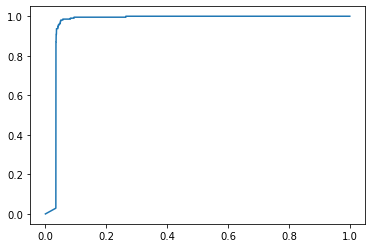

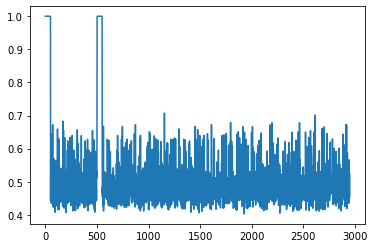

time used:15.330963850021362
TP: 2790 TN: 2 FP: 208 FN: 0
ACC: 0.9306666666666666 Precision: 0.9306204136090727 Recall: 1.0 F1: 0.9640635798203179
FPR: 0.9904761904761905 TPR: 1.0
AUC: 0.887699266086363


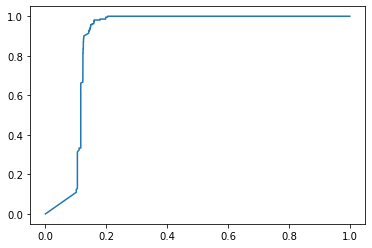

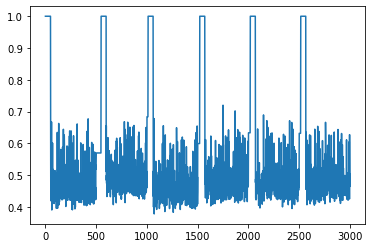

**********
window_size: 50
t: 20
phi: 25
thresh: 0.45
time used:11.002559423446655
TP: 1170 TN: 201 FP: 6 FN: 1573
ACC: 0.4647457627118644 Precision: 0.9948979591836735 Recall: 0.4265402843601896 F1: 0.5970910946670069
FPR: 0.028985507246376812 TPR: 0.4265402843601896
AUC: 0.9646073184090905


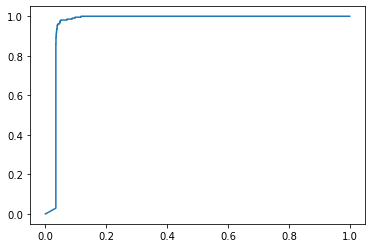

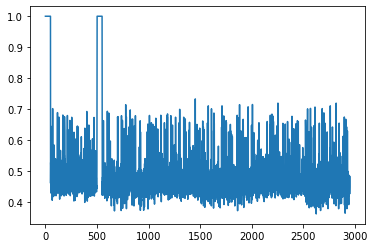

time used:15.61972975730896
TP: 1807 TN: 183 FP: 27 FN: 983
ACC: 0.6633333333333333 Precision: 0.985278080697928 Recall: 0.6476702508960573 F1: 0.7815743944636677
FPR: 0.12857142857142856 TPR: 0.6476702508960573
AUC: 0.8975311486601808


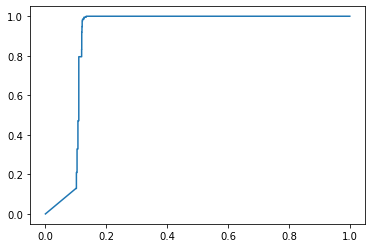

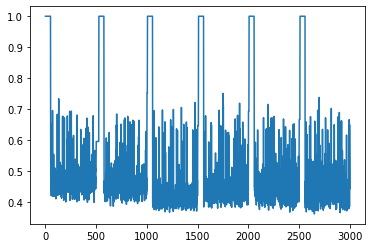

**********
window_size: 50
t: 20
phi: 25
thresh: 0.475
time used:10.977063179016113
TP: 2090 TN: 201 FP: 6 FN: 653
ACC: 0.7766101694915254 Precision: 0.9971374045801527 Recall: 0.7619394823186293 F1: 0.8638148377764002
FPR: 0.028985507246376812 TPR: 0.7619394823186293
AUC: 0.9652149256517688


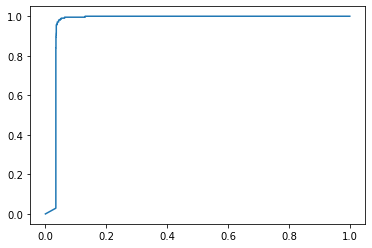

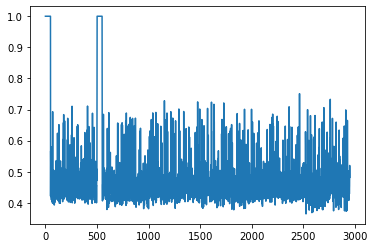

time used:16.620640993118286
TP: 2439 TN: 184 FP: 26 FN: 351
ACC: 0.8743333333333333 Precision: 0.9894523326572008 Recall: 0.8741935483870967 F1: 0.9282588011417697
FPR: 0.12380952380952381 TPR: 0.8741935483870967
AUC: 0.897520908004779


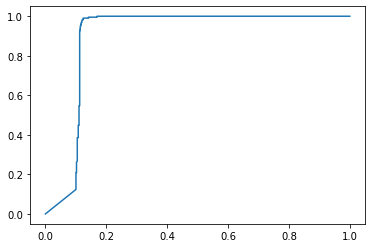

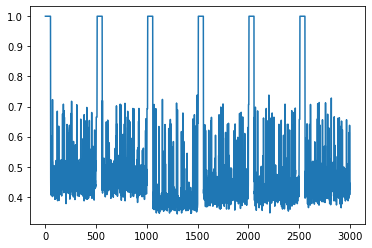

**********
window_size: 50
t: 20
phi: 25
thresh: 0.5
time used:11.160166263580322
TP: 2576 TN: 201 FP: 6 FN: 167
ACC: 0.9413559322033899 Precision: 0.9976762199845082 Recall: 0.9391177542836311 F1: 0.9675117370892019
FPR: 0.028985507246376812 TPR: 0.9391177542836311
AUC: 0.9658471894202371


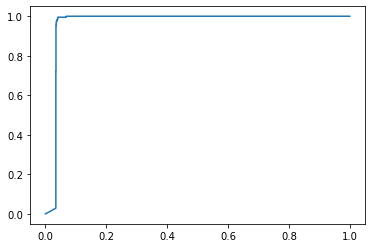

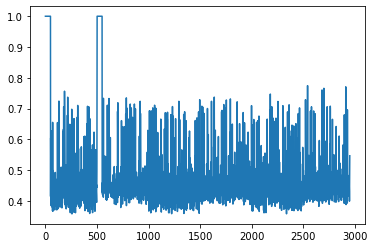

time used:16.47249984741211
TP: 2563 TN: 183 FP: 27 FN: 227
ACC: 0.9153333333333333 Precision: 0.9895752895752896 Recall: 0.9186379928315412 F1: 0.9527881040892194
FPR: 0.12857142857142856 TPR: 0.9186379928315412
AUC: 0.8971650452295613


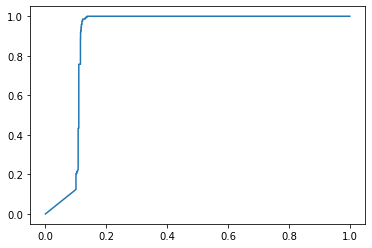

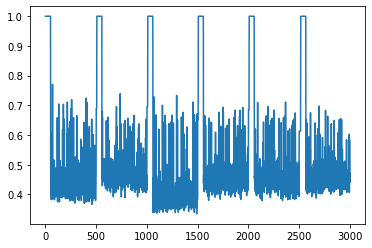

**********
window_size: 50
t: 20
phi: 25
thresh: 0.55
time used:10.968494176864624
TP: 2729 TN: 197 FP: 10 FN: 14
ACC: 0.991864406779661 Precision: 0.9963490324936108 Recall: 0.994896099161502 F1: 0.9956220357533747
FPR: 0.04830917874396135 TPR: 0.994896099161502
AUC: 0.9659229201780201


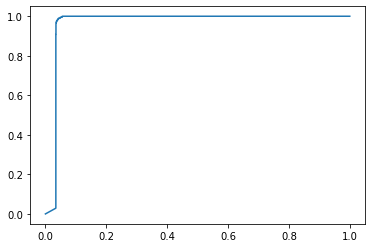

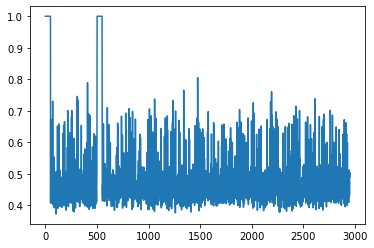

time used:16.0245943069458
TP: 2739 TN: 176 FP: 34 FN: 51
ACC: 0.9716666666666667 Precision: 0.9877389109267941 Recall: 0.9817204301075269 F1: 0.9847204745640842
FPR: 0.1619047619047619 TPR: 0.9817204301075269
AUC: 0.8986917562724015


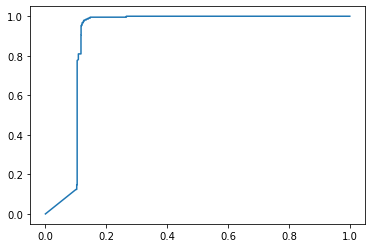

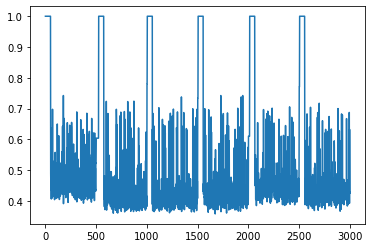

**********
window_size: 50
t: 20
phi: 25
thresh: 0.6
time used:10.933693408966064
TP: 2743 TN: 167 FP: 40 FN: 0
ACC: 0.9864406779661017 Precision: 0.9856270212001438 Recall: 1.0 F1: 0.9927614911328266
FPR: 0.1932367149758454 TPR: 1.0
AUC: 0.9656023853427522


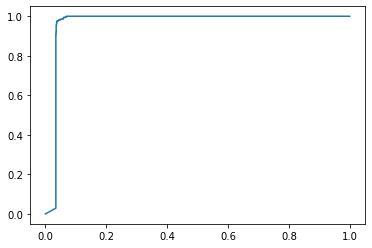

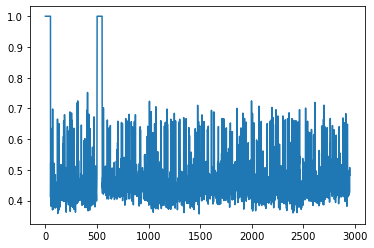

time used:16.54506826400757
TP: 2755 TN: 142 FP: 68 FN: 35
ACC: 0.9656666666666667 Precision: 0.9759121501948282 Recall: 0.9874551971326165 F1: 0.9816497416711205
FPR: 0.3238095238095238 TPR: 0.9874551971326165
AUC: 0.8973306024918929


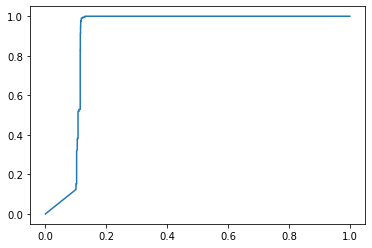

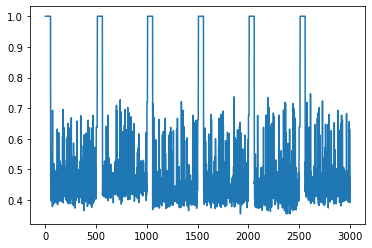

**********
window_size: 50
t: 20
phi: 25
thresh: 0.7
time used:10.956982135772705
TP: 2743 TN: 19 FP: 188 FN: 0
ACC: 0.936271186440678 Precision: 0.9358580689184579 Recall: 1.0 F1: 0.9668664081776525
FPR: 0.9082125603864735 TPR: 1.0
AUC: 0.9657397574150098


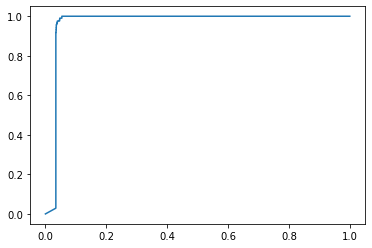

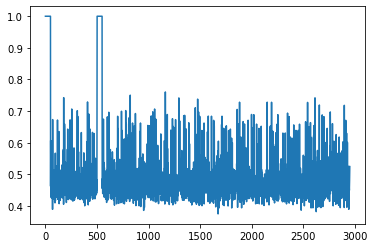

time used:16.579597234725952
TP: 2781 TN: 17 FP: 193 FN: 9
ACC: 0.9326666666666666 Precision: 0.9351042367182246 Recall: 0.9967741935483871 F1: 0.9649548924358085
FPR: 0.919047619047619 TPR: 0.9967741935483871
AUC: 0.8982437275985662


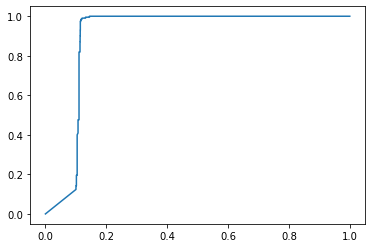

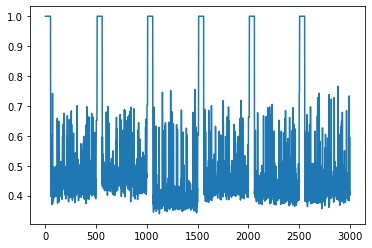

**********
window_size: 50
t: 20
phi: 37
thresh: 0.45
time used:10.967516660690308
TP: 2095 TN: 201 FP: 6 FN: 648
ACC: 0.7783050847457628 Precision: 0.997144217039505 Recall: 0.7637623040466642 F1: 0.8649876135425268
FPR: 0.028985507246376812 TPR: 0.7637623040466642
AUC: 0.9660585310698643


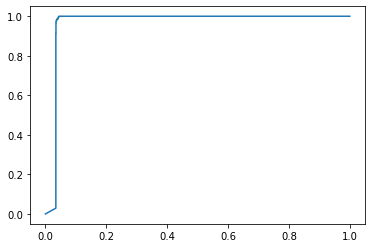

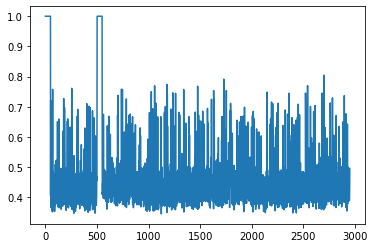

time used:16.435465097427368
TP: 2371 TN: 186 FP: 24 FN: 419
ACC: 0.8523333333333334 Precision: 0.9899791231732776 Recall: 0.8498207885304659 F1: 0.9145612343297974
FPR: 0.11428571428571428 TPR: 0.8498207885304659
AUC: 0.898716504522956


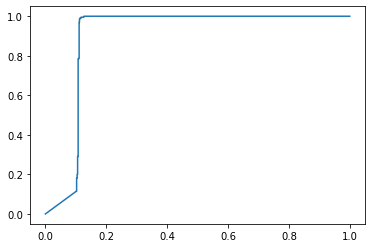

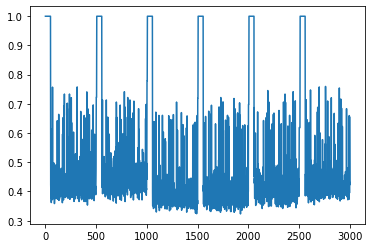

**********
window_size: 50
t: 20
phi: 37
thresh: 0.475
time used:10.959983825683594
TP: 2540 TN: 201 FP: 6 FN: 203
ACC: 0.9291525423728814 Precision: 0.997643362136685 Recall: 0.9259934378417791 F1: 0.9604840234448857
FPR: 0.028985507246376812 TPR: 0.9259934378417791
AUC: 0.9659933673945625


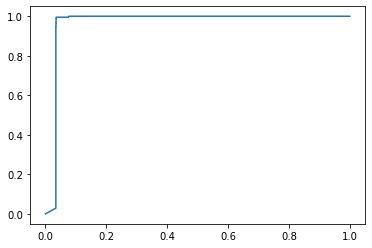

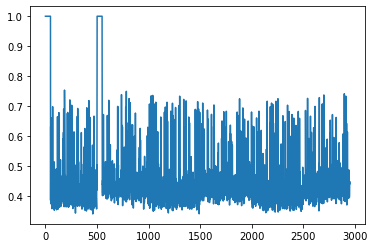

time used:16.620136499404907
TP: 2606 TN: 182 FP: 28 FN: 184
ACC: 0.9293333333333333 Precision: 0.9893697798025817 Recall: 0.9340501792114695 F1: 0.9609144542772861
FPR: 0.13333333333333333 TPR: 0.9340501792114695
AUC: 0.8989196108550948


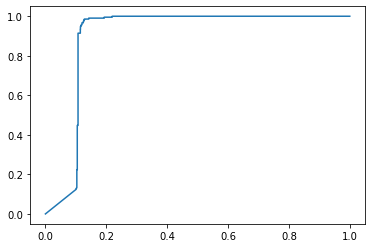

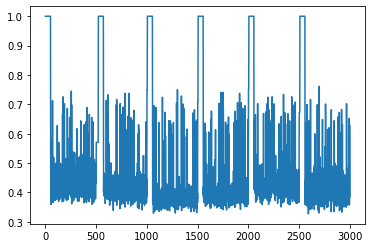

**********
window_size: 50
t: 20
phi: 37
thresh: 0.5
time used:11.074087619781494
TP: 2626 TN: 201 FP: 6 FN: 117
ACC: 0.9583050847457627 Precision: 0.9977203647416414 Recall: 0.957345971563981 F1: 0.9771162790697675
FPR: 0.028985507246376812 TPR: 0.957345971563981
AUC: 0.9659898450337354


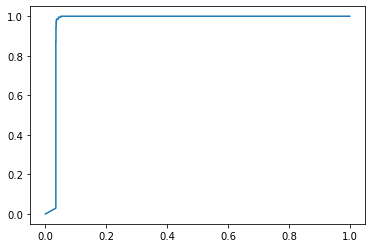

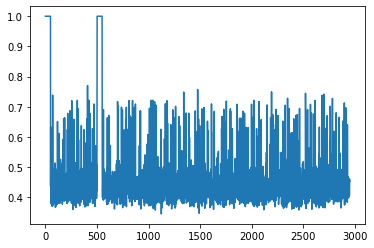

time used:16.996976852416992
TP: 2700 TN: 184 FP: 26 FN: 90
ACC: 0.9613333333333334 Precision: 0.9904622157006603 Recall: 0.967741935483871 F1: 0.9789702683103698
FPR: 0.12380952380952381 TPR: 0.967741935483871
AUC: 0.8990988223246288


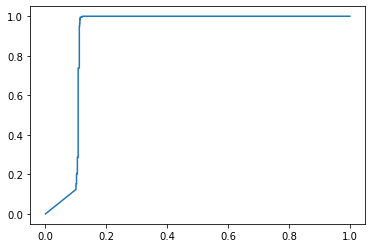

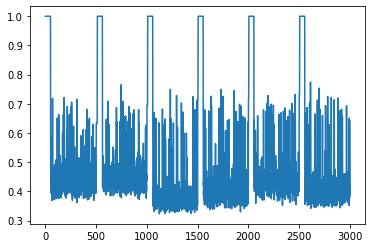

**********
window_size: 50
t: 20
phi: 37
thresh: 0.55
time used:11.001634359359741
TP: 2737 TN: 197 FP: 10 FN: 6
ACC: 0.9945762711864407 Precision: 0.9963596650891882 Recall: 0.997812613926358 F1: 0.9970856102003643
FPR: 0.04830917874396135 TPR: 0.997812613926358
AUC: 0.9657115785283927


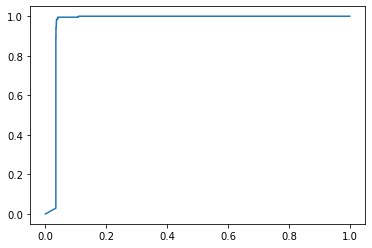

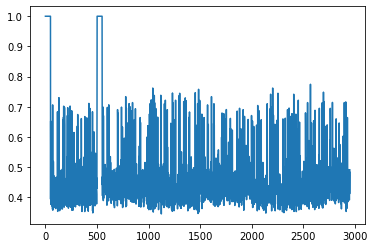

time used:16.70231580734253
TP: 2766 TN: 185 FP: 25 FN: 24
ACC: 0.9836666666666667 Precision: 0.9910426370476532 Recall: 0.9913978494623656 F1: 0.991220211431643
FPR: 0.11904761904761904 TPR: 0.9913978494623656
AUC: 0.8985099846390169


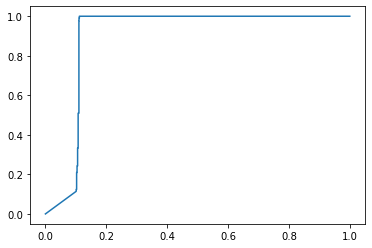

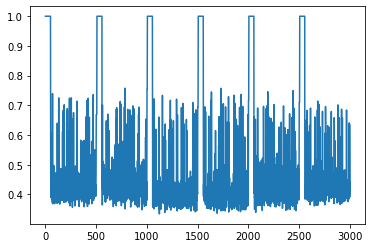

**********
window_size: 50
t: 20
phi: 37
thresh: 0.6
time used:11.030090093612671
TP: 2743 TN: 162 FP: 45 FN: 0
ACC: 0.9847457627118644 Precision: 0.9838593974175036 Recall: 1.0 F1: 0.9918640390526126
FPR: 0.21739130434782608 TPR: 1.0
AUC: 0.9654896697962843


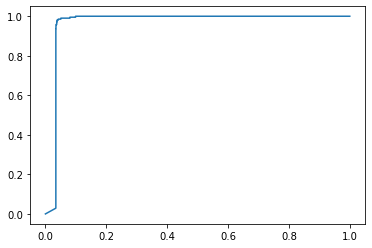

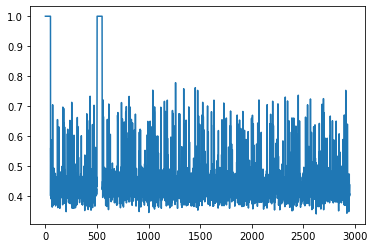

time used:16.701218366622925
TP: 2761 TN: 163 FP: 47 FN: 29
ACC: 0.9746666666666667 Precision: 0.9832621082621082 Recall: 0.9896057347670251 F1: 0.986423722758128
FPR: 0.22380952380952382 TPR: 0.9896057347670251
AUC: 0.899489674005803


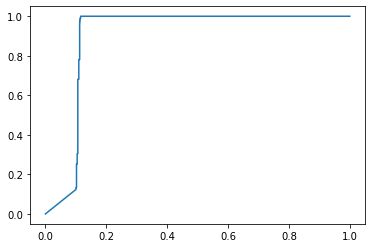

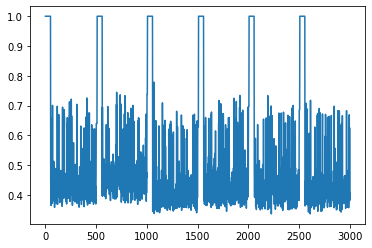

**********
window_size: 50
t: 20
phi: 37
thresh: 0.7
time used:10.97875165939331
TP: 2743 TN: 48 FP: 159 FN: 0
ACC: 0.9461016949152542 Precision: 0.945210199862164 Recall: 1.0 F1: 0.9718334809565987
FPR: 0.7681159420289855 TPR: 1.0
AUC: 0.9660321133636609


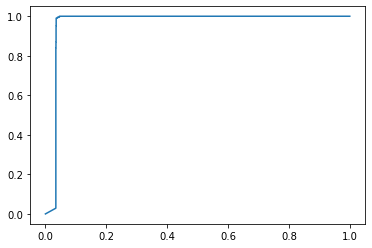

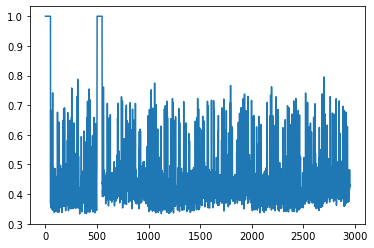

time used:16.653762340545654
TP: 2785 TN: 30 FP: 180 FN: 5
ACC: 0.9383333333333334 Precision: 0.93929173693086 Recall: 0.9982078853046595 F1: 0.9678540399652477
FPR: 0.8571428571428571 TPR: 0.9982078853046595
AUC: 0.8987463731012119


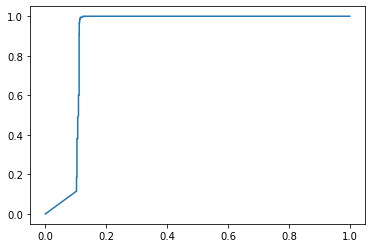

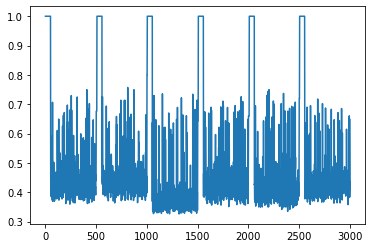

**********
window_size: 50
t: 20
phi: 45
thresh: 0.45
time used:11.001034021377563
TP: 2185 TN: 201 FP: 6 FN: 558
ACC: 0.8088135593220339 Precision: 0.9972615244180739 Recall: 0.7965730951512942 F1: 0.8856911228212403
FPR: 0.028985507246376812 TPR: 0.7965730951512942
AUC: 0.9659986509358032


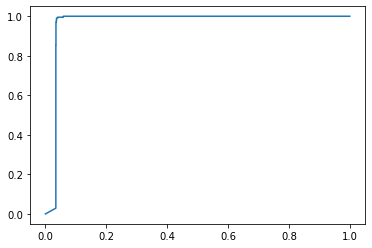

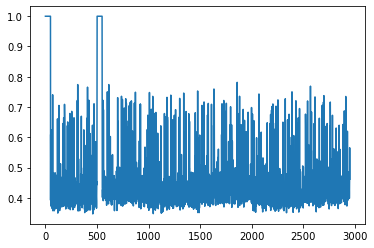

time used:16.59211230278015
TP: 2444 TN: 186 FP: 24 FN: 346
ACC: 0.8766666666666667 Precision: 0.9902755267423015 Recall: 0.8759856630824373 F1: 0.9296310384176494
FPR: 0.11428571428571428 TPR: 0.8759856630824373
AUC: 0.8996791261307392


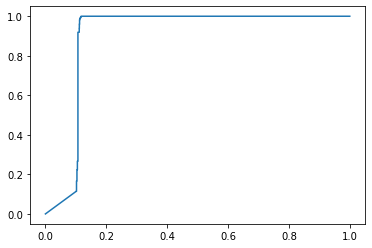

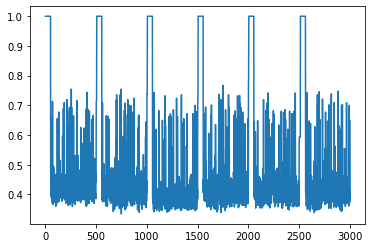

**********
window_size: 50
t: 20
phi: 45
thresh: 0.475
time used:11.05972170829773
TP: 2494 TN: 201 FP: 6 FN: 249
ACC: 0.9135593220338983 Precision: 0.9976 Recall: 0.909223477943857 F1: 0.9513637230593172
FPR: 0.028985507246376812 TPR: 0.909223477943857
AUC: 0.9659757555904269


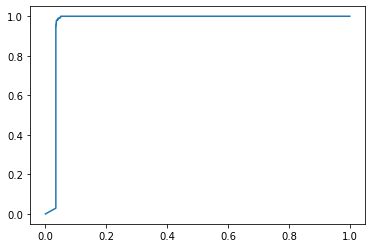

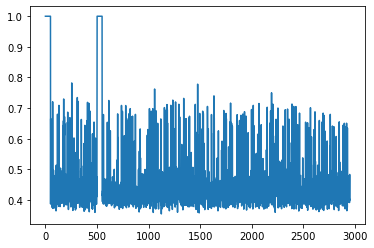

time used:16.68769645690918
TP: 2671 TN: 186 FP: 24 FN: 119
ACC: 0.9523333333333334 Precision: 0.9910946196660483 Recall: 0.9573476702508961 F1: 0.9739288969917959
FPR: 0.11428571428571428 TPR: 0.9573476702508961
AUC: 0.8992985151049667


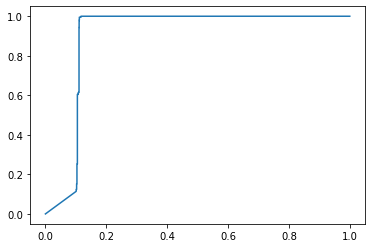

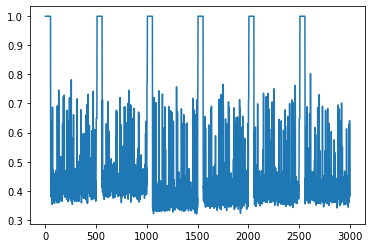

**********
window_size: 50
t: 20
phi: 45
thresh: 0.5
time used:11.021045684814453
TP: 2619 TN: 201 FP: 6 FN: 124
ACC: 0.9559322033898305 Precision: 0.9977142857142857 Recall: 0.954794021144732 F1: 0.9757824143070045
FPR: 0.028985507246376812 TPR: 0.954794021144732
AUC: 0.9662064702246033


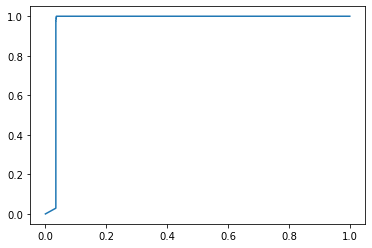

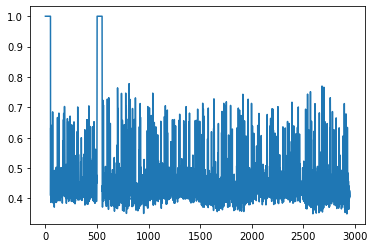

time used:16.747252702713013
TP: 2751 TN: 186 FP: 24 FN: 39
ACC: 0.979 Precision: 0.9913513513513513 Recall: 0.986021505376344 F1: 0.9886792452830188
FPR: 0.11428571428571428 TPR: 0.986021505376344
AUC: 0.8992933947772658


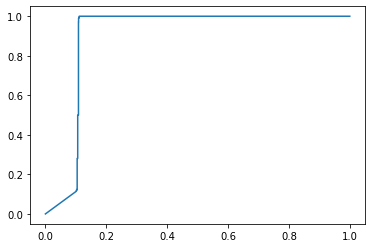

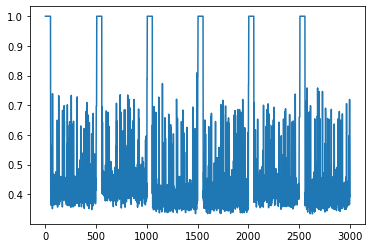

**********
window_size: 50
t: 20
phi: 45
thresh: 0.55
time used:10.983051300048828
TP: 2739 TN: 194 FP: 13 FN: 4
ACC: 0.9942372881355932 Precision: 0.9952761627906976 Recall: 0.998541742617572 F1: 0.9969062784349408
FPR: 0.06280193236714976 TPR: 0.998541742617572
AUC: 0.9661096053018575


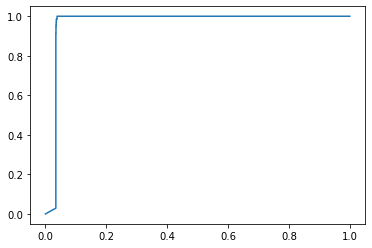

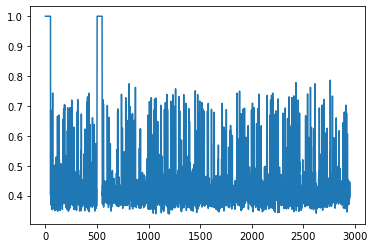

time used:16.755765438079834
TP: 2773 TN: 180 FP: 30 FN: 17
ACC: 0.9843333333333333 Precision: 0.9892971815911523 Recall: 0.9939068100358422 F1: 0.9915966386554622
FPR: 0.14285714285714285 TPR: 0.9939068100358422
AUC: 0.8992729134664619


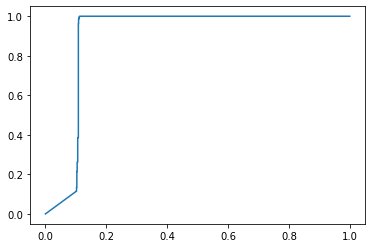

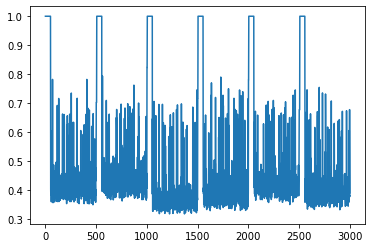

**********
window_size: 50
t: 20
phi: 45
thresh: 0.6
time used:10.974019050598145
TP: 2743 TN: 159 FP: 48 FN: 0
ACC: 0.9837288135593221 Precision: 0.9828018631314941 Recall: 1.0 F1: 0.9913263462233466
FPR: 0.2318840579710145 TPR: 1.0
AUC: 0.9659528602450507


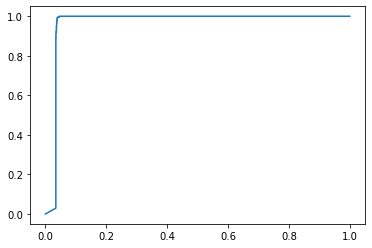

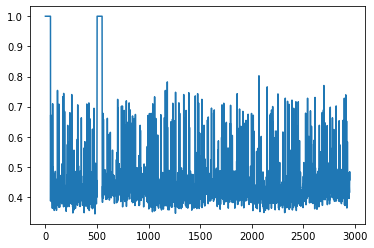

time used:16.73725199699402
TP: 2771 TN: 159 FP: 51 FN: 19
ACC: 0.9766666666666667 Precision: 0.9819277108433735 Recall: 0.9931899641577061 F1: 0.9875267284390592
FPR: 0.24285714285714285 TPR: 0.9931899641577061
AUC: 0.8984937702679638


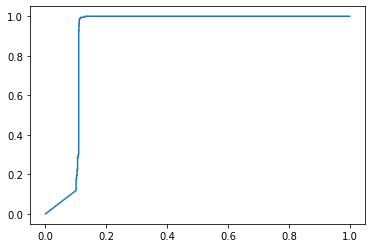

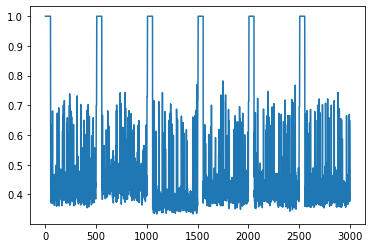

**********
window_size: 50
t: 20
phi: 45
thresh: 0.7
time used:11.043060541152954
TP: 2743 TN: 44 FP: 163 FN: 0
ACC: 0.9447457627118644 Precision: 0.9439091534755678 Recall: 1.0 F1: 0.9711453354576031
FPR: 0.7874396135265701 TPR: 1.0
AUC: 0.9657379962345963


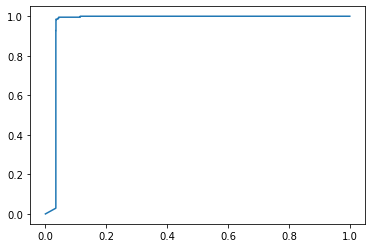

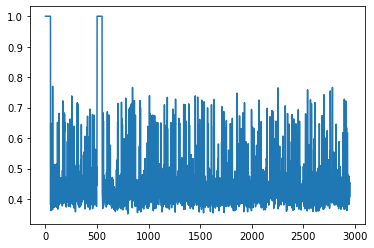

time used:16.70771336555481
TP: 2780 TN: 37 FP: 173 FN: 10
ACC: 0.939 Precision: 0.9414155096512021 Recall: 0.996415770609319 F1: 0.9681351210168901
FPR: 0.8238095238095238 TPR: 0.996415770609319
AUC: 0.8989861751152073


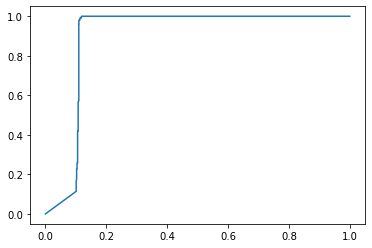

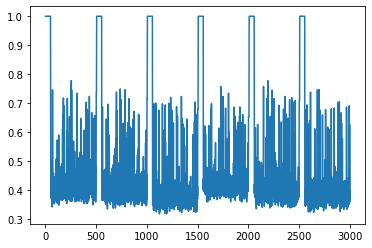

**********
window_size: 50
t: 50
phi: 5
thresh: 0.45
time used:10.990619897842407
TP: 298 TN: 201 FP: 6 FN: 2445
ACC: 0.16915254237288135 Precision: 0.9802631578947368 Recall: 0.1086401749908859 F1: 0.19560223170331473
FPR: 0.028985507246376812 TPR: 0.1086401749908859
AUC: 0.9583472026290901


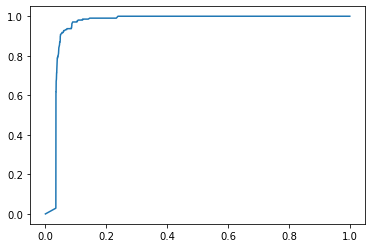

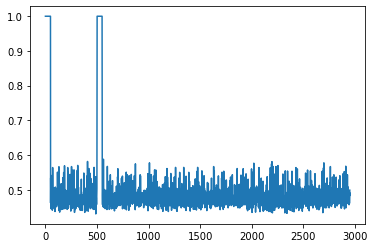

time used:20.066274642944336
TP: 81 TN: 207 FP: 3 FN: 2709
ACC: 0.096 Precision: 0.9642857142857143 Recall: 0.02903225806451613 F1: 0.05636743215031315
FPR: 0.014285714285714285 TPR: 0.02903225806451613
AUC: 0.7387062638675541


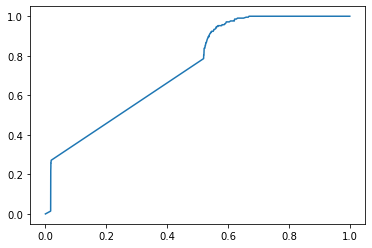

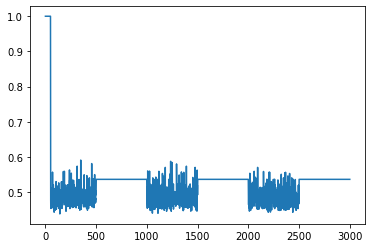

**********
window_size: 50
t: 50
phi: 5
thresh: 0.475
time used:11.164667129516602
TP: 970 TN: 201 FP: 6 FN: 1773
ACC: 0.3969491525423729 Precision: 0.9938524590163934 Recall: 0.35362741523878966 F1: 0.521645603656897
FPR: 0.028985507246376812 TPR: 0.35362741523878966
AUC: 0.9616749530205125


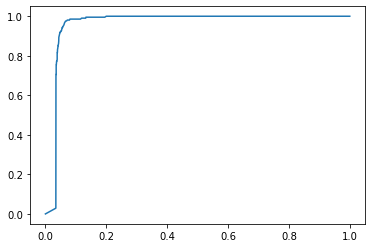

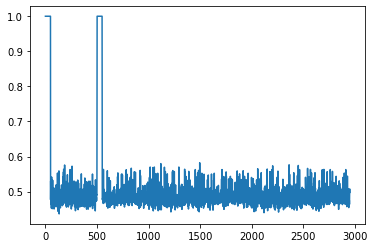

time used:20.056265830993652
TP: 662 TN: 207 FP: 3 FN: 2128
ACC: 0.2896666666666667 Precision: 0.9954887218045113 Recall: 0.23727598566308244 F1: 0.38321273516642546
FPR: 0.014285714285714285 TPR: 0.23727598566308244
AUC: 0.7356306536951698


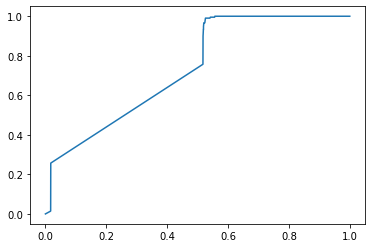

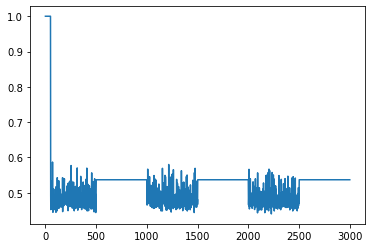

**********
window_size: 50
t: 50
phi: 5
thresh: 0.5
time used:10.97450041770935
TP: 2319 TN: 194 FP: 13 FN: 424
ACC: 0.851864406779661 Precision: 0.9944253859348199 Recall: 0.8454247174626321 F1: 0.9138916256157634
FPR: 0.06280193236714976 TPR: 0.8454247174626321
AUC: 0.944418026738241


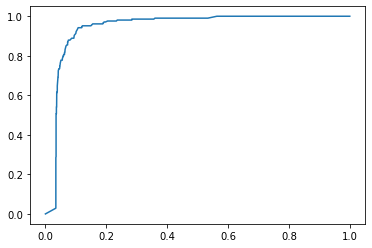

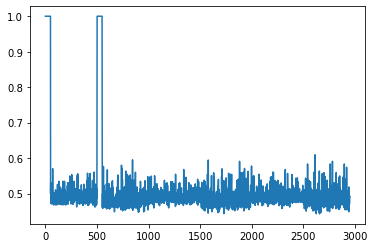

time used:17.343796253204346
TP: 1653 TN: 194 FP: 16 FN: 1137
ACC: 0.6156666666666667 Precision: 0.9904134212103056 Recall: 0.5924731182795699 F1: 0.7414218434626598
FPR: 0.0761904761904762 TPR: 0.5924731182795699
AUC: 0.8243505717699265


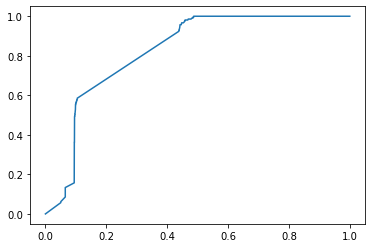

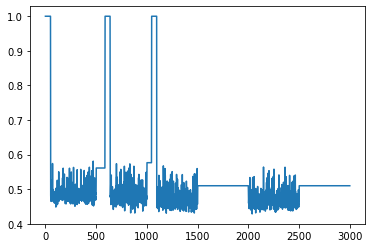

**********
window_size: 50
t: 50
phi: 5
thresh: 0.55
time used:10.985007286071777
TP: 2739 TN: 70 FP: 137 FN: 4
ACC: 0.9522033898305085 Precision: 0.9523643949930459 Recall: 0.998541742617572 F1: 0.9749065670048052
FPR: 0.6618357487922706 TPR: 0.998541742617572
AUC: 0.9428065466598332


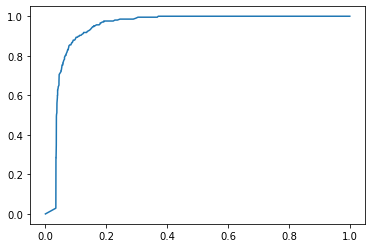

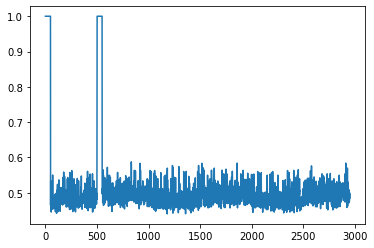

time used:20.079285860061646
TP: 2790 TN: 32 FP: 178 FN: 0
ACC: 0.9406666666666667 Precision: 0.9400269541778976 Recall: 1.0 F1: 0.9690864883640153
FPR: 0.8476190476190476 TPR: 1.0
AUC: 0.8204198668714797


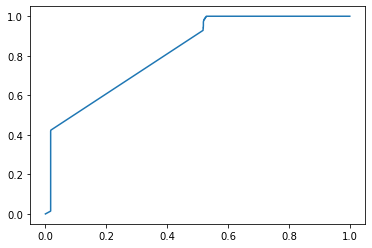

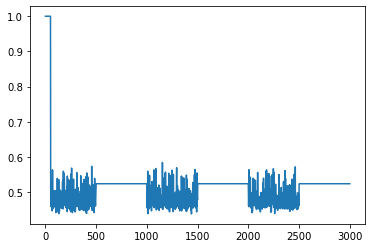

**********
window_size: 50
t: 50
phi: 5
thresh: 0.6
time used:11.030550956726074
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9548697519025151


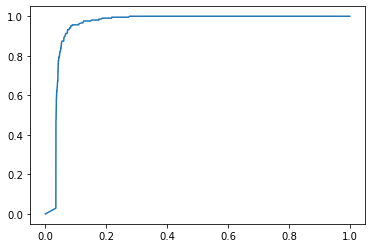

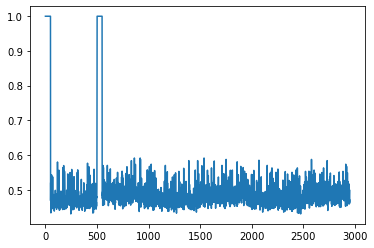

time used:20.133335828781128
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8232266598395631


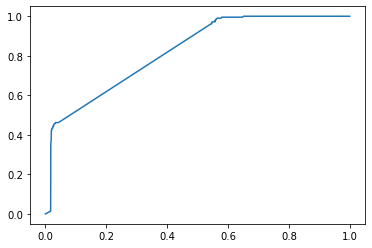

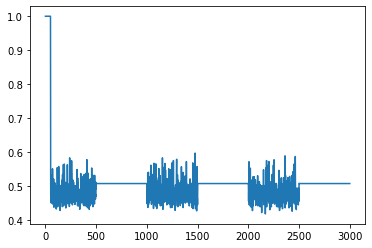

**********
window_size: 50
t: 50
phi: 5
thresh: 0.7
time used:11.504480123519897
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9549683780056746


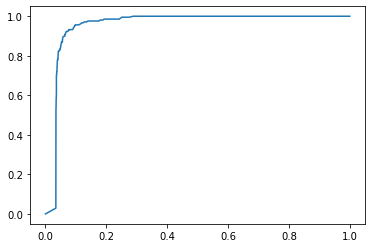

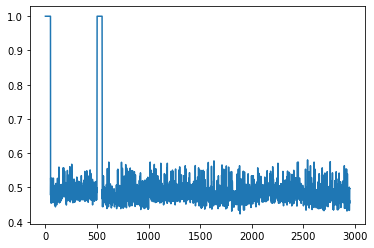

time used:20.055264234542847
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8260274790919953


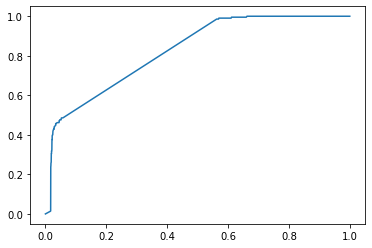

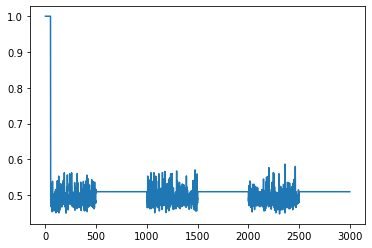

**********
window_size: 50
t: 50
phi: 12
thresh: 0.45
time used:11.139685869216919
TP: 292 TN: 201 FP: 6 FN: 2451
ACC: 0.1671186440677966 Precision: 0.9798657718120806 Recall: 0.1064527889172439 F1: 0.19204209141729697
FPR: 0.028985507246376812 TPR: 0.1064527889172439
AUC: 0.965422744940569


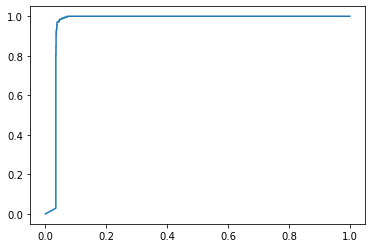

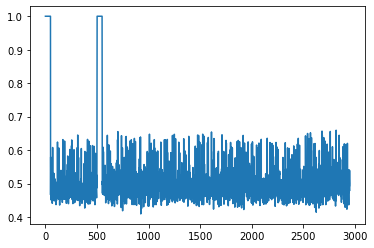

time used:15.099248886108398
TP: 820 TN: 186 FP: 24 FN: 1970
ACC: 0.3353333333333333 Precision: 0.9715639810426541 Recall: 0.2939068100358423 F1: 0.4512933406714364
FPR: 0.11428571428571428 TPR: 0.2939068100358423
AUC: 0.885084485407066


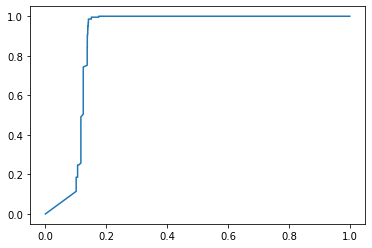

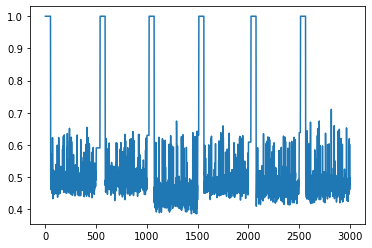

**********
window_size: 50
t: 50
phi: 12
thresh: 0.475
time used:11.102113246917725
TP: 835 TN: 201 FP: 6 FN: 1908
ACC: 0.3511864406779661 Precision: 0.9928656361474435 Recall: 0.3044112285818447 F1: 0.4659598214285714
FPR: 0.028985507246376812 TPR: 0.3044112285818447
AUC: 0.9658049210903115


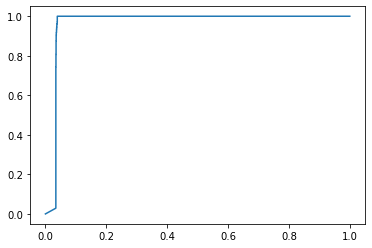

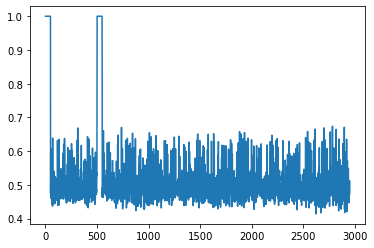

time used:15.554166555404663
TP: 1963 TN: 182 FP: 28 FN: 827
ACC: 0.715 Precision: 0.9859367152184831 Recall: 0.703584229390681 F1: 0.8211671198494038
FPR: 0.13333333333333333 TPR: 0.703584229390681
AUC: 0.8900989930022188


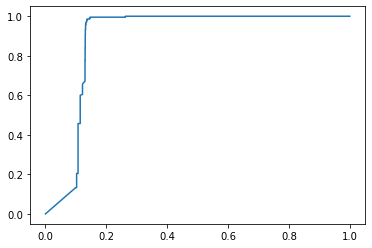

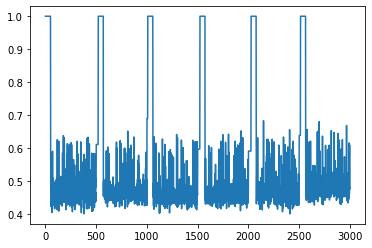

**********
window_size: 50
t: 50
phi: 12
thresh: 0.5
time used:11.101112127304077
TP: 2040 TN: 201 FP: 6 FN: 703
ACC: 0.7596610169491526 Precision: 0.9970674486803519 Recall: 0.7437112650382792 F1: 0.851952390895803
FPR: 0.028985507246376812 TPR: 0.7437112650382792
AUC: 0.9656587431159861


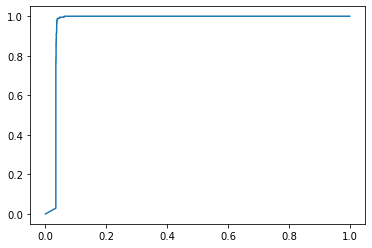

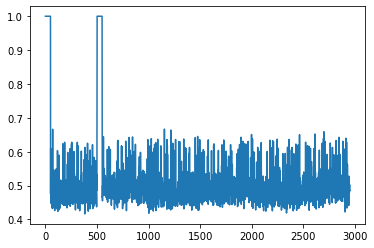

time used:14.978641986846924
TP: 2240 TN: 187 FP: 23 FN: 550
ACC: 0.809 Precision: 0.9898365002209456 Recall: 0.8028673835125448 F1: 0.8866020186028102
FPR: 0.10952380952380952 TPR: 0.8028673835125448
AUC: 0.8856169994879672


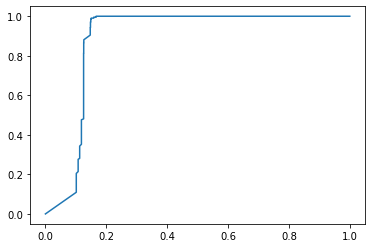

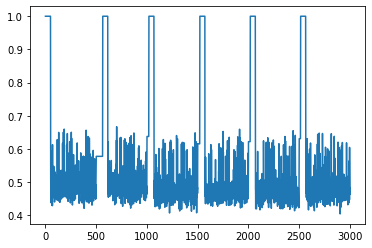

**********
window_size: 50
t: 50
phi: 12
thresh: 0.55
time used:11.124133825302124
TP: 2712 TN: 196 FP: 11 FN: 31
ACC: 0.9857627118644068 Precision: 0.9959603378626515 Recall: 0.988698505286183 F1: 0.9923161361141604
FPR: 0.05314009661835749 TPR: 0.988698505286183
AUC: 0.9652307762754909


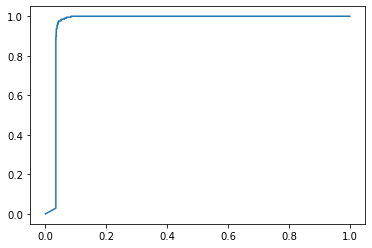

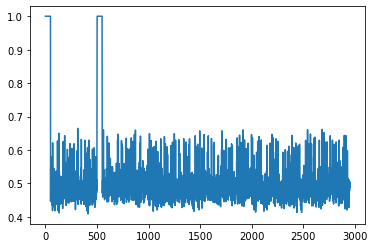

time used:15.97254729270935
TP: 2705 TN: 175 FP: 35 FN: 85
ACC: 0.96 Precision: 0.9872262773722628 Recall: 0.9695340501792115 F1: 0.9783001808318263
FPR: 0.16666666666666666 TPR: 0.9695340501792115
AUC: 0.8898933265062297


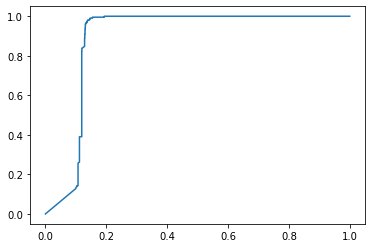

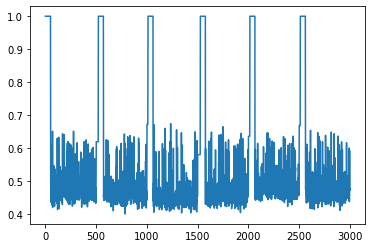

**********
window_size: 50
t: 50
phi: 12
thresh: 0.6
time used:11.098713636398315
TP: 2743 TN: 120 FP: 87 FN: 0
ACC: 0.9705084745762712 Precision: 0.9692579505300354 Recall: 1.0 F1: 0.9843890184819667
FPR: 0.42028985507246375 TPR: 1.0
AUC: 0.9658348611573421


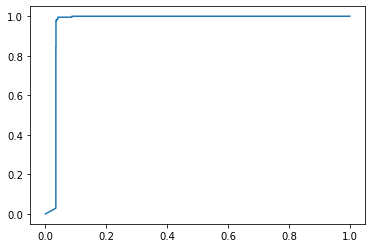

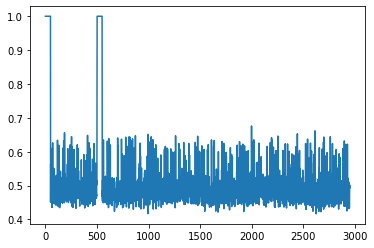

time used:15.286923170089722
TP: 2751 TN: 107 FP: 103 FN: 39
ACC: 0.9526666666666667 Precision: 0.9639103013314646 Recall: 0.986021505376344 F1: 0.9748405386250886
FPR: 0.49047619047619045 TPR: 0.986021505376344
AUC: 0.8897431302270011


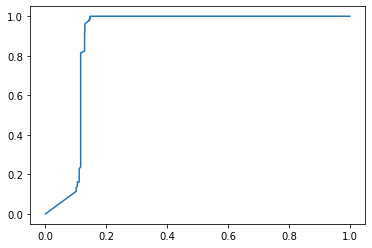

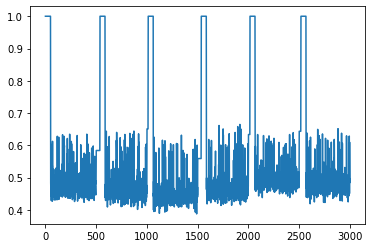

**********
window_size: 50
t: 50
phi: 12
thresh: 0.7
time used:11.115375757217407
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9650810759403383


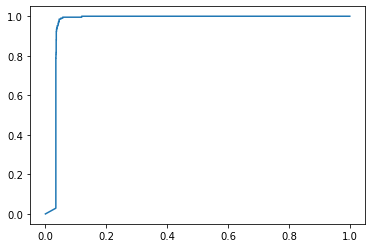

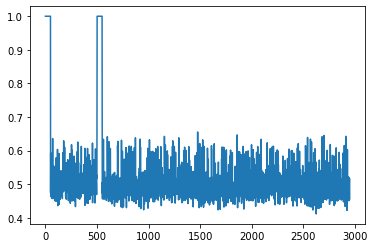

time used:15.021178245544434
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8897217955282472


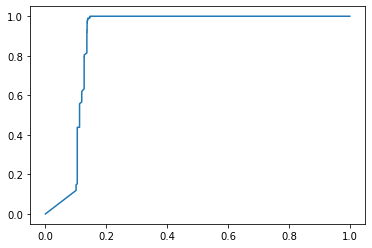

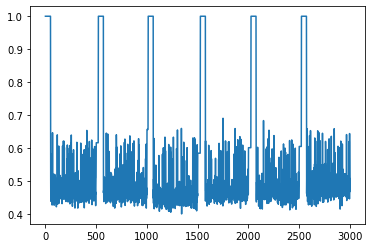

**********
window_size: 50
t: 50
phi: 25
thresh: 0.45
time used:11.164772510528564
TP: 1628 TN: 201 FP: 6 FN: 1115
ACC: 0.62 Precision: 0.996328029375765 Recall: 0.5935107546481954 F1: 0.743888508110578
FPR: 0.028985507246376812 TPR: 0.5935107546481954
AUC: 0.9662223208483254


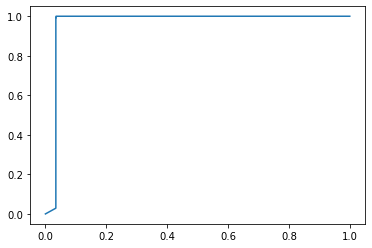

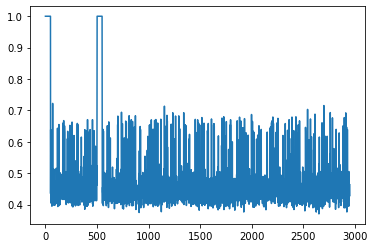

time used:16.782576084136963
TP: 2186 TN: 183 FP: 27 FN: 604
ACC: 0.7896666666666666 Precision: 0.9877993673746046 Recall: 0.7835125448028674 F1: 0.8738756745952428
FPR: 0.12857142857142856 TPR: 0.7835125448028674
AUC: 0.898441713603004


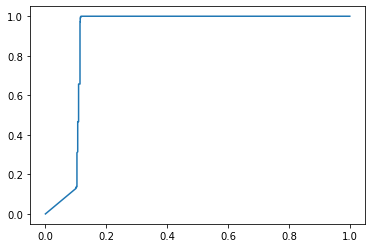

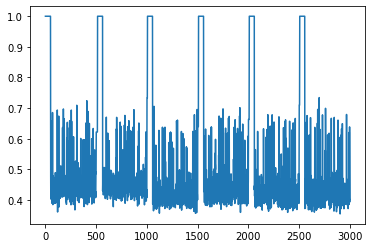

**********
window_size: 50
t: 50
phi: 25
thresh: 0.475
time used:11.143150806427002
TP: 2273 TN: 201 FP: 6 FN: 470
ACC: 0.8386440677966102 Precision: 0.9973672663448881 Recall: 0.8286547575647102 F1: 0.9052170450019913
FPR: 0.028985507246376812 TPR: 0.8286547575647102
AUC: 0.9661483512709559


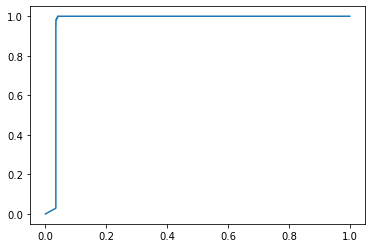

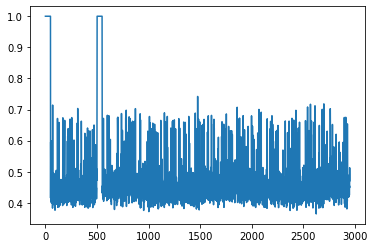

time used:16.70471692085266
TP: 2550 TN: 184 FP: 26 FN: 240
ACC: 0.9113333333333333 Precision: 0.9899068322981367 Recall: 0.9139784946236559 F1: 0.9504286246738726
FPR: 0.12380952380952381 TPR: 0.9139784946236559
AUC: 0.8982957842635262


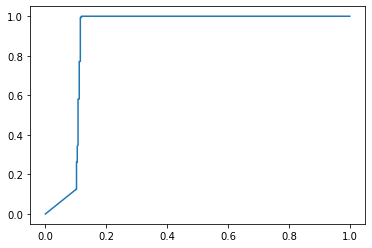

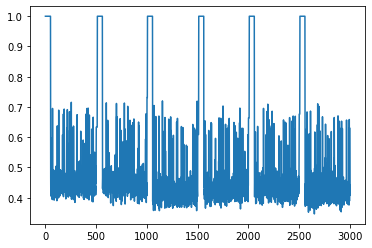

**********
window_size: 50
t: 50
phi: 25
thresh: 0.5
time used:11.224225044250488
TP: 2538 TN: 201 FP: 6 FN: 205
ACC: 0.9284745762711865 Precision: 0.9976415094339622 Recall: 0.9252643091505651 F1: 0.9600907887270664
FPR: 0.028985507246376812 TPR: 0.9252643091505651
AUC: 0.9661870972400541


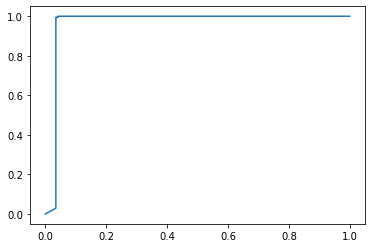

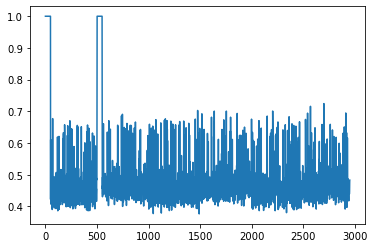

time used:16.74875044822693
TP: 2661 TN: 185 FP: 25 FN: 129
ACC: 0.9486666666666667 Precision: 0.990692479523455 Recall: 0.953763440860215 F1: 0.9718772826880935
FPR: 0.11904761904761904 TPR: 0.953763440860215
AUC: 0.8967827274278888


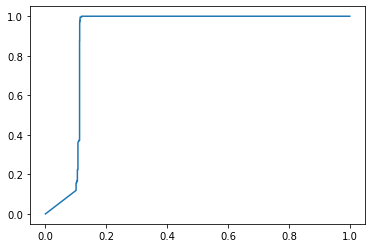

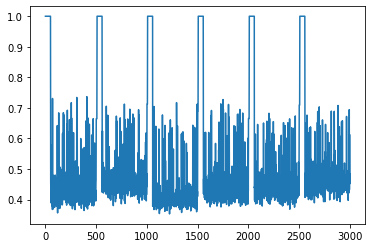

**********
window_size: 50
t: 50
phi: 25
thresh: 0.55
time used:11.19493317604065
TP: 2740 TN: 201 FP: 6 FN: 3
ACC: 0.9969491525423729 Precision: 0.9978150036416606 Recall: 0.998906306963179 F1: 0.998360357077792
FPR: 0.028985507246376812 TPR: 0.998906306963179
AUC: 0.9662223208483254


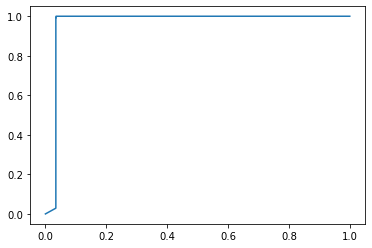

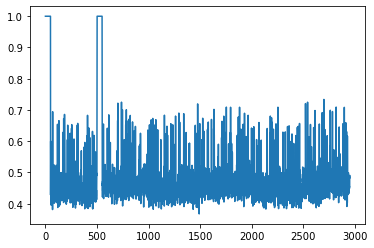

time used:15.917994737625122
TP: 2752 TN: 178 FP: 32 FN: 38
ACC: 0.9766666666666667 Precision: 0.9885057471264368 Recall: 0.9863799283154122 F1: 0.9874416935773233
FPR: 0.1523809523809524 TPR: 0.9863799283154122
AUC: 0.8981566820276498


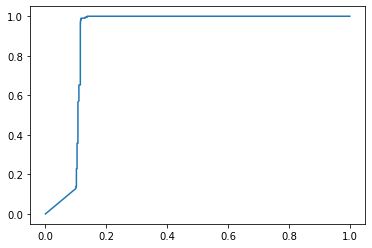

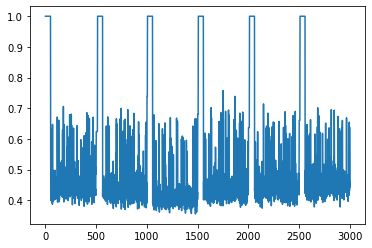

**********
window_size: 50
t: 50
phi: 25
thresh: 0.6
time used:11.180184364318848
TP: 2743 TN: 179 FP: 28 FN: 0
ACC: 0.9905084745762712 Precision: 0.9898953446409239 Recall: 1.0 F1: 0.9949220166848023
FPR: 0.13526570048309178 TPR: 1.0
AUC: 0.9660796652348269


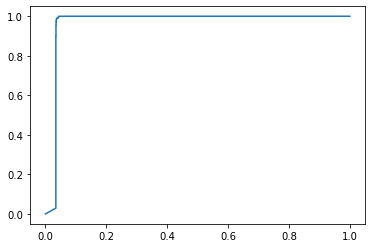

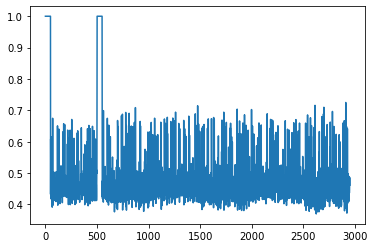

time used:16.773276805877686
TP: 2760 TN: 157 FP: 53 FN: 30
ACC: 0.9723333333333334 Precision: 0.9811589050835408 Recall: 0.989247311827957 F1: 0.9851865072282706
FPR: 0.2523809523809524 TPR: 0.989247311827957
AUC: 0.8966521590715139


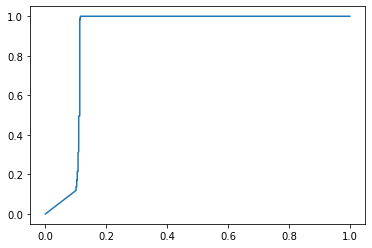

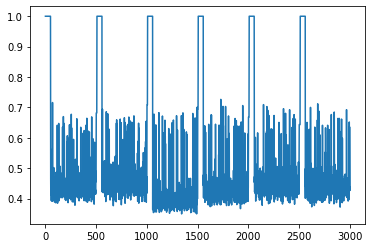

**********
window_size: 50
t: 50
phi: 25
thresh: 0.7
time used:11.167259931564331
TP: 2743 TN: 9 FP: 198 FN: 0
ACC: 0.9328813559322033 Precision: 0.9326759605576335 Recall: 1.0 F1: 0.9651653764954257
FPR: 0.9565217391304348 TPR: 1.0
AUC: 0.9662029478637763


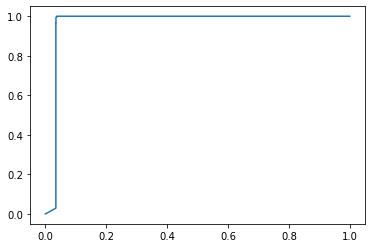

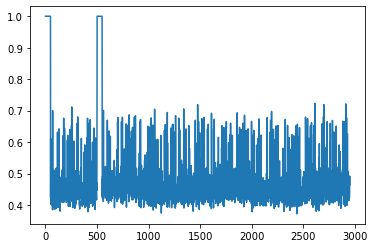

time used:16.49201989173889
TP: 2785 TN: 4 FP: 206 FN: 5
ACC: 0.9296666666666666 Precision: 0.9311267134737546 Recall: 0.9982078853046595 F1: 0.9635011243729458
FPR: 0.9809523809523809 TPR: 0.9982078853046595
AUC: 0.8981780167264038


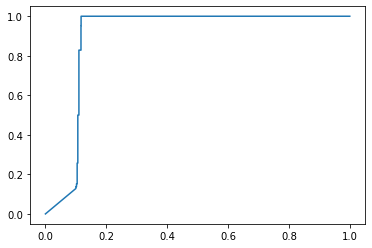

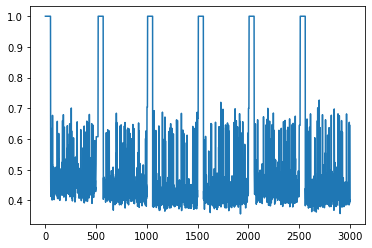

**********
window_size: 50
t: 50
phi: 37
thresh: 0.45
time used:11.27404236793518
TP: 1978 TN: 201 FP: 6 FN: 765
ACC: 0.7386440677966102 Precision: 0.9969758064516129 Recall: 0.7211082756106453 F1: 0.8368944362174741
FPR: 0.028985507246376812 TPR: 0.7211082756106453
AUC: 0.9662205596679119


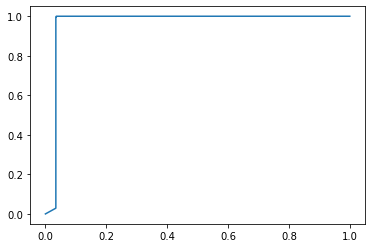

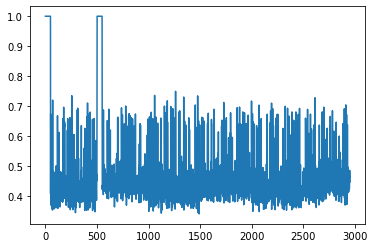

time used:16.805306434631348
TP: 2470 TN: 184 FP: 26 FN: 320
ACC: 0.8846666666666667 Precision: 0.9895833333333334 Recall: 0.8853046594982079 F1: 0.9345440786984489
FPR: 0.12380952380952381 TPR: 0.8853046594982079
AUC: 0.900073391363714


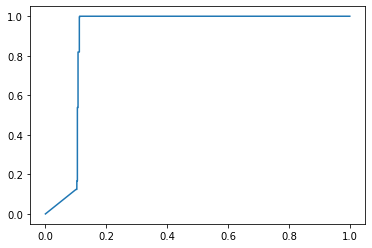

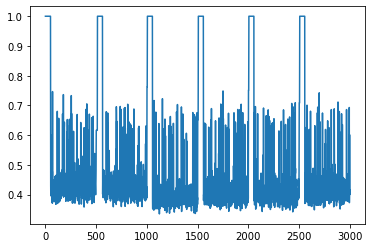

**********
window_size: 50
t: 50
phi: 37
thresh: 0.475
time used:11.230431079864502
TP: 2260 TN: 201 FP: 6 FN: 483
ACC: 0.8342372881355932 Precision: 0.9973521624007061 Recall: 0.8239154210718191 F1: 0.9023757236973449
FPR: 0.028985507246376812 TPR: 0.8239154210718191
AUC: 0.9662152761266712


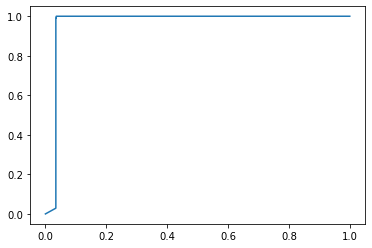

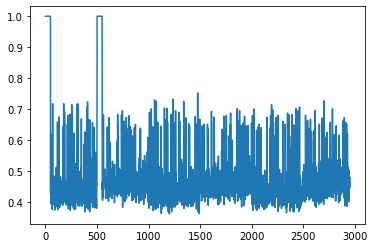

time used:16.829824447631836
TP: 2640 TN: 184 FP: 26 FN: 150
ACC: 0.9413333333333334 Precision: 0.9902475618904726 Recall: 0.946236559139785 F1: 0.967741935483871
FPR: 0.12380952380952381 TPR: 0.946236559139785
AUC: 0.8993667861409796


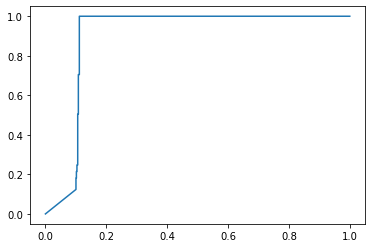

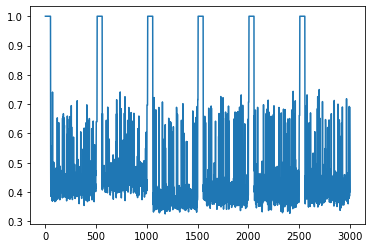

**********
window_size: 50
t: 50
phi: 37
thresh: 0.5
time used:11.236732482910156
TP: 2700 TN: 201 FP: 6 FN: 43
ACC: 0.9833898305084746 Precision: 0.9977827050997783 Recall: 0.984323733138899 F1: 0.9910075243163884
FPR: 0.028985507246376812 TPR: 0.984323733138899
AUC: 0.9662135149462576


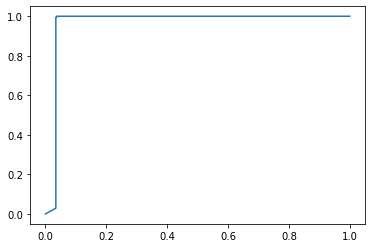

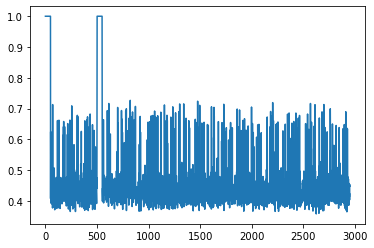

time used:16.922412872314453
TP: 2729 TN: 185 FP: 25 FN: 61
ACC: 0.9713333333333334 Precision: 0.9909222948438635 Recall: 0.9781362007168459 F1: 0.9844877344877346
FPR: 0.11904761904761904 TPR: 0.9781362007168459
AUC: 0.8985176651305683


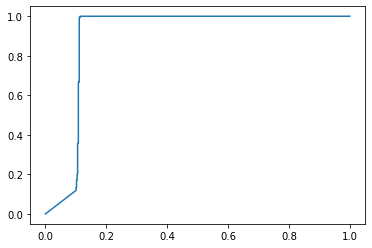

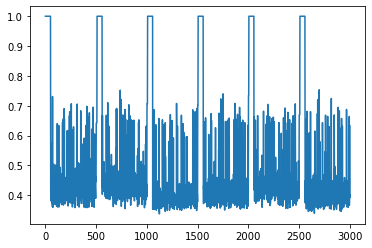

**********
window_size: 50
t: 50
phi: 37
thresh: 0.55
time used:11.251249074935913
TP: 2741 TN: 200 FP: 7 FN: 2
ACC: 0.9969491525423729 Precision: 0.99745269286754 Recall: 0.999270871308786 F1: 0.9983609542888363
FPR: 0.033816425120772944 TPR: 0.999270871308786
AUC: 0.9662205596679119


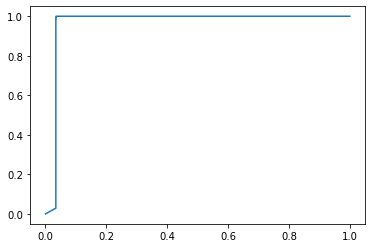

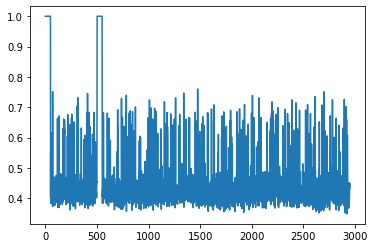

time used:16.86986780166626
TP: 2770 TN: 184 FP: 26 FN: 20
ACC: 0.9846666666666667 Precision: 0.9907010014306151 Recall: 0.992831541218638 F1: 0.991765127103473
FPR: 0.12380952380952381 TPR: 0.992831541218638
AUC: 0.8983666154633896


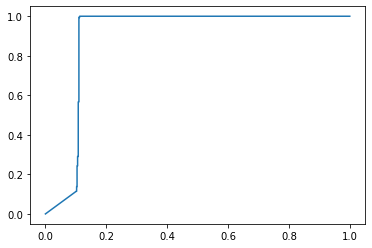

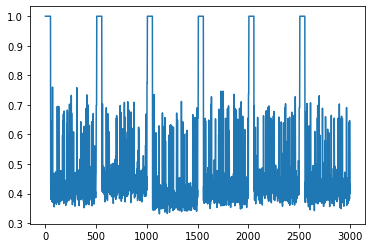

**********
window_size: 50
t: 50
phi: 37
thresh: 0.6
time used:11.281321048736572
TP: 2743 TN: 177 FP: 30 FN: 0
ACC: 0.9898305084745763 Precision: 0.98918139199423 Recall: 1.0 F1: 0.9945612762871646
FPR: 0.14492753623188406 TPR: 1.0
AUC: 0.9662276043895661


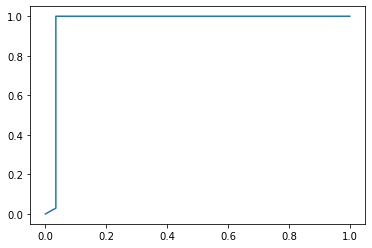

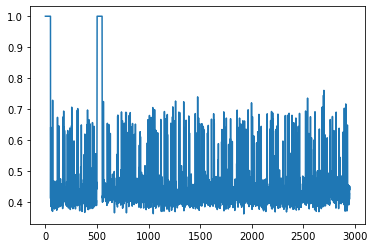

time used:16.920907497406006
TP: 2770 TN: 160 FP: 50 FN: 20
ACC: 0.9766666666666667 Precision: 0.9822695035460993 Recall: 0.992831541218638 F1: 0.9875222816399288
FPR: 0.23809523809523808 TPR: 0.992831541218638
AUC: 0.8980303806110258


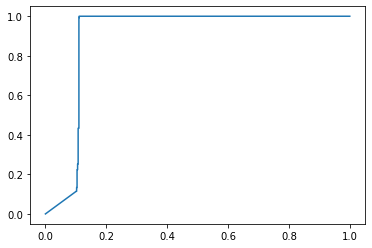

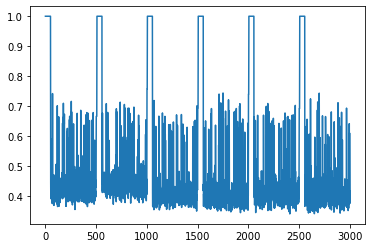

**********
window_size: 50
t: 50
phi: 37
thresh: 0.7
time used:11.267379760742188
TP: 2743 TN: 28 FP: 179 FN: 0
ACC: 0.939322033898305 Precision: 0.9387405886379192 Recall: 1.0 F1: 0.9684024713150926
FPR: 0.8647342995169082 TPR: 1.0
AUC: 0.966208231405017


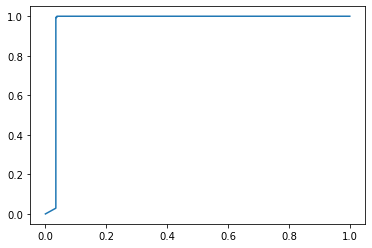

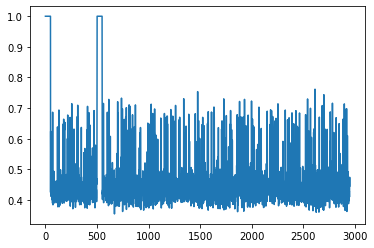

time used:16.81482243537903
TP: 2783 TN: 22 FP: 188 FN: 7
ACC: 0.935 Precision: 0.9367216425445978 Recall: 0.9974910394265233 F1: 0.966151709772609
FPR: 0.8952380952380953 TPR: 0.9974910394265233
AUC: 0.8983009045912271


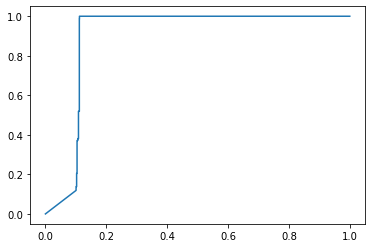

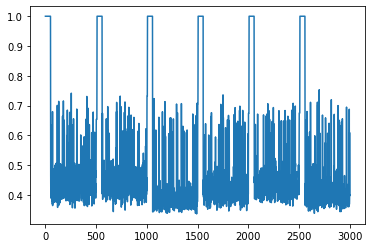

**********
window_size: 50
t: 50
phi: 45
thresh: 0.45
time used:11.20170783996582
TP: 2240 TN: 201 FP: 6 FN: 503
ACC: 0.827457627118644 Precision: 0.9973285841495992 Recall: 0.8166241341596792 F1: 0.8979755462016437
FPR: 0.028985507246376812 TPR: 0.8166241341596792
AUC: 0.9662205596679119


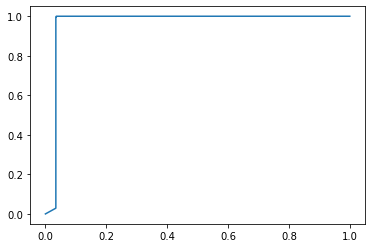

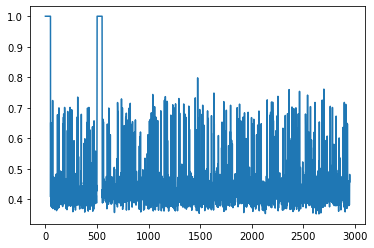

time used:16.873367309570312
TP: 2532 TN: 186 FP: 24 FN: 258
ACC: 0.906 Precision: 0.9906103286384976 Recall: 0.9075268817204301 F1: 0.9472502805836138
FPR: 0.11428571428571428 TPR: 0.9075268817204301
AUC: 0.8989878818911077


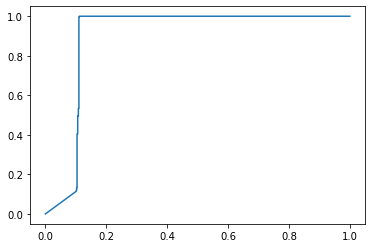

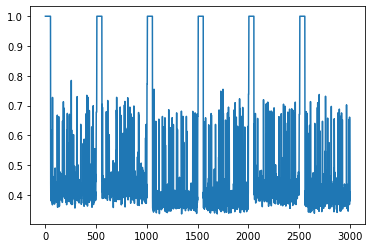

**********
window_size: 50
t: 50
phi: 45
thresh: 0.475
time used:11.228271245956421
TP: 2598 TN: 201 FP: 6 FN: 145
ACC: 0.9488135593220339 Precision: 0.9976958525345622 Recall: 0.9471381698869851 F1: 0.9717598653450533
FPR: 0.028985507246376812 TPR: 0.9471381698869851
AUC: 0.9662152761266711


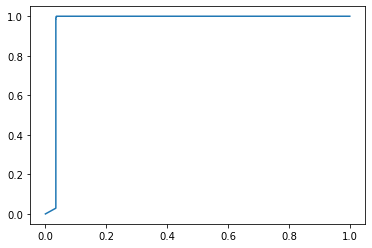

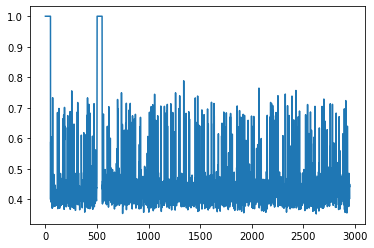

time used:16.569594860076904
TP: 2722 TN: 186 FP: 24 FN: 68
ACC: 0.9693333333333334 Precision: 0.9912600145666424 Recall: 0.9756272401433692 F1: 0.9833815028901735
FPR: 0.11428571428571428 TPR: 0.9756272401433692
AUC: 0.8997405700631507


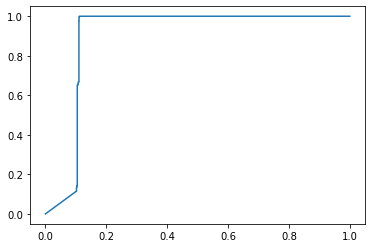

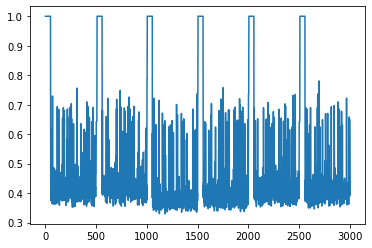

**********
window_size: 50
t: 50
phi: 45
thresh: 0.5
time used:11.225225925445557
TP: 2727 TN: 201 FP: 6 FN: 16
ACC: 0.9925423728813559 Precision: 0.9978046103183315 Recall: 0.994166970470288 F1: 0.995982468955442
FPR: 0.028985507246376812 TPR: 0.994166970470288
AUC: 0.9662223208483254


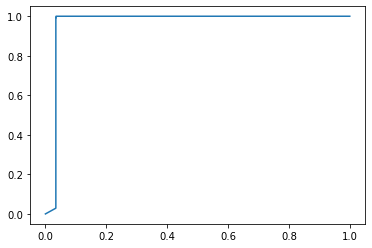

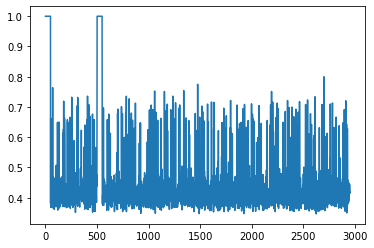

time used:16.34338879585266
TP: 2758 TN: 185 FP: 25 FN: 32
ACC: 0.981 Precision: 0.9910168882500898 Recall: 0.9885304659498207 F1: 0.9897721155571506
FPR: 0.11904761904761904 TPR: 0.9885304659498207
AUC: 0.8989955623826592


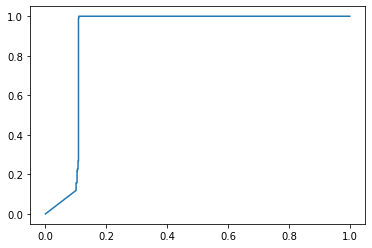

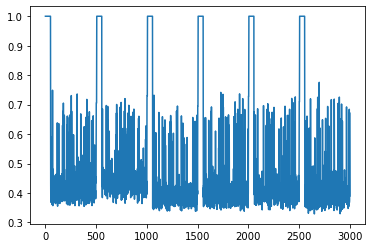

**********
window_size: 50
t: 50
phi: 45
thresh: 0.55
time used:11.221221685409546
TP: 2743 TN: 194 FP: 13 FN: 0
ACC: 0.995593220338983 Precision: 0.9952830188679245 Recall: 1.0 F1: 0.9976359338061466
FPR: 0.06280193236714976 TPR: 1.0
AUC: 0.9662187984874983


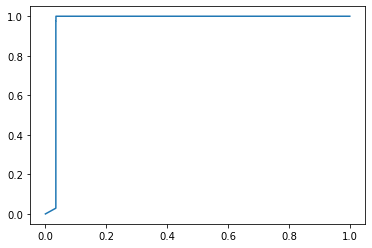

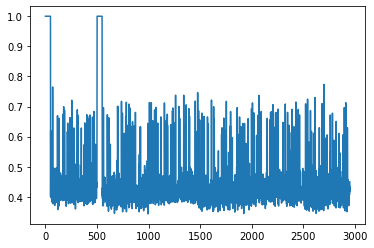

time used:16.94192671775818
TP: 2769 TN: 184 FP: 26 FN: 21
ACC: 0.9843333333333333 Precision: 0.9906976744186047 Recall: 0.9924731182795699 F1: 0.9915846016114592
FPR: 0.12380952380952381 TPR: 0.9924731182795699
AUC: 0.898436593275303


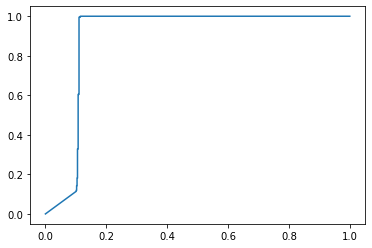

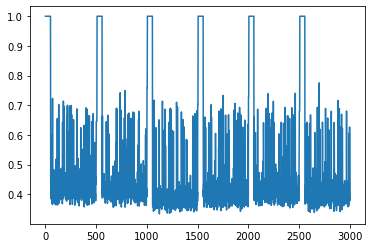

**********
window_size: 50
t: 50
phi: 45
thresh: 0.6
time used:11.243745565414429
TP: 2743 TN: 178 FP: 29 FN: 0
ACC: 0.9901694915254238 Precision: 0.9895382395382395 Recall: 1.0 F1: 0.9947416137805983
FPR: 0.14009661835748793 TPR: 1.0
AUC: 0.9662205596679119


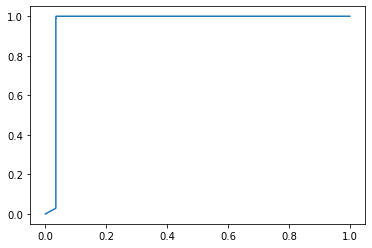

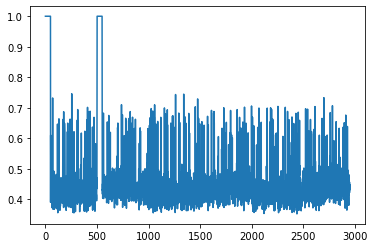

time used:16.90189003944397
TP: 2771 TN: 163 FP: 47 FN: 19
ACC: 0.978 Precision: 0.9833215046132009 Recall: 0.9931899641577061 F1: 0.9882310984308131
FPR: 0.22380952380952382 TPR: 0.9931899641577061
AUC: 0.8991602662570405


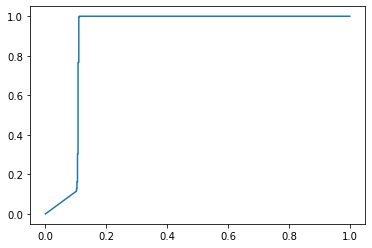

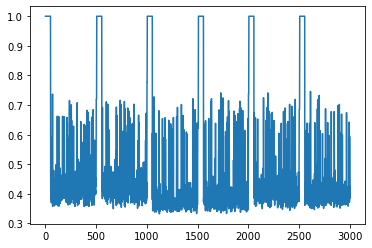

**********
window_size: 50
t: 50
phi: 45
thresh: 0.7
time used:11.214712381362915
TP: 2743 TN: 44 FP: 163 FN: 0
ACC: 0.9447457627118644 Precision: 0.9439091534755678 Recall: 1.0 F1: 0.9711453354576031
FPR: 0.7874396135265701 TPR: 1.0
AUC: 0.966224082028739


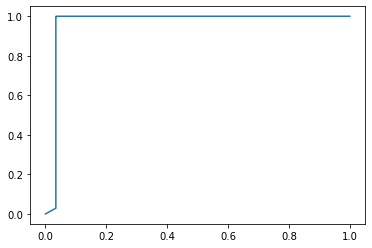

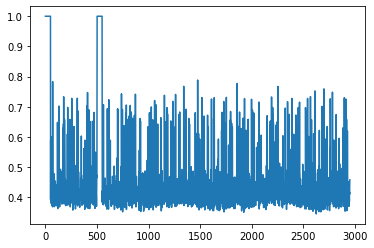

time used:16.921411275863647
TP: 2780 TN: 24 FP: 186 FN: 10
ACC: 0.9346666666666666 Precision: 0.9372892784895482 Recall: 0.996415770609319 F1: 0.965948575399583
FPR: 0.8857142857142857 TPR: 0.996415770609319
AUC: 0.8985458269329236


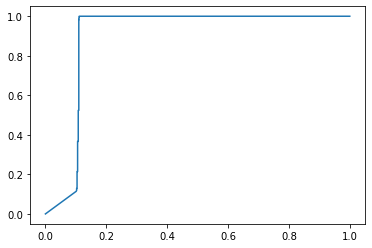

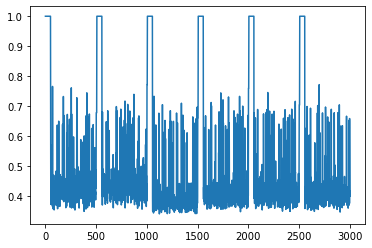

**********
window_size: 50
t: 75
phi: 5
thresh: 0.45
time used:11.09769892692566
TP: 109 TN: 201 FP: 6 FN: 2634
ACC: 0.10508474576271186 Precision: 0.9478260869565217 Recall: 0.03973751367116296 F1: 0.07627711686494051
FPR: 0.028985507246376812 TPR: 0.03973751367116296
AUC: 0.9635391624882661


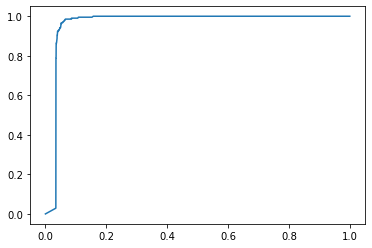

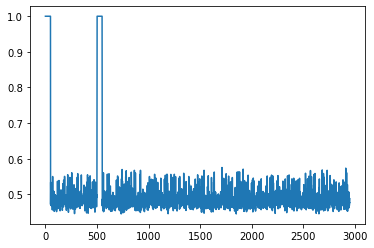

time used:20.22341752052307
TP: 91 TN: 207 FP: 3 FN: 2699
ACC: 0.09933333333333333 Precision: 0.9680851063829787 Recall: 0.03261648745519713 F1: 0.06310679611650485
FPR: 0.014285714285714285 TPR: 0.03261648745519713
AUC: 0.8412169312169312


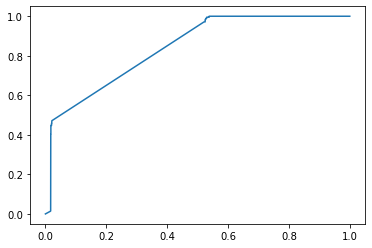

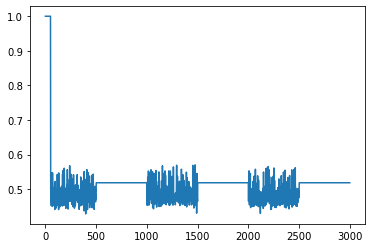

**********
window_size: 50
t: 75
phi: 5
thresh: 0.475
time used:11.097108840942383
TP: 810 TN: 201 FP: 6 FN: 1933
ACC: 0.34271186440677964 Precision: 0.9926470588235294 Recall: 0.2952971199416697 F1: 0.4551840404608036
FPR: 0.028985507246376812 TPR: 0.2952971199416697
AUC: 0.9601603378648506


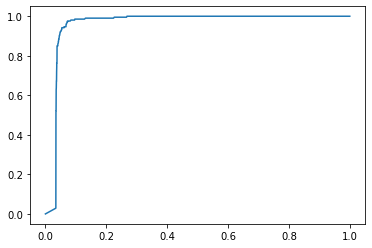

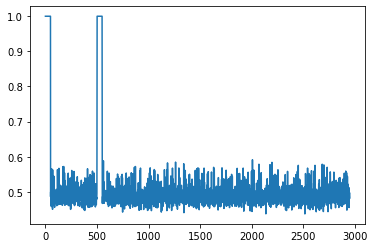

time used:20.255446434020996
TP: 875 TN: 207 FP: 3 FN: 1915
ACC: 0.3606666666666667 Precision: 0.9965831435079726 Recall: 0.31362007168458783 F1: 0.4770992366412214
FPR: 0.014285714285714285 TPR: 0.31362007168458783
AUC: 0.8019252432155657


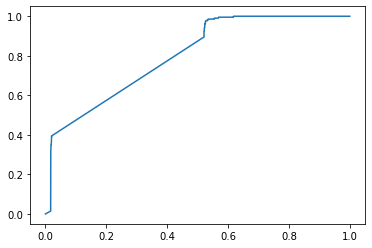

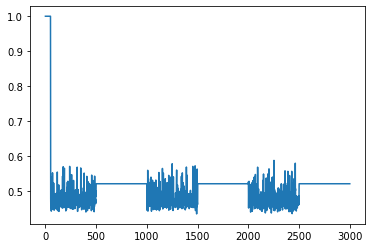

**********
window_size: 50
t: 75
phi: 5
thresh: 0.5
time used:11.079092264175415
TP: 2533 TN: 198 FP: 9 FN: 210
ACC: 0.9257627118644067 Precision: 0.9964594807238395 Recall: 0.9234414874225301 F1: 0.958561967833491
FPR: 0.043478260869565216 TPR: 0.9234414874225301
AUC: 0.9589477651501142


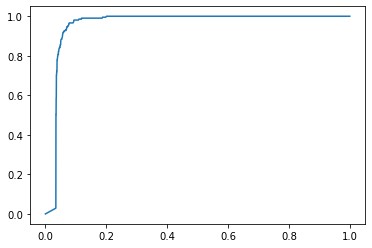

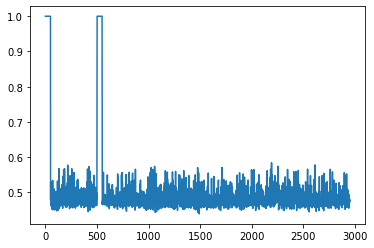

time used:20.16736626625061
TP: 1263 TN: 203 FP: 7 FN: 1527
ACC: 0.4886666666666667 Precision: 0.9944881889763779 Recall: 0.45268817204301076 F1: 0.6221674876847291
FPR: 0.03333333333333333 TPR: 0.45268817204301076
AUC: 0.7311759685953234


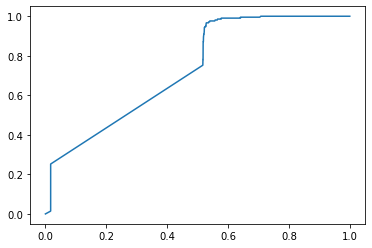

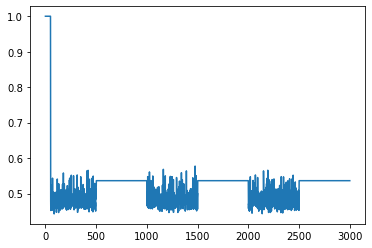

**********
window_size: 50
t: 75
phi: 5
thresh: 0.55
time used:11.094106674194336
TP: 2743 TN: 55 FP: 152 FN: 0
ACC: 0.9484745762711865 Precision: 0.9474956822107081 Recall: 1.0 F1: 0.9730400851365733
FPR: 0.7342995169082126 TPR: 1.0
AUC: 0.9643792455455344


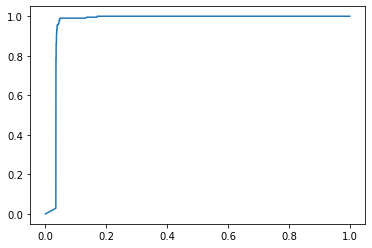

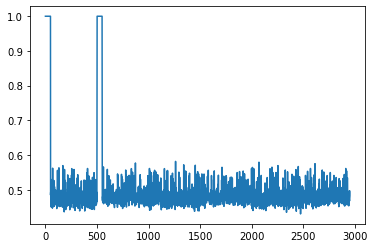

time used:20.16736626625061
TP: 2790 TN: 28 FP: 182 FN: 0
ACC: 0.9393333333333334 Precision: 0.9387617765814267 Recall: 1.0 F1: 0.9684137452273516
FPR: 0.8666666666666667 TPR: 1.0
AUC: 0.791636798088411


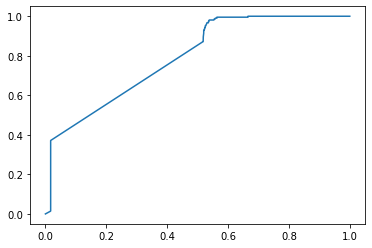

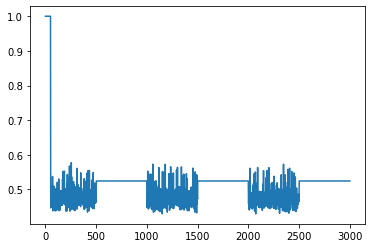

**********
window_size: 50
t: 75
phi: 5
thresh: 0.6
time used:11.107633352279663
TP: 2743 TN: 2 FP: 205 FN: 0
ACC: 0.9305084745762712 Precision: 0.930461329715061 Recall: 1.0 F1: 0.9639782112106835
FPR: 0.9903381642512077 TPR: 1.0
AUC: 0.9623169032812553


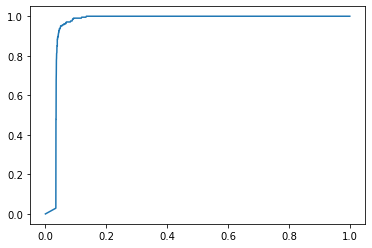

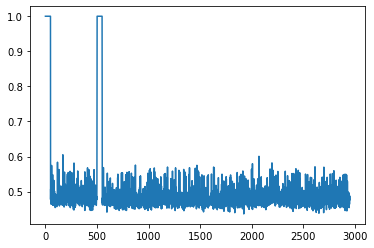

time used:17.620047330856323
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.830516299709848


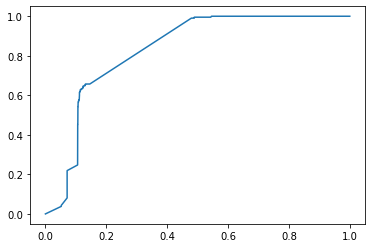

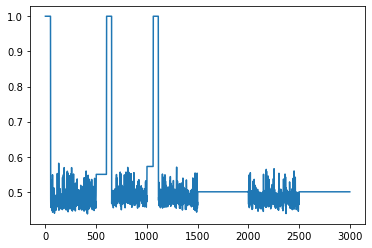

**********
window_size: 50
t: 75
phi: 5
thresh: 0.7
time used:11.19672441482544
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.95767443171111


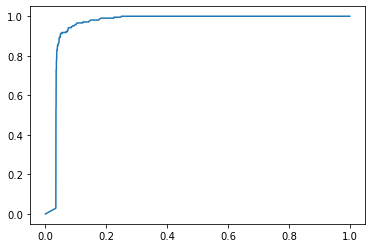

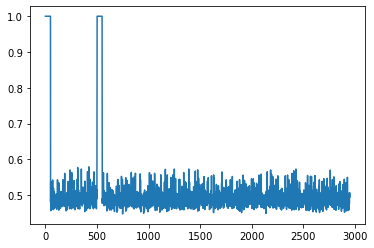

time used:20.182380199432373
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8428093531319337


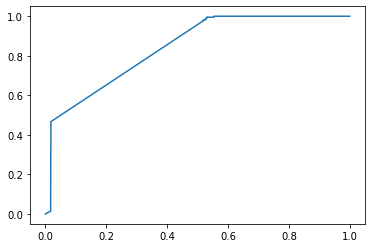

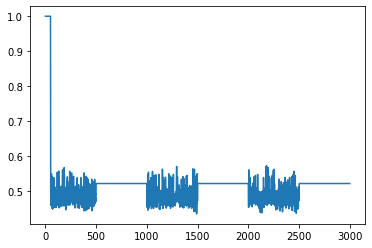

**********
window_size: 50
t: 75
phi: 12
thresh: 0.45
time used:11.253252506256104
TP: 277 TN: 201 FP: 6 FN: 2466
ACC: 0.16203389830508474 Precision: 0.9787985865724381 Recall: 0.1009843237331389 F1: 0.1830799735624587
FPR: 0.028985507246376812 TPR: 0.1009843237331389
AUC: 0.9660285910028337


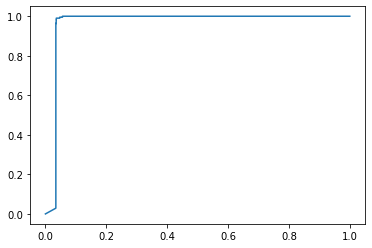

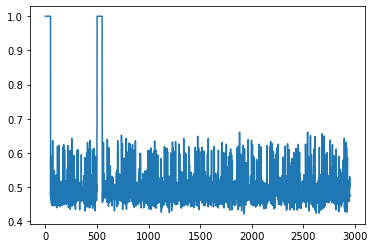

time used:15.719317197799683
TP: 913 TN: 185 FP: 25 FN: 1877
ACC: 0.366 Precision: 0.9733475479744137 Recall: 0.3272401433691756 F1: 0.48980686695278974
FPR: 0.11904761904761904 TPR: 0.3272401433691756
AUC: 0.8869935142515788


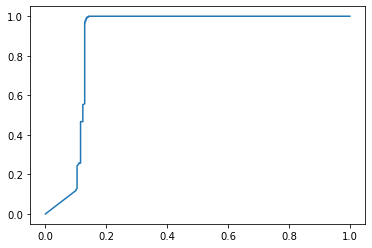

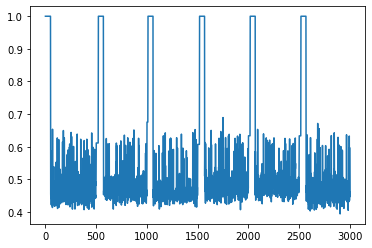

**********
window_size: 50
t: 75
phi: 12
thresh: 0.475
time used:11.239395380020142
TP: 787 TN: 201 FP: 6 FN: 1956
ACC: 0.33491525423728813 Precision: 0.9924337957124842 Recall: 0.2869121399927087 F1: 0.44513574660633476
FPR: 0.028985507246376812 TPR: 0.2869121399927087
AUC: 0.9655319381262097


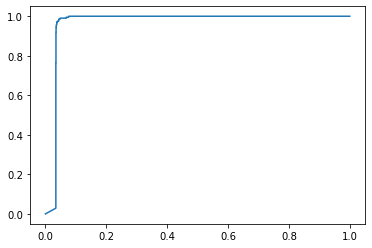

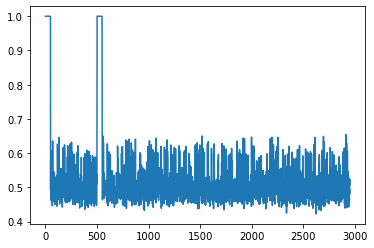

time used:15.609720230102539
TP: 1549 TN: 184 FP: 26 FN: 1241
ACC: 0.5776666666666667 Precision: 0.9834920634920635 Recall: 0.5551971326164875 F1: 0.7097365406643759
FPR: 0.12380952380952381 TPR: 0.5551971326164875
AUC: 0.8890587130909712


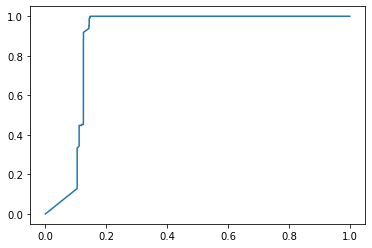

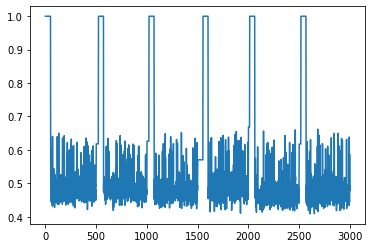

**********
window_size: 50
t: 75
phi: 12
thresh: 0.5
time used:11.222720384597778
TP: 2088 TN: 201 FP: 6 FN: 655
ACC: 0.7759322033898305 Precision: 0.997134670487106 Recall: 0.7612103536274153 F1: 0.863345048583833
FPR: 0.028985507246376812 TPR: 0.7612103536274153
AUC: 0.9659282037192608


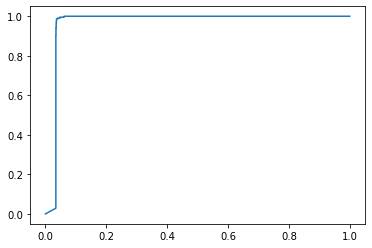

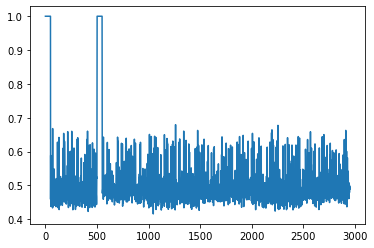

time used:15.221360445022583
TP: 2453 TN: 183 FP: 27 FN: 337
ACC: 0.8786666666666667 Precision: 0.9891129032258065 Recall: 0.8792114695340502 F1: 0.9309297912713472
FPR: 0.12857142857142856 TPR: 0.8792114695340502
AUC: 0.8924577572964669


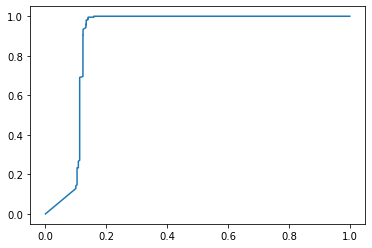

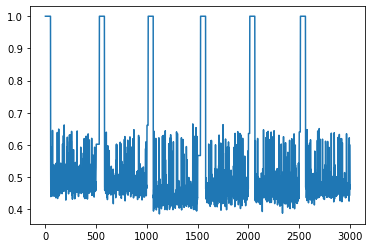

**********
window_size: 50
t: 75
phi: 12
thresh: 0.55
time used:11.214843273162842
TP: 2730 TN: 197 FP: 10 FN: 13
ACC: 0.9922033898305085 Precision: 0.9963503649635036 Recall: 0.995260663507109 F1: 0.9958052161225606
FPR: 0.04830917874396135 TPR: 0.995260663507109
AUC: 0.965803159909898


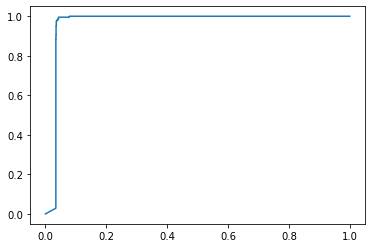

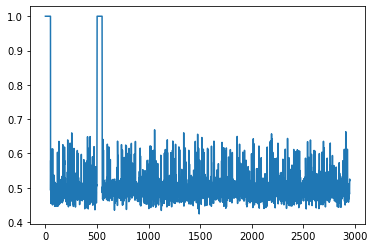

time used:15.189834356307983
TP: 2693 TN: 182 FP: 28 FN: 97
ACC: 0.9583333333333334 Precision: 0.9897096655641309 Recall: 0.9652329749103943 F1: 0.9773180910905461
FPR: 0.13333333333333333 TPR: 0.9652329749103943
AUC: 0.8889750810718553


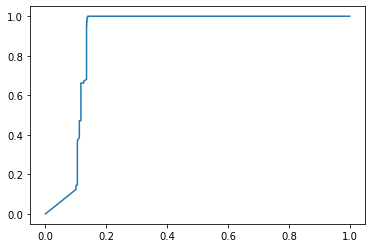

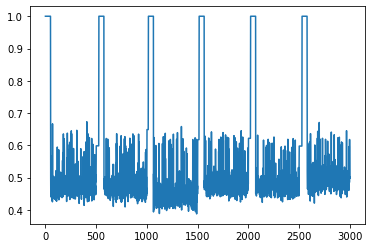

**********
window_size: 50
t: 75
phi: 12
thresh: 0.6
time used:11.19879150390625
TP: 2743 TN: 157 FP: 50 FN: 0
ACC: 0.9830508474576272 Precision: 0.9820981023988543 Recall: 1.0 F1: 0.9909682080924855
FPR: 0.24154589371980675 TPR: 1.0
AUC: 0.9659088307347116


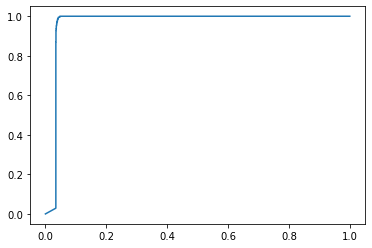

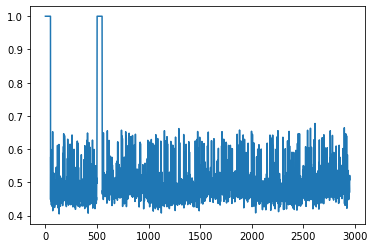

time used:15.37550663948059
TP: 2746 TN: 117 FP: 93 FN: 44
ACC: 0.9543333333333334 Precision: 0.9672419866150053 Recall: 0.9842293906810036 F1: 0.9756617516432758
FPR: 0.44285714285714284 TPR: 0.9842293906810036
AUC: 0.8870464243044889


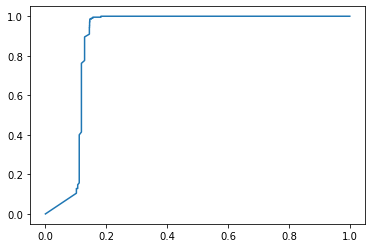

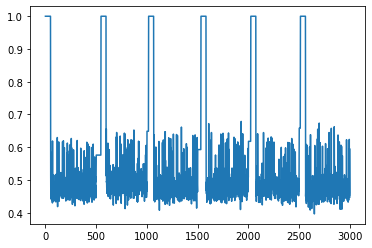

**********
window_size: 50
t: 75
phi: 12
thresh: 0.7
time used:11.217217683792114
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9657168620696335


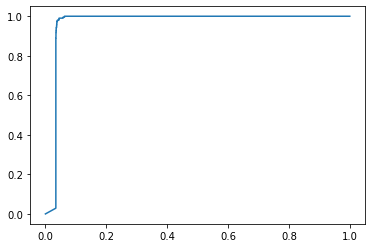

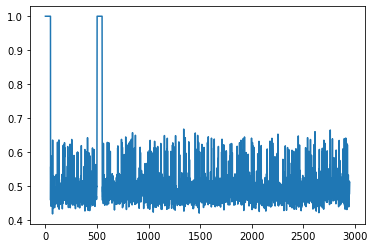

time used:15.705801486968994
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8866828810377198


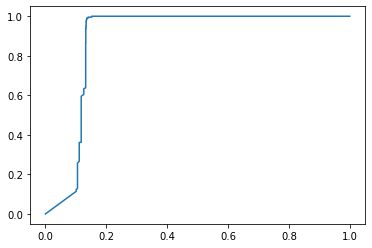

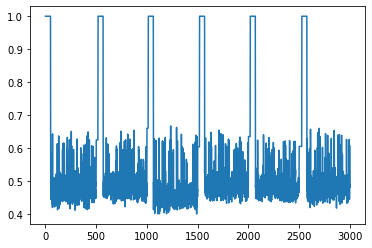

**********
window_size: 50
t: 75
phi: 25
thresh: 0.45
time used:11.301798105239868
TP: 1631 TN: 201 FP: 6 FN: 1112
ACC: 0.6210169491525424 Precision: 0.996334758704948 Recall: 0.5946044476850164 F1: 0.7447488584474887
FPR: 0.028985507246376812 TPR: 0.5946044476850164
AUC: 0.9661906196008813


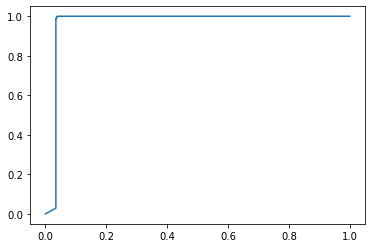

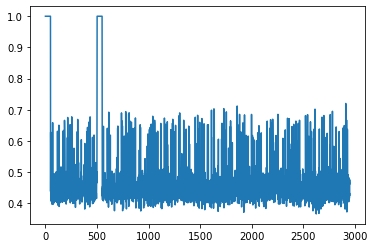

time used:16.821823835372925
TP: 2099 TN: 183 FP: 27 FN: 691
ACC: 0.7606666666666667 Precision: 0.9873000940733773 Recall: 0.7523297491039427 F1: 0.853946297803092
FPR: 0.12857142857142856 TPR: 0.7523297491039427
AUC: 0.897347670250896


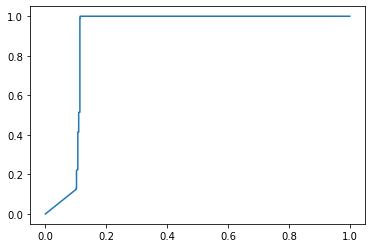

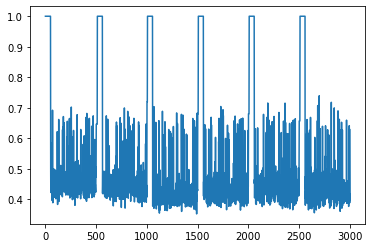

**********
window_size: 50
t: 75
phi: 25
thresh: 0.475
time used:11.458215236663818
TP: 2329 TN: 201 FP: 6 FN: 414
ACC: 0.8576271186440678 Precision: 0.9974304068522484 Recall: 0.8490703609187021 F1: 0.9172902717605356
FPR: 0.028985507246376812 TPR: 0.8490703609187021
AUC: 0.9662064702246034


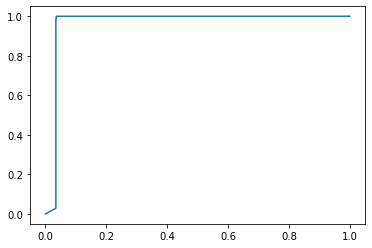

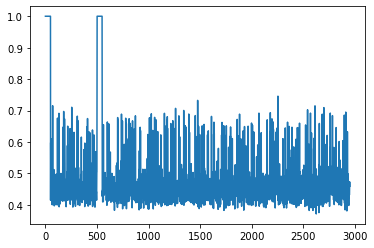

time used:16.836333513259888
TP: 2571 TN: 183 FP: 27 FN: 219
ACC: 0.918 Precision: 0.9896073903002309 Recall: 0.921505376344086 F1: 0.9543429844097995
FPR: 0.12857142857142856 TPR: 0.921505376344086
AUC: 0.8990296979006657


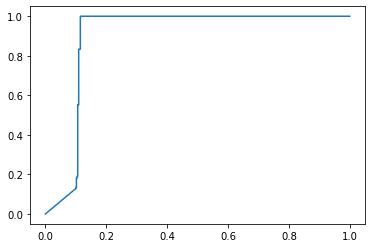

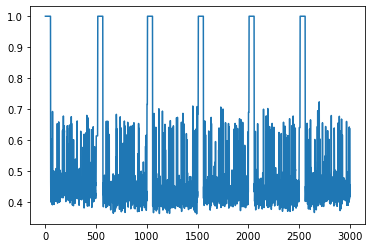

**********
window_size: 50
t: 75
phi: 25
thresh: 0.5
time used:11.310303211212158
TP: 2616 TN: 201 FP: 6 FN: 127
ACC: 0.9549152542372882 Precision: 0.9977116704805492 Recall: 0.953700328107911 F1: 0.9752096924510718
FPR: 0.028985507246376812 TPR: 0.953700328107911
AUC: 0.966139545368888


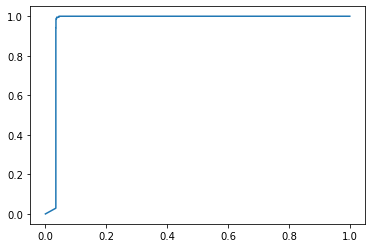

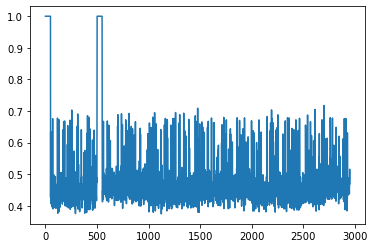

time used:16.881879329681396
TP: 2699 TN: 184 FP: 26 FN: 91
ACC: 0.961 Precision: 0.9904587155963303 Recall: 0.9673835125448028 F1: 0.9787851314596555
FPR: 0.12380952380952381 TPR: 0.9673835125448028
AUC: 0.8961930363543267


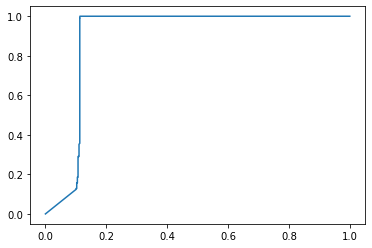

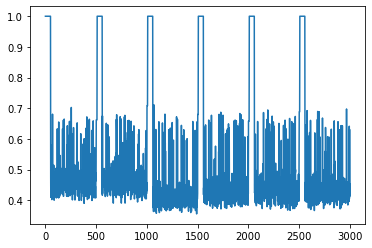

**********
window_size: 50
t: 75
phi: 25
thresh: 0.55
time used:11.314329385757446
TP: 2742 TN: 198 FP: 9 FN: 1
ACC: 0.9966101694915255 Precision: 0.9967284623773174 Recall: 0.999635435654393 F1: 0.9981798325445941
FPR: 0.043478260869565216 TPR: 0.999635435654393
AUC: 0.966195903142122


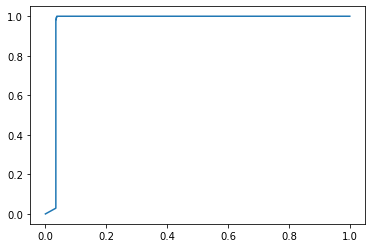

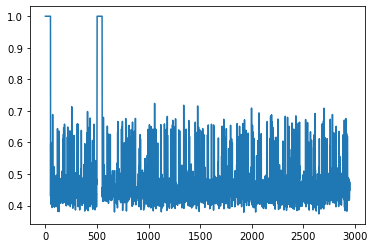

time used:16.82582116127014
TP: 2752 TN: 181 FP: 29 FN: 38
ACC: 0.9776666666666667 Precision: 0.9895720963682129 Recall: 0.9863799283154122 F1: 0.9879734338538863
FPR: 0.1380952380952381 TPR: 0.9863799283154122
AUC: 0.8966547192353644


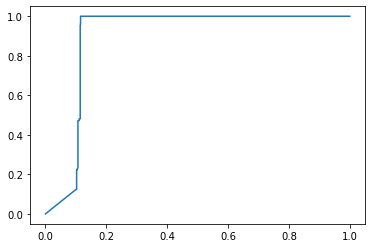

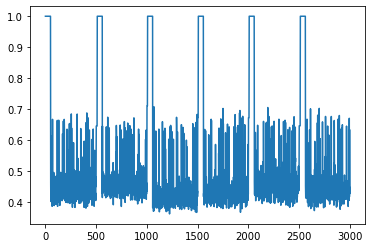

**********
window_size: 50
t: 75
phi: 25
thresh: 0.6
time used:11.315810918807983
TP: 2743 TN: 182 FP: 25 FN: 0
ACC: 0.9915254237288136 Precision: 0.9909682080924855 Recall: 1.0 F1: 0.9954636182181092
FPR: 0.12077294685990338 TPR: 1.0
AUC: 0.9662170373070847


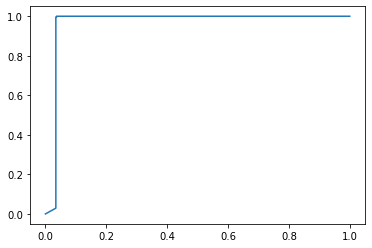

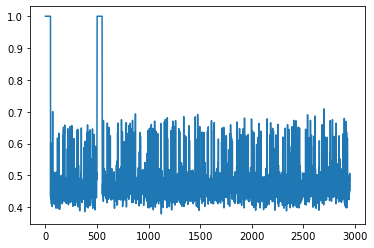

time used:16.907895803451538
TP: 2760 TN: 160 FP: 50 FN: 30
ACC: 0.9733333333333334 Precision: 0.9822064056939501 Recall: 0.989247311827957 F1: 0.9857142857142857
FPR: 0.23809523809523808 TPR: 0.989247311827957
AUC: 0.897811059907834


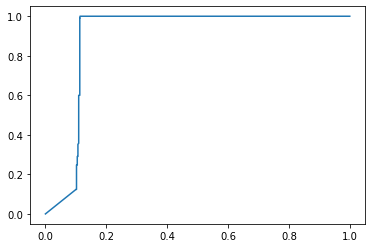

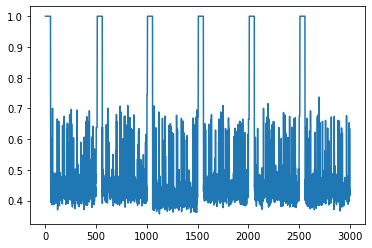

**********
window_size: 50
t: 75
phi: 25
thresh: 0.7
time used:11.41990613937378
TP: 2743 TN: 2 FP: 205 FN: 0
ACC: 0.9305084745762712 Precision: 0.930461329715061 Recall: 1.0 F1: 0.9639782112106835
FPR: 0.9903381642512077 TPR: 1.0
AUC: 0.9662276043895661


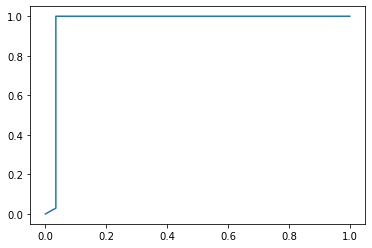

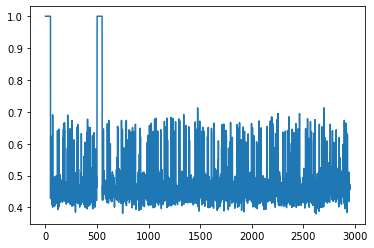

time used:16.987505674362183
TP: 2785 TN: 5 FP: 205 FN: 5
ACC: 0.93 Precision: 0.931438127090301 Recall: 0.9982078853046595 F1: 0.9636678200692042
FPR: 0.9761904761904762 TPR: 0.9982078853046595
AUC: 0.8976011264720942


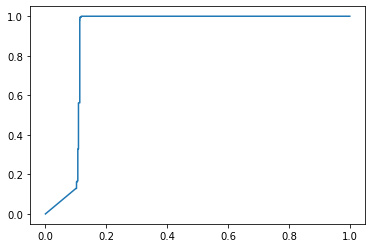

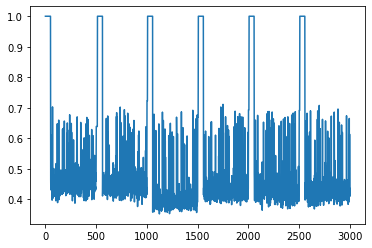

**********
window_size: 50
t: 75
phi: 37
thresh: 0.45
time used:11.392377614974976
TP: 2249 TN: 201 FP: 6 FN: 494
ACC: 0.8305084745762712 Precision: 0.9973392461197339 Recall: 0.8199052132701422 F1: 0.8999599839935974
FPR: 0.028985507246376812 TPR: 0.8199052132701422
AUC: 0.9662240820287389


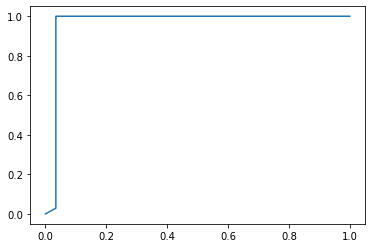

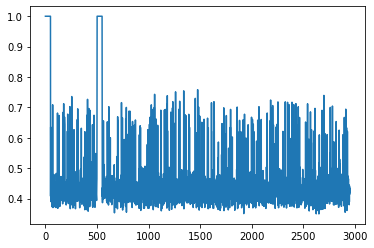

time used:17.01249408721924
TP: 2400 TN: 185 FP: 25 FN: 390
ACC: 0.8616666666666667 Precision: 0.9896907216494846 Recall: 0.8602150537634409 F1: 0.9204218600191754
FPR: 0.11904761904761904 TPR: 0.8602150537634409
AUC: 0.898905103259942


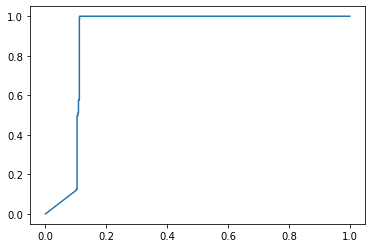

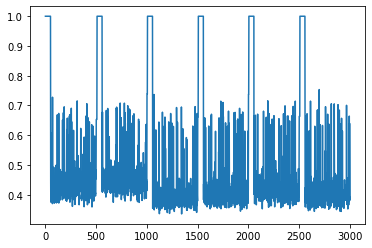

**********
window_size: 50
t: 75
phi: 37
thresh: 0.475
time used:11.395953178405762
TP: 2489 TN: 201 FP: 6 FN: 254
ACC: 0.911864406779661 Precision: 0.9975951903807615 Recall: 0.9074006562158221 F1: 0.9503627338678885
FPR: 0.028985507246376812 TPR: 0.9074006562158221
AUC: 0.9662240820287389


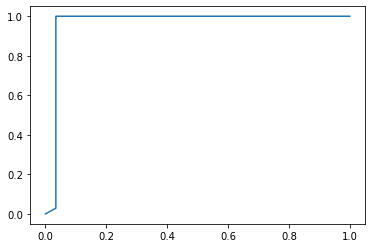

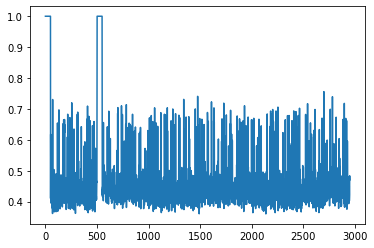

time used:17.01399874687195
TP: 2644 TN: 186 FP: 24 FN: 146
ACC: 0.9433333333333334 Precision: 0.9910044977511244 Recall: 0.9476702508960574 F1: 0.9688530597288384
FPR: 0.11428571428571428 TPR: 0.9476702508960574
AUC: 0.8978835978835978


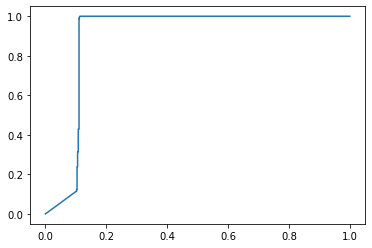

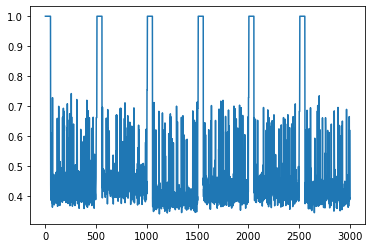

**********
window_size: 50
t: 75
phi: 37
thresh: 0.5
time used:11.386415719985962
TP: 2684 TN: 201 FP: 6 FN: 59
ACC: 0.9779661016949153 Precision: 0.9977695167286246 Recall: 0.978490703609187 F1: 0.9880360758328732
FPR: 0.028985507246376812 TPR: 0.978490703609187
AUC: 0.9662223208483254


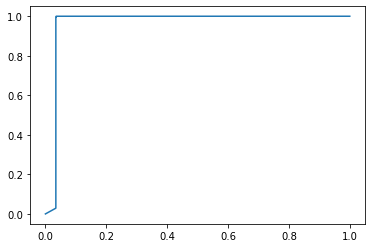

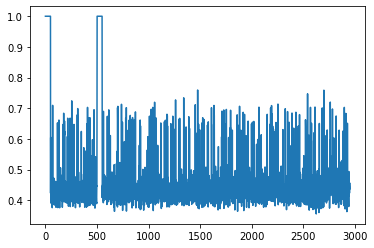

time used:17.085062980651855
TP: 2743 TN: 186 FP: 24 FN: 47
ACC: 0.9763333333333334 Precision: 0.9913263462233466 Recall: 0.9831541218637992 F1: 0.9872233219362966
FPR: 0.11428571428571428 TPR: 0.9831541218637992
AUC: 0.8978443420378904


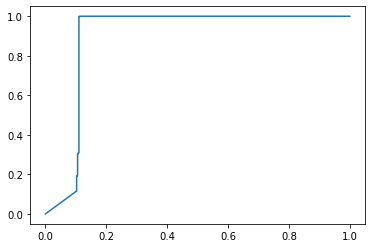

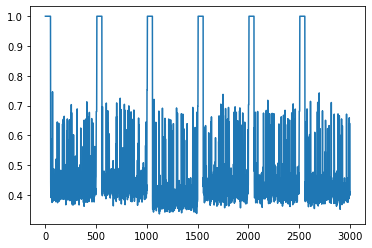

**********
window_size: 50
t: 75
phi: 37
thresh: 0.55
time used:11.436417579650879
TP: 2743 TN: 201 FP: 6 FN: 0
ACC: 0.9979661016949153 Precision: 0.9978173881411422 Recall: 1.0 F1: 0.9989075018208302
FPR: 0.028985507246376812 TPR: 1.0
AUC: 0.9662276043895661


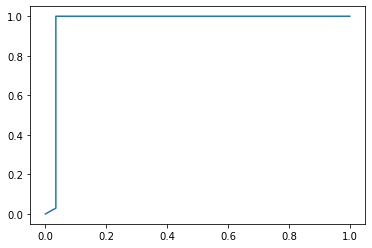

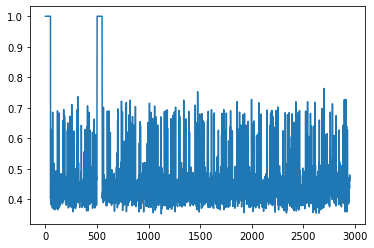

time used:17.08405613899231
TP: 2767 TN: 186 FP: 24 FN: 23
ACC: 0.9843333333333333 Precision: 0.991400931565747 Recall: 0.9917562724014337 F1: 0.9915785701487189
FPR: 0.11428571428571428 TPR: 0.9917562724014337
AUC: 0.8982420208226659


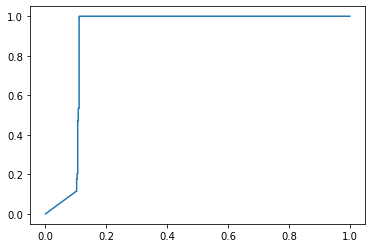

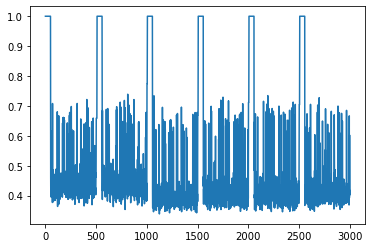

**********
window_size: 50
t: 75
phi: 37
thresh: 0.6
time used:11.416902780532837
TP: 2743 TN: 183 FP: 24 FN: 0
ACC: 0.991864406779661 Precision: 0.9913263462233466 Recall: 1.0 F1: 0.9956442831215971
FPR: 0.11594202898550725 TPR: 1.0
AUC: 0.9662276043895661


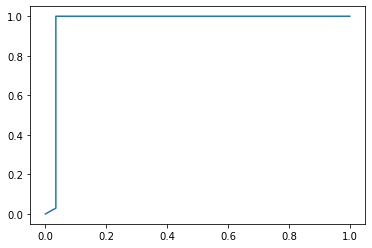

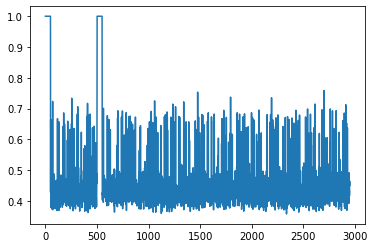

time used:17.035011291503906
TP: 2768 TN: 168 FP: 42 FN: 22
ACC: 0.9786666666666667 Precision: 0.9850533807829182 Recall: 0.9921146953405018 F1: 0.9885714285714287
FPR: 0.2 TPR: 0.9921146953405018
AUC: 0.8979569892473118


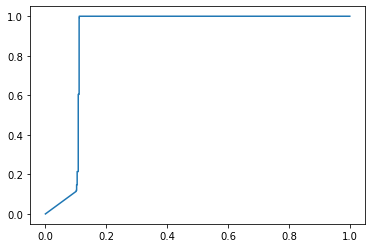

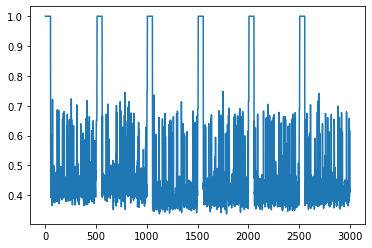

**********
window_size: 50
t: 75
phi: 37
thresh: 0.7
time used:11.376867055892944
TP: 2743 TN: 21 FP: 186 FN: 0
ACC: 0.9369491525423729 Precision: 0.9364970979856606 Recall: 1.0 F1: 0.9672073342736248
FPR: 0.8985507246376812 TPR: 1.0
AUC: 0.9662276043895661


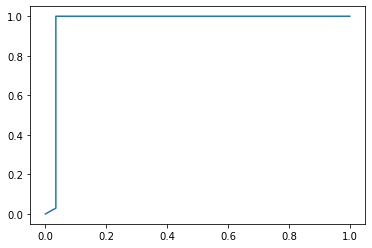

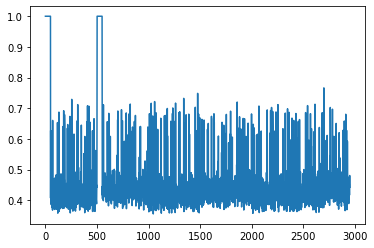

time used:16.97496271133423
TP: 2787 TN: 18 FP: 192 FN: 3
ACC: 0.935 Precision: 0.9355488418932527 Recall: 0.9989247311827957 F1: 0.9661986479459178
FPR: 0.9142857142857143 TPR: 0.9989247311827957
AUC: 0.8986610343061956


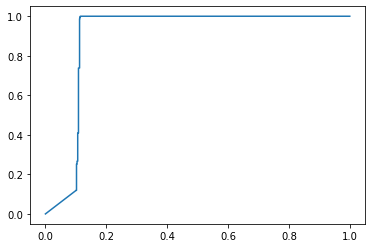

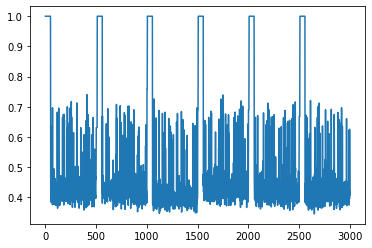

**********
window_size: 50
t: 75
phi: 45
thresh: 0.45
time used:11.41740083694458
TP: 2317 TN: 201 FP: 6 FN: 426
ACC: 0.8535593220338983 Precision: 0.9974171330176496 Recall: 0.8446955887714181 F1: 0.9147256217923411
FPR: 0.028985507246376812 TPR: 0.8446955887714181
AUC: 0.9662276043895661


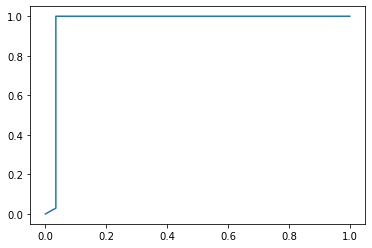

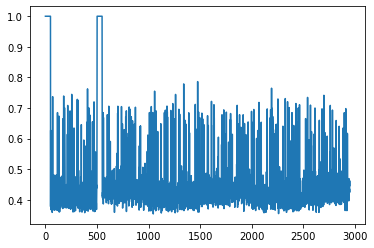

time used:17.045524835586548
TP: 2538 TN: 186 FP: 24 FN: 252
ACC: 0.908 Precision: 0.990632318501171 Recall: 0.9096774193548387 F1: 0.9484304932735426
FPR: 0.11428571428571428 TPR: 0.9096774193548387
AUC: 0.8981993514251579


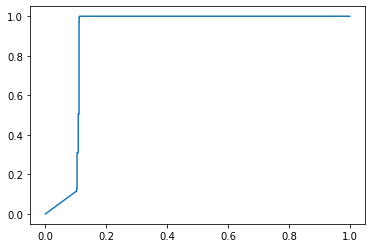

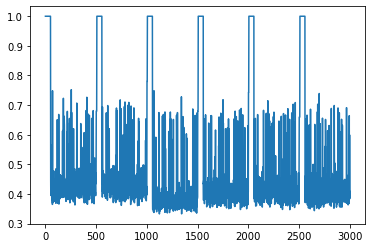

**********
window_size: 50
t: 75
phi: 45
thresh: 0.475
time used:11.407392024993896
TP: 2627 TN: 201 FP: 6 FN: 116
ACC: 0.9586440677966102 Precision: 0.9977212305355109 Recall: 0.957710535909588 F1: 0.9773065476190476
FPR: 0.028985507246376812 TPR: 0.957710535909588
AUC: 0.9662223208483254


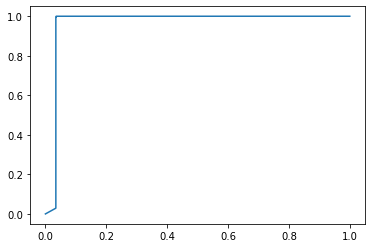

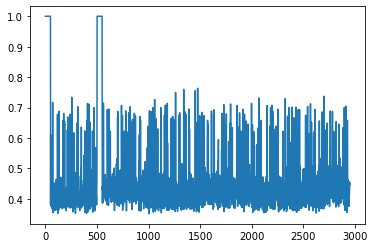

time used:16.382921934127808
TP: 2726 TN: 186 FP: 24 FN: 64
ACC: 0.9706666666666667 Precision: 0.9912727272727273 Recall: 0.9770609318996416 F1: 0.984115523465704
FPR: 0.11428571428571428 TPR: 0.9770609318996416
AUC: 0.8991261307390339


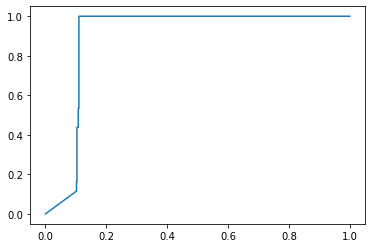

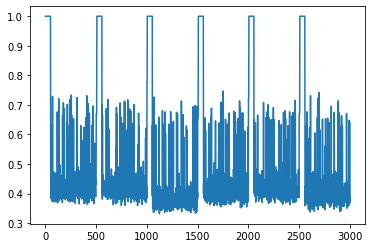

**********
window_size: 50
t: 75
phi: 45
thresh: 0.5
time used:11.443533420562744
TP: 2715 TN: 201 FP: 6 FN: 28
ACC: 0.9884745762711864 Precision: 0.9977949283351709 Recall: 0.989792198323004 F1: 0.9937774524158126
FPR: 0.028985507246376812 TPR: 0.989792198323004
AUC: 0.9662205596679119


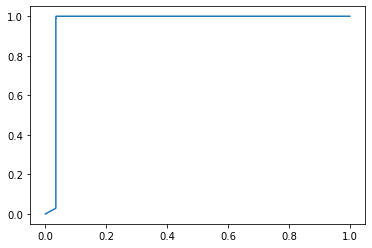

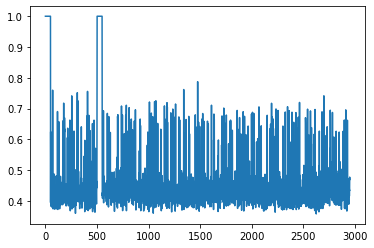

time used:17.054028272628784
TP: 2759 TN: 186 FP: 24 FN: 31
ACC: 0.9816666666666667 Precision: 0.9913762127200862 Recall: 0.9888888888888889 F1: 0.9901309886954961
FPR: 0.11428571428571428 TPR: 0.9888888888888889
AUC: 0.898873527905786


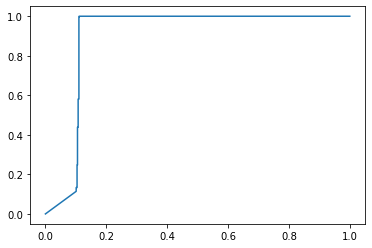

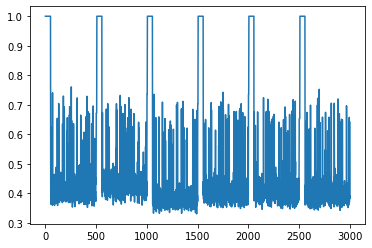

**********
window_size: 50
t: 75
phi: 45
thresh: 0.55
time used:11.416903018951416
TP: 2743 TN: 201 FP: 6 FN: 0
ACC: 0.9979661016949153 Precision: 0.9978173881411422 Recall: 1.0 F1: 0.9989075018208302
FPR: 0.028985507246376812 TPR: 1.0
AUC: 0.9662276043895661


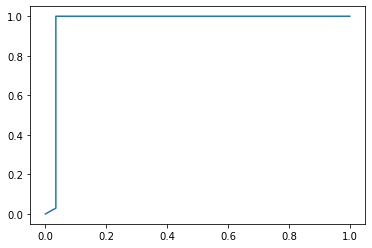

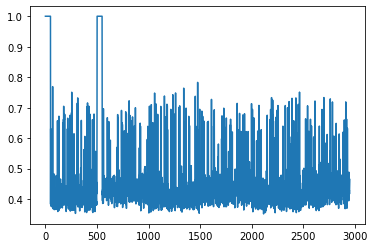

time used:17.048023223876953
TP: 2771 TN: 183 FP: 27 FN: 19
ACC: 0.9846666666666667 Precision: 0.990350250178699 Recall: 0.9931899641577061 F1: 0.9917680744452398
FPR: 0.12857142857142856 TPR: 0.9931899641577061
AUC: 0.8983802696705923


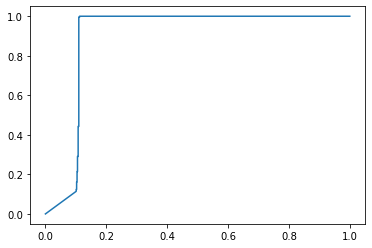

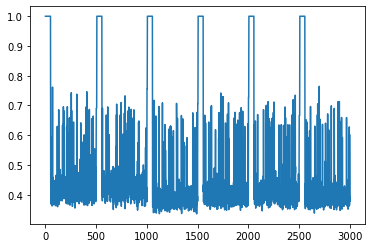

**********
window_size: 50
t: 75
phi: 45
thresh: 0.6
time used:11.462463140487671
TP: 2743 TN: 172 FP: 35 FN: 0
ACC: 0.988135593220339 Precision: 0.9874010079193665 Recall: 1.0 F1: 0.9936605687375476
FPR: 0.16908212560386474 TPR: 1.0
AUC: 0.9662223208483254


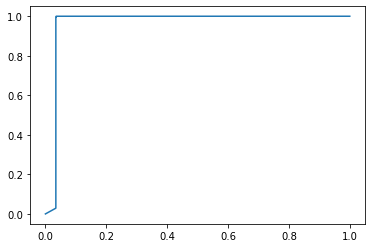

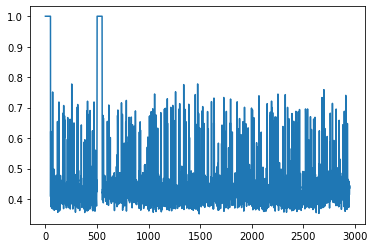

time used:17.01299738883972
TP: 2771 TN: 163 FP: 47 FN: 19
ACC: 0.978 Precision: 0.9833215046132009 Recall: 0.9931899641577061 F1: 0.9882310984308131
FPR: 0.22380952380952382 TPR: 0.9931899641577061
AUC: 0.8984587813620072


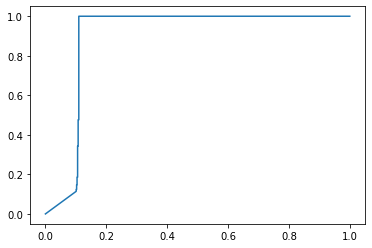

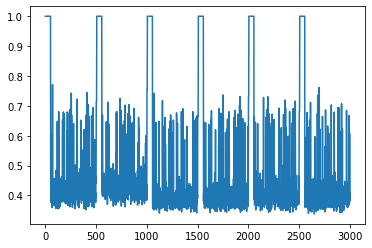

**********
window_size: 50
t: 75
phi: 45
thresh: 0.7
time used:11.38937520980835
TP: 2743 TN: 40 FP: 167 FN: 0
ACC: 0.9433898305084746 Precision: 0.9426116838487972 Recall: 1.0 F1: 0.9704581638068283
FPR: 0.8067632850241546 TPR: 1.0
AUC: 0.9662276043895661


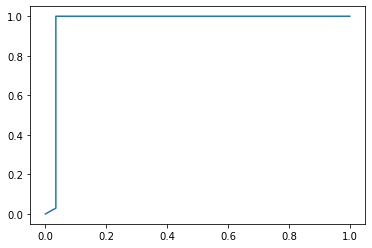

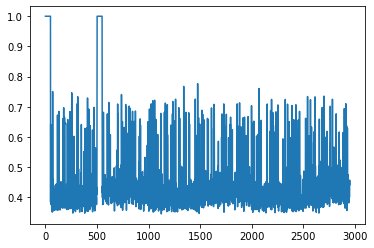

time used:17.12960124015808
TP: 2785 TN: 29 FP: 181 FN: 5
ACC: 0.938 Precision: 0.9389750505731626 Recall: 0.9982078853046595 F1: 0.967685892981237
FPR: 0.861904761904762 TPR: 0.9982078853046595
AUC: 0.8990407919440178


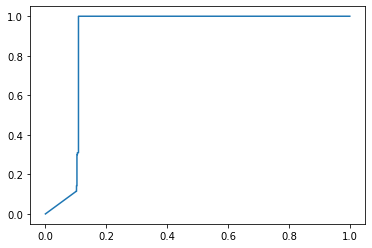

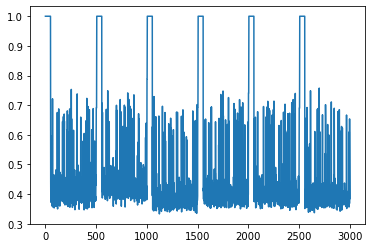

**********
window_size: 50
t: 100
phi: 5
thresh: 0.45
time used:11.197321891784668
TP: 95 TN: 201 FP: 6 FN: 2648
ACC: 0.10033898305084746 Precision: 0.9405940594059405 Recall: 0.034633612832664966 F1: 0.06680731364275667
FPR: 0.028985507246376812 TPR: 0.034633612832664966
AUC: 0.9601471290117489


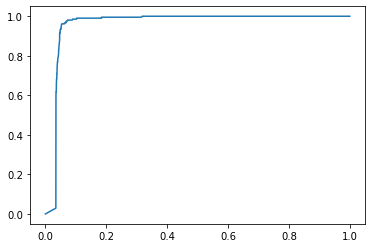

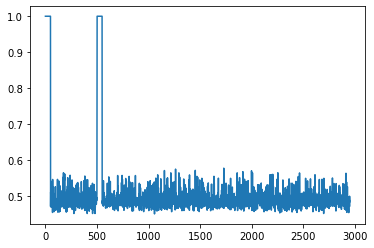

time used:20.294482231140137
TP: 53 TN: 207 FP: 3 FN: 2737
ACC: 0.08666666666666667 Precision: 0.9464285714285714 Recall: 0.01899641577060932 F1: 0.037245256500351376
FPR: 0.014285714285714285 TPR: 0.01899641577060932
AUC: 0.8184365932753029


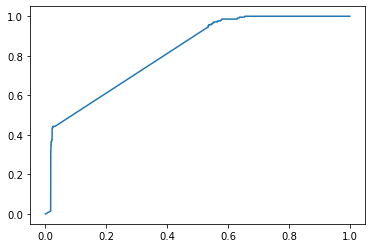

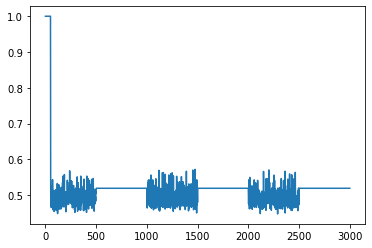

**********
window_size: 50
t: 100
phi: 5
thresh: 0.475
time used:11.155161619186401
TP: 579 TN: 201 FP: 6 FN: 2164
ACC: 0.26440677966101694 Precision: 0.9897435897435898 Recall: 0.2110827561064528 F1: 0.3479567307692308
FPR: 0.028985507246376812 TPR: 0.2110827561064528
AUC: 0.9590217347274839


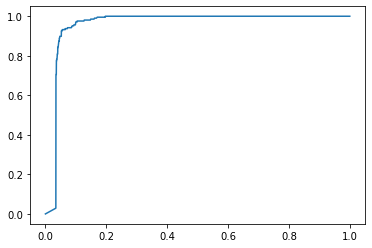

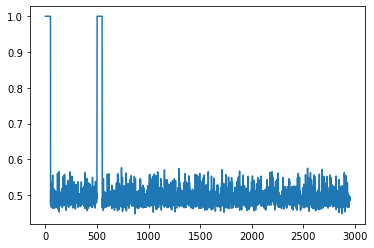

time used:20.18938636779785
TP: 340 TN: 207 FP: 3 FN: 2450
ACC: 0.18233333333333332 Precision: 0.9912536443148688 Recall: 0.12186379928315412 F1: 0.2170443664219598
FPR: 0.014285714285714285 TPR: 0.12186379928315412
AUC: 0.8446458440006828


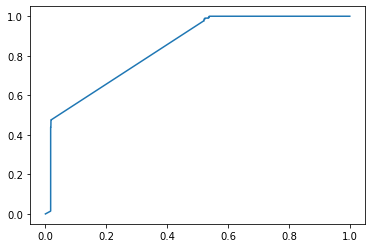

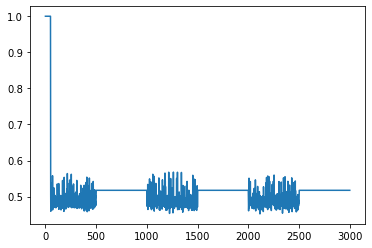

**********
window_size: 50
t: 100
phi: 5
thresh: 0.5
time used:11.186687469482422
TP: 2450 TN: 200 FP: 7 FN: 293
ACC: 0.8983050847457628 Precision: 0.9971509971509972 Recall: 0.8931826467371491 F1: 0.9423076923076923
FPR: 0.033816425120772944 TPR: 0.8931826467371491
AUC: 0.9612011954892646


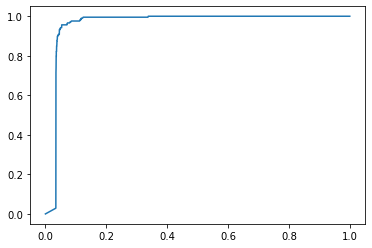

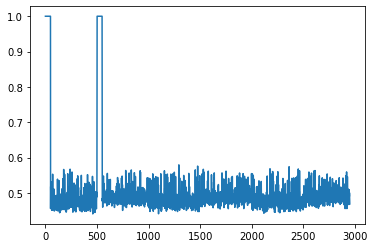

time used:20.220414400100708
TP: 1316 TN: 207 FP: 3 FN: 1474
ACC: 0.5076666666666667 Precision: 0.9977255496588324 Recall: 0.47168458781362005 F1: 0.6405451448040886
FPR: 0.014285714285714285 TPR: 0.47168458781362005
AUC: 0.8411222051544631


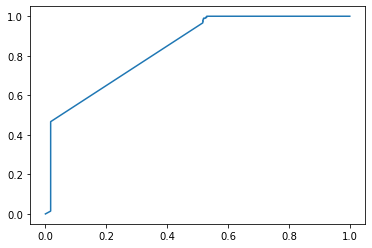

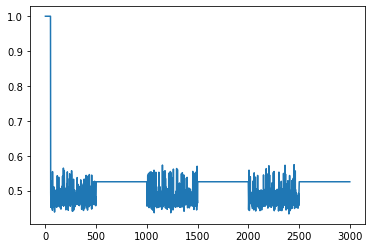

**********
window_size: 50
t: 100
phi: 5
thresh: 0.55
time used:11.152666568756104
TP: 2743 TN: 42 FP: 165 FN: 0
ACC: 0.9440677966101695 Precision: 0.9432599724896836 Recall: 1.0 F1: 0.970801628030437
FPR: 0.7971014492753623 TPR: 1.0
AUC: 0.9624023205313129


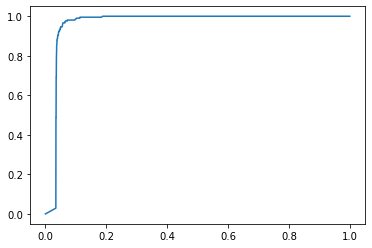

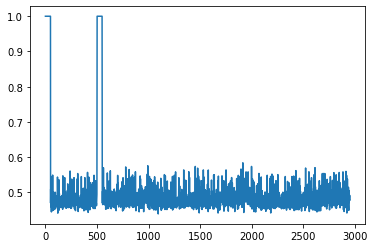

time used:20.312498331069946
TP: 2790 TN: 8 FP: 202 FN: 0
ACC: 0.9326666666666666 Precision: 0.9324866310160428 Recall: 1.0 F1: 0.9650639916983742
FPR: 0.9619047619047619 TPR: 1.0
AUC: 0.7614183307731694


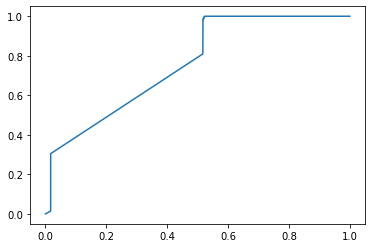

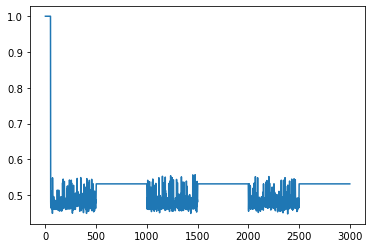

**********
window_size: 50
t: 100
phi: 5
thresh: 0.6
time used:11.181711435317993
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9635435654393001


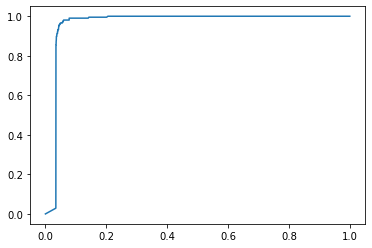

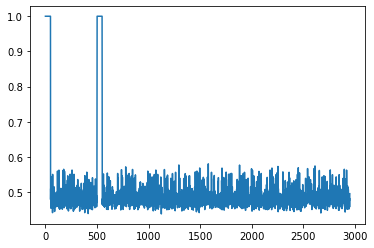

time used:20.189387321472168
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7618748933265063


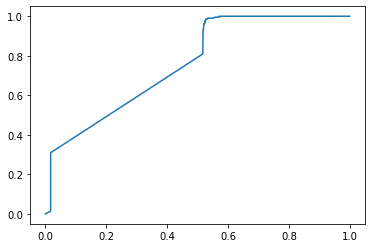

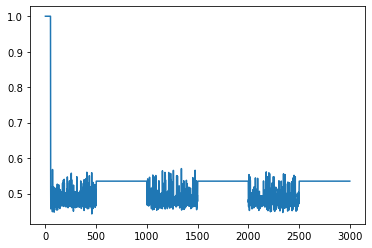

**********
window_size: 50
t: 100
phi: 5
thresh: 0.7
time used:11.201701402664185
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9607758704193898


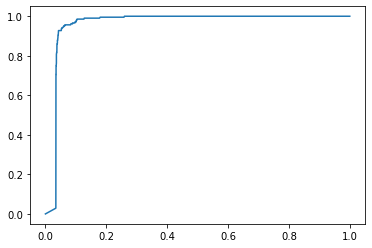

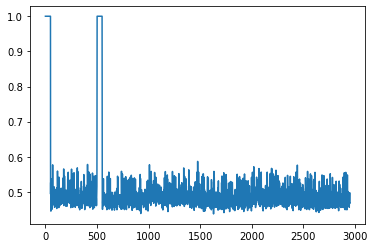

time used:20.223417282104492
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7422759856630825


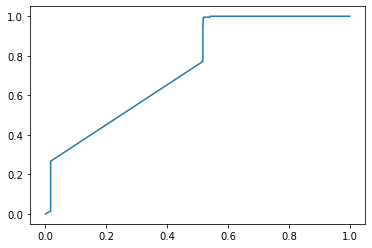

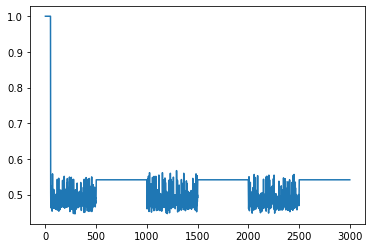

**********
window_size: 50
t: 100
phi: 12
thresh: 0.45
time used:11.355387926101685
TP: 233 TN: 201 FP: 6 FN: 2510
ACC: 0.14711864406779662 Precision: 0.9748953974895398 Recall: 0.08494349252643091 F1: 0.15627095908786046
FPR: 0.028985507246376812 TPR: 0.08494349252643091
AUC: 0.9661730077967458


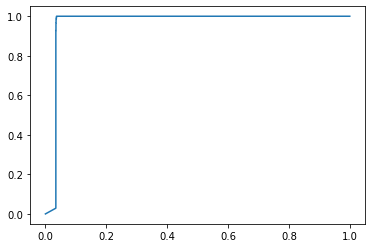

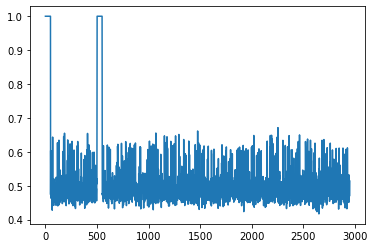

time used:15.445066690444946
TP: 749 TN: 186 FP: 24 FN: 2041
ACC: 0.31166666666666665 Precision: 0.9689521345407504 Recall: 0.2684587813620072 F1: 0.42043222003929276
FPR: 0.11428571428571428 TPR: 0.2684587813620072
AUC: 0.8859967571257893


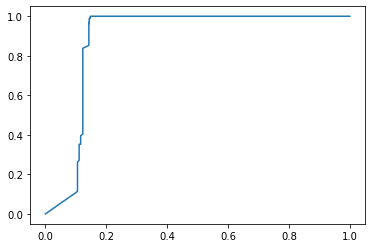

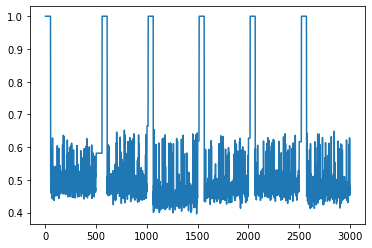

**********
window_size: 50
t: 100
phi: 12
thresh: 0.475
time used:11.336913824081421
TP: 822 TN: 201 FP: 6 FN: 1921
ACC: 0.3467796610169491 Precision: 0.9927536231884058 Recall: 0.2996718920889537 F1: 0.4603752450294036
FPR: 0.028985507246376812 TPR: 0.2996718920889537
AUC: 0.9661007993997898


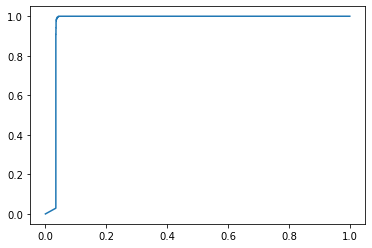

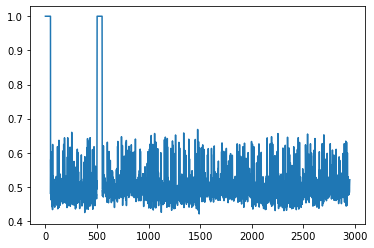

time used:16.38892698287964
TP: 1738 TN: 186 FP: 24 FN: 1052
ACC: 0.6413333333333333 Precision: 0.9863791146424518 Recall: 0.6229390681003584 F1: 0.7636203866432336
FPR: 0.11428571428571428 TPR: 0.6229390681003584
AUC: 0.887468851339819


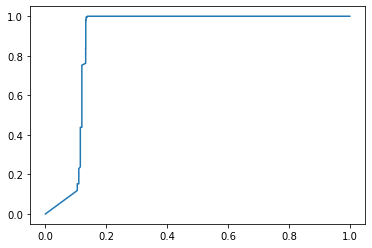

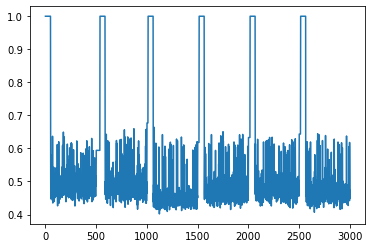

**********
window_size: 50
t: 100
phi: 12
thresh: 0.5
time used:11.373863220214844
TP: 1910 TN: 201 FP: 6 FN: 833
ACC: 0.7155932203389831 Precision: 0.9968684759916493 Recall: 0.6963179001093693 F1: 0.8199184374329256
FPR: 0.028985507246376812 TPR: 0.6963179001093693
AUC: 0.9658947412914032


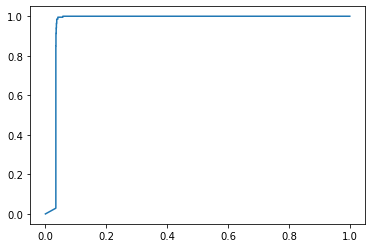

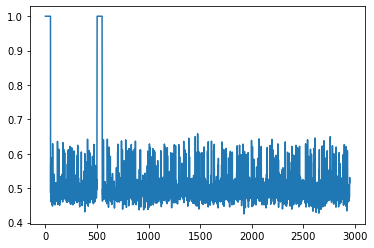

time used:15.338466882705688
TP: 2386 TN: 185 FP: 25 FN: 404
ACC: 0.857 Precision: 0.9896308585649108 Recall: 0.8551971326164874 F1: 0.9175158623341666
FPR: 0.11904761904761904 TPR: 0.8551971326164874
AUC: 0.8860556408943506


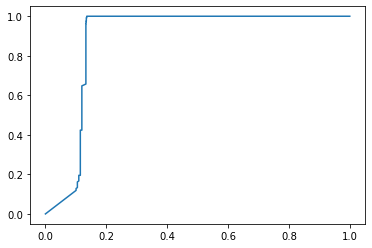

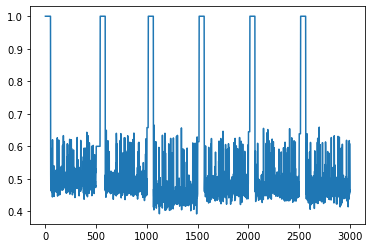

**********
window_size: 50
t: 100
phi: 12
thresh: 0.55
time used:11.330981492996216
TP: 2726 TN: 197 FP: 10 FN: 17
ACC: 0.9908474576271187 Precision: 0.9963450292397661 Recall: 0.993802406124681 F1: 0.9950720934477094
FPR: 0.04830917874396135 TPR: 0.993802406124681
AUC: 0.9659053083738846


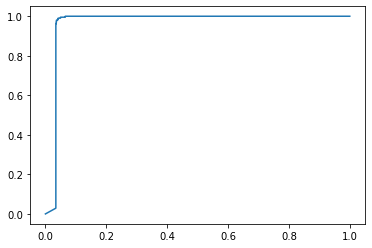

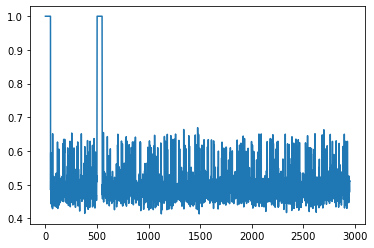

time used:14.821996927261353
TP: 2681 TN: 182 FP: 28 FN: 109
ACC: 0.9543333333333334 Precision: 0.9896640826873385 Recall: 0.9609318996415771 F1: 0.9750863793416985
FPR: 0.13333333333333333 TPR: 0.9609318996415771
AUC: 0.885468509984639


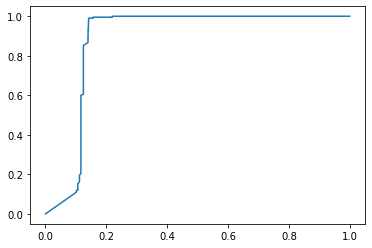

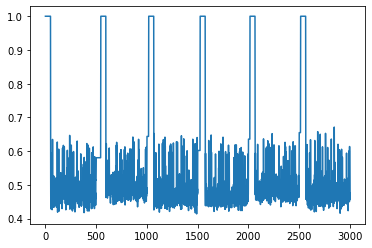

**********
window_size: 50
t: 100
phi: 12
thresh: 0.6
time used:11.352845668792725
TP: 2743 TN: 136 FP: 71 FN: 0
ACC: 0.9759322033898306 Precision: 0.9747690120824449 Recall: 1.0 F1: 0.9872233219362965
FPR: 0.34299516908212563 TPR: 1.0
AUC: 0.9660620534306914


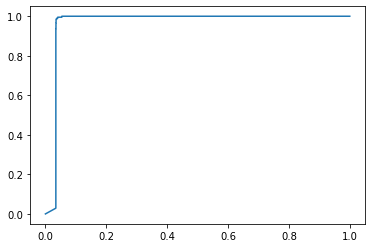

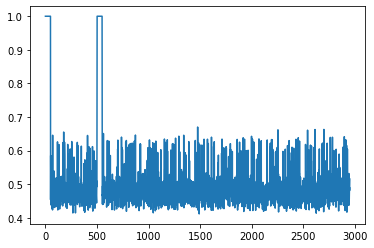

time used:15.509629249572754
TP: 2727 TN: 112 FP: 98 FN: 63
ACC: 0.9463333333333334 Precision: 0.9653097345132743 Recall: 0.9774193548387097 F1: 0.971326803205699
FPR: 0.4666666666666667 TPR: 0.9774193548387097
AUC: 0.8880286738351254


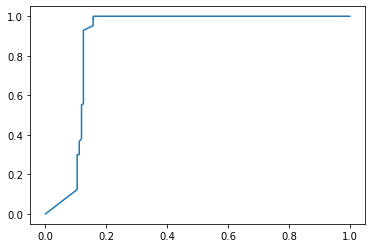

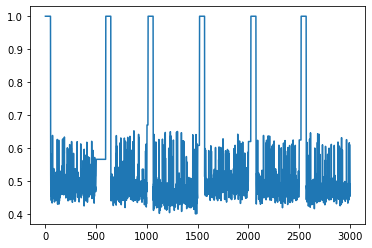

**********
window_size: 50
t: 100
phi: 12
thresh: 0.7
time used:11.322112560272217
TP: 2743 TN: 0 FP: 207 FN: 0
ACC: 0.9298305084745763 Precision: 0.9298305084745763 Recall: 1.0 F1: 0.963639557351133
FPR: 1.0 TPR: 1.0
AUC: 0.9661976643225355


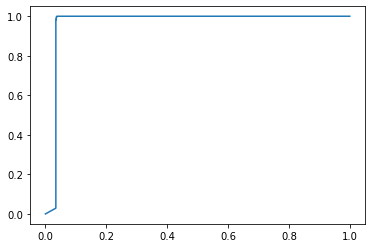

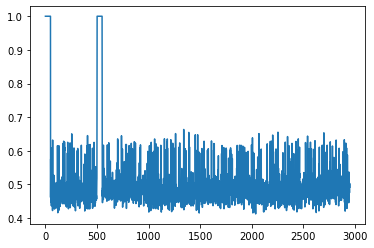

time used:14.823998928070068
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.8867468851339819


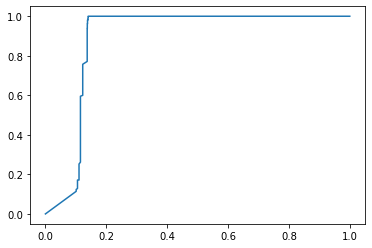

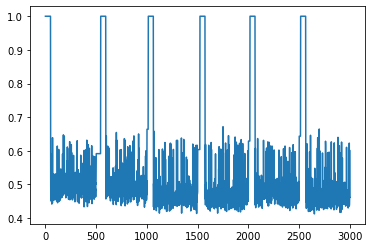

**********
window_size: 50
t: 100
phi: 25
thresh: 0.45
time used:11.555077314376831
TP: 1186 TN: 201 FP: 6 FN: 1557
ACC: 0.47016949152542376 Precision: 0.9949664429530202 Recall: 0.4323733138899016 F1: 0.6027954256670902
FPR: 0.028985507246376812 TPR: 0.4323733138899016
AUC: 0.966171246616332


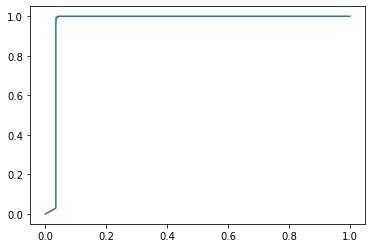

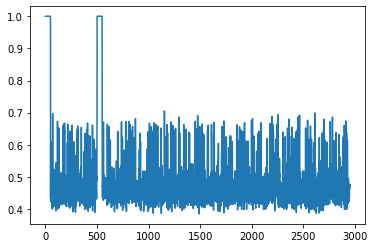

time used:16.965948343276978
TP: 2166 TN: 184 FP: 26 FN: 624
ACC: 0.7833333333333333 Precision: 0.9881386861313869 Recall: 0.7763440860215054 F1: 0.869530309112806
FPR: 0.12380952380952381 TPR: 0.7763440860215054
AUC: 0.8982164191841611


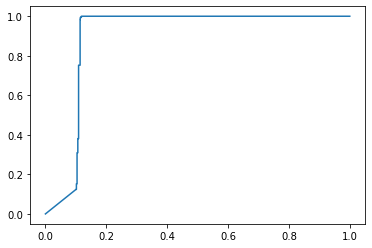

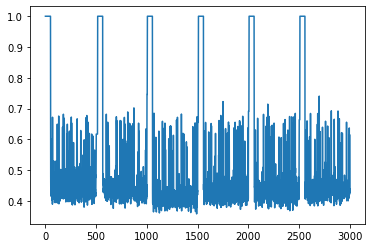

**********
window_size: 50
t: 100
phi: 25
thresh: 0.475
time used:11.491971731185913
TP: 2267 TN: 201 FP: 6 FN: 476
ACC: 0.8366101694915254 Precision: 0.9973603167619886 Recall: 0.8264673714910682 F1: 0.9039074960127591
FPR: 0.028985507246376812 TPR: 0.8264673714910682
AUC: 0.9662011866833626


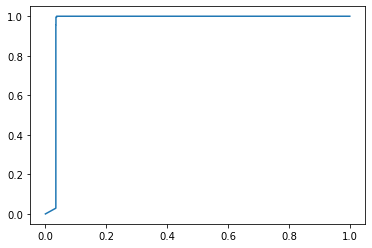

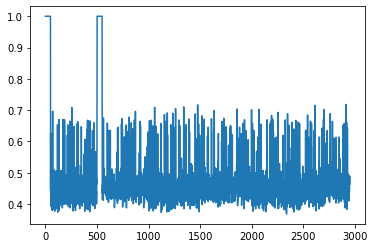

time used:16.956496715545654
TP: 2549 TN: 182 FP: 28 FN: 241
ACC: 0.9103333333333333 Precision: 0.9891346526969345 Recall: 0.9136200716845878 F1: 0.9498788895099685
FPR: 0.13333333333333333 TPR: 0.9136200716845878
AUC: 0.8982138590203106


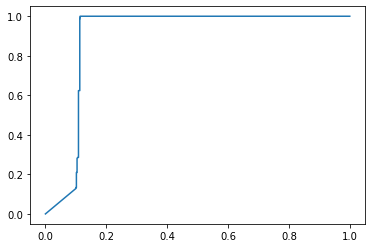

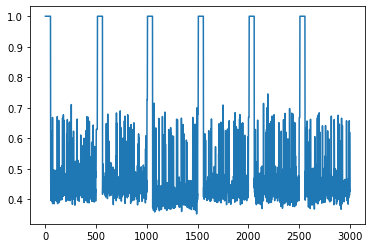

**********
window_size: 50
t: 100
phi: 25
thresh: 0.5
time used:11.532001972198486
TP: 2563 TN: 201 FP: 6 FN: 180
ACC: 0.9369491525423729 Precision: 0.9976644608797197 Recall: 0.93437841779074 F1: 0.9649849397590361
FPR: 0.028985507246376812 TPR: 0.93437841779074
AUC: 0.9662170373070847


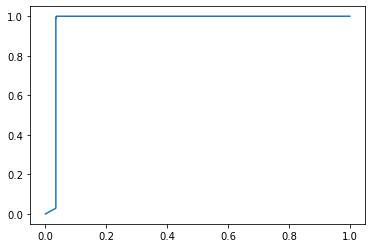

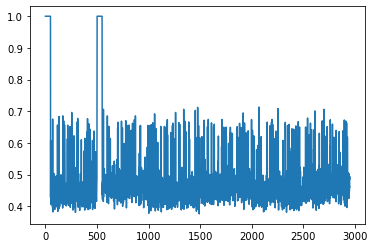

time used:17.03351330757141
TP: 2694 TN: 184 FP: 26 FN: 96
ACC: 0.9593333333333334 Precision: 0.9904411764705883 Recall: 0.9655913978494624 F1: 0.977858439201452
FPR: 0.12380952380952381 TPR: 0.9655913978494624
AUC: 0.897131763099505


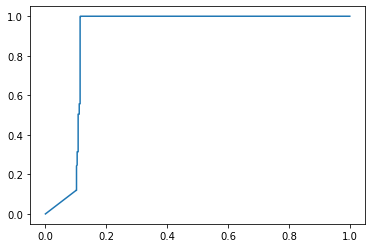

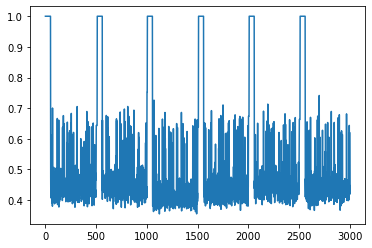

**********
window_size: 50
t: 100
phi: 25
thresh: 0.55
time used:11.503976106643677
TP: 2742 TN: 200 FP: 7 FN: 1
ACC: 0.9972881355932204 Precision: 0.9974536194979993 Recall: 0.999635435654393 F1: 0.998543335761107
FPR: 0.033816425120772944 TPR: 0.999635435654393
AUC: 0.9662223208483254


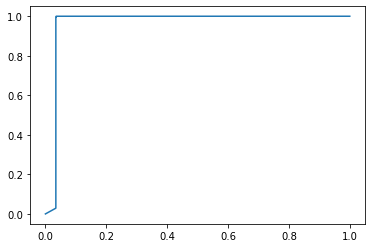

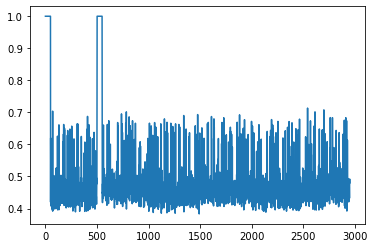

time used:17.032015323638916
TP: 2756 TN: 182 FP: 28 FN: 34
ACC: 0.9793333333333333 Precision: 0.9899425287356322 Recall: 0.9878136200716846 F1: 0.9888769285970578
FPR: 0.13333333333333333 TPR: 0.9878136200716846
AUC: 0.8974534903567162


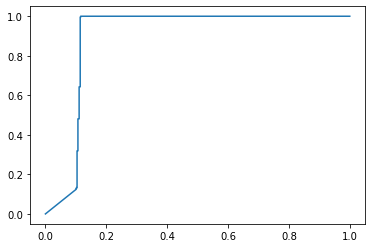

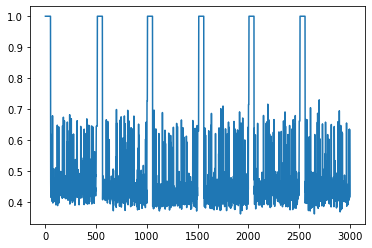

**********
window_size: 50
t: 100
phi: 25
thresh: 0.6
time used:11.518035173416138
TP: 2743 TN: 181 FP: 26 FN: 0
ACC: 0.9911864406779661 Precision: 0.9906103286384976 Recall: 1.0 F1: 0.9952830188679246
FPR: 0.12560386473429952 TPR: 1.0
AUC: 0.9661976643225355


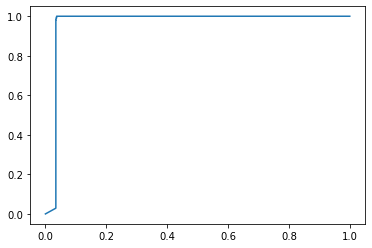

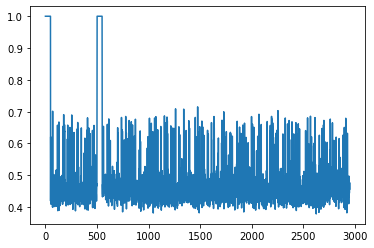

time used:17.086057662963867
TP: 2762 TN: 162 FP: 48 FN: 28
ACC: 0.9746666666666667 Precision: 0.9829181494661922 Recall: 0.9899641577060931 F1: 0.9864285714285714
FPR: 0.22857142857142856 TPR: 0.9899641577060931
AUC: 0.8973783922171019


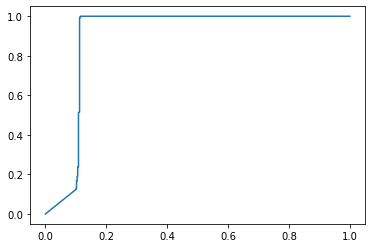

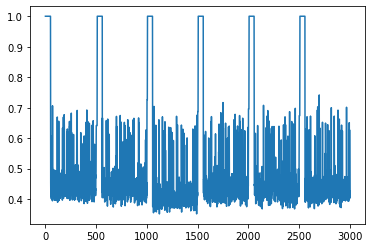

**********
window_size: 50
t: 100
phi: 25
thresh: 0.7
time used:11.464039325714111
TP: 2743 TN: 5 FP: 202 FN: 0
ACC: 0.9315254237288135 Precision: 0.9314091680814941 Recall: 1.0 F1: 0.9644866385372716
FPR: 0.9758454106280193 TPR: 1.0
AUC: 0.9662099925854305


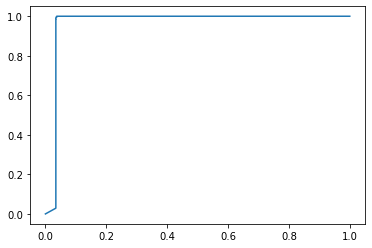

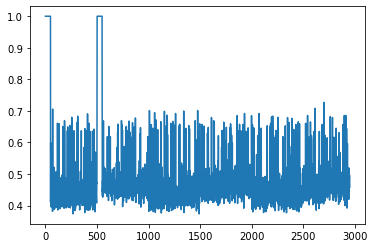

time used:16.99897861480713
TP: 2782 TN: 4 FP: 206 FN: 8
ACC: 0.9286666666666666 Precision: 0.9310575635876841 Recall: 0.9971326164874552 F1: 0.9629629629629629
FPR: 0.9809523809523809 TPR: 0.9971326164874552
AUC: 0.899010923365762


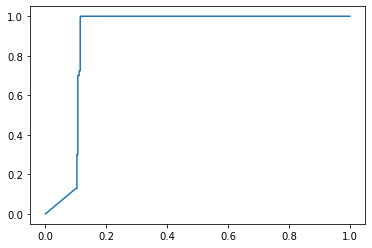

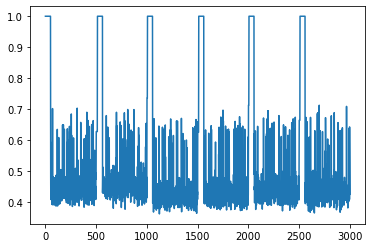

**********
window_size: 50
t: 100
phi: 37
thresh: 0.45
time used:11.604073286056519
TP: 2152 TN: 201 FP: 6 FN: 591
ACC: 0.7976271186440678 Precision: 0.9972196478220574 Recall: 0.7845424717462632 F1: 0.878188124872475
FPR: 0.028985507246376812 TPR: 0.7845424717462632
AUC: 0.9662240820287389


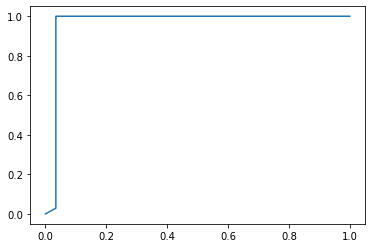

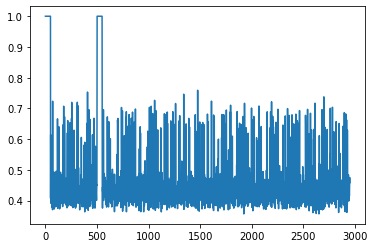

time used:17.258719205856323
TP: 2453 TN: 185 FP: 25 FN: 337
ACC: 0.8793333333333333 Precision: 0.989911218724778 Recall: 0.8792114695340502 F1: 0.931283219438117
FPR: 0.11904761904761904 TPR: 0.8792114695340502
AUC: 0.8982223928998122


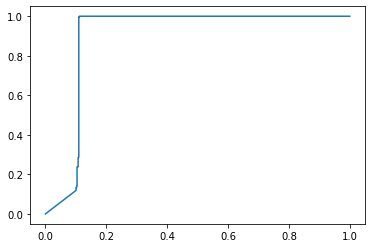

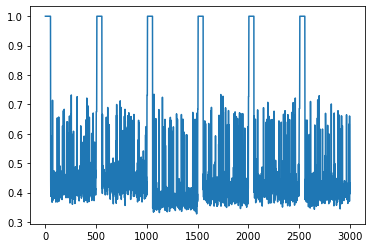

**********
window_size: 50
t: 100
phi: 37
thresh: 0.475
time used:11.639098882675171
TP: 2567 TN: 201 FP: 6 FN: 176
ACC: 0.9383050847457627 Precision: 0.9976680917217257 Recall: 0.935836675173168 F1: 0.9657637321294207
FPR: 0.028985507246376812 TPR: 0.935836675173168
AUC: 0.9662223208483254


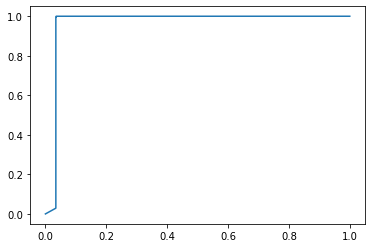

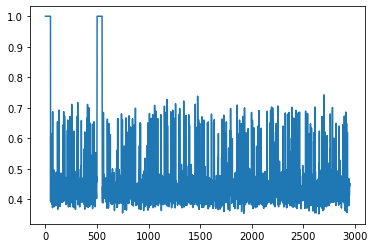

time used:17.17914891242981
TP: 2652 TN: 185 FP: 25 FN: 138
ACC: 0.9456666666666667 Precision: 0.9906611878968995 Recall: 0.9505376344086022 F1: 0.9701847448326322
FPR: 0.11904761904761904 TPR: 0.9505376344086022
AUC: 0.8980756101723844


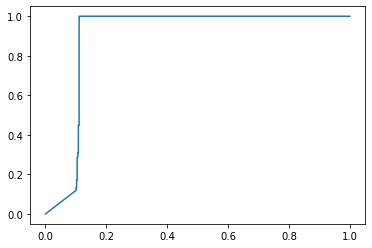

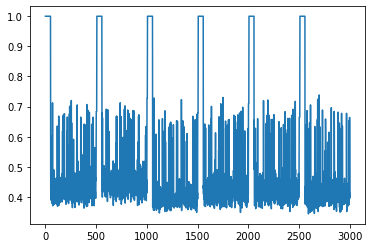

**********
window_size: 50
t: 100
phi: 37
thresh: 0.5
time used:11.591559171676636
TP: 2689 TN: 201 FP: 6 FN: 54
ACC: 0.9796610169491525 Precision: 0.997773654916512 Recall: 0.980313525337222 F1: 0.9889665318131666
FPR: 0.028985507246376812 TPR: 0.980313525337222
AUC: 0.9662170373070847


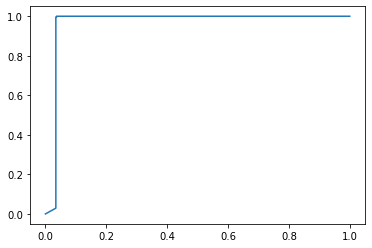

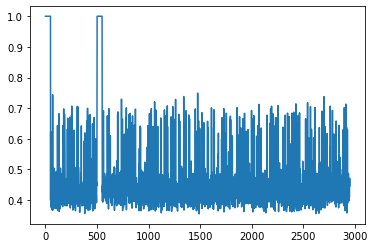

time used:17.247708320617676
TP: 2742 TN: 186 FP: 24 FN: 48
ACC: 0.976 Precision: 0.9913232104121475 Recall: 0.9827956989247312 F1: 0.9870410367170627
FPR: 0.11428571428571428 TPR: 0.9827956989247312
AUC: 0.8980218467315242


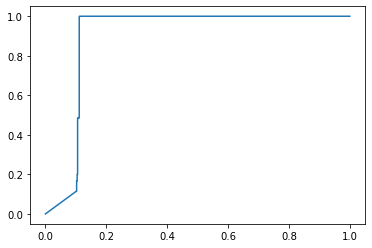

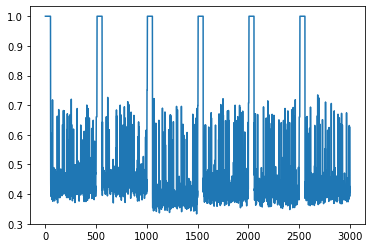

**********
window_size: 50
t: 100
phi: 37
thresh: 0.55
time used:11.620136499404907
TP: 2743 TN: 199 FP: 8 FN: 0
ACC: 0.9972881355932204 Precision: 0.9970919665576155 Recall: 1.0 F1: 0.9985438660356754
FPR: 0.03864734299516908 TPR: 1.0
AUC: 0.9662258432091525


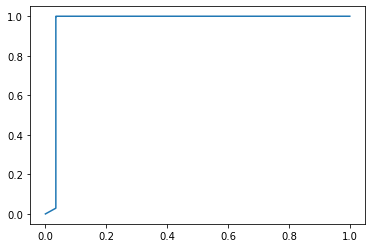

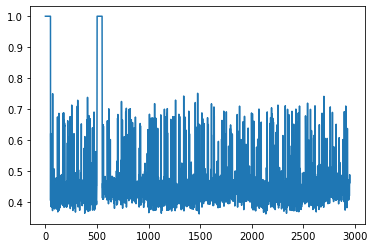

time used:16.548568964004517
TP: 2766 TN: 184 FP: 26 FN: 24
ACC: 0.9833333333333333 Precision: 0.9906876790830945 Recall: 0.9913978494623656 F1: 0.9910426370476532
FPR: 0.12380952380952381 TPR: 0.9913978494623656
AUC: 0.8988854753370883


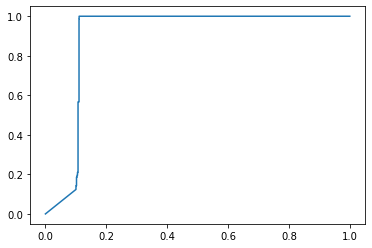

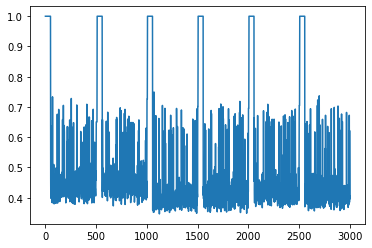

**********
window_size: 50
t: 100
phi: 37
thresh: 0.6
time used:11.655120134353638
TP: 2743 TN: 184 FP: 23 FN: 0
ACC: 0.9922033898305085 Precision: 0.9916847433116414 Recall: 1.0 F1: 0.995825013614086
FPR: 0.1111111111111111 TPR: 1.0
AUC: 0.966224082028739


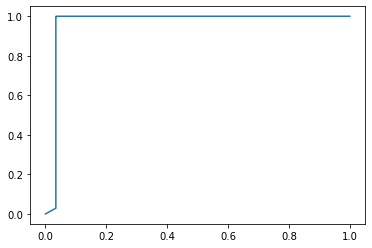

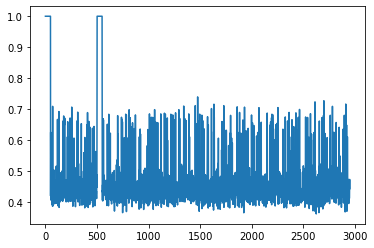

time used:17.167338609695435
TP: 2769 TN: 168 FP: 42 FN: 21
ACC: 0.979 Precision: 0.9850586979722519 Recall: 0.9924731182795699 F1: 0.9887520085698982
FPR: 0.2 TPR: 0.9924731182795699
AUC: 0.8982061785287592


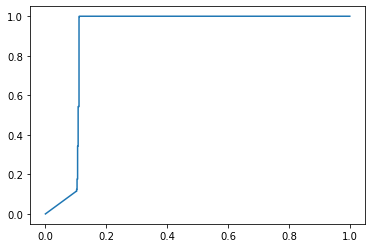

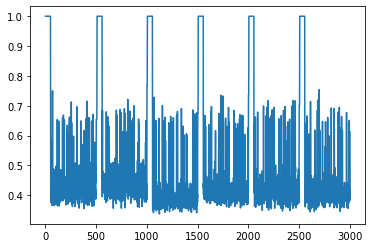

**********
window_size: 50
t: 100
phi: 37
thresh: 0.7
time used:11.589096069335938
TP: 2743 TN: 26 FP: 181 FN: 0
ACC: 0.9386440677966101 Precision: 0.9380984952120383 Recall: 1.0 F1: 0.9680607023116288
FPR: 0.8743961352657005 TPR: 1.0
AUC: 0.9662276043895661


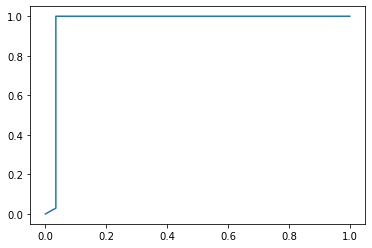

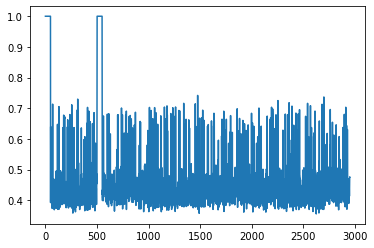

time used:17.164135694503784
TP: 2787 TN: 16 FP: 194 FN: 3
ACC: 0.9343333333333333 Precision: 0.9349211673934921 Recall: 0.9989247311827957 F1: 0.9658638017674579
FPR: 0.9238095238095239 TPR: 0.9989247311827957
AUC: 0.897974057006315


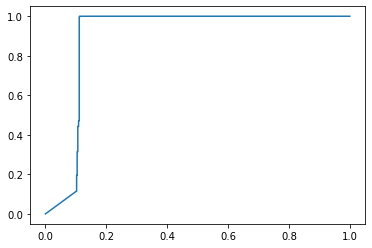

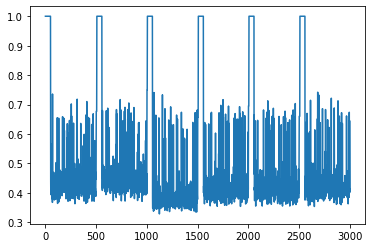

**********
window_size: 50
t: 100
phi: 45
thresh: 0.45
time used:11.631191968917847
TP: 2337 TN: 201 FP: 6 FN: 406
ACC: 0.8603389830508474 Precision: 0.9974391805377721 Recall: 0.8519868756835581 F1: 0.9189933149823044
FPR: 0.028985507246376812 TPR: 0.8519868756835581
AUC: 0.9662223208483254


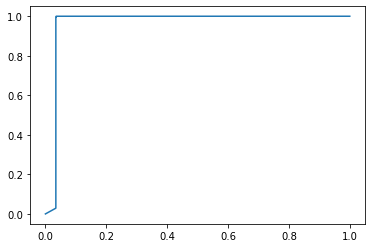

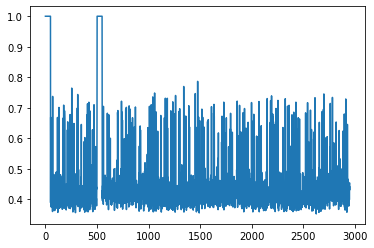

time used:17.33829402923584
TP: 2580 TN: 186 FP: 24 FN: 210
ACC: 0.922 Precision: 0.9907834101382489 Recall: 0.9247311827956989 F1: 0.9566184649610678
FPR: 0.11428571428571428 TPR: 0.9247311827956989
AUC: 0.8990271377368151


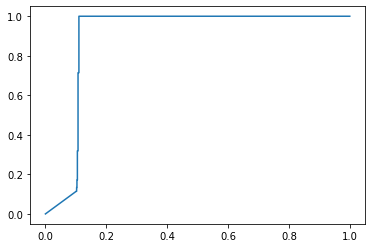

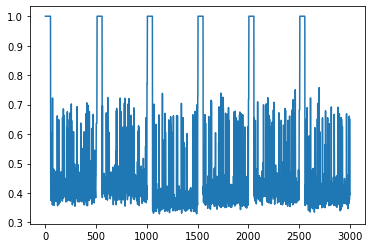

**********
window_size: 50
t: 100
phi: 45
thresh: 0.475
time used:11.682138442993164
TP: 2635 TN: 201 FP: 6 FN: 108
ACC: 0.9613559322033899 Precision: 0.9977281332828474 Recall: 0.9606270506744441 F1: 0.9788261515601784
FPR: 0.028985507246376812 TPR: 0.9606270506744441
AUC: 0.9662258432091525


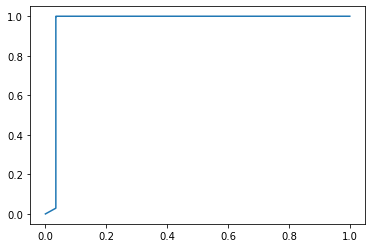

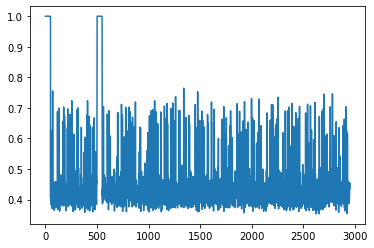

time used:17.287744998931885
TP: 2708 TN: 186 FP: 24 FN: 82
ACC: 0.9646666666666667 Precision: 0.9912152269399708 Recall: 0.9706093189964158 F1: 0.9808040565012677
FPR: 0.11428571428571428 TPR: 0.9706093189964158
AUC: 0.8985338795016214


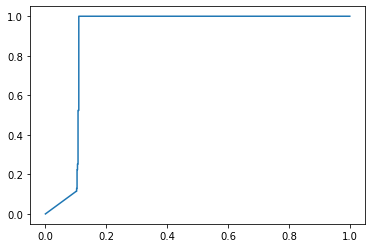

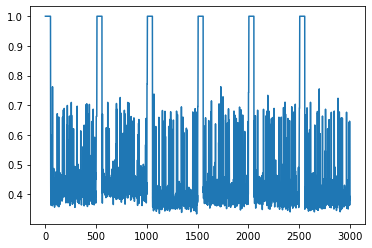

**********
window_size: 50
t: 100
phi: 45
thresh: 0.5
time used:11.627094030380249
TP: 2719 TN: 201 FP: 6 FN: 24
ACC: 0.9898305084745763 Precision: 0.9977981651376147 Recall: 0.991250455705432 F1: 0.9945135332845647
FPR: 0.028985507246376812 TPR: 0.991250455705432
AUC: 0.966224082028739


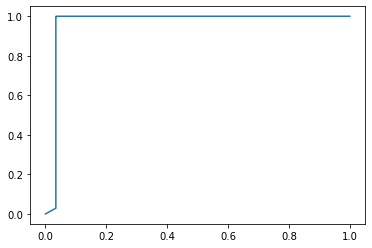

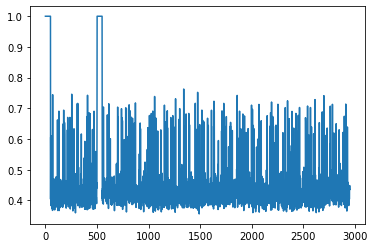

time used:17.2412052154541
TP: 2758 TN: 186 FP: 24 FN: 32
ACC: 0.9813333333333333 Precision: 0.99137311286844 Recall: 0.9885304659498207 F1: 0.9899497487437187
FPR: 0.11428571428571428 TPR: 0.9885304659498207
AUC: 0.8984041645331968


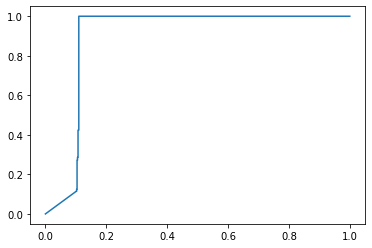

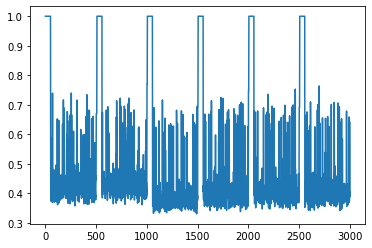

**********
window_size: 50
t: 100
phi: 45
thresh: 0.55
time used:11.591558694839478
TP: 2743 TN: 200 FP: 7 FN: 0
ACC: 0.9976271186440678 Precision: 0.9974545454545455 Recall: 1.0 F1: 0.998725650828327
FPR: 0.033816425120772944 TPR: 1.0
AUC: 0.966224082028739


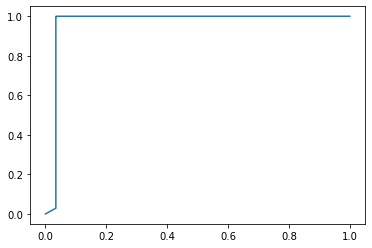

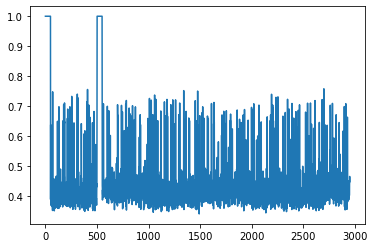

time used:17.270729064941406
TP: 2771 TN: 182 FP: 28 FN: 19
ACC: 0.9843333333333333 Precision: 0.9899964272954627 Recall: 0.9931899641577061 F1: 0.991590624440866
FPR: 0.13333333333333333 TPR: 0.9931899641577061
AUC: 0.8985031575354157


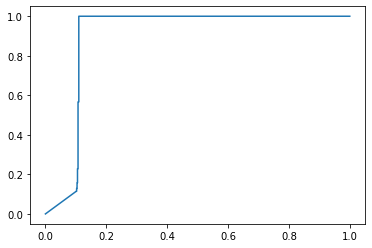

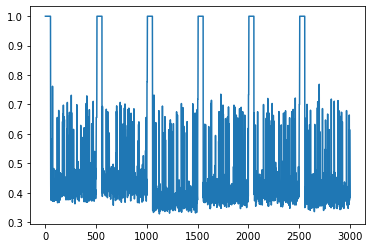

**********
window_size: 50
t: 100
phi: 45
thresh: 0.6
time used:11.621585607528687
TP: 2743 TN: 183 FP: 24 FN: 0
ACC: 0.991864406779661 Precision: 0.9913263462233466 Recall: 1.0 F1: 0.9956442831215971
FPR: 0.11594202898550725 TPR: 1.0
AUC: 0.9662276043895661


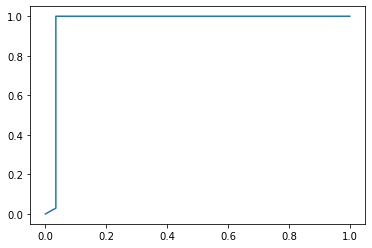

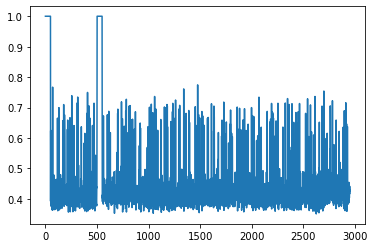

time used:17.37682580947876
TP: 2771 TN: 166 FP: 44 FN: 19
ACC: 0.979 Precision: 0.9843694493783304 Recall: 0.9931899641577061 F1: 0.9887600356824264
FPR: 0.20952380952380953 TPR: 0.9931899641577061
AUC: 0.8986806622290493


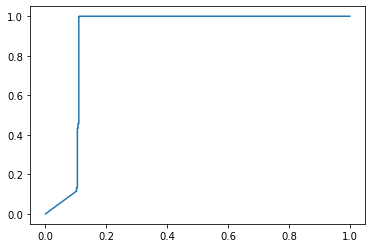

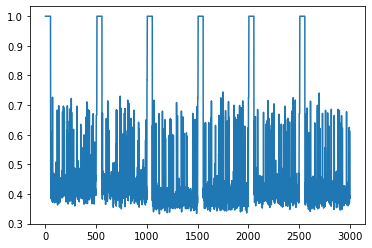

**********
window_size: 50
t: 100
phi: 45
thresh: 0.7
time used:11.632596015930176
TP: 2743 TN: 33 FP: 174 FN: 0
ACC: 0.9410169491525424 Precision: 0.9403496743229345 Recall: 1.0 F1: 0.9692579505300353
FPR: 0.8405797101449275 TPR: 1.0
AUC: 0.9662205596679118


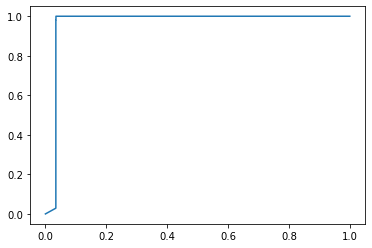

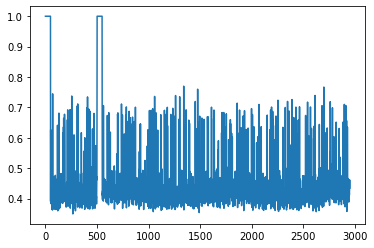

time used:17.259215593338013
TP: 2785 TN: 20 FP: 190 FN: 5
ACC: 0.935 Precision: 0.9361344537815126 Recall: 0.9982078853046595 F1: 0.966175195143105
FPR: 0.9047619047619048 TPR: 0.9982078853046595
AUC: 0.8983649086874893


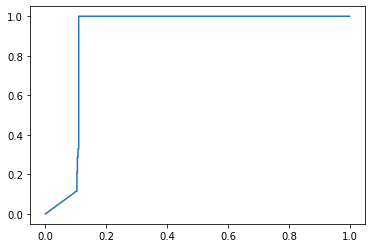

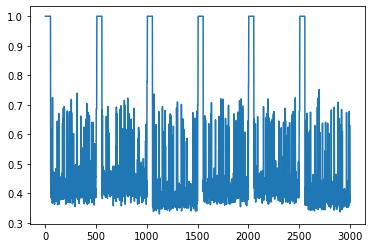

**********
window_size: 100
t: 20
phi: 10
thresh: 0.45
time used:10.487296342849731
TP: 347 TN: 192 FP: 11 FN: 2350
ACC: 0.18586206896551724 Precision: 0.9692737430167597 Recall: 0.12866147571375602 F1: 0.2271685761047463
FPR: 0.054187192118226604 TPR: 0.12866147571375602
AUC: 0.9157100299365653


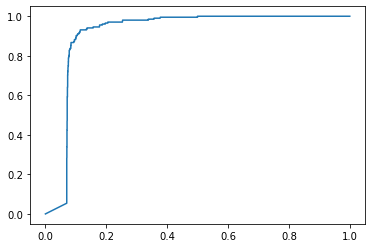

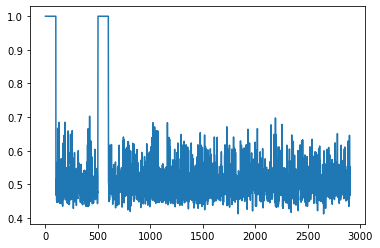

time used:15.390520572662354
TP: 490 TN: 182 FP: 28 FN: 2300
ACC: 0.224 Precision: 0.9459459459459459 Recall: 0.17562724014336917 F1: 0.29625151148730344
FPR: 0.13333333333333333 TPR: 0.17562724014336917
AUC: 0.7816914149172214


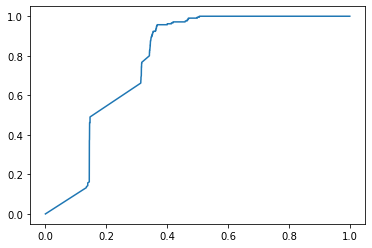

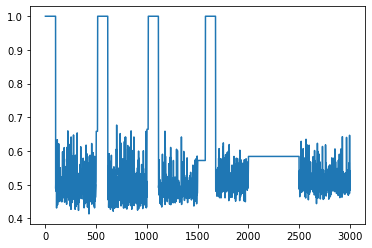

**********
window_size: 100
t: 20
phi: 10
thresh: 0.475
time used:10.266479969024658
TP: 852 TN: 192 FP: 11 FN: 1845
ACC: 0.36 Precision: 0.9872537659327926 Recall: 0.31590656284760843 F1: 0.47865168539325836
FPR: 0.054187192118226604 TPR: 0.31590656284760843
AUC: 0.917364851659662


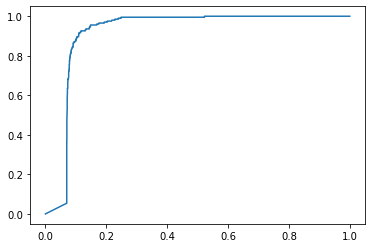

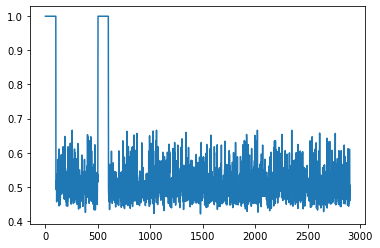

time used:12.245651721954346
TP: 1467 TN: 171 FP: 39 FN: 1323
ACC: 0.546 Precision: 0.9741035856573705 Recall: 0.5258064516129032 F1: 0.6829608938547485
FPR: 0.18571428571428572 TPR: 0.5258064516129032
AUC: 0.7883188257381806


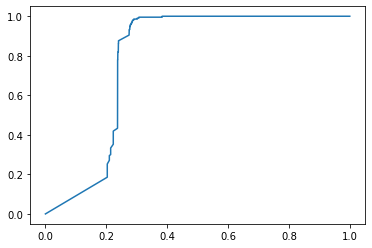

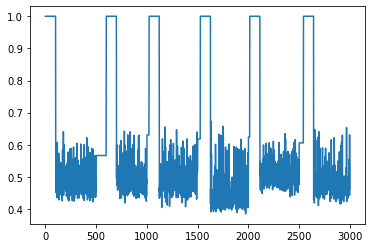

**********
window_size: 100
t: 20
phi: 10
thresh: 0.5
time used:10.27045488357544
TP: 1583 TN: 191 FP: 12 FN: 1114
ACC: 0.6117241379310345 Precision: 0.9924764890282132 Recall: 0.5869484612532443 F1: 0.7376514445479962
FPR: 0.059113300492610835 TPR: 0.5869484612532443
AUC: 0.9194982200620649


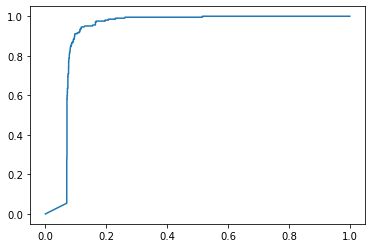

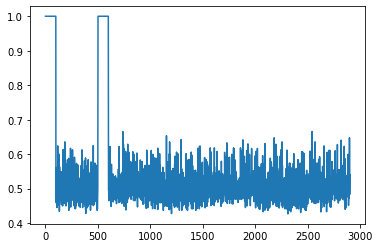

time used:11.441421747207642
TP: 1923 TN: 170 FP: 40 FN: 867
ACC: 0.6976666666666667 Precision: 0.9796230259806419 Recall: 0.689247311827957 F1: 0.8091731537976015
FPR: 0.19047619047619047 TPR: 0.689247311827957
AUC: 0.7710300392558457


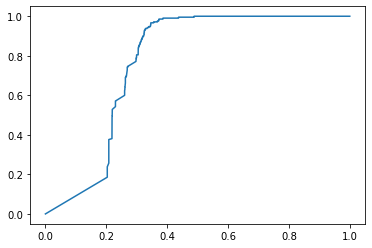

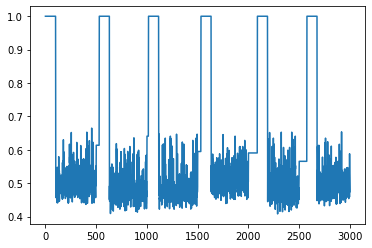

**********
window_size: 100
t: 20
phi: 10
thresh: 0.55
time used:10.28287124633789
TP: 2671 TN: 178 FP: 25 FN: 26
ACC: 0.9824137931034482 Precision: 0.990727002967359 Recall: 0.9903596588802372 F1: 0.9905432968663083
FPR: 0.12315270935960591 TPR: 0.9903596588802372
AUC: 0.9275549735064139


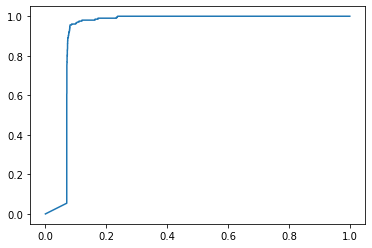

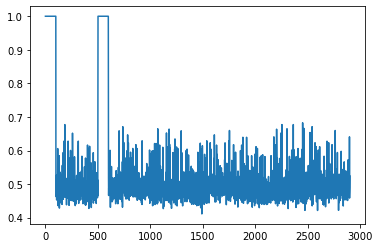

time used:15.770362377166748
TP: 2692 TN: 135 FP: 75 FN: 98
ACC: 0.9423333333333334 Precision: 0.9728948319479581 Recall: 0.9648745519713262 F1: 0.9688680942954834
FPR: 0.35714285714285715 TPR: 0.9648745519713262
AUC: 0.8353942652329749


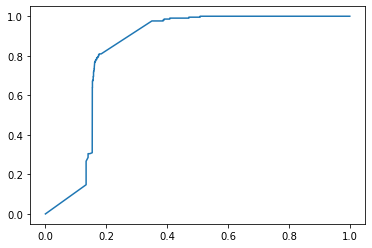

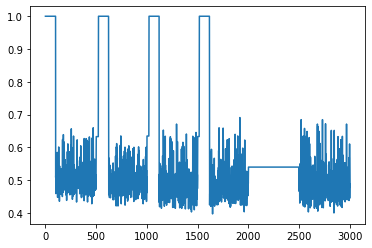

**********
window_size: 100
t: 20
phi: 10
thresh: 0.6
time used:10.28050446510315
TP: 2688 TN: 106 FP: 97 FN: 9
ACC: 0.9634482758620689 Precision: 0.9651705565529622 Recall: 0.996662958843159 F1: 0.9806639912440714
FPR: 0.47783251231527096 TPR: 0.996662958843159
AUC: 0.9155447304156599


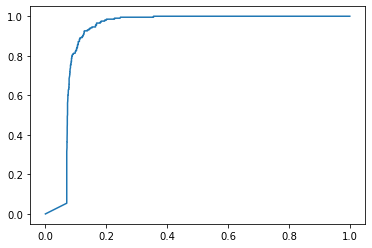

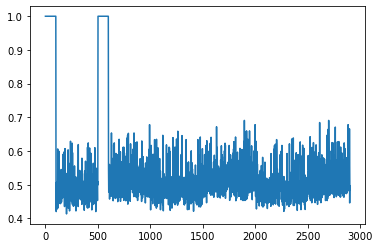

time used:12.122539520263672
TP: 2716 TN: 92 FP: 118 FN: 74
ACC: 0.936 Precision: 0.958362738179252 Recall: 0.9734767025089606 F1: 0.9658605974395448
FPR: 0.5619047619047619 TPR: 0.9734767025089606
AUC: 0.7915497525174945


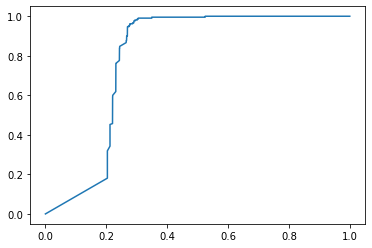

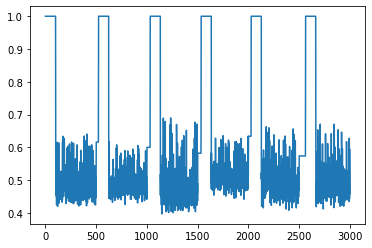

**********
window_size: 100
t: 20
phi: 10
thresh: 0.7
time used:10.28837251663208
TP: 2697 TN: 0 FP: 203 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9239165575324526


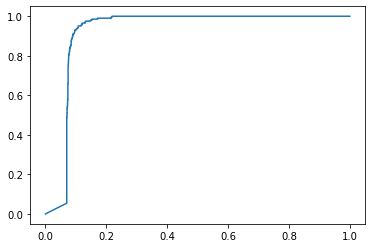

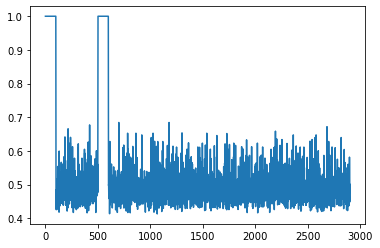

time used:13.191519021987915
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7954830175797918


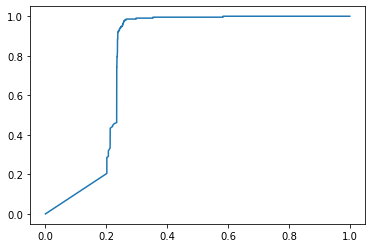

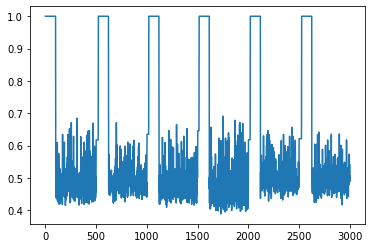

**********
window_size: 100
t: 20
phi: 25
thresh: 0.45
time used:10.300435543060303
TP: 1411 TN: 192 FP: 11 FN: 1286
ACC: 0.5527586206896552 Precision: 0.9922644163150492 Recall: 0.5231738969225065 F1: 0.6851177470259773
FPR: 0.054187192118226604 TPR: 0.5231738969225065
AUC: 0.9312655367850796


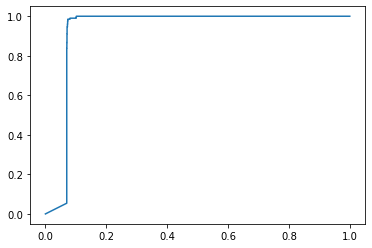

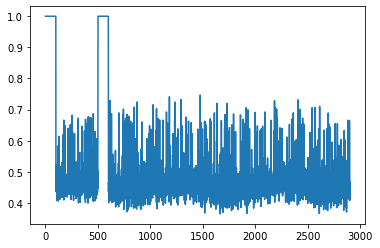

time used:13.982232332229614
TP: 2068 TN: 165 FP: 45 FN: 722
ACC: 0.7443333333333333 Precision: 0.9787032654992901 Recall: 0.7412186379928315 F1: 0.8435651641851928
FPR: 0.21428571428571427 TPR: 0.7412186379928315
AUC: 0.8125226147806792


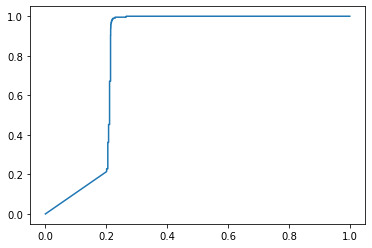

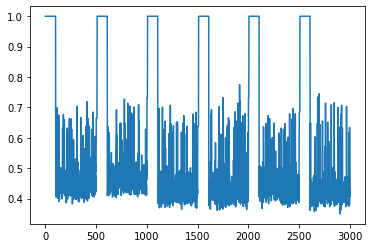

**********
window_size: 100
t: 20
phi: 25
thresh: 0.475
time used:10.37095308303833
TP: 1714 TN: 192 FP: 11 FN: 983
ACC: 0.6572413793103449 Precision: 0.9936231884057971 Recall: 0.635520949202818 F1: 0.7752148349163275
FPR: 0.054187192118226604 TPR: 0.635520949202818
AUC: 0.9313915662540572


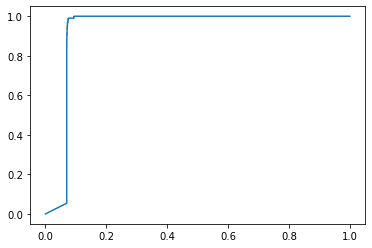

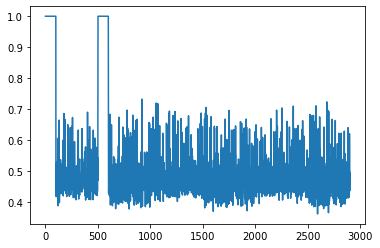

time used:14.50472617149353
TP: 2404 TN: 165 FP: 45 FN: 386
ACC: 0.8563333333333333 Precision: 0.981625153123724 Recall: 0.8616487455197133 F1: 0.9177323916778011
FPR: 0.21428571428571427 TPR: 0.8616487455197133
AUC: 0.8106571087216248


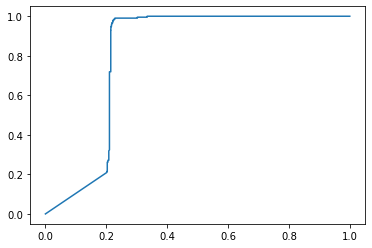

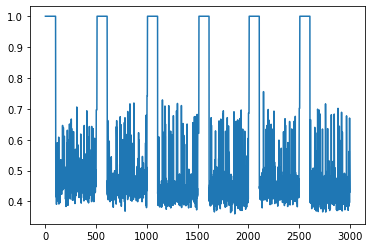

**********
window_size: 100
t: 20
phi: 25
thresh: 0.5
time used:10.327415227890015
TP: 2409 TN: 192 FP: 11 FN: 288
ACC: 0.896896551724138 Precision: 0.9954545454545455 Recall: 0.8932146829810901 F1: 0.9415673246042603
FPR: 0.054187192118226604 TPR: 0.8932146829810901
AUC: 0.931663716846487


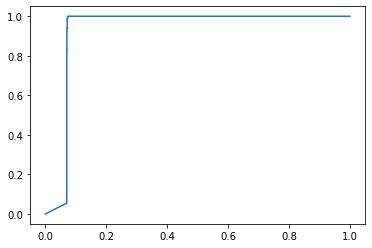

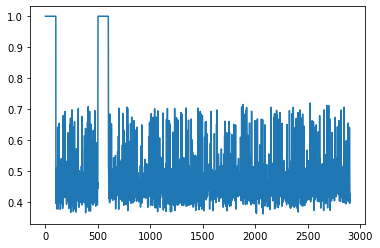

time used:14.345575094223022
TP: 2597 TN: 165 FP: 45 FN: 193
ACC: 0.9206666666666666 Precision: 0.9829674489023467 Recall: 0.9308243727598566 F1: 0.9561855670103092
FPR: 0.21428571428571427 TPR: 0.9308243727598566
AUC: 0.8123391363713945


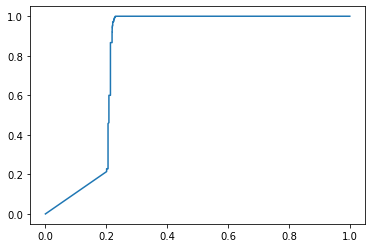

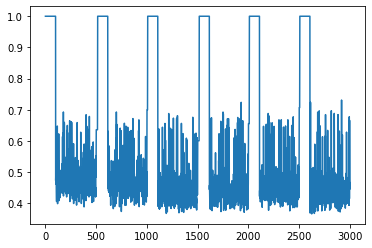

**********
window_size: 100
t: 20
phi: 25
thresh: 0.55
time used:10.319492101669312
TP: 2670 TN: 189 FP: 14 FN: 27
ACC: 0.9858620689655172 Precision: 0.9947839046199702 Recall: 0.9899888765294772 F1: 0.9923805984017842
FPR: 0.06896551724137931 TPR: 0.9899888765294772
AUC: 0.9309002339764489


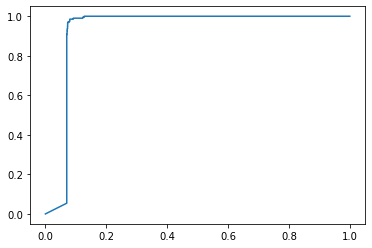

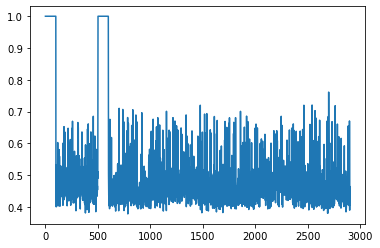

time used:13.441242456436157
TP: 2743 TN: 160 FP: 50 FN: 47
ACC: 0.9676666666666667 Precision: 0.9820981023988543 Recall: 0.9831541218637992 F1: 0.9826258284076662
FPR: 0.23809523809523808 TPR: 0.9831541218637992
AUC: 0.8128716504522956


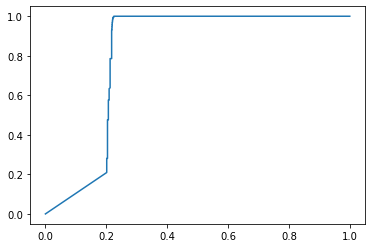

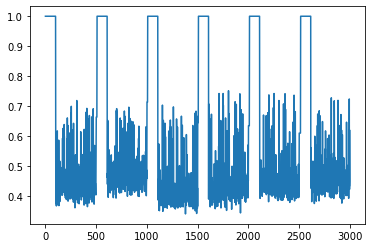

**********
window_size: 100
t: 20
phi: 25
thresh: 0.6
time used:10.357059001922607
TP: 2697 TN: 158 FP: 45 FN: 0
ACC: 0.9844827586206897 Precision: 0.9835886214442013 Recall: 1.0 F1: 0.9917264202978489
FPR: 0.22167487684729065 TPR: 1.0
AUC: 0.9309623354539162


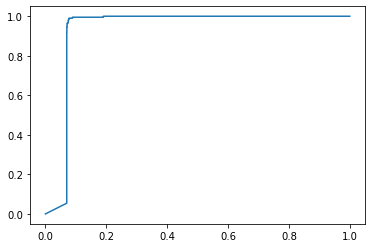

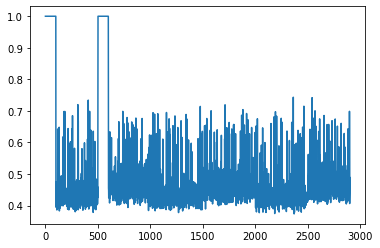

time used:14.347251415252686
TP: 2757 TN: 125 FP: 85 FN: 33
ACC: 0.9606666666666667 Precision: 0.97009148486981 Recall: 0.9881720430107527 F1: 0.9790482954545454
FPR: 0.40476190476190477 TPR: 0.9881720430107527
AUC: 0.8107031916709336


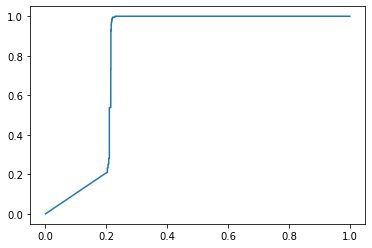

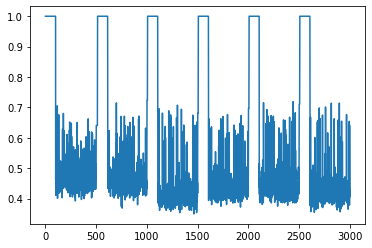

**********
window_size: 100
t: 20
phi: 25
thresh: 0.7
time used:10.289001941680908
TP: 2697 TN: 11 FP: 192 FN: 0
ACC: 0.9337931034482758 Precision: 0.9335410176531672 Recall: 1.0 F1: 0.9656283566058002
FPR: 0.9458128078817734 TPR: 1.0
AUC: 0.9307614189091692


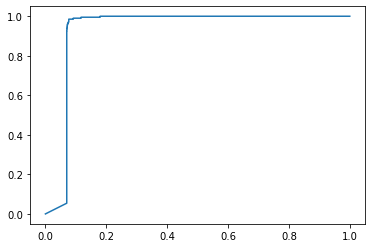

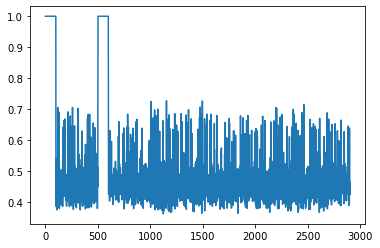

time used:14.41668152809143
TP: 2790 TN: 16 FP: 194 FN: 0
ACC: 0.9353333333333333 Precision: 0.9349865951742627 Recall: 1.0 F1: 0.966401108417042
FPR: 0.9238095238095239 TPR: 1.0
AUC: 0.8084852363884623


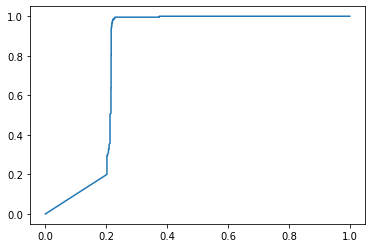

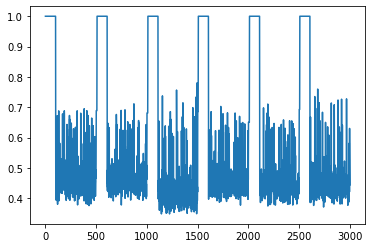

**********
window_size: 100
t: 20
phi: 50
thresh: 0.45
time used:10.36295461654663
TP: 2258 TN: 192 FP: 11 FN: 439
ACC: 0.8448275862068966 Precision: 0.9951520493609519 Recall: 0.8372265480163145 F1: 0.9093838099073701
FPR: 0.054187192118226604 TPR: 0.8372265480163145
AUC: 0.9316673698745732


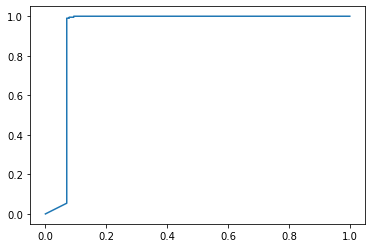

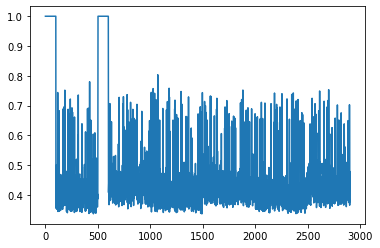

time used:14.624326467514038
TP: 2532 TN: 166 FP: 44 FN: 258
ACC: 0.8993333333333333 Precision: 0.9829192546583851 Recall: 0.9075268817204301 F1: 0.9437197167349981
FPR: 0.20952380952380953 TPR: 0.9075268817204301
AUC: 0.8146202423621778


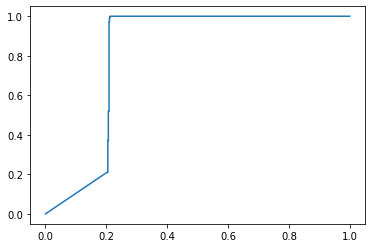

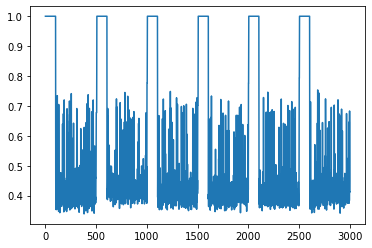

**********
window_size: 100
t: 20
phi: 50
thresh: 0.475
time used:10.392497301101685
TP: 2564 TN: 192 FP: 11 FN: 133
ACC: 0.9503448275862069 Precision: 0.9957281553398059 Recall: 0.9506859473489062 F1: 0.9726858877086495
FPR: 0.054187192118226604 TPR: 0.9506859473489062
AUC: 0.9316929410711775


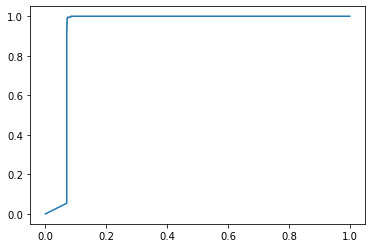

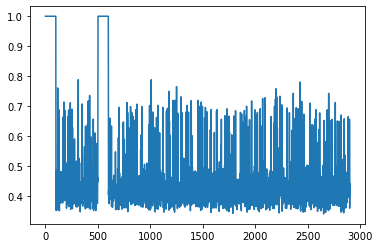

time used:14.598793745040894
TP: 2682 TN: 166 FP: 44 FN: 108
ACC: 0.9493333333333334 Precision: 0.9838591342626559 Recall: 0.9612903225806452 F1: 0.9724437998549673
FPR: 0.20952380952380953 TPR: 0.9612903225806452
AUC: 0.8146765659668885


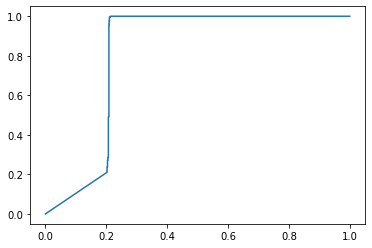

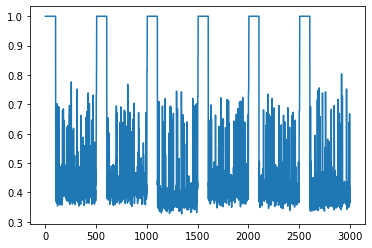

**********
window_size: 100
t: 20
phi: 50
thresh: 0.5
time used:10.322961807250977
TP: 2614 TN: 192 FP: 11 FN: 83
ACC: 0.9675862068965517 Precision: 0.9958095238095238 Recall: 0.9692250648869114 F1: 0.9823374671176248
FPR: 0.054187192118226604 TPR: 0.9692250648869114
AUC: 0.9314975040685599


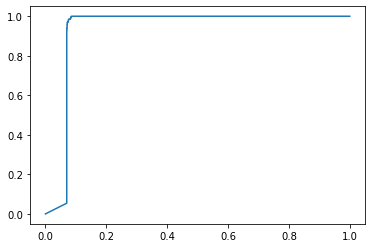

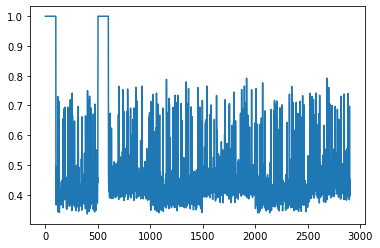

time used:14.634330034255981
TP: 2751 TN: 166 FP: 44 FN: 39
ACC: 0.9723333333333334 Precision: 0.984257602862254 Recall: 0.986021505376344 F1: 0.9851387645478961
FPR: 0.20952380952380953 TPR: 0.986021505376344
AUC: 0.8149325823519372


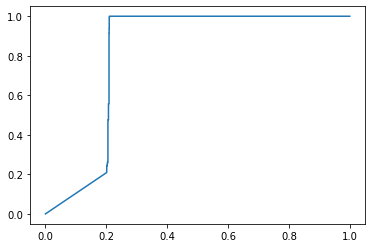

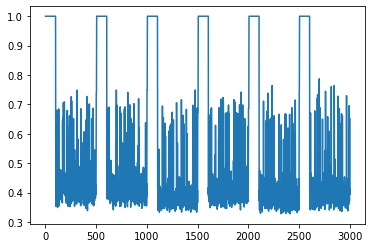

**********
window_size: 100
t: 20
phi: 50
thresh: 0.55
time used:10.322901248931885
TP: 2695 TN: 188 FP: 15 FN: 2
ACC: 0.9941379310344828 Precision: 0.9944649446494465 Recall: 0.9992584352984798 F1: 0.9968559275013871
FPR: 0.07389162561576355 TPR: 0.9992584352984798
AUC: 0.9317787872312057


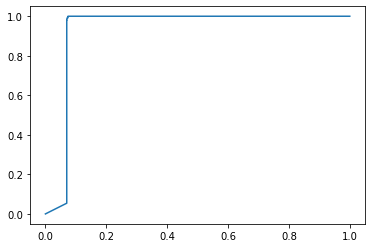

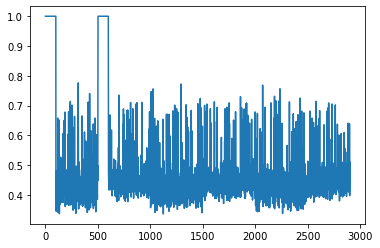

time used:14.652850151062012
TP: 2771 TN: 163 FP: 47 FN: 19
ACC: 0.978 Precision: 0.9833215046132009 Recall: 0.9931899641577061 F1: 0.9882310984308131
FPR: 0.22380952380952382 TPR: 0.9931899641577061
AUC: 0.8147687318655062


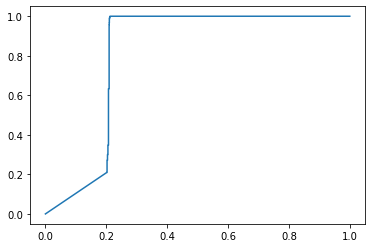

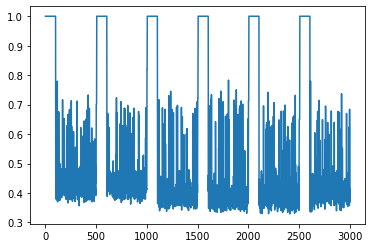

**********
window_size: 100
t: 20
phi: 50
thresh: 0.6
time used:10.393474817276001
TP: 2696 TN: 181 FP: 22 FN: 1
ACC: 0.9920689655172413 Precision: 0.9919058130978661 Recall: 0.9996292176492398 F1: 0.9957525392428439
FPR: 0.10837438423645321 TPR: 0.9996292176492398
AUC: 0.9315778706864588


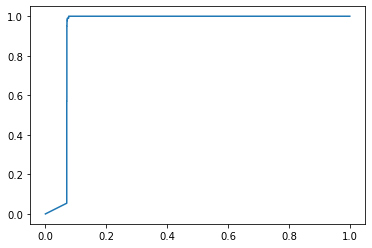

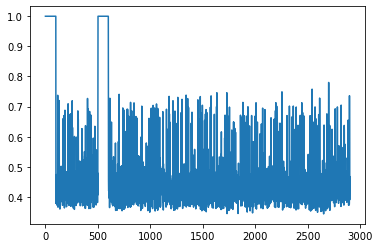

time used:14.574307680130005
TP: 2768 TN: 147 FP: 63 FN: 22
ACC: 0.9716666666666667 Precision: 0.9777463793712469 Recall: 0.9921146953405018 F1: 0.984878135563067
FPR: 0.3 TPR: 0.9921146953405018
AUC: 0.8146407236729818


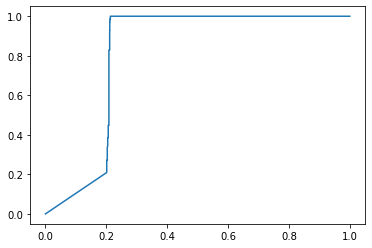

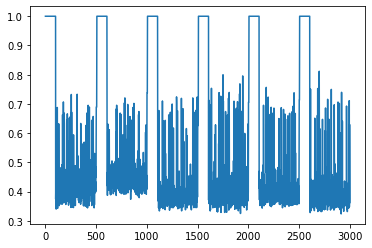

**********
window_size: 100
t: 20
phi: 50
thresh: 0.7
time used:10.345467805862427
TP: 2697 TN: 48 FP: 155 FN: 0
ACC: 0.946551724137931 Precision: 0.9456521739130435 Recall: 1.0 F1: 0.9720670391061452
FPR: 0.7635467980295566 TPR: 1.0
AUC: 0.9317440834643858


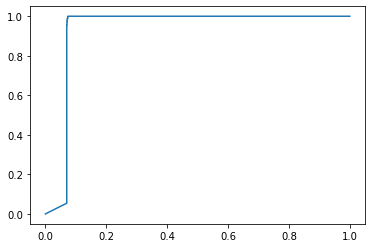

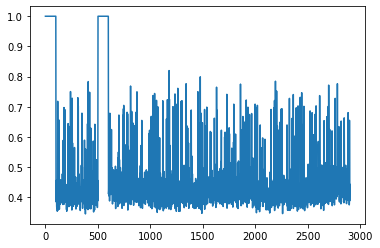

time used:13.951204061508179
TP: 2786 TN: 49 FP: 161 FN: 4
ACC: 0.945 Precision: 0.9453681710213777 Recall: 0.9985663082437276 F1: 0.9712393236883388
FPR: 0.7666666666666667 TPR: 0.9985663082437276
AUC: 0.8151254480286738


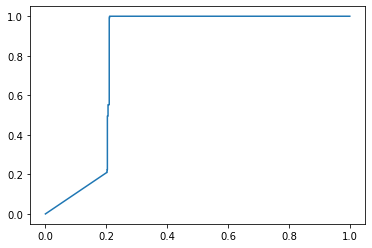

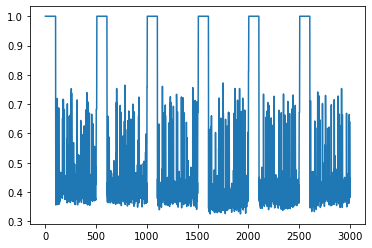

**********
window_size: 100
t: 20
phi: 75
thresh: 0.45
time used:10.36918568611145
TP: 2511 TN: 192 FP: 11 FN: 186
ACC: 0.9320689655172414 Precision: 0.9956383822363204 Recall: 0.9310344827586207 F1: 0.9622533052308871
FPR: 0.054187192118226604 TPR: 0.9310344827586207
AUC: 0.9317897463154645


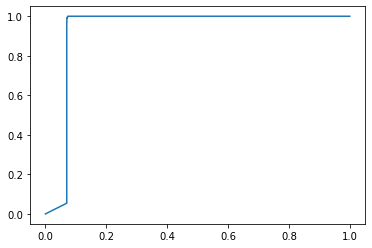

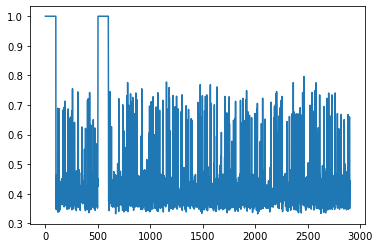

time used:14.651345491409302
TP: 2689 TN: 166 FP: 44 FN: 101
ACC: 0.9516666666666667 Precision: 0.9839004756677644 Recall: 0.9637992831541219 F1: 0.9737461524533768
FPR: 0.20952380952380953 TPR: 0.9637992831541219
AUC: 0.8159173920464242


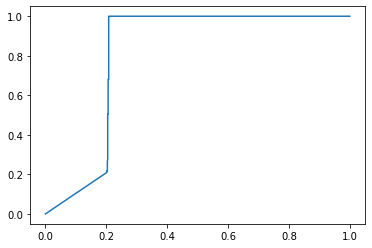

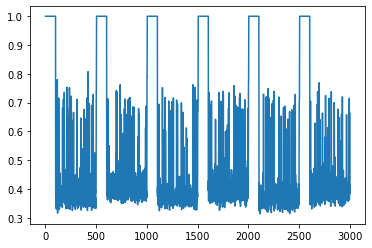

**********
window_size: 100
t: 20
phi: 75
thresh: 0.475
time used:10.408986330032349
TP: 2634 TN: 192 FP: 11 FN: 63
ACC: 0.9744827586206897 Precision: 0.9958412098298677 Recall: 0.9766407119021134 F1: 0.9861475102957693
FPR: 0.054187192118226604 TPR: 0.9766407119021134
AUC: 0.9317915728295076


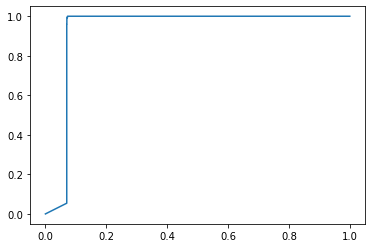

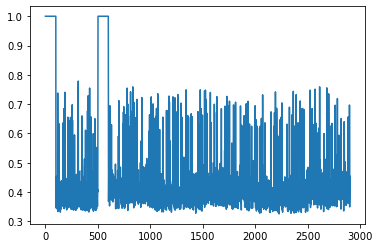

time used:14.638840198516846
TP: 2748 TN: 166 FP: 44 FN: 42
ACC: 0.9713333333333334 Precision: 0.9842406876790831 Recall: 0.9849462365591398 F1: 0.9845933357219635
FPR: 0.20952380952380953 TPR: 0.9849462365591398
AUC: 0.8158661887694146


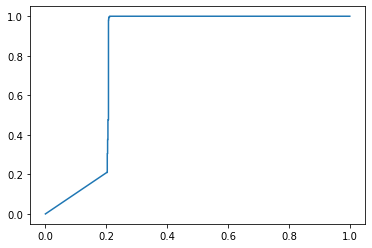

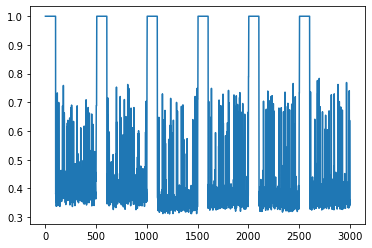

**********
window_size: 100
t: 20
phi: 75
thresh: 0.5
time used:10.393593072891235
TP: 2680 TN: 192 FP: 11 FN: 17
ACC: 0.9903448275862069 Precision: 0.9959123002601263 Recall: 0.9936967000370782 F1: 0.9948032665181885
FPR: 0.054187192118226604 TPR: 0.9936967000370782
AUC: 0.9318171440261119


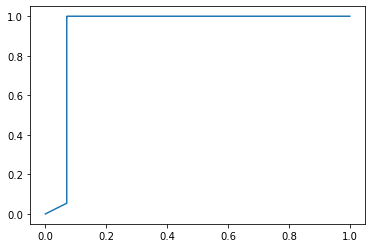

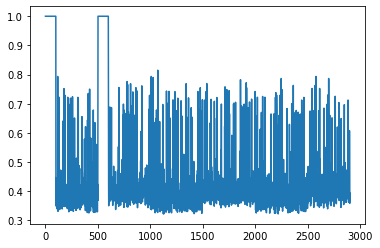

time used:14.720450162887573
TP: 2778 TN: 165 FP: 45 FN: 12
ACC: 0.981 Precision: 0.9840595111583422 Recall: 0.9956989247311828 F1: 0.9898450026723677
FPR: 0.21428571428571427 TPR: 0.9956989247311828
AUC: 0.8162143710530808


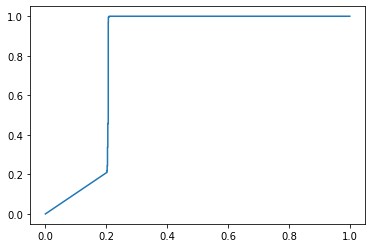

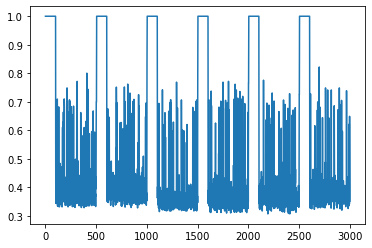

**********
window_size: 100
t: 20
phi: 75
thresh: 0.55
time used:10.381511688232422
TP: 2696 TN: 190 FP: 13 FN: 1
ACC: 0.9951724137931034 Precision: 0.9952011812476929 Recall: 0.9996292176492398 F1: 0.9974102848686643
FPR: 0.06403940886699508 TPR: 0.9996292176492398
AUC: 0.9317970523716371


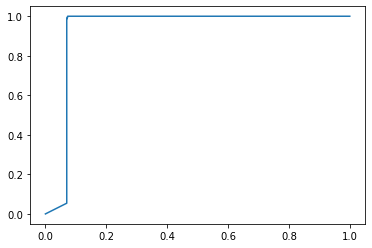

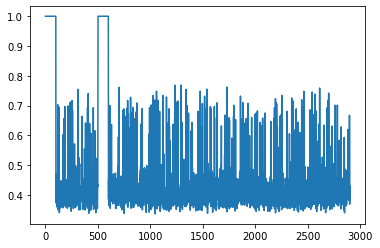

time used:14.687384366989136
TP: 2776 TN: 165 FP: 45 FN: 14
ACC: 0.9803333333333333 Precision: 0.9840482098546615 Recall: 0.9949820788530466 F1: 0.9894849402958474
FPR: 0.21428571428571427 TPR: 0.9949820788530466
AUC: 0.815010240655402


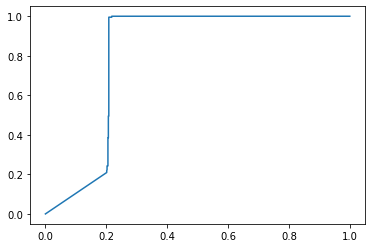

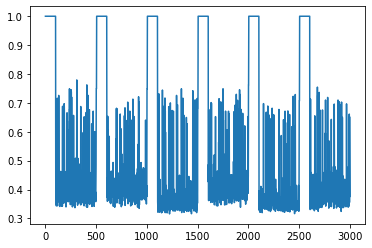

**********
window_size: 100
t: 20
phi: 75
thresh: 0.6
time used:10.412506580352783
TP: 2697 TN: 172 FP: 31 FN: 0
ACC: 0.9893103448275862 Precision: 0.9886363636363636 Recall: 1.0 F1: 0.9942857142857142
FPR: 0.15270935960591134 TPR: 1.0
AUC: 0.9317879198014214


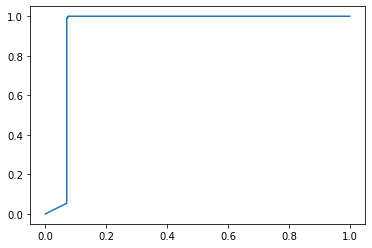

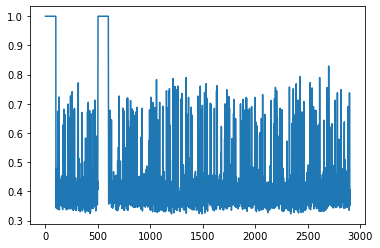

time used:14.954148054122925
TP: 2778 TN: 145 FP: 65 FN: 12
ACC: 0.9743333333333334 Precision: 0.9771368272951108 Recall: 0.9956989247311828 F1: 0.9863305521036747
FPR: 0.30952380952380953 TPR: 0.9956989247311828
AUC: 0.8153678102065198


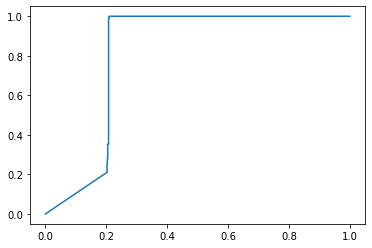

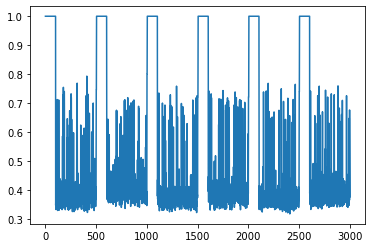

**********
window_size: 100
t: 20
phi: 75
thresh: 0.7
time used:10.3860445022583
TP: 2697 TN: 70 FP: 133 FN: 0
ACC: 0.9541379310344827 Precision: 0.9530035335689045 Recall: 1.0 F1: 0.9759363126470056
FPR: 0.6551724137931034 TPR: 1.0
AUC: 0.9318061849418529


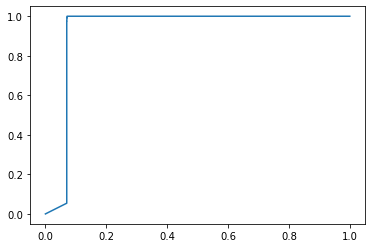

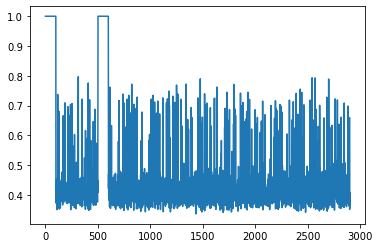

time used:14.647879123687744
TP: 2781 TN: 36 FP: 174 FN: 9
ACC: 0.939 Precision: 0.9411167512690355 Recall: 0.9967741935483871 F1: 0.9681462140992168
FPR: 0.8285714285714286 TPR: 0.9967741935483871
AUC: 0.815231268134494


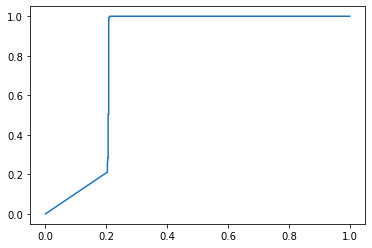

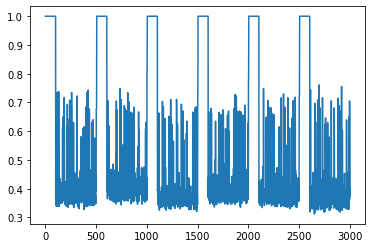

**********
window_size: 100
t: 20
phi: 90
thresh: 0.45
time used:10.393965244293213
TP: 2623 TN: 192 FP: 11 FN: 74
ACC: 0.9706896551724138 Precision: 0.9958238420653 Recall: 0.9725621060437524 F1: 0.9840555242918778
FPR: 0.054187192118226604 TPR: 0.9725621060437524
AUC: 0.9318116644839824


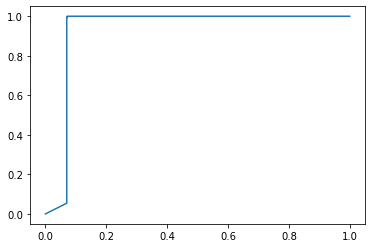

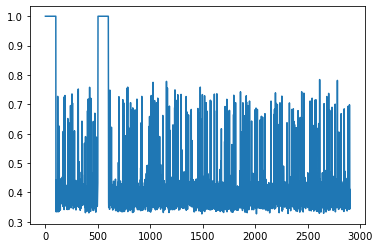

time used:14.633328437805176
TP: 2742 TN: 166 FP: 44 FN: 48
ACC: 0.9693333333333334 Precision: 0.9842067480258435 Recall: 0.9827956989247312 F1: 0.9835007173601148
FPR: 0.20952380952380953 TPR: 0.9827956989247312
AUC: 0.8155760368663595


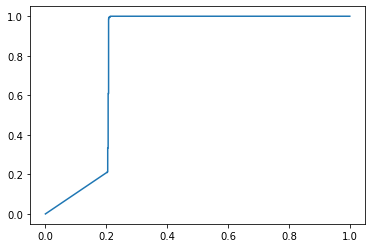

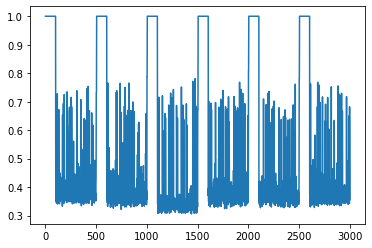

**********
window_size: 100
t: 20
phi: 90
thresh: 0.475
time used:10.362237215042114
TP: 2625 TN: 192 FP: 11 FN: 72
ACC: 0.9713793103448276 Precision: 0.9958270106221547 Recall: 0.9733036707452726 F1: 0.9844365272829553
FPR: 0.054187192118226604 TPR: 0.9733036707452726
AUC: 0.9317970523716371


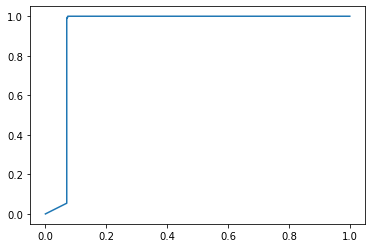

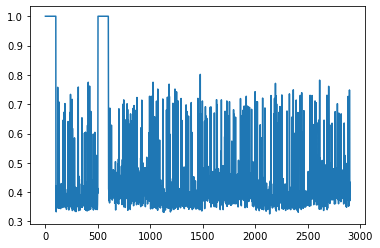

time used:14.670859575271606
TP: 2762 TN: 165 FP: 45 FN: 28
ACC: 0.9756666666666667 Precision: 0.9839686498040613 Recall: 0.9899641577060931 F1: 0.9869572985527962
FPR: 0.21428571428571427 TPR: 0.9899641577060931
AUC: 0.8156169994879673


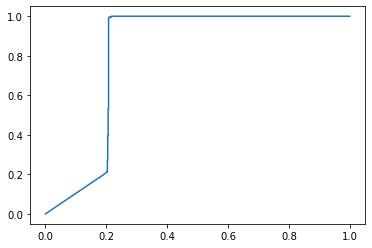

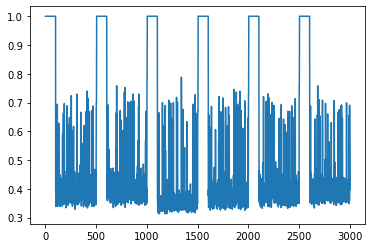

**********
window_size: 100
t: 20
phi: 90
thresh: 0.5
time used:10.345959186553955
TP: 2679 TN: 189 FP: 14 FN: 18
ACC: 0.9889655172413793 Precision: 0.9948013367991088 Recall: 0.9933259176863182 F1: 0.9940630797773655
FPR: 0.06896551724137931 TPR: 0.9933259176863182
AUC: 0.9315559525179409


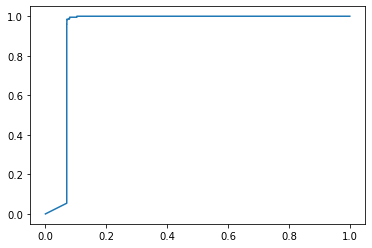

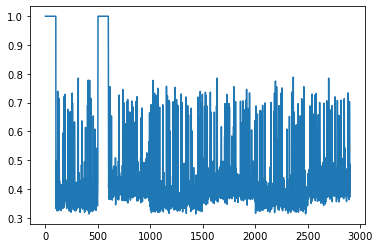

time used:14.64834189414978
TP: 2775 TN: 164 FP: 46 FN: 15
ACC: 0.9796666666666667 Precision: 0.9836937256292095 Recall: 0.9946236559139785 F1: 0.9891284975940118
FPR: 0.21904761904761905 TPR: 0.9946236559139785
AUC: 0.8158781362007168


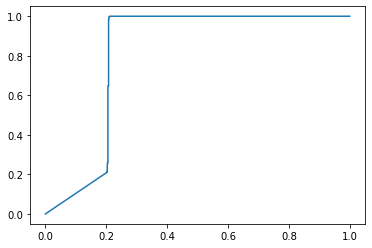

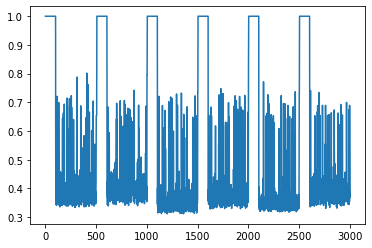

**********
window_size: 100
t: 20
phi: 90
thresh: 0.55
time used:10.419498682022095
TP: 2697 TN: 187 FP: 16 FN: 0
ACC: 0.9944827586206897 Precision: 0.9941024695908588 Recall: 1.0 F1: 0.9970425138632162
FPR: 0.07881773399014778 TPR: 1.0
AUC: 0.9318025319137667


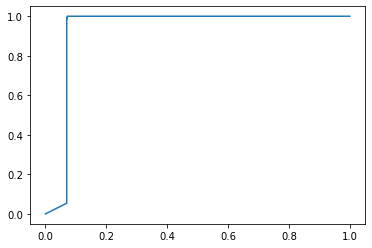

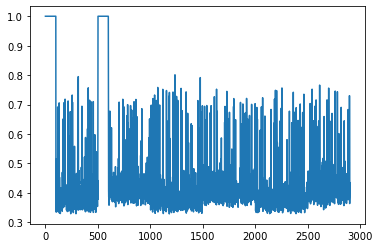

time used:14.648838996887207
TP: 2779 TN: 164 FP: 46 FN: 11
ACC: 0.981 Precision: 0.983716814159292 Recall: 0.9960573476702509 F1: 0.9898486197684773
FPR: 0.21904761904761905 TPR: 0.9960573476702509
AUC: 0.8161478067929681


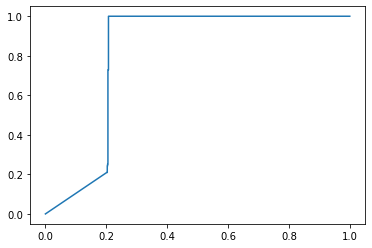

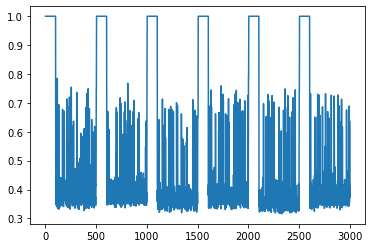

**********
window_size: 100
t: 20
phi: 90
thresh: 0.6
time used:10.36844539642334
TP: 2697 TN: 167 FP: 36 FN: 0
ACC: 0.9875862068965517 Precision: 0.986827661909989 Recall: 1.0 F1: 0.9933701657458565
FPR: 0.17733990147783252 TPR: 1.0
AUC: 0.9317678281469467


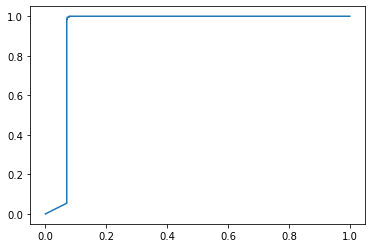

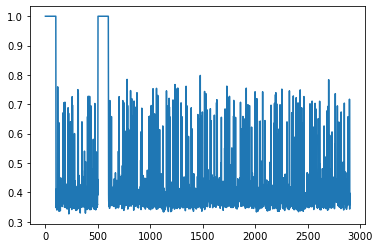

time used:14.676368236541748
TP: 2778 TN: 134 FP: 76 FN: 12
ACC: 0.9706666666666667 Precision: 0.9733707077785564 Recall: 0.9956989247311828 F1: 0.9844082211197732
FPR: 0.3619047619047619 TPR: 0.9956989247311828
AUC: 0.815689537463731


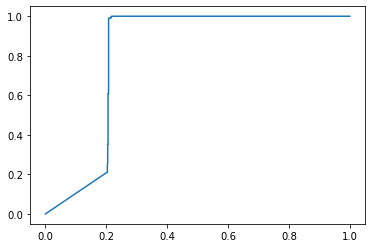

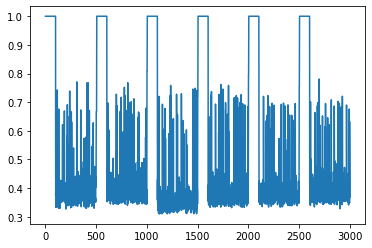

**********
window_size: 100
t: 20
phi: 90
thresh: 0.7
time used:10.39571475982666
TP: 2697 TN: 66 FP: 137 FN: 0
ACC: 0.9527586206896552 Precision: 0.9516584333098095 Recall: 1.0 F1: 0.9752305188935093
FPR: 0.6748768472906403 TPR: 1.0
AUC: 0.9318098379699392


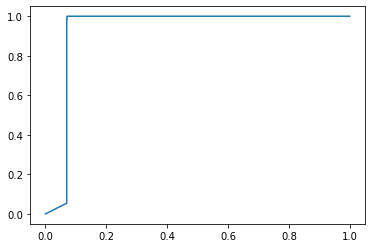

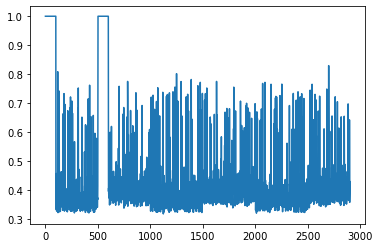

time used:14.733916759490967
TP: 2780 TN: 43 FP: 167 FN: 10
ACC: 0.941 Precision: 0.9433322022395657 Recall: 0.996415770609319 F1: 0.9691476381383999
FPR: 0.7952380952380952 TPR: 0.996415770609319
AUC: 0.8157322068612392


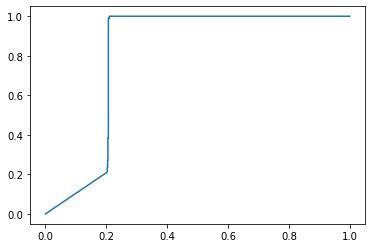

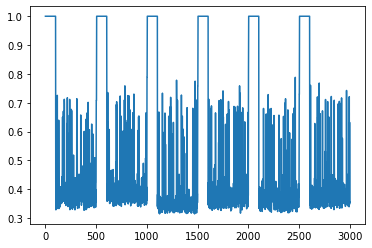

**********
window_size: 100
t: 50
phi: 10
thresh: 0.45
time used:10.44734263420105
TP: 357 TN: 192 FP: 11 FN: 2340
ACC: 0.1893103448275862 Precision: 0.970108695652174 Recall: 0.13236929922135707 F1: 0.232952691680261
FPR: 0.054187192118226604 TPR: 0.13236929922135707
AUC: 0.9314226169927907


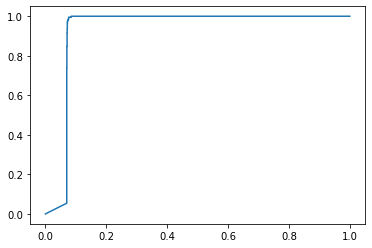

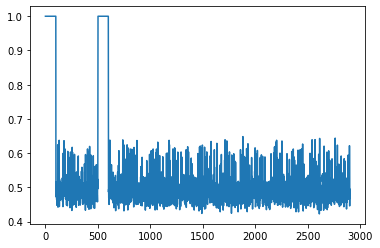

time used:12.472360610961914
TP: 768 TN: 171 FP: 39 FN: 2022
ACC: 0.313 Precision: 0.9516728624535316 Recall: 0.2752688172043011 F1: 0.42702251876563796
FPR: 0.18571428571428572 TPR: 0.2752688172043011
AUC: 0.7919363372589179


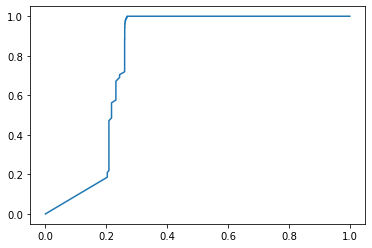

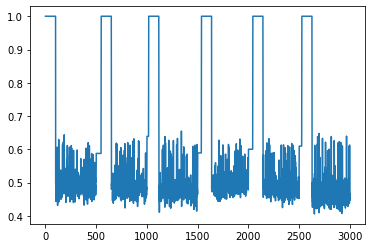

**********
window_size: 100
t: 50
phi: 10
thresh: 0.475
time used:10.396598100662231
TP: 818 TN: 192 FP: 11 FN: 1879
ACC: 0.3482758620689655 Precision: 0.9867310012062727 Recall: 0.3032999629217649 F1: 0.46398184912081675
FPR: 0.054187192118226604 TPR: 0.3032999629217649
AUC: 0.9310463550999012


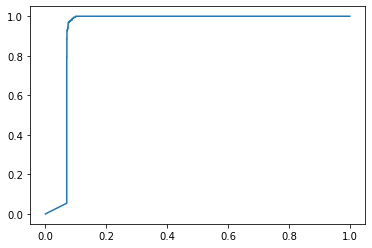

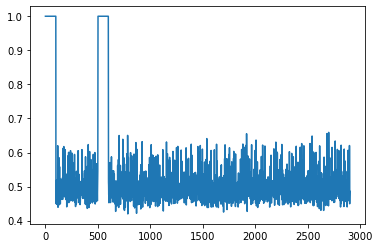

time used:13.95721697807312
TP: 1150 TN: 177 FP: 33 FN: 1640
ACC: 0.44233333333333336 Precision: 0.9721048182586645 Recall: 0.4121863799283154 F1: 0.5789076264787315
FPR: 0.15714285714285714 TPR: 0.4121863799283154
AUC: 0.7918706263867554


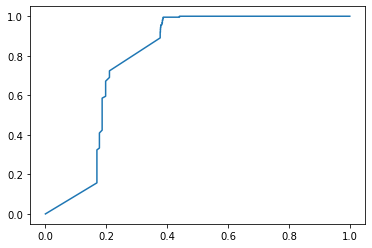

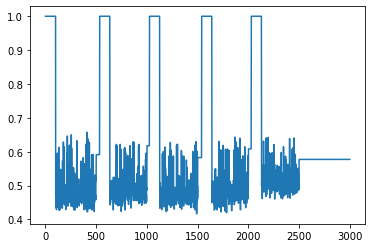

**********
window_size: 100
t: 50
phi: 10
thresh: 0.5
time used:10.445516109466553
TP: 1824 TN: 192 FP: 11 FN: 873
ACC: 0.6951724137931035 Precision: 0.9940054495912807 Recall: 0.6763070077864294 F1: 0.8049426301853487
FPR: 0.054187192118226604 TPR: 0.6763070077864294
AUC: 0.9308993207194274


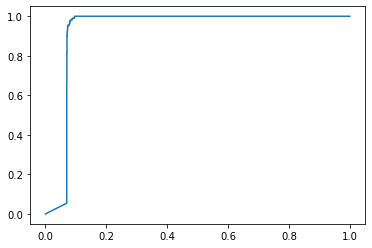

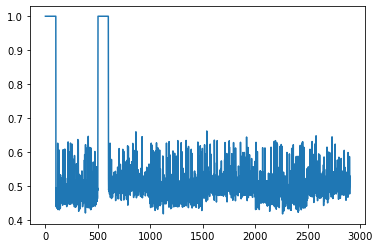

time used:12.702577829360962
TP: 2286 TN: 168 FP: 42 FN: 504
ACC: 0.818 Precision: 0.9819587628865979 Recall: 0.8193548387096774 F1: 0.8933177022274325
FPR: 0.2 TPR: 0.8193548387096774
AUC: 0.7980141662399727


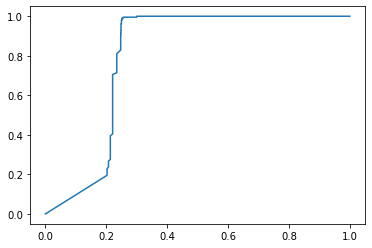

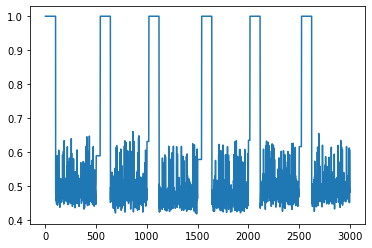

**********
window_size: 100
t: 50
phi: 10
thresh: 0.55
time used:10.416658878326416
TP: 2683 TN: 187 FP: 16 FN: 14
ACC: 0.9896551724137931 Precision: 0.9940718784735088 Recall: 0.9948090470893586 F1: 0.9944403261675315
FPR: 0.07881773399014778 TPR: 0.9948090470893586
AUC: 0.9312564042148639


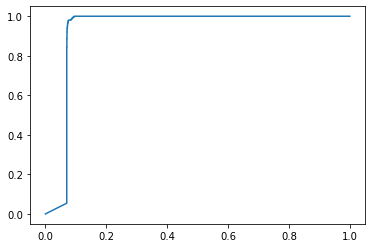

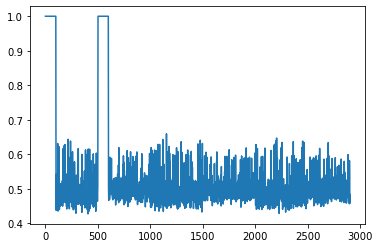

time used:12.51789927482605
TP: 2629 TN: 167 FP: 43 FN: 161
ACC: 0.932 Precision: 0.9839071856287425 Recall: 0.9422939068100359 F1: 0.9626510435737826
FPR: 0.20476190476190476 TPR: 0.9422939068100359
AUC: 0.7940476190476191


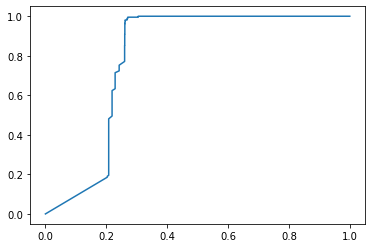

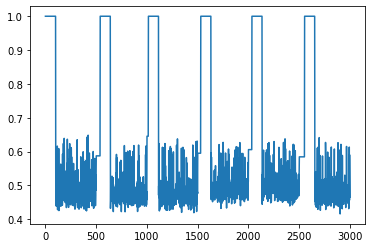

**********
window_size: 100
t: 50
phi: 10
thresh: 0.6
time used:10.422494411468506
TP: 2697 TN: 95 FP: 108 FN: 0
ACC: 0.9627586206896551 Precision: 0.9614973262032086 Recall: 1.0 F1: 0.9803707742639041
FPR: 0.5320197044334976 TPR: 1.0
AUC: 0.9307303681704356


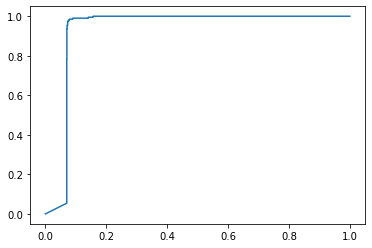

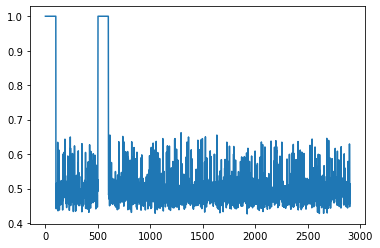

time used:13.176002025604248
TP: 2690 TN: 80 FP: 130 FN: 100
ACC: 0.9233333333333333 Precision: 0.9539007092198581 Recall: 0.96415770609319 F1: 0.9590017825311942
FPR: 0.6190476190476191 TPR: 0.96415770609319
AUC: 0.7963415258576549


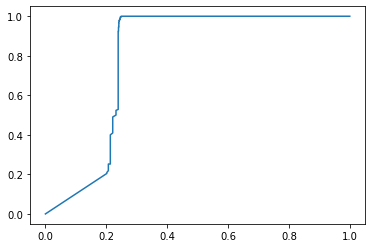

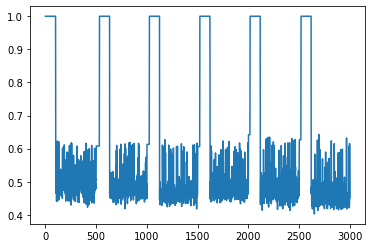

**********
window_size: 100
t: 50
phi: 10
thresh: 0.7
time used:10.425662517547607
TP: 2697 TN: 0 FP: 203 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9303184892537046


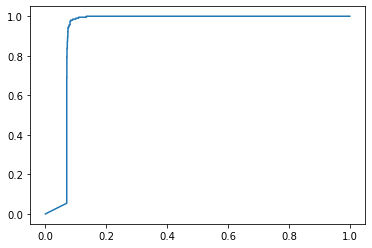

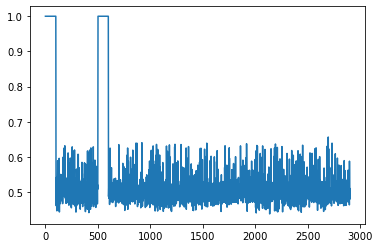

time used:11.63809847831726
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7941816009557946


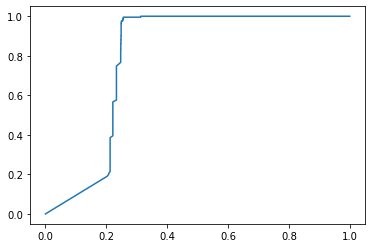

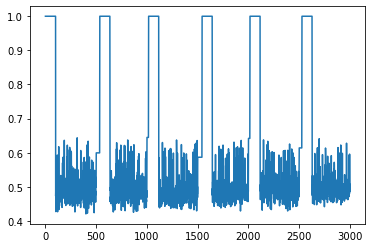

**********
window_size: 100
t: 50
phi: 25
thresh: 0.45
time used:10.502567768096924
TP: 1130 TN: 192 FP: 11 FN: 1567
ACC: 0.45586206896551723 Precision: 0.9903593339176161 Recall: 0.41898405635891733 F1: 0.5888483585200626
FPR: 0.054187192118226604 TPR: 0.41898405635891733
AUC: 0.9317568690626877


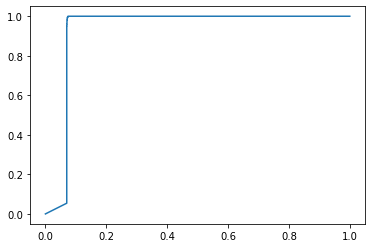

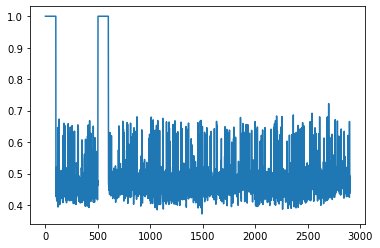

time used:14.214444398880005
TP: 2092 TN: 167 FP: 43 FN: 698
ACC: 0.753 Precision: 0.9798594847775176 Recall: 0.749820788530466 F1: 0.8495431472081219
FPR: 0.20476190476190476 TPR: 0.749820788530466
AUC: 0.8113176309950504


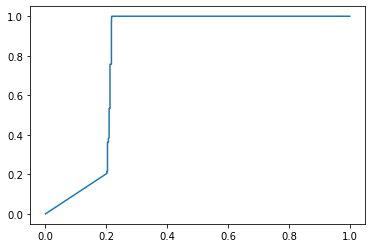

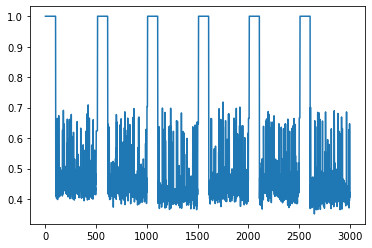

**********
window_size: 100
t: 50
phi: 25
thresh: 0.475
time used:10.544704914093018
TP: 2135 TN: 192 FP: 11 FN: 562
ACC: 0.8024137931034483 Precision: 0.9948741845293569 Recall: 0.7916203188728217 F1: 0.8816849060499691
FPR: 0.054187192118226604 TPR: 0.7916203188728217
AUC: 0.9316911145571343


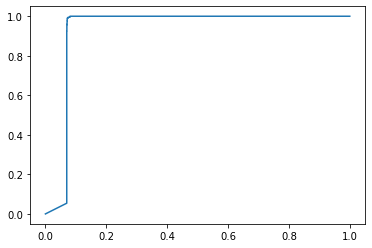

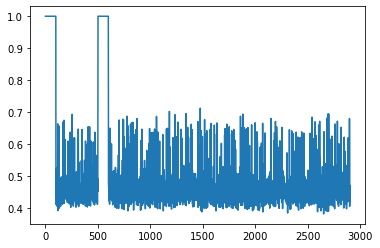

time used:14.23747181892395
TP: 2505 TN: 166 FP: 44 FN: 285
ACC: 0.8903333333333333 Precision: 0.982738328756375 Recall: 0.8978494623655914 F1: 0.938377973403259
FPR: 0.20952380952380953 TPR: 0.8978494623655914
AUC: 0.8119644990612732


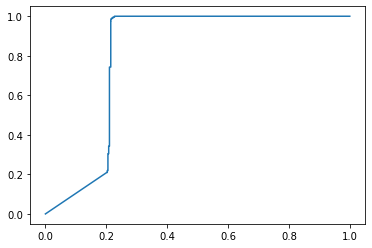

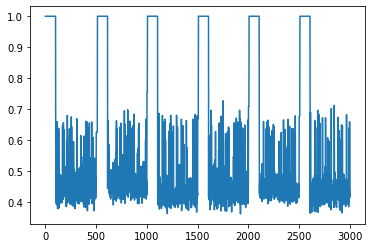

**********
window_size: 100
t: 50
phi: 25
thresh: 0.5
time used:10.538678169250488
TP: 2274 TN: 192 FP: 11 FN: 423
ACC: 0.8503448275862069 Precision: 0.9951859956236324 Recall: 0.8431590656284761 F1: 0.9128863910076275
FPR: 0.054187192118226604 TPR: 0.8431590656284761
AUC: 0.9316436251920123


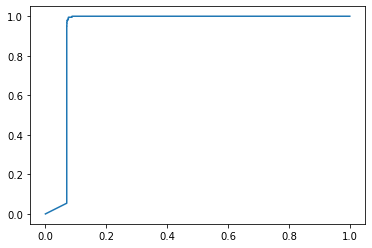

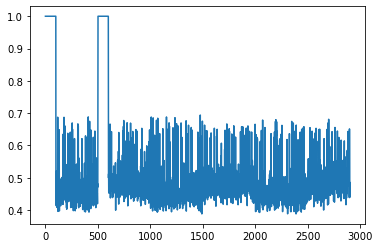

time used:13.833096265792847
TP: 2677 TN: 164 FP: 46 FN: 113
ACC: 0.947 Precision: 0.9831068674256335 Recall: 0.9594982078853047 F1: 0.9711590785416289
FPR: 0.21904761904761905 TPR: 0.9594982078853047
AUC: 0.8146996074415429


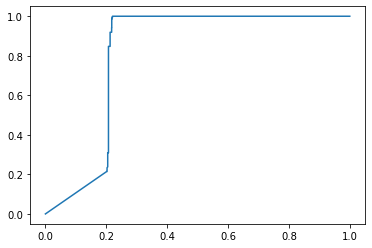

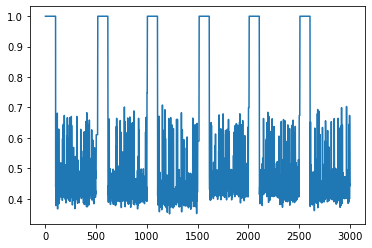

**********
window_size: 100
t: 50
phi: 25
thresh: 0.55
time used:10.521596908569336
TP: 2668 TN: 191 FP: 12 FN: 29
ACC: 0.9858620689655172 Precision: 0.9955223880597015 Recall: 0.989247311827957 F1: 0.9923749302585084
FPR: 0.059113300492610835 TPR: 0.989247311827957
AUC: 0.9316308395937103


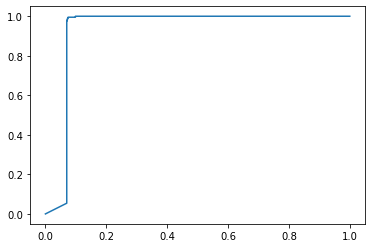

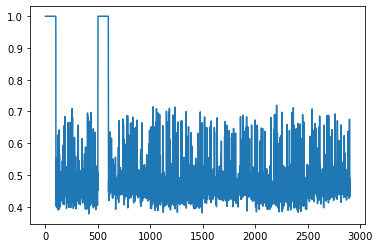

time used:14.244477272033691
TP: 2754 TN: 163 FP: 47 FN: 36
ACC: 0.9723333333333334 Precision: 0.9832202784719742 Recall: 0.9870967741935484 F1: 0.985154712931497
FPR: 0.22380952380952382 TPR: 0.9870967741935484
AUC: 0.8107808499743984


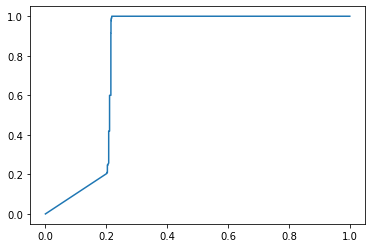

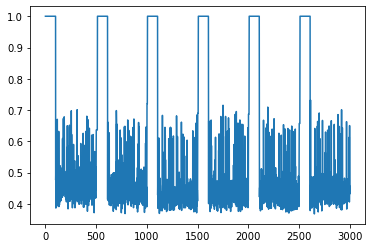

**********
window_size: 100
t: 50
phi: 25
thresh: 0.6
time used:10.504905939102173
TP: 2696 TN: 167 FP: 36 FN: 1
ACC: 0.9872413793103448 Precision: 0.986822840409956 Recall: 0.9996292176492398 F1: 0.993184748572481
FPR: 0.17733990147783252 TPR: 0.9996292176492398
AUC: 0.9316765024447891


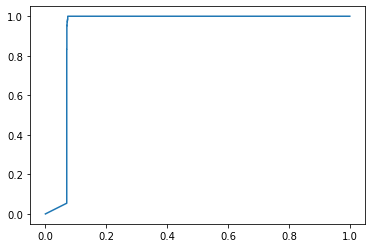

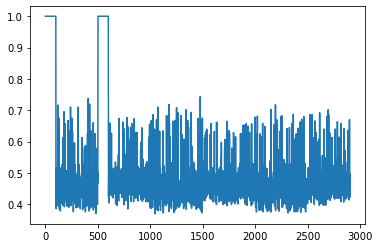

time used:14.639333724975586
TP: 2760 TN: 140 FP: 70 FN: 30
ACC: 0.9666666666666667 Precision: 0.9752650176678446 Recall: 0.989247311827957 F1: 0.9822064056939501
FPR: 0.3333333333333333 TPR: 0.989247311827957
AUC: 0.8111955965181772


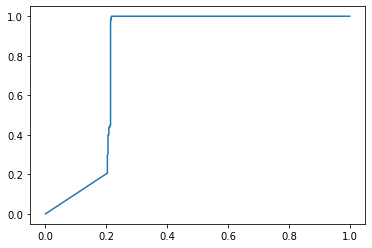

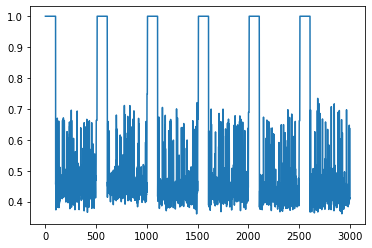

**********
window_size: 100
t: 50
phi: 25
thresh: 0.7
time used:10.505654335021973
TP: 2697 TN: 5 FP: 198 FN: 0
ACC: 0.9317241379310345 Precision: 0.9316062176165804 Recall: 1.0 F1: 0.9645922746781117
FPR: 0.9753694581280788 TPR: 1.0
AUC: 0.9317331243801268


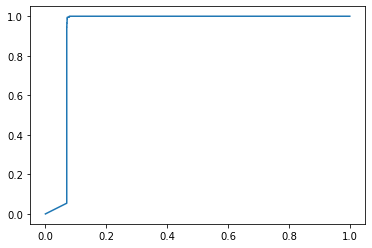

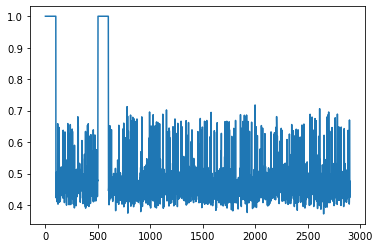

time used:13.970724821090698
TP: 2790 TN: 4 FP: 206 FN: 0
ACC: 0.9313333333333333 Precision: 0.9312416555407209 Recall: 1.0 F1: 0.9643968199101279
FPR: 0.9809523809523809 TPR: 1.0
AUC: 0.8116274108209592


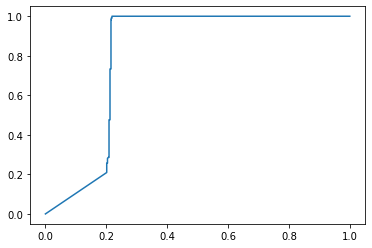

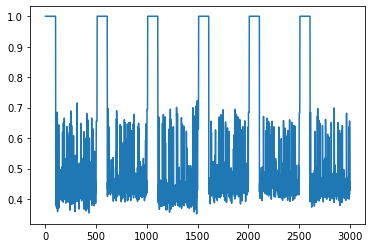

**********
window_size: 100
t: 50
phi: 50
thresh: 0.45
time used:10.674724817276001
TP: 2231 TN: 192 FP: 11 FN: 466
ACC: 0.8355172413793104 Precision: 0.9950936663693131 Recall: 0.8272154245457917 F1: 0.9034217452925694
FPR: 0.054187192118226604 TPR: 0.8272154245457917
AUC: 0.9318134909980256


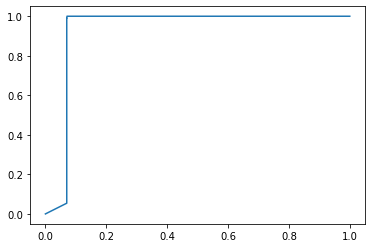

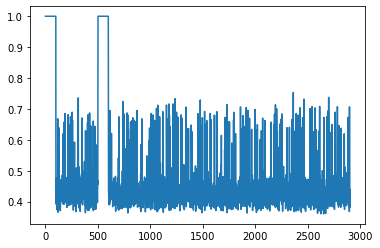

time used:14.80498194694519
TP: 2579 TN: 166 FP: 44 FN: 211
ACC: 0.915 Precision: 0.9832253145253527 Recall: 0.9243727598566308 F1: 0.9528911878810272
FPR: 0.20952380952380953 TPR: 0.9243727598566308
AUC: 0.8149769585253457


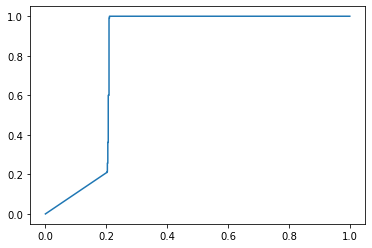

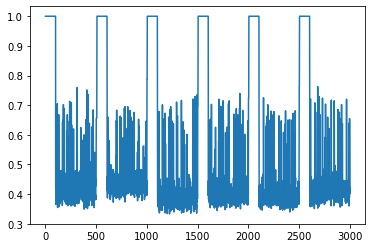

**********
window_size: 100
t: 50
phi: 50
thresh: 0.475
time used:10.569628238677979
TP: 2500 TN: 192 FP: 11 FN: 197
ACC: 0.9282758620689655 Precision: 0.9956192751891677 Recall: 0.9269558769002596 F1: 0.9600614439324117
FPR: 0.054187192118226604 TPR: 0.9269558769002596
AUC: 0.9318207970541982


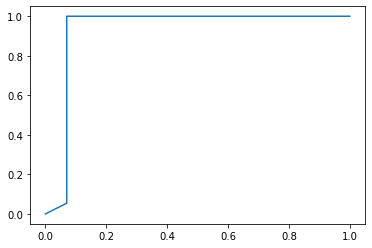

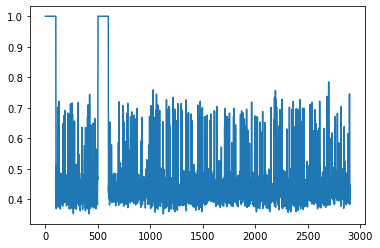

time used:14.82450246810913
TP: 2733 TN: 166 FP: 44 FN: 57
ACC: 0.9663333333333334 Precision: 0.9841555635577962 Recall: 0.9795698924731183 F1: 0.9818573738099515
FPR: 0.20952380952380953 TPR: 0.9795698924731183
AUC: 0.8149701314217443


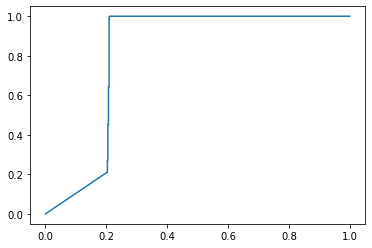

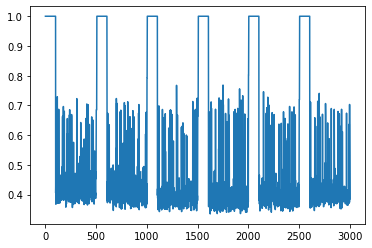

**********
window_size: 100
t: 50
phi: 50
thresh: 0.5
time used:10.575844526290894
TP: 2675 TN: 192 FP: 11 FN: 22
ACC: 0.9886206896551725 Precision: 0.9959046909903202 Recall: 0.9918427882832778 F1: 0.9938695894482632
FPR: 0.054187192118226604 TPR: 0.9918427882832778
AUC: 0.9318043584278097


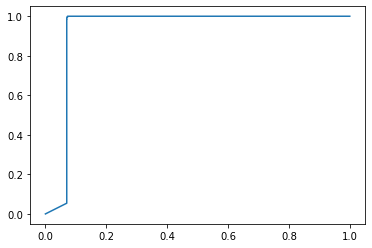

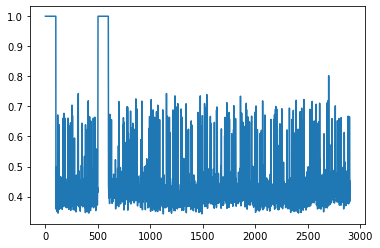

time used:14.776955842971802
TP: 2769 TN: 166 FP: 44 FN: 21
ACC: 0.9783333333333334 Precision: 0.9843583362957696 Recall: 0.9924731182795699 F1: 0.9883990719257542
FPR: 0.20952380952380953 TPR: 0.9924731182795699
AUC: 0.8150196279228538


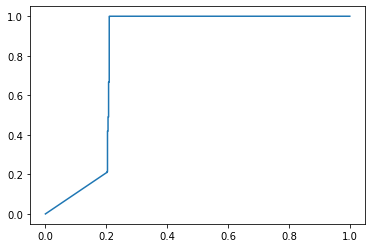

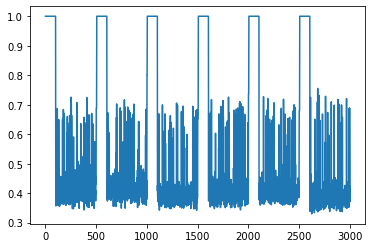

**********
window_size: 100
t: 50
phi: 50
thresh: 0.55
time used:10.569802045822144
TP: 2697 TN: 190 FP: 13 FN: 0
ACC: 0.9955172413793103 Precision: 0.9952029520295202 Recall: 1.0 F1: 0.9975957092657666
FPR: 0.06403940886699508 TPR: 1.0
AUC: 0.9318007053997235


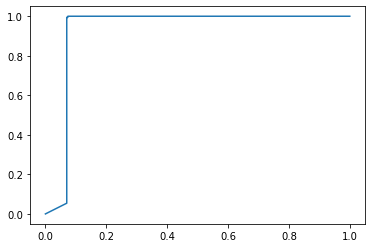

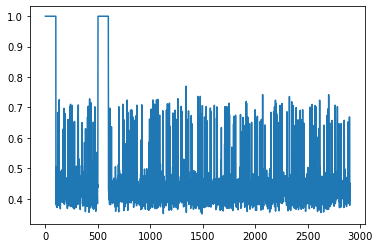

time used:14.772695302963257
TP: 2770 TN: 165 FP: 45 FN: 20
ACC: 0.9783333333333334 Precision: 0.9840142095914742 Recall: 0.992831541218638 F1: 0.9884032114183765
FPR: 0.21428571428571427 TPR: 0.992831541218638
AUC: 0.8144802867383512


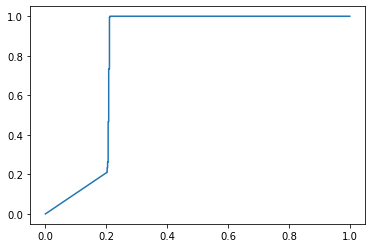

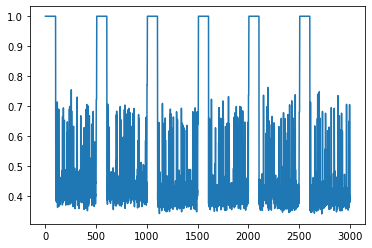

**********
window_size: 100
t: 50
phi: 50
thresh: 0.6
time used:10.591662406921387
TP: 2697 TN: 175 FP: 28 FN: 0
ACC: 0.9903448275862069 Precision: 0.9897247706422019 Recall: 1.0 F1: 0.9948358539284398
FPR: 0.13793103448275862 TPR: 1.0
AUC: 0.9318207970541982


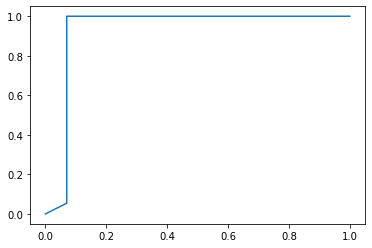

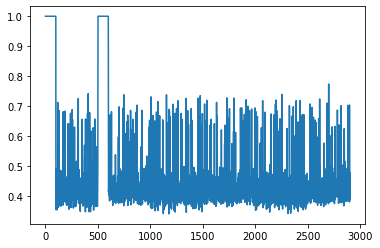

time used:15.060724258422852
TP: 2771 TN: 147 FP: 63 FN: 19
ACC: 0.9726666666666667 Precision: 0.9777699364855328 Recall: 0.9931899641577061 F1: 0.9854196301564723
FPR: 0.3 TPR: 0.9931899641577061
AUC: 0.8140621266427718


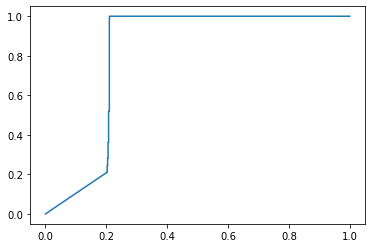

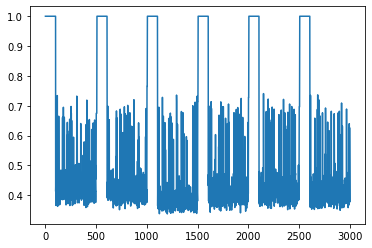

**********
window_size: 100
t: 50
phi: 50
thresh: 0.7
time used:10.605743169784546
TP: 2697 TN: 37 FP: 166 FN: 0
ACC: 0.9427586206896552 Precision: 0.9420188613342647 Recall: 1.0 F1: 0.9701438848920863
FPR: 0.8177339901477833 TPR: 1.0
AUC: 0.9318153175120687


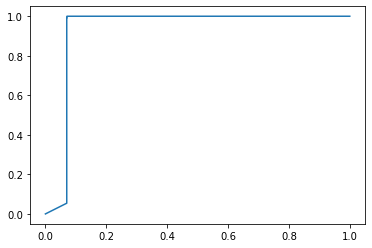

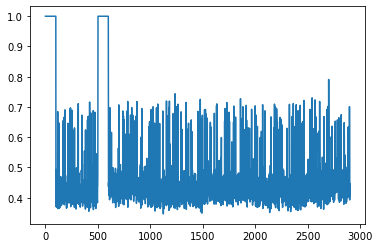

time used:14.800480365753174
TP: 2778 TN: 30 FP: 180 FN: 12
ACC: 0.936 Precision: 0.9391480730223124 Recall: 0.9956989247311828 F1: 0.9665970772442589
FPR: 0.8571428571428571 TPR: 0.9956989247311828
AUC: 0.8146526711042841


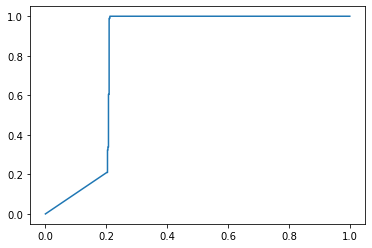

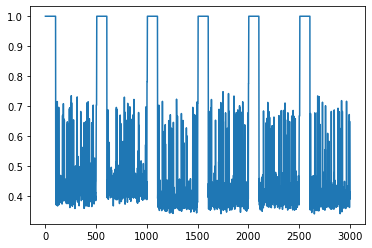

**********
window_size: 100
t: 50
phi: 75
thresh: 0.45
time used:10.643954038619995
TP: 2526 TN: 192 FP: 11 FN: 171
ACC: 0.9372413793103448 Precision: 0.9956641702798581 Recall: 0.9365962180200222 F1: 0.965227359572029
FPR: 0.054187192118226604 TPR: 0.9365962180200222
AUC: 0.9318080114558961


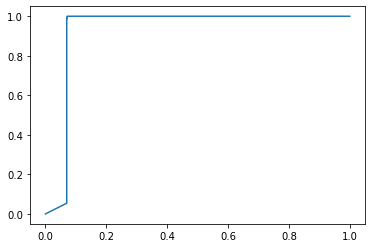

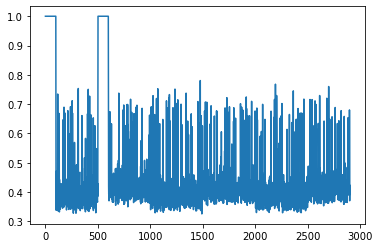

time used:14.919596433639526
TP: 2720 TN: 166 FP: 44 FN: 70
ACC: 0.962 Precision: 0.984081041968162 Recall: 0.974910394265233 F1: 0.9794742527907815
FPR: 0.20952380952380953 TPR: 0.974910394265233
AUC: 0.8149820788530465


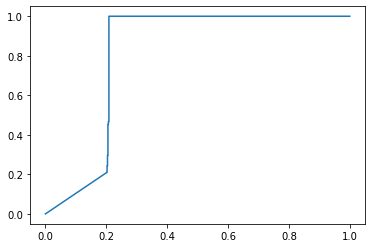

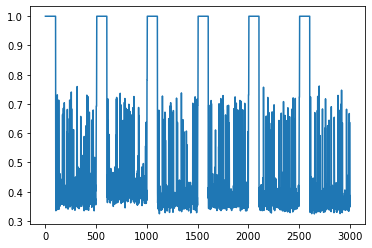

**********
window_size: 100
t: 50
phi: 75
thresh: 0.475
time used:10.642792224884033
TP: 2639 TN: 192 FP: 11 FN: 58
ACC: 0.9762068965517241 Precision: 0.9958490566037735 Recall: 0.978494623655914 F1: 0.9870955676080045
FPR: 0.054187192118226604 TPR: 0.978494623655914
AUC: 0.9318207970541982


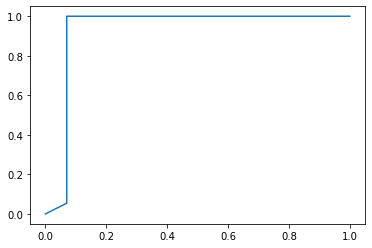

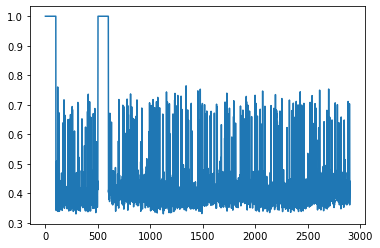

time used:14.949113130569458
TP: 2768 TN: 166 FP: 44 FN: 22
ACC: 0.978 Precision: 0.984352773826458 Recall: 0.9921146953405018 F1: 0.988218493395216
FPR: 0.20952380952380953 TPR: 0.9921146953405018
AUC: 0.8151817716333846


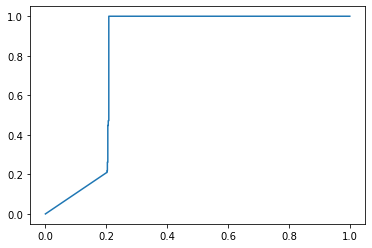

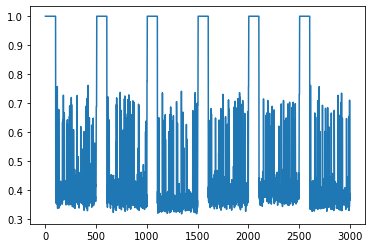

**********
window_size: 100
t: 50
phi: 75
thresh: 0.5
time used:10.653705358505249
TP: 2689 TN: 192 FP: 11 FN: 8
ACC: 0.993448275862069 Precision: 0.9959259259259259 Recall: 0.9970337411939192 F1: 0.996479525662405
FPR: 0.054187192118226604 TPR: 0.9970337411939192
AUC: 0.9318207970541982


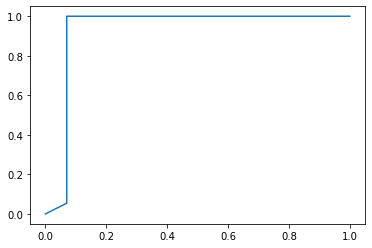

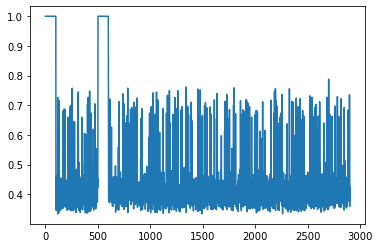

time used:15.150834798812866
TP: 2778 TN: 166 FP: 44 FN: 12
ACC: 0.9813333333333333 Precision: 0.9844082211197732 Recall: 0.9956989247311828 F1: 0.9900213827512473
FPR: 0.20952380952380953 TPR: 0.9956989247311828
AUC: 0.8156596688854753


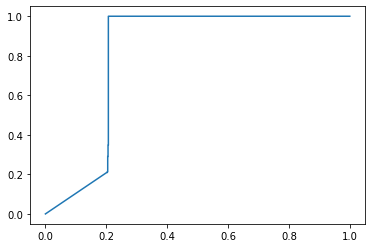

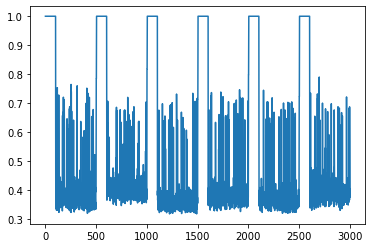

**********
window_size: 100
t: 50
phi: 75
thresh: 0.55
time used:11.13016152381897
TP: 2697 TN: 189 FP: 14 FN: 0
ACC: 0.9951724137931034 Precision: 0.9948358539284397 Recall: 1.0 F1: 0.9974112426035503
FPR: 0.06896551724137931 TPR: 1.0
AUC: 0.9318134909980256


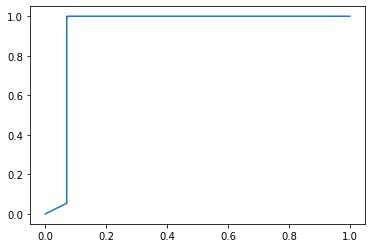

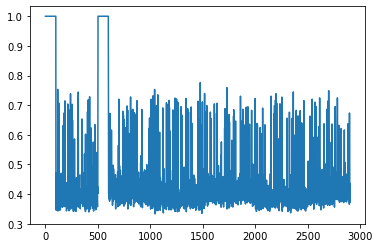

time used:15.40558385848999
TP: 2777 TN: 162 FP: 48 FN: 13
ACC: 0.9796666666666667 Precision: 0.9830088495575221 Recall: 0.9953405017921146 F1: 0.9891362422083705
FPR: 0.22857142857142856 TPR: 0.9953405017921146
AUC: 0.8151015531660694


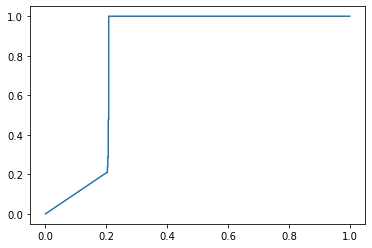

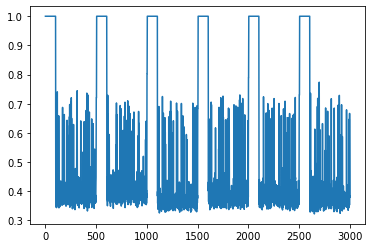

**********
window_size: 100
t: 50
phi: 75
thresh: 0.6
time used:11.094695568084717
TP: 2697 TN: 178 FP: 25 FN: 0
ACC: 0.9913793103448276 Precision: 0.9908155767817781 Recall: 1.0 F1: 0.9953866026942241
FPR: 0.12315270935960591 TPR: 1.0
AUC: 0.9318134909980256


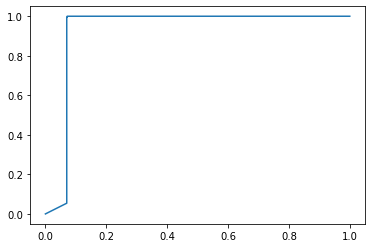

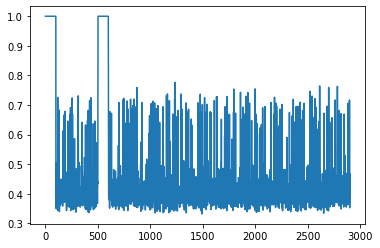

time used:16.804012060165405
TP: 2779 TN: 143 FP: 67 FN: 11
ACC: 0.974 Precision: 0.9764581869290232 Recall: 0.9960573476702509 F1: 0.9861603974449964
FPR: 0.319047619047619 TPR: 0.9960573476702509
AUC: 0.8153695169824202


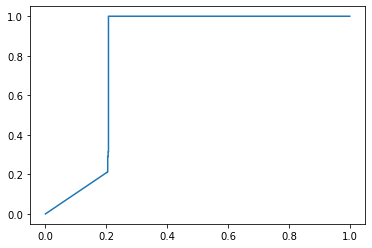

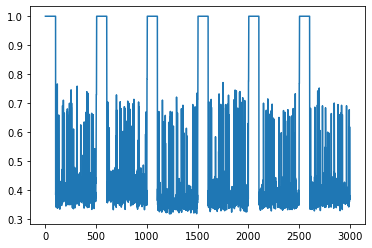

**********
window_size: 100
t: 50
phi: 75
thresh: 0.7
time used:12.488506555557251
TP: 2697 TN: 56 FP: 147 FN: 0
ACC: 0.9493103448275862 Precision: 0.9483122362869199 Recall: 1.0 F1: 0.9734704926908501
FPR: 0.7241379310344828 TPR: 1.0
AUC: 0.9318207970541982


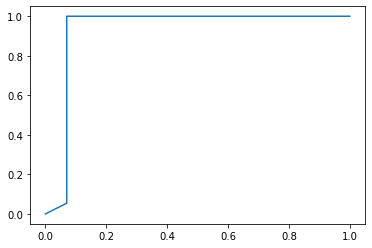

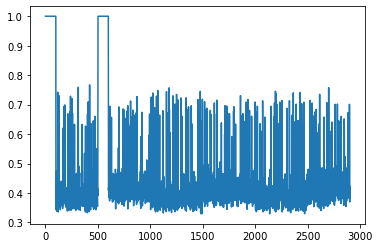

time used:16.64398980140686
TP: 2777 TN: 36 FP: 174 FN: 13
ACC: 0.9376666666666666 Precision: 0.9410369366316503 Recall: 0.9953405017921146 F1: 0.9674272774777912
FPR: 0.8285714285714286 TPR: 0.9953405017921146
AUC: 0.8151493428912784


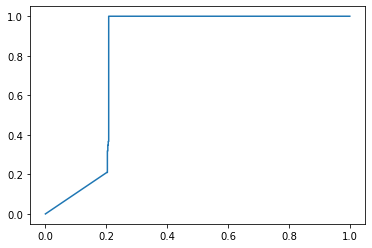

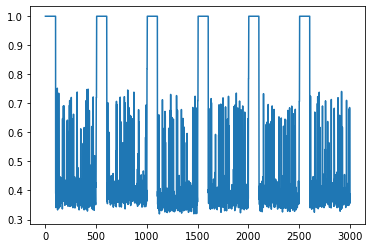

**********
window_size: 100
t: 50
phi: 90
thresh: 0.45
time used:12.953035354614258
TP: 2616 TN: 192 FP: 11 FN: 81
ACC: 0.9682758620689655 Precision: 0.9958127141225733 Recall: 0.9699666295884316 F1: 0.9827197595792637
FPR: 0.054187192118226604 TPR: 0.9699666295884316
AUC: 0.9318153175120687


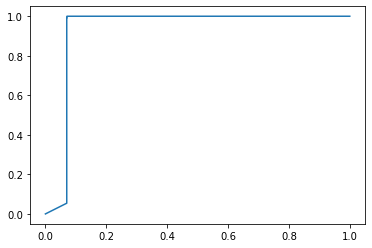

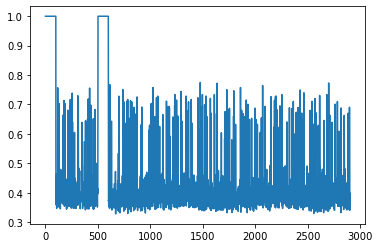

time used:16.470863819122314
TP: 2762 TN: 166 FP: 44 FN: 28
ACC: 0.976 Precision: 0.9843193157519601 Recall: 0.9899641577060931 F1: 0.987133666904932
FPR: 0.20952380952380953 TPR: 0.9899641577060931
AUC: 0.8156272401433692


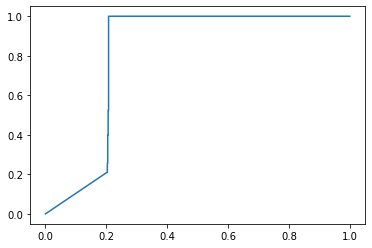

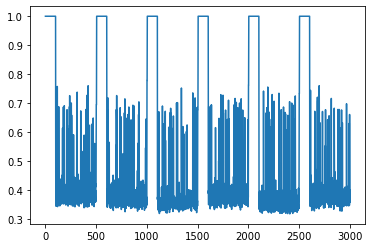

**********
window_size: 100
t: 50
phi: 90
thresh: 0.475
time used:12.392940521240234
TP: 2659 TN: 192 FP: 11 FN: 38
ACC: 0.983103448275862 Precision: 0.9958801498127341 Recall: 0.985910270671116 F1: 0.9908701322899199
FPR: 0.054187192118226604 TPR: 0.985910270671116
AUC: 0.9318134909980256


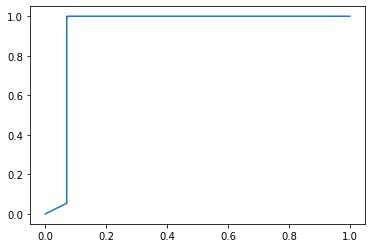

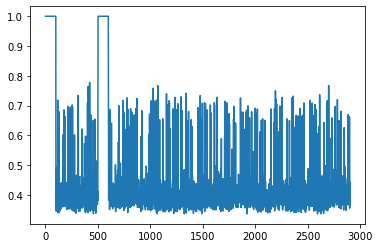

time used:16.77762746810913
TP: 2765 TN: 166 FP: 44 FN: 25
ACC: 0.977 Precision: 0.9843360626557494 Recall: 0.9910394265232975 F1: 0.9876763707804965
FPR: 0.20952380952380953 TPR: 0.9910394265232975
AUC: 0.8154446151220346


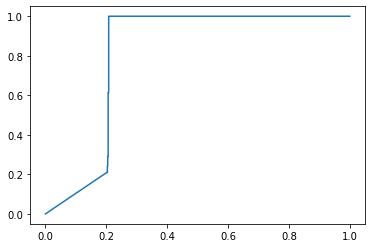

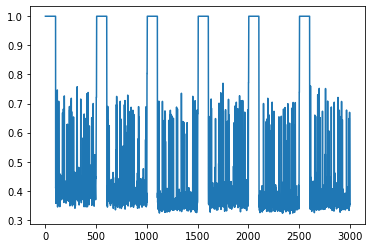

**********
window_size: 100
t: 50
phi: 90
thresh: 0.5
time used:12.818355798721313
TP: 2695 TN: 191 FP: 12 FN: 2
ACC: 0.9951724137931034 Precision: 0.995567048393055 Recall: 0.9992584352984798 F1: 0.9974093264248705
FPR: 0.059113300492610835 TPR: 0.9992584352984798
AUC: 0.9318171440261119


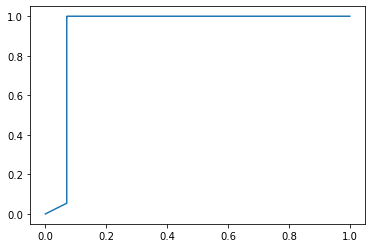

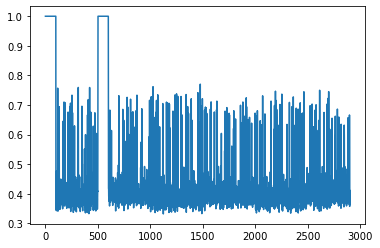

time used:16.586010217666626
TP: 2776 TN: 166 FP: 44 FN: 14
ACC: 0.9806666666666667 Precision: 0.9843971631205674 Recall: 0.9949820788530466 F1: 0.9896613190730839
FPR: 0.20952380952380953 TPR: 0.9949820788530466
AUC: 0.815731353473289


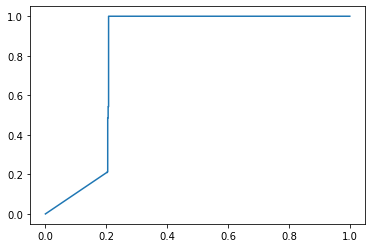

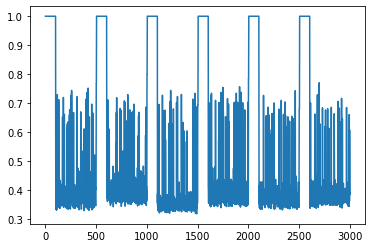

**********
window_size: 100
t: 50
phi: 90
thresh: 0.55
time used:12.646186351776123
TP: 2697 TN: 188 FP: 15 FN: 0
ACC: 0.9948275862068966 Precision: 0.9944690265486725 Recall: 1.0 F1: 0.997226844148641
FPR: 0.07389162561576355 TPR: 1.0
AUC: 0.9318171440261118


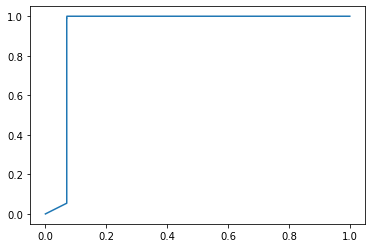

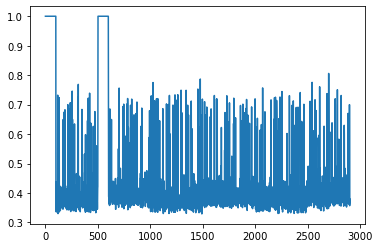

time used:16.484318733215332
TP: 2779 TN: 162 FP: 48 FN: 11
ACC: 0.9803333333333333 Precision: 0.9830208701804033 Recall: 0.9960573476702509 F1: 0.9894961723339861
FPR: 0.22857142857142856 TPR: 0.9960573476702509
AUC: 0.8153865847414234


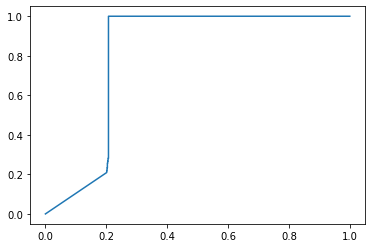

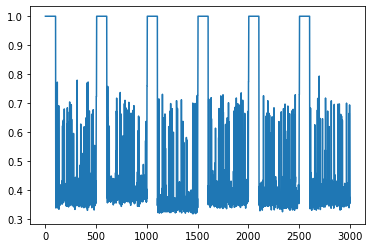

**********
window_size: 100
t: 50
phi: 90
thresh: 0.6
time used:12.399418354034424
TP: 2697 TN: 179 FP: 24 FN: 0
ACC: 0.9917241379310345 Precision: 0.9911797133406836 Recall: 1.0 F1: 0.9955703211517164
FPR: 0.11822660098522167 TPR: 1.0
AUC: 0.9318171440261118


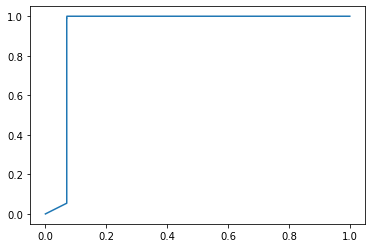

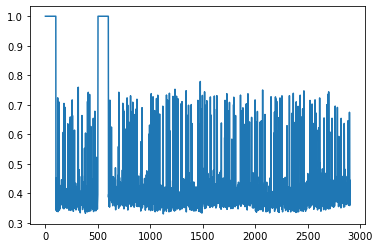

time used:16.64203691482544
TP: 2780 TN: 144 FP: 66 FN: 10
ACC: 0.9746666666666667 Precision: 0.9768095572733662 Recall: 0.996415770609319 F1: 0.9865152590489709
FPR: 0.3142857142857143 TPR: 0.996415770609319
AUC: 0.8155299539170507


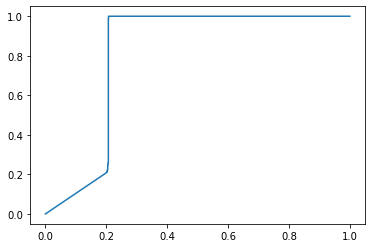

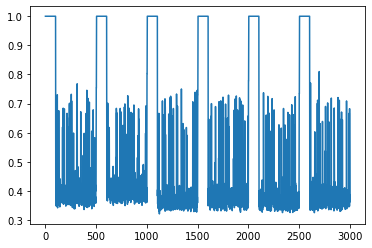

**********
window_size: 100
t: 50
phi: 90
thresh: 0.7
time used:12.778808832168579
TP: 2697 TN: 66 FP: 137 FN: 0
ACC: 0.9527586206896552 Precision: 0.9516584333098095 Recall: 1.0 F1: 0.9752305188935093
FPR: 0.6748768472906403 TPR: 1.0
AUC: 0.9318207970541982


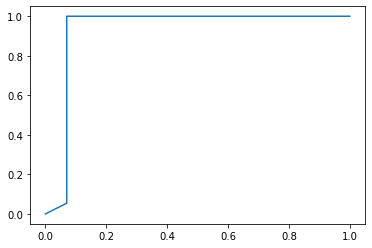

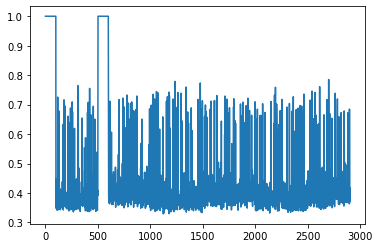

time used:16.676860809326172
TP: 2782 TN: 46 FP: 164 FN: 8
ACC: 0.9426666666666667 Precision: 0.9443312966734555 Recall: 0.9971326164874552 F1: 0.9700139470013948
FPR: 0.780952380952381 TPR: 0.9971326164874552
AUC: 0.8155419013483529


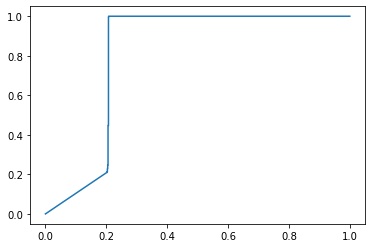

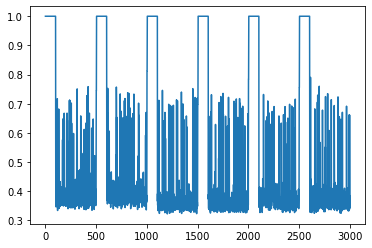

**********
window_size: 100
t: 75
phi: 10
thresh: 0.45
time used:12.205320119857788
TP: 384 TN: 192 FP: 11 FN: 2313
ACC: 0.1986206896551724 Precision: 0.9721518987341772 Recall: 0.14238042269187987 F1: 0.24838292367399745
FPR: 0.054187192118226604 TPR: 0.14238042269187987
AUC: 0.9313130261502016


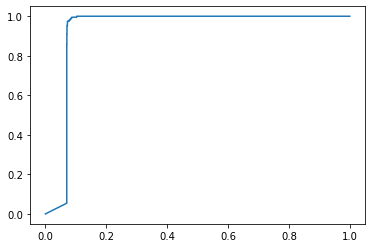

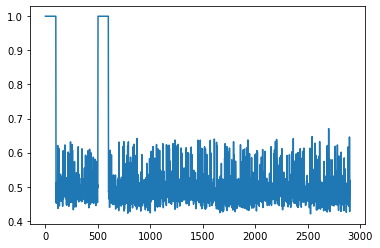

time used:13.721731424331665
TP: 731 TN: 168 FP: 42 FN: 2059
ACC: 0.2996666666666667 Precision: 0.9456662354463131 Recall: 0.26200716845878136 F1: 0.4103283749649172
FPR: 0.2 TPR: 0.26200716845878136
AUC: 0.7918740399385561


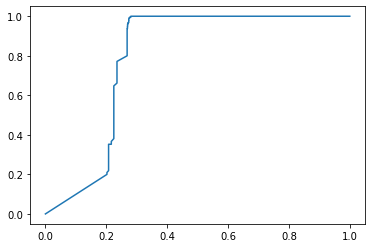

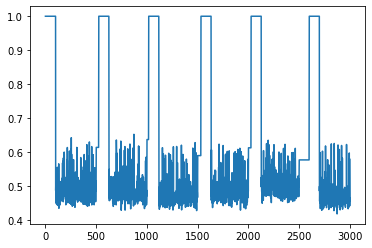

**********
window_size: 100
t: 75
phi: 10
thresh: 0.475
time used:12.032628297805786
TP: 942 TN: 192 FP: 11 FN: 1755
ACC: 0.3910344827586207 Precision: 0.9884575026232949 Recall: 0.3492769744160178 F1: 0.5161643835616438
FPR: 0.054187192118226604 TPR: 0.3492769744160178
AUC: 0.9314189639647045


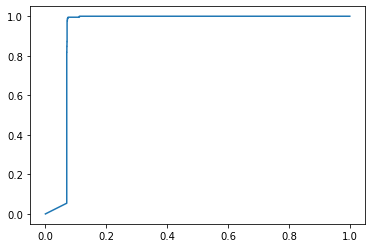

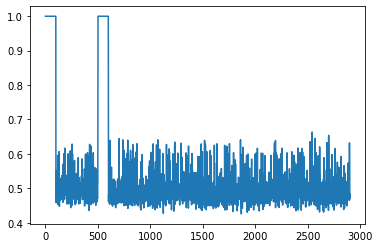

time used:13.740785121917725
TP: 1435 TN: 168 FP: 42 FN: 1355
ACC: 0.5343333333333333 Precision: 0.9715639810426541 Recall: 0.514336917562724 F1: 0.672603702835716
FPR: 0.2 TPR: 0.514336917562724
AUC: 0.8019115890083632


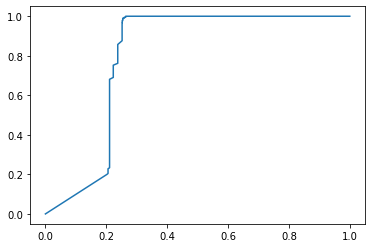

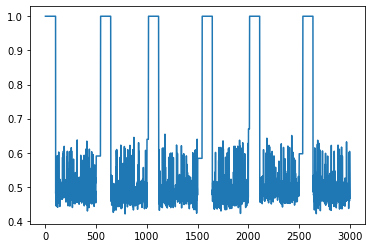

**********
window_size: 100
t: 75
phi: 10
thresh: 0.5
time used:12.242786407470703
TP: 1969 TN: 192 FP: 11 FN: 728
ACC: 0.7451724137931034 Precision: 0.9944444444444445 Recall: 0.7300704486466444 F1: 0.841992730382724
FPR: 0.054187192118226604 TPR: 0.7300704486466444
AUC: 0.9307066234878747


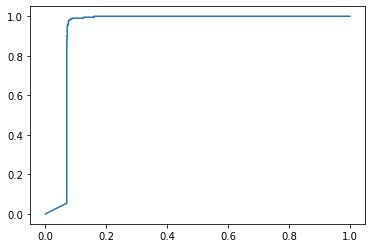

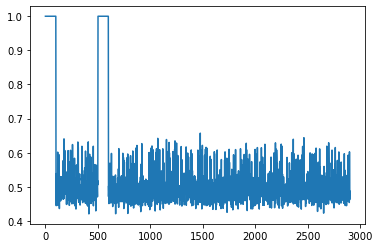

time used:13.76381778717041
TP: 2229 TN: 170 FP: 40 FN: 561
ACC: 0.7996666666666666 Precision: 0.9823710885852799 Recall: 0.7989247311827957 F1: 0.8812018185412137
FPR: 0.19047619047619047 TPR: 0.7989247311827957
AUC: 0.7959353131933777


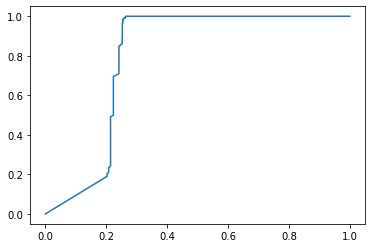

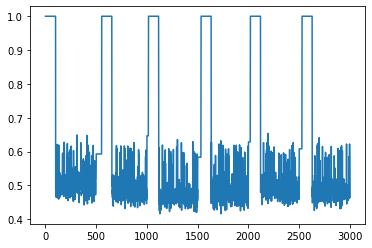

**********
window_size: 100
t: 75
phi: 10
thresh: 0.55
time used:12.131223201751709
TP: 2686 TN: 189 FP: 14 FN: 11
ACC: 0.9913793103448276 Precision: 0.9948148148148148 Recall: 0.9959213941416388 F1: 0.9953677969242172
FPR: 0.06896551724137931 TPR: 0.9959213941416388
AUC: 0.9316144009673218


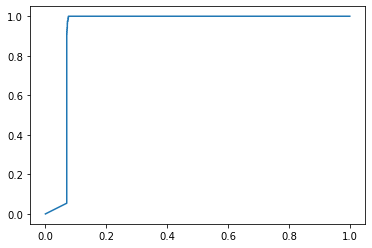

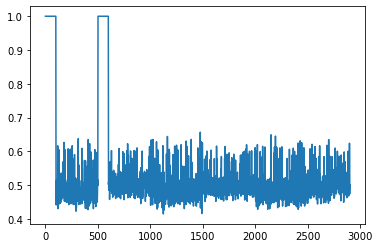

time used:13.902951955795288
TP: 2640 TN: 166 FP: 44 FN: 150
ACC: 0.9353333333333333 Precision: 0.9836065573770492 Recall: 0.946236559139785 F1: 0.9645597369382536
FPR: 0.20952380952380953 TPR: 0.946236559139785
AUC: 0.7951092336576208


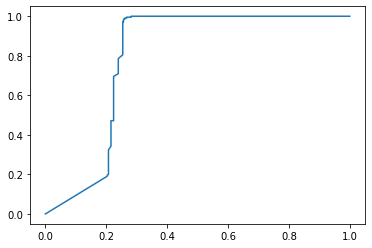

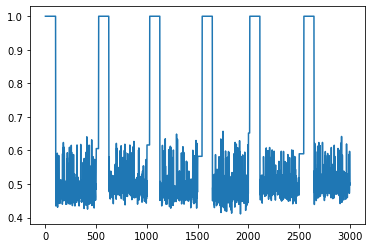

**********
window_size: 100
t: 75
phi: 10
thresh: 0.6
time used:12.241344451904297
TP: 2697 TN: 87 FP: 116 FN: 0
ACC: 0.96 Precision: 0.9587628865979382 Recall: 1.0 F1: 0.9789473684210526
FPR: 0.5714285714285714 TPR: 1.0
AUC: 0.9314025253383159


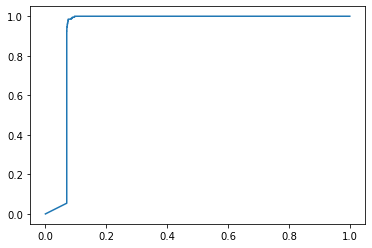

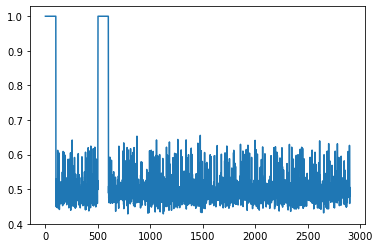

time used:13.428471565246582
TP: 2733 TN: 84 FP: 126 FN: 57
ACC: 0.939 Precision: 0.9559286463798531 Recall: 0.9795698924731183 F1: 0.9676048858204992
FPR: 0.6 TPR: 0.9795698924731183
AUC: 0.7947311827956989


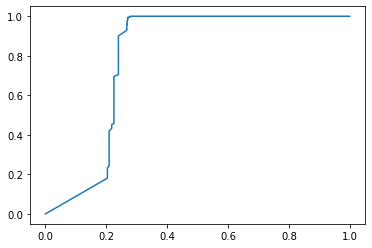

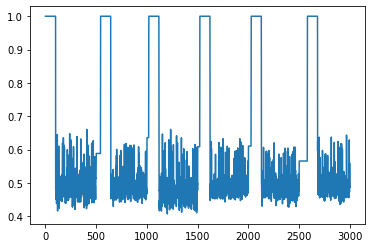

**********
window_size: 100
t: 75
phi: 10
thresh: 0.7
time used:12.028093099594116
TP: 2697 TN: 0 FP: 203 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9315596055460272


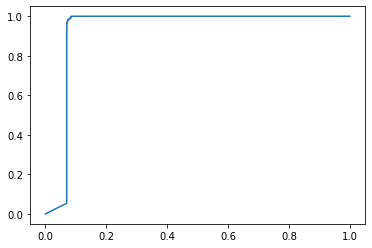

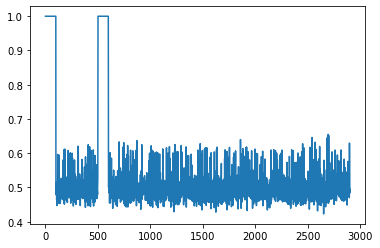

time used:14.62809705734253
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7967460317460318


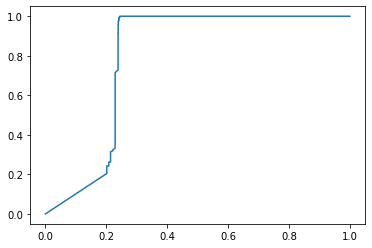

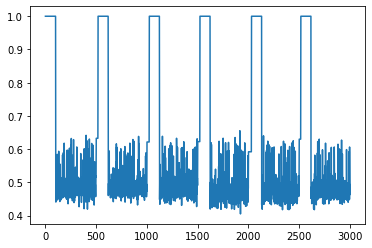

**********
window_size: 100
t: 75
phi: 25
thresh: 0.45
time used:11.87341833114624
TP: 1324 TN: 192 FP: 11 FN: 1373
ACC: 0.5227586206896552 Precision: 0.9917602996254682 Recall: 0.4909158324063775 F1: 0.6567460317460319
FPR: 0.054187192118226604 TPR: 0.4909158324063775
AUC: 0.9318080114558961


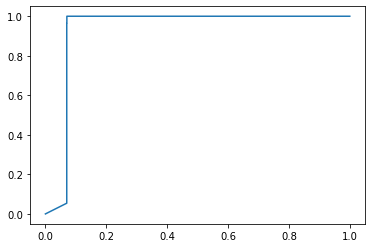

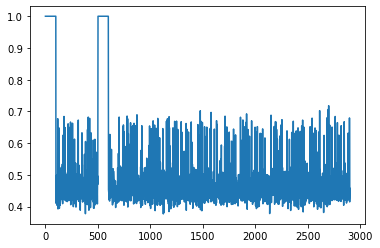

time used:16.018856525421143
TP: 1944 TN: 167 FP: 43 FN: 846
ACC: 0.7036666666666667 Precision: 0.9783593356819326 Recall: 0.6967741935483871 F1: 0.8138999371990788
FPR: 0.20476190476190476 TPR: 0.6967741935483871
AUC: 0.8103259941969619


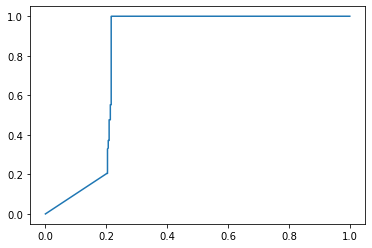

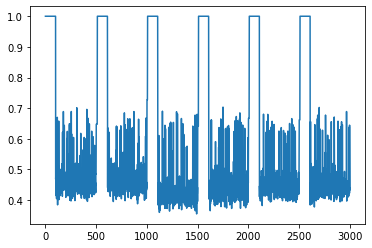

**********
window_size: 100
t: 75
phi: 25
thresh: 0.475
time used:12.394909381866455
TP: 2195 TN: 192 FP: 11 FN: 502
ACC: 0.823103448275862 Precision: 0.9950135992747053 Recall: 0.8138672599184279 F1: 0.8953701815215174
FPR: 0.054187192118226604 TPR: 0.8138672599184279
AUC: 0.9316125744532786


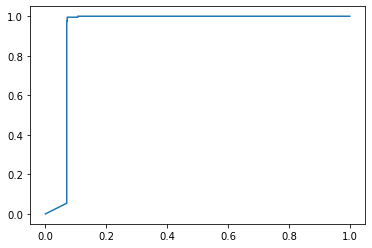

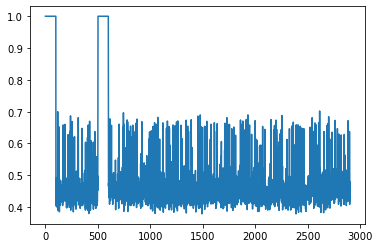

time used:15.549496412277222
TP: 2525 TN: 165 FP: 45 FN: 265
ACC: 0.8966666666666666 Precision: 0.9824902723735408 Recall: 0.9050179211469535 F1: 0.9421641791044776
FPR: 0.21428571428571427 TPR: 0.9050179211469535
AUC: 0.8129825908858167


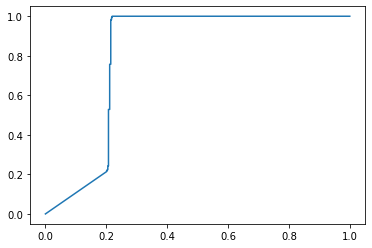

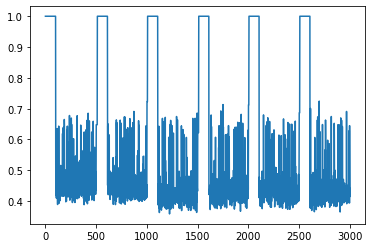

**********
window_size: 100
t: 75
phi: 25
thresh: 0.5
time used:12.426022052764893
TP: 2520 TN: 192 FP: 11 FN: 177
ACC: 0.9351724137931035 Precision: 0.9956538917423943 Recall: 0.9343715239154616 F1: 0.9640397857689366
FPR: 0.054187192118226604 TPR: 0.9343715239154616
AUC: 0.931784266773335


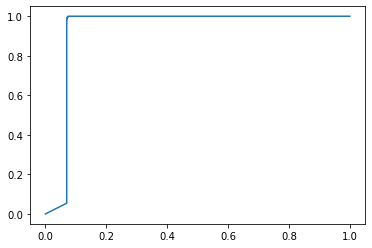

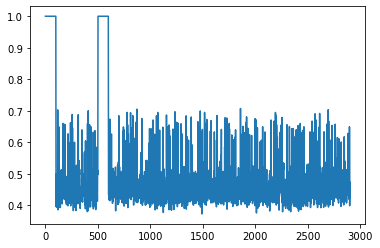

time used:16.720571756362915
TP: 2690 TN: 166 FP: 44 FN: 100
ACC: 0.952 Precision: 0.9839063643013899 Recall: 0.96415770609319 F1: 0.9739319333816074
FPR: 0.20952380952380953 TPR: 0.96415770609319
AUC: 0.8100657108721625


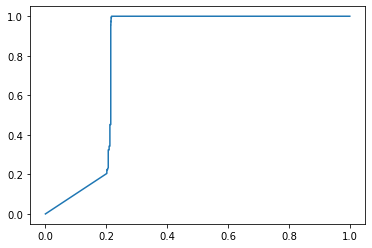

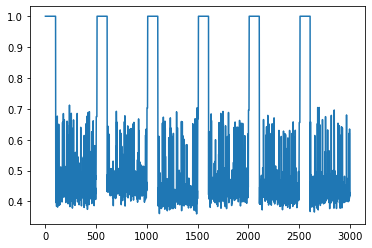

**********
window_size: 100
t: 75
phi: 25
thresh: 0.55
time used:12.284331321716309
TP: 2696 TN: 192 FP: 11 FN: 1
ACC: 0.9958620689655172 Precision: 0.9959364610269671 Recall: 0.9996292176492398 F1: 0.997779422649889
FPR: 0.054187192118226604 TPR: 0.9996292176492398
AUC: 0.9318207970541982


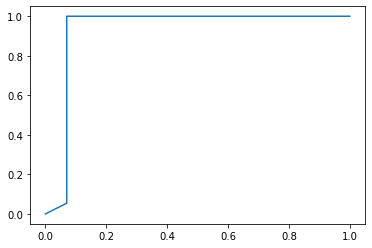

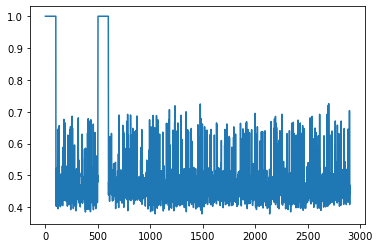

time used:15.337998390197754
TP: 2759 TN: 164 FP: 46 FN: 31
ACC: 0.9743333333333334 Precision: 0.9836007130124778 Recall: 0.9888888888888889 F1: 0.9862377122430742
FPR: 0.21904761904761905 TPR: 0.9888888888888889
AUC: 0.8106246799795187


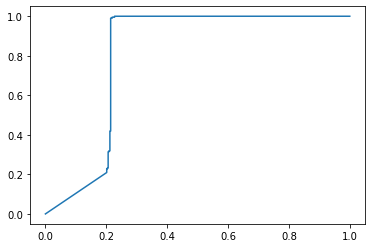

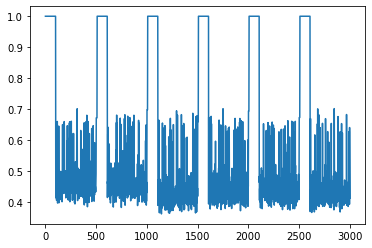

**********
window_size: 100
t: 75
phi: 25
thresh: 0.6
time used:11.08310580253601
TP: 2697 TN: 174 FP: 29 FN: 0
ACC: 0.99 Precision: 0.9893617021276596 Recall: 1.0 F1: 0.9946524064171123
FPR: 0.14285714285714285 TPR: 1.0
AUC: 0.9317751342031194


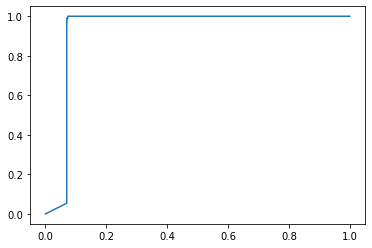

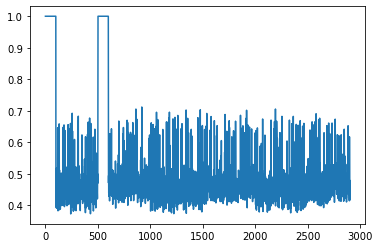

time used:14.849531412124634
TP: 2764 TN: 149 FP: 61 FN: 26
ACC: 0.971 Precision: 0.9784070796460177 Recall: 0.9906810035842294 F1: 0.9845057880676759
FPR: 0.2904761904761905 TPR: 0.9906810035842294
AUC: 0.8115395118620925


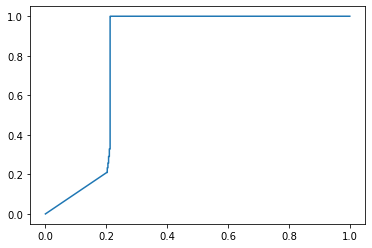

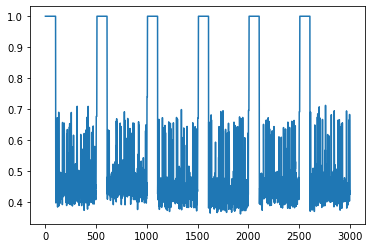

**********
window_size: 100
t: 75
phi: 25
thresh: 0.7
time used:10.634687900543213
TP: 2697 TN: 2 FP: 201 FN: 0
ACC: 0.9306896551724138 Precision: 0.9306418219461697 Recall: 1.0 F1: 0.9640750670241286
FPR: 0.9901477832512315 TPR: 1.0
AUC: 0.9317623486048172


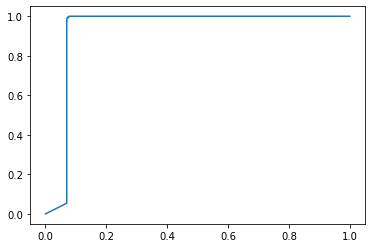

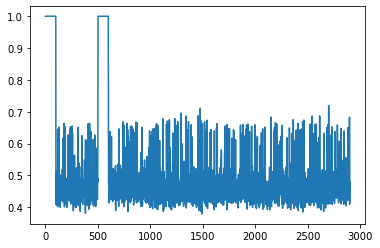

time used:14.728912353515625
TP: 2785 TN: 4 FP: 206 FN: 5
ACC: 0.9296666666666666 Precision: 0.9311267134737546 Recall: 0.9982078853046595 F1: 0.9635011243729458
FPR: 0.9809523809523809 TPR: 0.9982078853046595
AUC: 0.8114481993514252


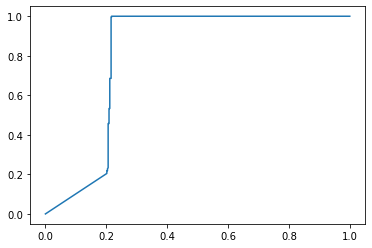

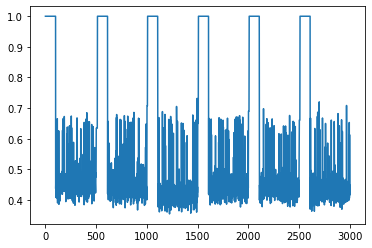

**********
window_size: 100
t: 75
phi: 50
thresh: 0.45
time used:10.781324625015259
TP: 2370 TN: 192 FP: 11 FN: 327
ACC: 0.883448275862069 Precision: 0.9953800923981521 Recall: 0.8787541713014461 F1: 0.9334383615596691
FPR: 0.054187192118226604 TPR: 0.8787541713014461
AUC: 0.9318080114558961


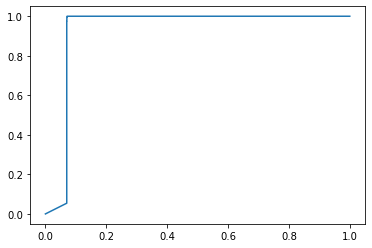

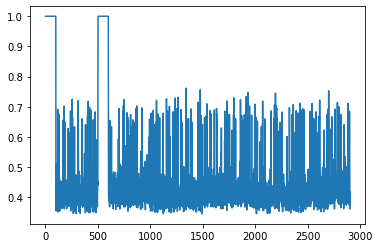

time used:14.951498031616211
TP: 2608 TN: 166 FP: 44 FN: 182
ACC: 0.9246666666666666 Precision: 0.9834087481146304 Recall: 0.9347670250896057 F1: 0.9584711503123852
FPR: 0.20952380952380953 TPR: 0.9347670250896057
AUC: 0.8134374466632531


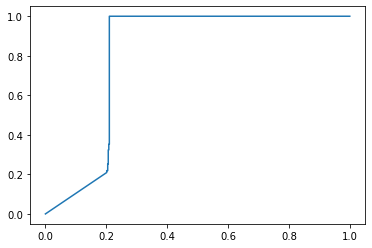

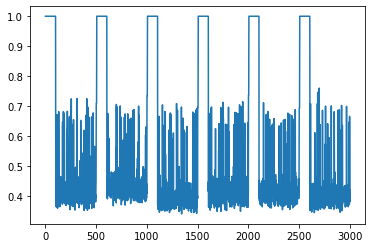

**********
window_size: 100
t: 75
phi: 50
thresh: 0.475
time used:10.76989483833313
TP: 2595 TN: 192 FP: 11 FN: 102
ACC: 0.9610344827586207 Precision: 0.9957789716039908 Recall: 0.9621802002224694 F1: 0.9786913068074674
FPR: 0.054187192118226604 TPR: 0.9621802002224694
AUC: 0.9318171440261119


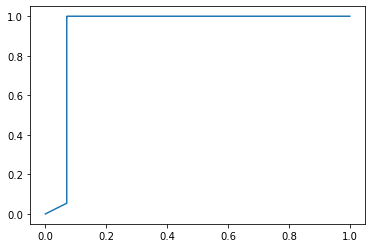

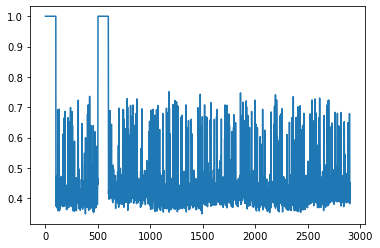

time used:14.986649513244629
TP: 2744 TN: 166 FP: 44 FN: 46
ACC: 0.97 Precision: 0.9842180774748924 Recall: 0.9835125448028674 F1: 0.9838651846539979
FPR: 0.20952380952380953 TPR: 0.9835125448028674
AUC: 0.8142106161460999


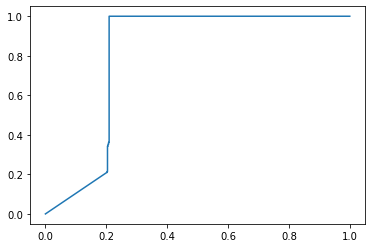

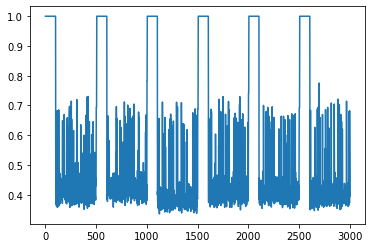

**********
window_size: 100
t: 75
phi: 50
thresh: 0.5
time used:10.798077821731567
TP: 2681 TN: 192 FP: 11 FN: 16
ACC: 0.9906896551724138 Precision: 0.9959138187221397 Recall: 0.9940674823878384 F1: 0.9949897940248655
FPR: 0.054187192118226604 TPR: 0.9940674823878384
AUC: 0.931818970540155


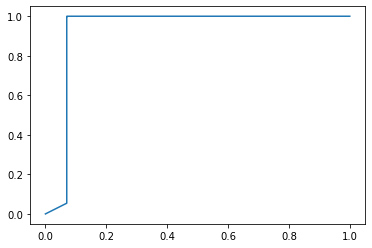

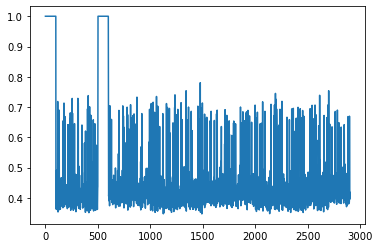

time used:14.931611776351929
TP: 2767 TN: 166 FP: 44 FN: 23
ACC: 0.9776666666666667 Precision: 0.984347207399502 Recall: 0.9917562724014337 F1: 0.98803785038386
FPR: 0.20952380952380953 TPR: 0.9917562724014337
AUC: 0.8147857996245094


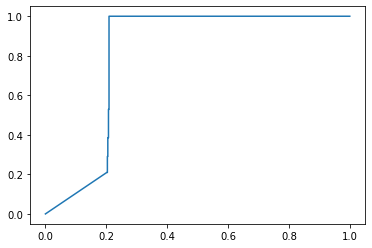

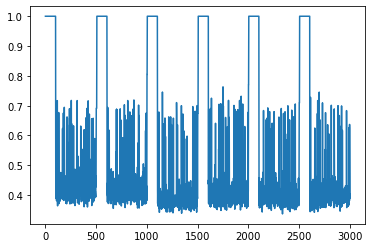

**********
window_size: 100
t: 75
phi: 50
thresh: 0.55
time used:10.755598783493042
TP: 2697 TN: 190 FP: 13 FN: 0
ACC: 0.9955172413793103 Precision: 0.9952029520295202 Recall: 1.0 F1: 0.9975957092657666
FPR: 0.06403940886699508 TPR: 1.0
AUC: 0.931795225857594


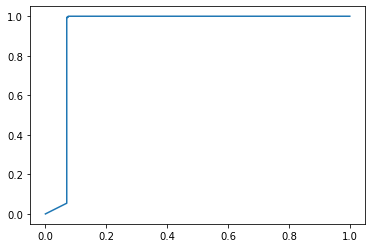

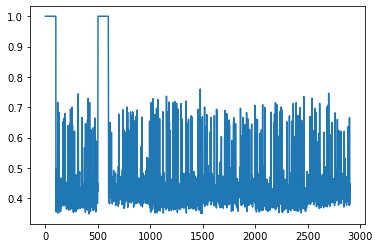

time used:14.928092956542969
TP: 2771 TN: 166 FP: 44 FN: 19
ACC: 0.979 Precision: 0.9843694493783304 Recall: 0.9931899641577061 F1: 0.9887600356824264
FPR: 0.20952380952380953 TPR: 0.9931899641577061
AUC: 0.8141798941798942


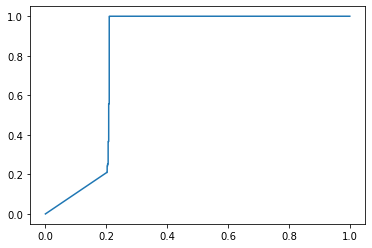

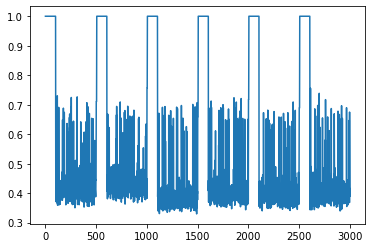

**********
window_size: 100
t: 75
phi: 50
thresh: 0.6
time used:10.727330446243286
TP: 2697 TN: 168 FP: 35 FN: 0
ACC: 0.9879310344827587 Precision: 0.9871888726207906 Recall: 1.0 F1: 0.9935531405415362
FPR: 0.1724137931034483 TPR: 1.0
AUC: 0.9318207970541982


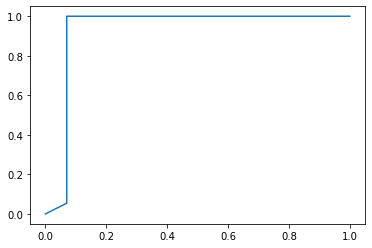

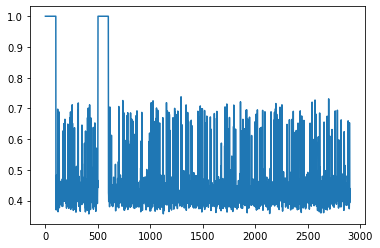

time used:14.960626363754272
TP: 2774 TN: 151 FP: 59 FN: 16
ACC: 0.975 Precision: 0.9791740204729968 Recall: 0.9942652329749104 F1: 0.9866619242397298
FPR: 0.28095238095238095 TPR: 0.9942652329749104
AUC: 0.813899982932241


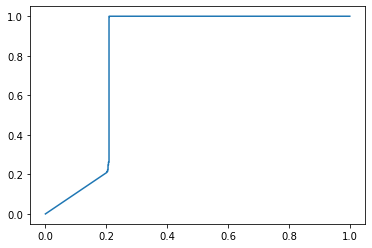

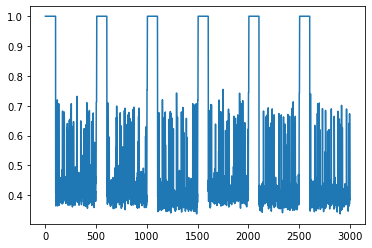

**********
window_size: 100
t: 75
phi: 50
thresh: 0.7
time used:10.772316217422485
TP: 2697 TN: 37 FP: 166 FN: 0
ACC: 0.9427586206896552 Precision: 0.9420188613342647 Recall: 1.0 F1: 0.9701438848920863
FPR: 0.8177339901477833 TPR: 1.0
AUC: 0.9318207970541982


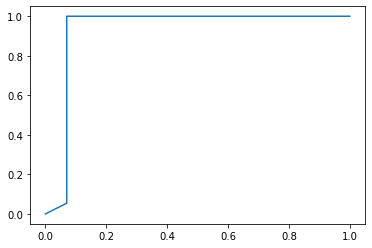

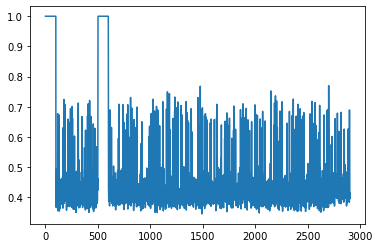

time used:15.021682500839233
TP: 2779 TN: 22 FP: 188 FN: 11
ACC: 0.9336666666666666 Precision: 0.9366363329962926 Recall: 0.9960573476702509 F1: 0.9654333854438074
FPR: 0.8952380952380953 TPR: 0.9960573476702509
AUC: 0.8148830858508278


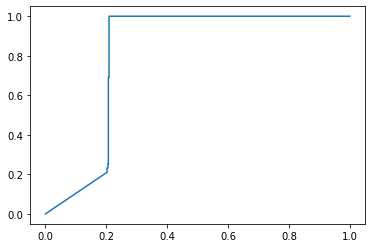

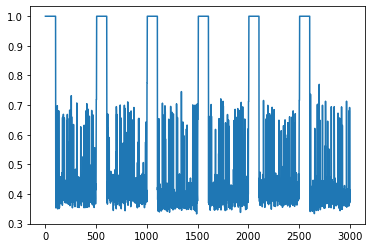

**********
window_size: 100
t: 75
phi: 75
thresh: 0.45
time used:10.858532190322876
TP: 2597 TN: 192 FP: 11 FN: 100
ACC: 0.9617241379310345 Precision: 0.995782208588957 Recall: 0.9629217649239896 F1: 0.9790763430725732
FPR: 0.054187192118226604 TPR: 0.9629217649239896
AUC: 0.9318207970541982


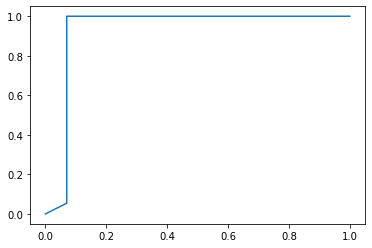

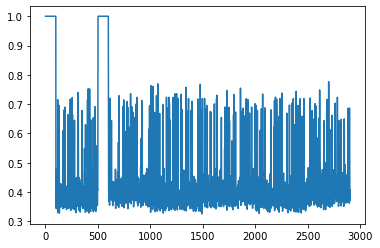

time used:15.092746496200562
TP: 2724 TN: 166 FP: 44 FN: 66
ACC: 0.9633333333333334 Precision: 0.9841040462427746 Recall: 0.9763440860215054 F1: 0.9802087081684059
FPR: 0.20952380952380953 TPR: 0.9763440860215054
AUC: 0.8153917050691244


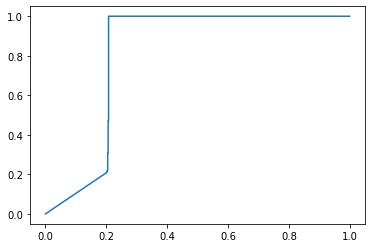

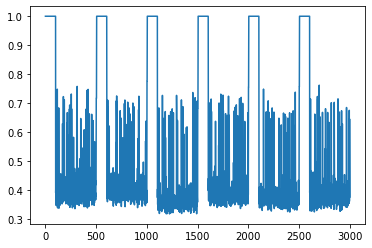

**********
window_size: 100
t: 75
phi: 75
thresh: 0.475
time used:10.893948078155518
TP: 2642 TN: 192 FP: 11 FN: 55
ACC: 0.9772413793103448 Precision: 0.9958537504711648 Recall: 0.9796069707081942 F1: 0.9876635514018692
FPR: 0.054187192118226604 TPR: 0.9796069707081942
AUC: 0.9318207970541982


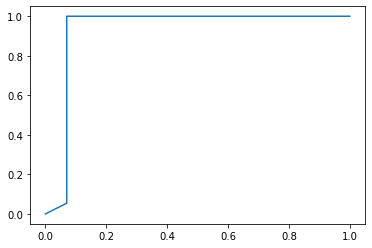

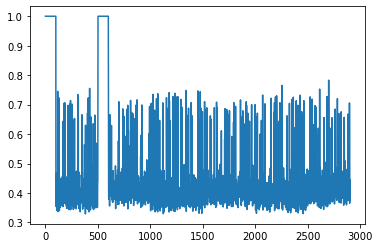

time used:15.161809206008911
TP: 2769 TN: 166 FP: 44 FN: 21
ACC: 0.9783333333333334 Precision: 0.9843583362957696 Recall: 0.9924731182795699 F1: 0.9883990719257542
FPR: 0.20952380952380953 TPR: 0.9924731182795699
AUC: 0.8152978323946066


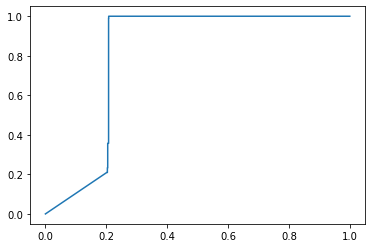

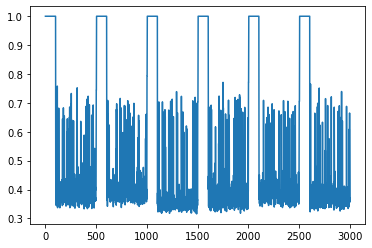

**********
window_size: 100
t: 75
phi: 75
thresh: 0.5
time used:10.84902310371399
TP: 2695 TN: 192 FP: 11 FN: 2
ACC: 0.9955172413793103 Precision: 0.9959349593495935 Recall: 0.9992584352984798 F1: 0.9975939292985379
FPR: 0.054187192118226604 TPR: 0.9992584352984798
AUC: 0.9318207970541982


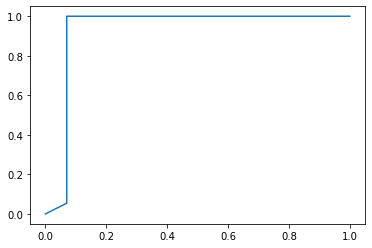

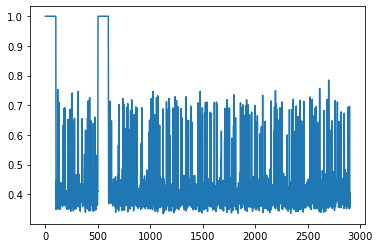

time used:15.117272853851318
TP: 2778 TN: 166 FP: 44 FN: 12
ACC: 0.9813333333333333 Precision: 0.9844082211197732 Recall: 0.9956989247311828 F1: 0.9900213827512473
FPR: 0.20952380952380953 TPR: 0.9956989247311828
AUC: 0.815415599931729


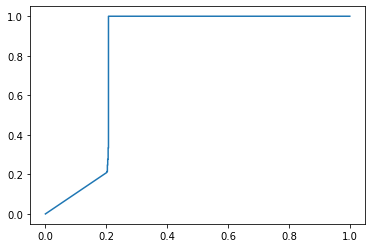

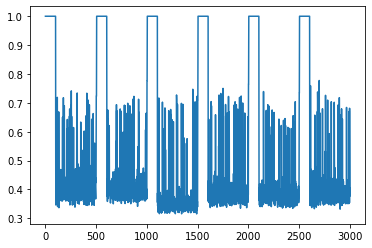

**********
window_size: 100
t: 75
phi: 75
thresh: 0.55
time used:10.852930307388306
TP: 2697 TN: 192 FP: 11 FN: 0
ACC: 0.9962068965517241 Precision: 0.9959379615952733 Recall: 1.0 F1: 0.9979648473635523
FPR: 0.054187192118226604 TPR: 1.0
AUC: 0.9318207970541982


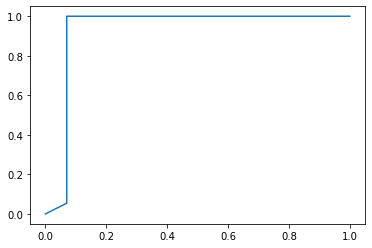

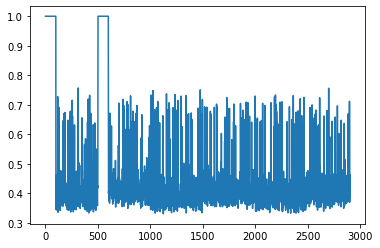

time used:14.485193490982056
TP: 2777 TN: 164 FP: 46 FN: 13
ACC: 0.9803333333333333 Precision: 0.983705278072972 Recall: 0.9953405017921146 F1: 0.9894886869766614
FPR: 0.21904761904761905 TPR: 0.9953405017921146
AUC: 0.8151937190646869


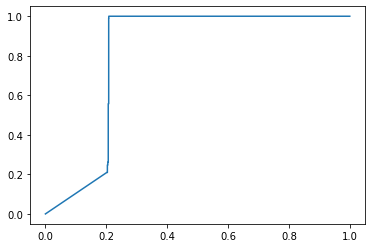

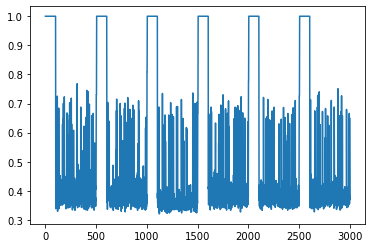

**********
window_size: 100
t: 75
phi: 75
thresh: 0.6
time used:10.98500680923462
TP: 2697 TN: 177 FP: 26 FN: 0
ACC: 0.9910344827586207 Precision: 0.9904517076753581 Recall: 1.0 F1: 0.9952029520295202
FPR: 0.12807881773399016 TPR: 1.0
AUC: 0.9318171440261119


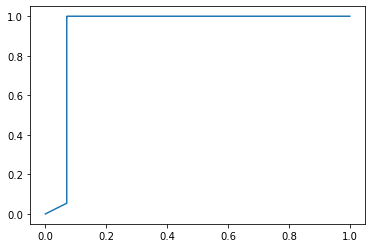

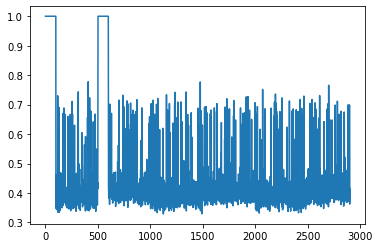

time used:15.076228618621826
TP: 2777 TN: 149 FP: 61 FN: 13
ACC: 0.9753333333333334 Precision: 0.9785059901338972 Recall: 0.9953405017921146 F1: 0.9868514570007106
FPR: 0.2904761904761905 TPR: 0.9953405017921146
AUC: 0.8154719235364397


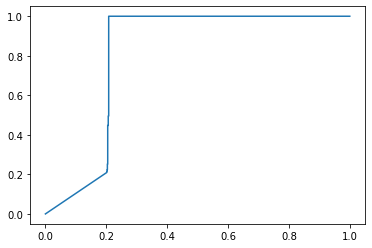

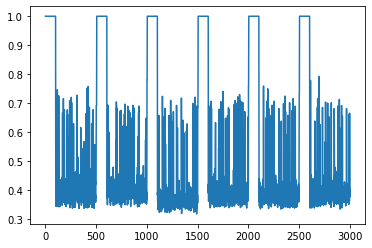

**********
window_size: 100
t: 75
phi: 75
thresh: 0.7
time used:11.020536184310913
TP: 2697 TN: 60 FP: 143 FN: 0
ACC: 0.9506896551724138 Precision: 0.9496478873239437 Recall: 1.0 F1: 0.9741737402925772
FPR: 0.7044334975369458 TPR: 1.0
AUC: 0.9318134909980256


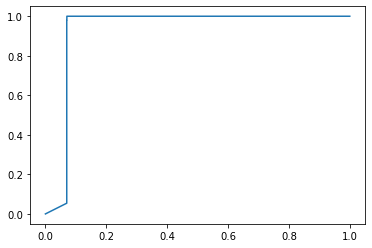

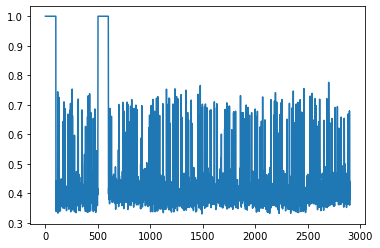

time used:15.0657217502594
TP: 2780 TN: 36 FP: 174 FN: 10
ACC: 0.9386666666666666 Precision: 0.9410968178740691 Recall: 0.996415770609319 F1: 0.9679665738161559
FPR: 0.8285714285714286 TPR: 0.996415770609319
AUC: 0.8151595835466804


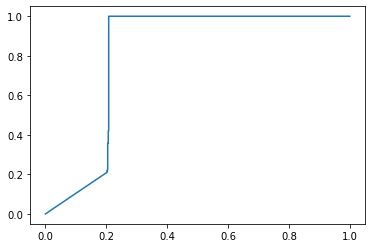

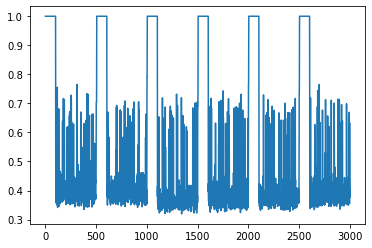

**********
window_size: 100
t: 75
phi: 90
thresh: 0.45
time used:10.865899801254272
TP: 2607 TN: 192 FP: 11 FN: 90
ACC: 0.9651724137931035 Precision: 0.9957983193277311 Recall: 0.9666295884315906 F1: 0.980997177798683
FPR: 0.054187192118226604 TPR: 0.9666295884315906
AUC: 0.931818970540155


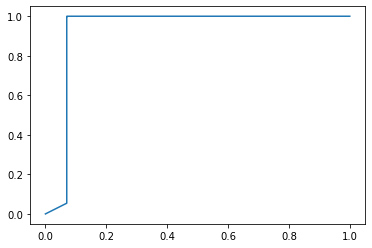

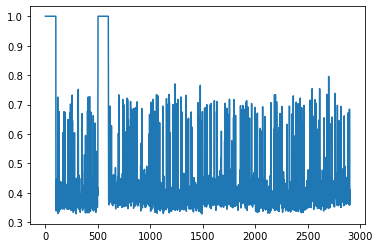

time used:15.20038652420044
TP: 2756 TN: 166 FP: 44 FN: 34
ACC: 0.974 Precision: 0.9842857142857143 Recall: 0.9878136200716846 F1: 0.9860465116279069
FPR: 0.20952380952380953 TPR: 0.9878136200716846
AUC: 0.815289298515105


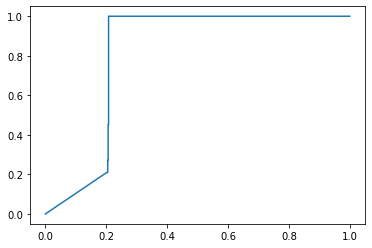

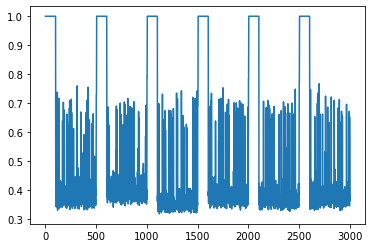

**********
window_size: 100
t: 75
phi: 90
thresh: 0.475
time used:10.916765689849854
TP: 2689 TN: 192 FP: 11 FN: 8
ACC: 0.993448275862069 Precision: 0.9959259259259259 Recall: 0.9970337411939192 F1: 0.996479525662405
FPR: 0.054187192118226604 TPR: 0.9970337411939192
AUC: 0.9318207970541982


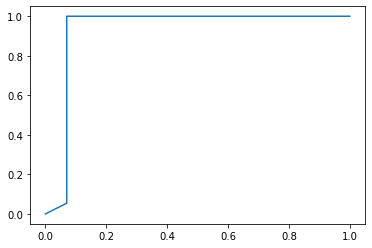

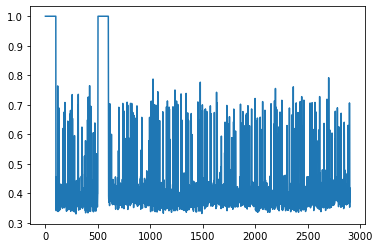

time used:15.09675121307373
TP: 2774 TN: 166 FP: 44 FN: 16
ACC: 0.98 Precision: 0.9843860894251242 Recall: 0.9942652329749104 F1: 0.9893009985734665
FPR: 0.20952380952380953 TPR: 0.9942652329749104
AUC: 0.8152978323946066


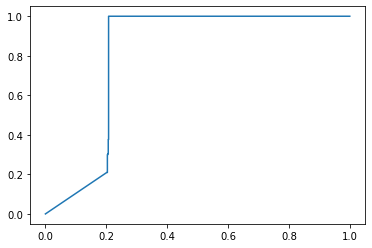

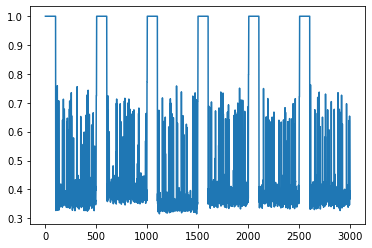

**********
window_size: 100
t: 75
phi: 90
thresh: 0.5
time used:10.852973222732544
TP: 2694 TN: 192 FP: 11 FN: 3
ACC: 0.9951724137931034 Precision: 0.9959334565619223 Recall: 0.9988876529477196 F1: 0.9974083672713808
FPR: 0.054187192118226604 TPR: 0.9988876529477196
AUC: 0.9318207970541982


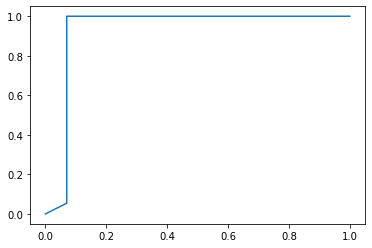

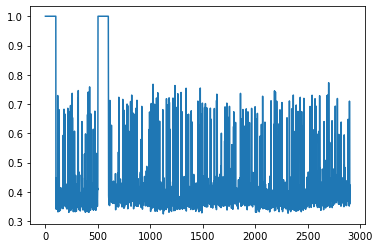

time used:15.128340244293213
TP: 2779 TN: 166 FP: 44 FN: 11
ACC: 0.9816666666666667 Precision: 0.9844137442437123 Recall: 0.9960573476702509 F1: 0.9902013183680741
FPR: 0.20952380952380953 TPR: 0.9960573476702509
AUC: 0.8155965181771633


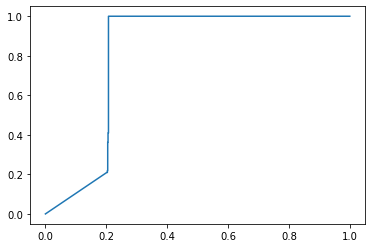

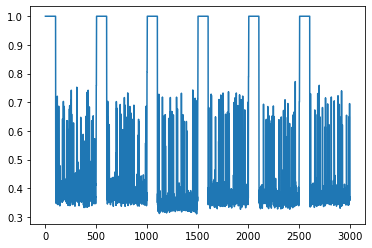

**********
window_size: 100
t: 75
phi: 90
thresh: 0.55
time used:10.841030597686768
TP: 2697 TN: 188 FP: 15 FN: 0
ACC: 0.9948275862068966 Precision: 0.9944690265486725 Recall: 1.0 F1: 0.997226844148641
FPR: 0.07389162561576355 TPR: 1.0
AUC: 0.9318153175120687


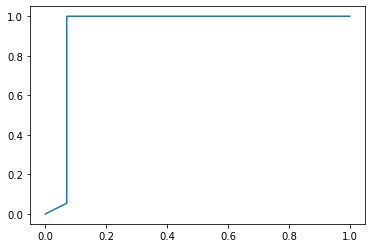

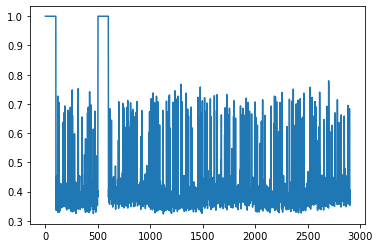

time used:15.087239027023315
TP: 2779 TN: 162 FP: 48 FN: 11
ACC: 0.9803333333333333 Precision: 0.9830208701804033 Recall: 0.9960573476702509 F1: 0.9894961723339861
FPR: 0.22857142857142856 TPR: 0.9960573476702509
AUC: 0.8153405017921147


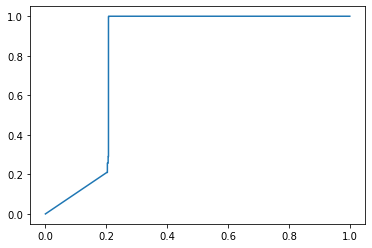

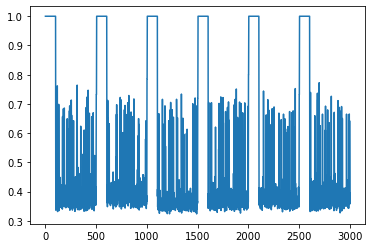

**********
window_size: 100
t: 75
phi: 90
thresh: 0.6
time used:10.895474195480347
TP: 2697 TN: 171 FP: 32 FN: 0
ACC: 0.9889655172413793 Precision: 0.9882740930743862 Recall: 1.0 F1: 0.9941024695908589
FPR: 0.15763546798029557 TPR: 1.0
AUC: 0.931818970540155


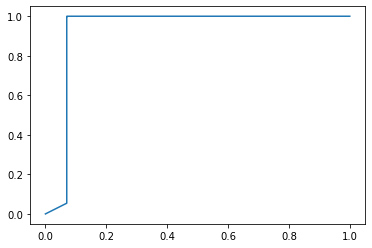

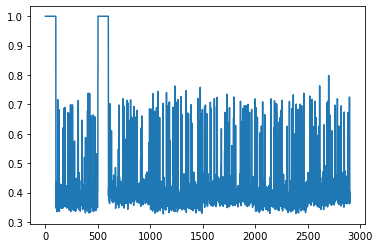

time used:15.108575105667114
TP: 2779 TN: 150 FP: 60 FN: 11
ACC: 0.9763333333333334 Precision: 0.9788657978161325 Recall: 0.9960573476702509 F1: 0.9873867472019897
FPR: 0.2857142857142857 TPR: 0.9960573476702509
AUC: 0.8154872845195426


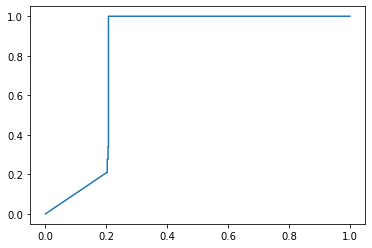

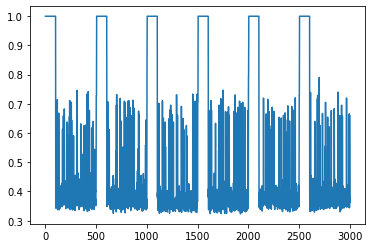

**********
window_size: 100
t: 75
phi: 90
thresh: 0.7
time used:10.842877626419067
TP: 2697 TN: 59 FP: 144 FN: 0
ACC: 0.9503448275862069 Precision: 0.9493136219640972 Recall: 1.0 F1: 0.9739978331527628
FPR: 0.7093596059113301 TPR: 1.0
AUC: 0.9318207970541982


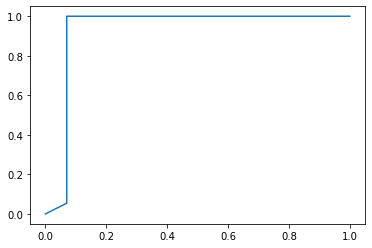

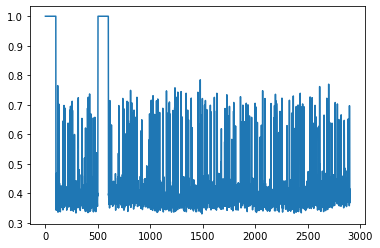

time used:15.03569483757019
TP: 2781 TN: 36 FP: 174 FN: 9
ACC: 0.939 Precision: 0.9411167512690355 Recall: 0.9967741935483871 F1: 0.9681462140992168
FPR: 0.8285714285714286 TPR: 0.9967741935483871
AUC: 0.8154173067076294


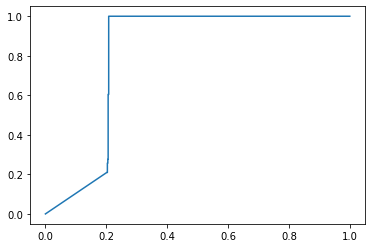

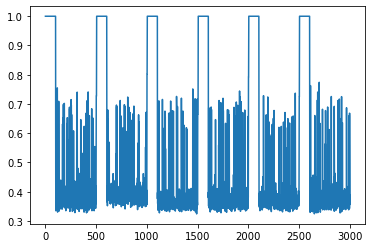

**********
window_size: 100
t: 100
phi: 10
thresh: 0.45
time used:10.630495309829712
TP: 330 TN: 192 FP: 11 FN: 2367
ACC: 0.18 Precision: 0.967741935483871 Recall: 0.12235817575083426 F1: 0.21724818959842002
FPR: 0.054187192118226604 TPR: 0.12235817575083426
AUC: 0.9316381456498829


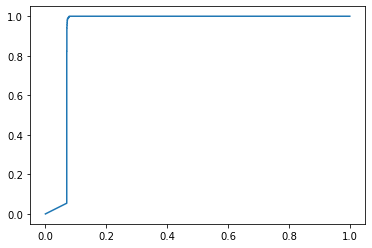

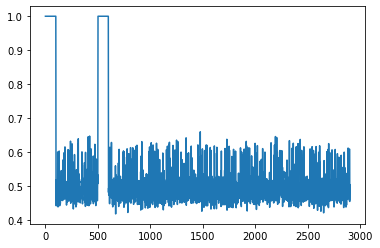

time used:12.737603425979614
TP: 708 TN: 167 FP: 43 FN: 2082
ACC: 0.2916666666666667 Precision: 0.9427430093209055 Recall: 0.2537634408602151 F1: 0.39988703756001126
FPR: 0.20476190476190476 TPR: 0.2537634408602151
AUC: 0.7955683563748079


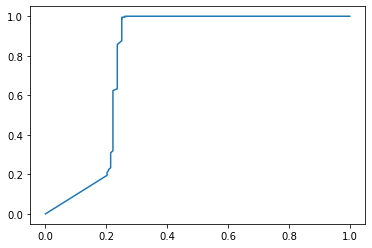

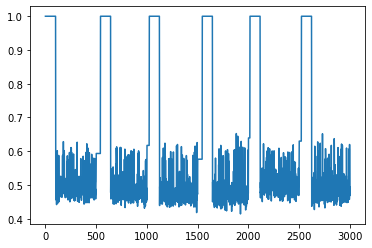

**********
window_size: 100
t: 100
phi: 10
thresh: 0.475
time used:10.737932443618774
TP: 1259 TN: 192 FP: 11 FN: 1438
ACC: 0.5003448275862069 Precision: 0.9913385826771653 Recall: 0.4668149796069707 F1: 0.6347365767582557
FPR: 0.054187192118226604 TPR: 0.4668149796069707
AUC: 0.9316746759307458


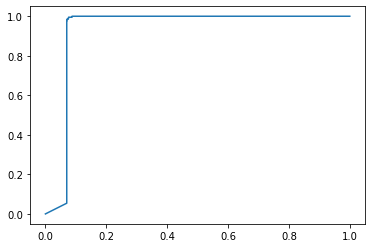

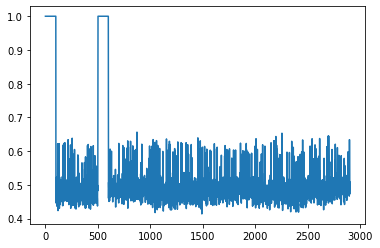

time used:12.664037942886353
TP: 1526 TN: 172 FP: 38 FN: 1264
ACC: 0.566 Precision: 0.9757033248081841 Recall: 0.5469534050179211 F1: 0.7009646302250803
FPR: 0.18095238095238095 TPR: 0.5469534050179211
AUC: 0.79663167776071


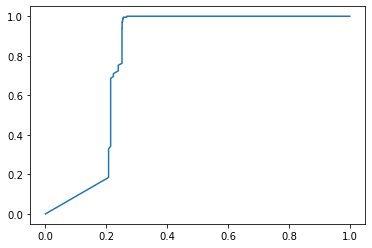

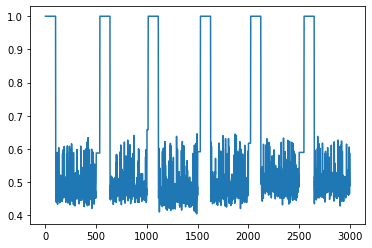

**********
window_size: 100
t: 100
phi: 10
thresh: 0.5
time used:10.641694068908691
TP: 1775 TN: 192 FP: 11 FN: 922
ACC: 0.6782758620689655 Precision: 0.9938409854423292 Recall: 0.6581386725991842 F1: 0.7918804372072272
FPR: 0.054187192118226604 TPR: 0.6581386725991842
AUC: 0.9315230752651642


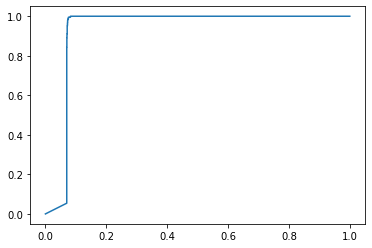

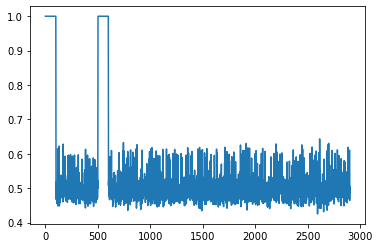

time used:12.108526468276978
TP: 2016 TN: 176 FP: 34 FN: 774
ACC: 0.7306666666666667 Precision: 0.9834146341463414 Recall: 0.7225806451612903 F1: 0.8330578512396694
FPR: 0.1619047619047619 TPR: 0.7225806451612903
AUC: 0.7845221027479092


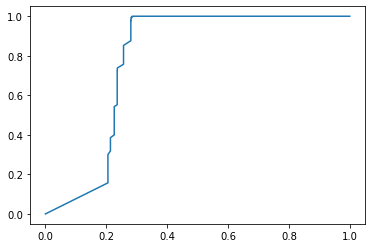

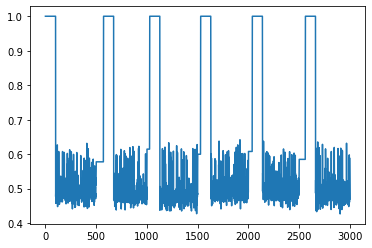

**********
window_size: 100
t: 100
phi: 10
thresh: 0.55
time used:10.623192548751831
TP: 2682 TN: 189 FP: 14 FN: 15
ACC: 0.99 Precision: 0.994807121661721 Recall: 0.9944382647385984 F1: 0.9946226590024104
FPR: 0.06896551724137931 TPR: 0.9944382647385984
AUC: 0.9314573207596106


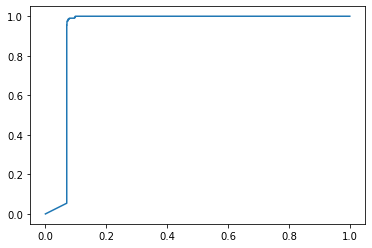

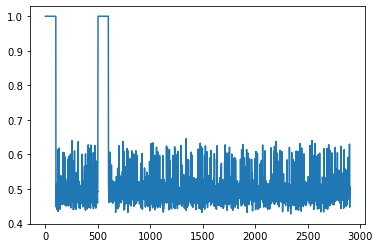

time used:12.5679452419281
TP: 2658 TN: 167 FP: 43 FN: 132
ACC: 0.9416666666666667 Precision: 0.9840799703813402 Recall: 0.9526881720430107 F1: 0.9681296667273721
FPR: 0.20476190476190476 TPR: 0.9526881720430107
AUC: 0.7916752005461682


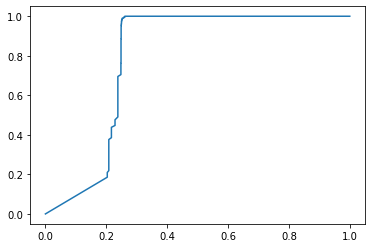

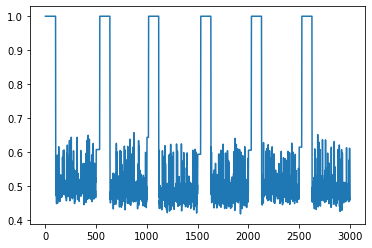

**********
window_size: 100
t: 100
phi: 10
thresh: 0.6
time used:10.693905591964722
TP: 2697 TN: 106 FP: 97 FN: 0
ACC: 0.966551724137931 Precision: 0.9652827487473157 Recall: 1.0 F1: 0.9823347295574577
FPR: 0.47783251231527096 TPR: 1.0
AUC: 0.9315870032566745


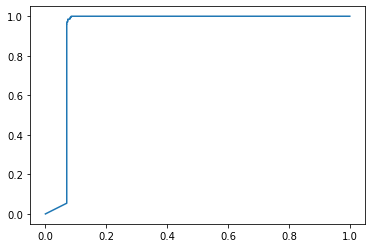

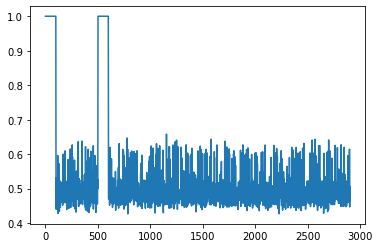

time used:12.84970474243164
TP: 2693 TN: 66 FP: 144 FN: 97
ACC: 0.9196666666666666 Precision: 0.9492421572083186 Recall: 0.9652329749103943 F1: 0.9571707837213436
FPR: 0.6857142857142857 TPR: 0.9652329749103943
AUC: 0.7878835978835979


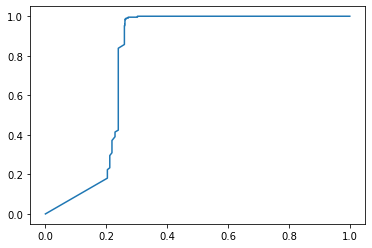

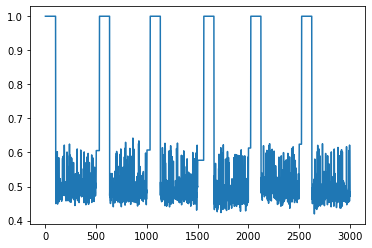

**********
window_size: 100
t: 100
phi: 10
thresh: 0.7
time used:10.658893823623657
TP: 2697 TN: 0 FP: 203 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.9314299230489634


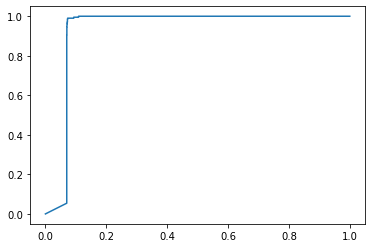

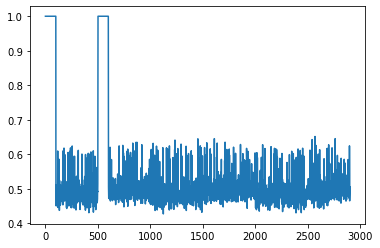

time used:12.64301347732544
TP: 2790 TN: 0 FP: 210 FN: 0
ACC: 0.93 Precision: 0.93 Recall: 1.0 F1: 0.9637305699481865
FPR: 1.0 TPR: 1.0
AUC: 0.7975123741252775


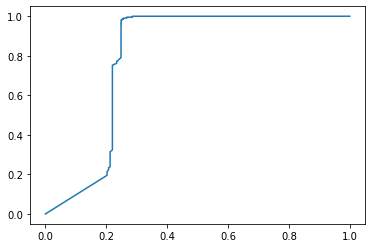

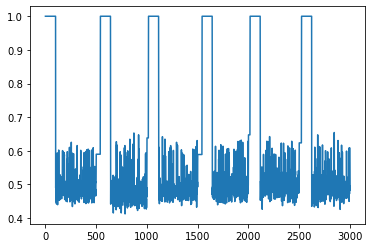

**********
window_size: 100
t: 100
phi: 25
thresh: 0.45
time used:10.77298355102539
TP: 1303 TN: 192 FP: 11 FN: 1394
ACC: 0.5155172413793103 Precision: 0.9916286149162862 Recall: 0.4831294030404153 F1: 0.6497132884567439
FPR: 0.054187192118226604 TPR: 0.4831294030404153
AUC: 0.9318171440261118


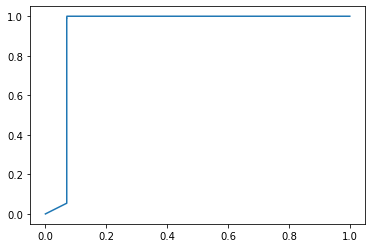

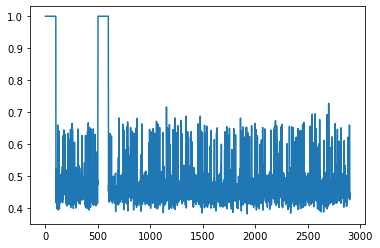

time used:14.959129810333252
TP: 2203 TN: 166 FP: 44 FN: 587
ACC: 0.7896666666666666 Precision: 0.9804183355585224 Recall: 0.7896057347670251 F1: 0.8747270200516181
FPR: 0.20952380952380953 TPR: 0.7896057347670251
AUC: 0.8112783751493429


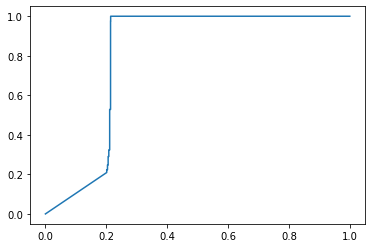

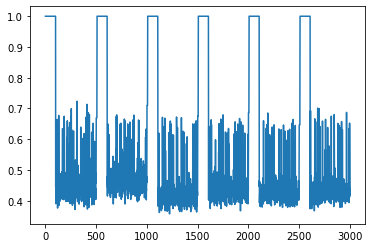

**********
window_size: 100
t: 100
phi: 25
thresh: 0.475
time used:10.799838066101074
TP: 2036 TN: 192 FP: 11 FN: 661
ACC: 0.7682758620689655 Precision: 0.9946262823644357 Recall: 0.7549128661475714 F1: 0.8583473861720067
FPR: 0.054187192118226604 TPR: 0.7549128661475714
AUC: 0.9318207970541982


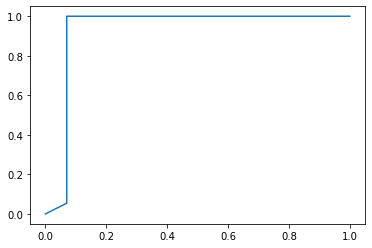

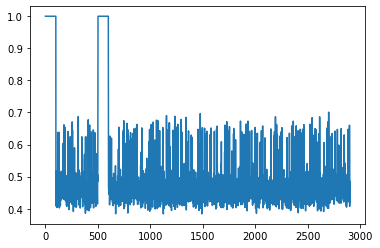

time used:14.871041774749756
TP: 2518 TN: 166 FP: 44 FN: 272
ACC: 0.8946666666666667 Precision: 0.9828259172521467 Recall: 0.9025089605734767 F1: 0.9409566517189835
FPR: 0.20952380952380953 TPR: 0.9025089605734767
AUC: 0.810668202764977


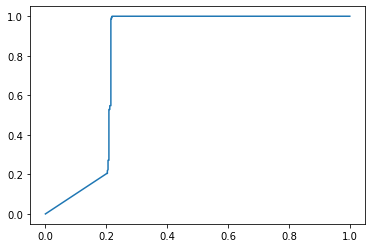

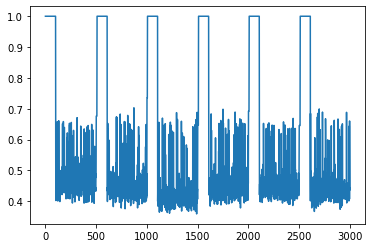

**********
window_size: 100
t: 100
phi: 25
thresh: 0.5
time used:10.80504059791565
TP: 2512 TN: 192 FP: 11 FN: 185
ACC: 0.9324137931034483 Precision: 0.9956401109789933 Recall: 0.9314052651093808 F1: 0.9624521072796934
FPR: 0.054187192118226604 TPR: 0.9314052651093808
AUC: 0.9318207970541982


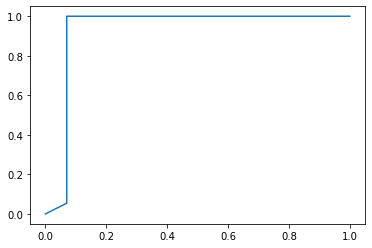

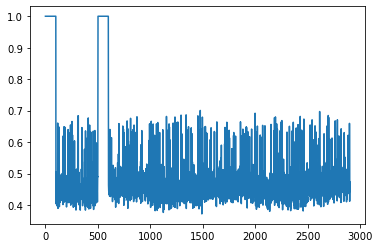

time used:14.810488939285278
TP: 2701 TN: 166 FP: 44 FN: 89
ACC: 0.9556666666666667 Precision: 0.9839708561020036 Recall: 0.9681003584229391 F1: 0.9759710930442637
FPR: 0.20952380952380953 TPR: 0.9681003584229391
AUC: 0.8111281788701143


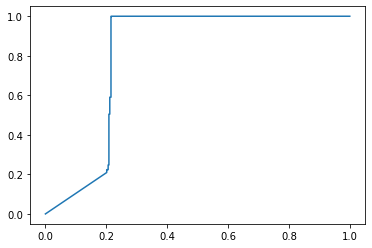

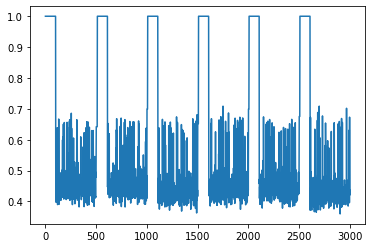

**********
window_size: 100
t: 100
phi: 25
thresh: 0.55
time used:10.812942028045654
TP: 2695 TN: 191 FP: 12 FN: 2
ACC: 0.9951724137931034 Precision: 0.995567048393055 Recall: 0.9992584352984798 F1: 0.9974093264248705
FPR: 0.059113300492610835 TPR: 0.9992584352984798
AUC: 0.9318134909980256


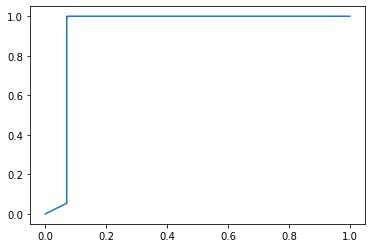

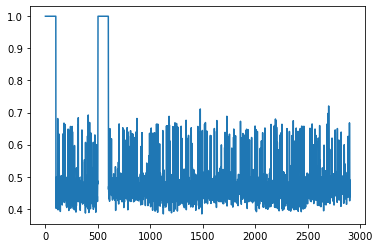

time used:14.822997570037842
TP: 2757 TN: 165 FP: 45 FN: 33
ACC: 0.974 Precision: 0.9839400428265525 Recall: 0.9881720430107527 F1: 0.9860515021459227
FPR: 0.21428571428571427 TPR: 0.9881720430107527
AUC: 0.8116547192353644


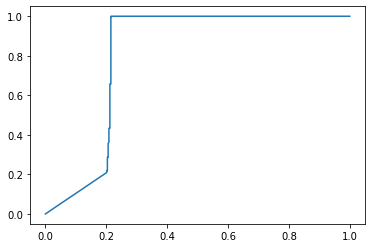

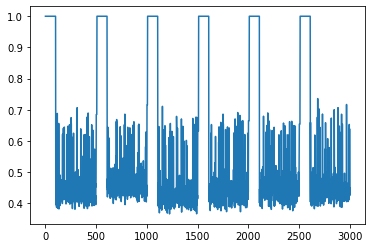

**********
window_size: 100
t: 100
phi: 25
thresh: 0.6
time used:10.784655094146729
TP: 2697 TN: 176 FP: 27 FN: 0
ACC: 0.9906896551724138 Precision: 0.9900881057268722 Recall: 1.0 F1: 0.9950193691200885
FPR: 0.1330049261083744 TPR: 1.0
AUC: 0.9318207970541982


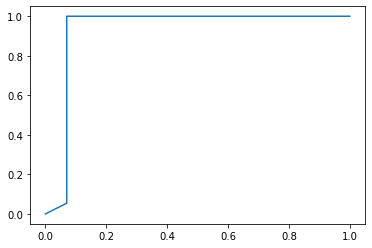

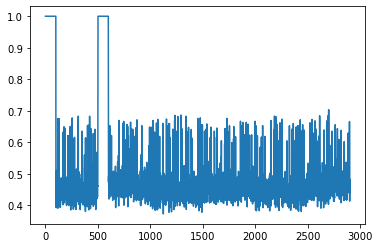

time used:14.778460502624512
TP: 2754 TN: 147 FP: 63 FN: 36
ACC: 0.967 Precision: 0.9776357827476039 Recall: 0.9870967741935484 F1: 0.9823434991974317
FPR: 0.3 TPR: 0.9870967741935484
AUC: 0.8104778972520909


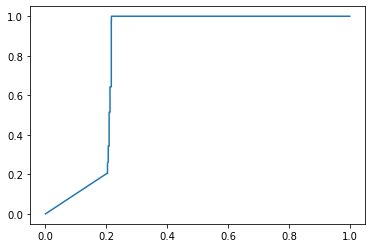

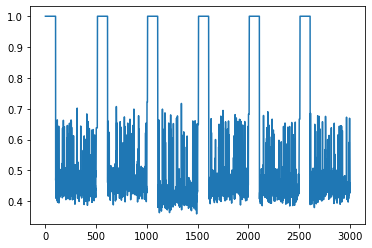

**********
window_size: 100
t: 100
phi: 25
thresh: 0.7
time used:10.863897800445557
TP: 2697 TN: 1 FP: 202 FN: 0
ACC: 0.9303448275862068 Precision: 0.9303208002759572 Recall: 1.0 F1: 0.963902787705504
FPR: 0.9950738916256158 TPR: 1.0
AUC: 0.9318116644839824


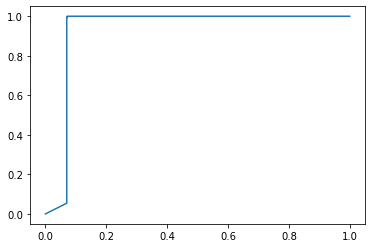

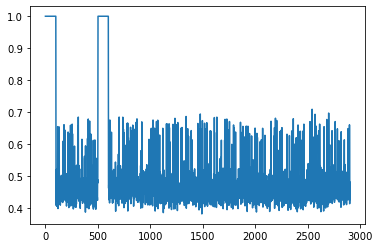

time used:14.86653995513916
TP: 2780 TN: 1 FP: 209 FN: 10
ACC: 0.927 Precision: 0.9300769488123118 Recall: 0.996415770609319 F1: 0.9621041702716733
FPR: 0.9952380952380953 TPR: 0.996415770609319
AUC: 0.8116530124594641


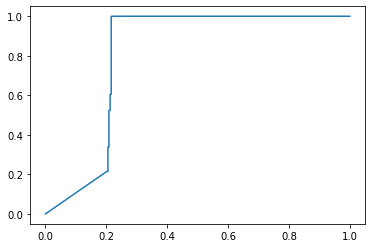

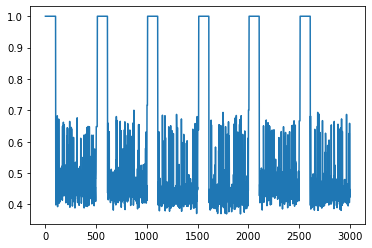

**********
window_size: 100
t: 100
phi: 50
thresh: 0.45
time used:10.95447587966919
TP: 2364 TN: 192 FP: 11 FN: 333
ACC: 0.8813793103448276 Precision: 0.9953684210526316 Recall: 0.8765294771968855 F1: 0.9321766561514195
FPR: 0.054187192118226604 TPR: 0.8765294771968855
AUC: 0.9318043584278097


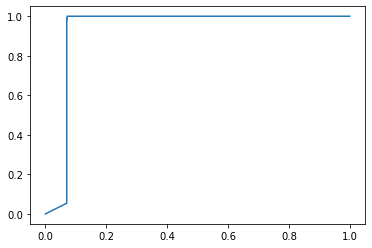

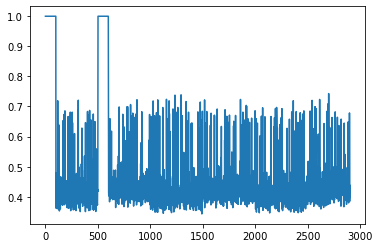

time used:15.093244075775146
TP: 2626 TN: 166 FP: 44 FN: 164
ACC: 0.9306666666666666 Precision: 0.9835205992509364 Recall: 0.9412186379928316 F1: 0.9619047619047619
FPR: 0.20952380952380953 TPR: 0.9412186379928316
AUC: 0.8138692609660352


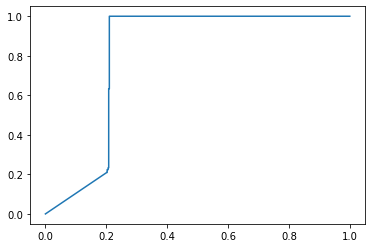

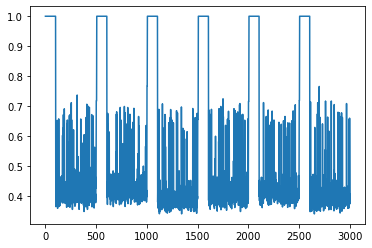

**********
window_size: 100
t: 100
phi: 50
thresh: 0.475
time used:10.924952030181885
TP: 2561 TN: 192 FP: 11 FN: 136
ACC: 0.9493103448275862 Precision: 0.9957231726283048 Recall: 0.9495736002966259 F1: 0.9721009679256025
FPR: 0.054187192118226604 TPR: 0.9495736002966259
AUC: 0.9318061849418529


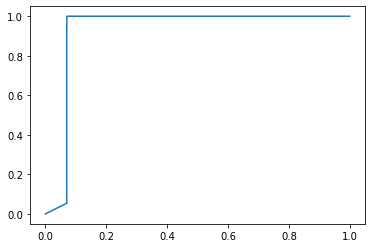

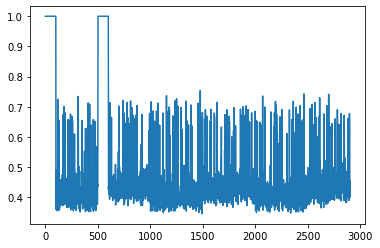

time used:15.093947172164917
TP: 2748 TN: 166 FP: 44 FN: 42
ACC: 0.9713333333333334 Precision: 0.9842406876790831 Recall: 0.9849462365591398 F1: 0.9845933357219635
FPR: 0.20952380952380953 TPR: 0.9849462365591398
AUC: 0.8144000682710361


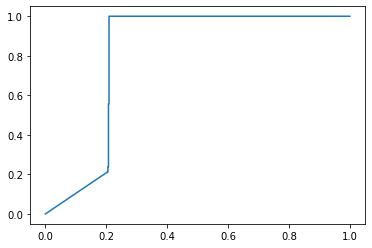

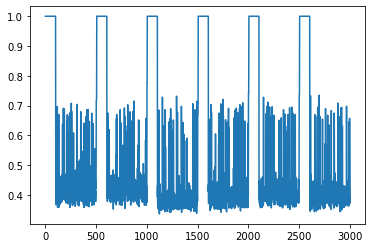

**********
window_size: 100
t: 100
phi: 50
thresh: 0.5
time used:10.946475267410278
TP: 2671 TN: 192 FP: 11 FN: 26
ACC: 0.9872413793103448 Precision: 0.9958985831469053 Recall: 0.9903596588802372 F1: 0.9931213980293734
FPR: 0.054187192118226604 TPR: 0.9903596588802372
AUC: 0.9318207970541982


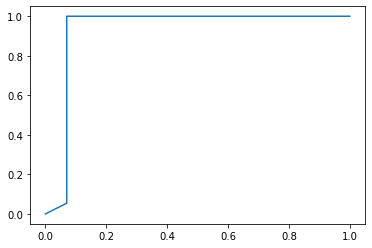

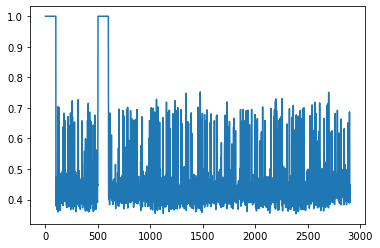

time used:15.072223901748657
TP: 2767 TN: 166 FP: 44 FN: 23
ACC: 0.9776666666666667 Precision: 0.984347207399502 Recall: 0.9917562724014337 F1: 0.98803785038386
FPR: 0.20952380952380953 TPR: 0.9917562724014337
AUC: 0.8144427376685441


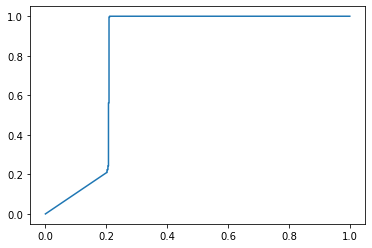

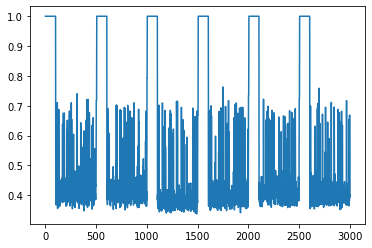

**********
window_size: 100
t: 100
phi: 50
thresh: 0.55
time used:10.928474187850952
TP: 2695 TN: 192 FP: 11 FN: 2
ACC: 0.9955172413793103 Precision: 0.9959349593495935 Recall: 0.9992584352984798 F1: 0.9975939292985379
FPR: 0.054187192118226604 TPR: 0.9992584352984798
AUC: 0.931818970540155


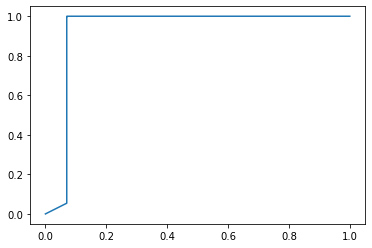

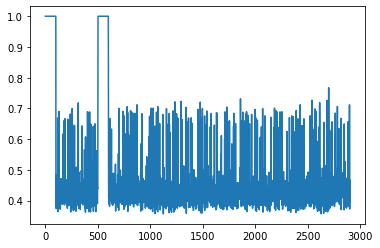

time used:15.142793655395508
TP: 2774 TN: 165 FP: 45 FN: 16
ACC: 0.9796666666666667 Precision: 0.9840368925150763 Recall: 0.9942652329749104 F1: 0.9891246211445891
FPR: 0.21428571428571427 TPR: 0.9942652329749104
AUC: 0.8146338965693805


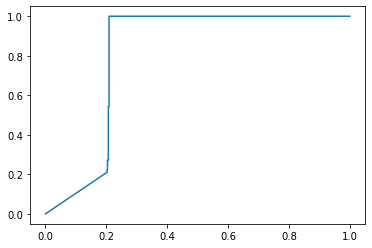

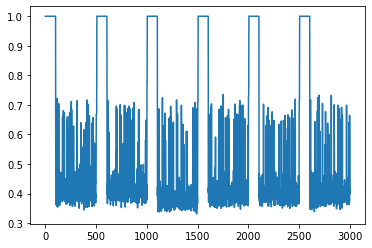

**********
window_size: 100
t: 100
phi: 50
thresh: 0.6
time used:10.9319589138031
TP: 2697 TN: 173 FP: 30 FN: 0
ACC: 0.9896551724137931 Precision: 0.988998899889989 Recall: 1.0 F1: 0.9944690265486725
FPR: 0.1477832512315271 TPR: 1.0
AUC: 0.9318207970541982


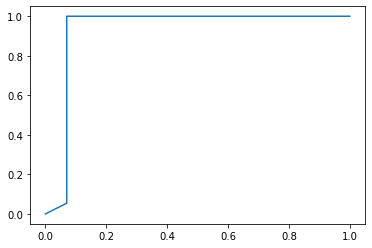

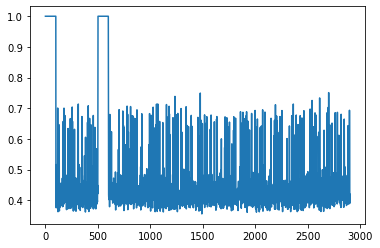

time used:15.116264343261719
TP: 2771 TN: 151 FP: 59 FN: 19
ACC: 0.974 Precision: 0.9791519434628976 Recall: 0.9931899641577061 F1: 0.9861209964412812
FPR: 0.28095238095238095 TPR: 0.9931899641577061
AUC: 0.8141201570233828


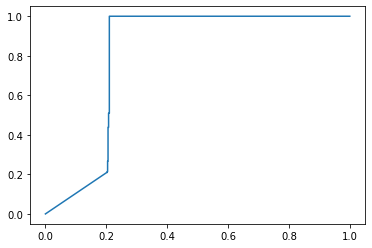

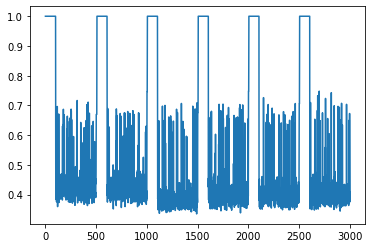

**********
window_size: 100
t: 100
phi: 50
thresh: 0.7
time used:10.937488555908203
TP: 2697 TN: 44 FP: 159 FN: 0
ACC: 0.9451724137931035 Precision: 0.944327731092437 Recall: 1.0 F1: 0.9713668287412209
FPR: 0.7832512315270936 TPR: 1.0
AUC: 0.9318207970541982


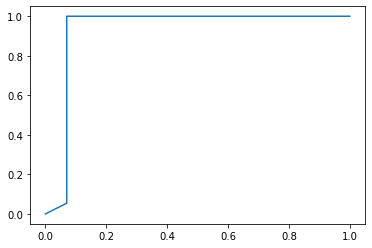

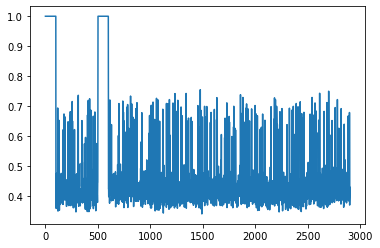

time used:15.110763311386108
TP: 2782 TN: 18 FP: 192 FN: 8
ACC: 0.9333333333333333 Precision: 0.9354404841963685 Recall: 0.9971326164874552 F1: 0.9653018736988203
FPR: 0.9142857142857143 TPR: 0.9971326164874552
AUC: 0.8145417306707629


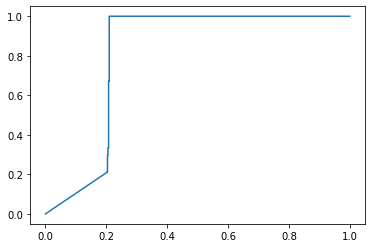

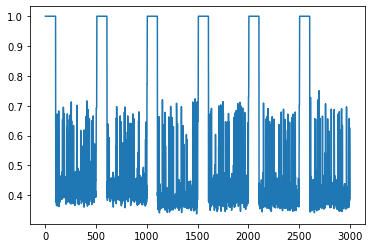

**********
window_size: 100
t: 100
phi: 75
thresh: 0.45
time used:11.078124284744263
TP: 2540 TN: 192 FP: 11 FN: 157
ACC: 0.9420689655172414 Precision: 0.9956879655037241 Recall: 0.9417871709306637 F1: 0.9679878048780487
FPR: 0.054187192118226604 TPR: 0.9417871709306637
AUC: 0.9318207970541982


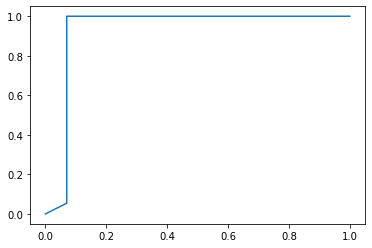

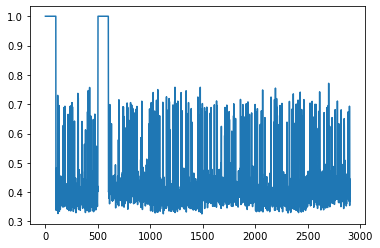

time used:15.223865509033203
TP: 2741 TN: 166 FP: 44 FN: 49
ACC: 0.969 Precision: 0.9842010771992818 Recall: 0.9824372759856631 F1: 0.9833183856502242
FPR: 0.20952380952380953 TPR: 0.9824372759856631
AUC: 0.8150128008192525


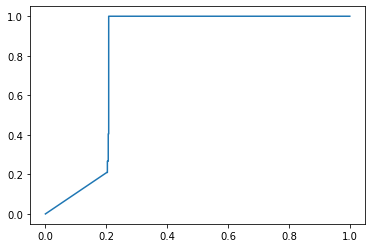

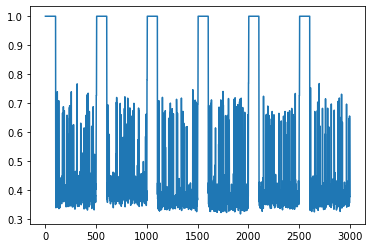

**********
window_size: 100
t: 100
phi: 75
thresh: 0.475
time used:11.101628541946411
TP: 2662 TN: 192 FP: 11 FN: 35
ACC: 0.9841379310344828 Precision: 0.9958847736625515 Recall: 0.9870226177233964 F1: 0.9914338919925512
FPR: 0.054187192118226604 TPR: 0.9870226177233964
AUC: 0.9318207970541982


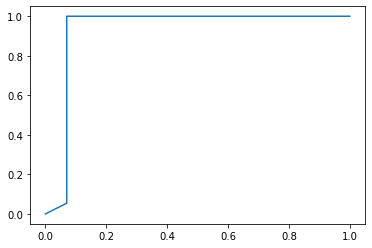

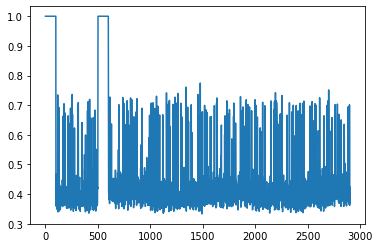

time used:15.265400648117065
TP: 2765 TN: 166 FP: 44 FN: 25
ACC: 0.977 Precision: 0.9843360626557494 Recall: 0.9910394265232975 F1: 0.9876763707804965
FPR: 0.20952380952380953 TPR: 0.9910394265232975
AUC: 0.8150878989588667


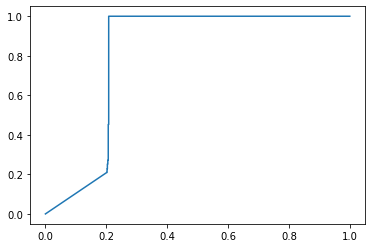

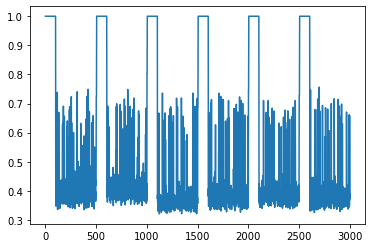

**********
window_size: 100
t: 100
phi: 75
thresh: 0.5
time used:11.161213159561157
TP: 2691 TN: 192 FP: 11 FN: 6
ACC: 0.9941379310344828 Precision: 0.9959289415247965 Recall: 0.9977753058954394 F1: 0.9968512687534729
FPR: 0.054187192118226604 TPR: 0.9977753058954394
AUC: 0.9318207970541982


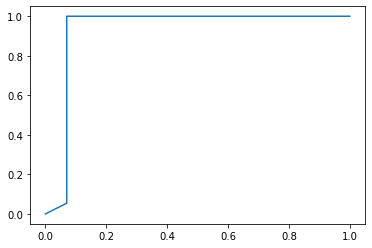

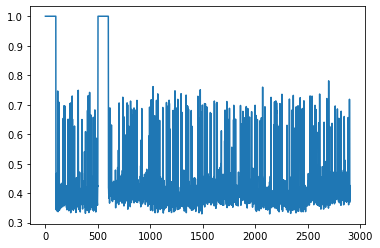

time used:15.233950138092041
TP: 2773 TN: 166 FP: 44 FN: 17
ACC: 0.9796666666666667 Precision: 0.9843805466808662 Recall: 0.9939068100358422 F1: 0.9891207419297307
FPR: 0.20952380952380953 TPR: 0.9939068100358422
AUC: 0.8154173067076294


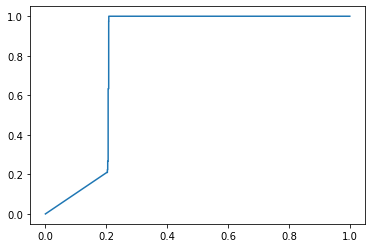

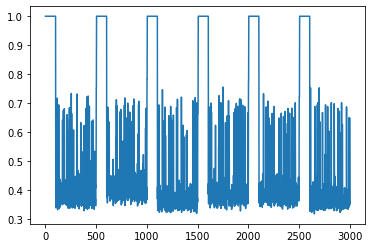

**********
window_size: 100
t: 100
phi: 75
thresh: 0.55
time used:11.071085691452026
TP: 2697 TN: 192 FP: 11 FN: 0
ACC: 0.9962068965517241 Precision: 0.9959379615952733 Recall: 1.0 F1: 0.9979648473635523
FPR: 0.054187192118226604 TPR: 1.0
AUC: 0.9318207970541982


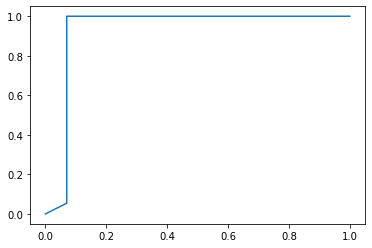

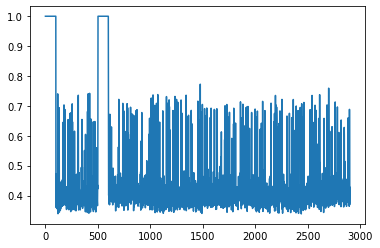

time used:15.204351663589478
TP: 2778 TN: 160 FP: 50 FN: 12
ACC: 0.9793333333333333 Precision: 0.9823196605374823 Recall: 0.9956989247311828 F1: 0.9889640441438234
FPR: 0.23809523809523808 TPR: 0.9956989247311828
AUC: 0.8154599761051374


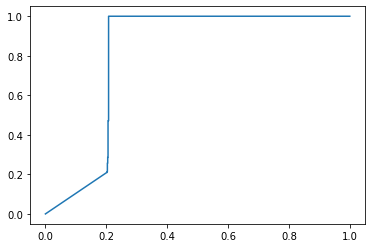

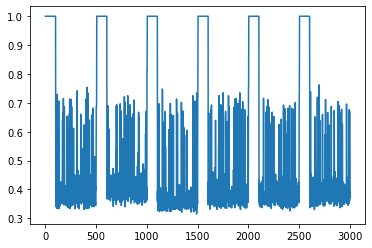

**********
window_size: 100
t: 100
phi: 75
thresh: 0.6
time used:11.057183265686035
TP: 2697 TN: 183 FP: 20 FN: 0
ACC: 0.993103448275862 Precision: 0.9926389400073611 Recall: 1.0 F1: 0.9963058736608792
FPR: 0.09852216748768473 TPR: 1.0
AUC: 0.931818970540155


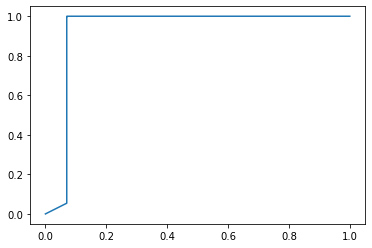

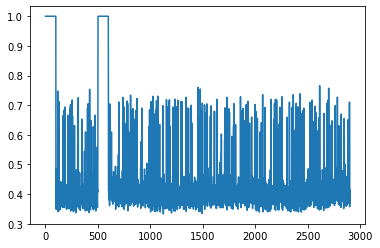

time used:15.25215482711792
TP: 2776 TN: 147 FP: 63 FN: 14
ACC: 0.9743333333333334 Precision: 0.9778090877069391 Recall: 0.9949820788530466 F1: 0.9863208385148339
FPR: 0.3 TPR: 0.9949820788530466
AUC: 0.8148250554702168


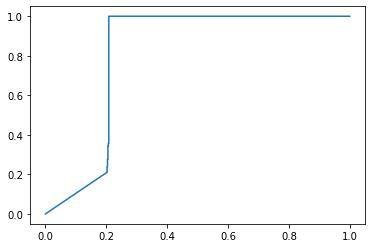

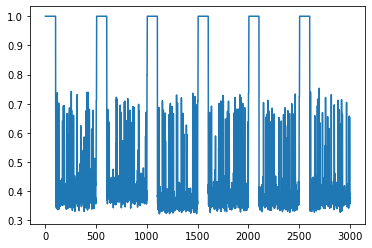

**********
window_size: 100
t: 100
phi: 75
thresh: 0.7
time used:11.099111080169678
TP: 2697 TN: 57 FP: 146 FN: 0
ACC: 0.9496551724137932 Precision: 0.9486457966936335 Recall: 1.0 F1: 0.9736462093862815
FPR: 0.7192118226600985 TPR: 1.0
AUC: 0.9318207970541982


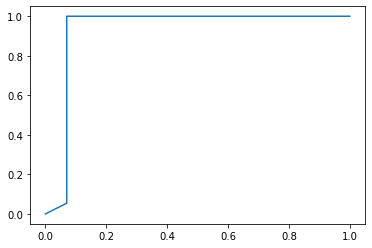

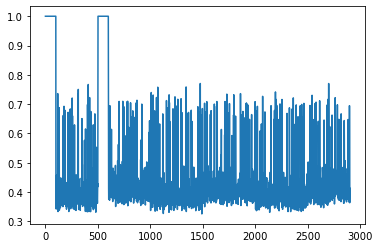

time used:15.289428234100342
TP: 2779 TN: 33 FP: 177 FN: 11
ACC: 0.9373333333333334 Precision: 0.9401217861975643 Recall: 0.9960573476702509 F1: 0.9672815871910894
FPR: 0.8428571428571429 TPR: 0.9960573476702509
AUC: 0.8152483358934972


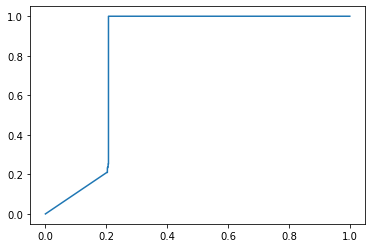

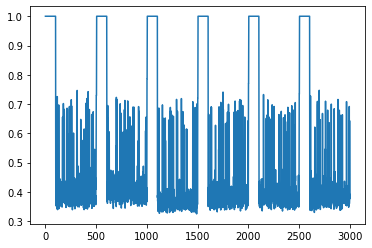

**********
window_size: 100
t: 100
phi: 90
thresh: 0.45
time used:11.04957103729248
TP: 2622 TN: 192 FP: 11 FN: 75
ACC: 0.9703448275862069 Precision: 0.9958222559817699 Recall: 0.9721913236929922 F1: 0.9838649155722328
FPR: 0.054187192118226604 TPR: 0.9721913236929922
AUC: 0.9318207970541982


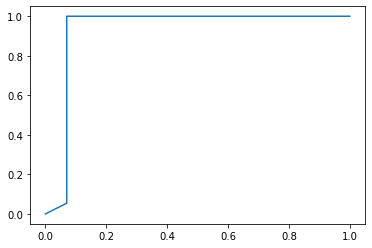

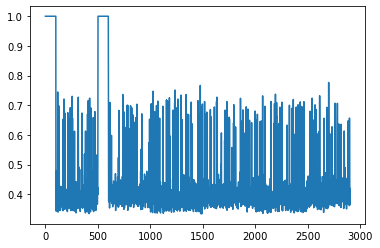

time used:15.613723993301392
TP: 2763 TN: 166 FP: 44 FN: 27
ACC: 0.9763333333333334 Precision: 0.9843249020306377 Recall: 0.9903225806451613 F1: 0.987314632839021
FPR: 0.20952380952380953 TPR: 0.9903225806451613
AUC: 0.8155419013483529


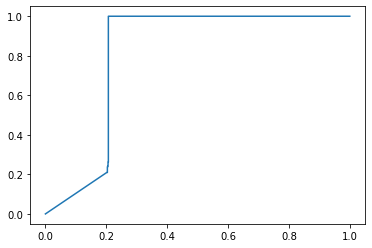

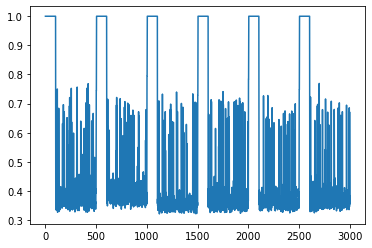

**********
window_size: 100
t: 100
phi: 90
thresh: 0.475
time used:11.061076164245605
TP: 2680 TN: 192 FP: 11 FN: 17
ACC: 0.9903448275862069 Precision: 0.9959123002601263 Recall: 0.9936967000370782 F1: 0.9948032665181885
FPR: 0.054187192118226604 TPR: 0.9936967000370782
AUC: 0.9318207970541982


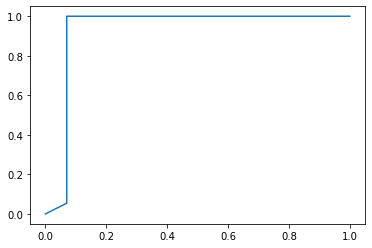

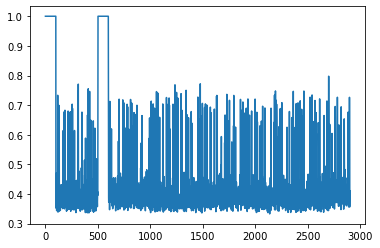

time used:15.25138807296753
TP: 2777 TN: 166 FP: 44 FN: 13
ACC: 0.981 Precision: 0.9844026940801134 Recall: 0.9953405017921146 F1: 0.989841382997683
FPR: 0.20952380952380953 TPR: 0.9953405017921146
AUC: 0.8154702167605393


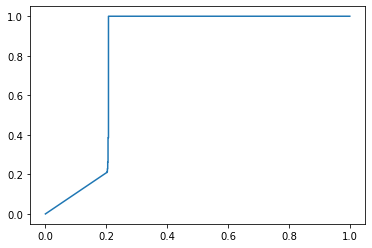

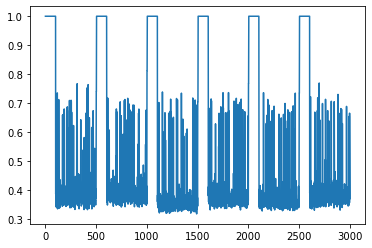

**********
window_size: 100
t: 100
phi: 90
thresh: 0.5
time used:11.068593263626099
TP: 2695 TN: 192 FP: 11 FN: 2
ACC: 0.9955172413793103 Precision: 0.9959349593495935 Recall: 0.9992584352984798 F1: 0.9975939292985379
FPR: 0.054187192118226604 TPR: 0.9992584352984798
AUC: 0.931818970540155


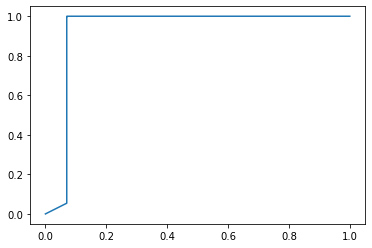

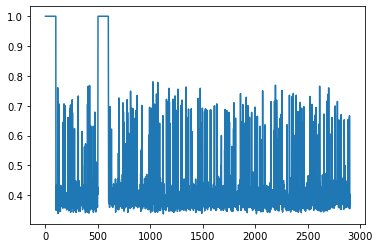

time used:15.291197061538696
TP: 2780 TN: 166 FP: 44 FN: 10
ACC: 0.982 Precision: 0.9844192634560907 Recall: 0.996415770609319 F1: 0.9903811898824368
FPR: 0.20952380952380953 TPR: 0.996415770609319
AUC: 0.8155982249530636


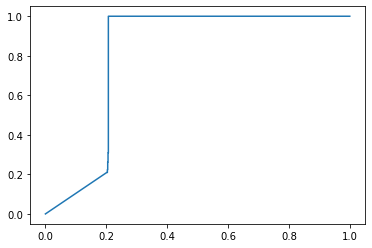

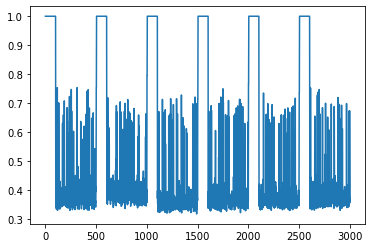

**********
window_size: 100
t: 100
phi: 90
thresh: 0.55
time used:11.108244895935059
TP: 2697 TN: 189 FP: 14 FN: 0
ACC: 0.9951724137931034 Precision: 0.9948358539284397 Recall: 1.0 F1: 0.9974112426035503
FPR: 0.06896551724137931 TPR: 1.0
AUC: 0.9318207970541982


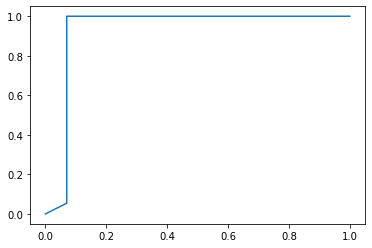

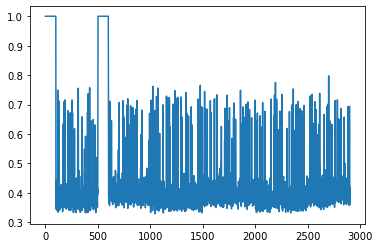

time used:15.259899139404297
TP: 2778 TN: 160 FP: 50 FN: 12
ACC: 0.9793333333333333 Precision: 0.9823196605374823 Recall: 0.9956989247311828 F1: 0.9889640441438234
FPR: 0.23809523809523808 TPR: 0.9956989247311828
AUC: 0.815410479604028


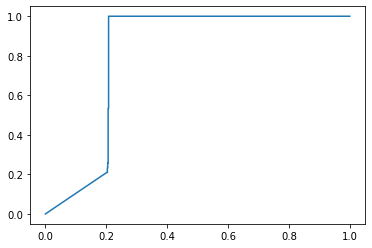

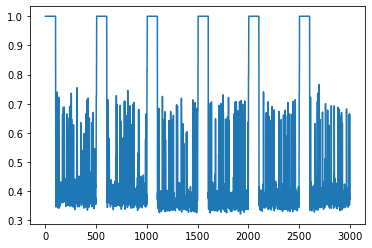

**********
window_size: 100
t: 100
phi: 90
thresh: 0.6
time used:11.05823826789856
TP: 2697 TN: 172 FP: 31 FN: 0
ACC: 0.9893103448275862 Precision: 0.9886363636363636 Recall: 1.0 F1: 0.9942857142857142
FPR: 0.15270935960591134 TPR: 1.0
AUC: 0.9318207970541982


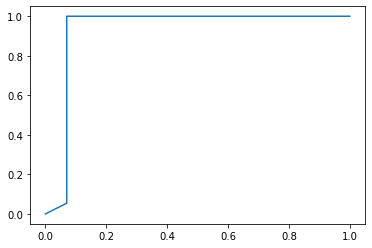

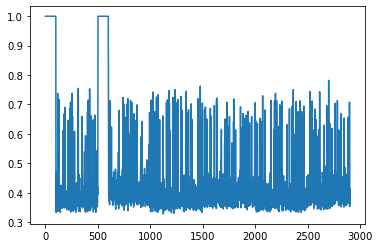

time used:15.329230308532715
TP: 2779 TN: 147 FP: 63 FN: 11
ACC: 0.9753333333333334 Precision: 0.9778325123152709 Recall: 0.9960573476702509 F1: 0.9868607954545454
FPR: 0.3 TPR: 0.9960573476702509
AUC: 0.8154360812425329


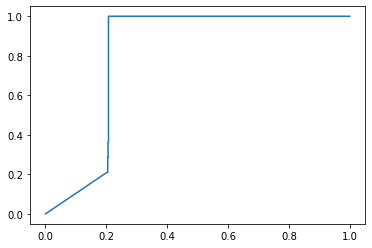

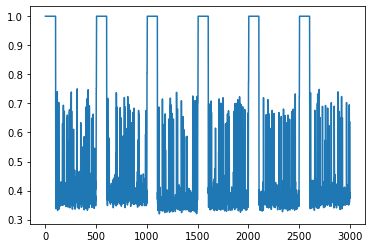

**********
window_size: 100
t: 100
phi: 90
thresh: 0.7
time used:11.103191375732422
TP: 2697 TN: 50 FP: 153 FN: 0
ACC: 0.9472413793103448 Precision: 0.9463157894736842 Recall: 1.0 F1: 0.9724175229853975
FPR: 0.7536945812807881 TPR: 1.0
AUC: 0.9318171440261119


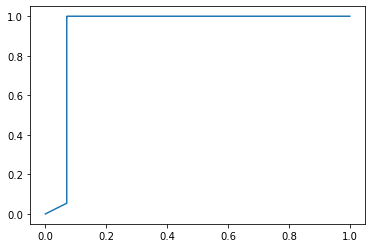

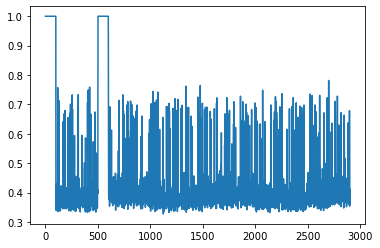

time used:15.364994764328003
TP: 2782 TN: 35 FP: 175 FN: 8
ACC: 0.939 Precision: 0.9408183970240108 Recall: 0.9971326164874552 F1: 0.968157299460588
FPR: 0.8333333333333334 TPR: 0.9971326164874552
AUC: 0.8155589691073561


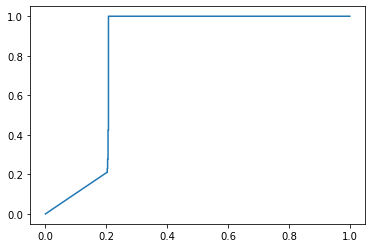

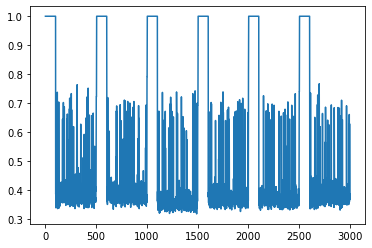

total time: 14221.326887607574 s


In [47]:
# window_size_list = list(range(10,1000,50))
# t_list = list(range(10,100,20))
# phi_list = list(range(int(window_size/10),window_size,int(window_size/10)))
# thresh_list = [0.35,0.4,0.45,0.5,0.55,0.6,0.65,0.7,0.75]
import time
window_size_list = np.array([20,30,50,100])
t_list = np.array([20,50,75,100])
phi_list = np.array([0.1,0.25,0.5,0.75,0.9])
thresh_list = np.array([0.45,0.475,0.5,0.55,0.6,0.7])

np.save("window_size_list_3.npy",window_size_list)
np.save("t_list_3.npy",t_list)
np.save("phi_list_3.npy",phi_list)
np.save("thresh_list_3.npy",thresh_list)

# window_size_list = [30]
# t_list = [10]
# phi_list = [0.5]
# thresh_list = [0.5]

results = np.zeros((len(window_size_list),
                    len(t_list),
                    len(phi_list),
                    len(thresh_list),
                    2,
                    12))
start = time.time()
for aa in range(len(window_size_list)):
    window_size = window_size_list[aa]
    for bb in range(len(t_list)):
        t = t_list[bb]
        for cc in range(len(phi_list)):
            phi = int(phi_list[cc]*window_size)
            for dd in range(len(thresh_list)):
                thresh = thresh_list[dd]
                
                print('*'*10)
                print('window_size:',window_size)
                print('t:',t)
                print('phi:',phi)
                print('thresh:',thresh)
                
                detector = algorithm(e=10,
                                     window_size=window_size,
                                     t=t,
                                     phi=phi,
                                     delta=0.02,
                                     min_win_size=5,
                                     thresh=thresh)
                prediction = []
                s_prediction = []
                tic = time.time()
                for i in range(len(stream)):
                    x = stream[i]
                    output,ss = detector.predict(x)
                    prediction += output
                    s_prediction += ss
#                     e_num.append(len(detector.ensemble))
                    print(str(aa*len(t_list)*len(phi_list)*len(thresh_list)
                              +bb*len(phi_list)*len(thresh_list)
                              +cc*len(thresh_list)
                              +dd)+'/'
                            +str(len(window_size_list)
                               *len(t_list)
                               *len(phi_list)
                               *len(thresh_list))
                          +' '
                          +str(i)+'/'+str(len(stream)),end='\r')
                toc = time.time()
                print('time used:'+str(toc-tic))
                
                res = evaluation(prediction,s_prediction,label[:len(prediction)])
                res.append(toc-tic)
                plt.figure()
                plt.plot(s_prediction)
                plt.show()
                results[aa,bb,cc,dd,0] = np.array(res)
#                 for e in range(len(detector.ensemble)):
#                     plt.figure()
#                     plt.plot(detector.ensemble[e].prediction)
#                     plt.show()
                
                detector = iForestADWIN(train_size=window_size,
                                     t=t,
                                     phi=phi,
                                     delta=0.02,
                                     min_win_size=5,
                                     thresh=thresh)
                prediction = []
                tic = time.time()
                for i in range(len(stream)):
                    x = stream[i]
                    detector.add_element(x)
                    print(str(aa*len(t_list)*len(phi_list)*len(thresh_list)
                              +bb*len(phi_list)*len(thresh_list)
                              +cc*len(thresh_list)
                              +dd)+'/'
                            +str(len(window_size_list)
                               *len(t_list)
                               *len(phi_list)
                               *len(thresh_list))
                          +' '
                          +str(i)+'/'+str(len(stream)),end='\r')
                prediction = detector.prediction
                s_prediction = detector.score
                toc = time.time()
                print('time used:'+str(toc-tic))
                
                res = evaluation(prediction,s_prediction,label[:len(prediction)])
                res.append(toc-tic)
                plt.figure()
                plt.plot(s_prediction)
                plt.show()
                results[aa,bb,cc,dd,1] = np.array(res)
end = time.time()
np.save("results_3.npy",results)
print('total time:',end-start,'s')


In [123]:
results = np.load('results.npy')
window_size_list = np.load('window_size_list.npy')
t_list = np.load('t_list.npy')
phi_list = np.load('phi_list.npy')
thresh_list = np.load('thresh_list.npy')

In [48]:
print(results[0,0,0,0,:])

[[2.77200000e+03 0.00000000e+00 2.08000000e+02 0.00000000e+00
  9.30201342e-01 9.30201342e-01 1.00000000e+00 9.63838665e-01
  1.00000000e+00 1.00000000e+00 4.95369214e-01 1.15460441e+01]
 [2.79000000e+03 0.00000000e+00 2.10000000e+02 0.00000000e+00
  9.30000000e-01 9.30000000e-01 1.00000000e+00 9.63730570e-01
  1.00000000e+00 1.00000000e+00 4.98796723e-01 2.08601363e+01]]


In [55]:
for aa in range(results.shape[0]):
    for bb in range(results.shape[1]):
        print('\\begin{table}[h]')
        print('\\centering')
        print('\\begin{tabular}{| p{1cm} p{1cm} p{1cm} p{1cm} || p{1.75cm} p{1.5cm} || p{1.75cm} p{1.5cm} | p{1cm} |}')
        print('\\hline')
        print('Buf Size & Trees & samp Size & thresh & SADWIN IFA $F_1$ & SADWIN IFA AUC & Prop alg $F_1$ & Prop alg AUC & Time Ratio\\\\')
        print('\\hline')
        
        for cc in range(results.shape[2]):
            print('\\hline')
            for dd in range(results.shape[3]):
                print(window_size_list[aa],'&',
                      t_list[bb],'&',
                      phi_list[cc],'&',
                      thresh_list[dd],'&',
                      np.round(results[aa,bb,cc,dd,1,7]*100,decimals=2),'\% &',
                      np.round(results[aa,bb,cc,dd,1,10],decimals=2),' &',
                      np.round(results[aa,bb,cc,dd,0,7]*100,decimals=2),'\% &',
                      np.round(results[aa,bb,cc,dd,0,10],decimals=2),' &',
                      np.round(results[aa,bb,cc,dd,0,11]/results[aa,bb,cc,dd,1,11],decimals=2),'\\\\')
        print('\\hline')
        print('\\end{tabular}')
        print('\\caption{\label{tab:Simulated data set results}Simulated data set results}')
        print('\\end{table}')
        print()

\begin{table}[h]
\centering
\begin{tabular}{| p{1cm} p{1cm} p{1cm} p{1cm} || p{1.75cm} p{1.5cm} || p{1.75cm} p{1.5cm} | p{1cm} |}
\hline
Buf Size & Trees & samp Size & thresh & SADWIN IFA $F_1$ & SADWIN IFA AUC & Prop alg $F_1$ & Prop alg AUC & Time Ratio\\
\hline
\hline
20 & 20 & 0.1 & 0.45 & 96.37 \% & 0.5  & 96.38 \% & 0.5  & 0.55 \\
20 & 20 & 0.1 & 0.475 & 96.37 \% & 0.5  & 96.38 \% & 0.5  & 0.55 \\
20 & 20 & 0.1 & 0.5 & 96.37 \% & 0.5  & 96.38 \% & 0.5  & 0.54 \\
20 & 20 & 0.1 & 0.55 & 96.37 \% & 0.5  & 96.38 \% & 0.5  & 0.6 \\
20 & 20 & 0.1 & 0.6 & 96.37 \% & 0.5  & 96.38 \% & 0.5  & 0.59 \\
20 & 20 & 0.1 & 0.7 & 96.37 \% & 0.5  & 96.38 \% & 0.5  & 0.58 \\
\hline
20 & 20 & 0.25 & 0.45 & 11.42 \% & 0.72  & 13.71 \% & 0.95  & 0.59 \\
20 & 20 & 0.25 & 0.475 & 52.37 \% & 0.82  & 62.85 \% & 0.89  & 0.59 \\
20 & 20 & 0.25 & 0.5 & 63.39 \% & 0.79  & 92.89 \% & 0.96  & 0.61 \\
20 & 20 & 0.25 & 0.55 & 96.74 \% & 0.82  & 96.63 \% & 0.88  & 0.58 \\
20 & 20 & 0.25 & 0.6 & 96.42 \% & 0.74  & 

30 & 100 & 0.9 & 0.475 & 95.5 \% & 0.93  & 92.44 \% & 0.97  & 0.63 \\
30 & 100 & 0.9 & 0.5 & 98.79 \% & 0.93  & 97.88 \% & 0.97  & 0.65 \\
30 & 100 & 0.9 & 0.55 & 99.21 \% & 0.93  & 99.86 \% & 0.97  & 0.63 \\
30 & 100 & 0.9 & 0.6 & 98.66 \% & 0.93  & 99.16 \% & 0.97  & 0.63 \\
30 & 100 & 0.9 & 0.7 & 96.41 \% & 0.93  & 96.59 \% & 0.97  & 0.63 \\
\hline
\end{tabular}
\caption{\label{tab:Simulated data set results}Simulated data set results}
\end{table}

\begin{table}[h]
\centering
\begin{tabular}{| p{1cm} p{1cm} p{1cm} p{1cm} || p{1.75cm} p{1.5cm} || p{1.75cm} p{1.5cm} | p{1cm} |}
\hline
Buf Size & Trees & samp Size & thresh & SADWIN IFA $F_1$ & SADWIN IFA AUC & Prop alg $F_1$ & Prop alg AUC & Time Ratio\\
\hline
\hline
50 & 20 & 0.1 & 0.45 & 8.5 \% & 0.69  & 17.4 \% & 0.94  & 0.54 \\
50 & 20 & 0.1 & 0.475 & 39.24 \% & 0.76  & 38.86 \% & 0.86  & 0.54 \\
50 & 20 & 0.1 & 0.5 & 72.73 \% & 0.79  & 78.6 \% & 0.86  & 0.59 \\
50 & 20 & 0.1 & 0.55 & 96.97 \% & 0.75  & 97.46 \% & 0.9  & 0.54 \\
5

100 & 100 & 0.5 & 0.475 & 98.46 \% & 0.81  & 97.21 \% & 0.93  & 0.72 \\
100 & 100 & 0.5 & 0.5 & 98.8 \% & 0.81  & 99.31 \% & 0.93  & 0.73 \\
100 & 100 & 0.5 & 0.55 & 98.91 \% & 0.81  & 99.76 \% & 0.93  & 0.72 \\
100 & 100 & 0.5 & 0.6 & 98.61 \% & 0.81  & 99.45 \% & 0.93  & 0.72 \\
100 & 100 & 0.5 & 0.7 & 96.53 \% & 0.81  & 97.14 \% & 0.93  & 0.72 \\
\hline
100 & 100 & 0.75 & 0.45 & 98.33 \% & 0.82  & 96.8 \% & 0.93  & 0.73 \\
100 & 100 & 0.75 & 0.475 & 98.77 \% & 0.82  & 99.14 \% & 0.93  & 0.73 \\
100 & 100 & 0.75 & 0.5 & 98.91 \% & 0.82  & 99.69 \% & 0.93  & 0.73 \\
100 & 100 & 0.75 & 0.55 & 98.9 \% & 0.82  & 99.8 \% & 0.93  & 0.73 \\
100 & 100 & 0.75 & 0.6 & 98.63 \% & 0.81  & 99.63 \% & 0.93  & 0.72 \\
100 & 100 & 0.75 & 0.7 & 96.73 \% & 0.82  & 97.36 \% & 0.93  & 0.73 \\
\hline
100 & 100 & 0.9 & 0.45 & 98.73 \% & 0.82  & 98.39 \% & 0.93  & 0.71 \\
100 & 100 & 0.9 & 0.475 & 98.98 \% & 0.82  & 99.48 \% & 0.93  & 0.73 \\
100 & 100 & 0.9 & 0.5 & 99.04 \% & 0.82  & 99.76 \% & 0.93  & 0.

In [98]:
table = np.zeros((results.shape[0]*results.shape[1]*results.shape[2]*results.shape[3],
                  7))
print(table.shape)
for aa in range(results.shape[0]):
    for bb in range(results.shape[1]):
        for cc in range(results.shape[2]):
            for dd in range(results.shape[3]):
                index = aa*results.shape[1]*results.shape[2]*results.shape[3]+bb*results.shape[2]*results.shape[3]+cc*results.shape[3]+dd
                table[index,0] = window_size_list[aa]
                table[index,1] = t_list[bb]
                table[index,2] = phi_list[cc]
                table[index,3] = thresh_list[dd]
                table[index,4] = results[aa,bb,cc,dd,0,7]
                table[index,5] = results[aa,bb,cc,dd,1,7]
                table[index,6] = results[aa,bb,cc,dd,0,10]/results[aa,bb,cc,dd,1,10]
print(table[0])

(480, 7)
[20.         20.          0.1         0.45        0.96383866  0.96373057
  0.55996888]


[0.45  0.475 0.5   0.55  0.6   0.65 ]


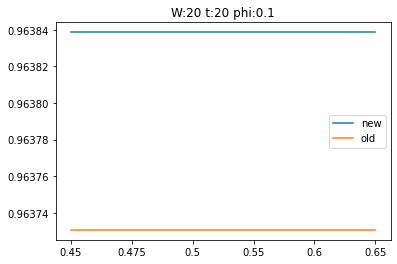

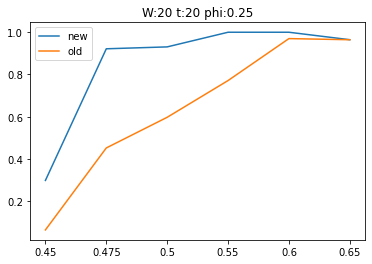

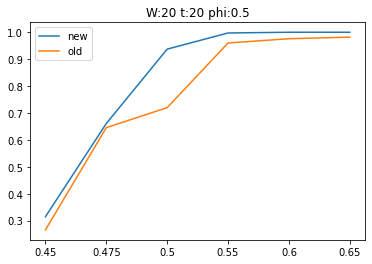

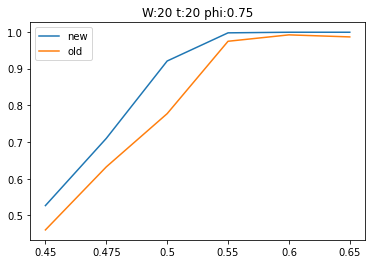

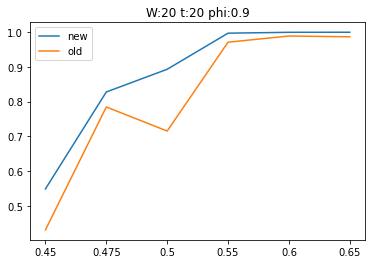

...

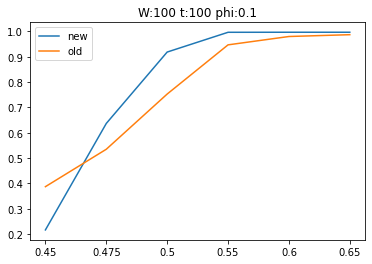

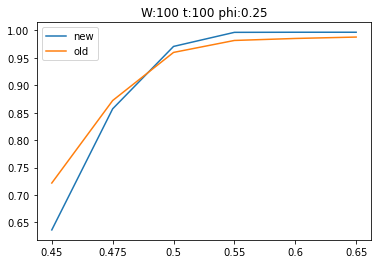

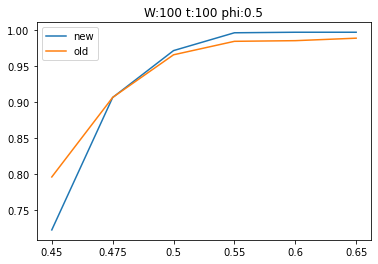

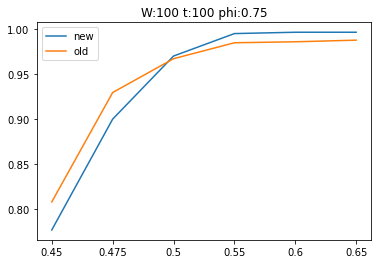

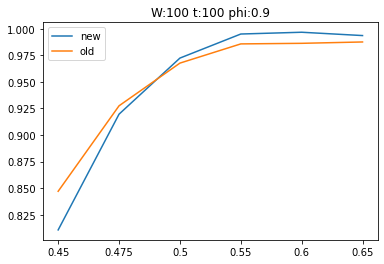

In [126]:

print(thresh_list)
for aa in range(results.shape[0]):
    for bb in range(results.shape[1]):
        for cc in range(results.shape[2]):
            result1 = results[aa,bb,cc,:,0,7]
            result2 = results[aa,bb,cc,:,1,7]
            plt.plot(result1)
            plt.plot(result2)
            plt.title('W:'+str(window_size_list[aa])+
                      ' t:'+str(t_list[bb])+
                      ' phi:'+str(phi_list[cc]))
            
            plt.legend(['new','old'])
            plt.xticks(list(range(len(result1))),thresh_list)
            plt.show()

[0.1  0.25 0.5  0.75 0.9 ]


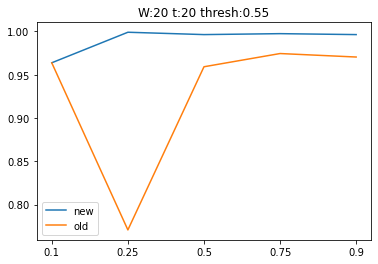

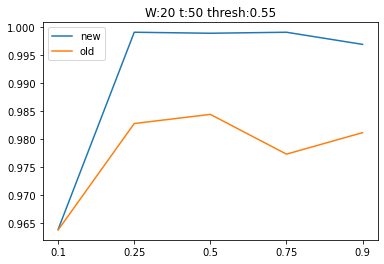

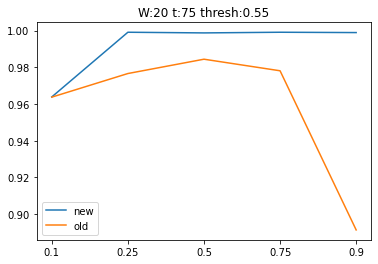

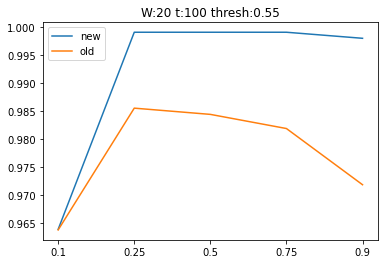

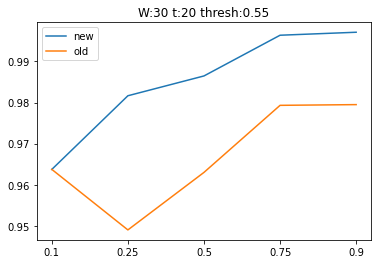

...

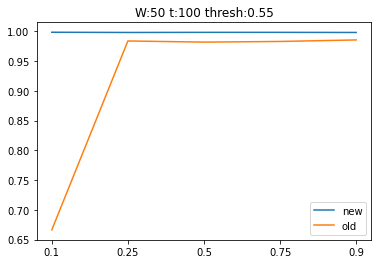

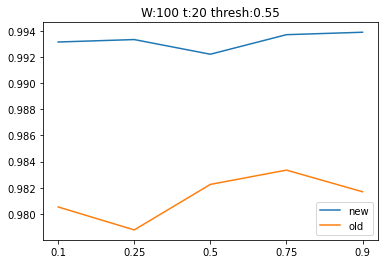

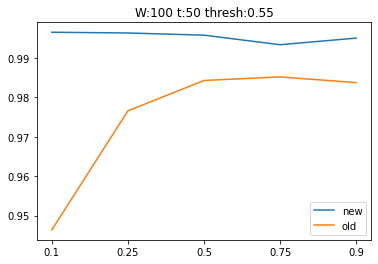

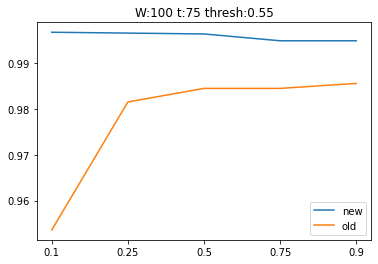

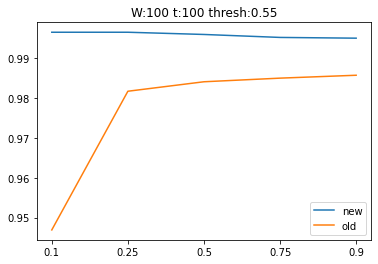

In [136]:
print(phi_list)
for aa in range(results.shape[0]):
    for bb in range(results.shape[1]):
            result1 = results[aa,bb,:,3,0,7]
            result2 = results[aa,bb,:,3,1,7]
            plt.plot(result1)
            plt.plot(result2)
            plt.title('W:'+str(window_size_list[aa])+
                      ' t:'+str(t_list[bb])+
                      ' thresh:'+str(thresh_list[3]))
            
            plt.legend(['new','old'])
            plt.xticks(list(range(len(result1))),phi_list)
            plt.show()

[ 20  50  75 100]


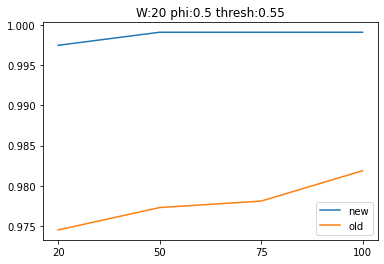

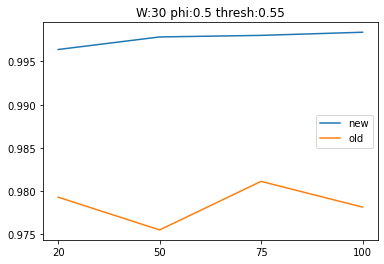

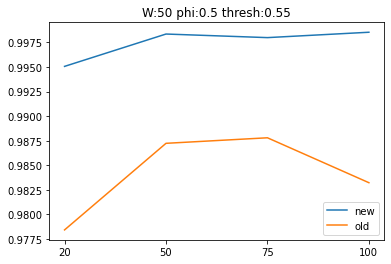

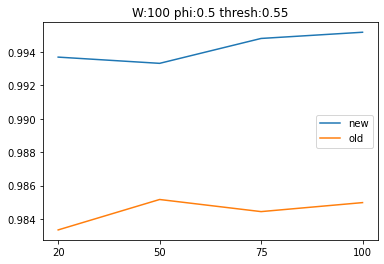

In [137]:
print(t_list)
for aa in range(results.shape[0]):
    result1 = results[aa,:,3,3,0,7]
    result2 = results[aa,:,3,3,1,7]
    plt.plot(result1)
    plt.plot(result2)
    plt.title('W:'+str(window_size_list[aa])+
              ' phi:'+str(phi_list[2])+
              ' thresh:'+str(thresh_list[3]))

    plt.legend(['new','old'])
    plt.xticks(list(range(len(result1))),t_list)
    plt.show()

[ 20  50  75 100]


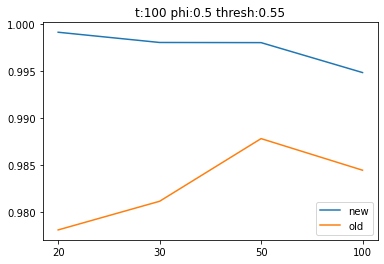

In [139]:
print(t_list)
result1 = results[:,2,3,3,0,7]
result2 = results[:,2,3,3,1,7]
plt.plot(result1)
plt.plot(result2)
plt.title('t:'+str(t_list[aa])+
          ' phi:'+str(phi_list[2])+
          ' thresh:'+str(thresh_list[3]))

plt.legend(['new','old'])
plt.xticks(list(range(len(result1))),window_size_list)
plt.show()

**********
window_size: 50
t: 30
phi: 25
thresh: 0.5
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
2

1850
1851
1852
1853
1854
1855
1856
1857
1858
1859
1860
1861
1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049


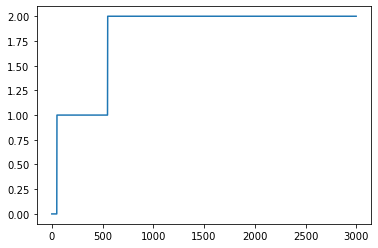

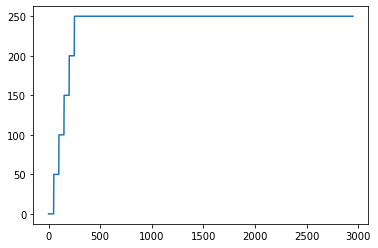

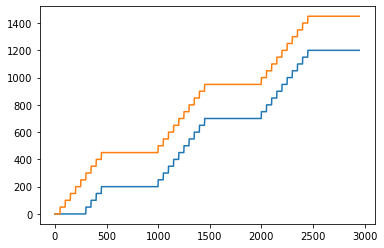

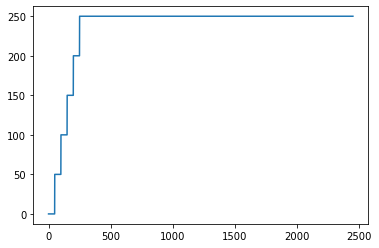

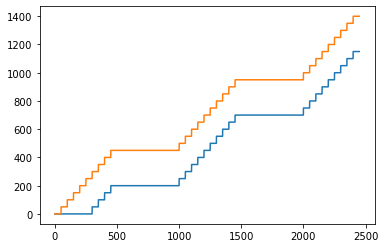

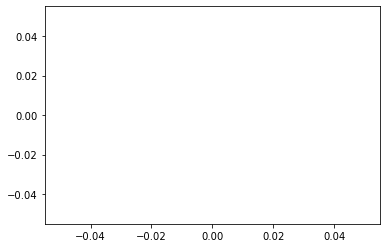

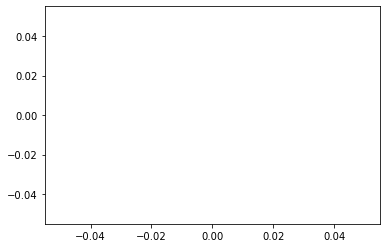

TP: 2582 TN: 200 FP: 7 FN: 161
ACC: 0.9430508474576271 Precision: 0.9972962533796833 Recall: 0.9413051403572731 F1: 0.9684921230307577
FPR: 0.033816425120772944 TPR: 0.9413051403572731


In [105]:
window_size_list = list(range(10,1000,50))
t_list = list(range(10,100,20))
phi_list = list(range(int(window_size/10),window_size,int(window_size/10)))
thresh_list = [0.35,0.4,0.45,0.5,0.55,0.6,0.65,0.7,0.75]

window_size_list = [50]
t_list = [30]
phi_list = [0.5]
thresh_list = [0.5]

results = np.zeros((len(window_size_list),len(t_list),len(phi_list),len(thresh_list),10))

for aa in range(len(window_size_list)):
    window_size = window_size_list[aa]
    for bb in range(len(t_list)):
        t = t_list[bb]
        for cc in range(len(phi_list)):
            phi = int(phi_list[cc]*window_size)
            for dd in range(len(thresh_list)):
                thresh = thresh_list[dd]

                madwin_len = [[],[],[]]

                max_i = [[],[],[]]
                min_i = [[],[],[]]
                
                print('*'*10)
                print('window_size:',window_size)
                print('t:',t)
                print('phi:',phi)
                print('thresh:',thresh)
                detector = algorithm(e=10,
                                     window_size=window_size,
                                     t=t,
                                     phi=phi,
                                     delta=0.02,
                                     min_win_size=5,
                                     thresh=thresh)
                prediction = []
                scores = []
                e_num = []
                for i in range(len(stream)):
                    x = stream[i]
                    output,var = detector.predict(x)
                    prediction += output
                    e_num.append(len(detector.ensemble))
                    print(i)
                    for e in range(len(detector.ensemble)):
                        madwin_len[e].append(len(detector.ensemble[e].madwin.W))
                        max_i[e].append(detector.ensemble[e].madwin.max_i)
                        min_i[e].append(detector.ensemble[e].madwin.min_i)
#                 print(results[aa,bb,cc,dd])
                plt.figure()
                plt.plot(e_num)
                plt.show()
                for i in range(len(madwin_len)):
                    plt.figure()
                    plt.plot(madwin_len[i])
                    plt.show()
                    plt.figure()
                    plt.plot(min_i[i])
                    plt.plot(max_i[i])
                    plt.show()
                    
                
                res = evaluation(prediction,label[:len(prediction)])
                results[aa,bb,cc,dd] = res
#                 print(results[aa,bb,cc,dd])

In [83]:
evaluation(prediction,label[:len(prediction)])

TP: 1082 TN: 23 FP: 29 FN: 666
ACC: 0.6138888888888889 Precision: 0.9738973897389739 Recall: 0.6189931350114416 F1: 0.7569080097936342
FPR: 0.5660377358490566 TPR: 0.6192109777015438


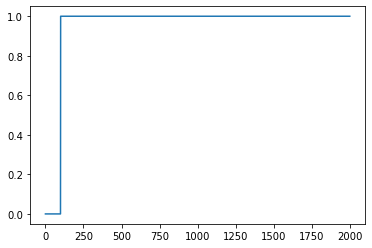

In [75]:
plt.figure()
plt.plot(e)
plt.show()

500 0
500 1
500 1
1500 1


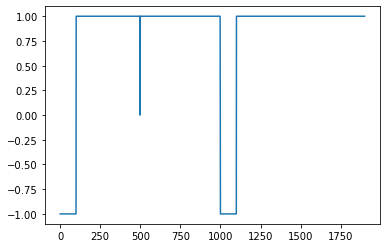

In [178]:
print('500',prediction[499])
print('500',prediction[500])
print('500',prediction[502])
print('1500',prediction[1500])
plt.figure()
plt.plot(prediction)
plt.show()

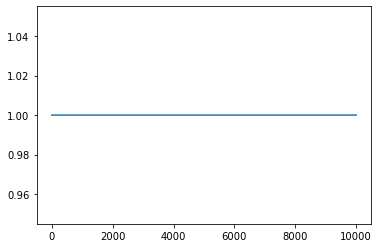

In [74]:
plt.figure()
plt.plot(label)
plt.show()

In [13]:
def stream_generator(normal,abnormal,n):
    normal_data_folder = normal
    abnormal_data_folder = abnormal
    normal_file_list = []
    abnormal_file_list = []
    for f in os.listdir(normal_data_folder):
        normal_file_list.append(normal_data_folder+f)
    for f in os.listdir(abnormal_data_folder):
        abnormal_file_list.append(abnormal_data_folder+f)
    stream_list = []
    label_list = []
    connection_list = []

    feature = ['Agent','ProcessName','TaskID','Label','Title','Host','HRT','Operation','Source','ThreadID','EventID','ProcessID']

    for i in range(n):
    
        cati = {}
        for i in range(12):
            cati[i] = []
        normal_file = random.sample(normal_file_list,1)
        abnormal_file = random.sample(abnormal_file_list,1)
#         stream_file = normal_file[1:] + abnormal_file
#         random.shuffle(stream_file)
#         stream_file = [normal_file[0]]+stream_file
        stream_file = normal_file + abnormal_file+ abnormal_file+ abnormal_file+ abnormal_file
#         print(stream_file)
        
    
        cati = {}
        for i in range(12):
            cati[feature[i]] = []
            
        stream = []
        labels = []
        connection = []
        for f in stream_file:
            if f[:len(abnormal_data_folder)]==abnormal_data_folder:
                label = 0
            else:
                label = 1
            with open(f, "r") as read_file:
                data = json.load(read_file)
            report_list = data[0]['reports']
            number_of_events = len(report_list)
            print(number_of_events)
            s = []
            l = []
            for i in range(number_of_events):
                event = [0]*12
                for j in range(12):
                    e = report_list[i].get(feature[j])
                    if e not in cati[feature[j]]:
                        cati[feature[j]].append(e)
                    event[j] = cati[feature[j]].index(e) 
                l.append(label)
                s.append(event)
#             connection.append(len(stream))
            l = np.array(l)
            s = np.array(s)
            p = np.random.permutation(len(l))
#             print(s[:10])
#             l = l[p]
#             s = s[p]
#             print(s[:10])
            if len(stream)>0:
                stream = np.concatenate((stream,s),axis=0)
                labels = np.concatenate((labels,l),axis=0)
            else:
                stream = s
                labels = l
#             print(len(l))
#             print(len(s))
#             break
#         break
#         p = np.random.permutation(len(stream))
#         stream = stream[p]
#         labels = labels[p]
        stream_list.append(stream)
        label_list.append(labels)
        connection_list.append(connection)
    
        
    return stream_list,label_list,connection_list,cati

In [14]:
def evaluation(detector,label):
    TP=0
    TN=0
    FP=0
    FN=0
    for i in range(len(label)):
        if detector.prediction[i] != -1:
            if detector.prediction[i] and label[i]:
                TP += 1
            elif detector.prediction[i] and not label[i]:
                FP += 1
            elif not detector.prediction[i] and label[i]:
                FN += 1
            else:
                TN += 1
    ACC = (TP+TN)/(TP+TN+FP+FN)
    Precision = TP/(TP+FP)
    Recall = TP/(TP+FN)
    F1 = 2*Precision*Recall/(Precision+Recall)
    FPR = (FP+1)/(FP+TN+1)
    TPR = (TP+1)/(TP+FN+1)
    print('TP:',TP,'TN:',TN,'FP:',FP,'FN:',FN)
    print('ACC:',ACC,'Precision:',Precision,'Recall:',Recall,'F1:',F1)
    print('FPR:',FPR,'TPR:',TPR)
    return

In [15]:
dataset = ['raw_data/shuttle.txt',
           'raw_data/smtp.txt',
           'raw_data/pima.txt',
           'raw_data/satellite.txt',
           'raw_data/smtp_http.txt',
           'raw_data/shuttle.txt',
           'raw_data/shuttle.txt']

In [70]:
a = np.loadtxt(dataset[1])
stream = a[:10000,:-1]
label = a[:10000,-1]
label = 1-label
print(stream.shape)

(10000, 3)


In [179]:
a = np.loadtxt(dataset[1])
stream = a[:,:-1]
label = a[:,-1]
label = 1-label
print(stream.shape)

(95156, 3)


In [28]:
X = stream[:100]
selector = VarianceThreshold()
Xp = selector.fit_transform(X)


In [31]:
X = []
for x in stream[:100]:
    X.append(x)
selector = VarianceThreshold()
Xp = selector.fit_transform(X)
print(Xp.shape)

(100, 8)


In [17]:
a = np.loadtxt(dataset[2])
stream = a[:,:-1]
label = a[:,-1]
label = 1-label

In [18]:
print(stream.shape)
print(label.shape)

(768, 8)
(768,)


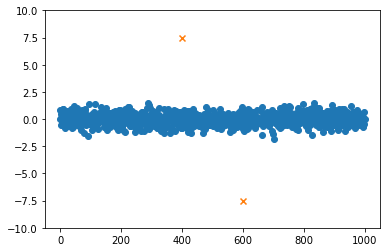

In [13]:
mean = [0,10,40,30]
var = [.5,.5,.5,.5]
X = np.array([])
for i in range(1):
    X = np.concatenate((X,np.random.normal(mean[i],var[i],1000)),axis=0)
    
plt.figure()
plt.scatter(range(len(X)),X)
plt.scatter([400,600],[7.5,-7.5],marker='x')
plt.ylim(-10,10)
plt.show()

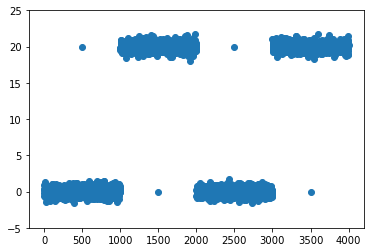

(4000, 1)


In [98]:
mean = [0,20,0,20]
var = [.5,.5,.5,.5]
X = np.array([])
for i in range(4):
    X = np.concatenate((X,np.random.normal(mean[i],var[i],1000)),axis=0)

X[500]=20
X[1500]=0
X[2500]=20
X[3500]=0
    
plt.figure()
plt.scatter(range(len(X)),X)
plt.ylim(-5,25)
plt.show()
stream = X.reshape((-1,1))
print(stream.shape)

(100,)


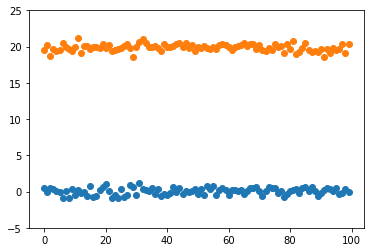

(200,)


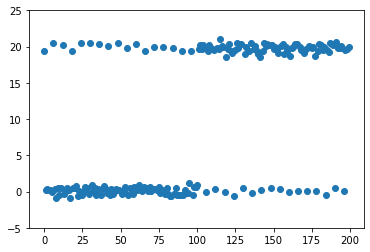

In [17]:
mean = [0,20,0,20]
var = [.5,.5,.5,.5]
X1 = np.array([])
X2 = np.array([])
X1 = np.concatenate((X1,np.random.normal(mean[0],var[0],100)),axis=0)
X2 = np.concatenate((X2,np.random.normal(mean[1],var[1],100)),axis=0)
X3,l = random_mix(X1,X2,100,(5,1))
X4,l = random_mix(X2,X1,100,(5,1))

print(X3.shape)
plt.figure()
plt.scatter(range(len(X1)),X1)
plt.scatter(range(len(X2)),X2)
plt.ylim(-5,25)
plt.show()

stream = np.concatenate((X3,X4),axis=0)
print(stream.shape)
plt.figure()
plt.scatter(range(len(stream)),stream)
plt.ylim(-5,25)
plt.show()

In [8]:
def random_mix(a,b,l,p):
    '''
    a: first stream
    b: second stream
    l: length of output stream
    p: mix persantage of two stream
    
    output:
    stream: mix stream
    label: label of mix stream
    '''
    pa,pb = p
    na = int(pa/(pa+pb)*l)
    nb = int(pb/(pa+pb)*l)
    sa = random.choices(a,k=na+1)
    sb = random.choices(b,k=nb+1)
#     print('na,nb',na,nb)
    stream = []
    label = []
    ai = 0
    bi = 0
    for i in range(l):
#         print(i,ai,bi)
        event = None
        if i%(pa+pb) == 0:
            stream.append(sb[bi])
            label.append(0)
            bi += 1
        else:
            stream.append(sa[ai])
            label.append(1)
            ai += 1
    return np.array(stream),np.array(label)

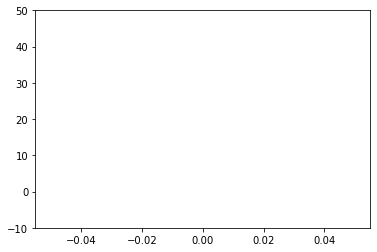

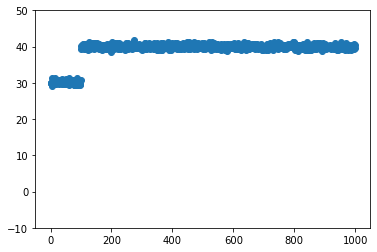

In [132]:
mean = [0,20,40,30]
var = [.5,.5,.5,.5]
normal = np.array([])
abnormal = np.array([])
# for i in range(1):
normal1 = np.concatenate((normal,np.random.normal(mean[0],var[0],1000)),axis=0)
normal2 = np.concatenate((normal,np.random.normal(mean[1],var[1],1000)),axis=0)
abnormal = np.concatenate((abnormal,np.random.normal(mean[2],var[2],1000)),axis=0)
abnormal[:100] = np.random.normal(mean[3],var[3],100)
plt.figure()
plt.scatter(range(len(normal)),normal)
plt.ylim(-10,50)
plt.show()
plt.figure()
plt.scatter(range(len(abnormal)),abnormal)
plt.ylim(-10,50)
plt.show()
stream1,label1 = random_mix(normal1,abnormal,1000,(1,1))
stream2,label2 = random_mix(normal2,abnormal,1000,(1,1))
stream = np.concatenate((stream1,stream2),axis=0)
label = np.concatenate((label1,label2),axis=0)
# stream = np.concatenate((np.random.normal(mean[0],var[0],100),stream),axis=0)
# label = np.concatenate((np.ones((100,)),label),axis=0)

2000
[ True]


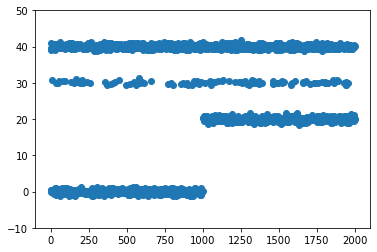

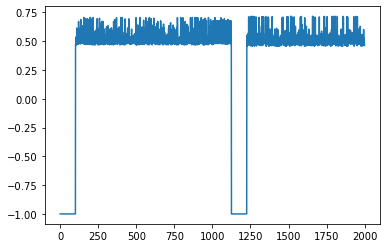

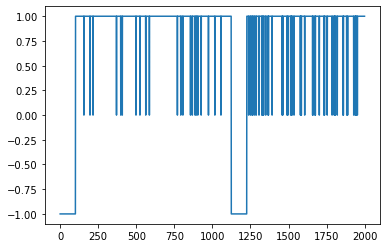

TP: 899 TN: 71 FP: 827 FN: 0
ACC: 0.5397885364496383 Precision: 0.5208574739281576 Recall: 1.0 F1: 0.684952380952381
FPR: 0.9210233592880979 TPR: 1.0


In [135]:
# X.reshape(-1,1)
stream = stream.reshape(-1,1)
detector = iForestADWIN(100,1000,50,None,thresh=0.7,text=False,delta=0.02)
print(len(stream))
for i in range(len(stream)):
    detector.add_element(stream[i])
#     if i >=200:
#         print("********",stream[i],detector.score[i])
    print(i,end='\r')
print(detector.feature_filter)
plt.figure()
plt.scatter(range(len(stream)),stream)
plt.ylim(-10,50)
plt.show()
plt.figure()
plt.plot(detector.score)
plt.show()
plt.figure()
plt.plot(detector.prediction)
# plt.plot(label_list[j])
plt.show()
evaluation(detector,label)


1000
[ True]


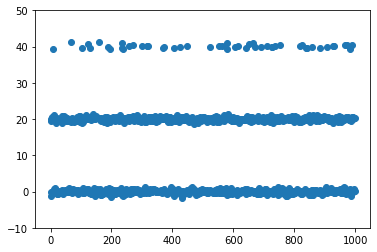

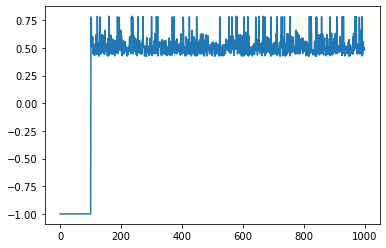

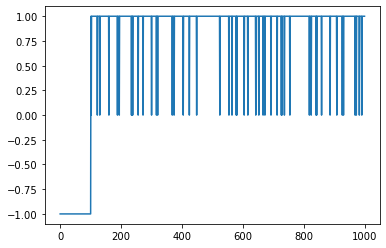

TP: 450 TN: 49 FP: 400 FN: 0
ACC: 0.5550611790878754 Precision: 0.5294117647058824 Recall: 1.0 F1: 0.6923076923076924
FPR: 0.8911111111111111 TPR: 1.0


In [114]:
# X.reshape(-1,1)
stream = stream.reshape(-1,1)
detector = iForestADWIN(100,1000,50,None,thresh=0.7,text=False,delta=0.02)
print(len(stream))
for i in range(len(stream)):
    detector.add_element(stream[i])
#     if i >=200:
#         print("********",stream[i],detector.score[i])
    print(i,end='\r')
print(detector.feature_filter)
plt.figure()
plt.scatter(range(len(stream)),stream)
plt.ylim(-10,50)
plt.show()
plt.figure()
plt.plot(detector.score)
plt.show()
plt.figure()
plt.plot(detector.prediction)
# plt.plot(label_list[j])
plt.show()
evaluation


In [88]:
def evaluation(detector,label):
    TP=0
    TN=0
    FP=0
    FN=0
    for i in range(len(label)):
        if detector.prediction[i] != -1:
            if detector.prediction[i] and label[i]:
                TP += 1
            elif detector.prediction[i] and not label[i]:
                FP += 1
            elif not detector.prediction[i] and label[i]:
                FN += 1
            else:
                TN += 1
    ACC = (TP+TN)/(TP+TN+FP+FN)
    Precision = TP/(TP+FP)
    Recall = TP/(TP+FN)
    F1 = 2*Precision*Recall/(Precision+Recall)
    FPR = (FP+1)/(FP+TN+1)
    TPR = (TP+1)/(TP+FN+1)
    print('TP:',TP,'TN:',TN,'FP:',FP,'FN:',FN)
    print('ACC:',ACC,'Precision:',Precision,'Recall:',Recall,'F1:',F1)
    print('FPR:',FPR,'TPR:',TPR)
    return

In [ ]:


# X.reshape(-1,1)
stream = X.reshape(-1,1)
for i in range(100):
    for j in range(i+1):
        detector = iForestADWIN(i,1000,j,None,thresh=0.7,text=False,delta=0.02)
        print(len(stream))
        for i in range(len(stream)):
            detector.add_element(stream[i])
        #     if i >=200:
        #         print("********",stream[i],detector.score[i])
            print(i,end='\r')
        print(detector.feature_filter)
        plt.figure()
        plt.scatter(range(len(X)),X)
        plt.ylim(-10,50)
        plt.show()
        plt.figure()
        plt.plot(detector.score)
        plt.show()
        plt.figure()
        plt.plot(detector.prediction)
        # plt.plot(label_list[j])
        plt.show()
        print(detector.score[206],detector.score[202],detector.score[800])
        print(detector.prediction[206],detector.prediction[202],detector.prediction[800])